In [1]:
## Import des librairies + chemin à l'image
import os

os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant')

import matplotlib as mp
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import glob
import sys
import scipy
from spectral_analysis_functions import *
from scipy.interpolate import interpolate
from scipy.interpolate import RectBivariateSpline
from scipy.interpolate import griddata
# Using OceanDataLab reader 
#from sentinel2_l1c import *
import numpy as np
from S2_read import *
from s2_angs import *
bands=['B04','B08','B03','B02'];  


# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160429T183252_N0201_R027_T11SMS_20160429T184037.SAFE/'

# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWL_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWM_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PWN_20160827T065722.SAFE/'
S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWP_20231005T003302.SAFE/'


# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXL_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXM_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PXN_20160827T065722.SAFE/'

# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYL_20160827T065722.SAFE/'
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYM_20160827T065722.SAFE/' # A VERIFIER
# S2path='/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0204_R020_T39PYN_20160827T065722.SAFE/'




In [2]:
XML_File = find('MTD_TL.xml', S2path)
XML_File_DS=find('MTD_DS.xml',S2path)
if XML_File is None:
    print("Le fichier 'MTD_TL.xml' n'a pas été trouvé dans le répertoire spécifié:", S2path)

Mother_box=[0,11000,0,11000]

# taille_boite=500
# width=(Mother_box[1] - Mother_box[0]) // taille_boite 
# length=(Mother_box[3] - Mother_box[2]) // taille_boite 

# Taille des boîtes
taille_boite = 700

# Déplacement du centre
deplacement_centre = 500

# Calculer les nouvelles dimensions des boucles
width = (Mother_box[1] - Mother_box[0] - taille_boite) // deplacement_centre + 2
length = (Mother_box[1] - Mother_box[0] - taille_boite) // deplacement_centre + 2

# boxi=[3000, 3500, 1000, 1500]

# U = np.zeros((width, length))
# V = np.zeros((width, length))
# coordlon = np.zeros((width, length))
# coordlat = np.zeros((width, length))

print('widht',width)
print('length',length)

widht 22
length 22


/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA


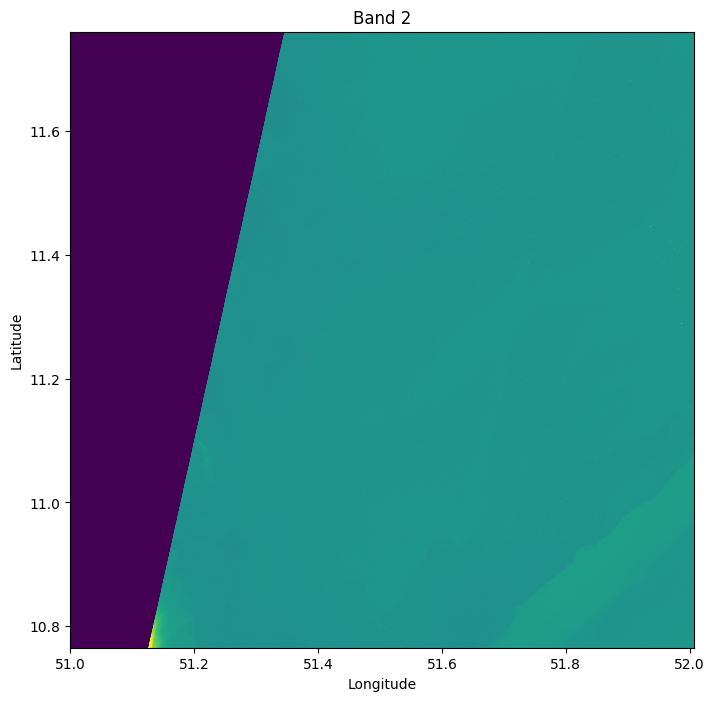

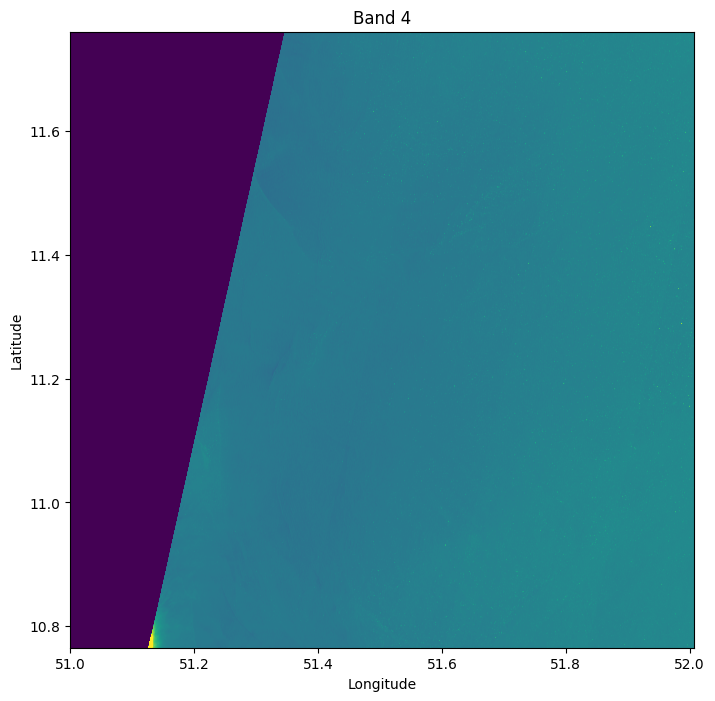

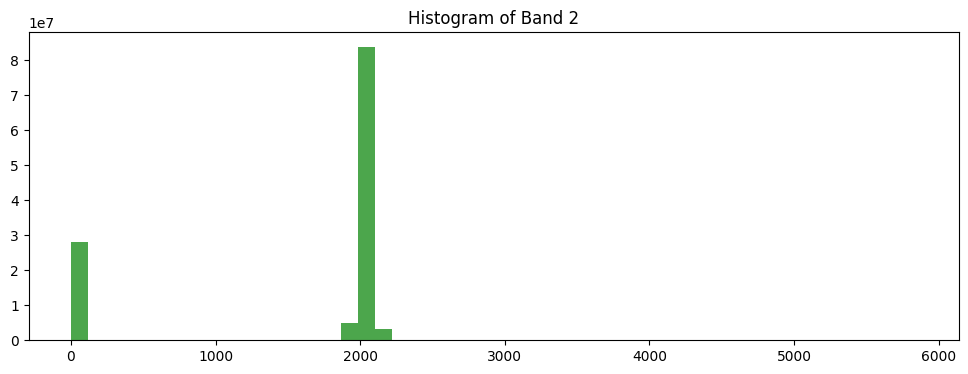

[50.999816437010175, 52.00752284452152, 10.765404630173208, 11.760044027808236]


/tmp/ipykernel_11584/292770347.py:40: UserWarning: Adding colorbar to a different Figure <Figure size 1200x400 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  plt.colorbar(im)


<Figure size 640x480 with 0 Axes>

minlon 50.999816437010175
minlat 10.765404630173208
maxlon 52.00752284452152
maxlat 11.760044027808236


In [3]:
%run Visualisation_image.ipynb
# corriger le niveau pour les cartes

In [4]:
print('maxlon=',maxlon)
print('minlon=',minlon)
print('maxlat=',maxlat)
print('minlat=',minlat)


maxlon= 52.00752284452152
minlon= 50.999816437010175
maxlat= 11.760044027808236
minlat= 10.765404630173208


In [5]:
[imgs,NX,NY,nx,ny,dx,dy,offspec,phitrig,thetav,loncenter,latcenter,detector,indexX,indexY]=S2_read(S2path,boxi,bands)
array1=np.squeeze(detector[1,:,:])
fig, ax = plt.subplots() 
im=ax.pcolor(indexX,indexY,array1)
fig.colorbar(im)
ax.set_title('detector index and FFT box location')
ax.set_xlabel('pixel index')
ax.set_ylabel('pixel index')
ax.axis('equal')
rect = mp.patches.Rectangle((boxi[0], boxi[2]), boxi[1]-boxi[0], boxi[3]-boxi[2], linewidth=2,
                         edgecolor='k', facecolor="none")
# rect1 = mp.patches.Rectangle((boxi1[0], boxi1[2]), boxi1[1]-boxi1[0], boxi1[3]-boxi1[2], linewidth=2,
#                          edgecolor='r', facecolor="none")
# ax.add_patch(rect1)

ax.add_patch(rect)
plt.show()
print(array1)


NameError: name 'boxi' is not defined

In [ ]:
# Exemple d'une seule boîte 
os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/')
# boxi=[Mother_box[0],Mother_box[0]+800,Mother_box[2],Mother_box[2]+800]
boxi=[0,700,0,700]

# Exemple de boite
taille_boite=700
# mapping = {
#     1: 'D01',
#     2: 'D02',
#     3: 'D03',
#     4: 'D04',
#     5: 'D05',
#     6: 'D06',
#     7: 'D07',
#     8: 'D08',
#     9: 'D09',
#     10: 'D10',
#     11: 'D11',
#     12: 'D12'
# }

# #
# Dx=(Mother_box[1]-Mother_box[0])/taille_boite
# Dy=(Mother_box[3]-Mother_box[2])/taille_boite
# #
# x_centers = np.arange(Mother_box[0] + taille_boite/2, Mother_box[1], taille_boite)
# y_centers = np.arange(Mother_box[2] + taille_boite/2, Mother_box[3], taille_boite)
# x_grid, y_grid = np.meshgrid(x_centers, y_centers)

# points = np.column_stack((indexX_detec, indexY_detec))


# interpolated_value=np.round(griddata(points,zone_detec,(x_grid, y_grid),method='linear'))
# print(interpolated_value)

# boxi=[6000,6800,8000,8800]
Sat='A'
%run S2_get.ipynb

# [imgs1,NX,NY,nx,ny,dx,dy,offspec,phitrig,thetav,loncenter,latcenter,detector,indexX,indexY]=S2_read(S2path,boxi1,bands)
print('width=',width)
print('length=',length)
print('U and V components of current :',X)
coord_lon=loncenter
coord_lat=latcenter

print('lon,lat:',loncenter,latcenter)

In [6]:
print(taille_boite)

700


box [0, 700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading file fo

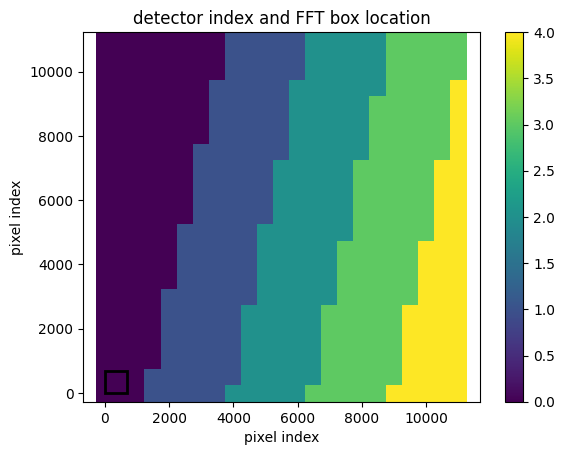

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:249: RuntimeWarning: invalid value encountered in divide
  phases[:,:,m]=tileFFT2_shift*np.conj(tileFFT1_shift)/(abs(tileFFT2_shift)*abs(tileFFT1_shift));
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:253: RuntimeWarning: invalid value encountered in divide
  phases[:,:,m]=phases[:,:,m]/phase;


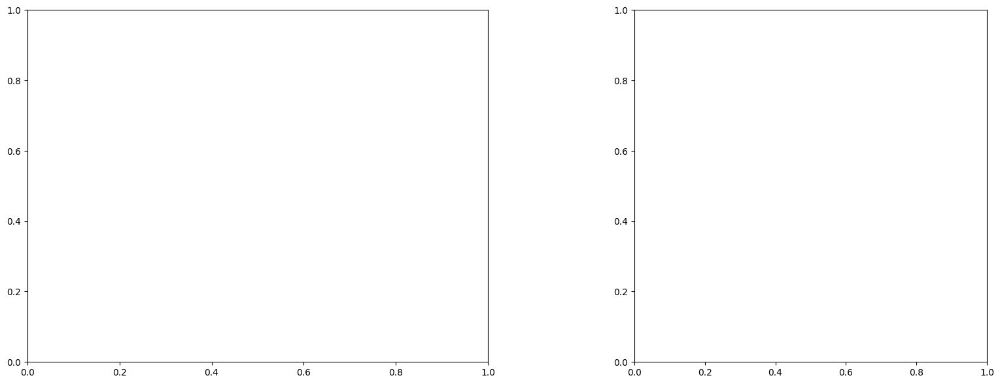

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading file

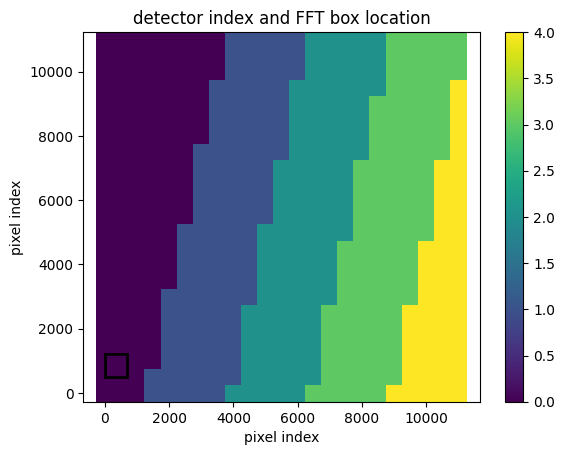

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


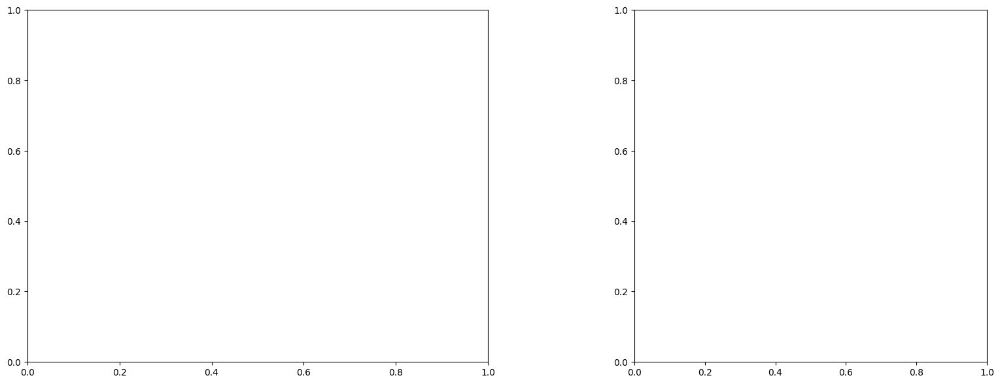

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

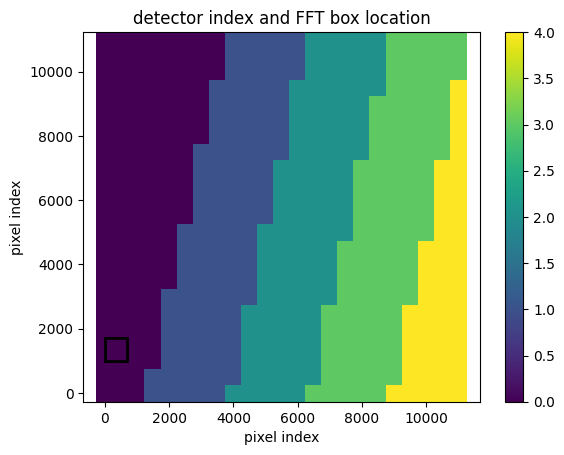

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


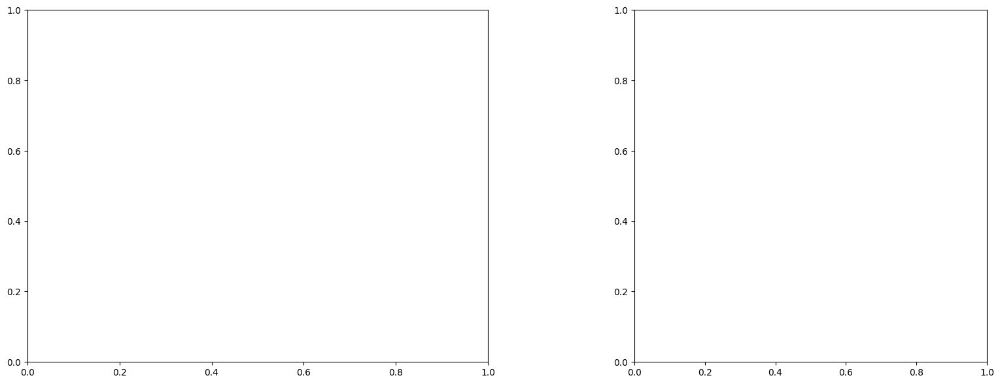

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

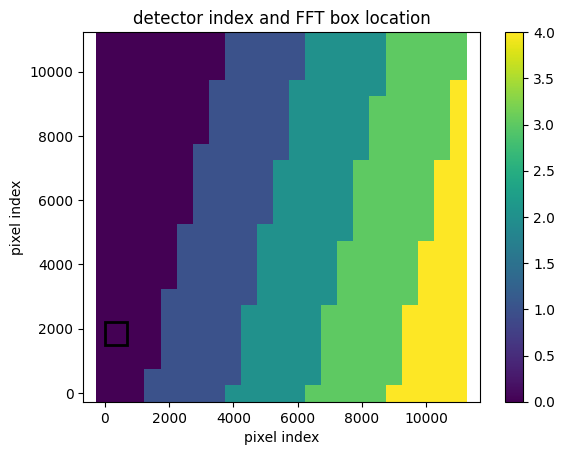

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


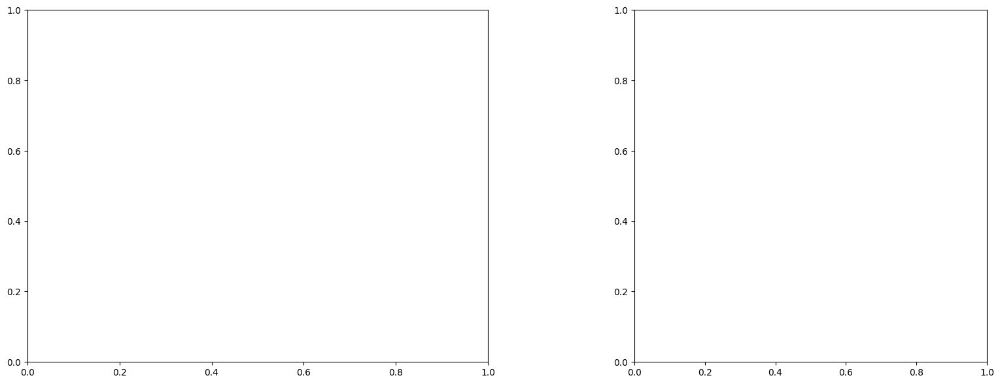

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

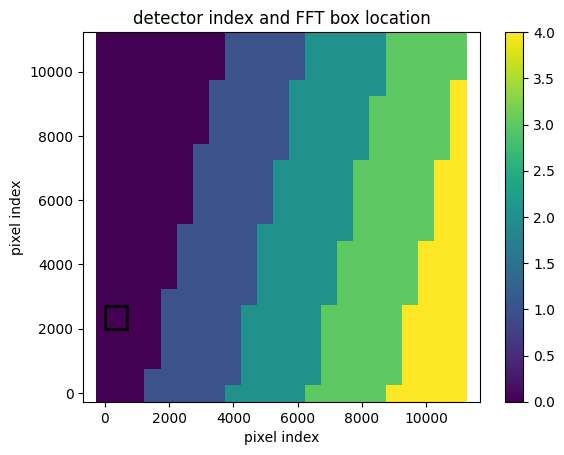

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


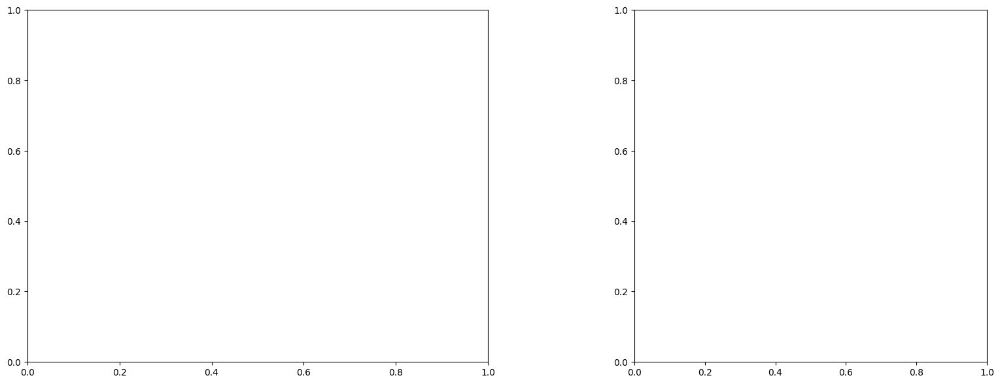

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

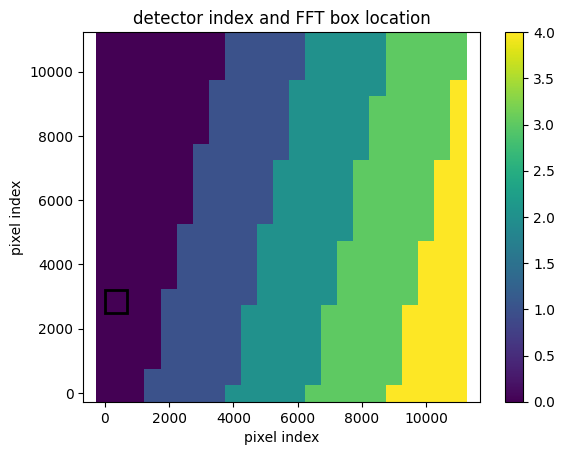

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


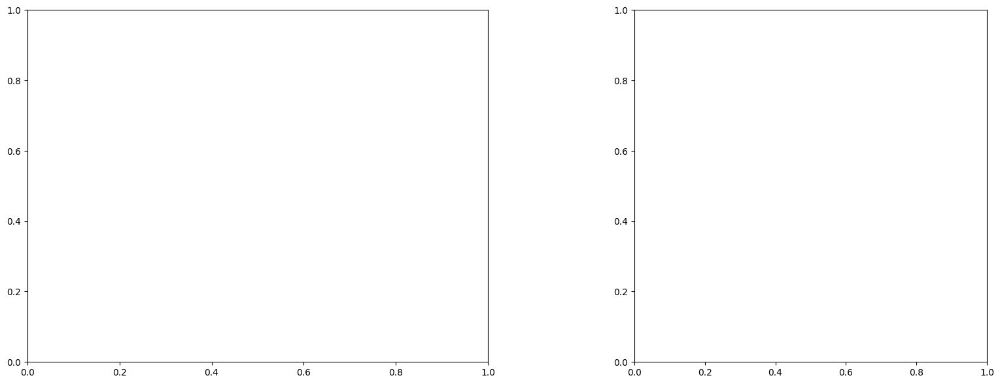

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

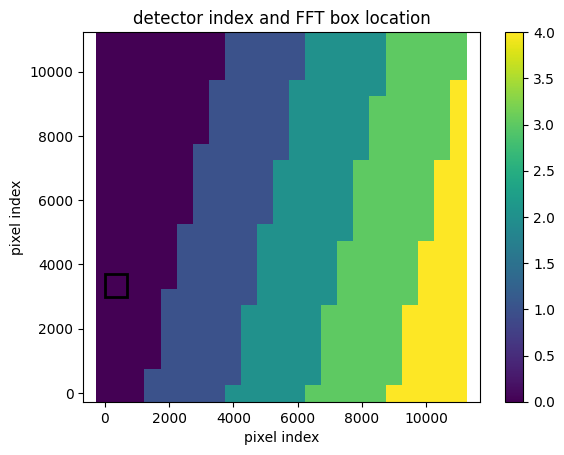

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


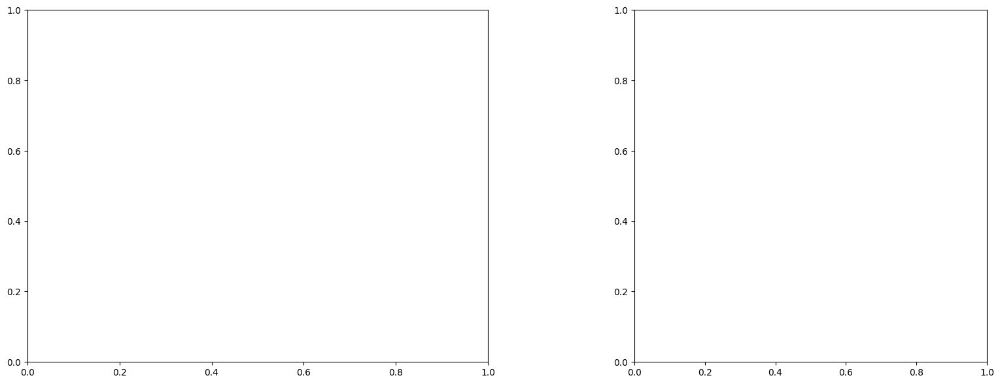

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

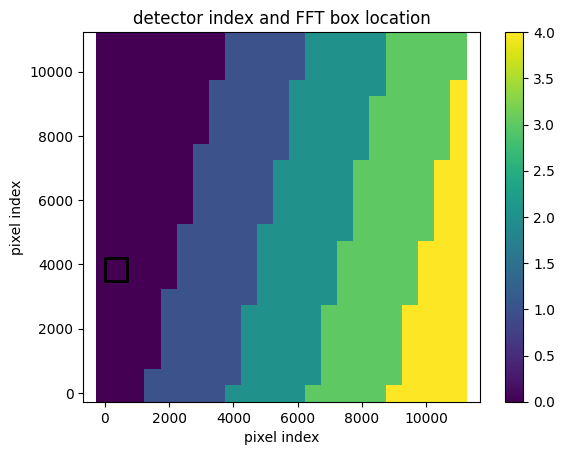

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


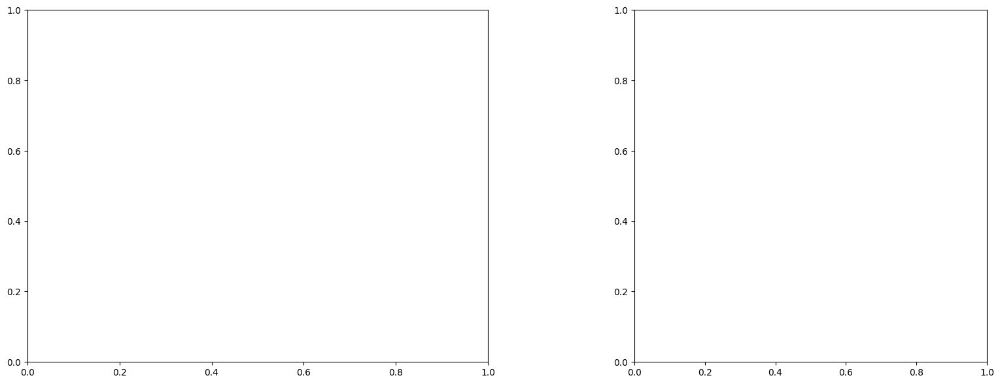

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

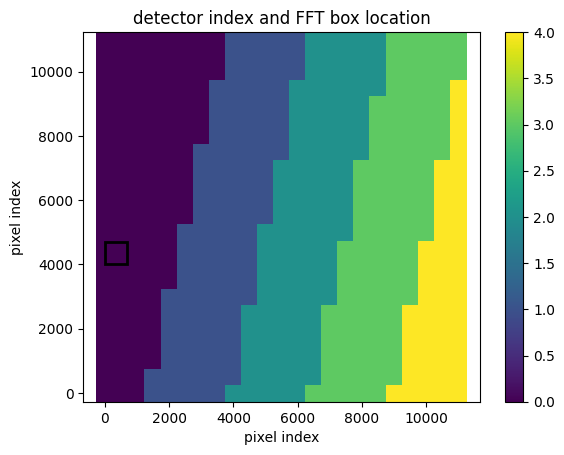

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


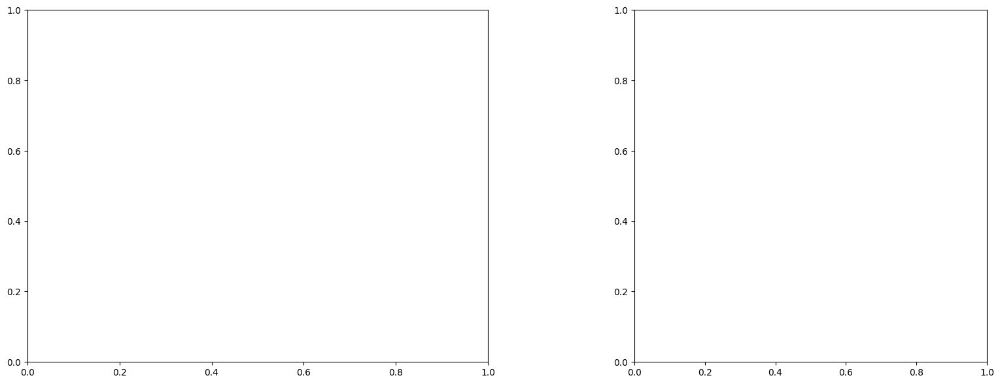

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

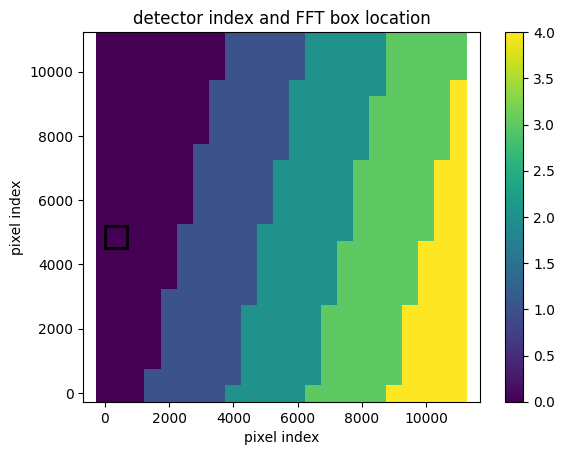

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


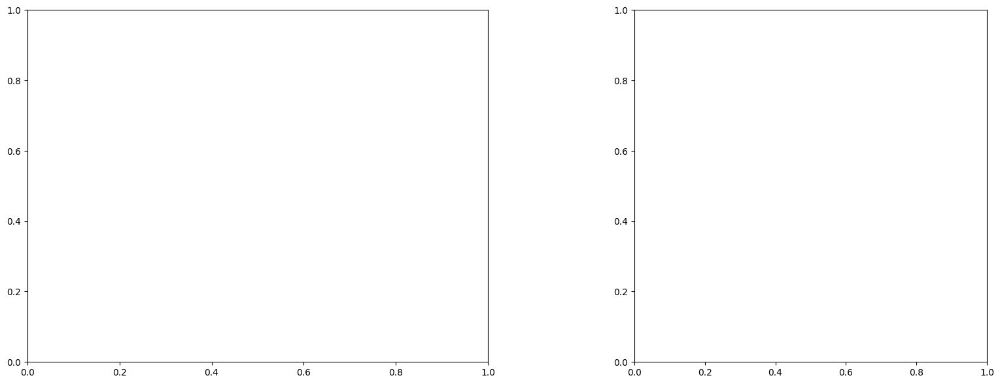

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

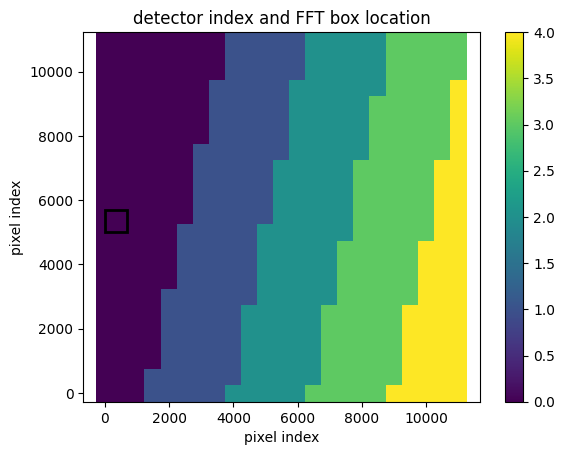

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


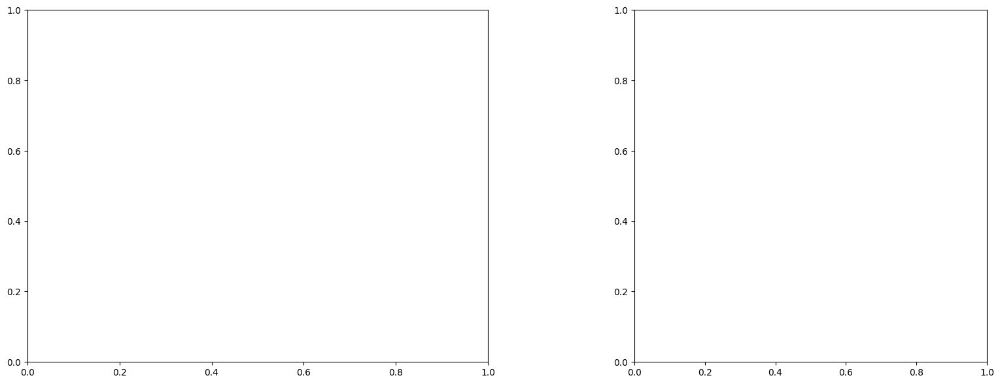

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

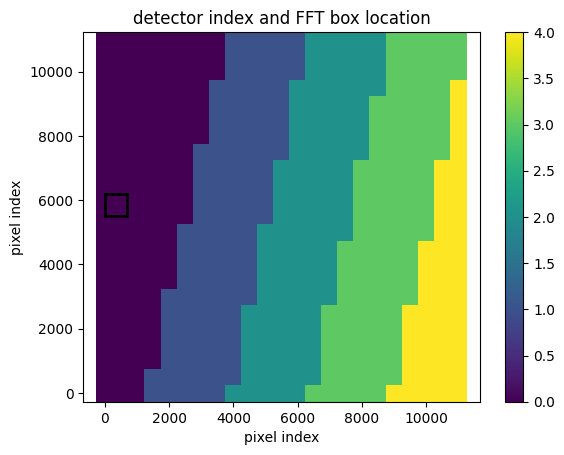

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


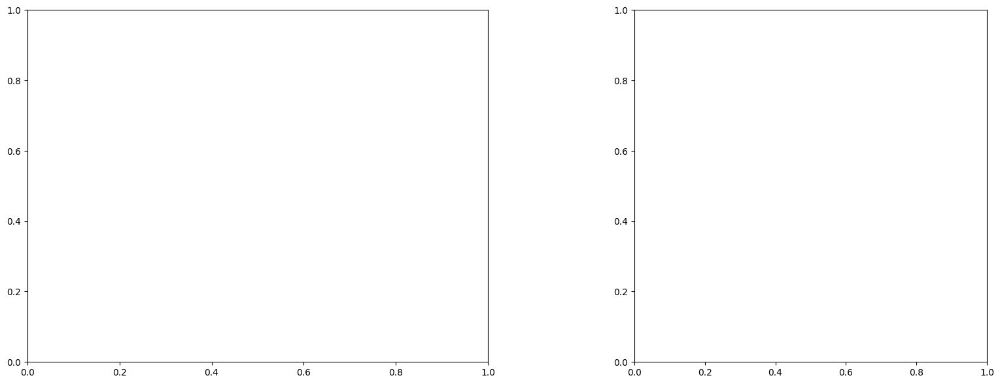

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

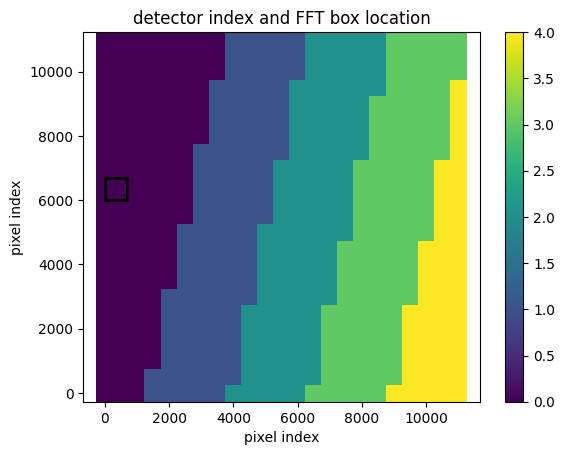

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


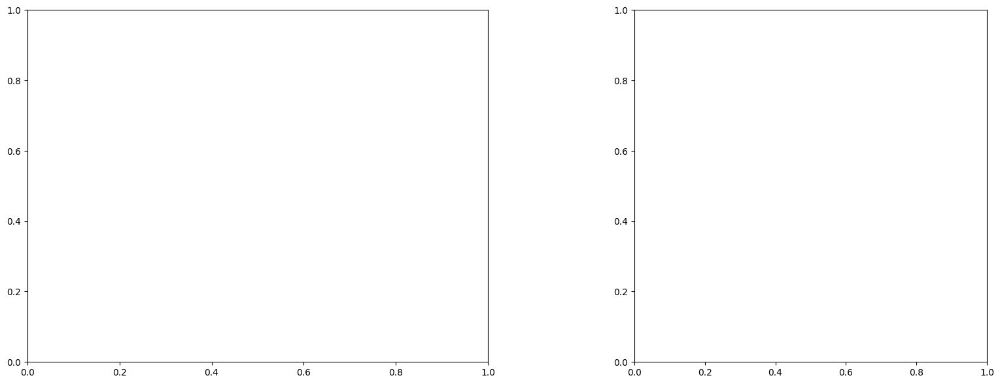

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

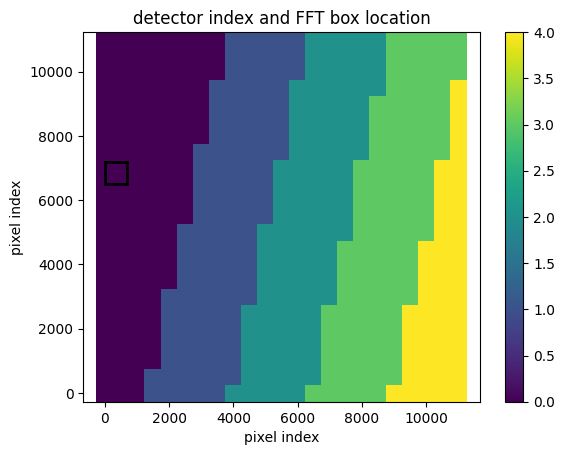

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


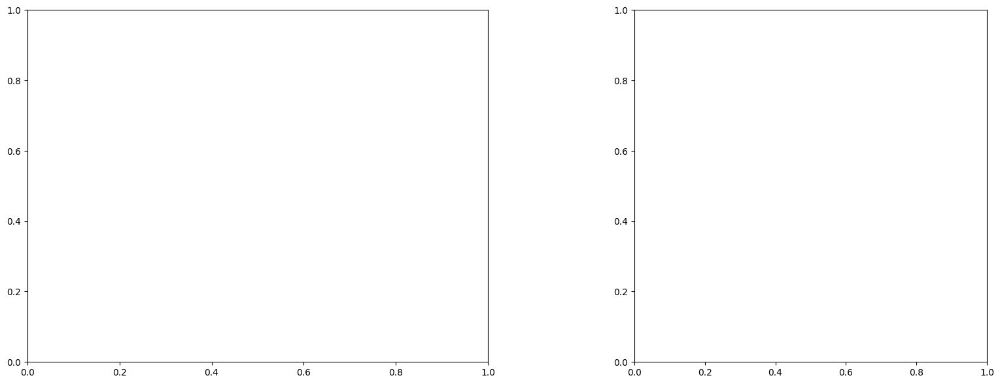

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

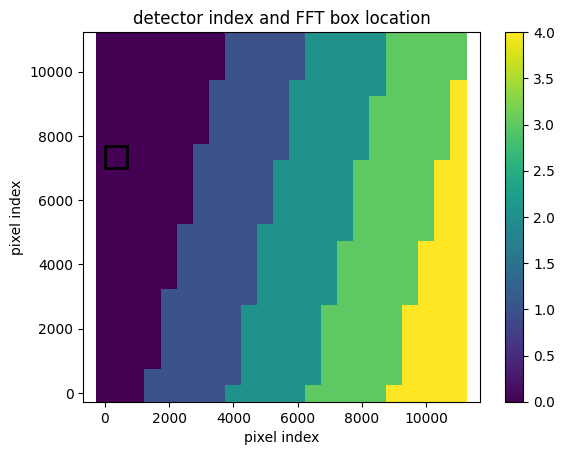

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


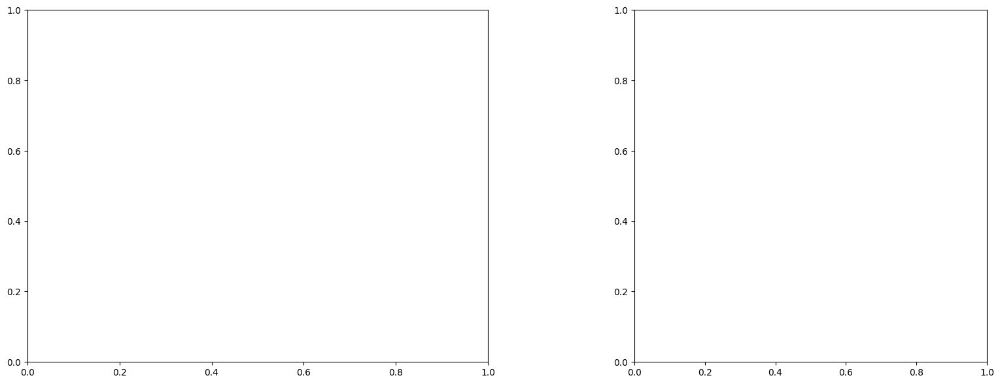

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

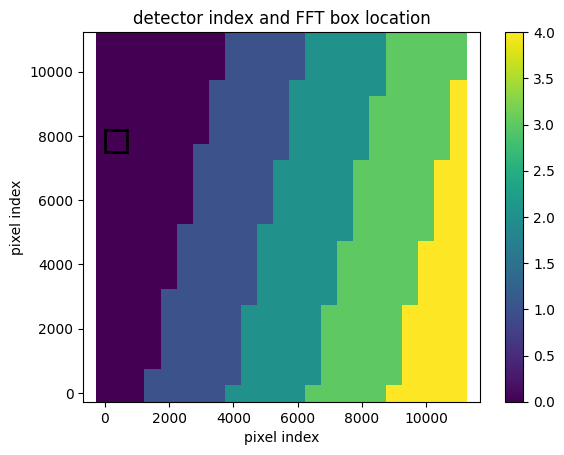

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


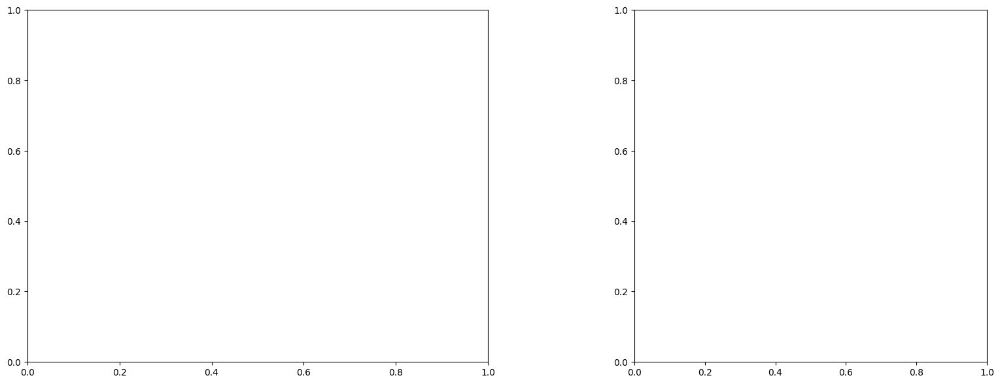

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

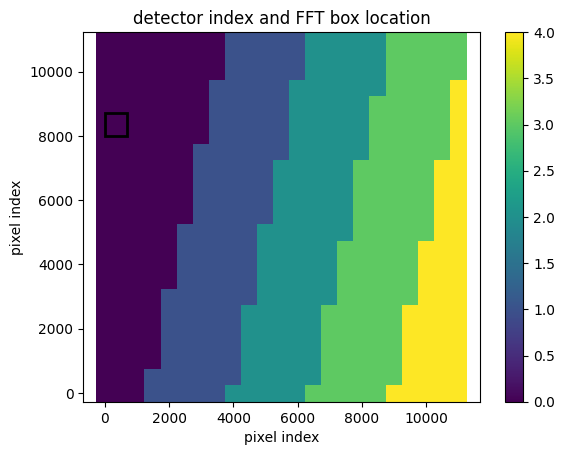

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


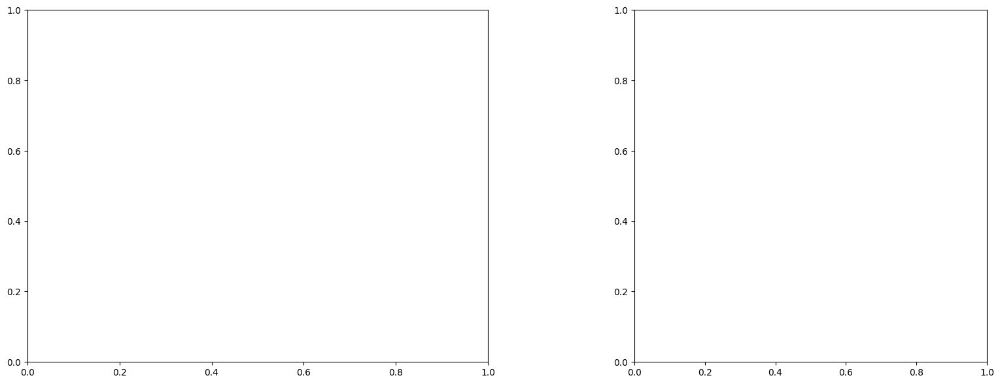

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

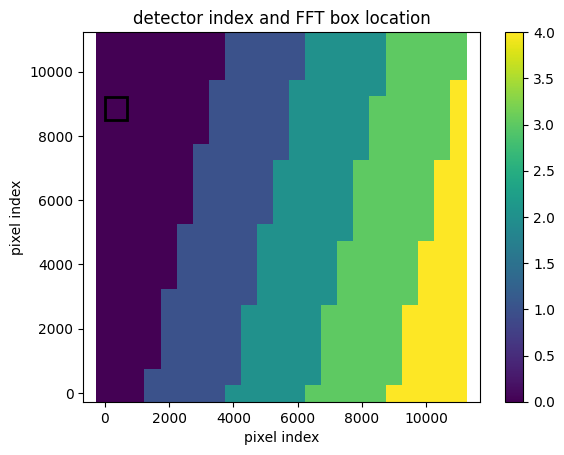

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


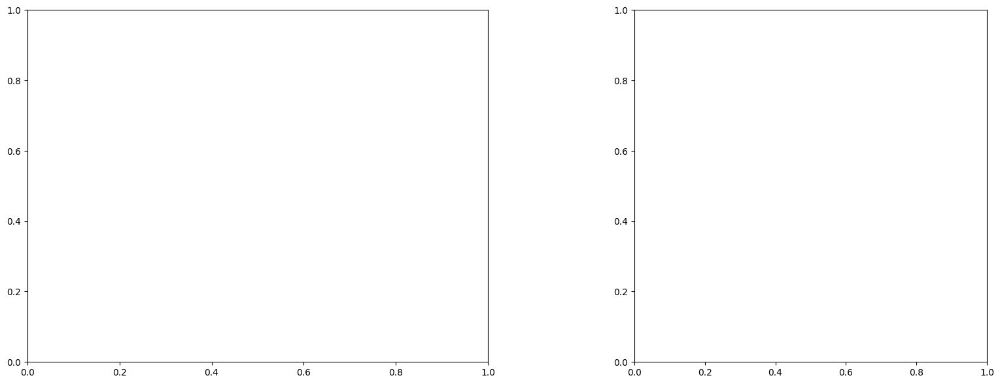

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

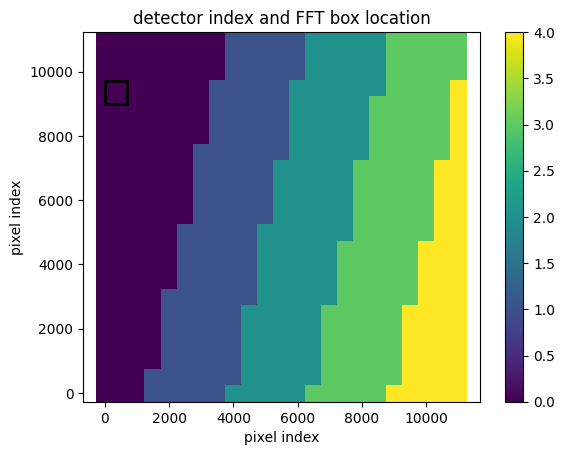

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


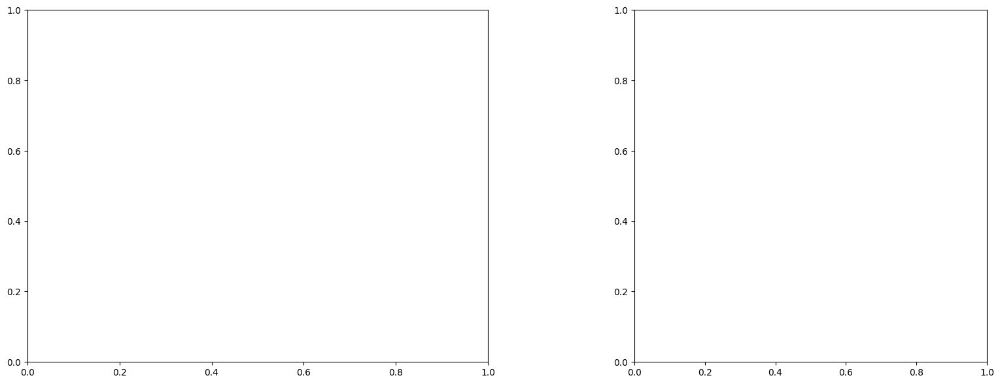

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fi

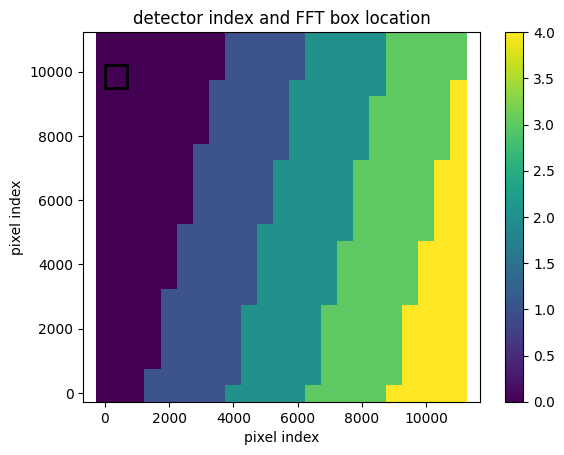

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


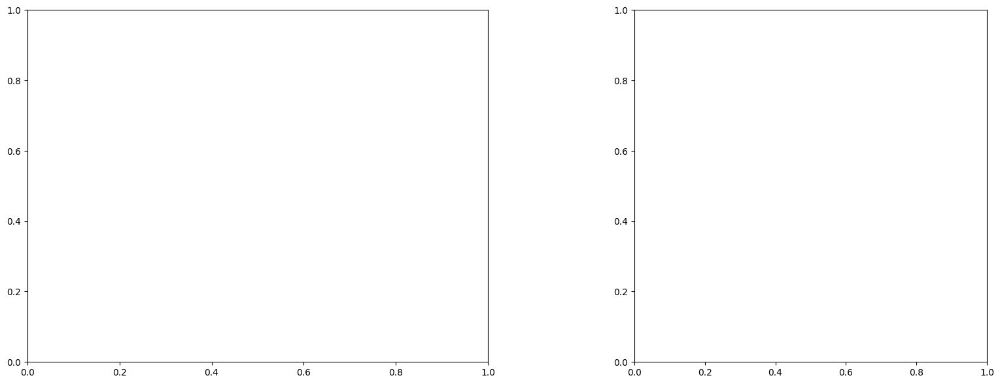

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading f

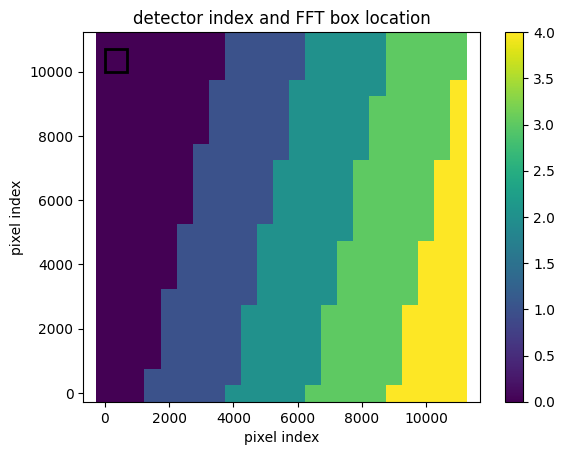

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


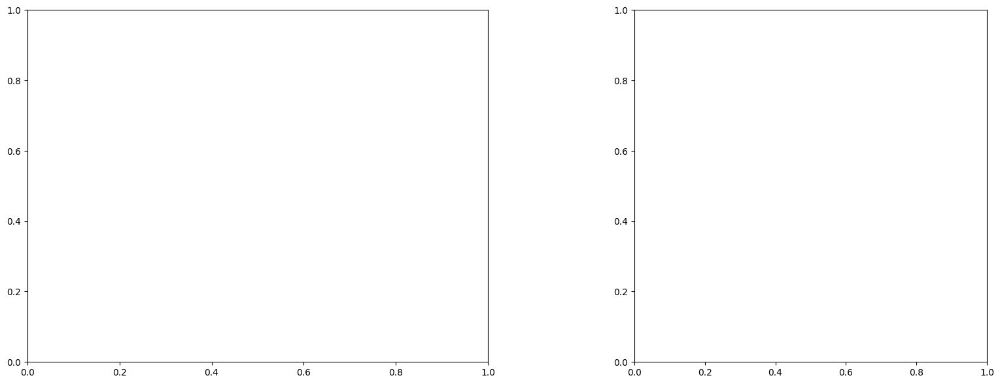

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [0, 700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading f

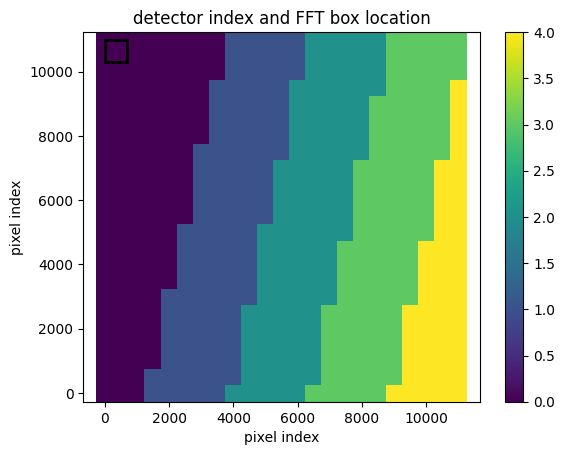

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


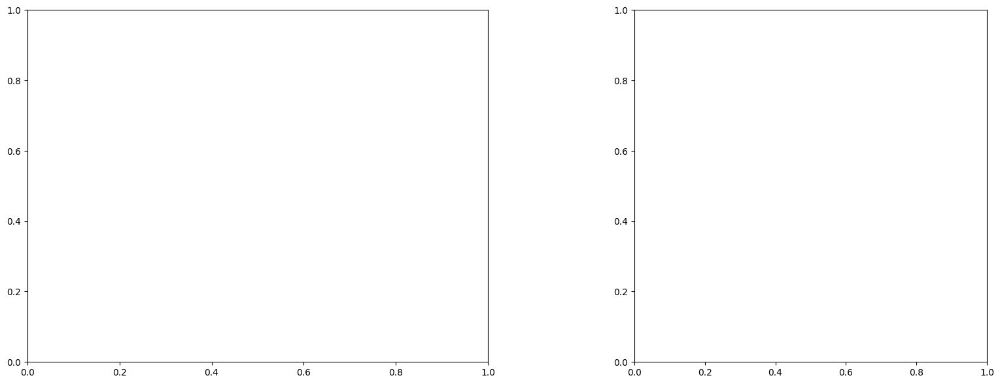

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading file

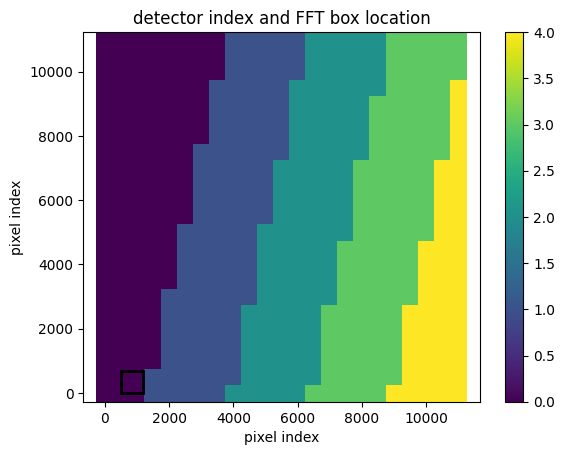

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


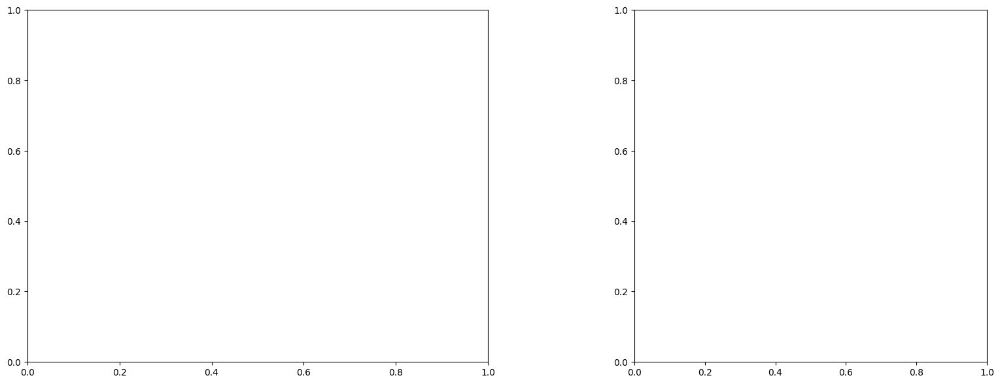

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading f

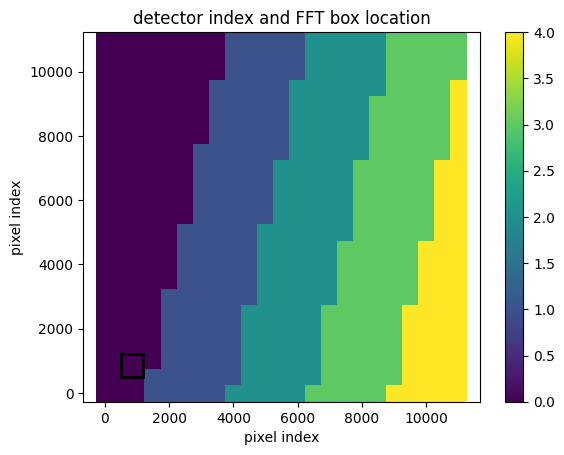

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


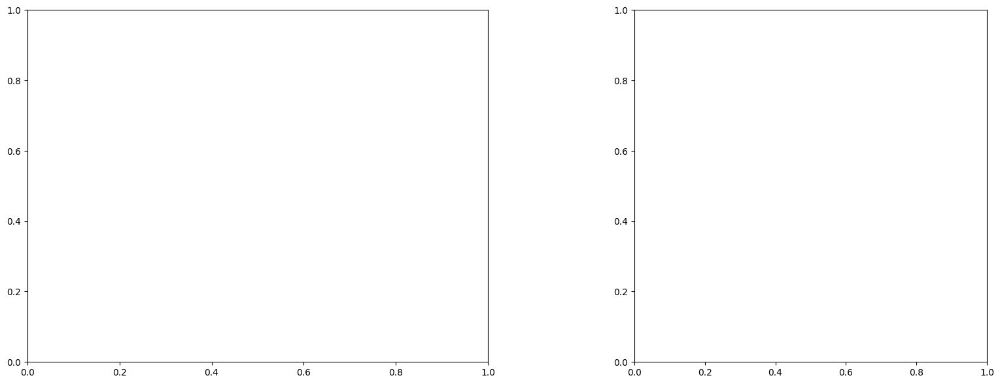

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

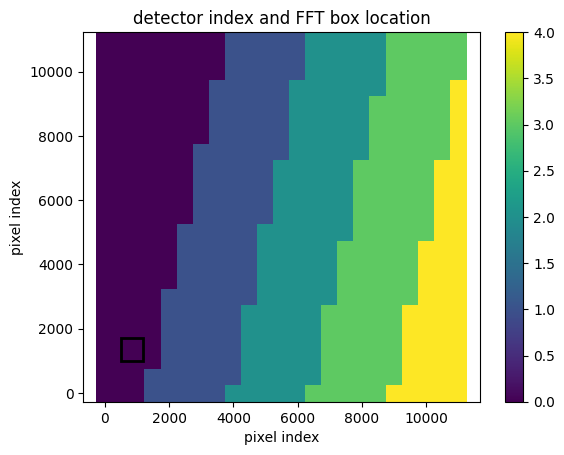

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


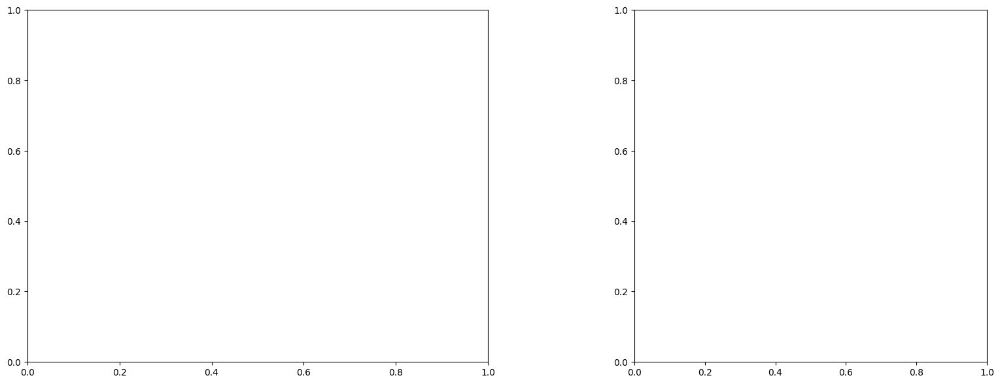

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

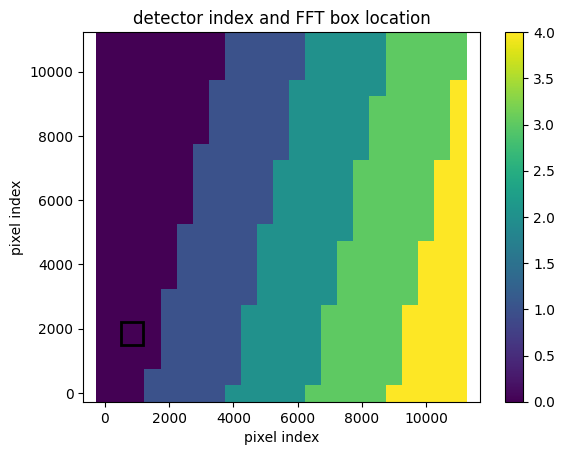

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


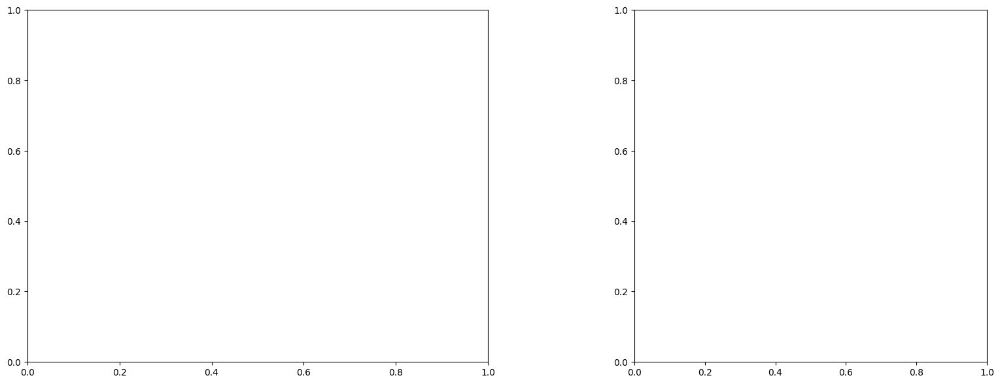

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

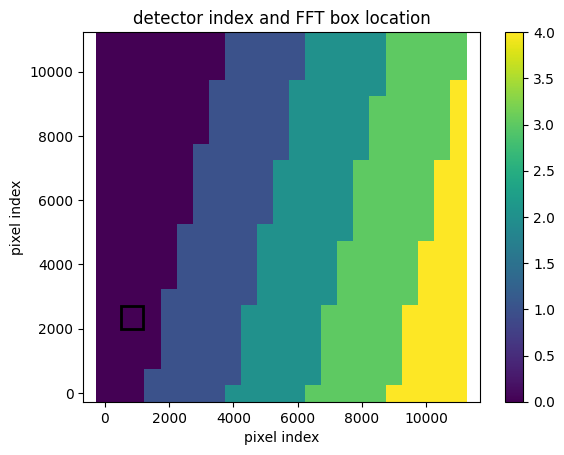

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


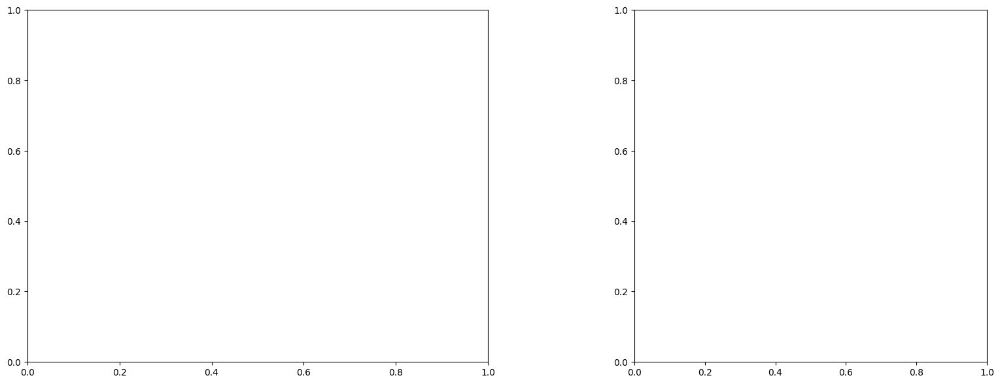

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

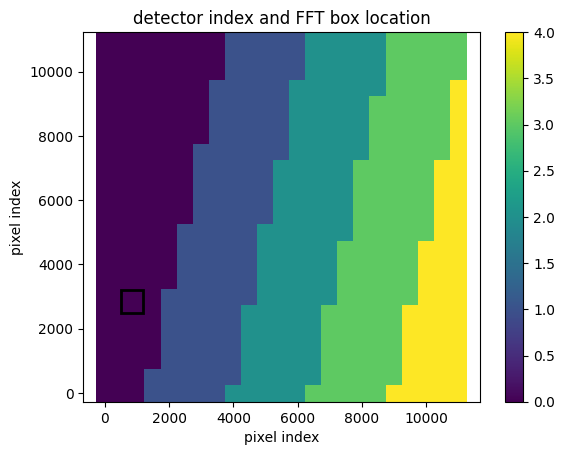

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


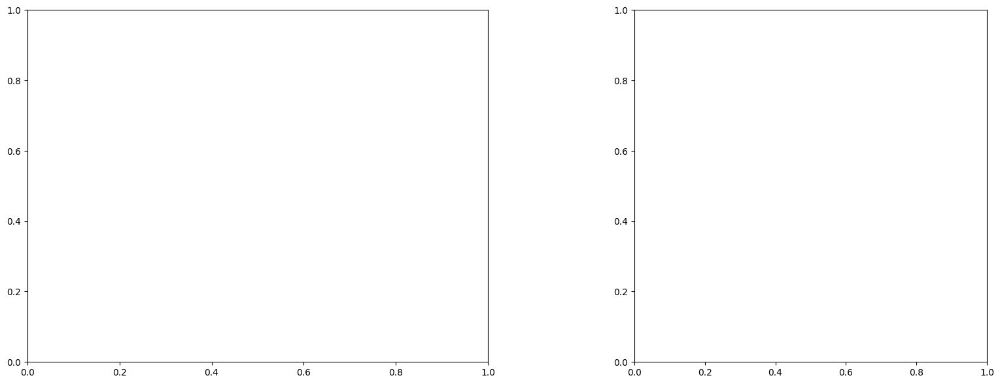

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

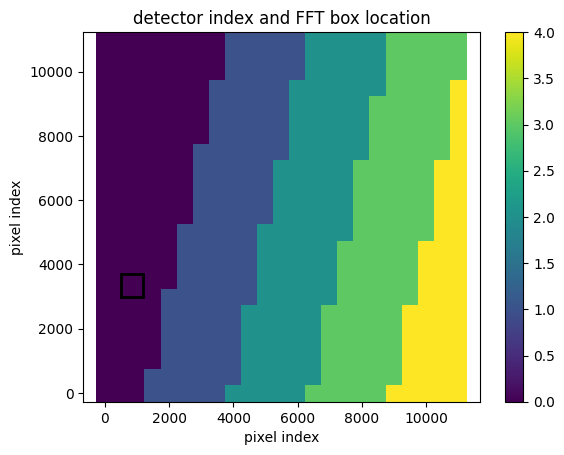

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


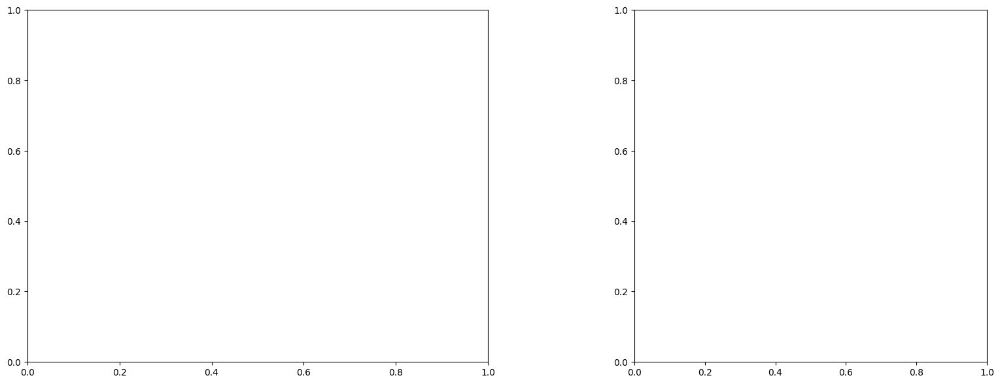

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

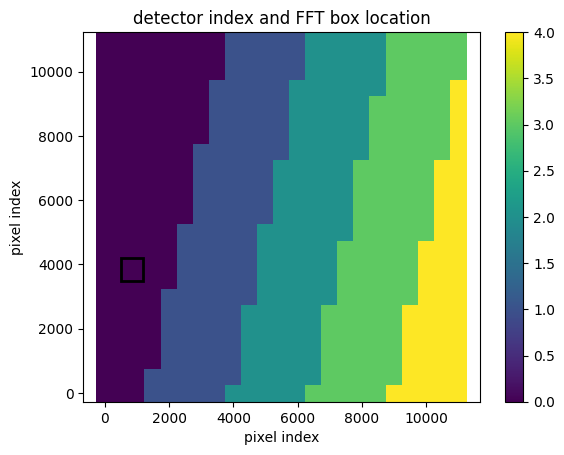

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


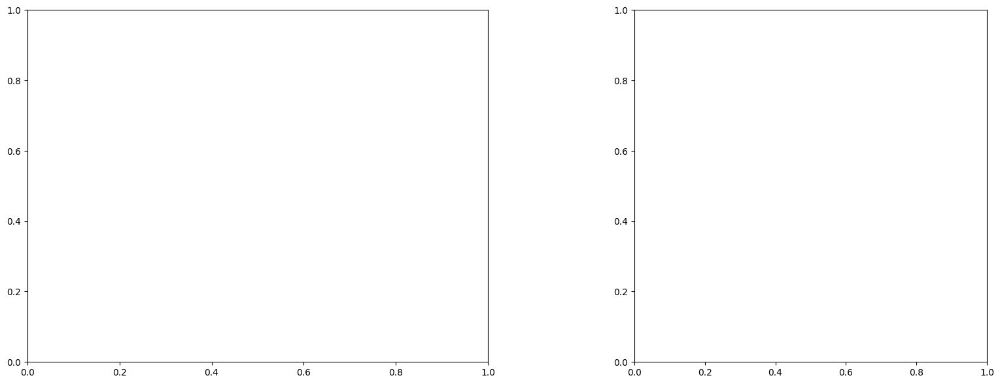

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

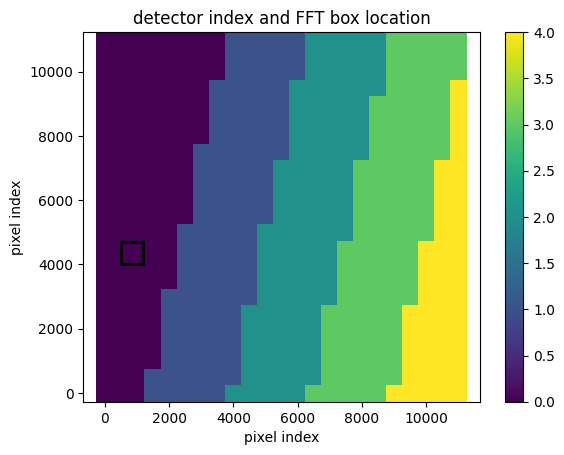

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


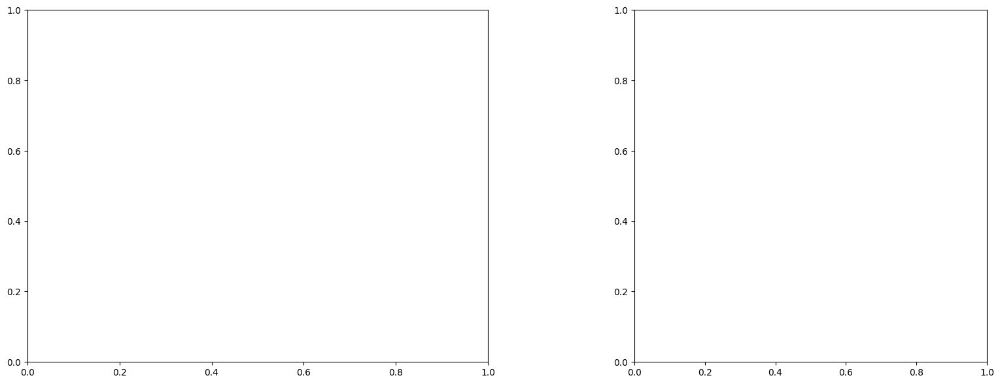

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

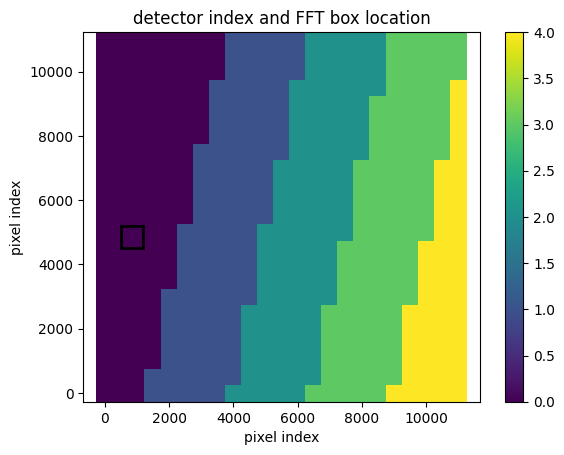

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


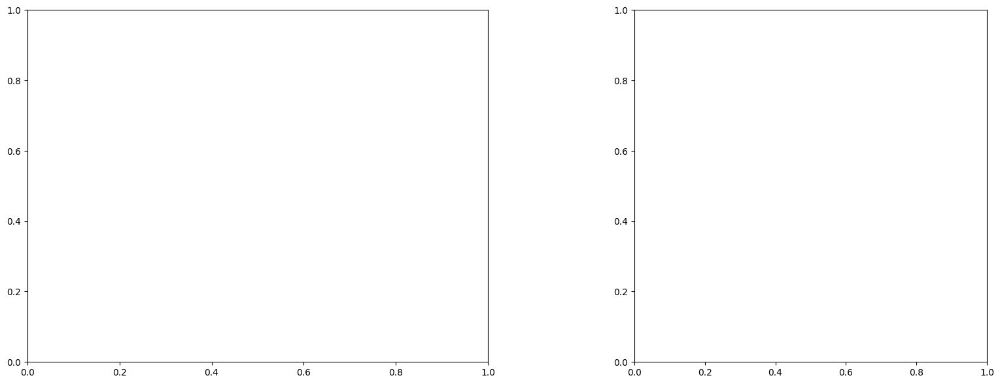

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

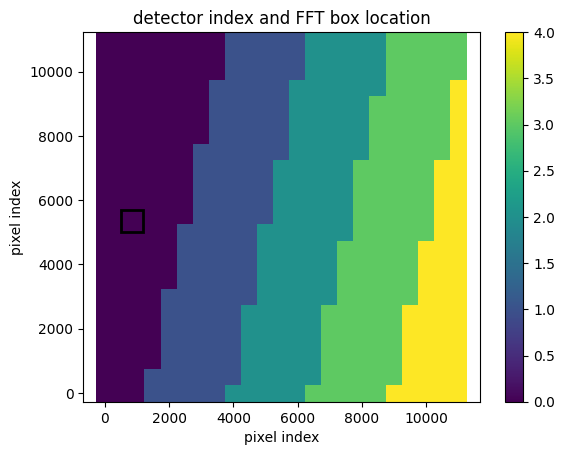

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


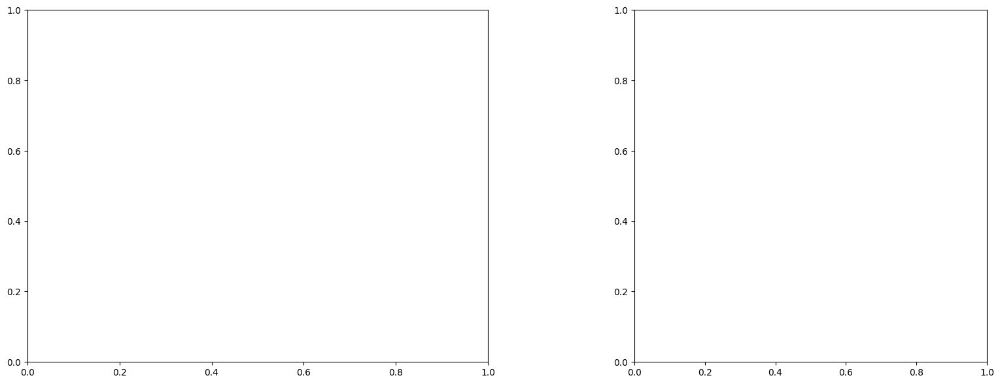

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

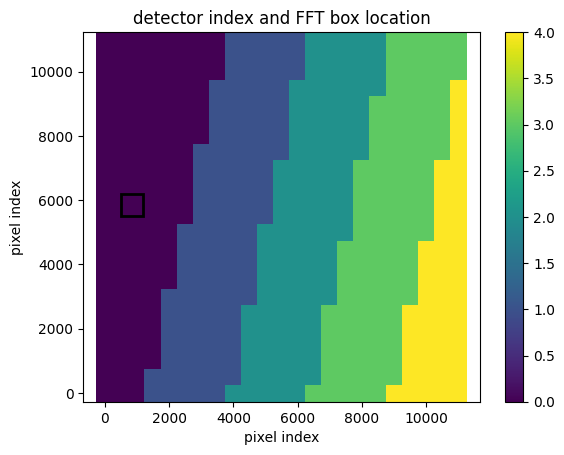

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


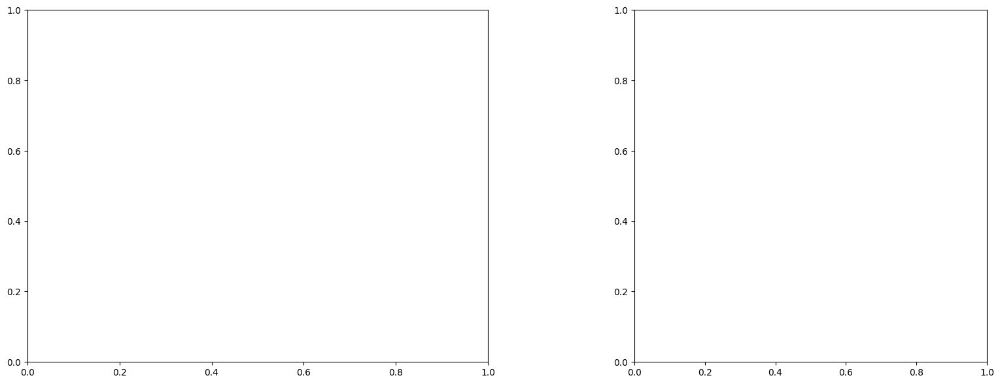

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

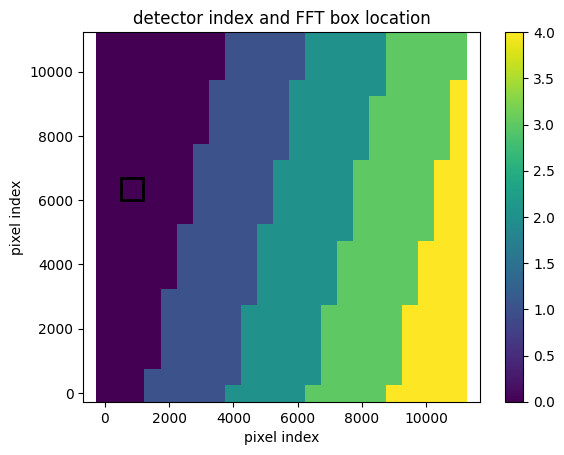

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


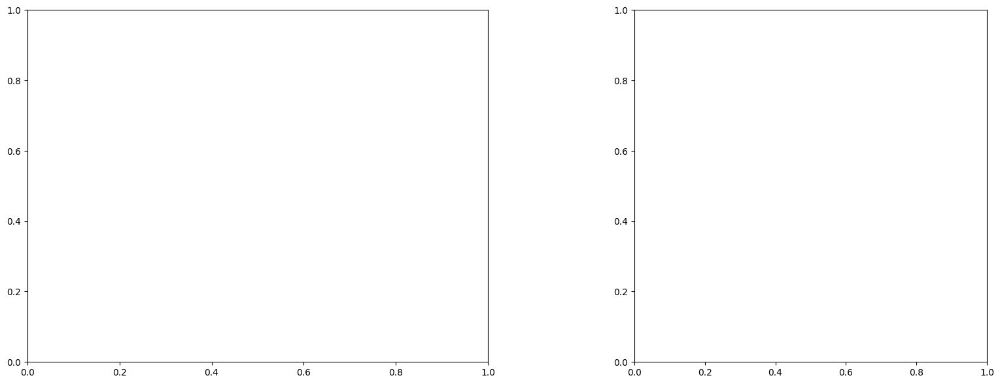

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

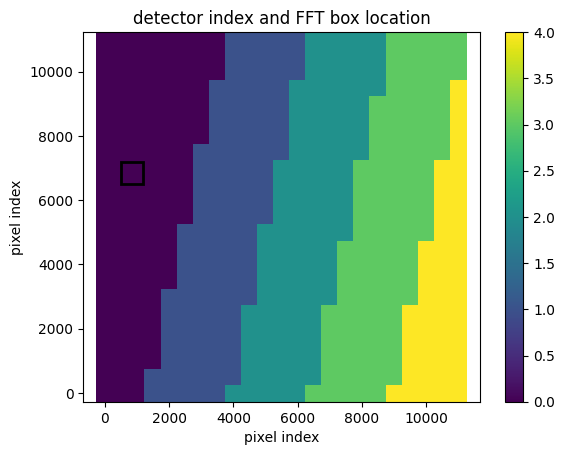

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


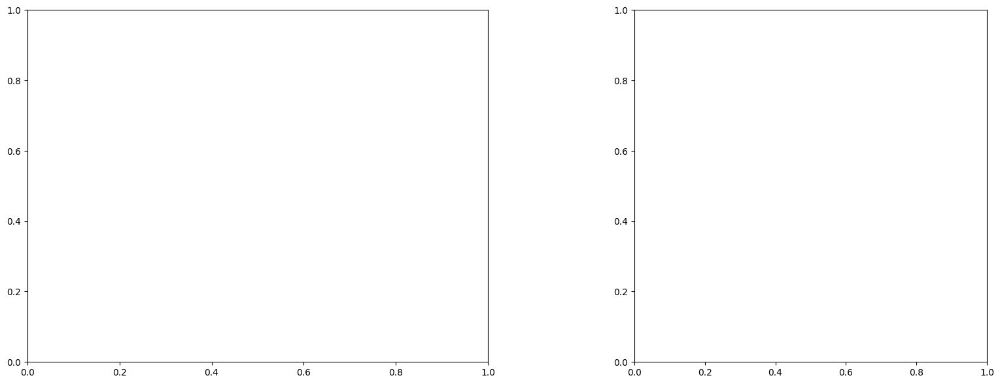

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

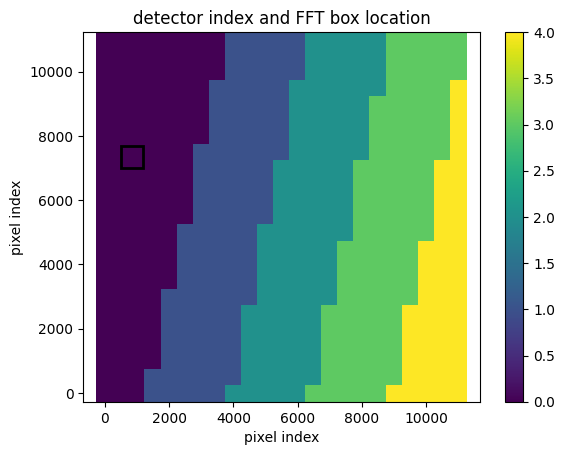

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


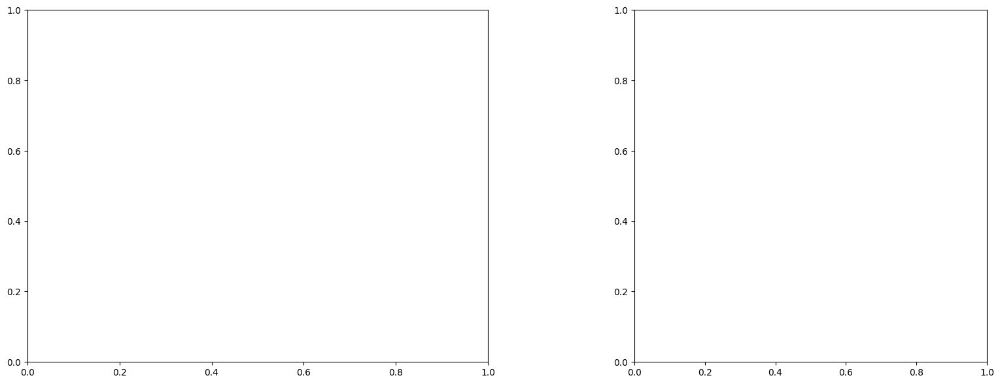

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

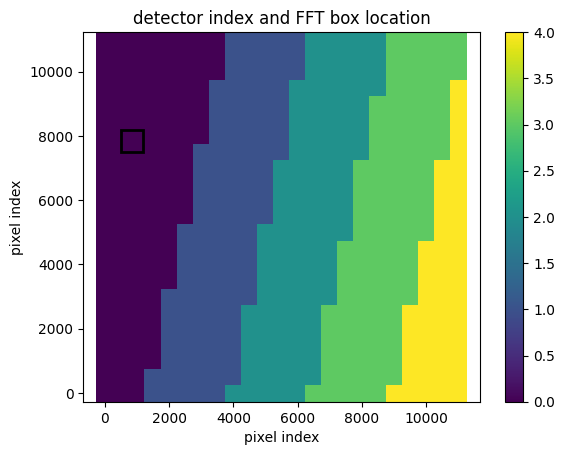

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


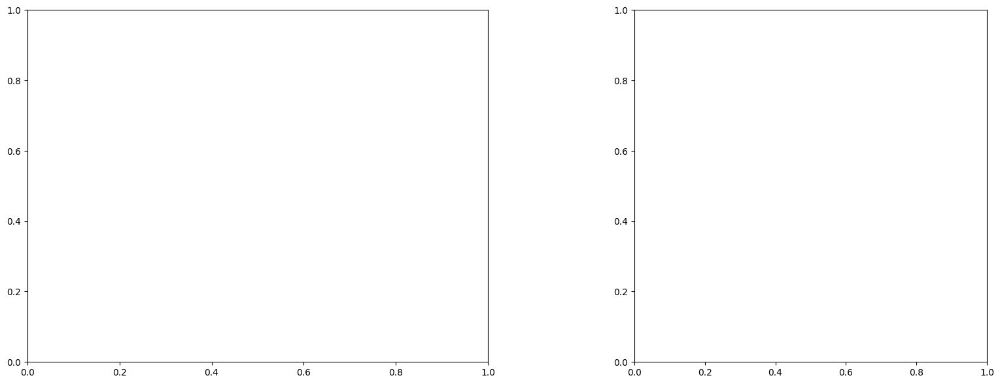

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

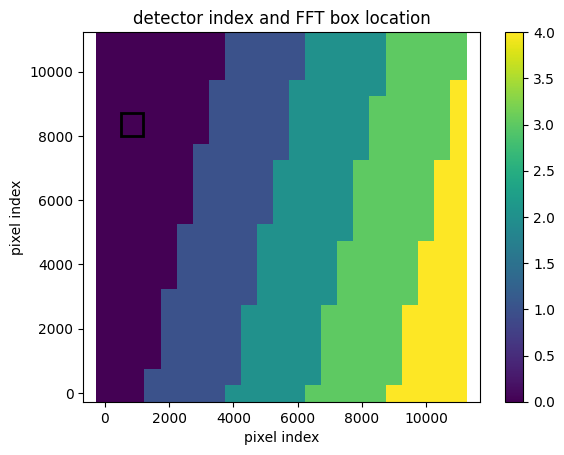

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


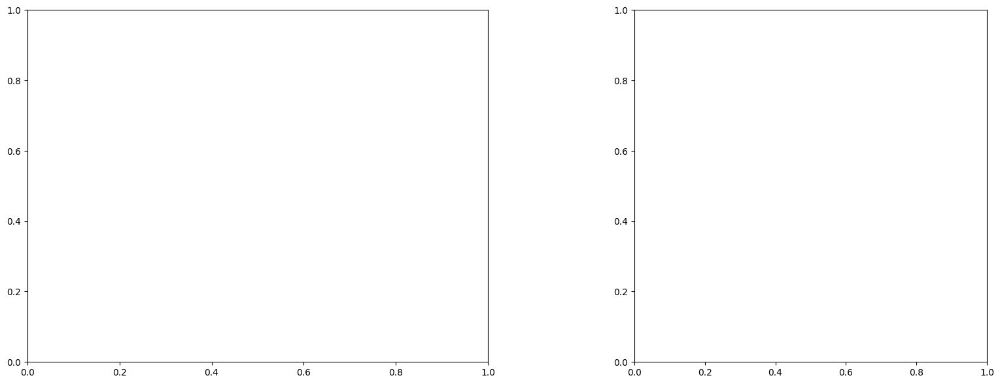

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

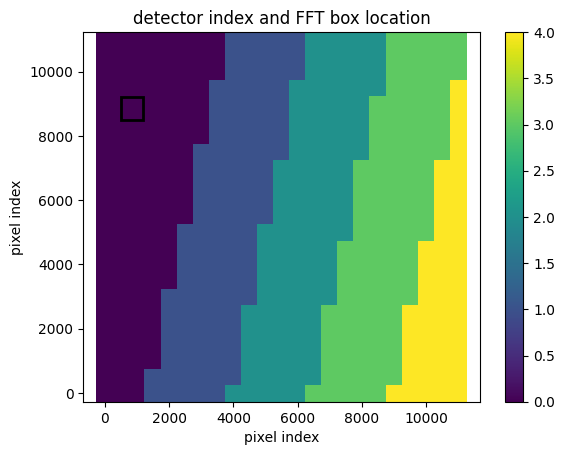

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


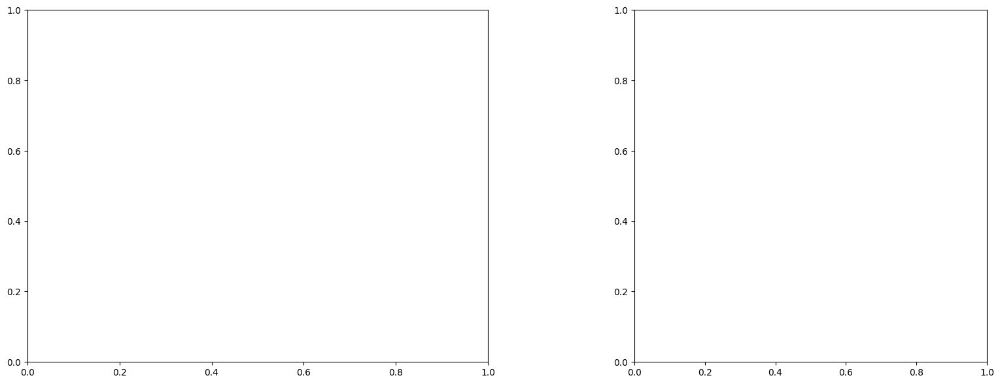

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

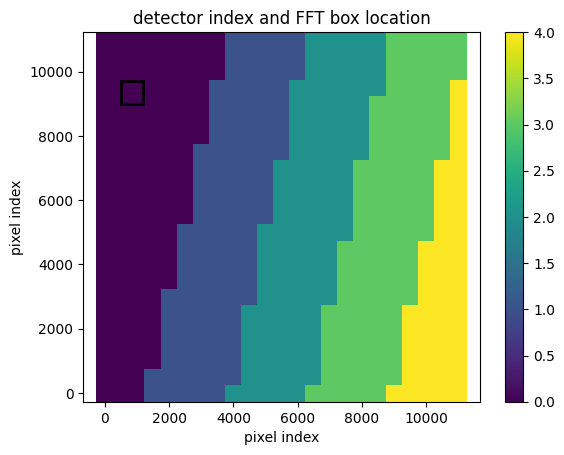

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


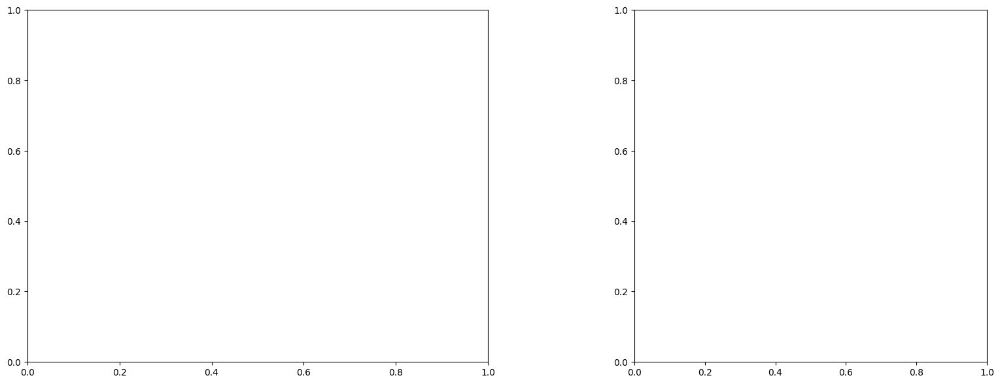

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

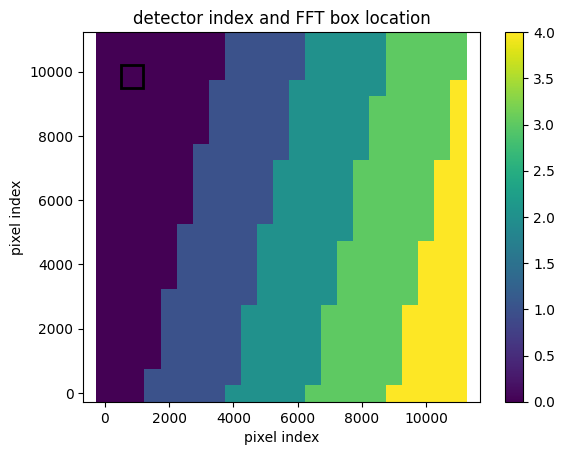

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


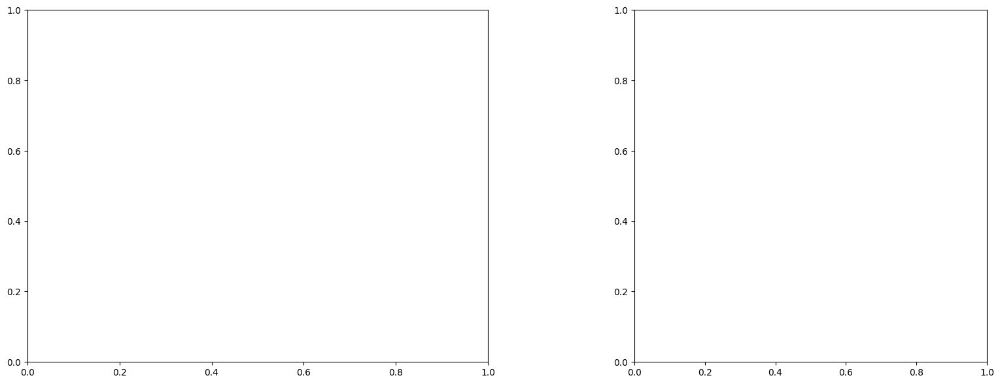

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

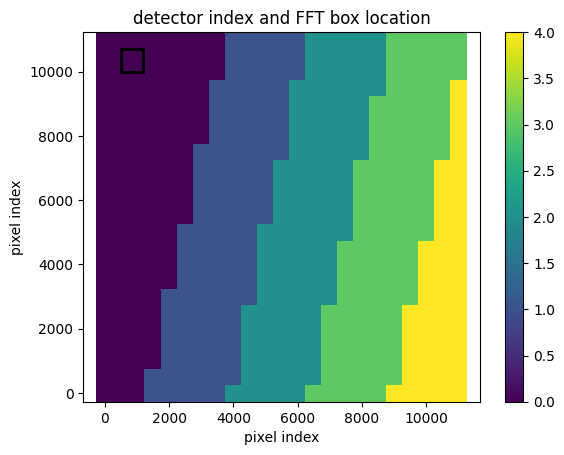

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


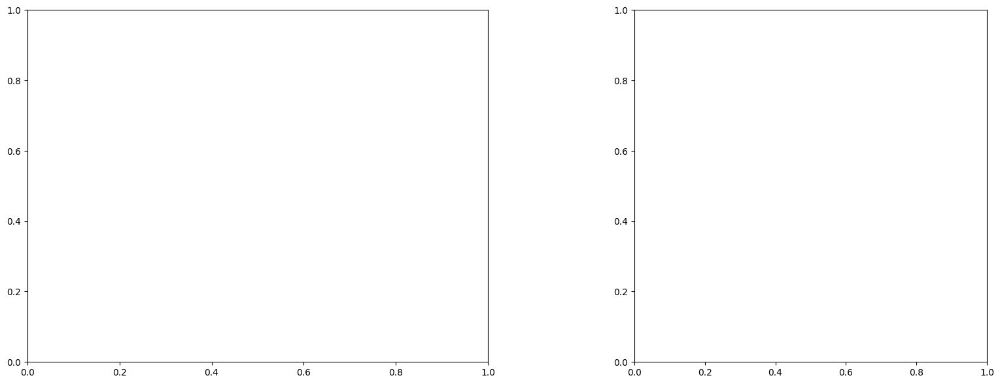

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [500, 1200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

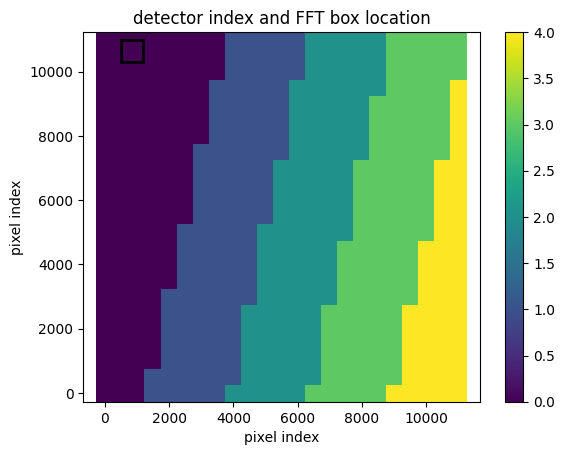

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


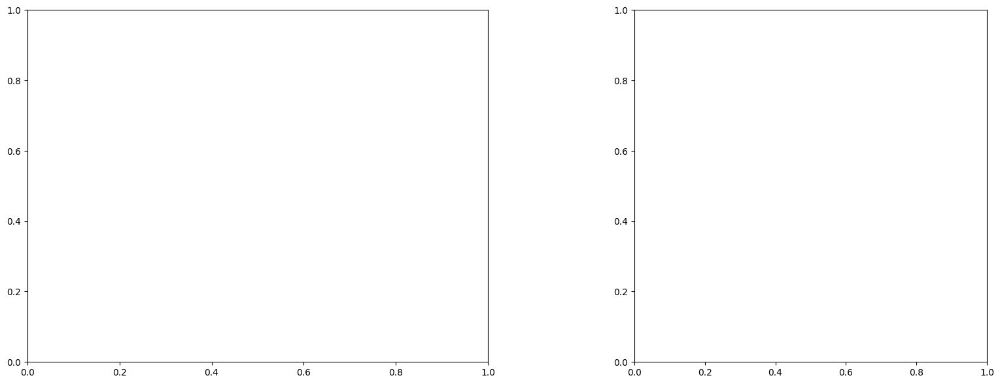

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

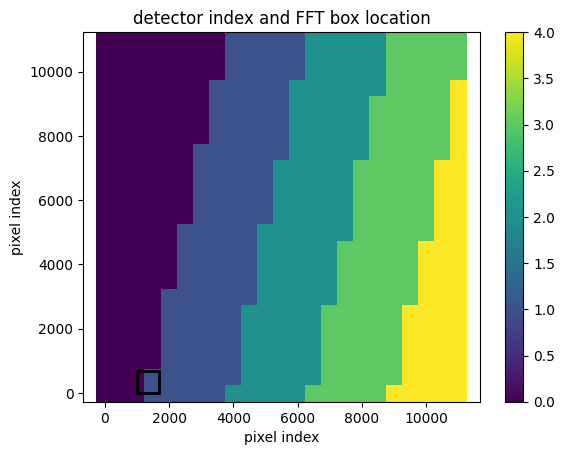

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:230: RuntimeWarning: invalid value encountered in subtract
  tile_centered=array1-np.mean(array1.flatten())
/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/spectral_analysis_functions.py:239: RuntimeWarning: invalid value encountered in subtract
  tile_centered=array2-np.mean(array2.flatten())


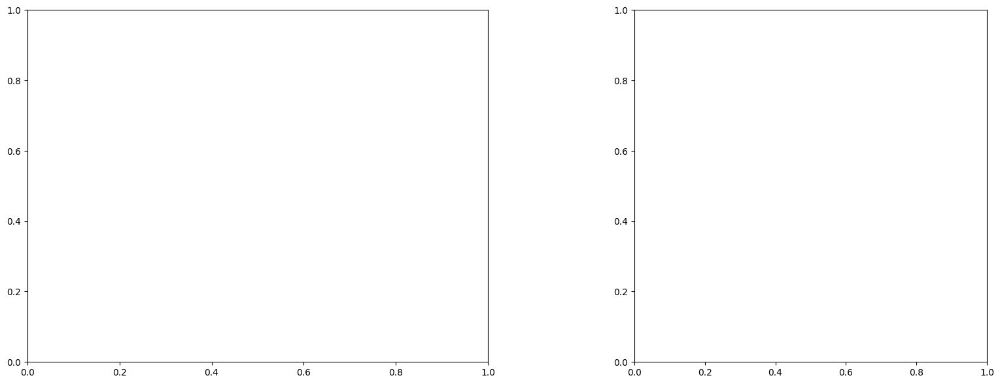

LinAlgError: Singular matrix

box [1000, 1700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

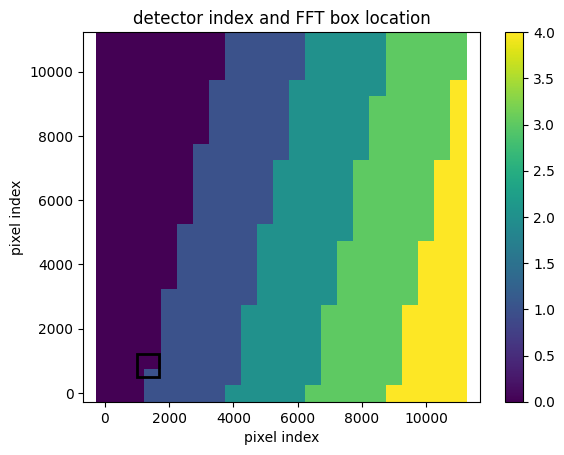

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


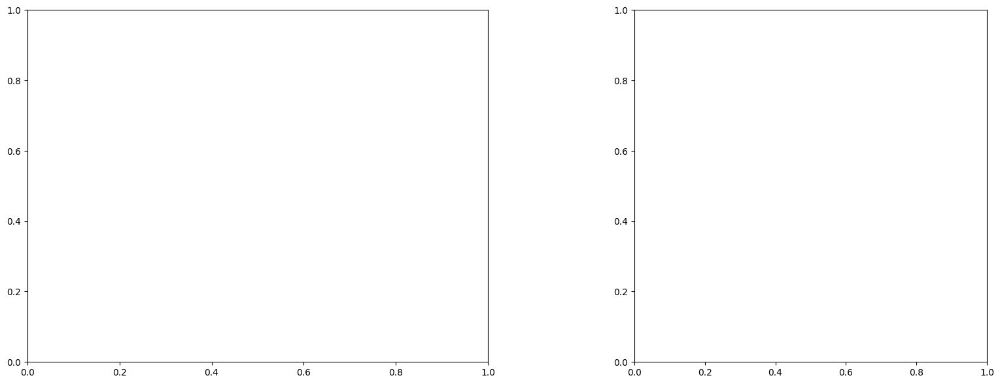

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

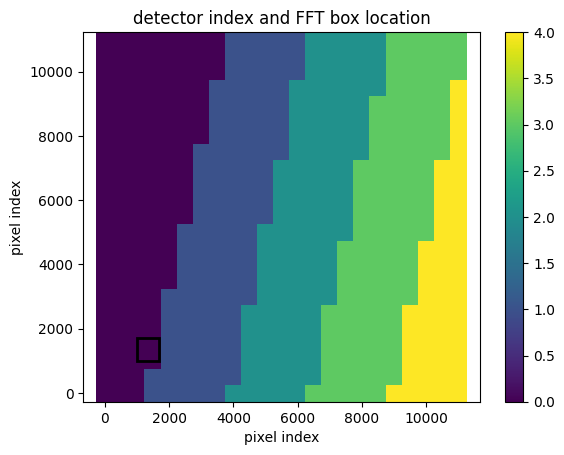

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


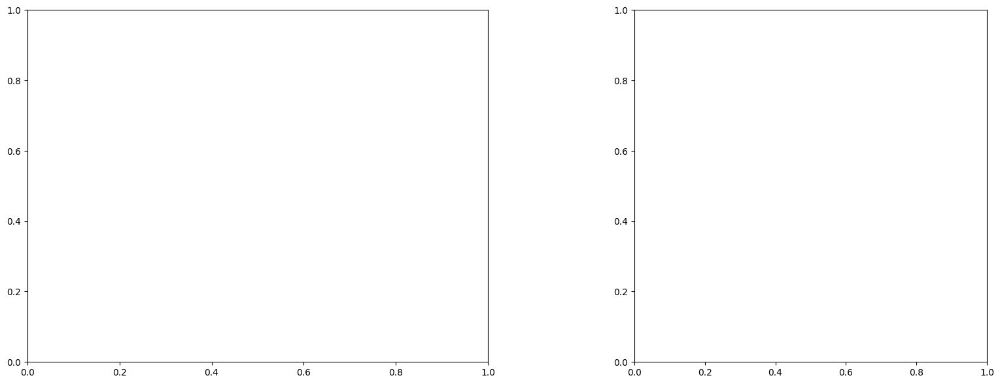

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

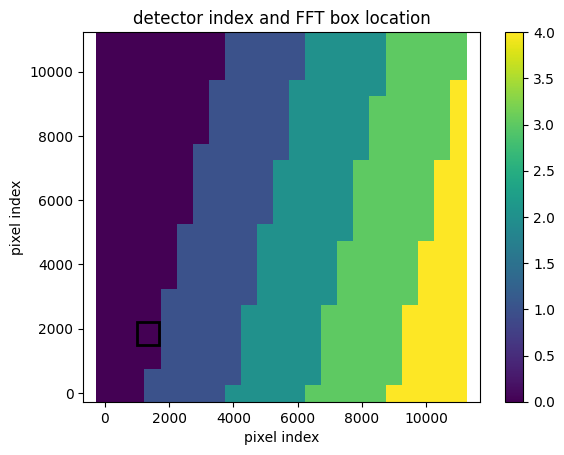

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


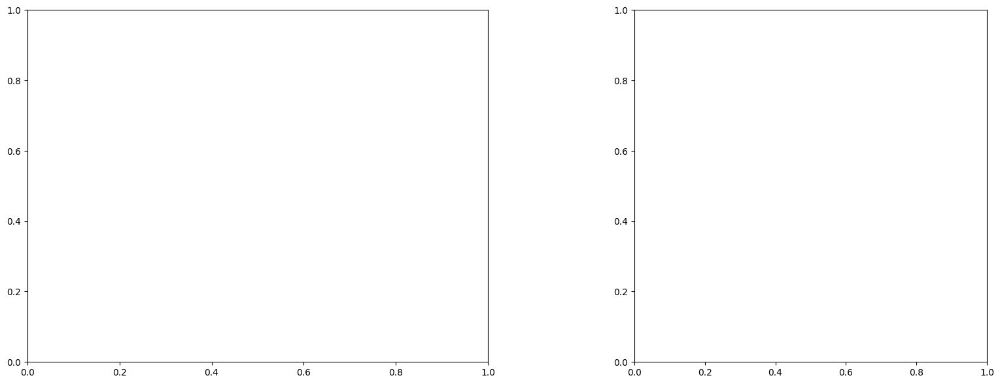

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

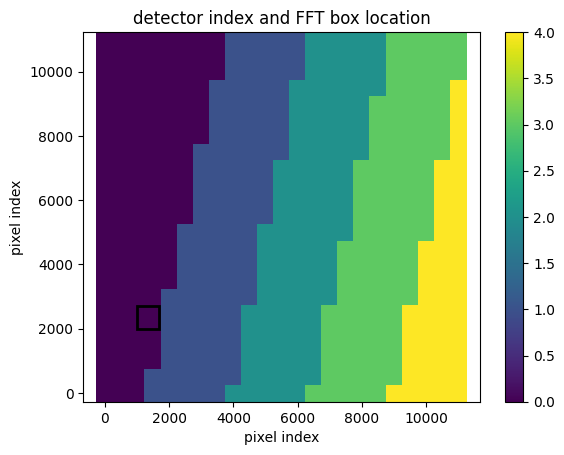

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


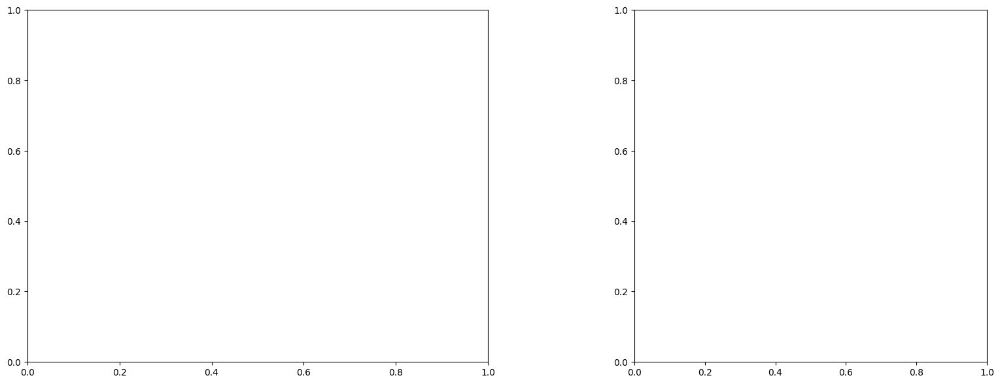

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

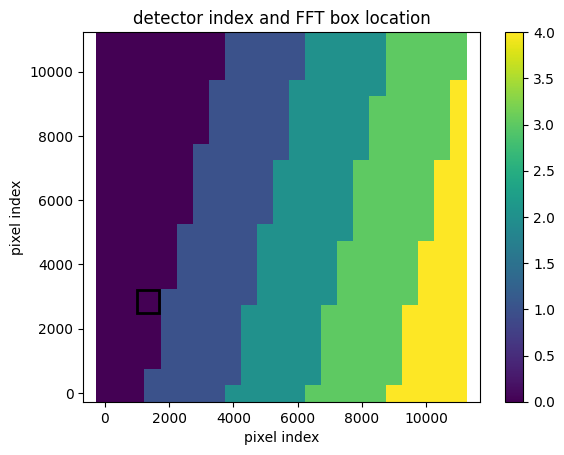

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


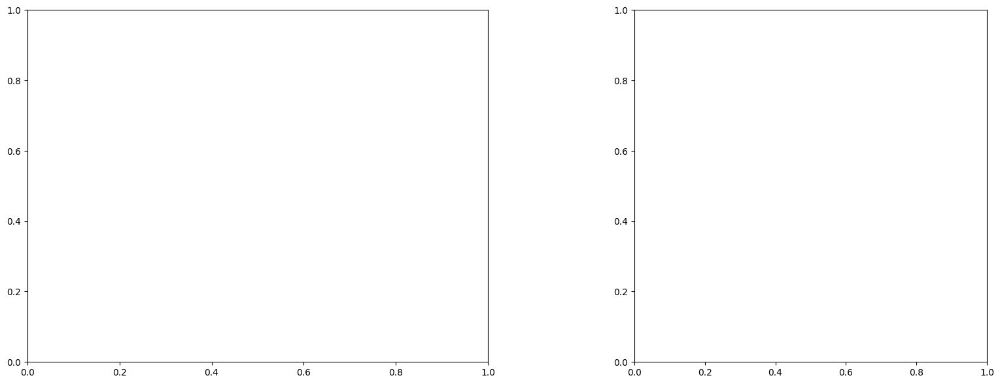

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

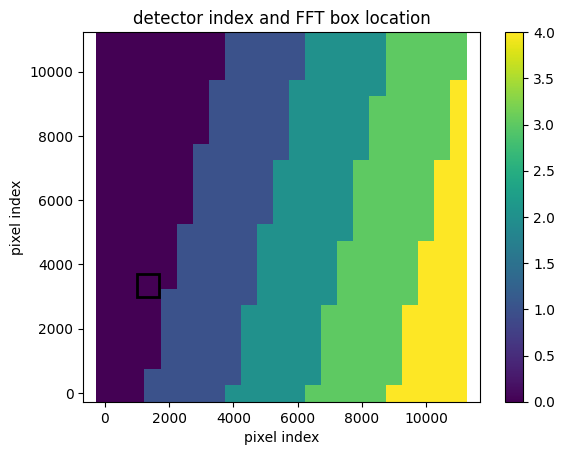

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


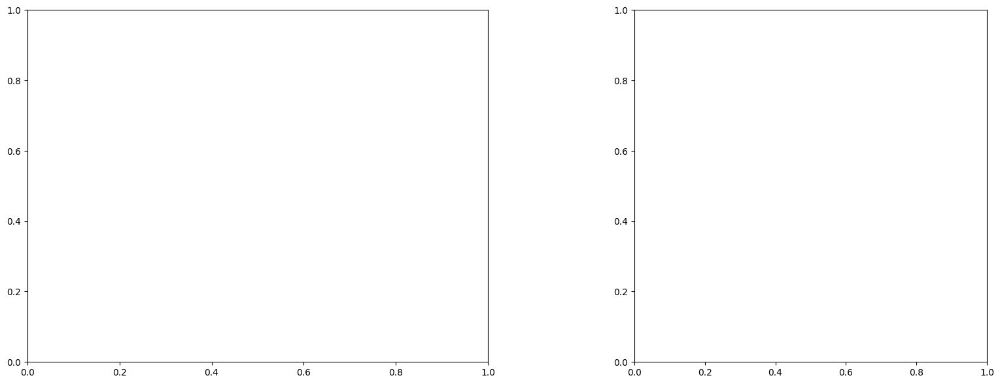

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

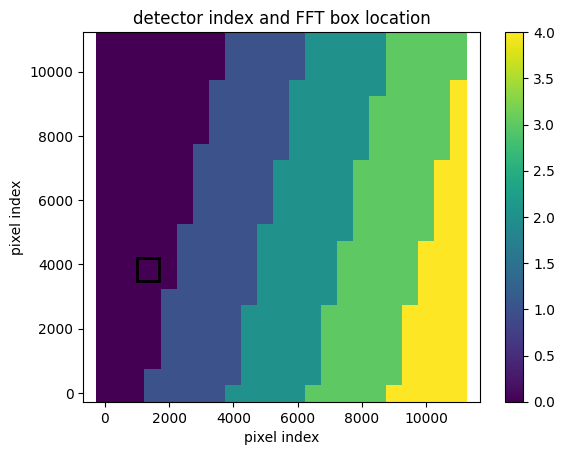

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


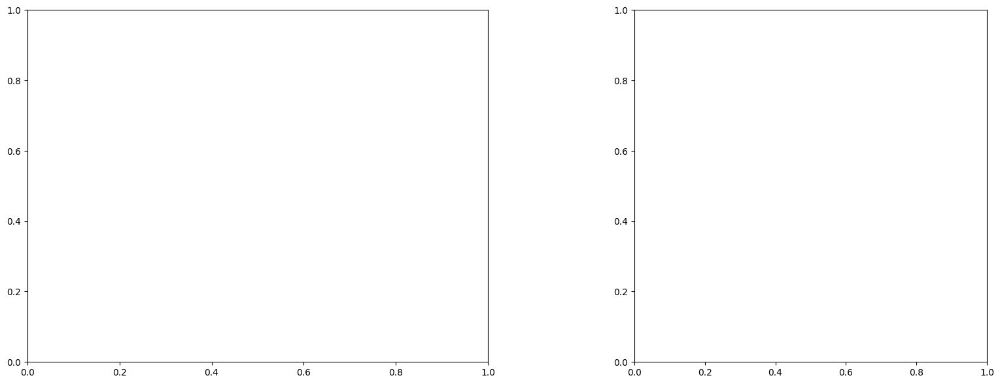

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

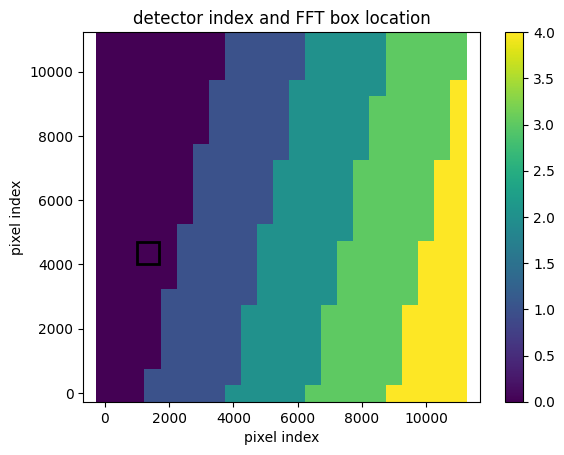

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


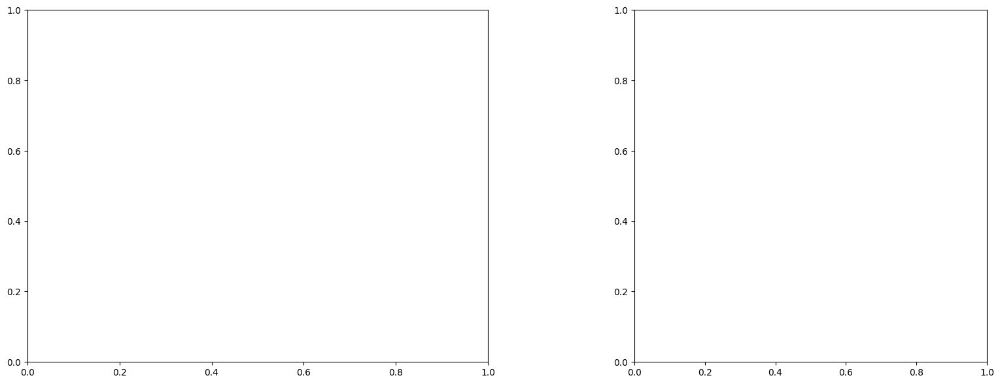

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

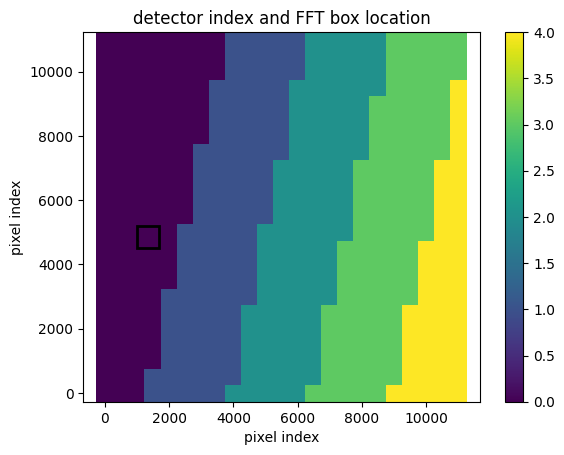

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


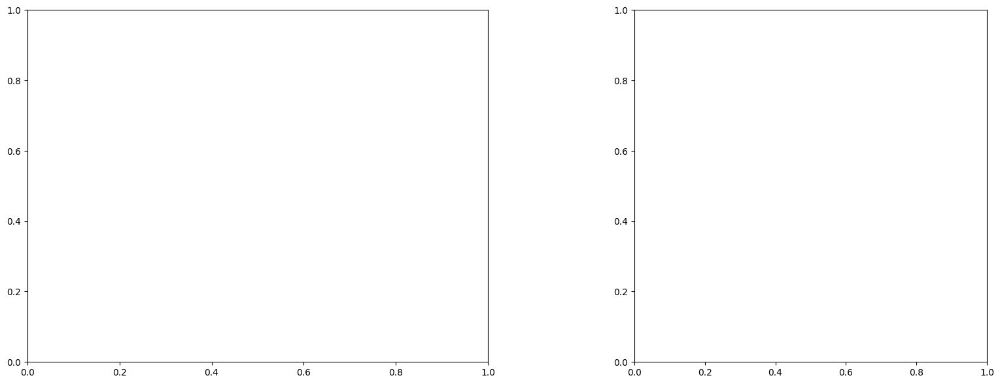

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

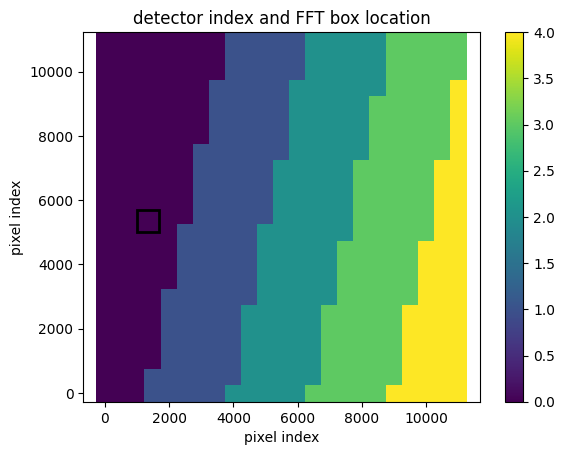

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


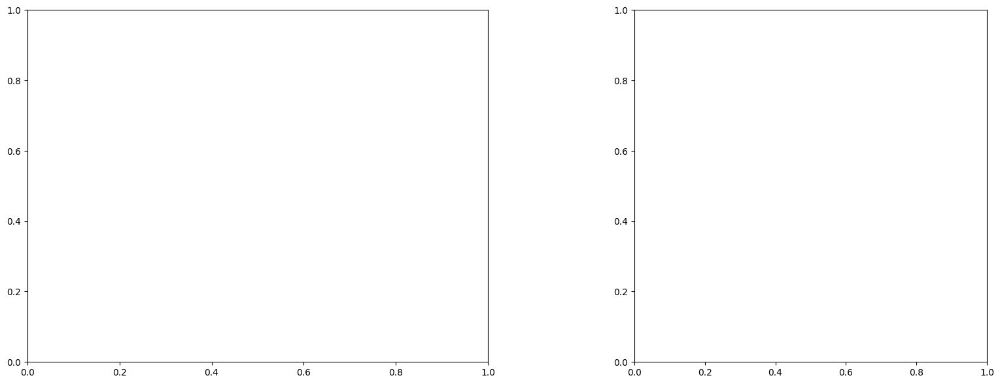

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

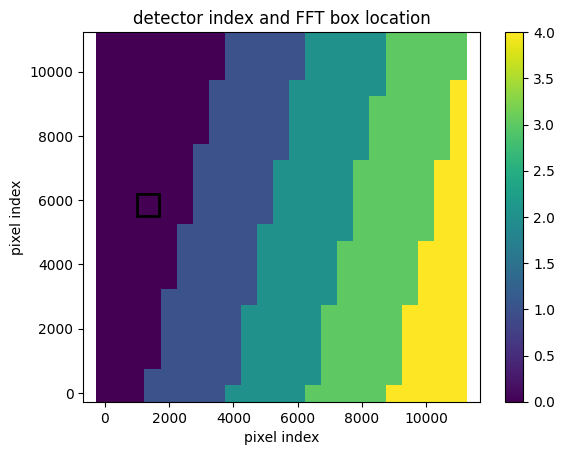

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


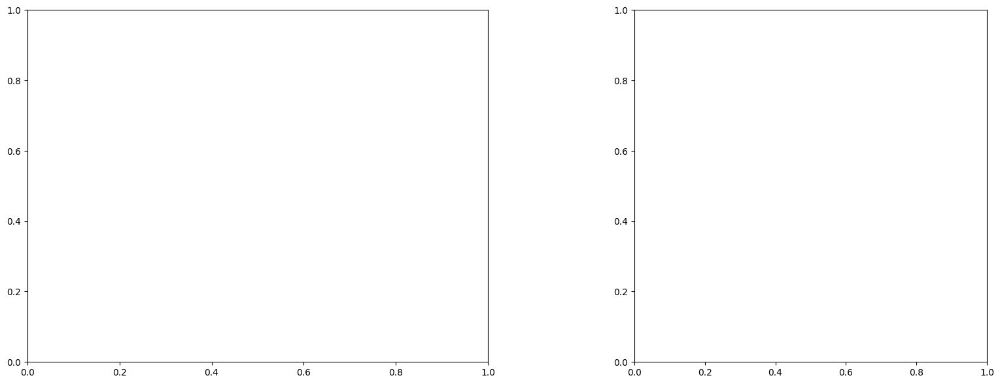

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

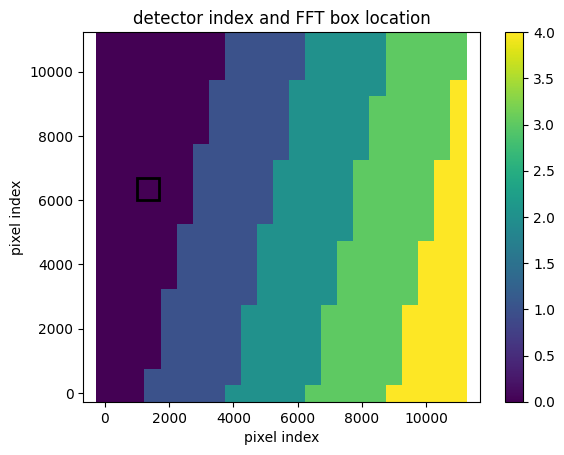

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


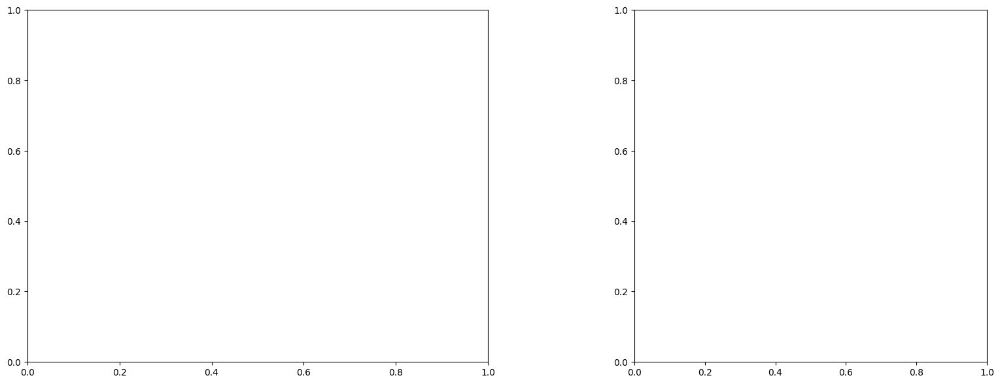

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

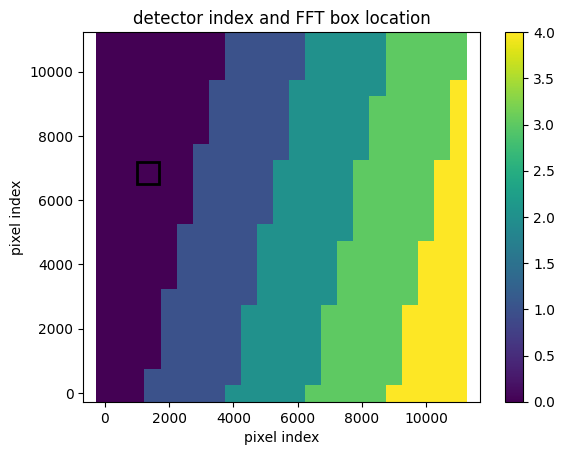

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


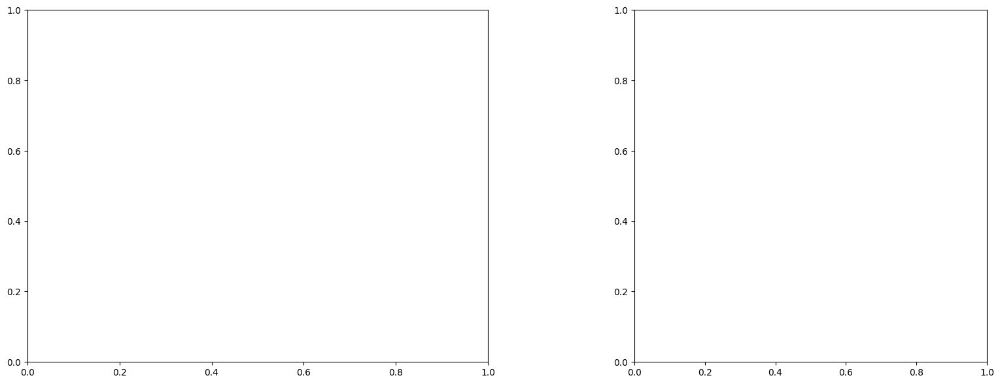

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

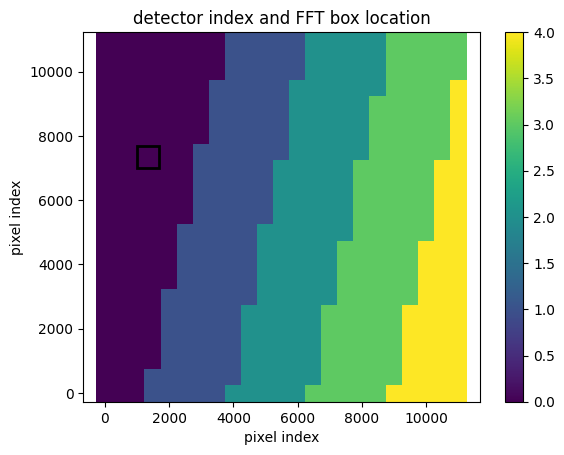

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


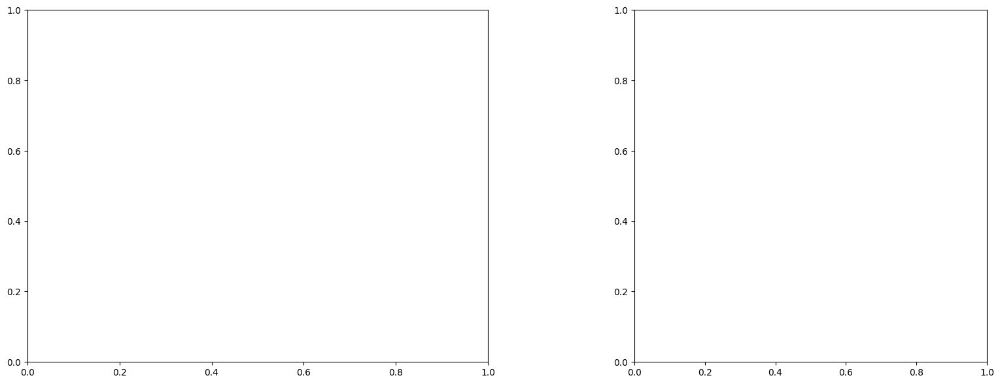

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

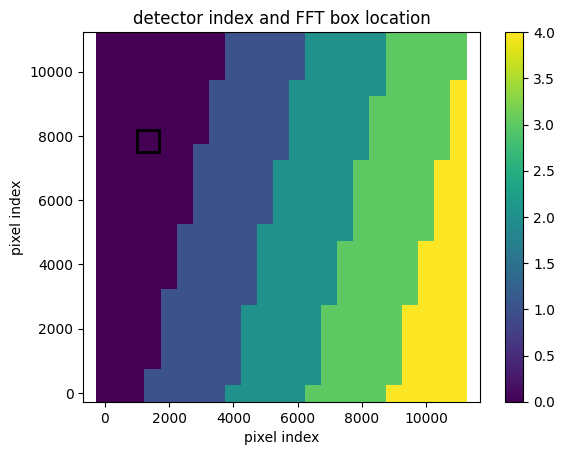

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


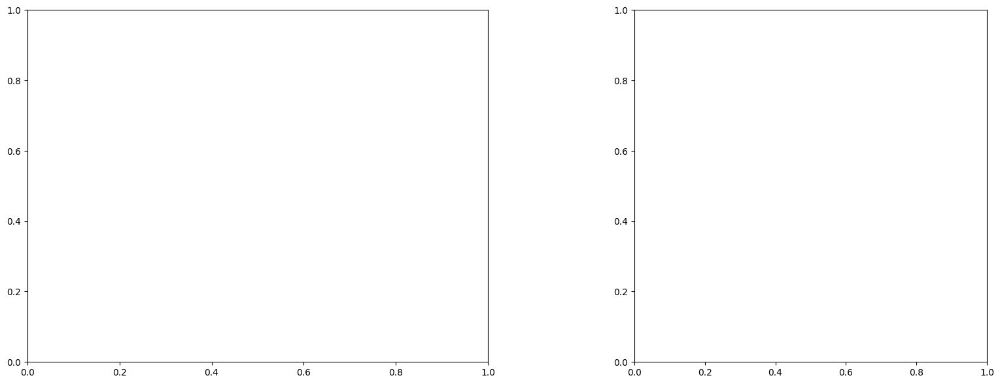

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

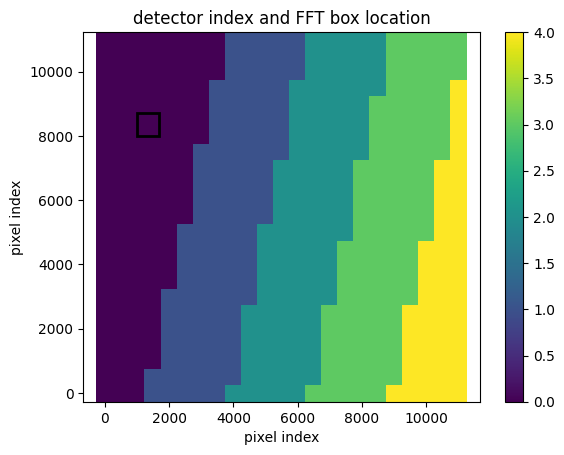

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


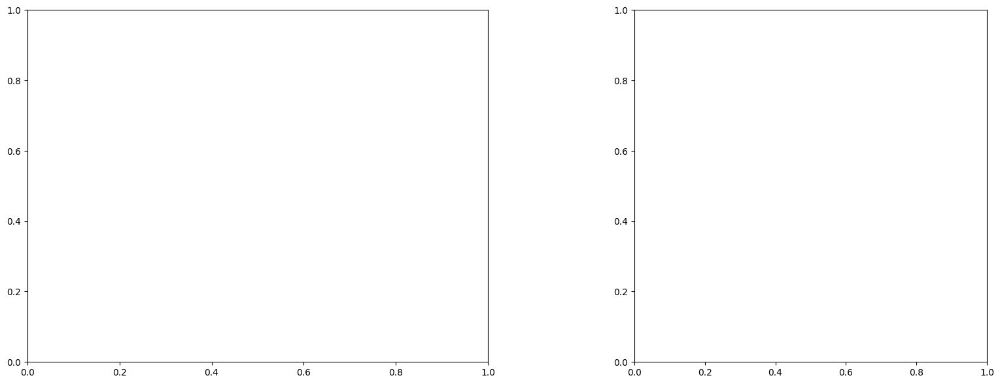

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

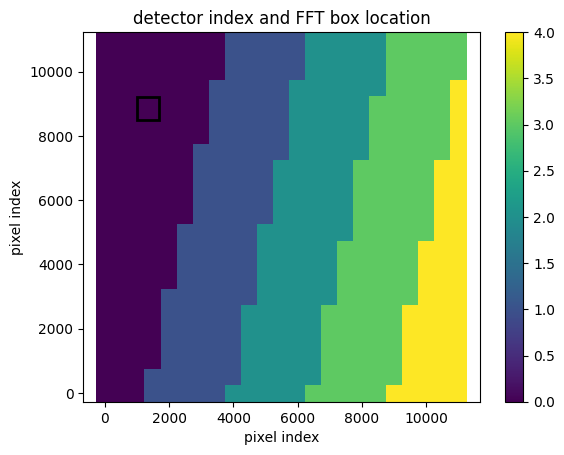

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


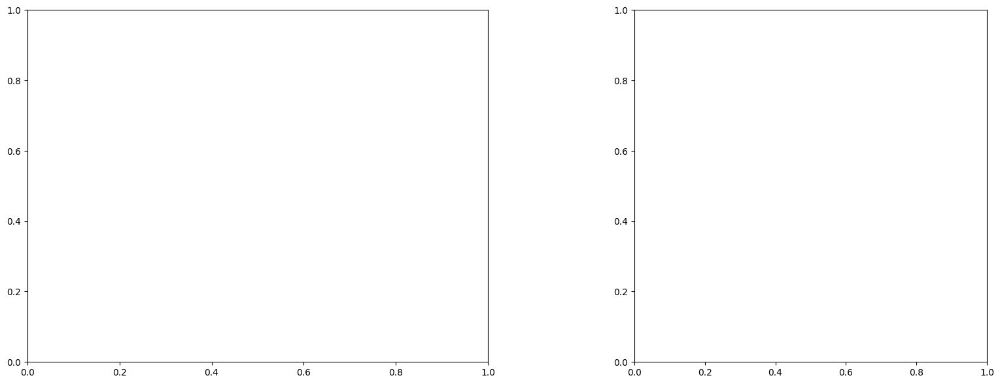

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

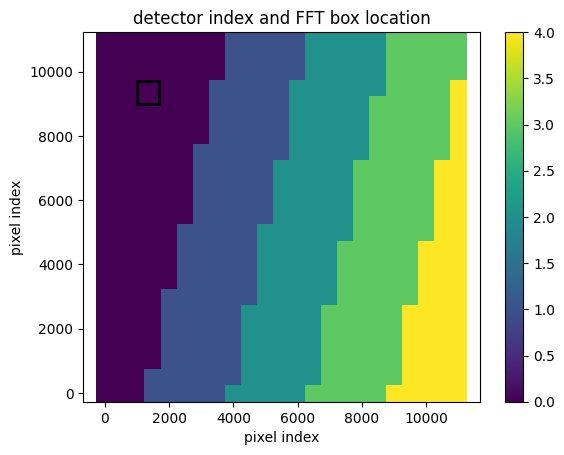

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


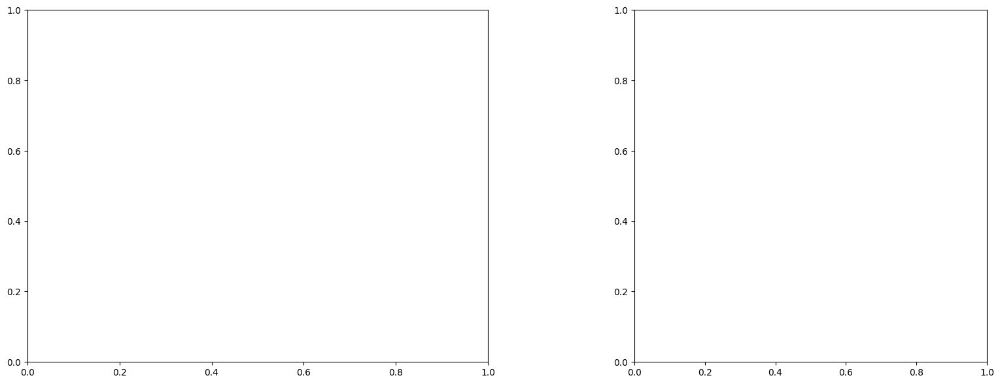

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

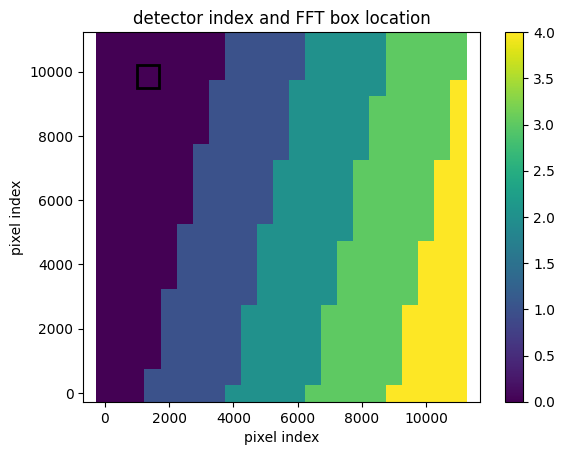

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


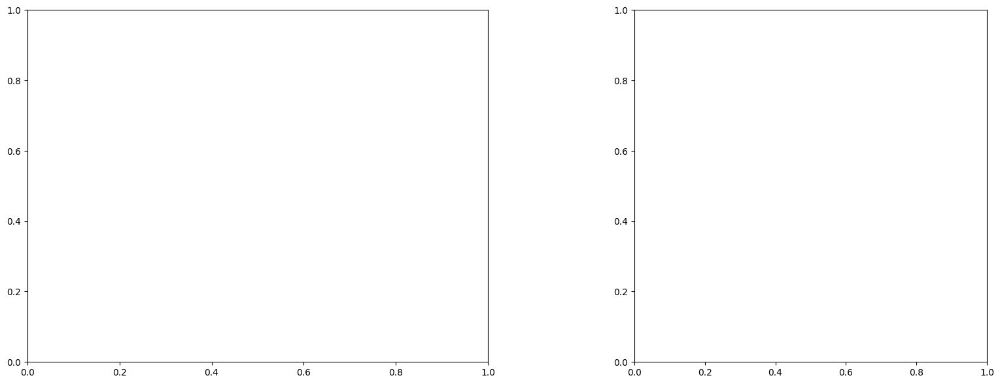

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

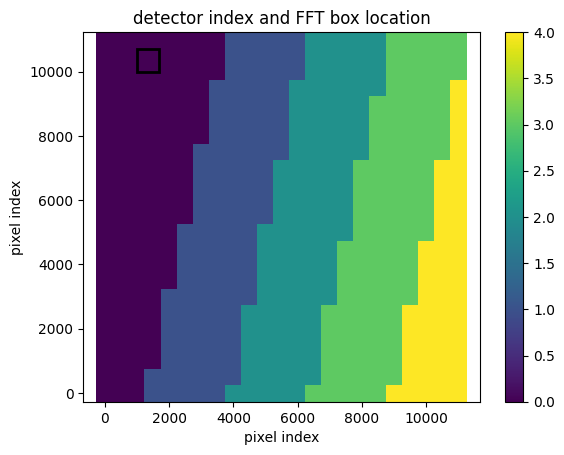

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


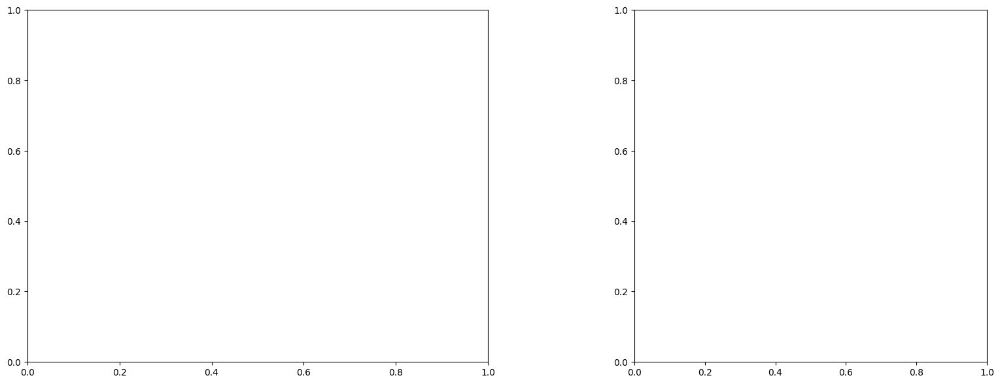

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1000, 1700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

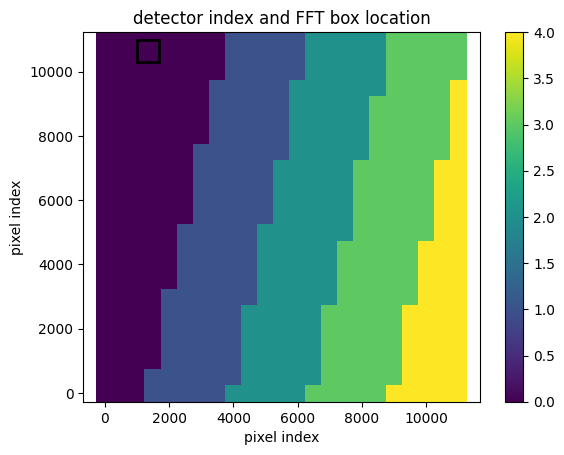

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


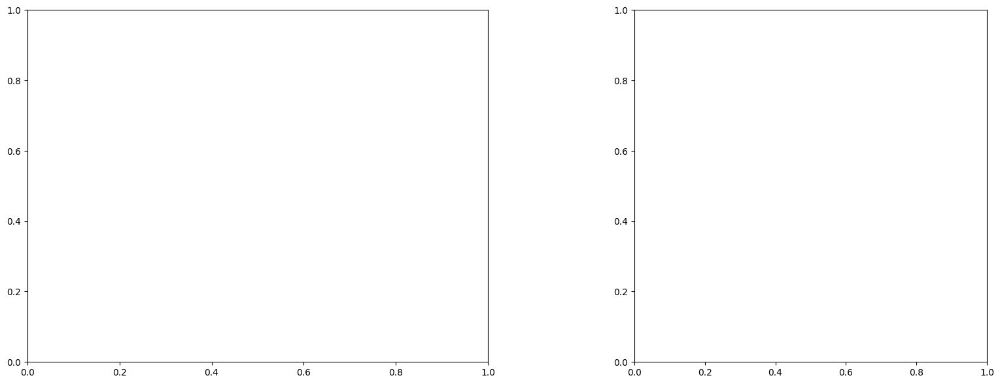

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

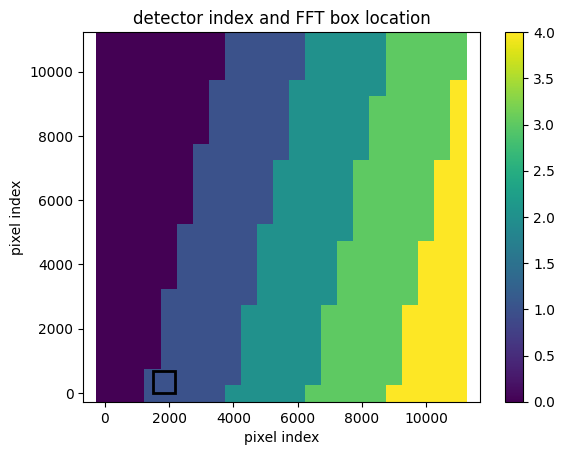

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007601696407049
(43, 43)
(43, 43)
(43, 43)


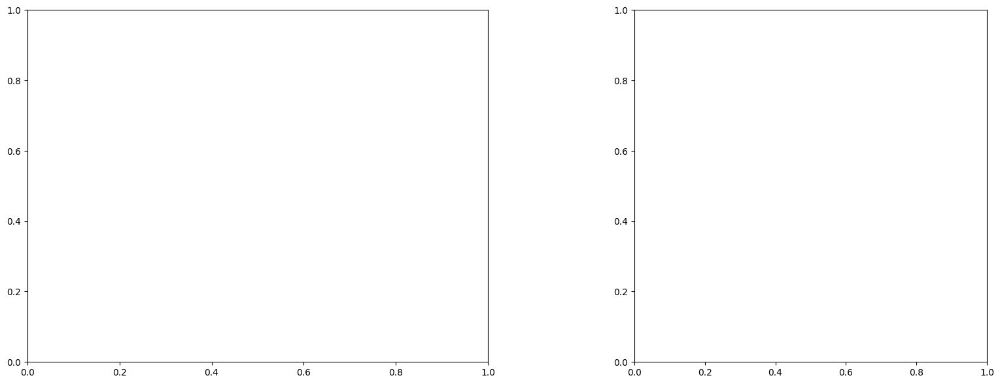

U and V components of current : [1.01834826 0.04947127]
uncertainties for U and V: 0.08531405683234264 0.06466720102368846


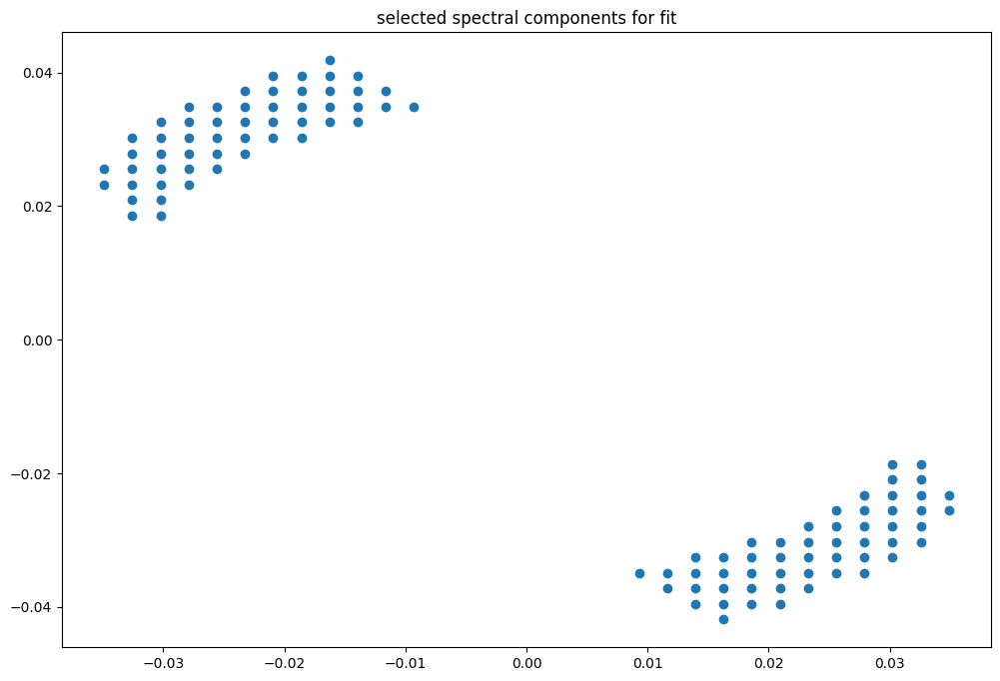

box [1500, 2200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

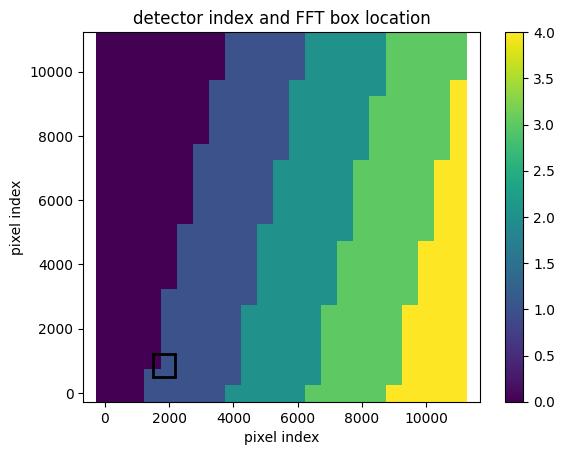

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


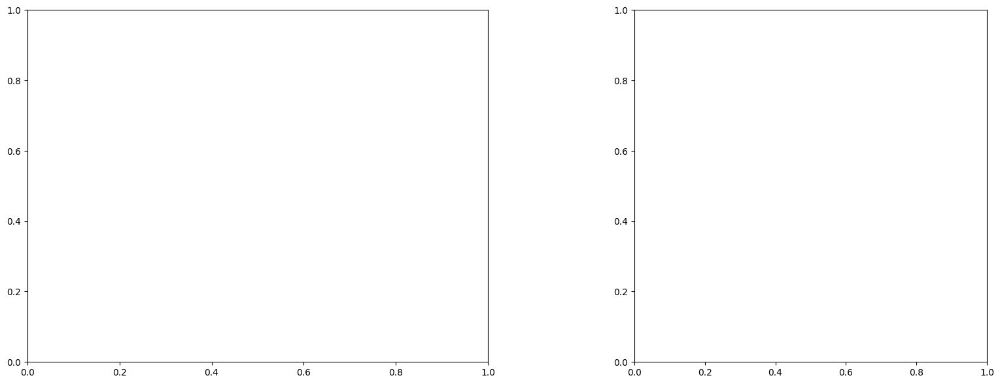

LinAlgError: Singular matrix

box [1500, 2200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

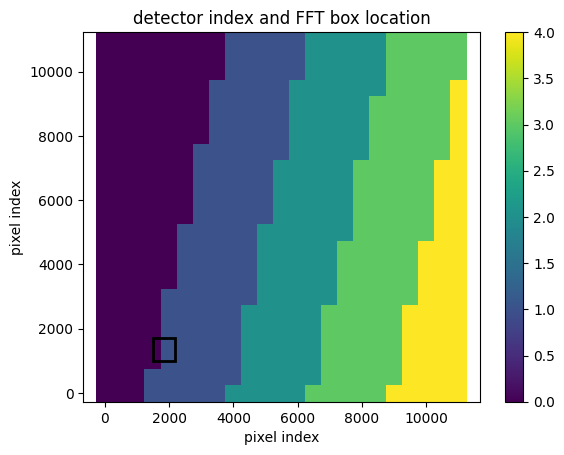

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


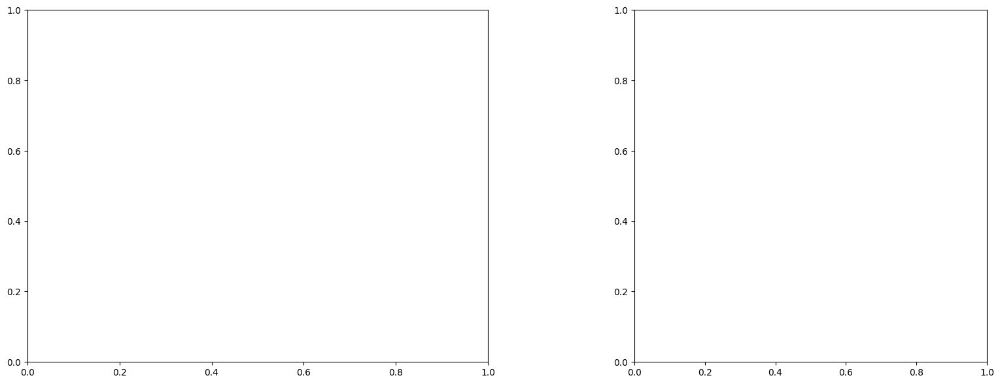

LinAlgError: Singular matrix

box [1500, 2200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

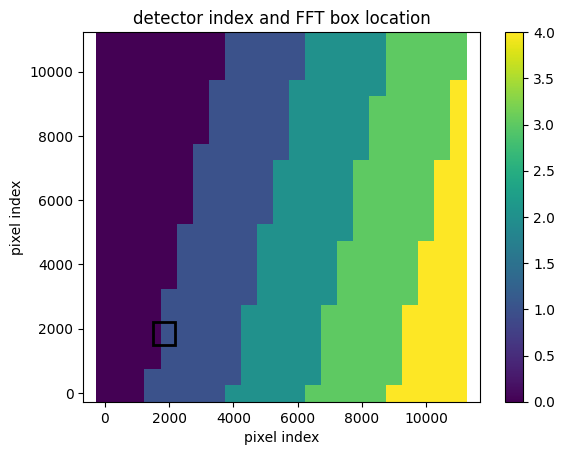

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


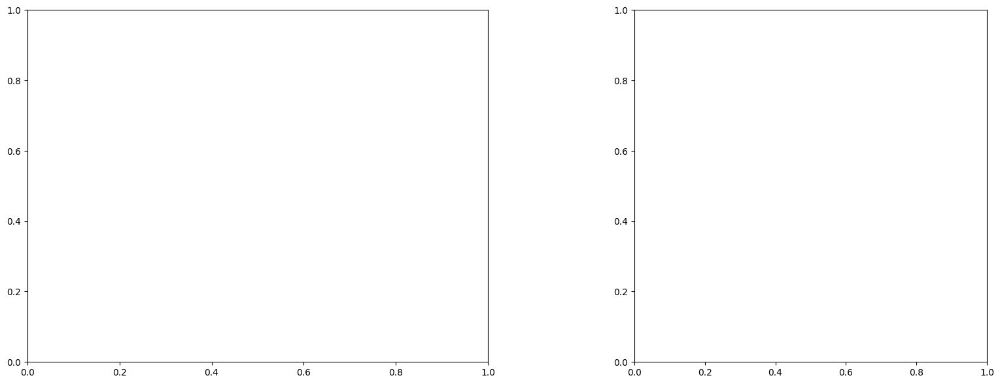

LinAlgError: Singular matrix

box [1500, 2200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

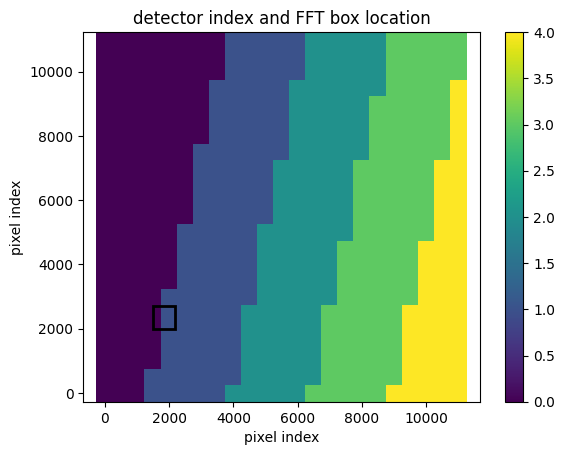

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


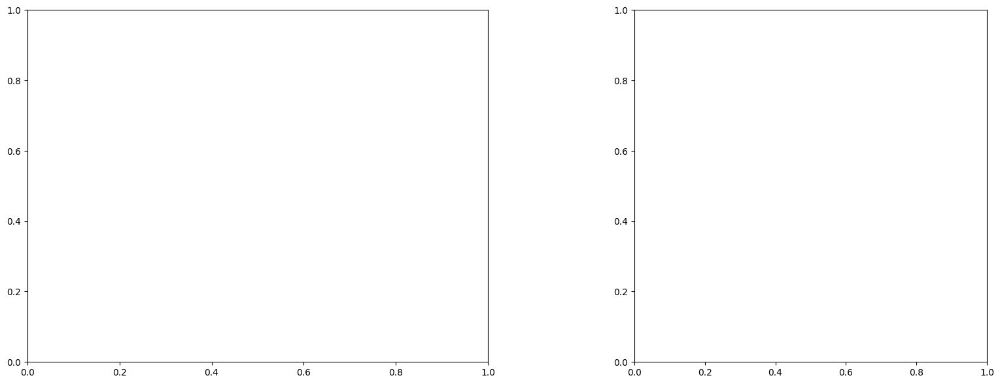

LinAlgError: Singular matrix

box [1500, 2200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

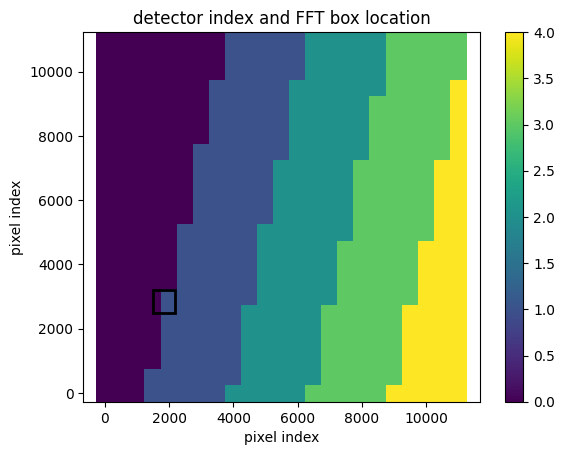

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


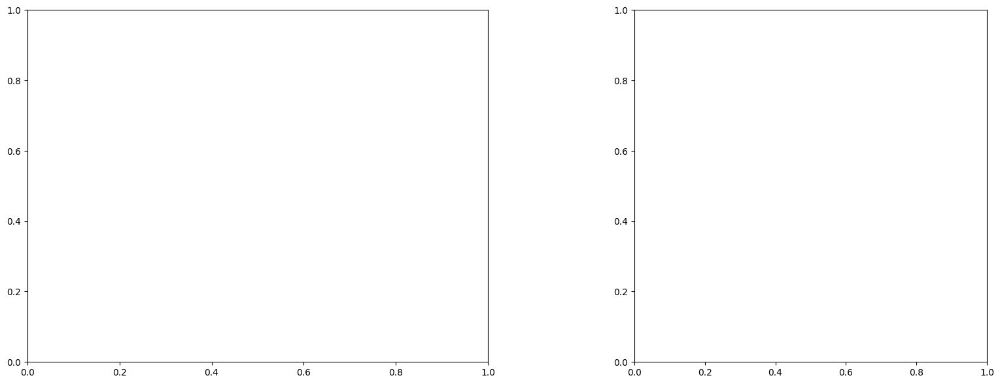

LinAlgError: Singular matrix

box [1500, 2200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

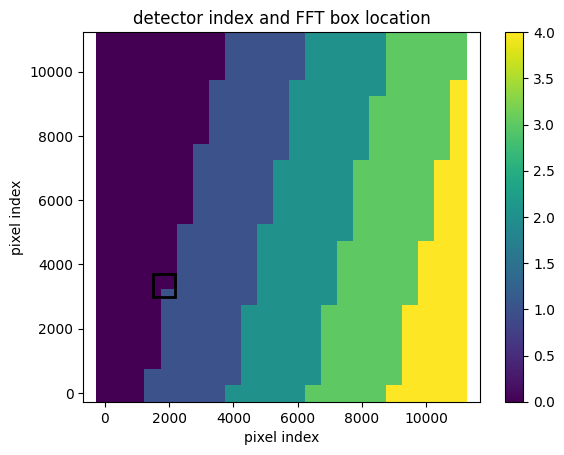

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


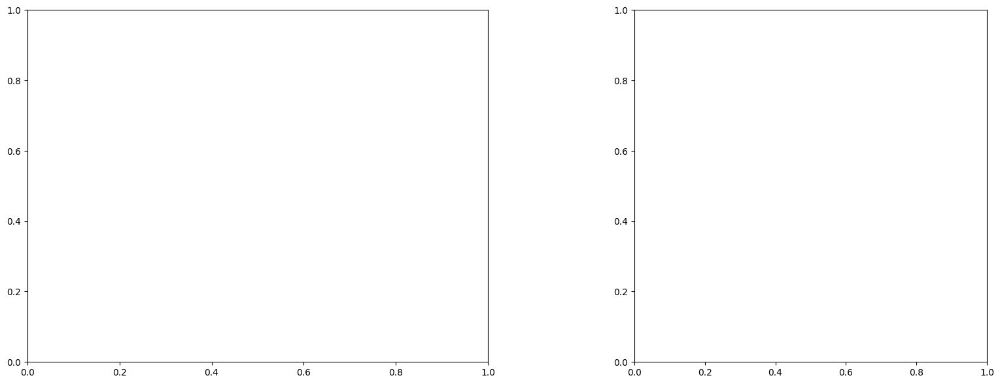

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

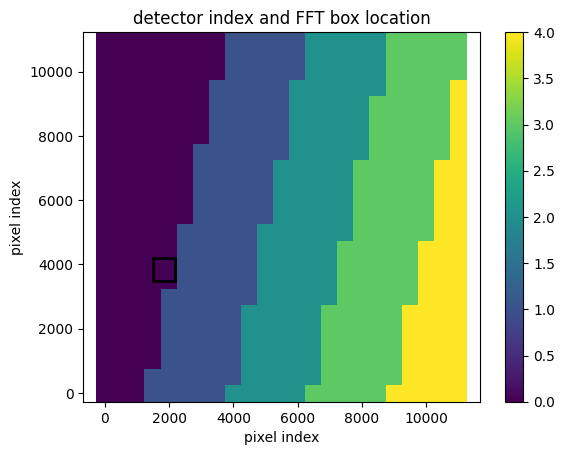

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


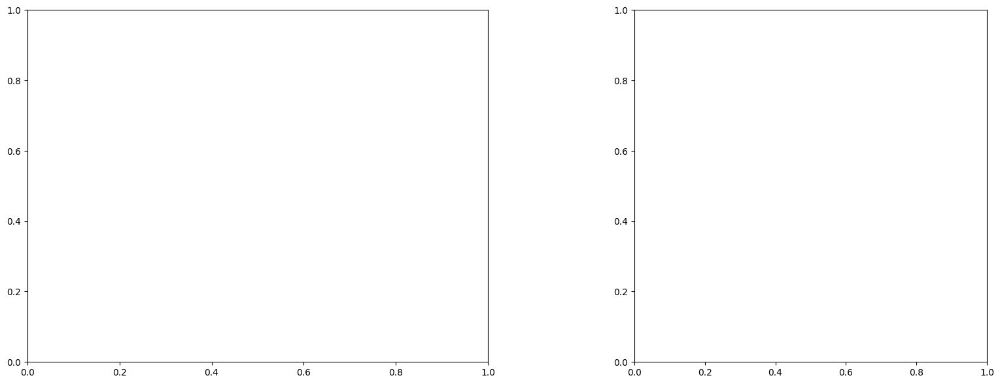

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

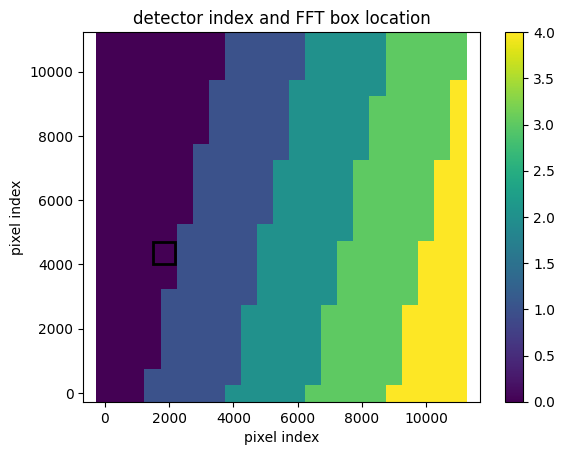

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


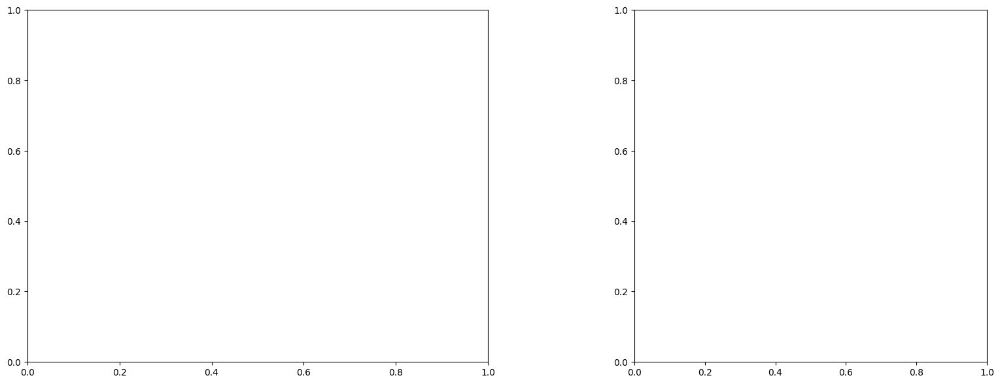

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

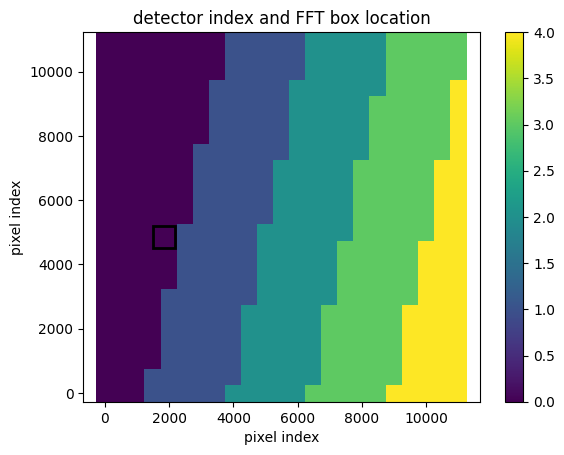

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


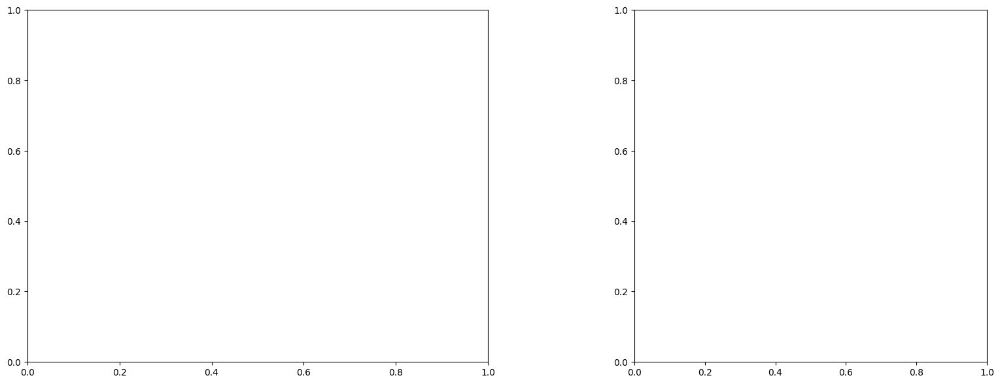

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

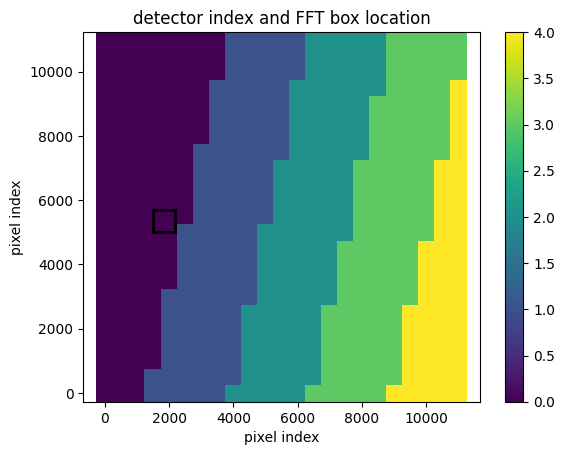

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


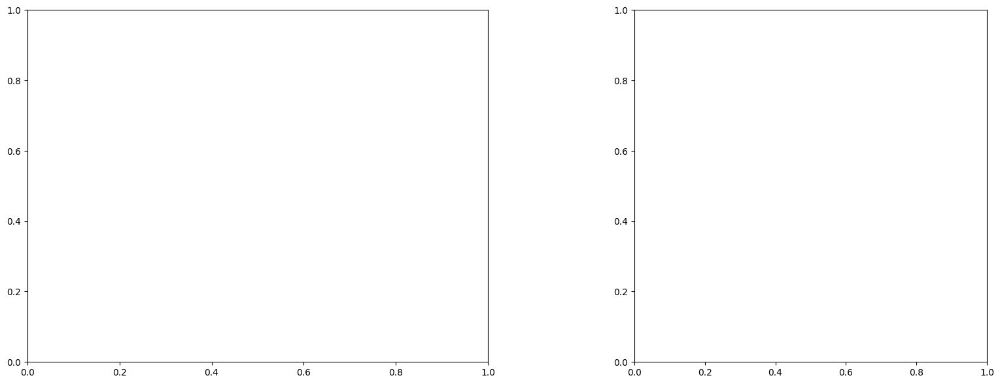

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

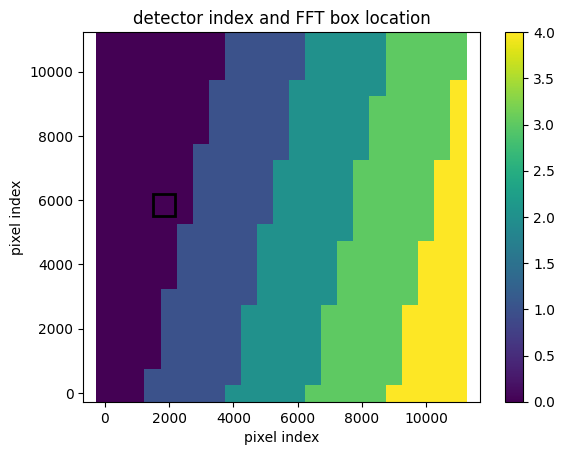

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


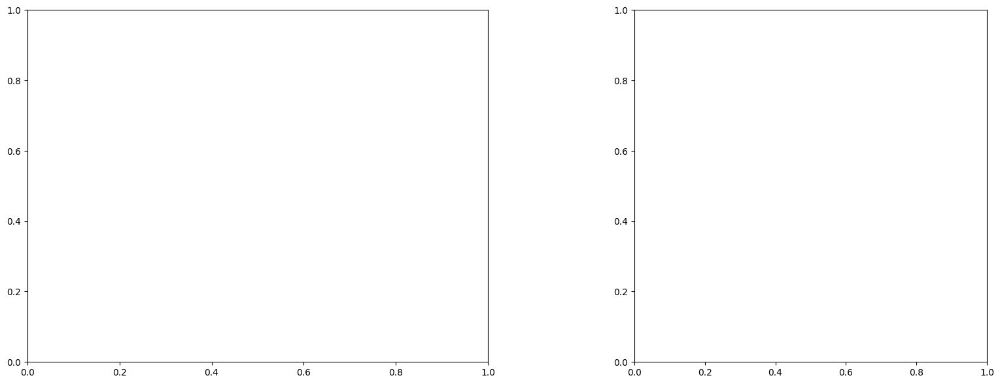

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

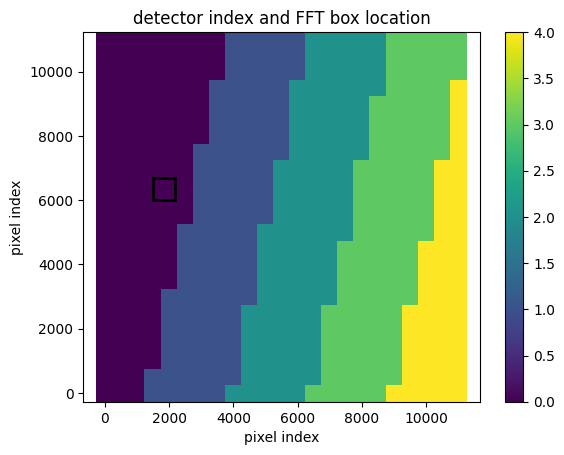

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


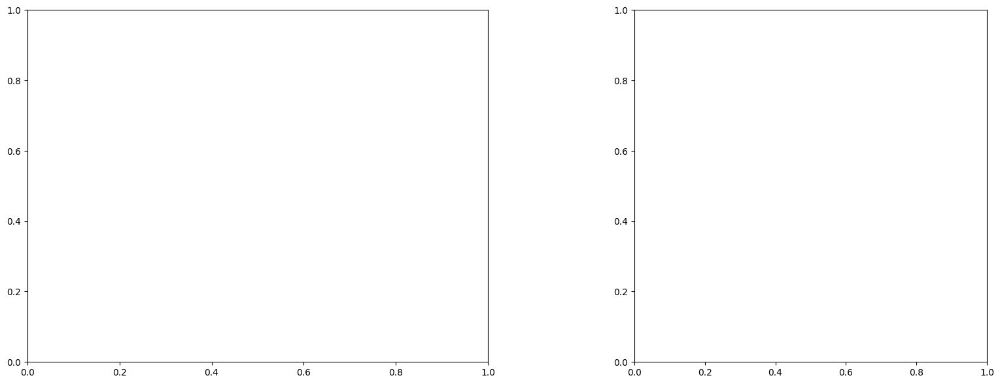

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

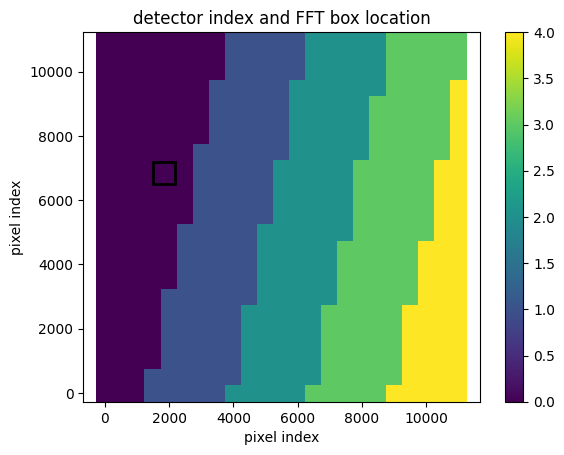

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


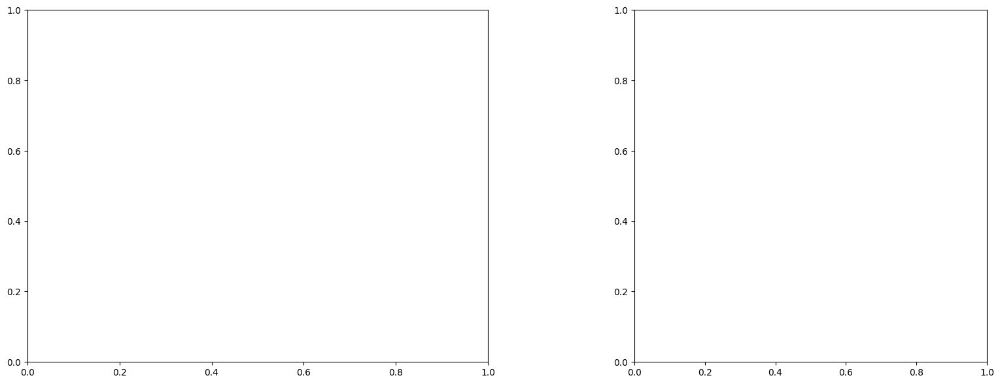

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

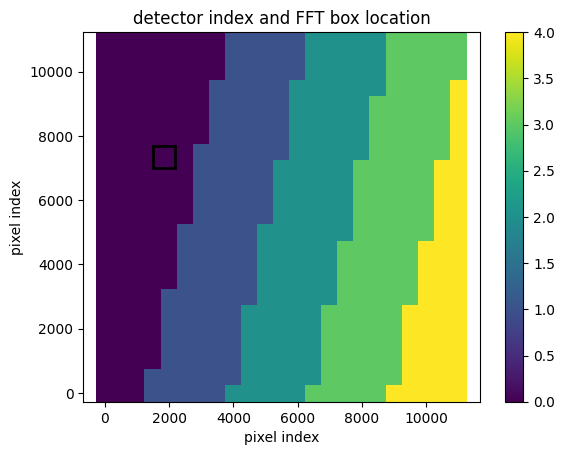

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


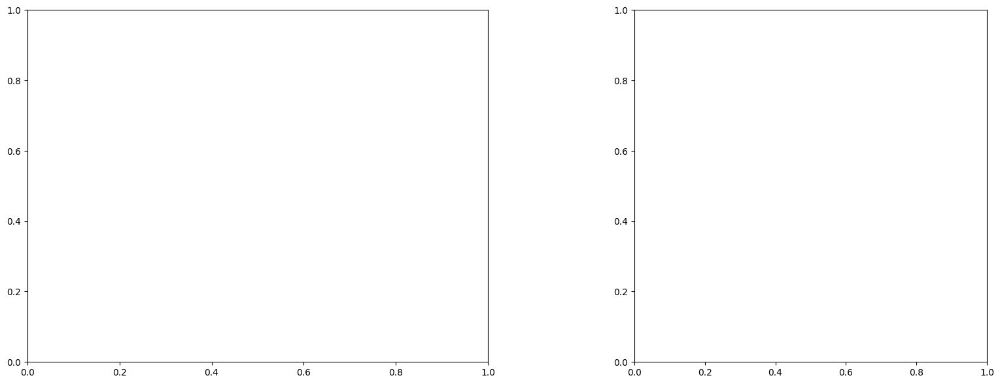

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

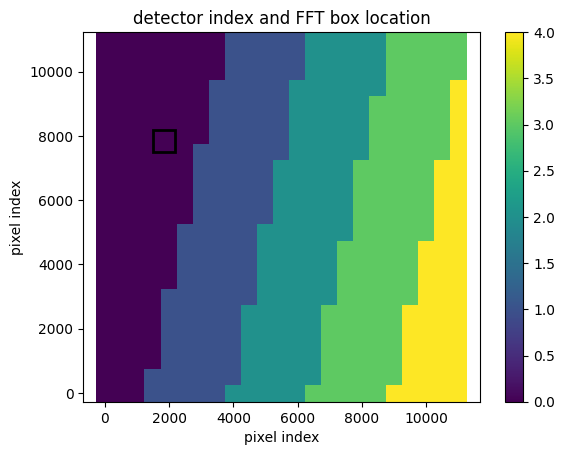

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


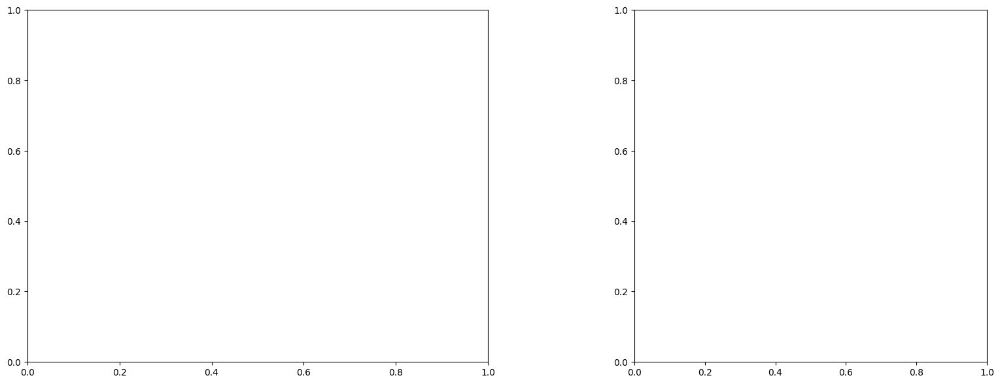

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

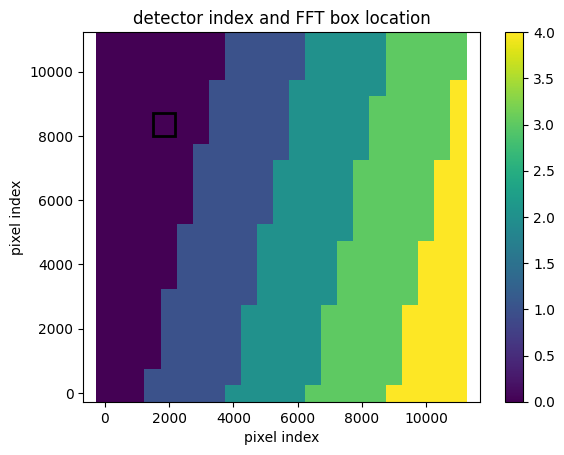

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


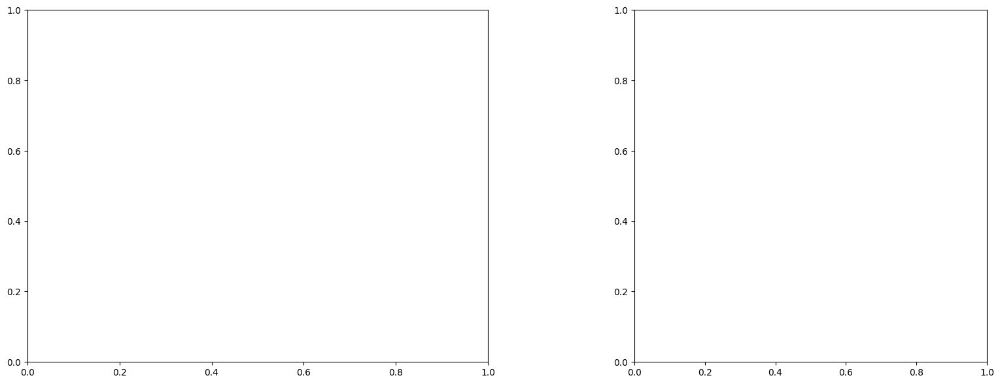

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

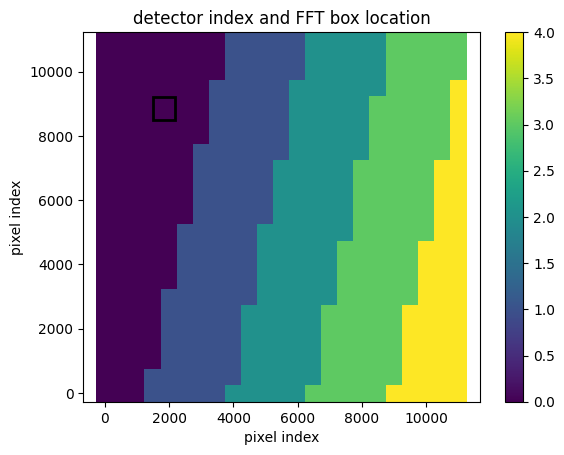

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


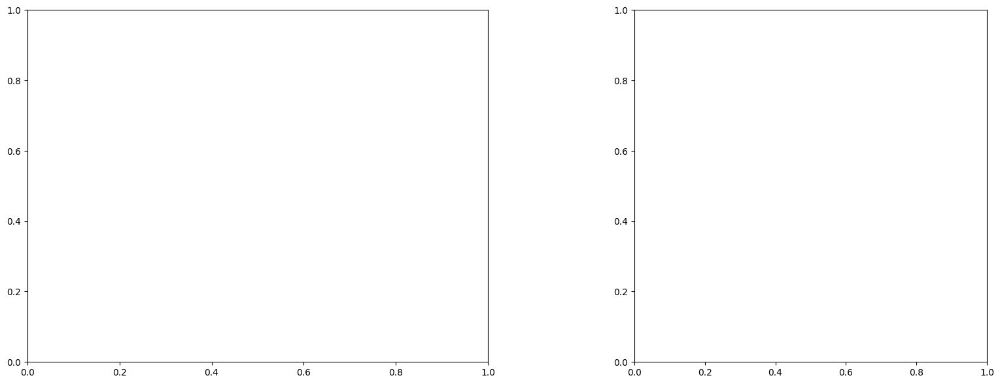

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

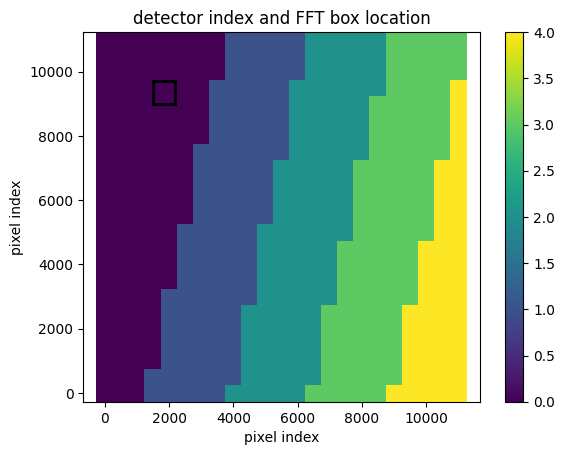

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


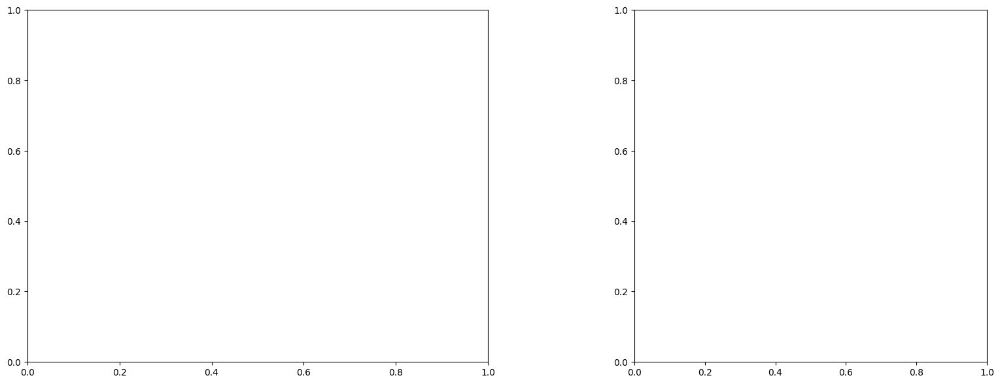

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

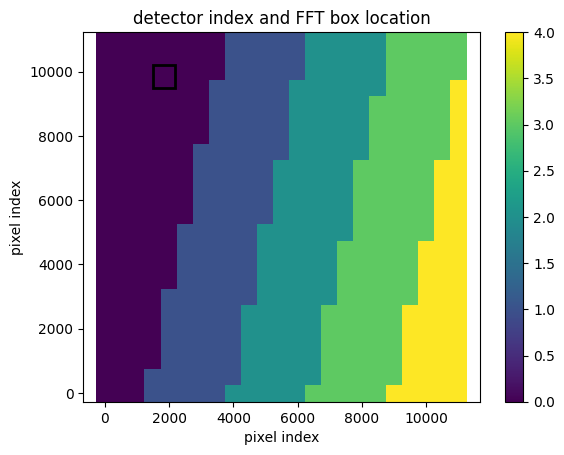

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


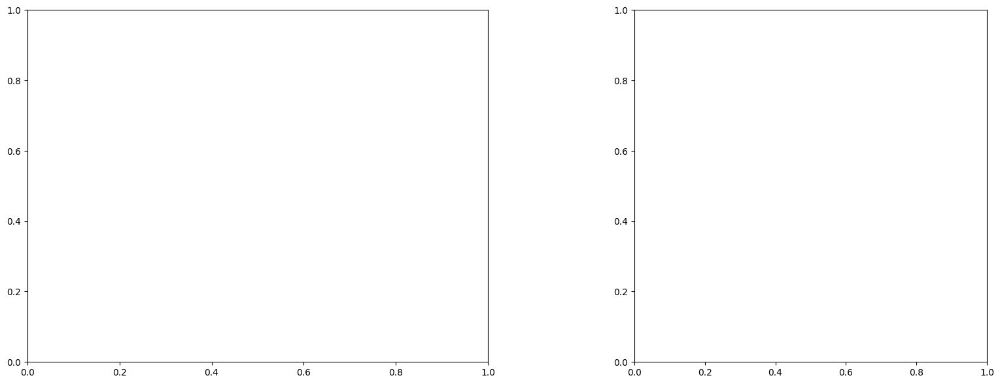

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

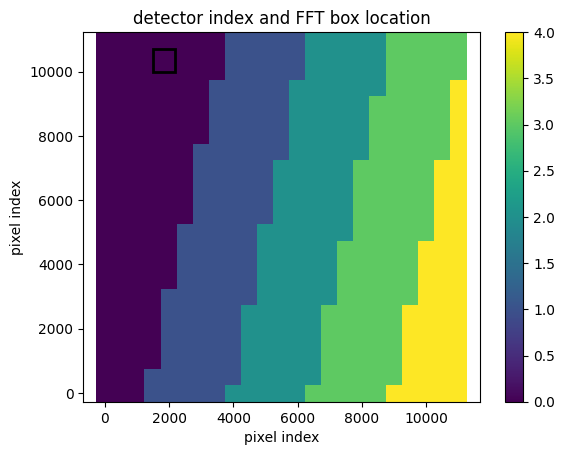

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


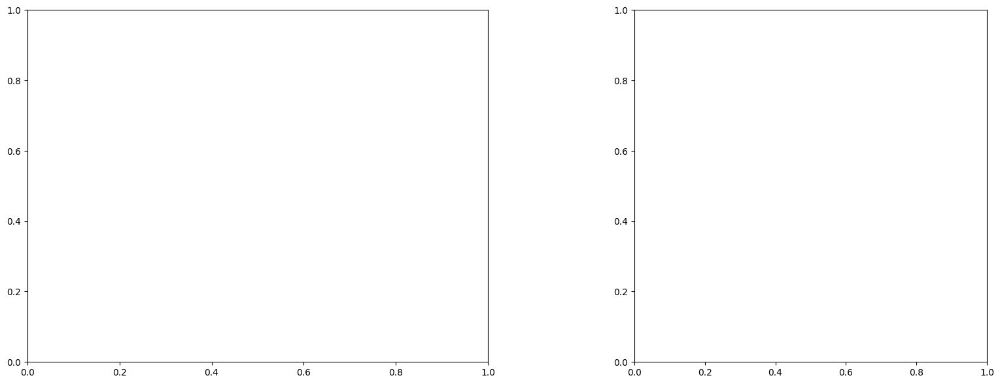

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [1500, 2200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

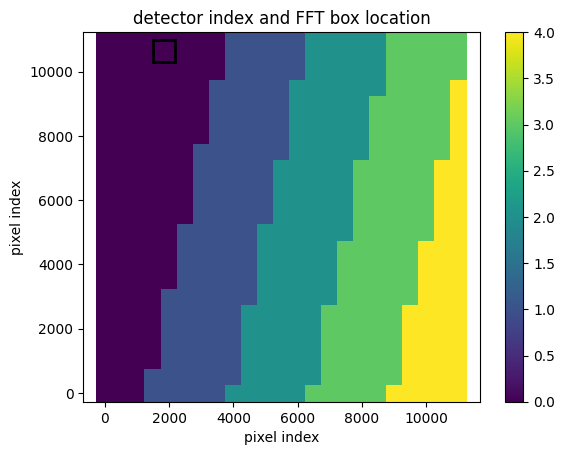

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


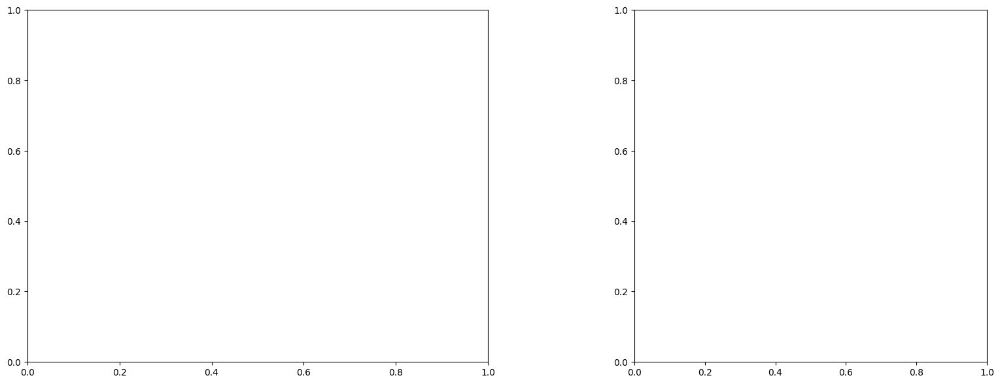

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

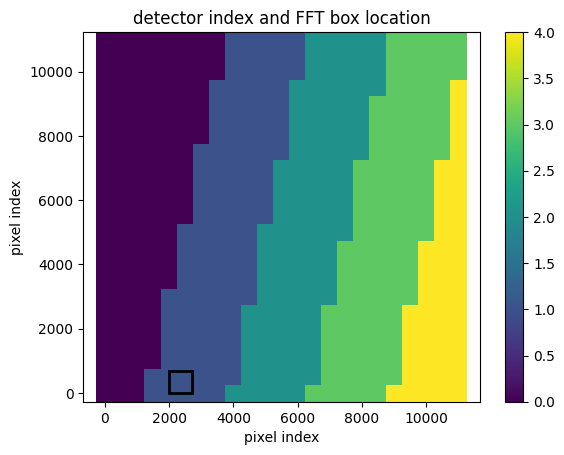

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


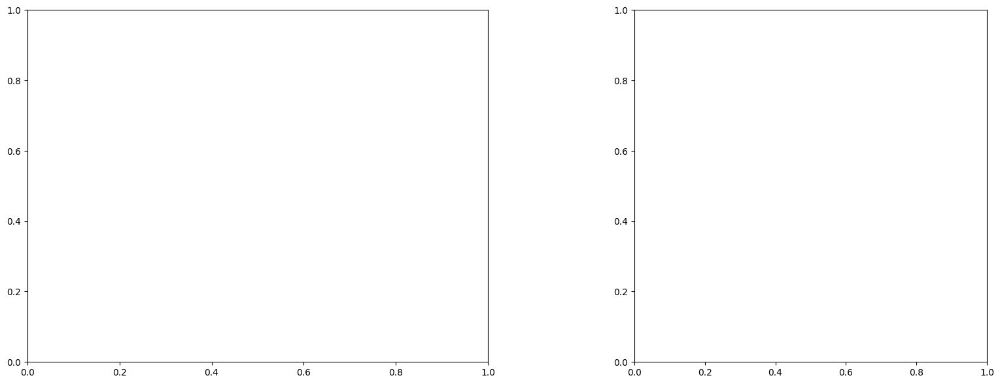

U and V components of current : [-0.17183865 -0.71669639]
uncertainties for U and V: 0.20906119679958243 0.1257221646426997


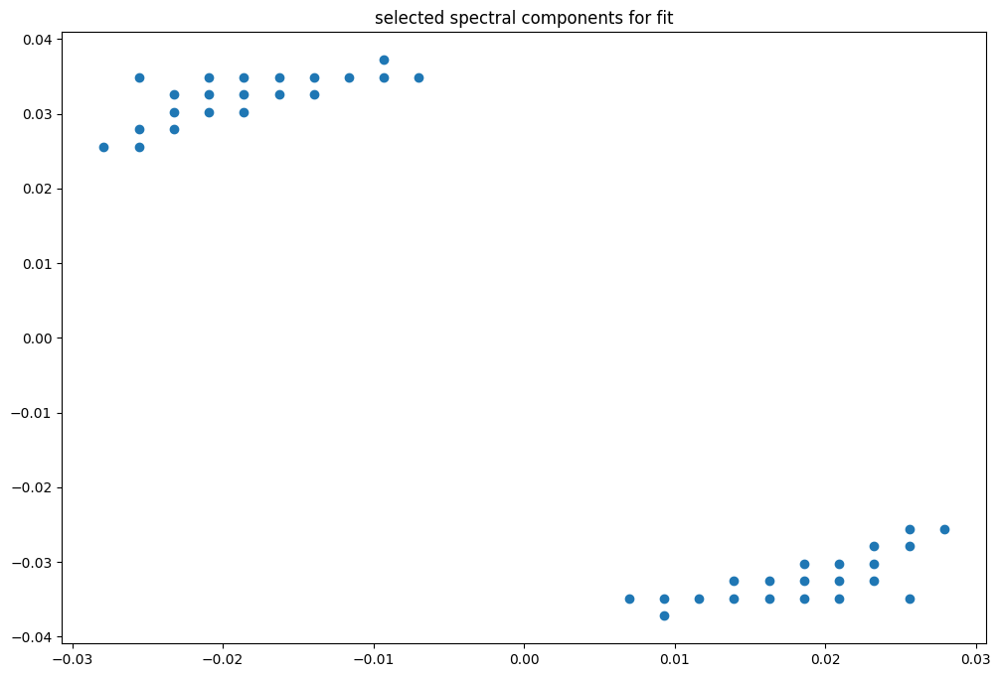

box [2000, 2700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

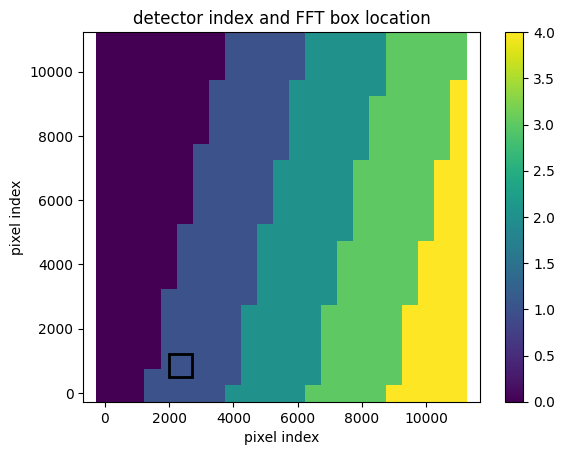

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


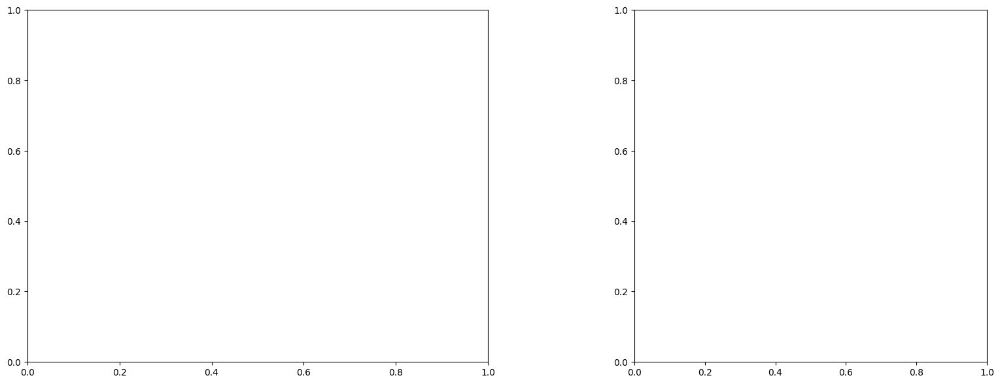

U and V components of current : [-0.24144016 -1.18465725]
uncertainties for U and V: 0.32694010074585605 0.2010746838344233


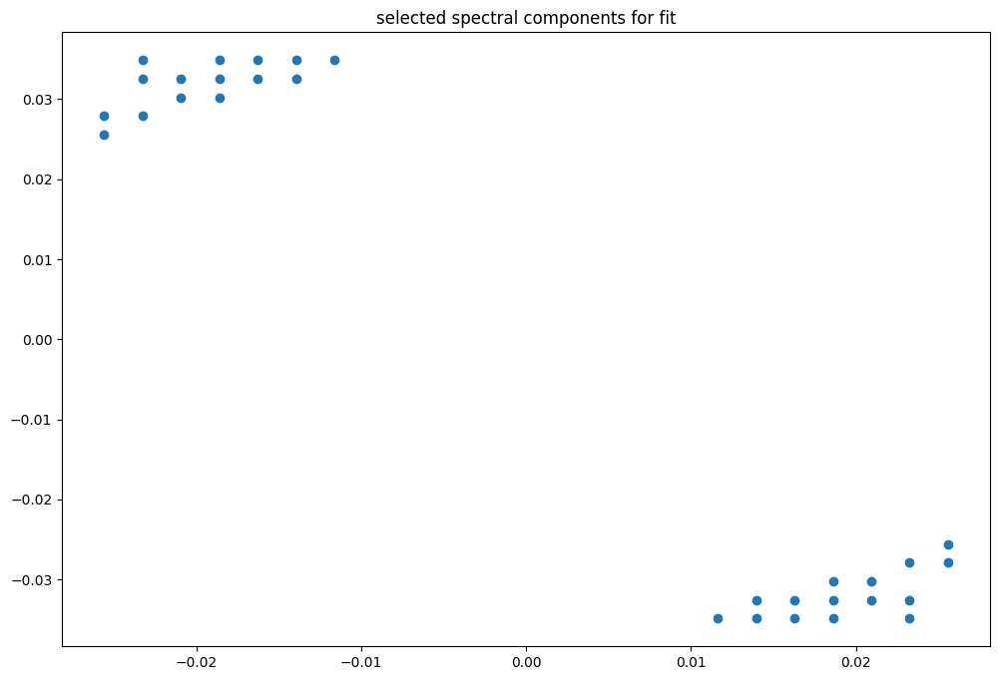

box [2000, 2700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

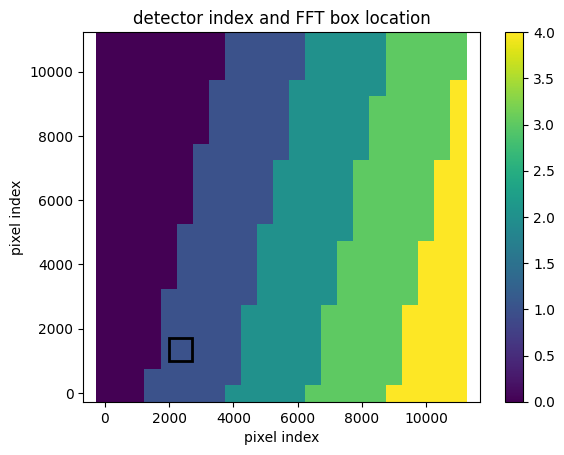

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


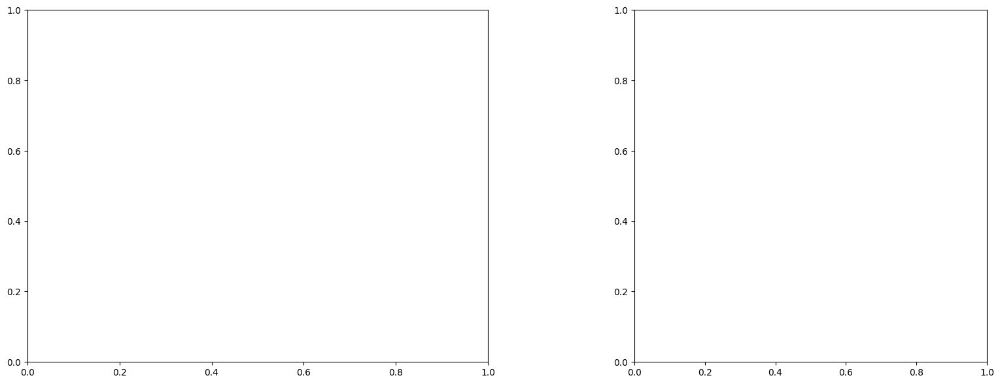

U and V components of current : [-0.00471824 -1.22157522]
uncertainties for U and V: 0.13620425661839605 0.12944828092855679


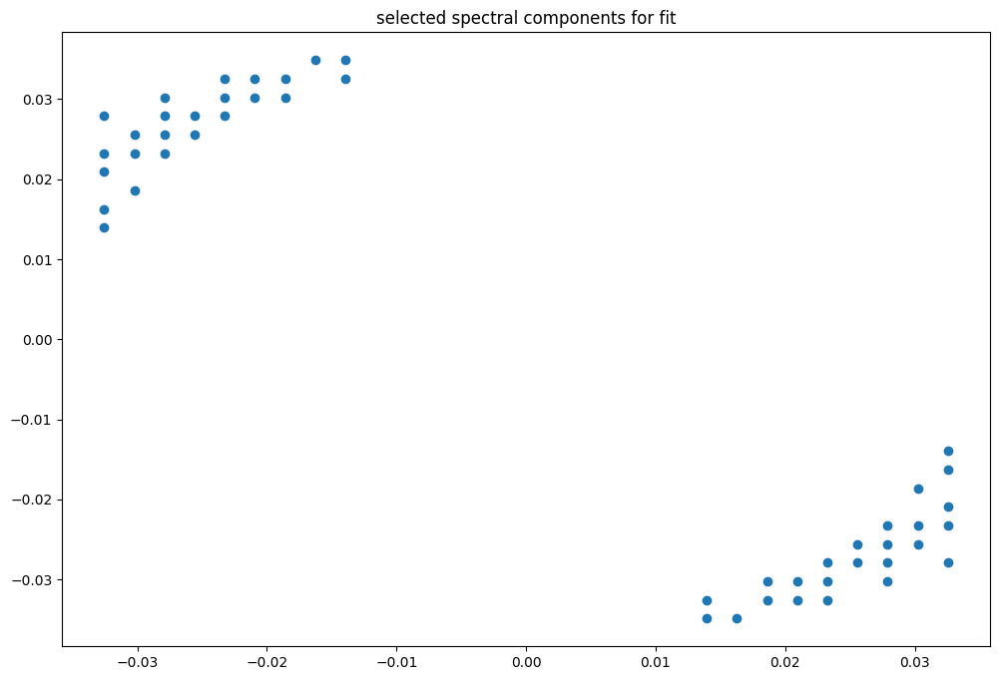

box [2000, 2700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

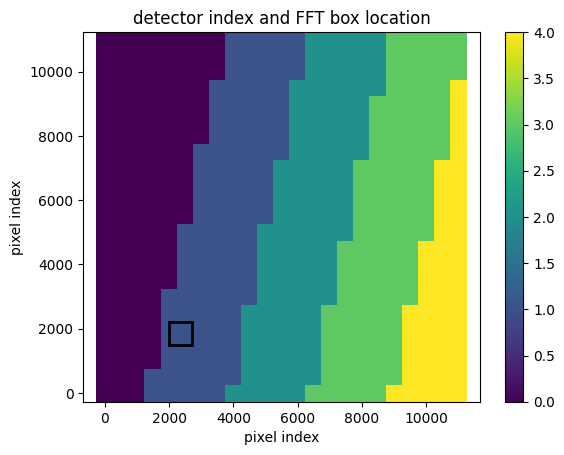

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


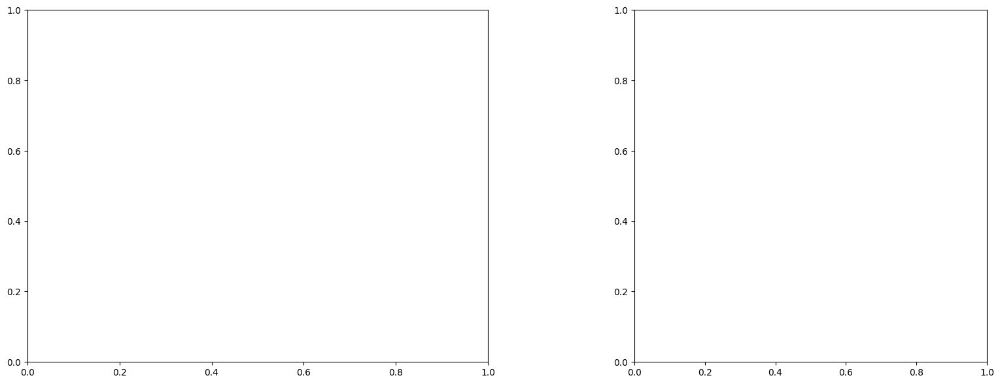

U and V components of current : [ 0.01693675 -1.1706295 ]
uncertainties for U and V: 0.10542557741840194 0.1045140760191154


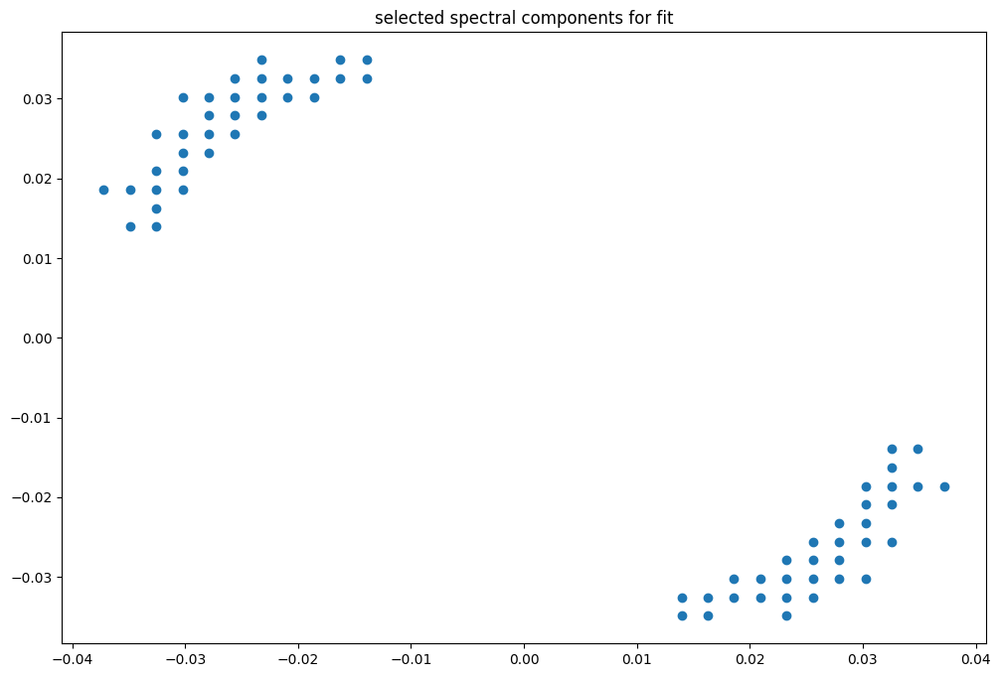

box [2000, 2700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

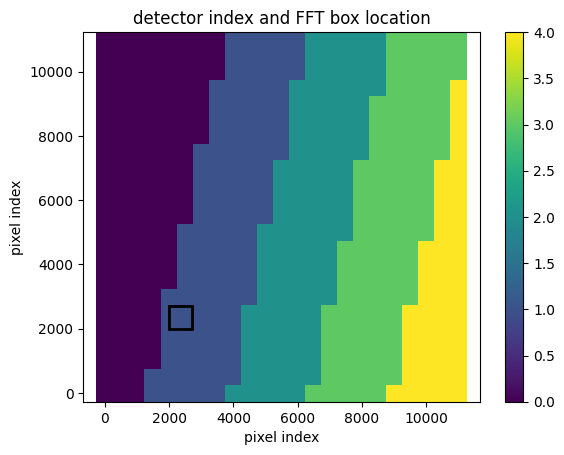

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


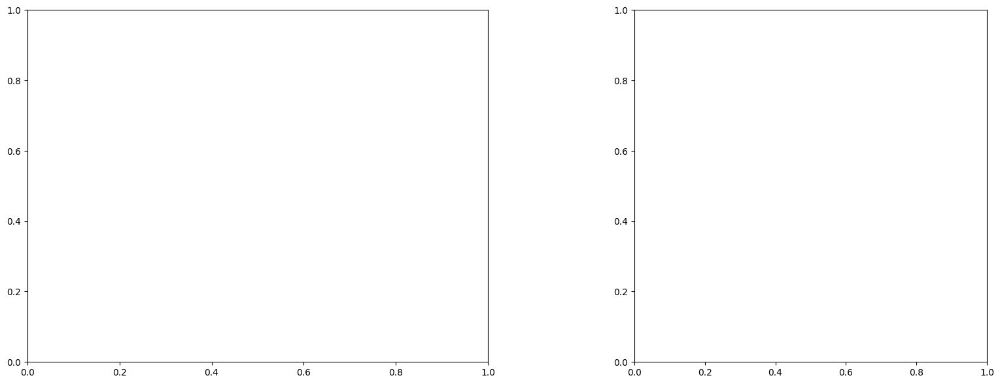

U and V components of current : [-0.23865191 -1.13339838]
uncertainties for U and V: 0.11272610558633284 0.11775714533264801


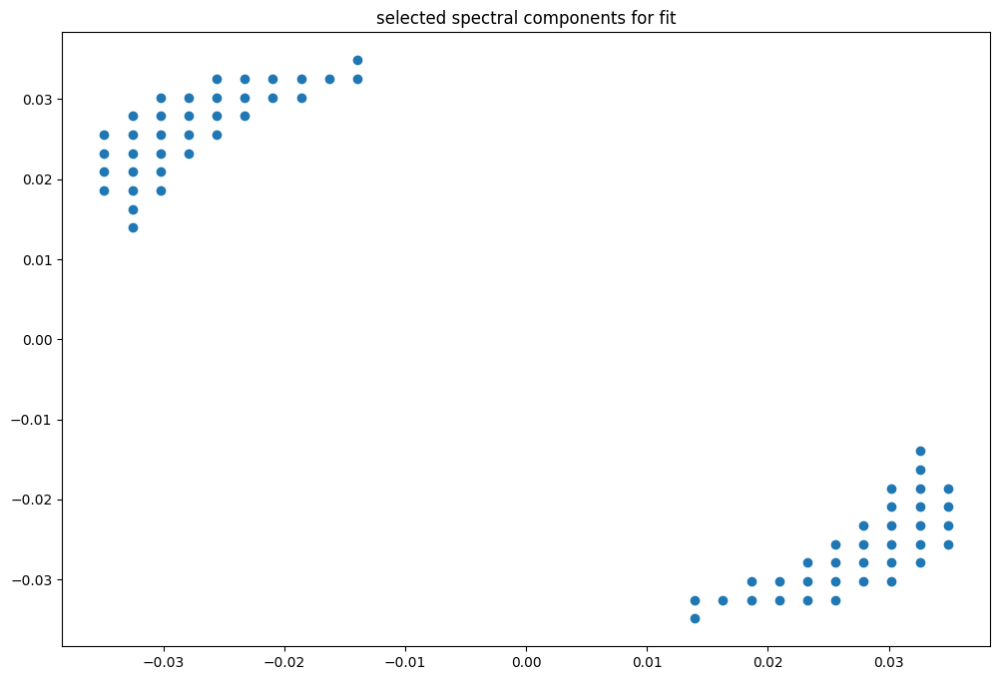

box [2000, 2700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

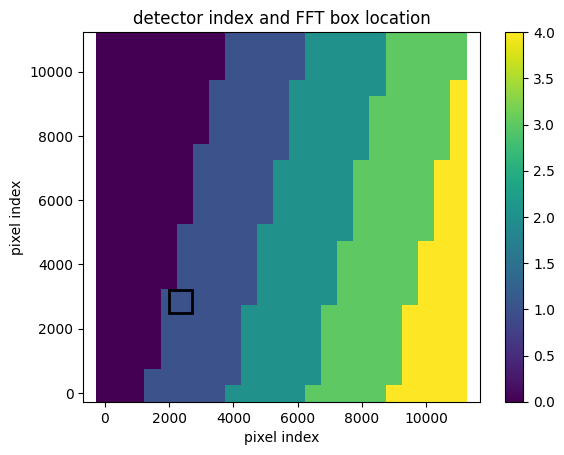

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


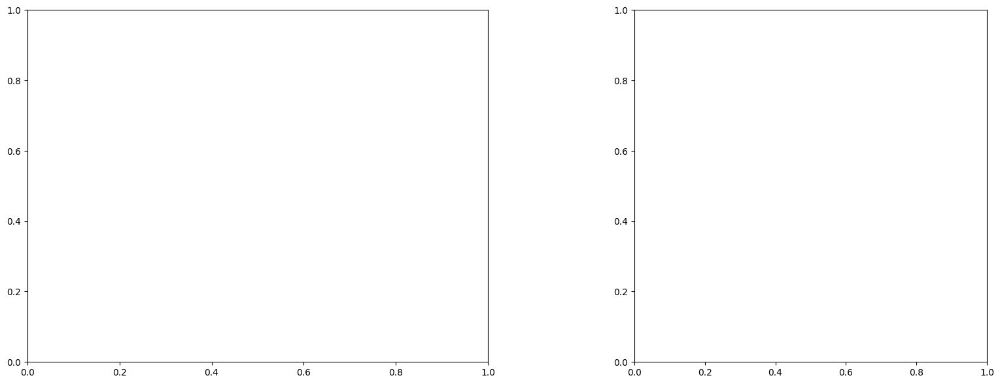

LinAlgError: Singular matrix

box [2000, 2700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

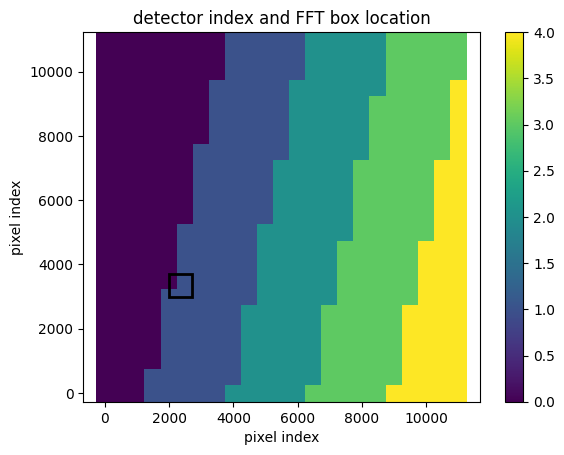

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


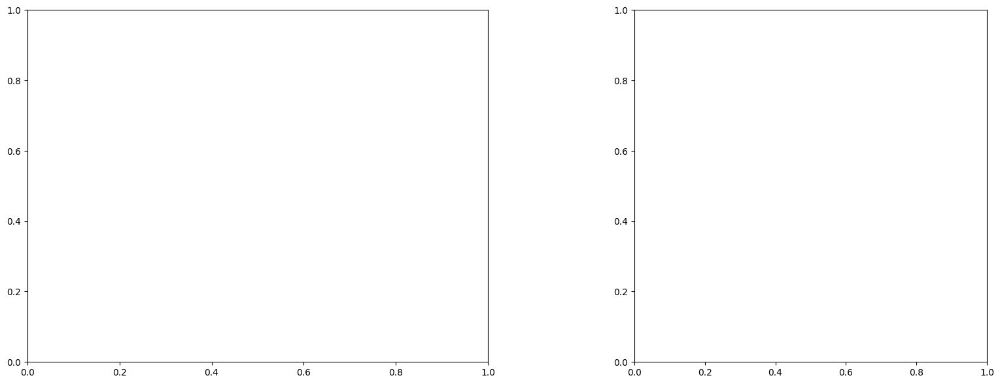

LinAlgError: Singular matrix

box [2000, 2700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

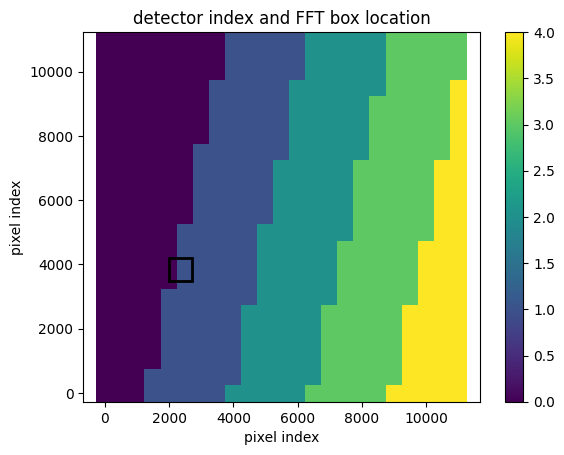

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


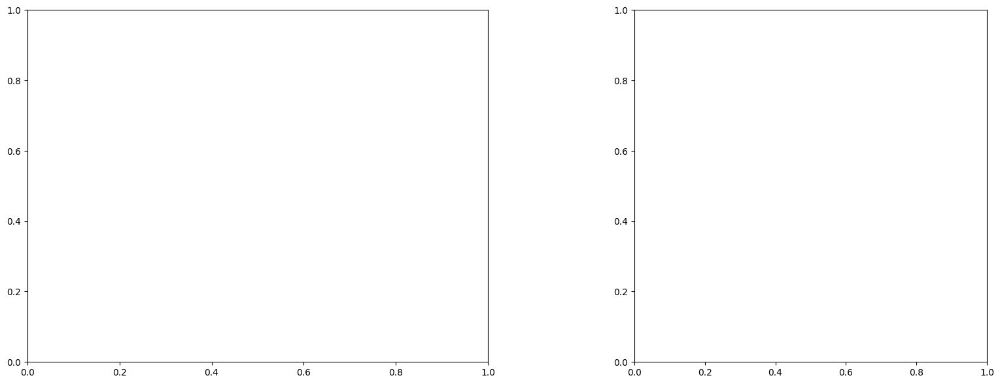

LinAlgError: Singular matrix

box [2000, 2700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

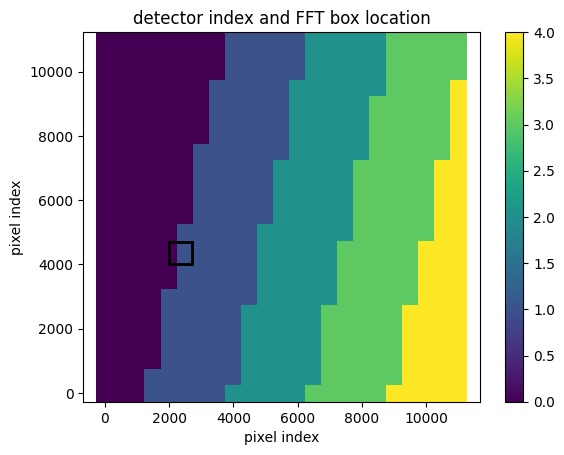

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


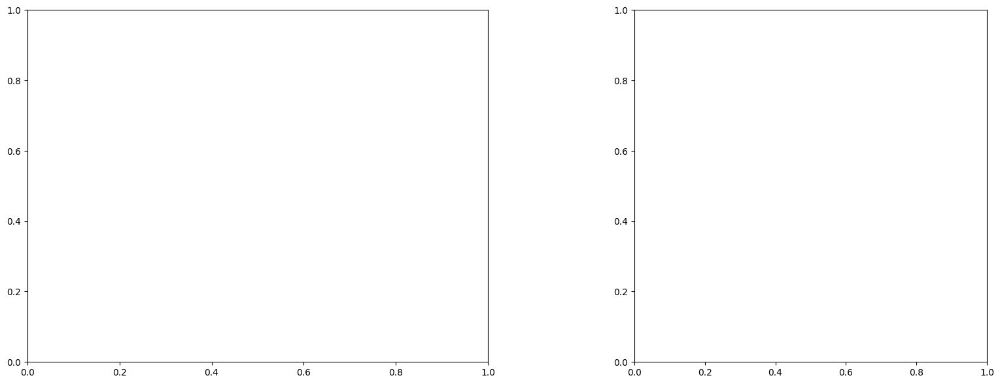

LinAlgError: Singular matrix

box [2000, 2700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

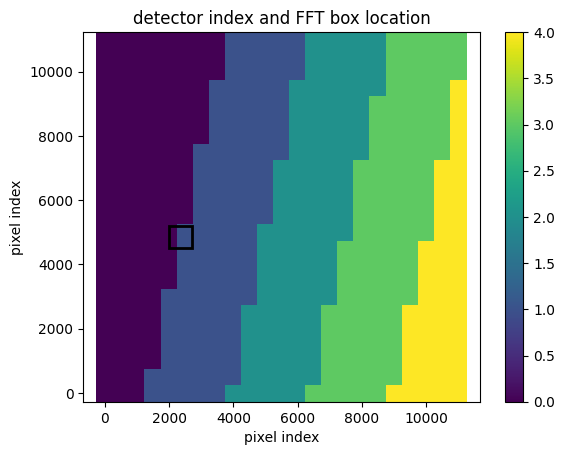

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


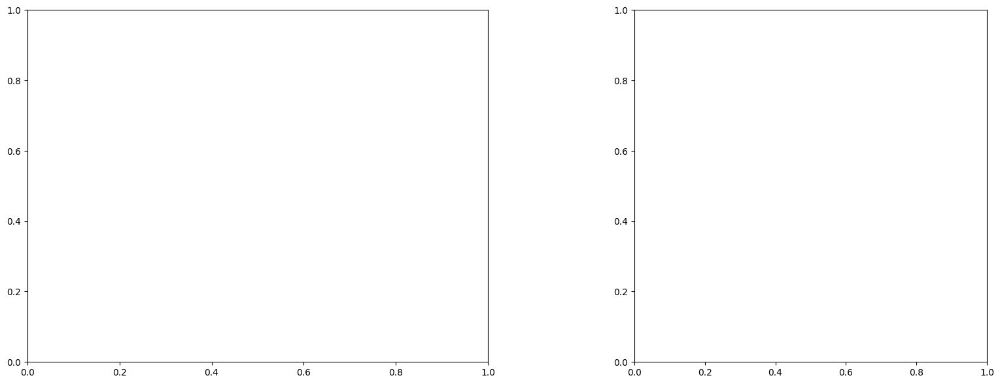

LinAlgError: Singular matrix

box [2000, 2700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

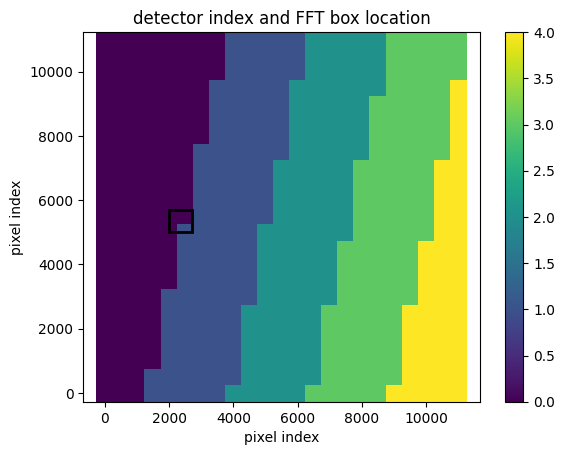

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.26
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


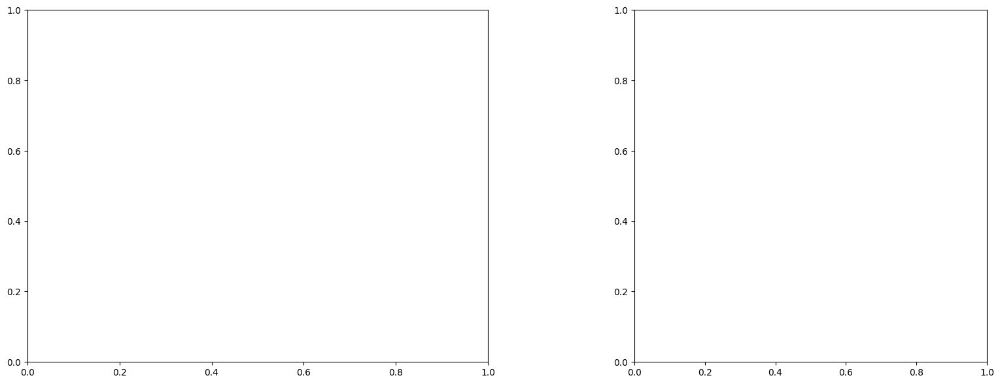

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

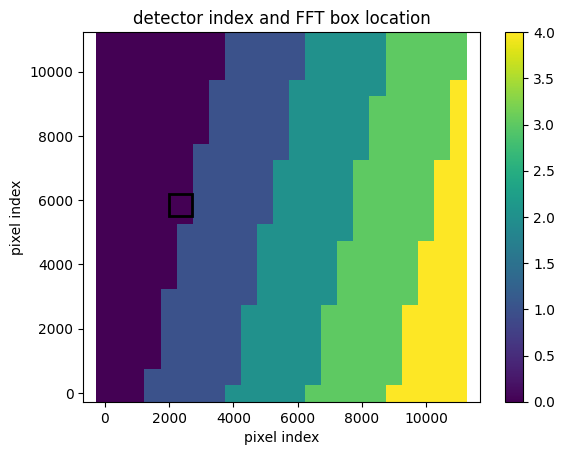

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


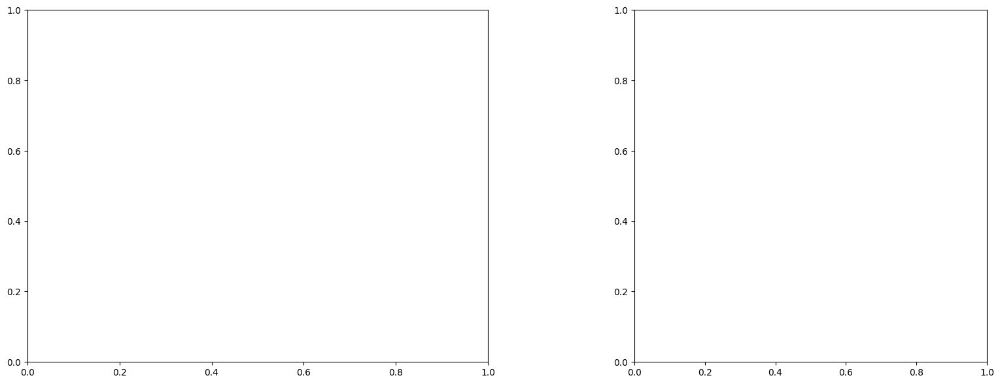

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

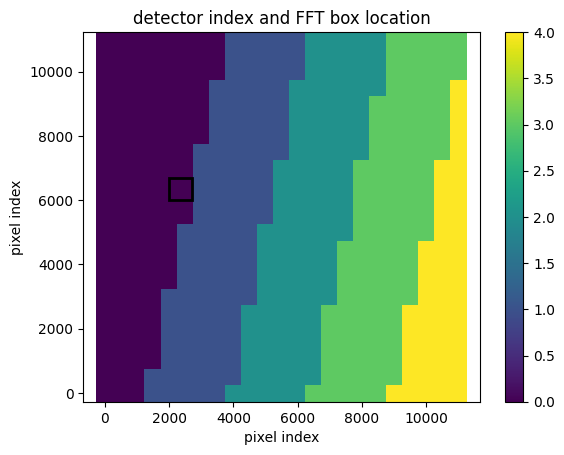

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


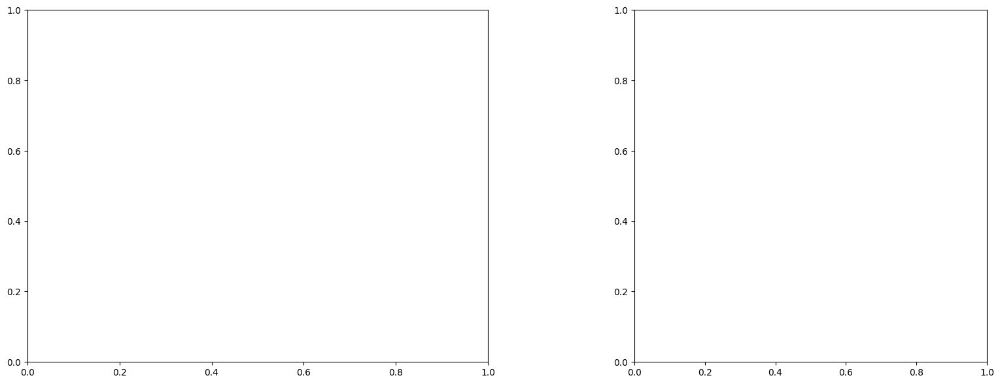

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

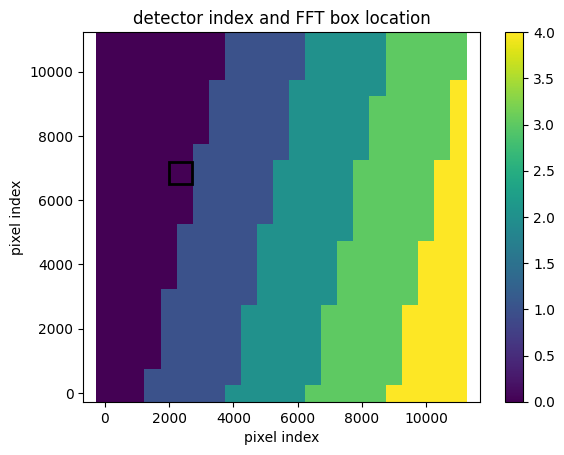

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


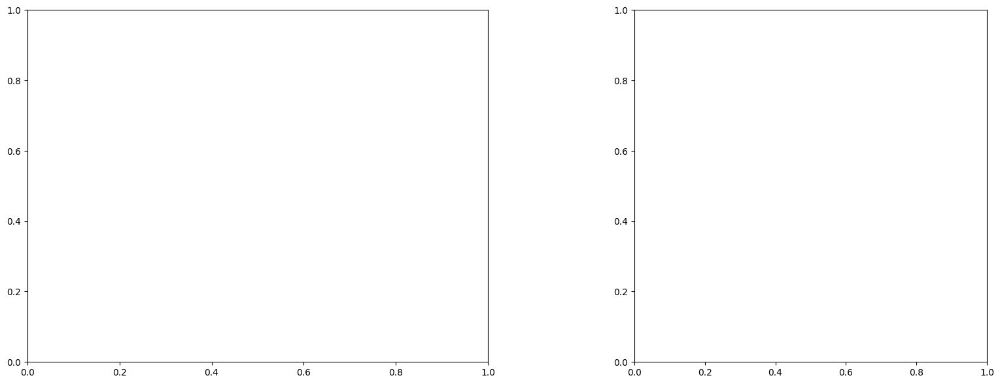

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

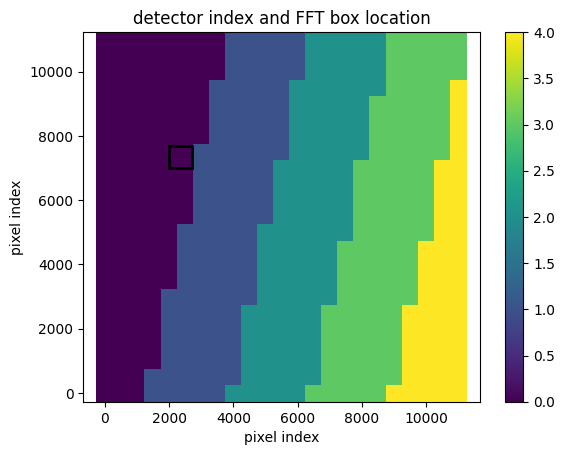

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


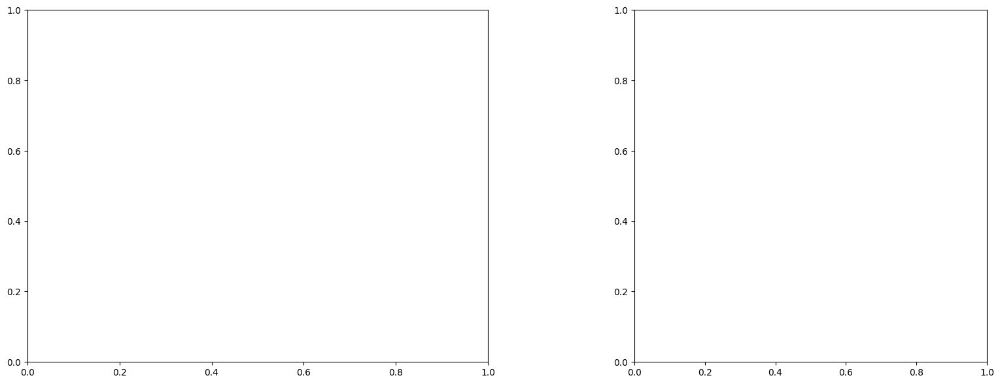

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

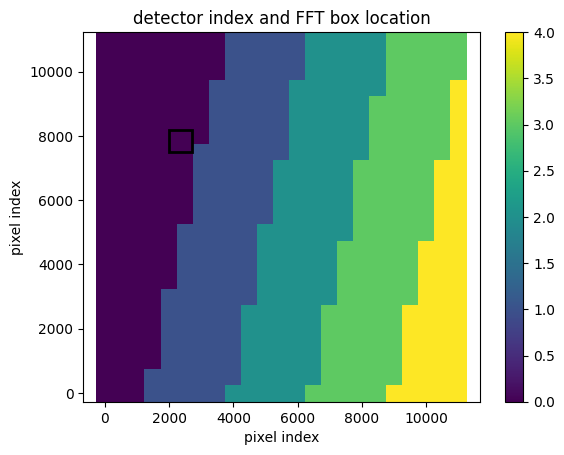

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


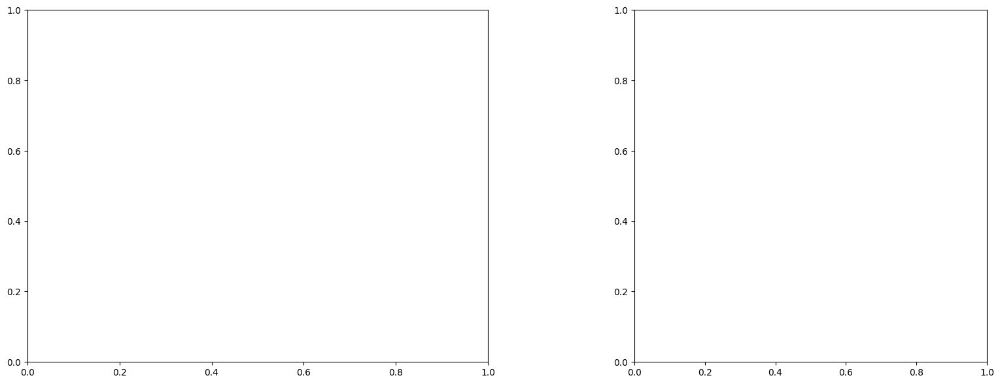

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

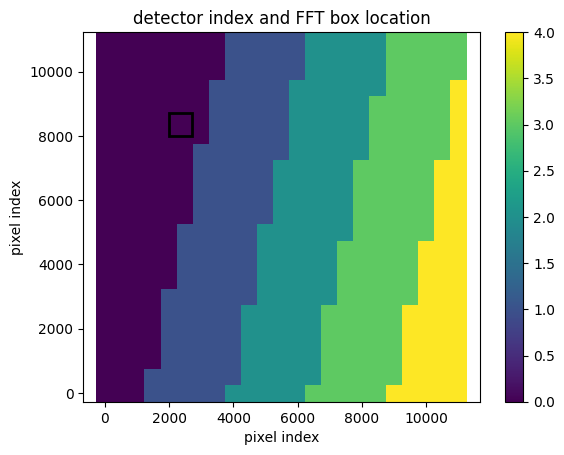

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


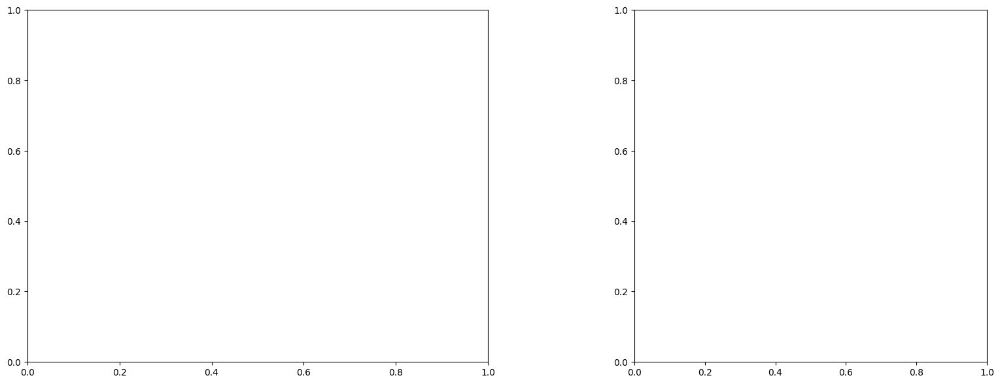

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

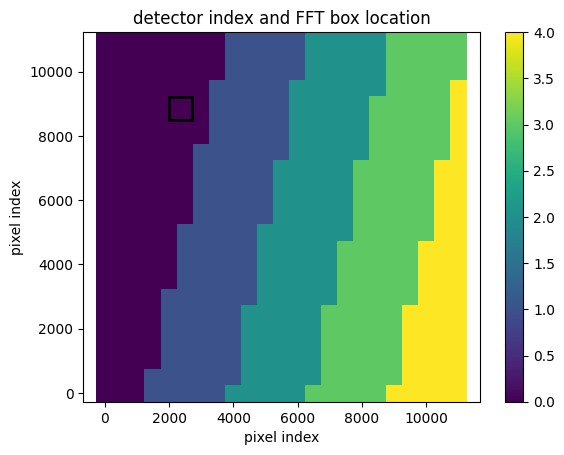

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


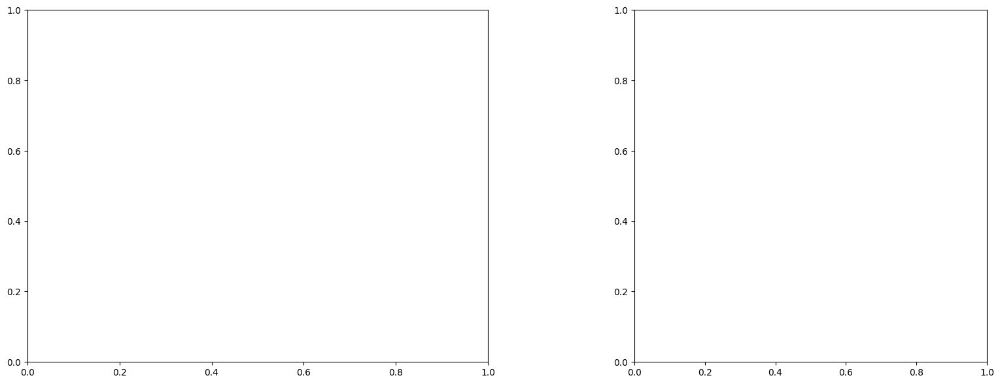

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

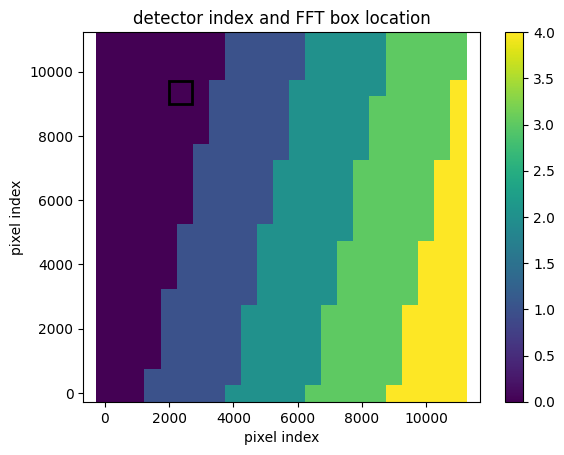

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


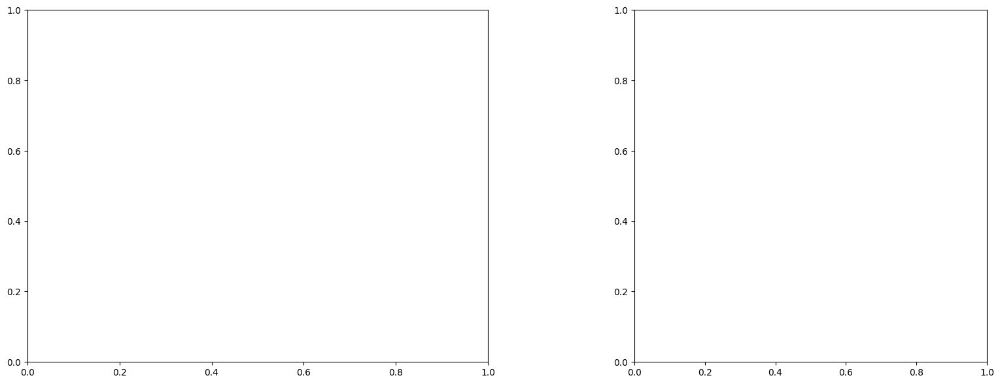

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

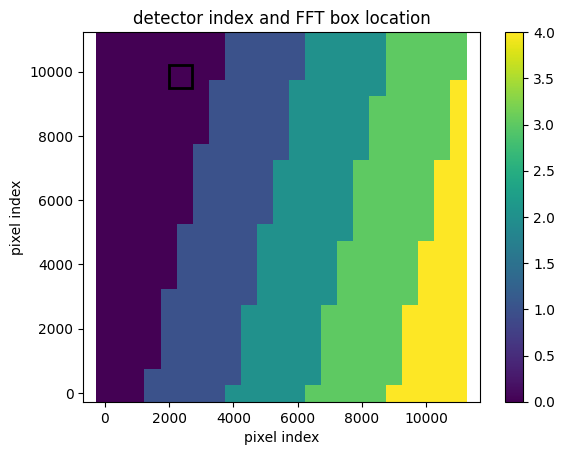

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


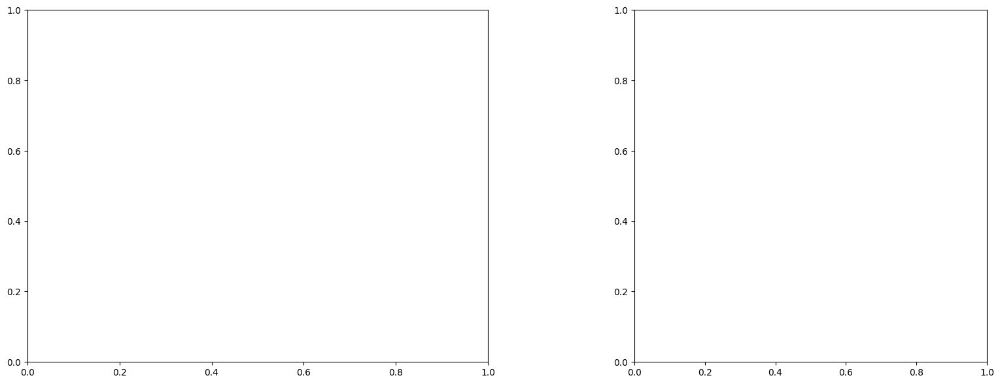

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

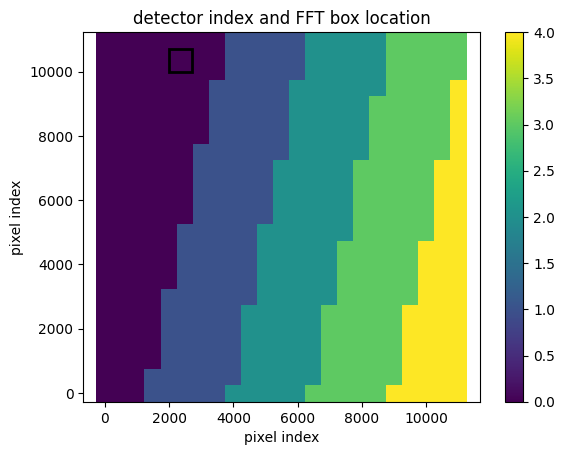

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


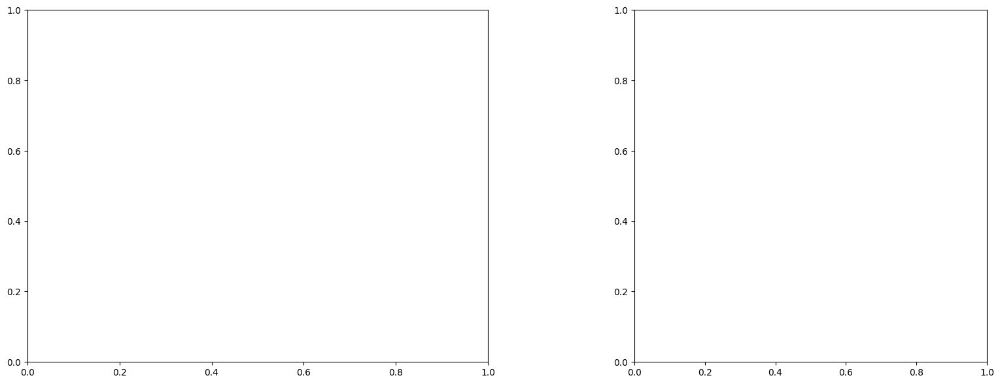

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2000, 2700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

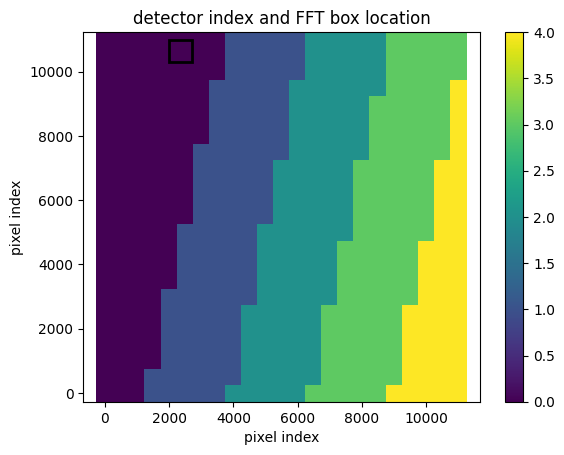

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


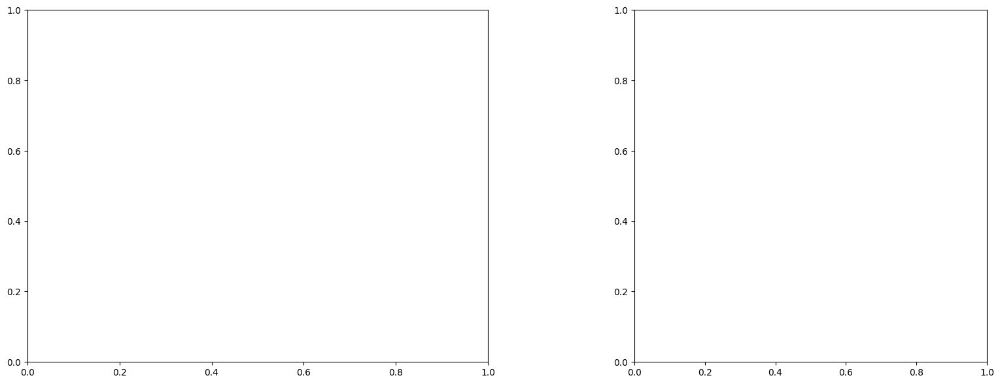

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

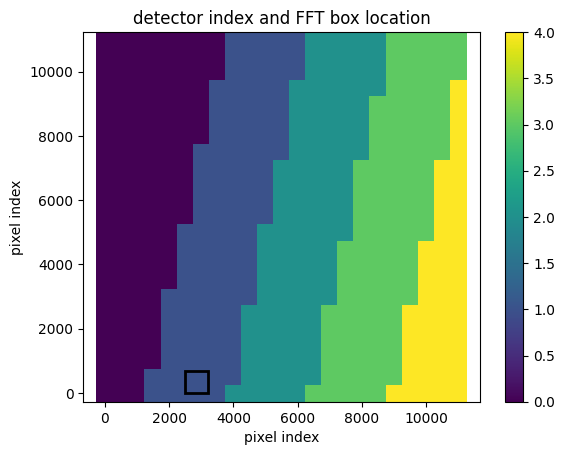

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


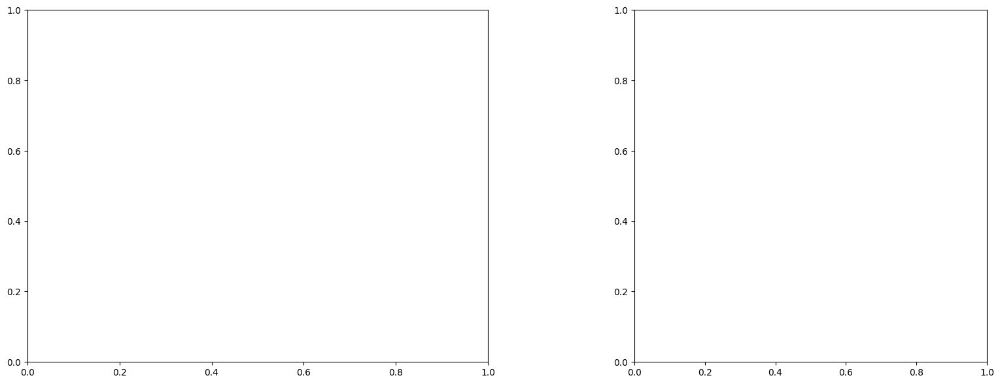

U and V components of current : [-0.18618365 -1.05529873]
uncertainties for U and V: 0.13323203941568115 0.09684828102321125


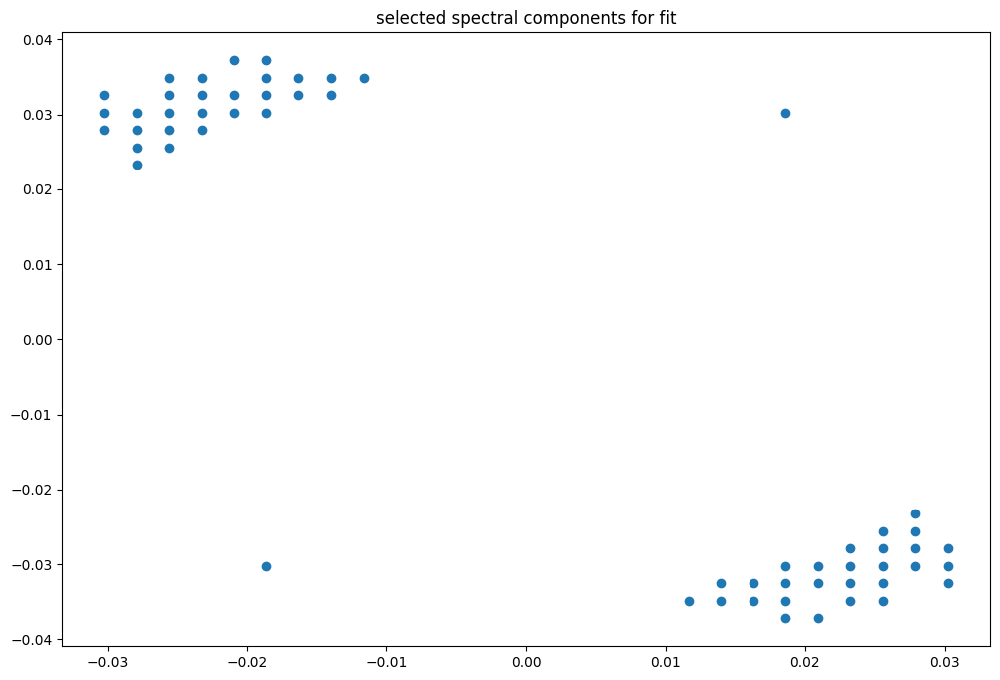

box [2500, 3200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

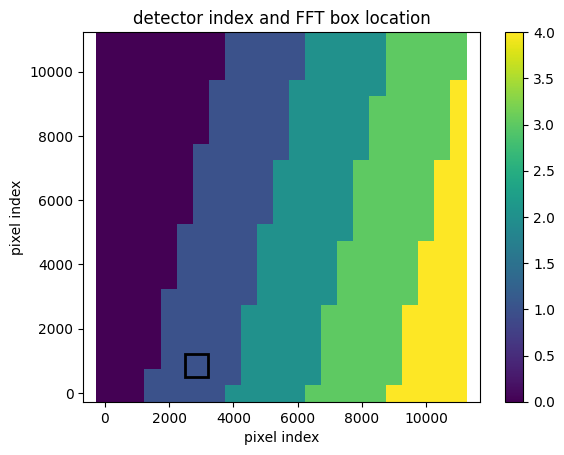

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


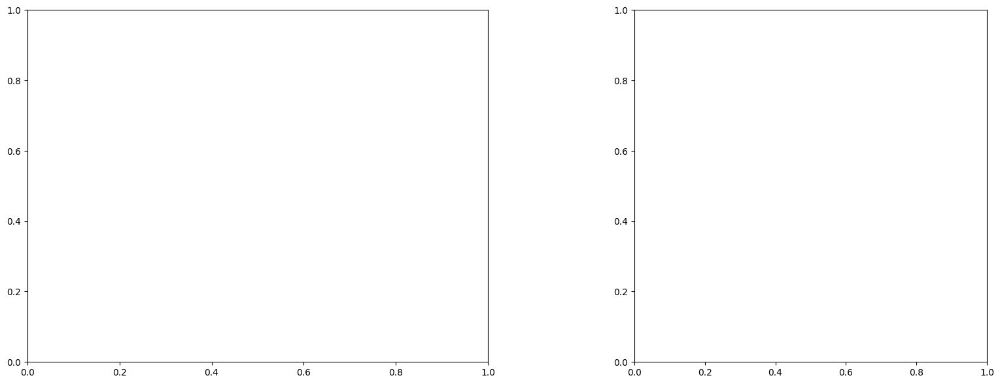

U and V components of current : [ 0.96842592 -0.48754285]
uncertainties for U and V: 0.1119586200103297 0.1106393114037153


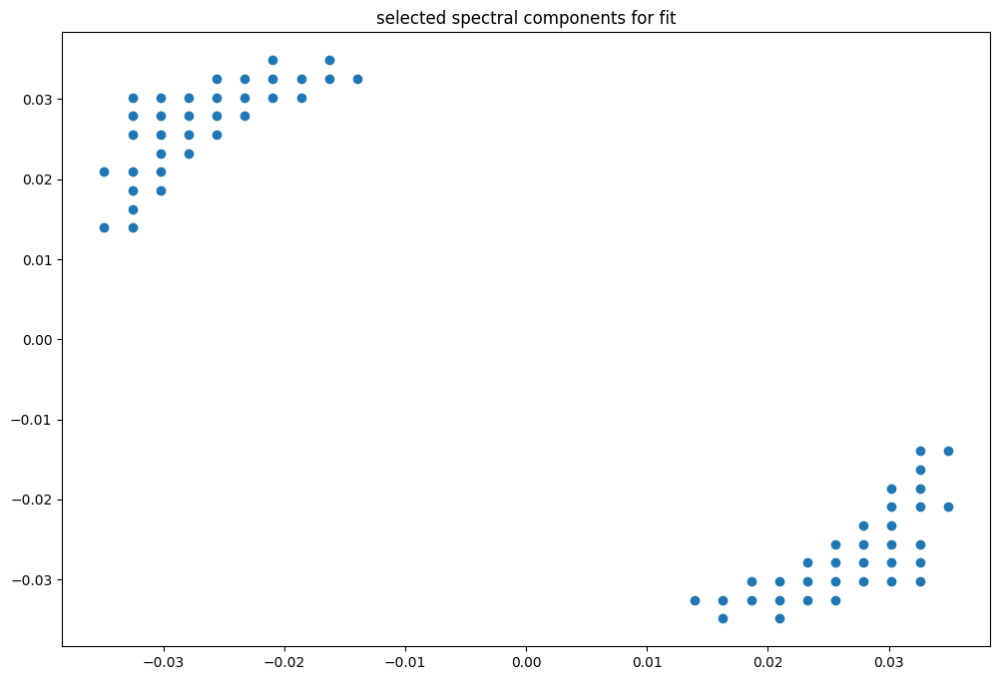

box [2500, 3200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

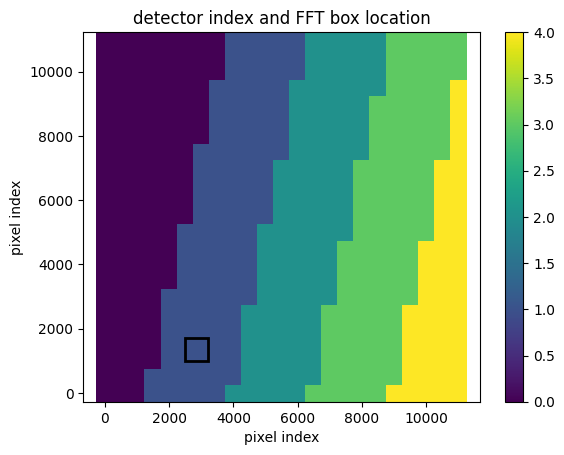

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


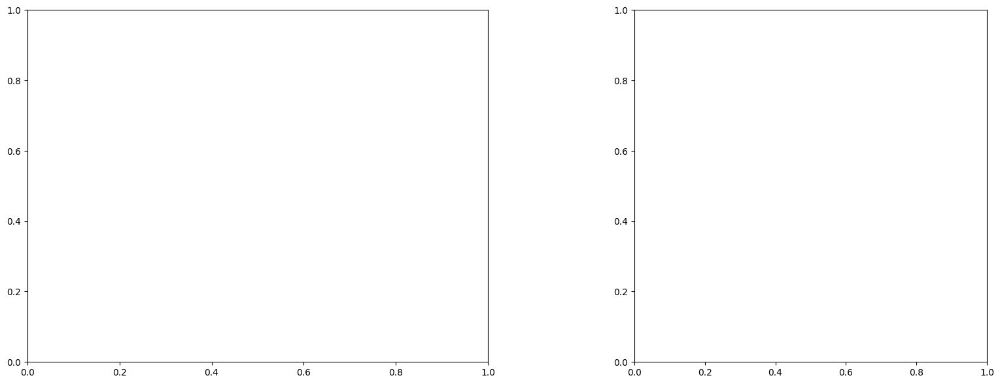

U and V components of current : [ 0.25577744 -0.88409659]
uncertainties for U and V: 0.08972763242802916 0.1002720807674123


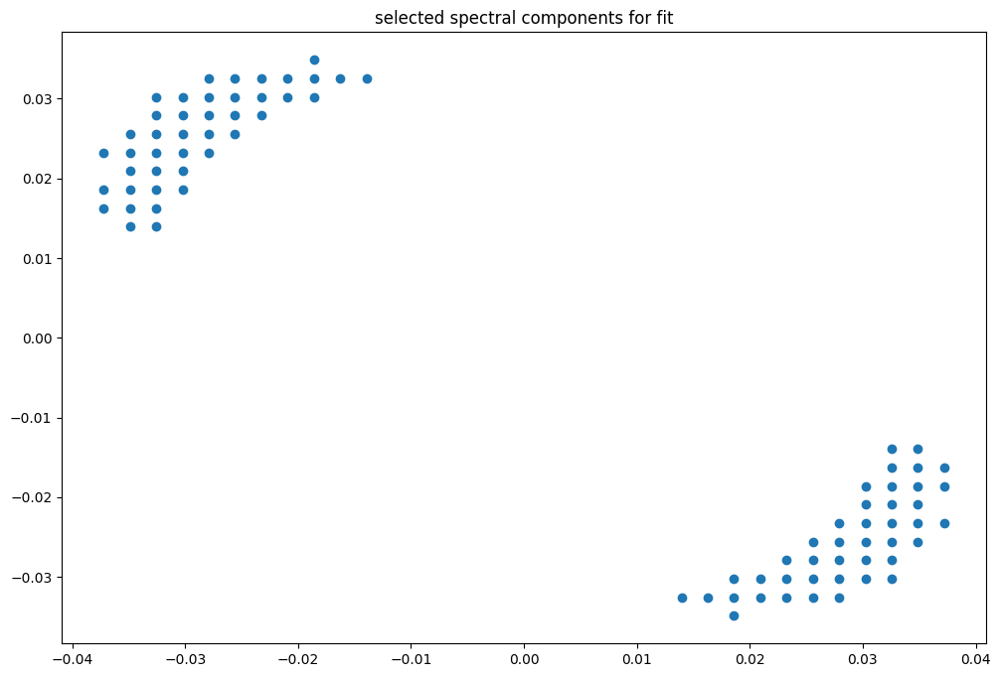

box [2500, 3200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

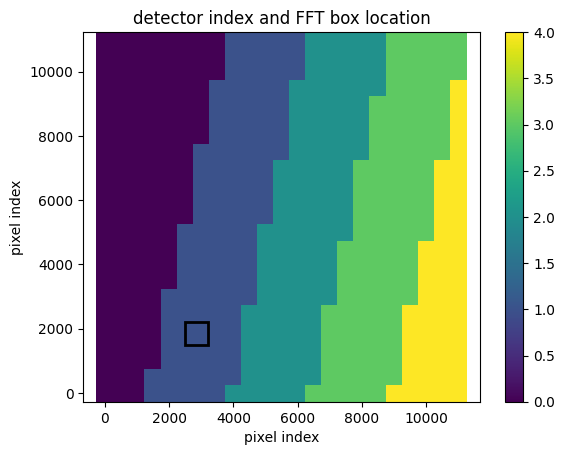

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


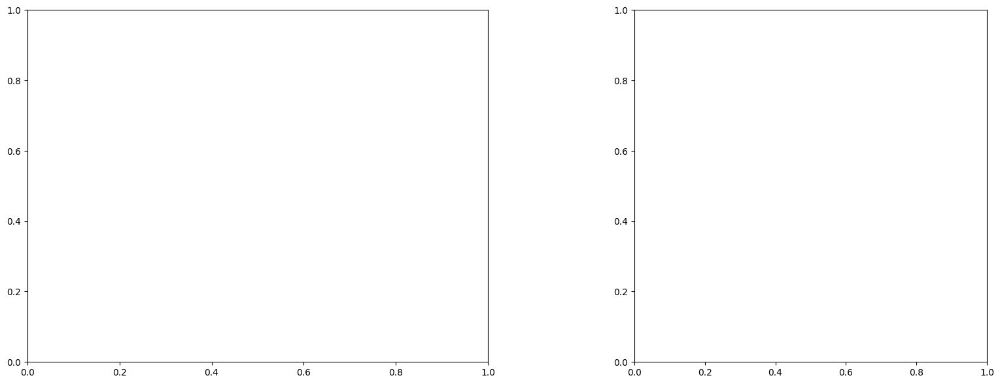

U and V components of current : [ 0.21905923 -0.7121721 ]
uncertainties for U and V: 0.10092225791742863 0.10589481724131362


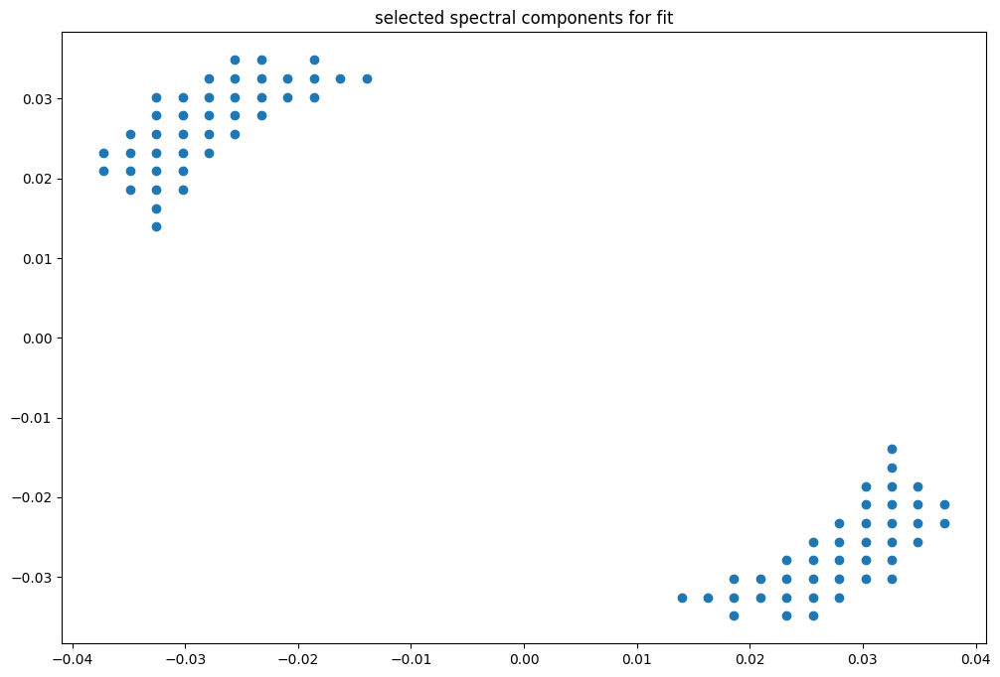

box [2500, 3200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

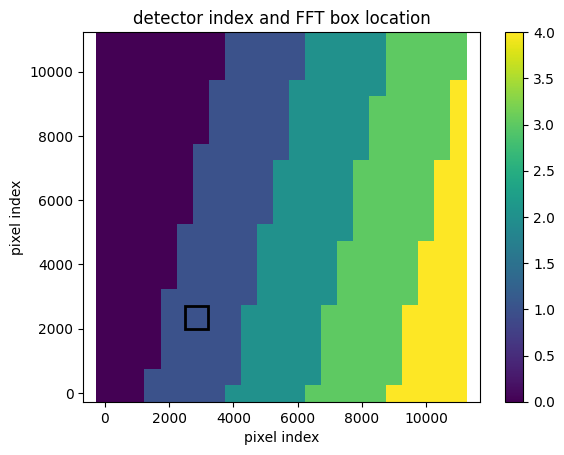

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


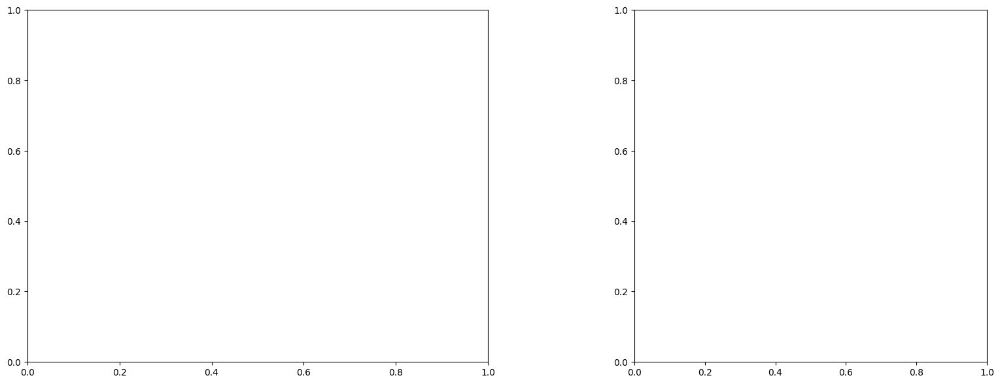

U and V components of current : [ 0.15977202 -0.82766255]
uncertainties for U and V: 0.12495804261078511 0.13439905191971221


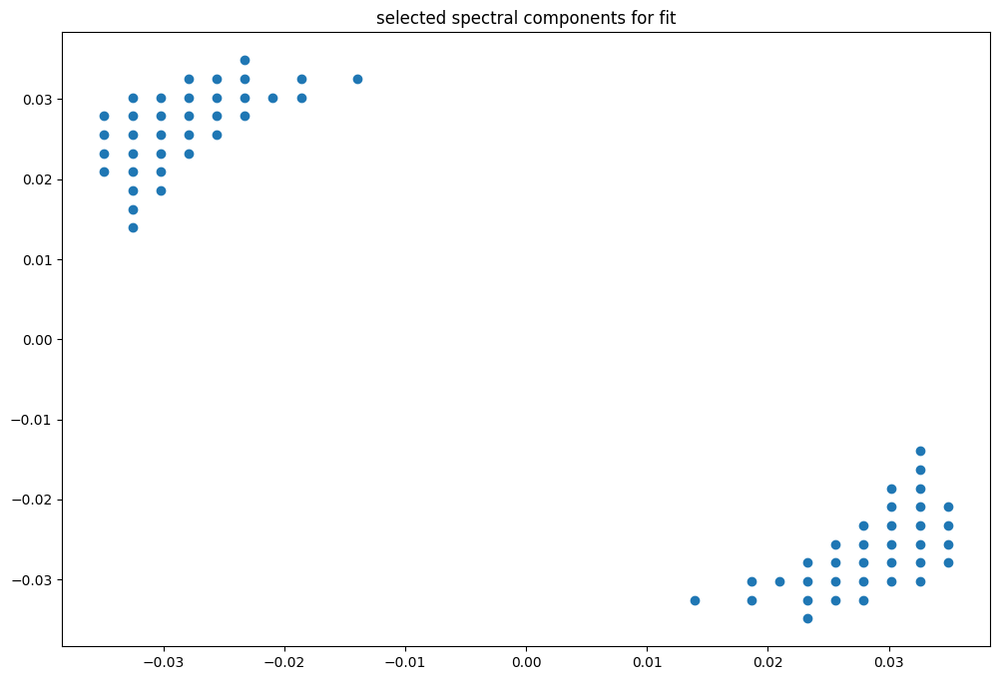

box [2500, 3200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

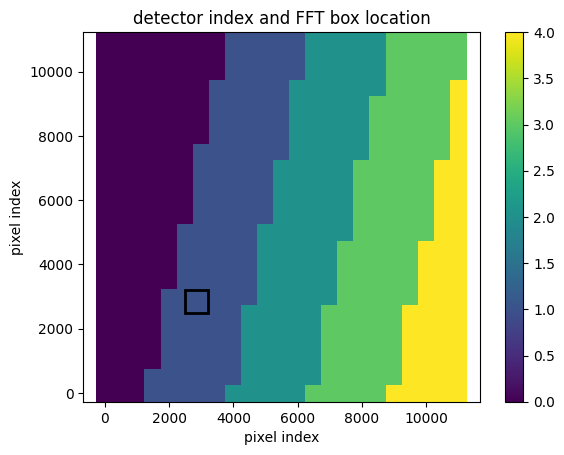

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


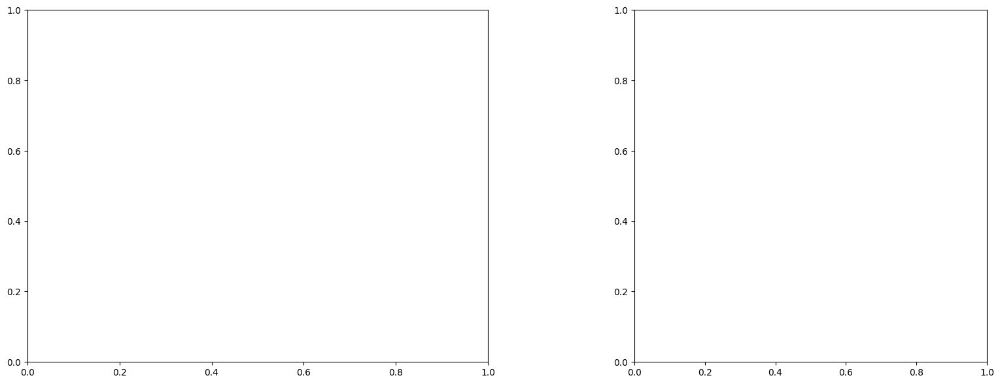

U and V components of current : [-0.04820664 -1.25528608]
uncertainties for U and V: 0.13038335637869655 0.1396726038381551


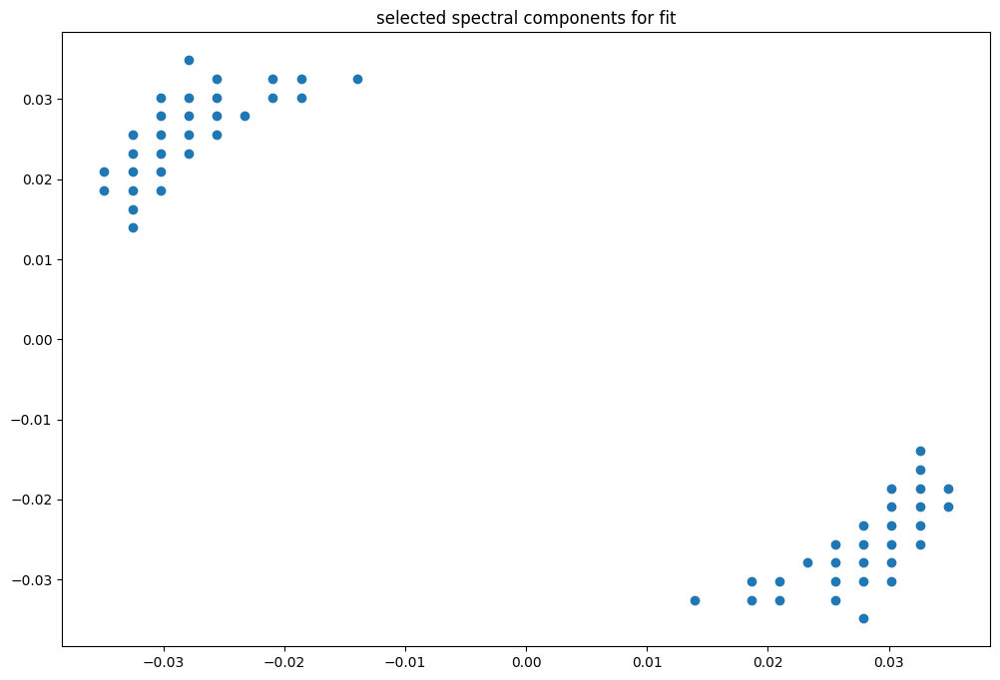

box [2500, 3200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

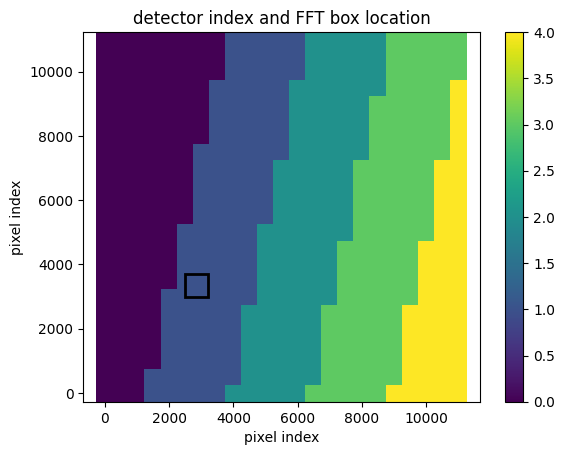

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


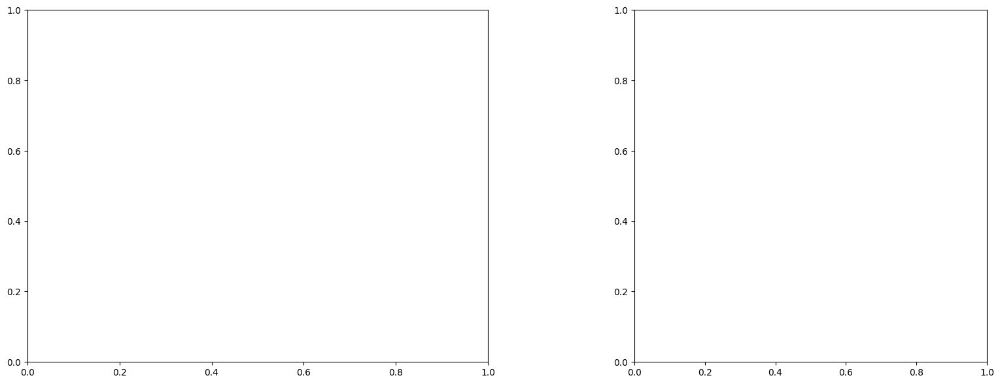

U and V components of current : [ 0.27338744 -1.40070332]
uncertainties for U and V: 0.09466825816736332 0.10830231387001302


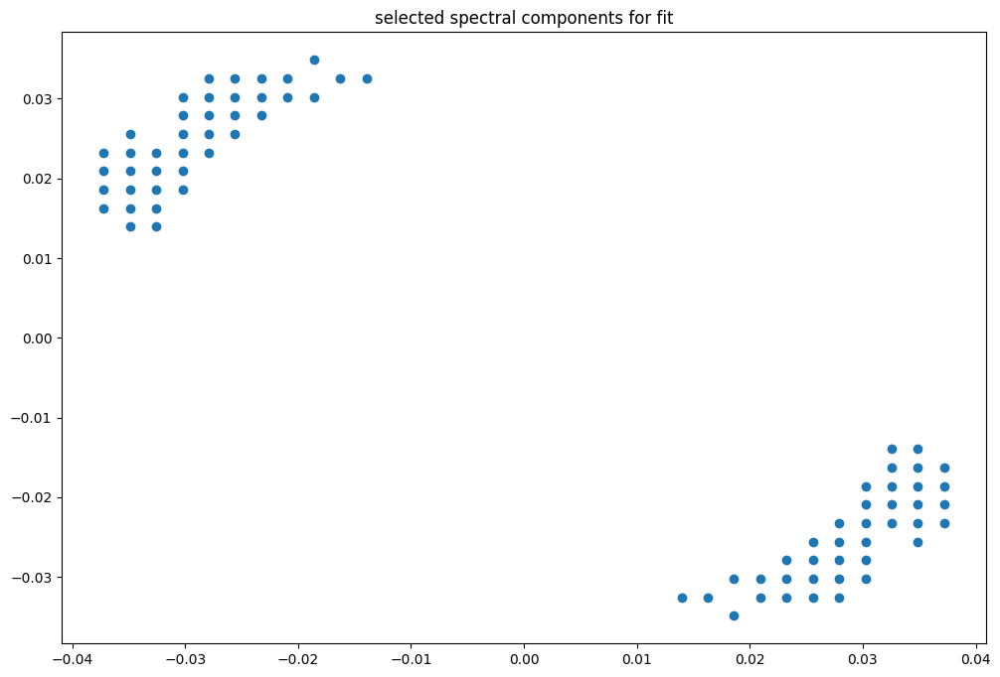

box [2500, 3200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

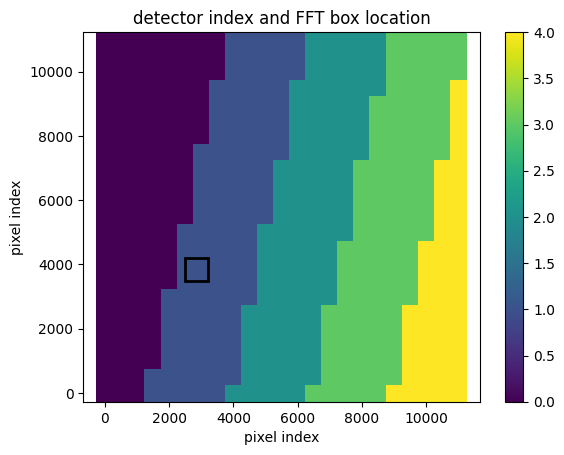

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


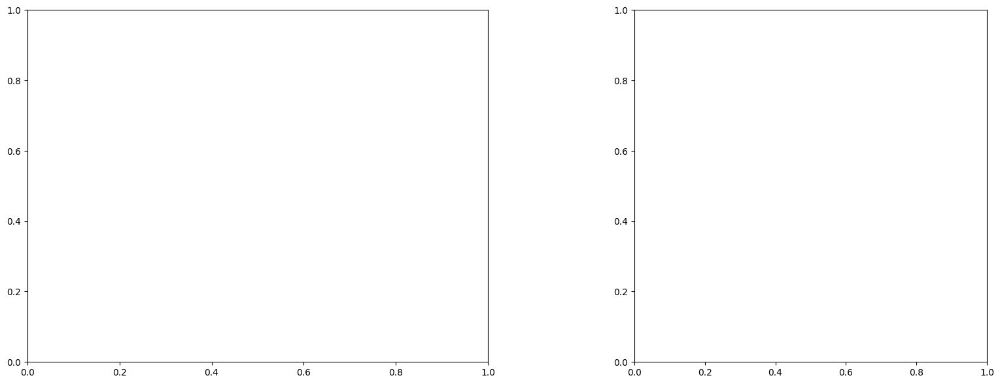

U and V components of current : [ 0.05675471 -1.19616248]
uncertainties for U and V: 0.07699475077163828 0.09317690740882084


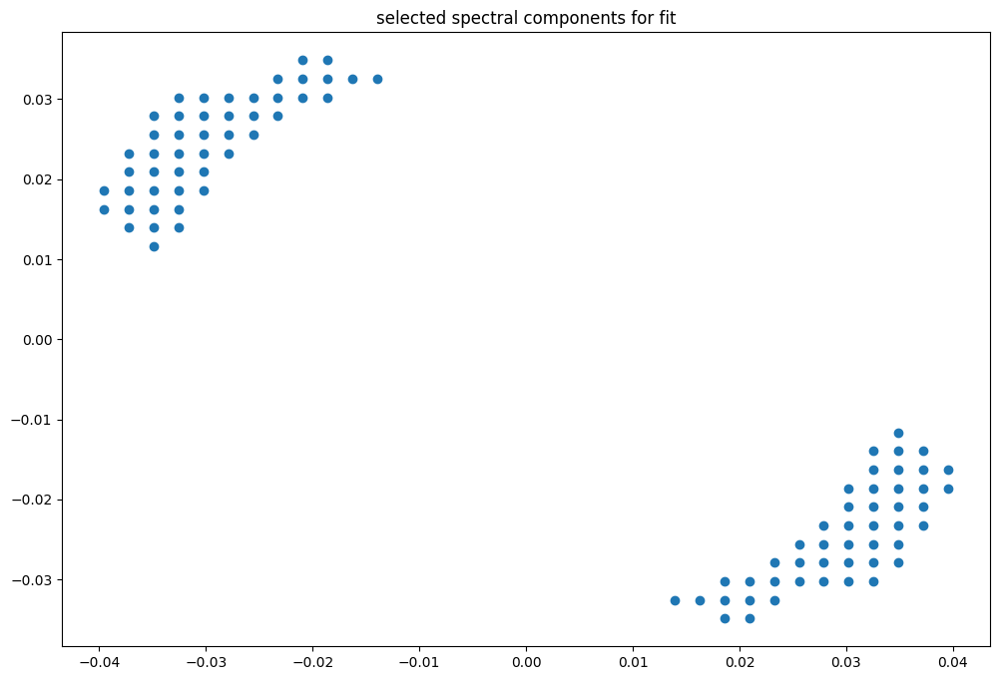

box [2500, 3200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

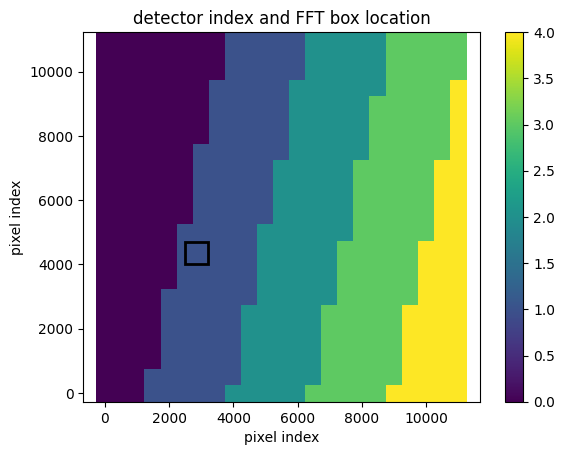

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


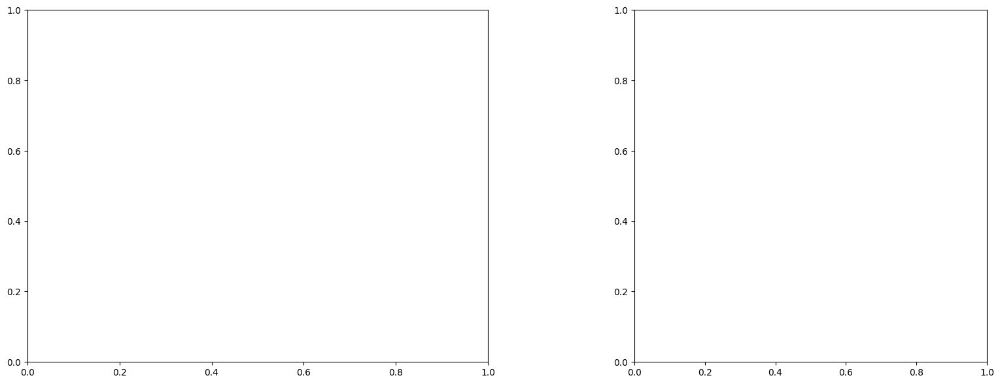

U and V components of current : [ 0.29192471 -0.68313759]
uncertainties for U and V: 0.08286981339397866 0.09961250906449622


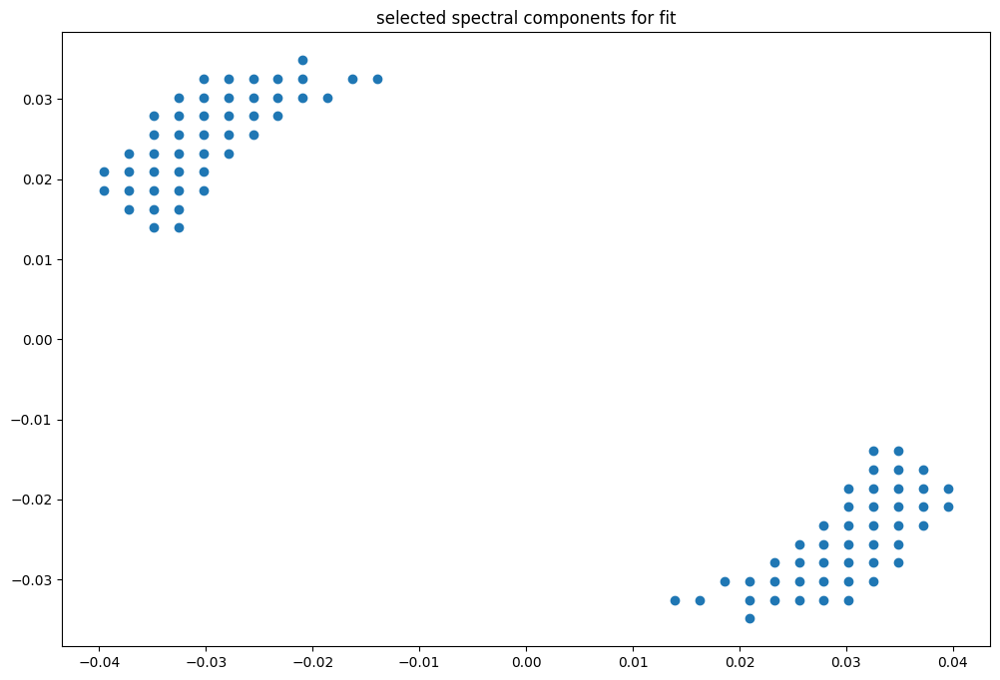

box [2500, 3200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

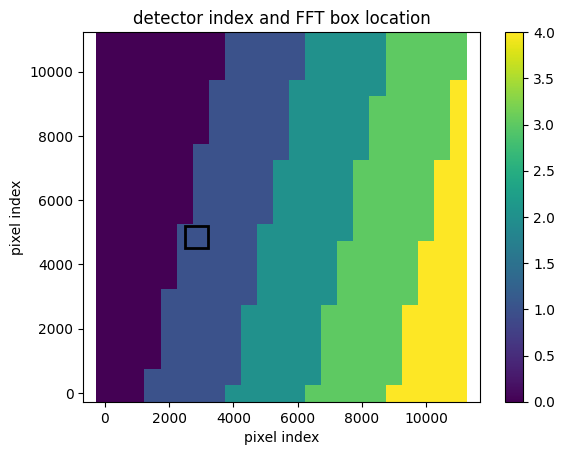

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


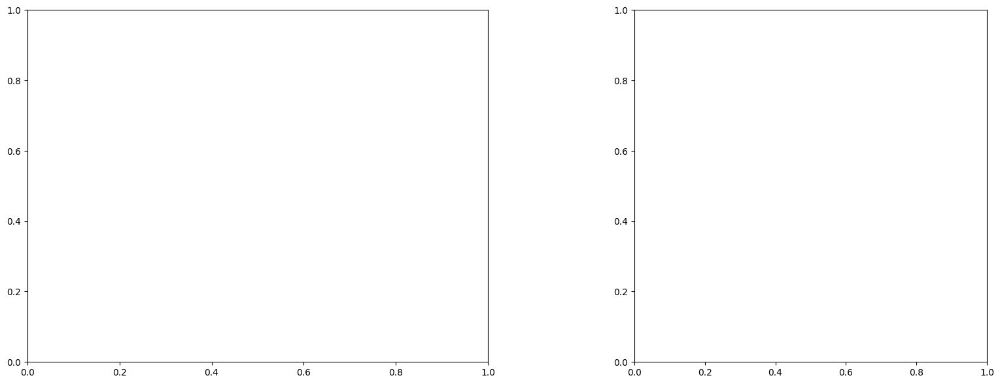

U and V components of current : [-0.08125261 -0.79573958]
uncertainties for U and V: 0.06525382760845788 0.07435276496549723


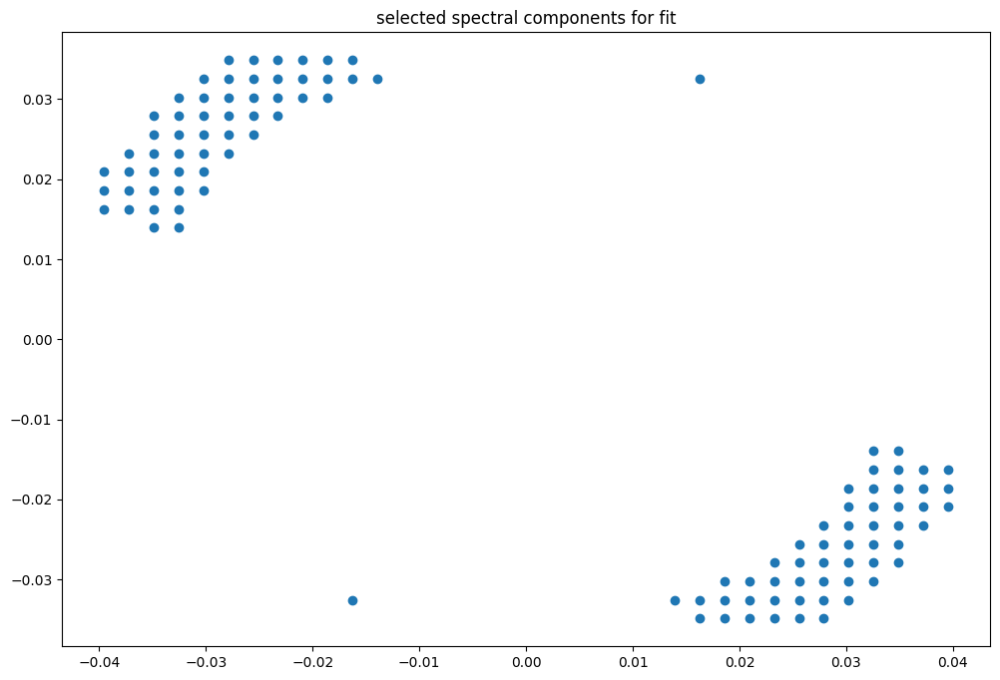

box [2500, 3200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

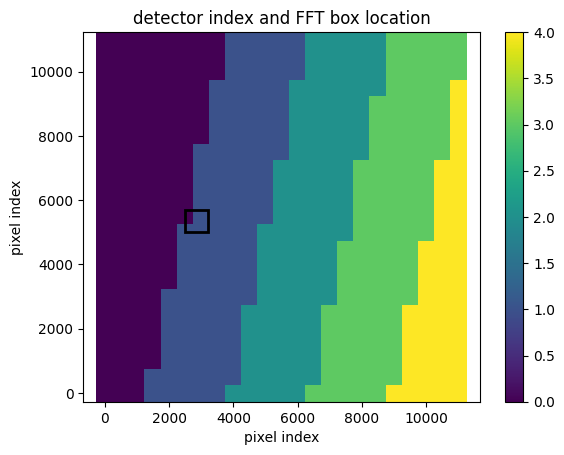

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.96
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


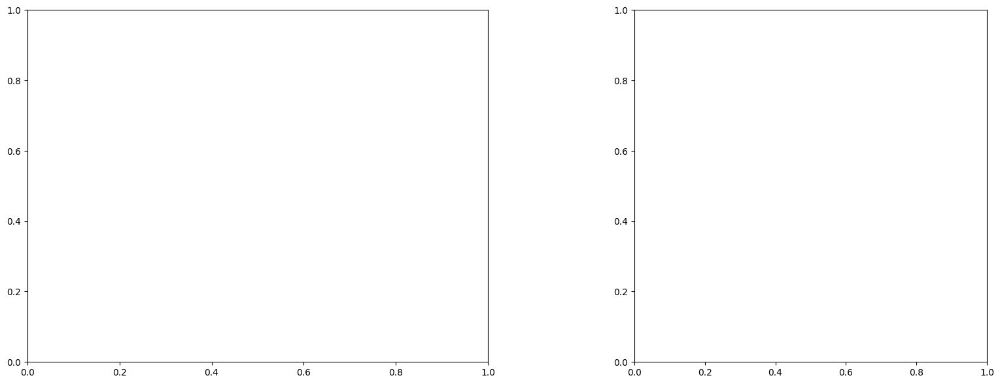

LinAlgError: Singular matrix

box [2500, 3200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

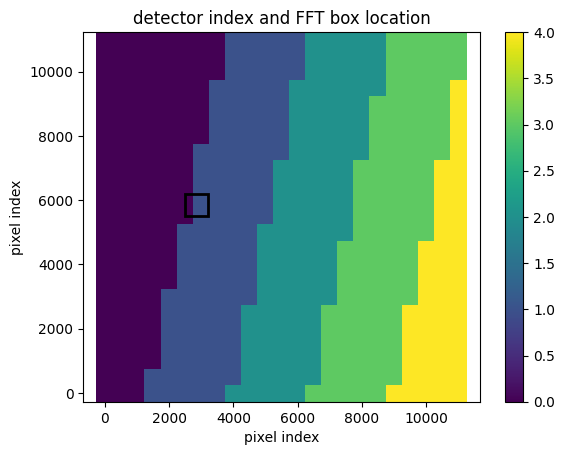

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


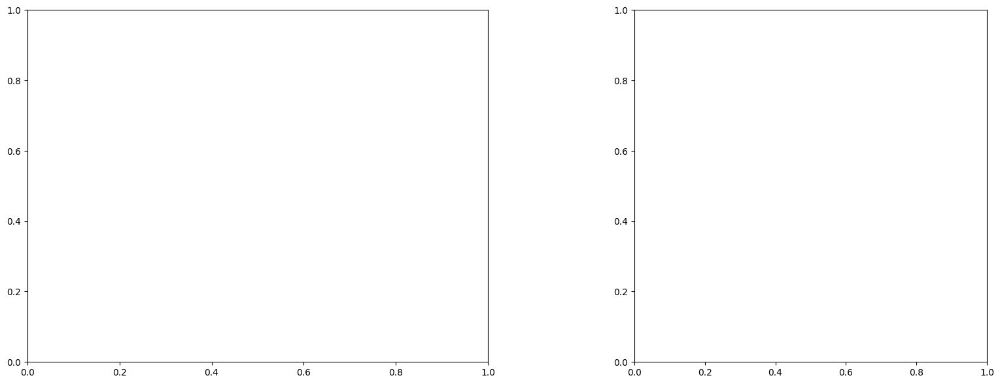

LinAlgError: Singular matrix

box [2500, 3200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

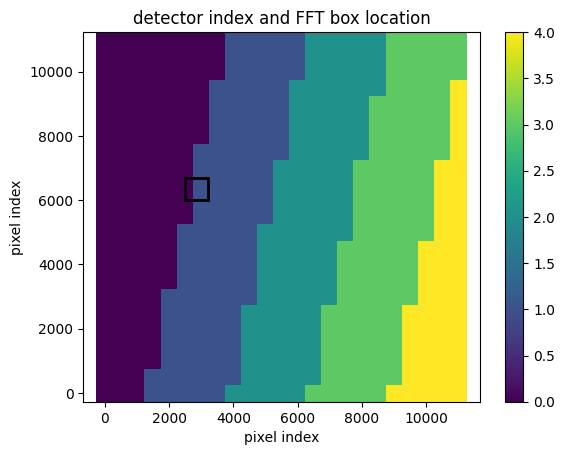

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


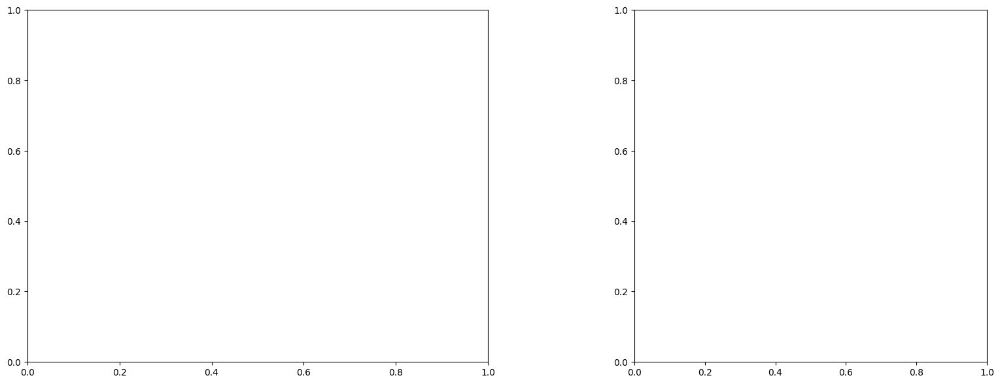

LinAlgError: Singular matrix

box [2500, 3200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

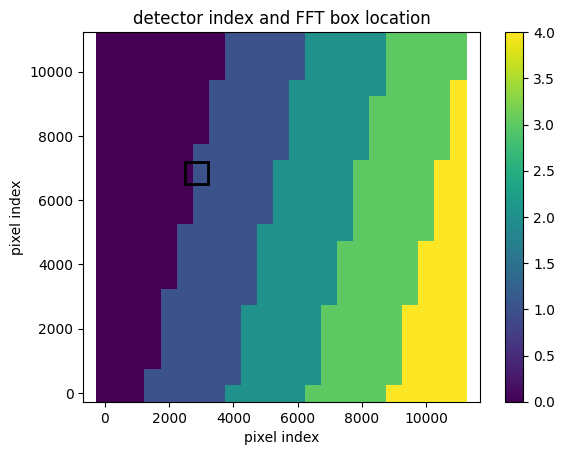

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


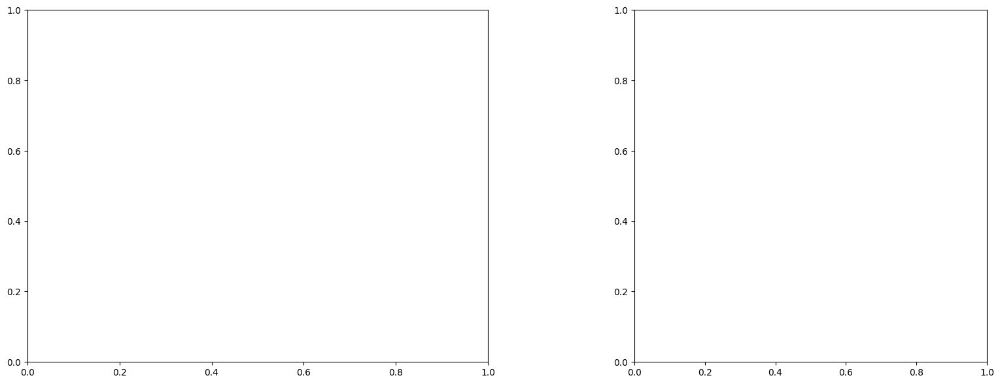

LinAlgError: Singular matrix

box [2500, 3200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

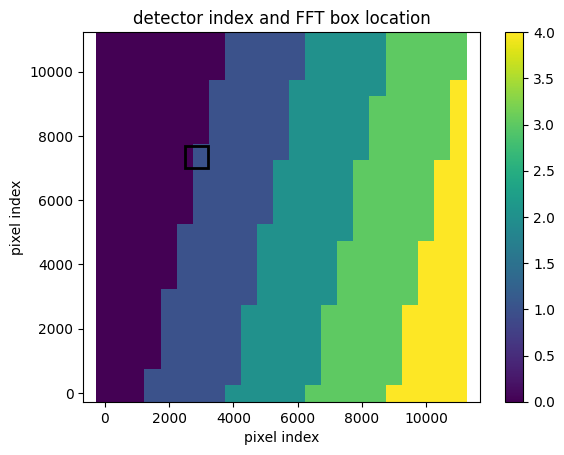

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


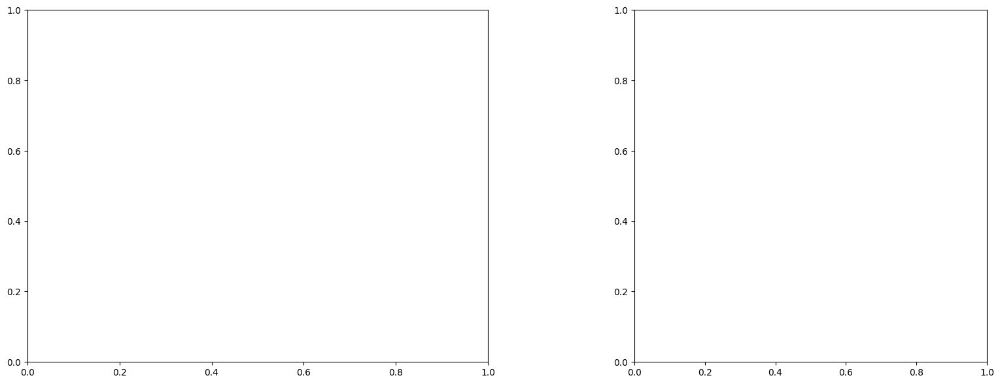

LinAlgError: Singular matrix

box [2500, 3200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

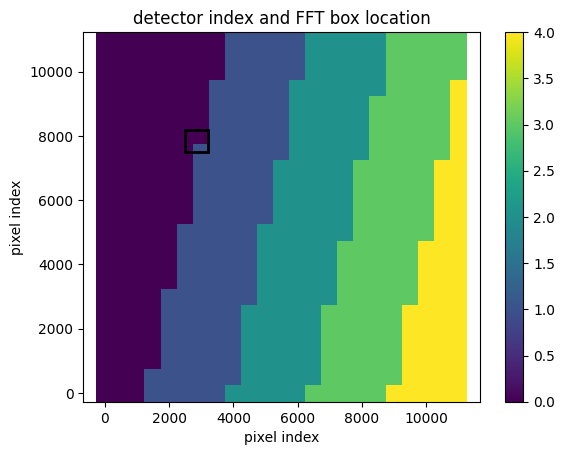

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.26
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


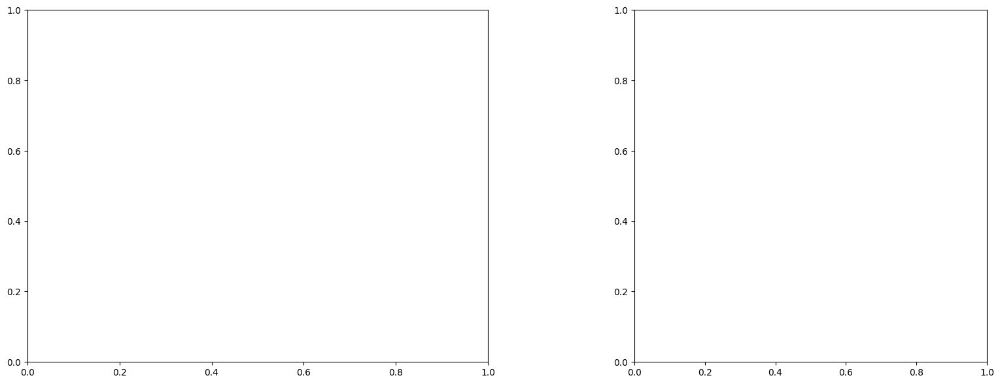

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

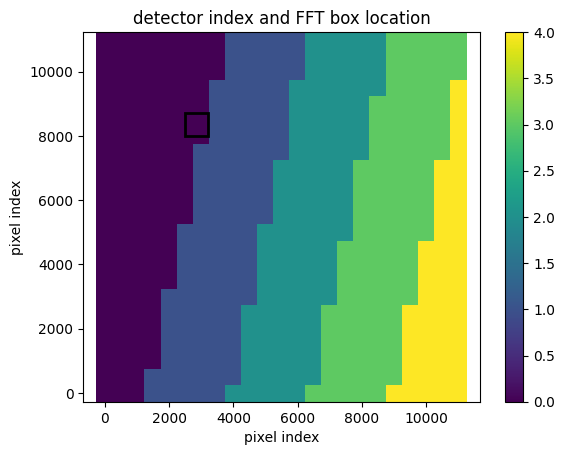

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


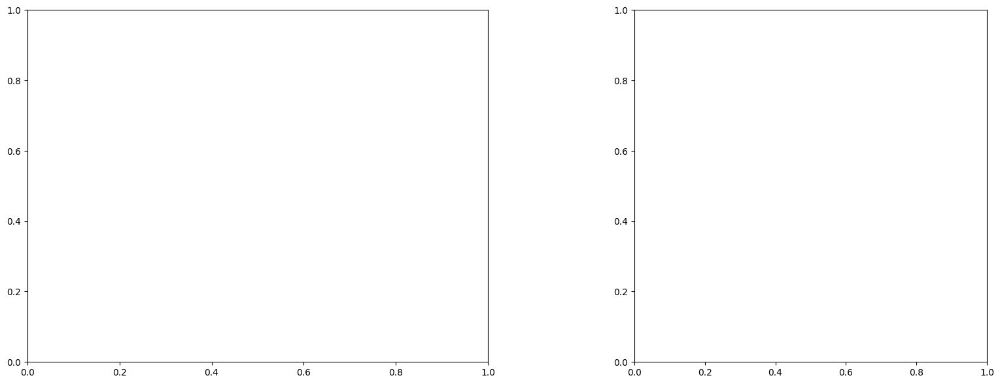

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

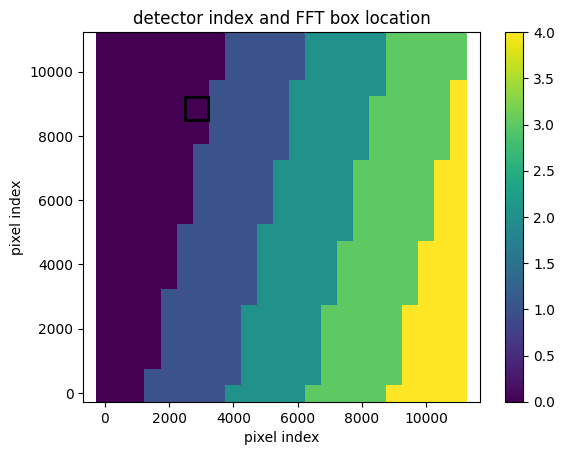

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


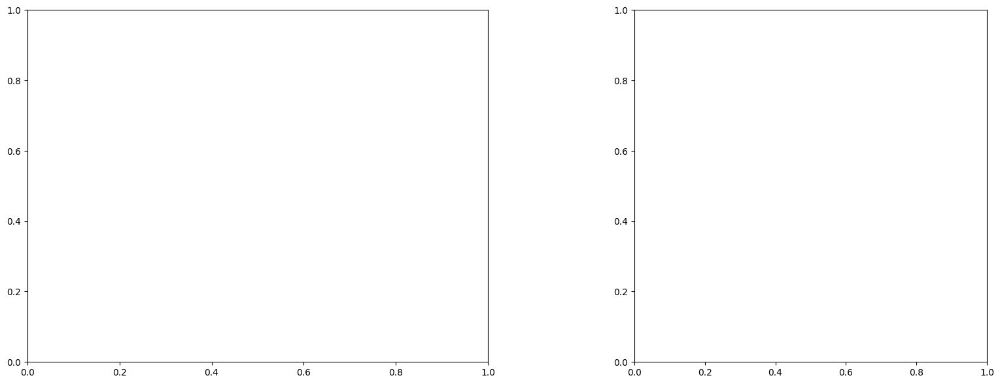

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

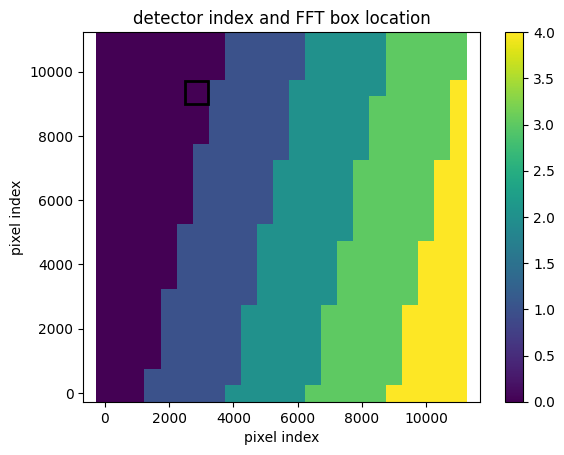

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


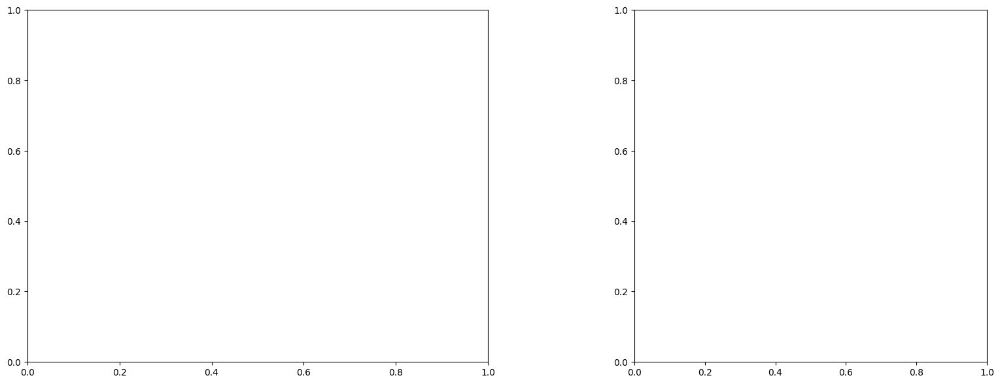

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

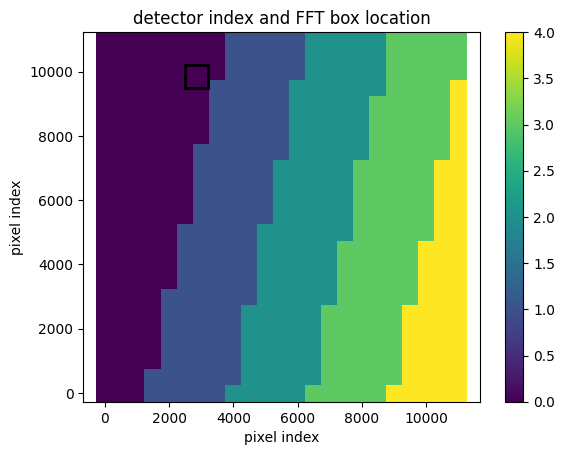

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


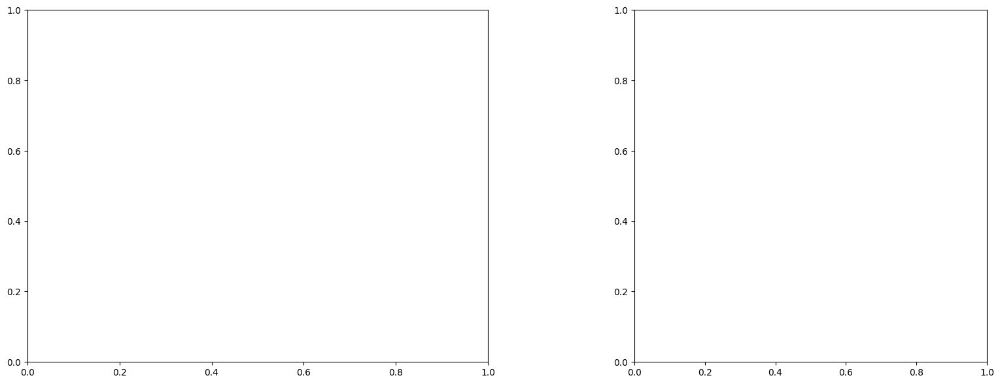

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

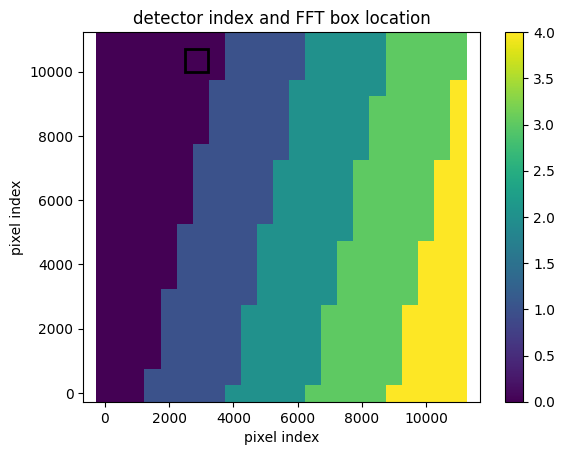

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


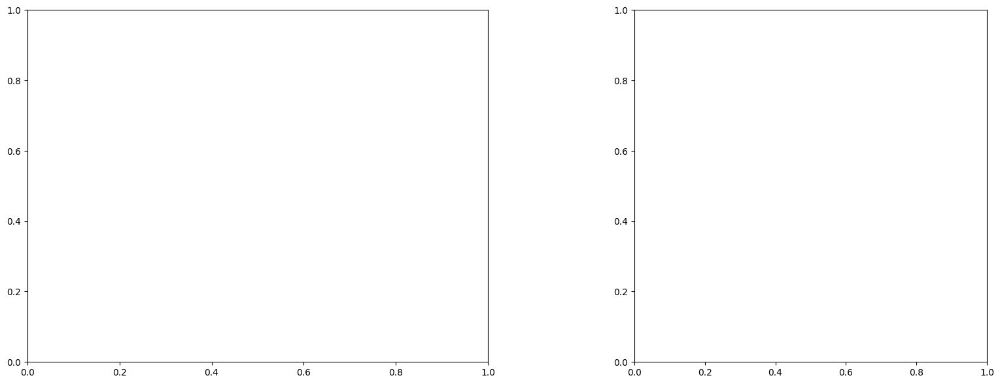

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [2500, 3200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

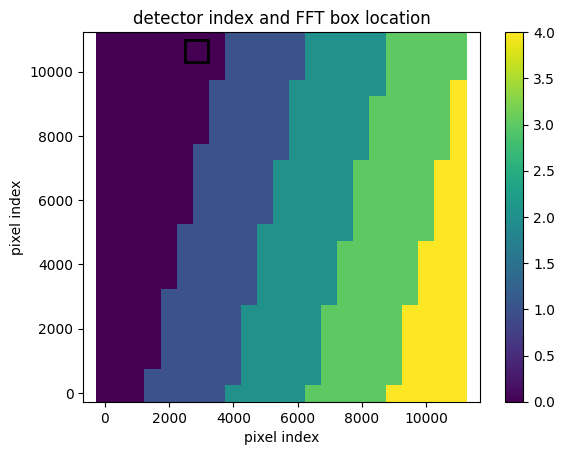

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


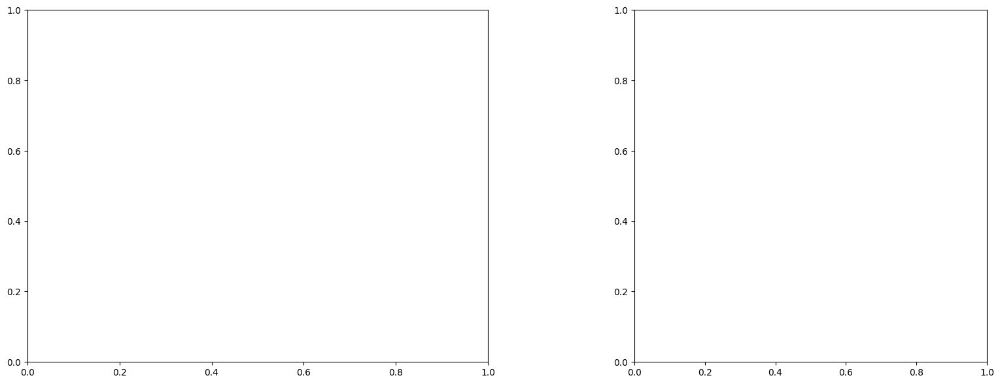

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [3000, 3700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

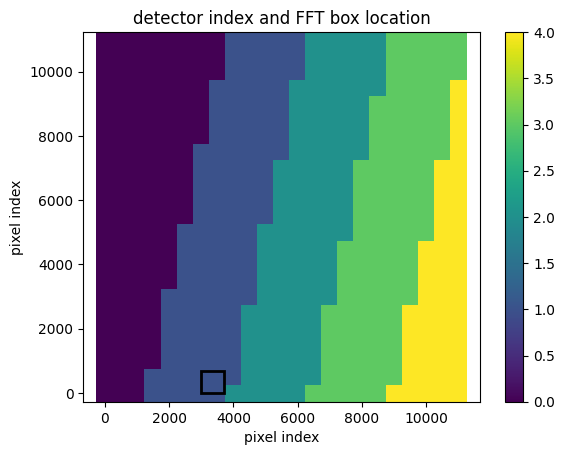

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


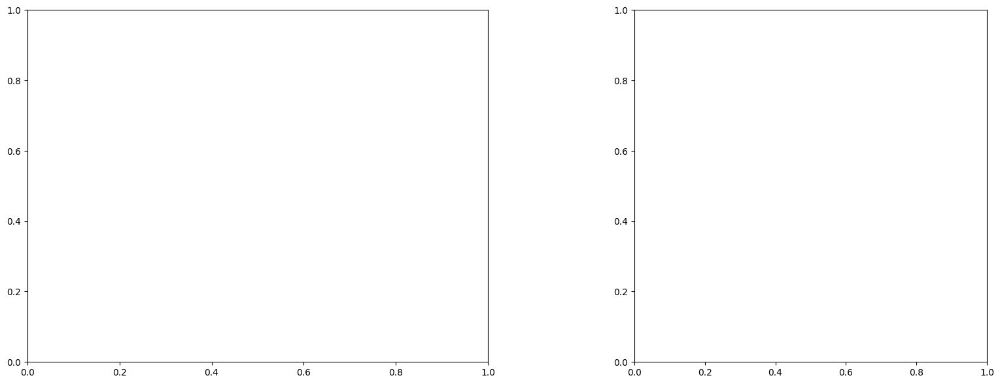

U and V components of current : [ 0.27334243 -0.67028802]
uncertainties for U and V: 0.0778561456712907 0.07547300665278882


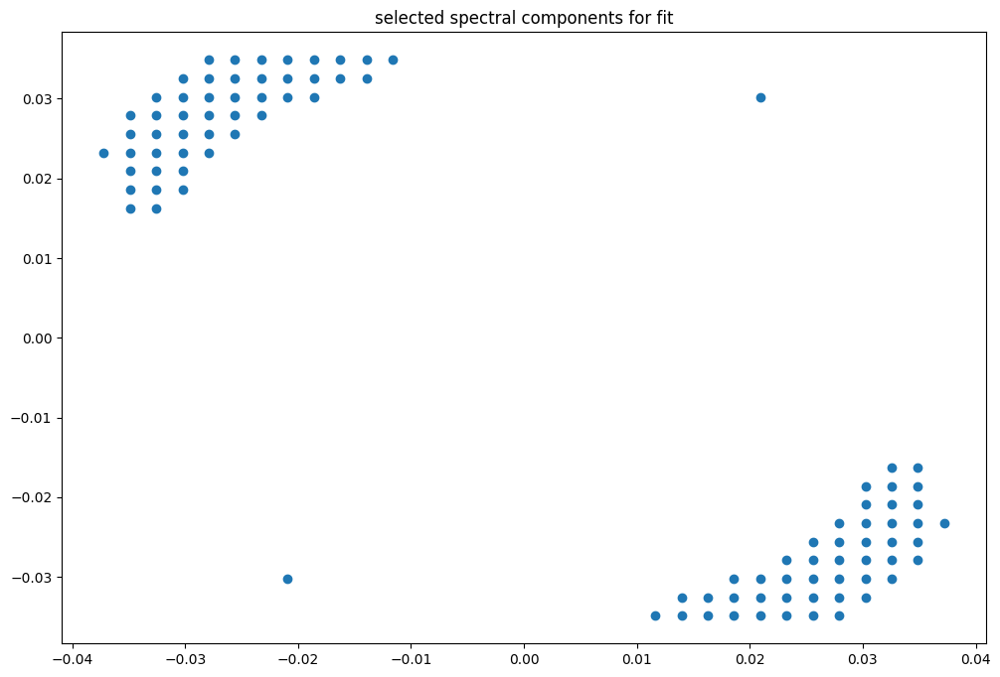

box [3000, 3700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

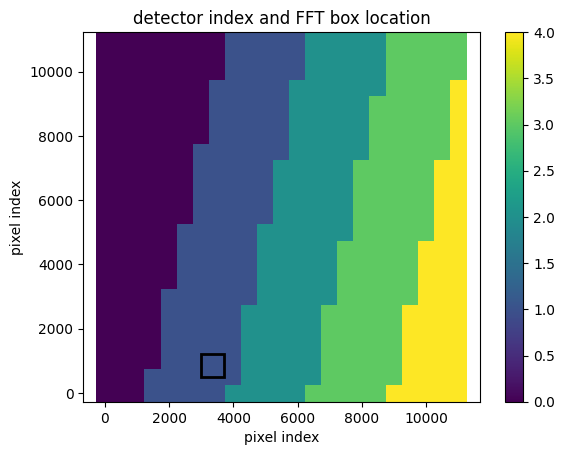

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


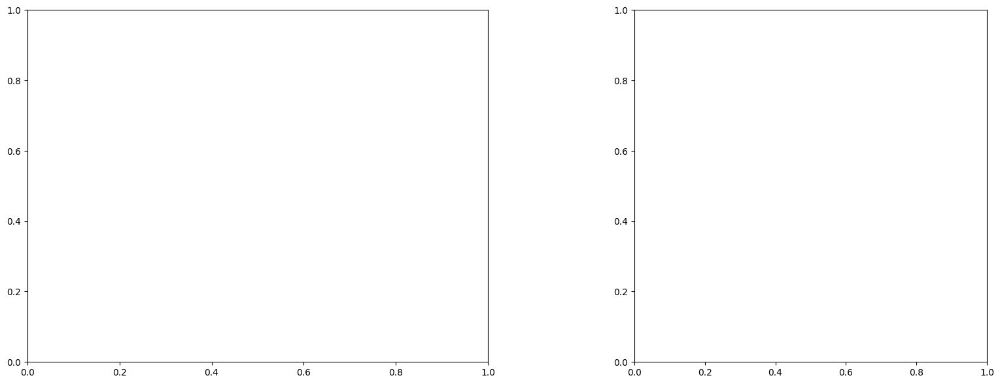

U and V components of current : [ 0.48357239 -0.9251326 ]
uncertainties for U and V: 0.08297708231974961 0.08679632441647489


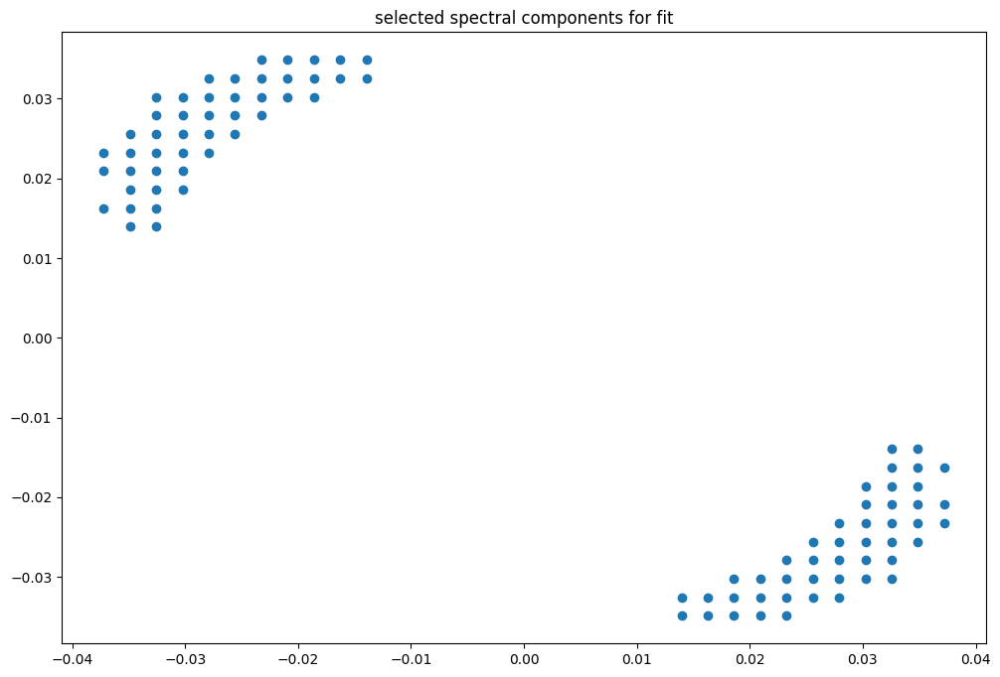

box [3000, 3700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

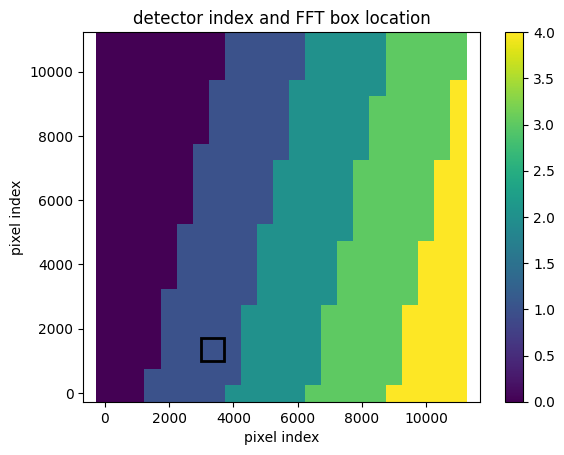

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


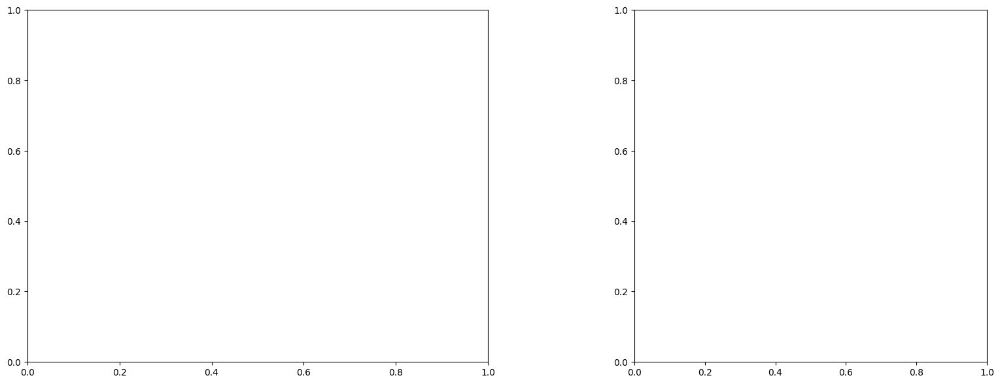

U and V components of current : [ 0.61912284 -0.66245842]
uncertainties for U and V: 0.0906860676553892 0.10179484562774838


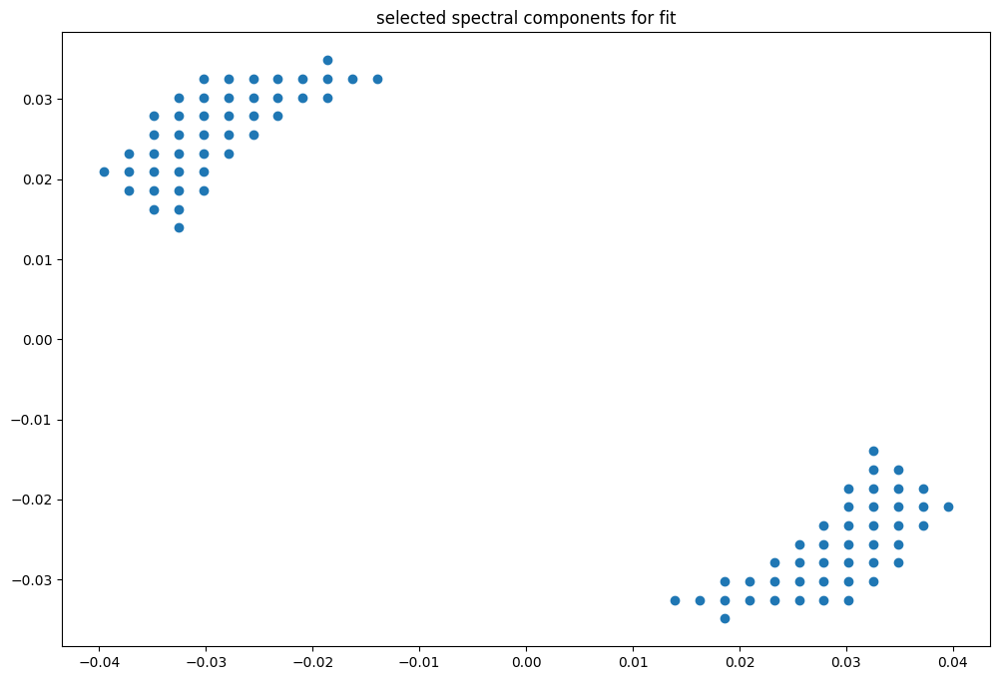

box [3000, 3700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

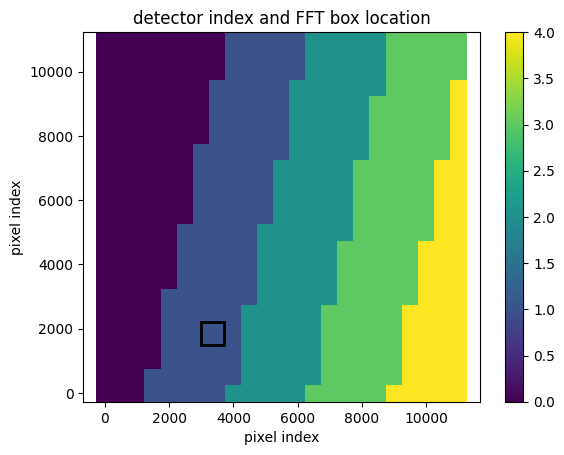

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


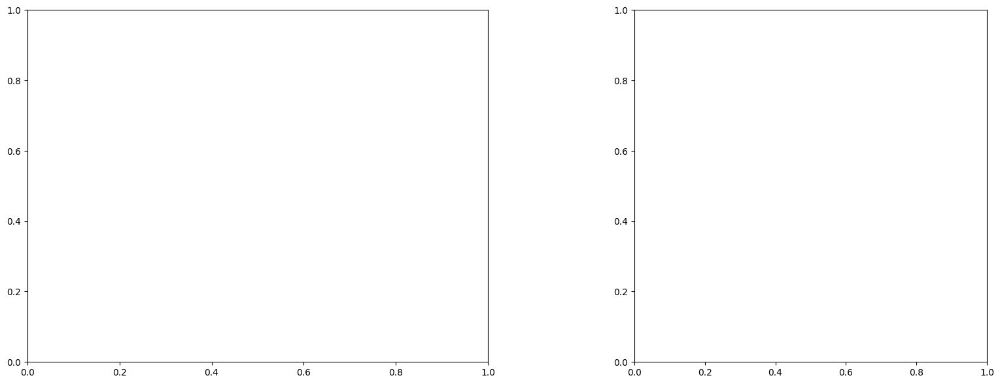

U and V components of current : [ 0.1901121  -0.76619108]
uncertainties for U and V: 0.08571108127132829 0.09176299866133665


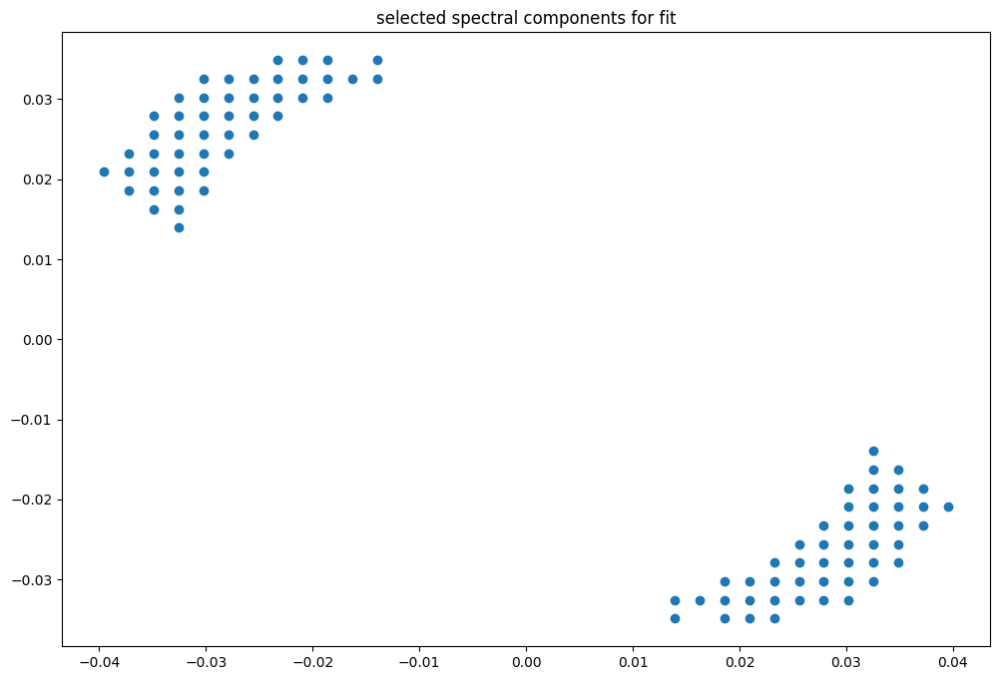

box [3000, 3700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

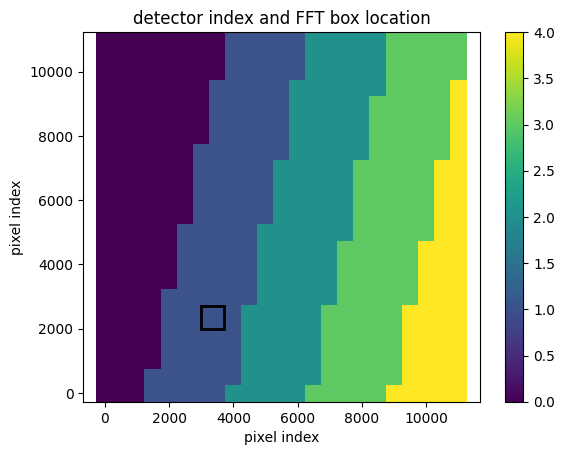

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


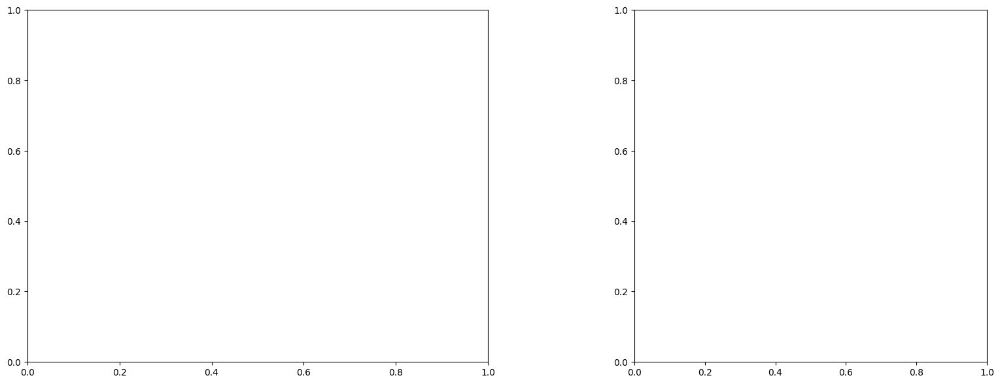

U and V components of current : [ 0.29894066 -0.62135535]
uncertainties for U and V: 0.09038351701554959 0.10123242473084264


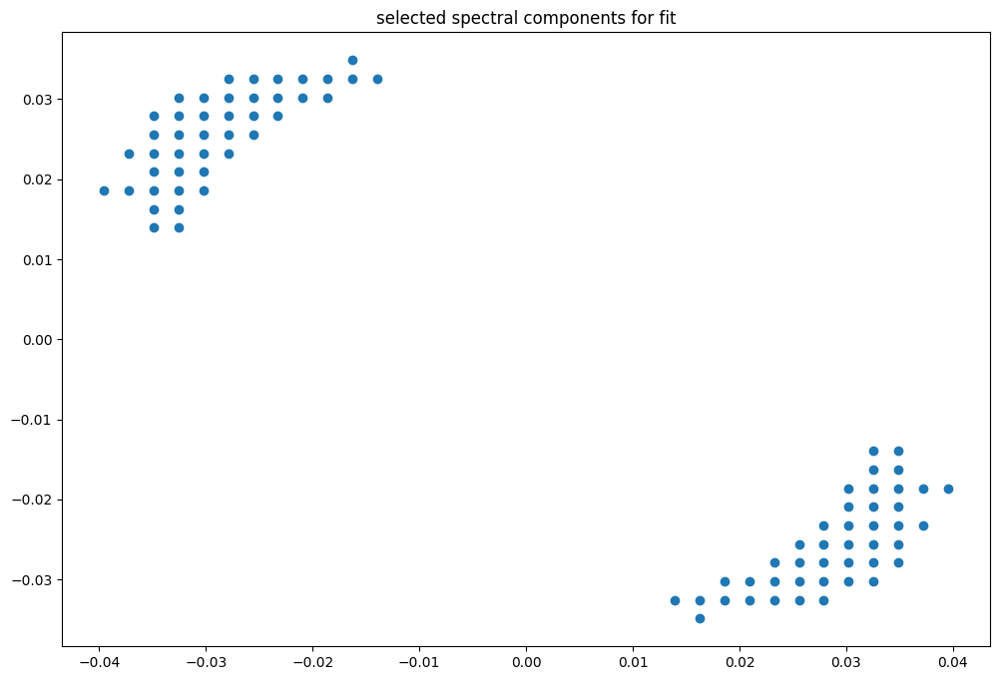

box [3000, 3700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

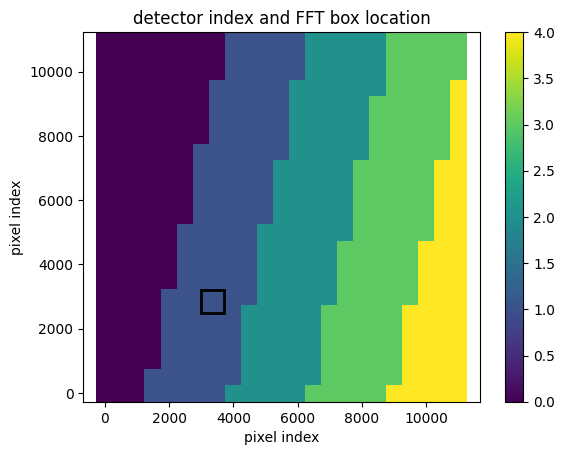

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


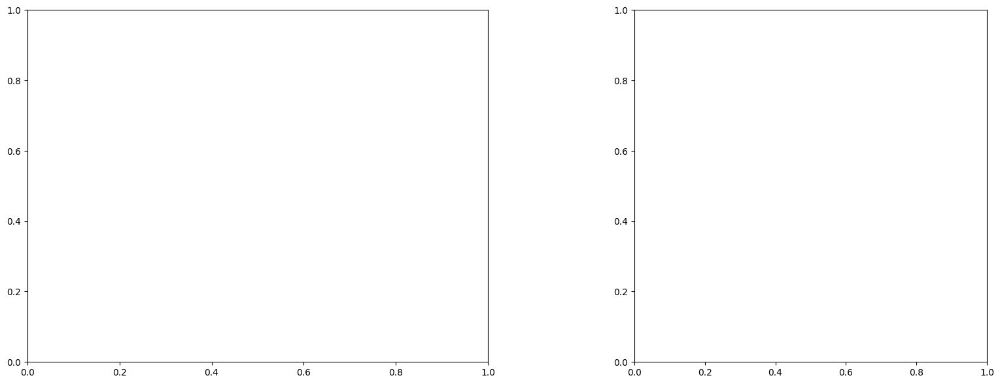

U and V components of current : [ 0.01454521 -1.0990211 ]
uncertainties for U and V: 0.09099625720260385 0.10606652299568697


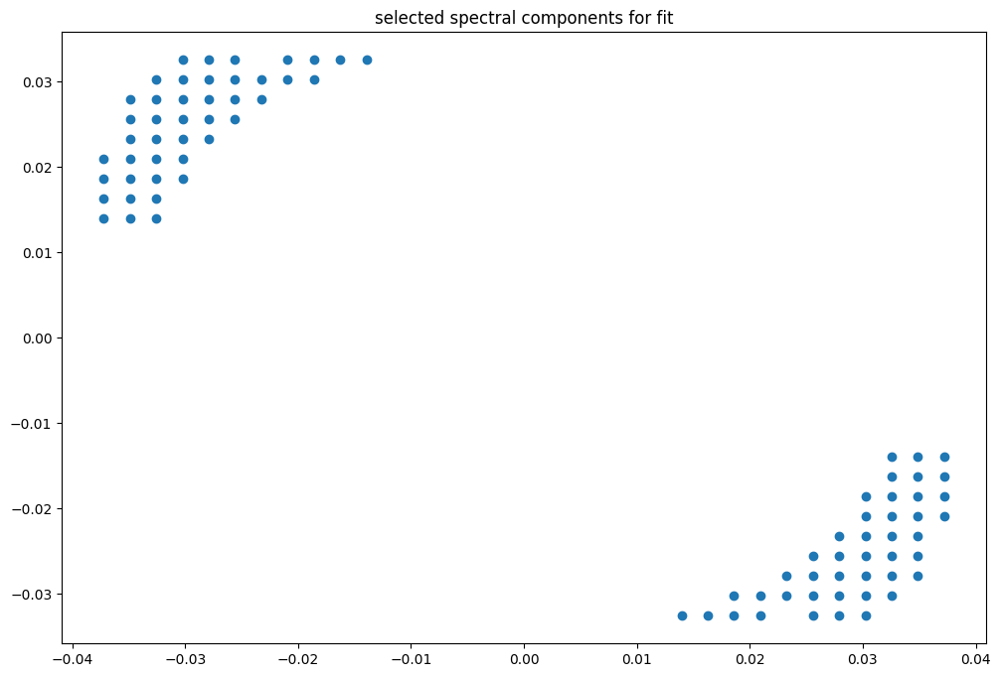

box [3000, 3700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

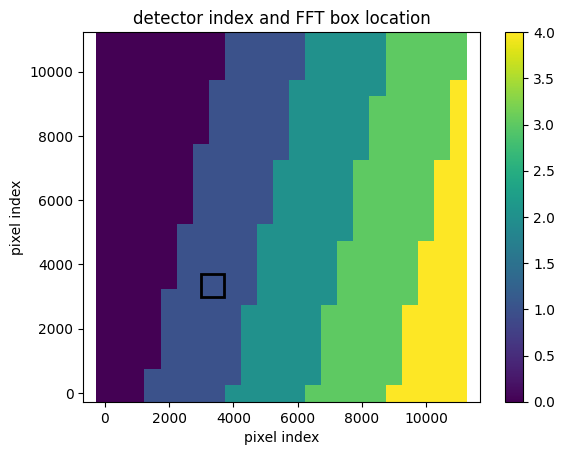

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


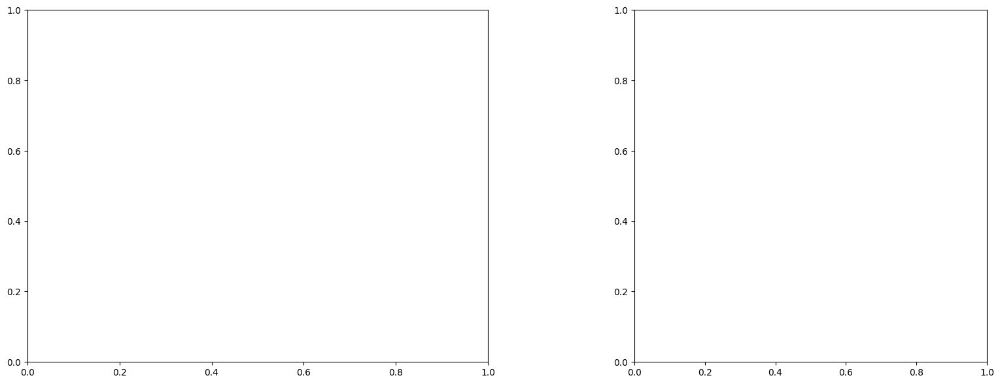

U and V components of current : [ 0.08409963 -0.9073677 ]
uncertainties for U and V: 0.07568535518720607 0.09055896205648677


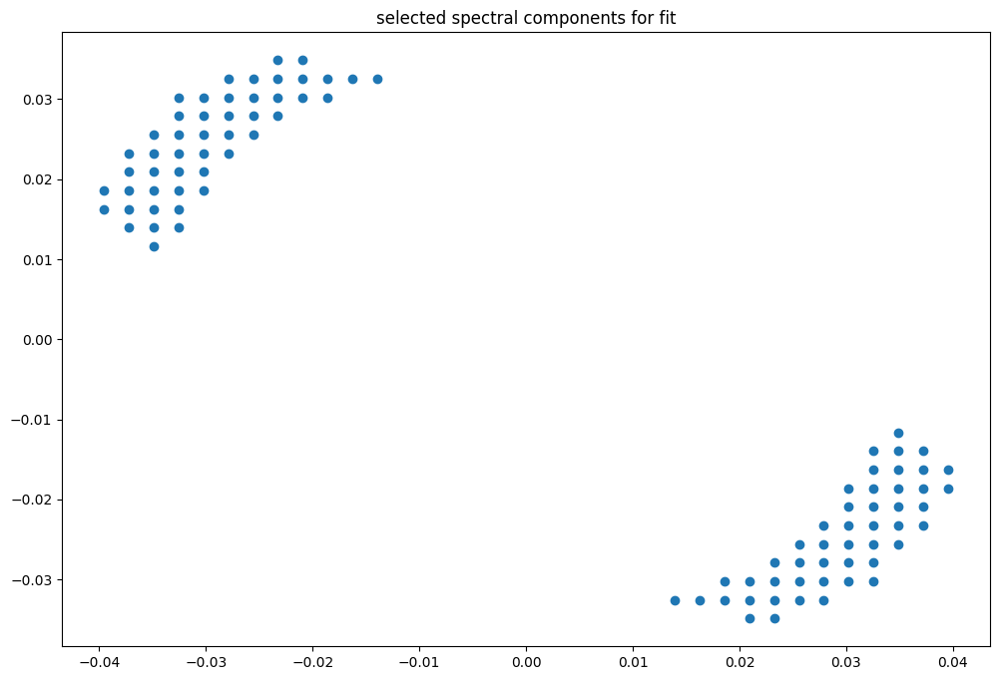

box [3000, 3700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

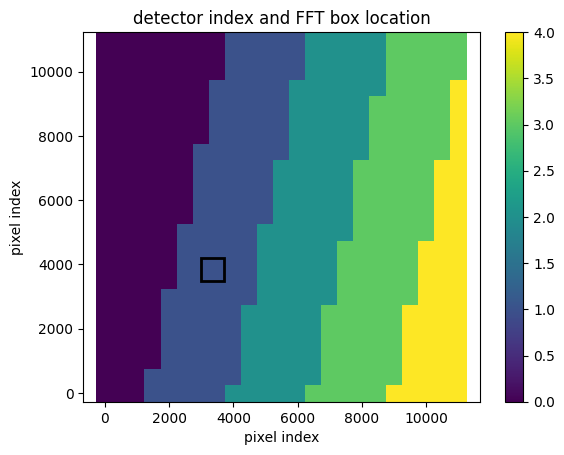

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


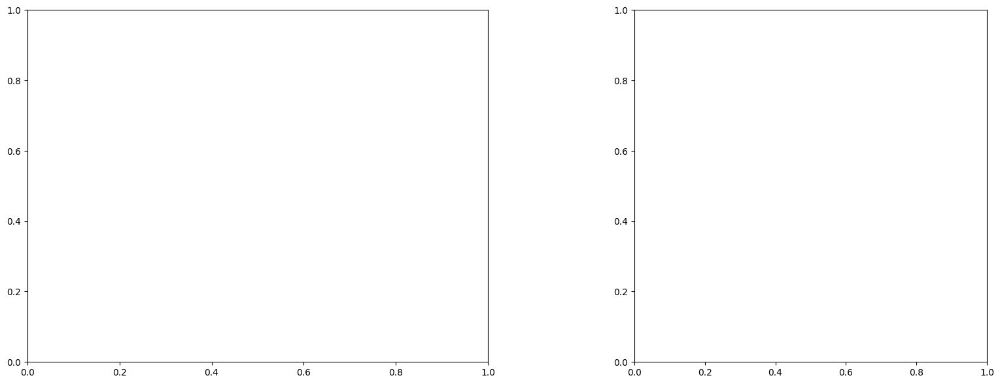

U and V components of current : [-0.05578854 -1.0529198 ]
uncertainties for U and V: 0.0869449295200982 0.10844214128057916


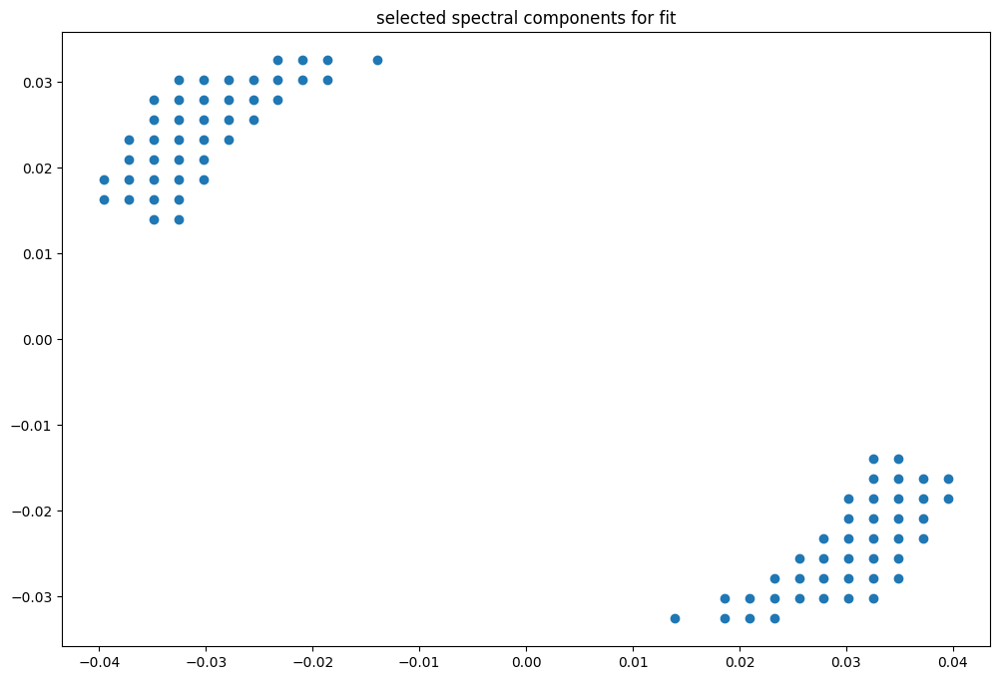

box [3000, 3700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

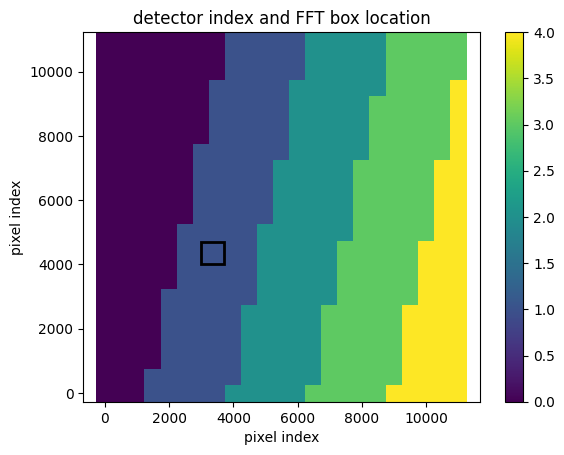

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


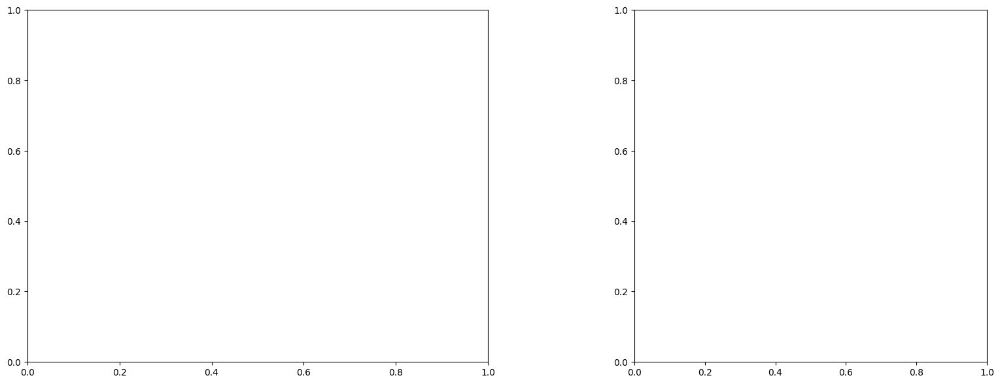

U and V components of current : [ 0.16613298 -0.76367061]
uncertainties for U and V: 0.0808240272332986 0.09499760400716285


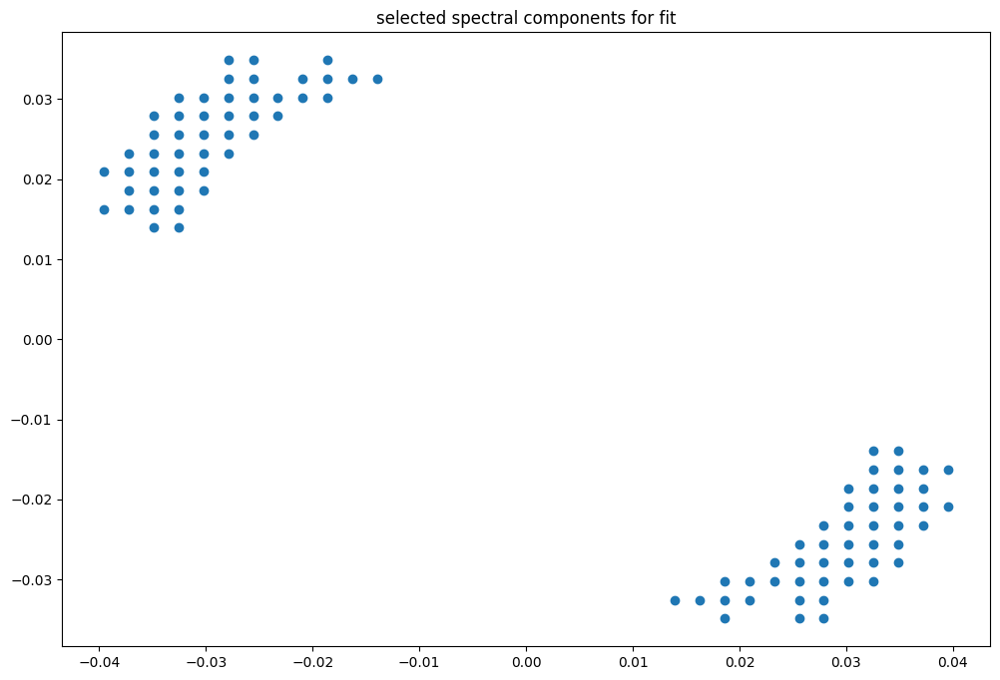

box [3000, 3700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

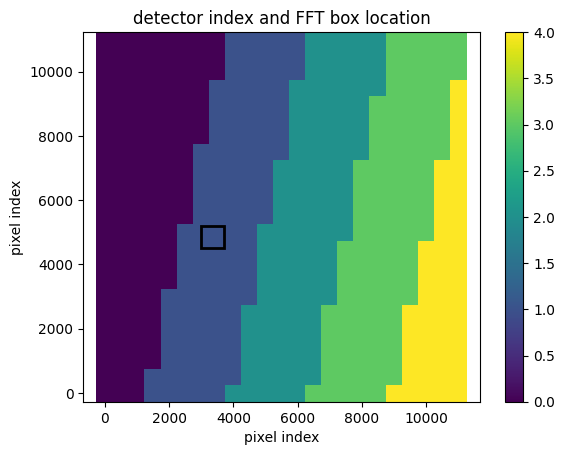

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


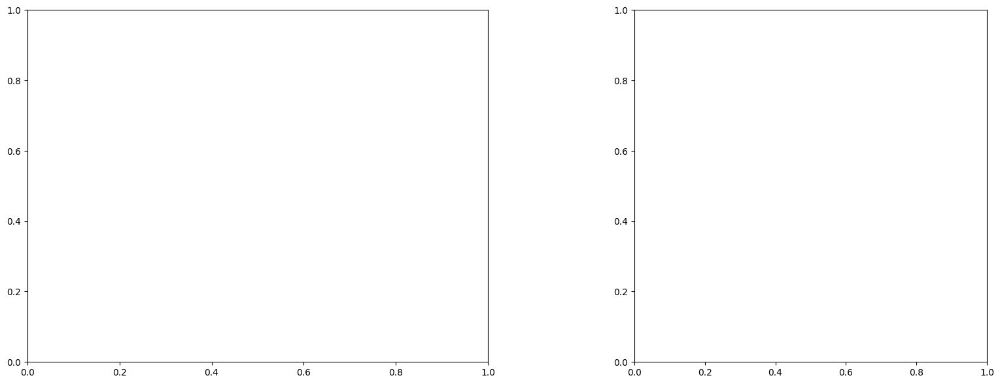

U and V components of current : [-0.04135347 -0.77424567]
uncertainties for U and V: 0.06520183508663731 0.07195581121559515


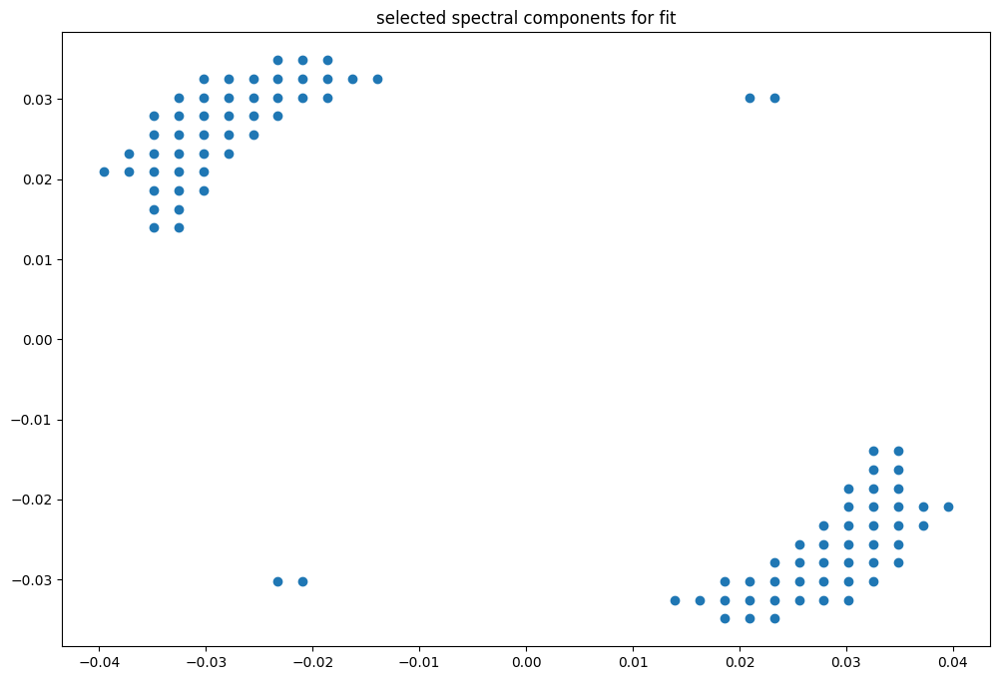

box [3000, 3700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

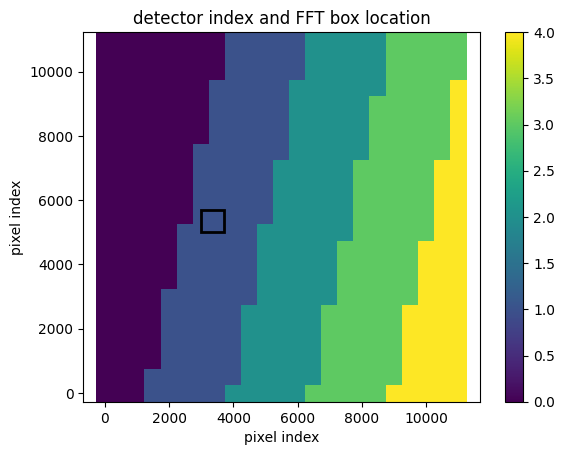

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


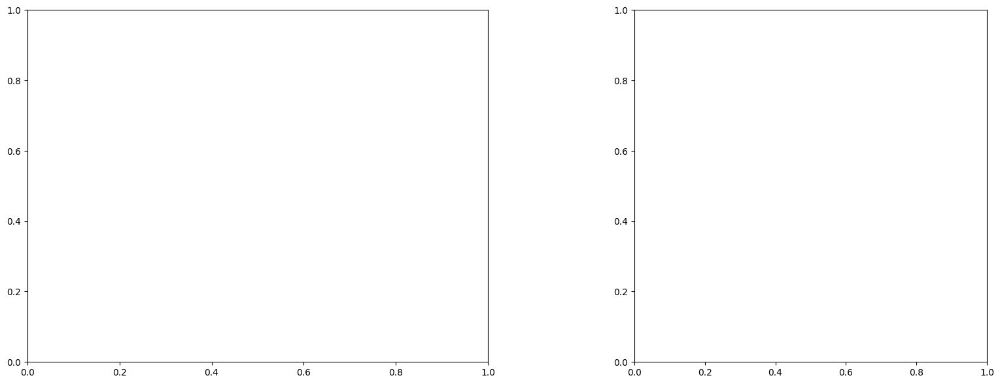

U and V components of current : [-0.05962781 -0.53483739]
uncertainties for U and V: 0.05437533112156057 0.06556935056638516


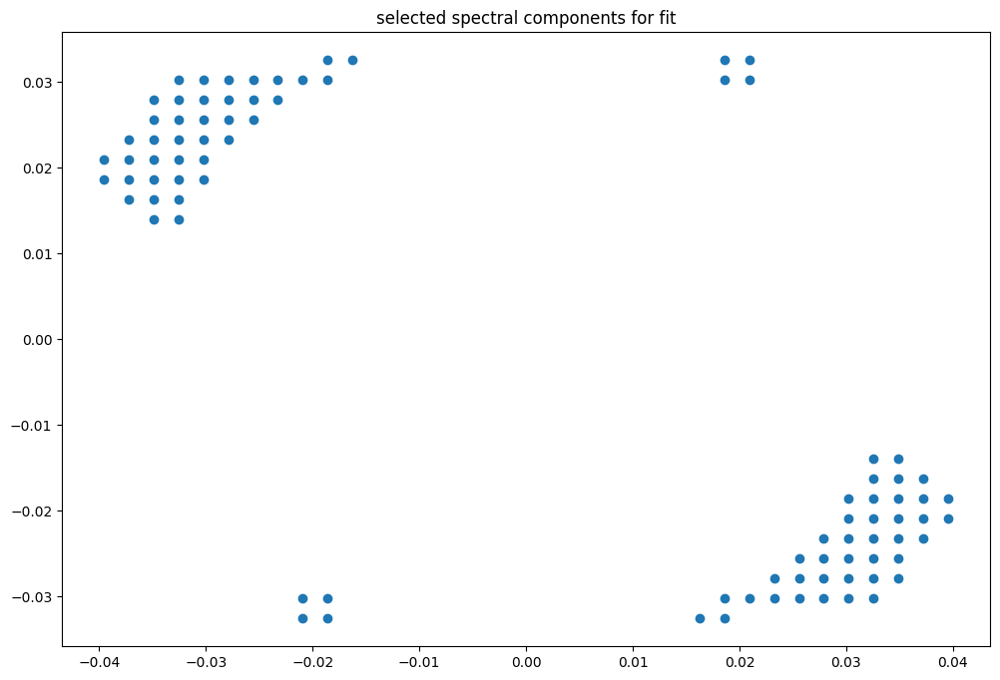

box [3000, 3700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

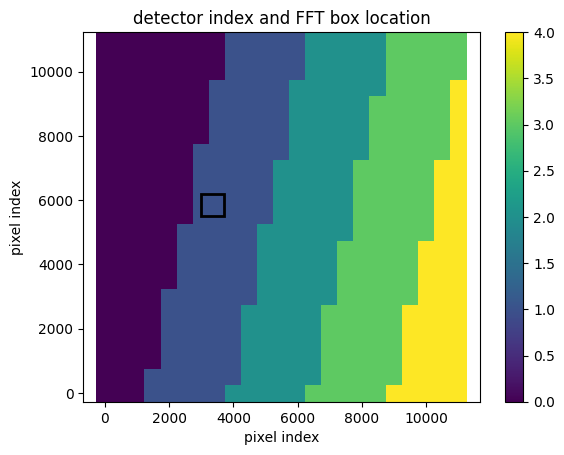

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


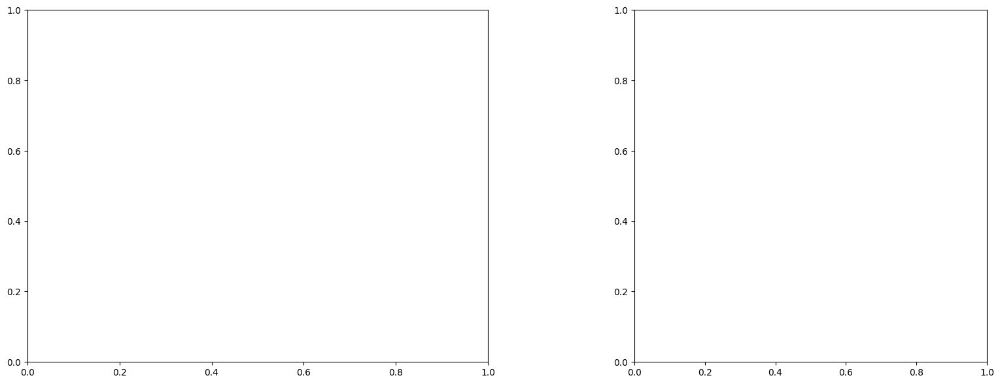

U and V components of current : [ 0.1243632  -0.44252355]
uncertainties for U and V: 0.054794798910977854 0.06256874636373931


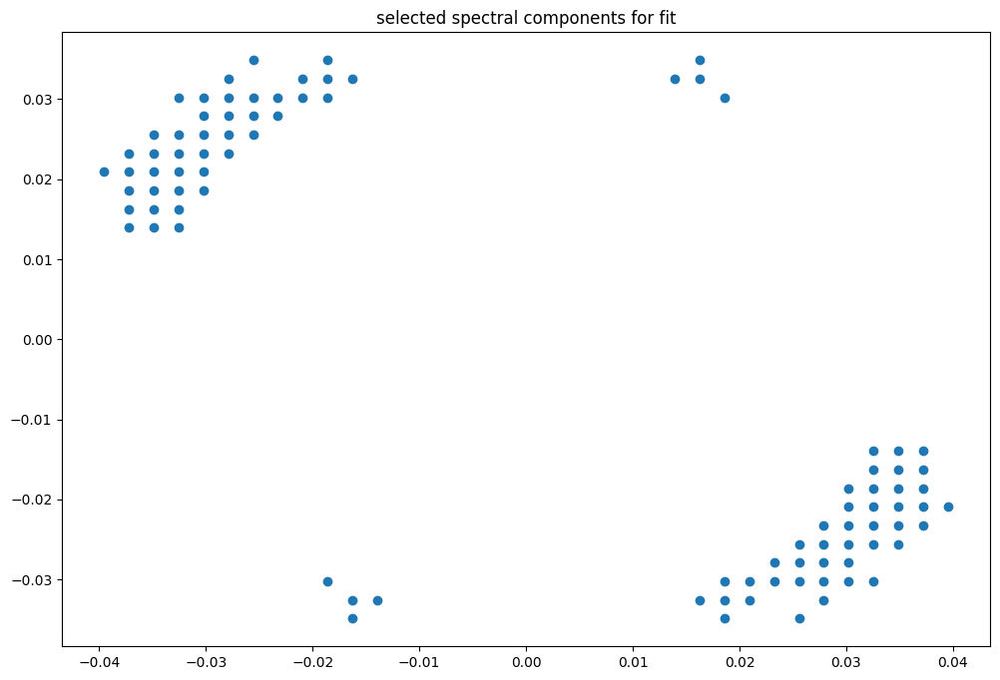

box [3000, 3700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

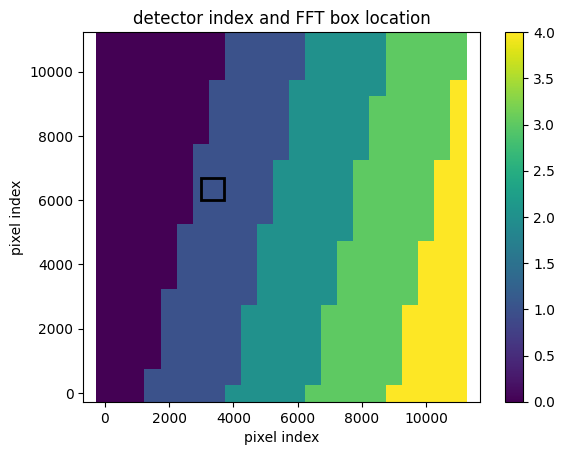

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


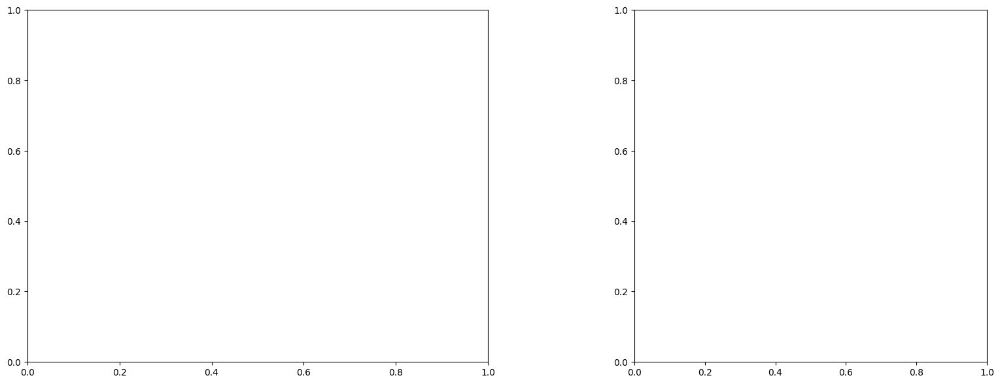

U and V components of current : [-0.04627813 -0.82153319]
uncertainties for U and V: 0.0533377217676646 0.058958372483658004


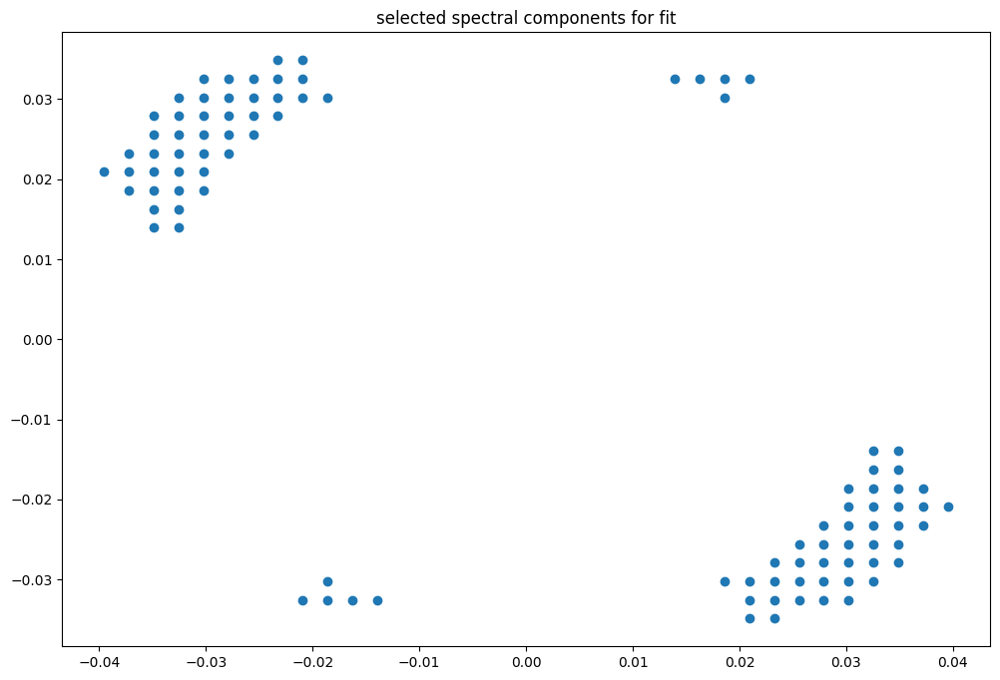

box [3000, 3700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

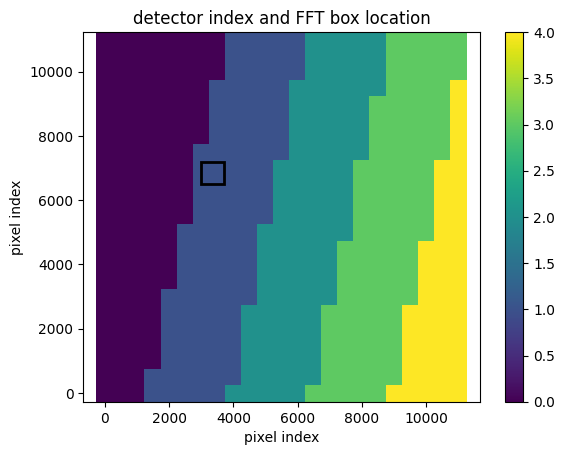

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


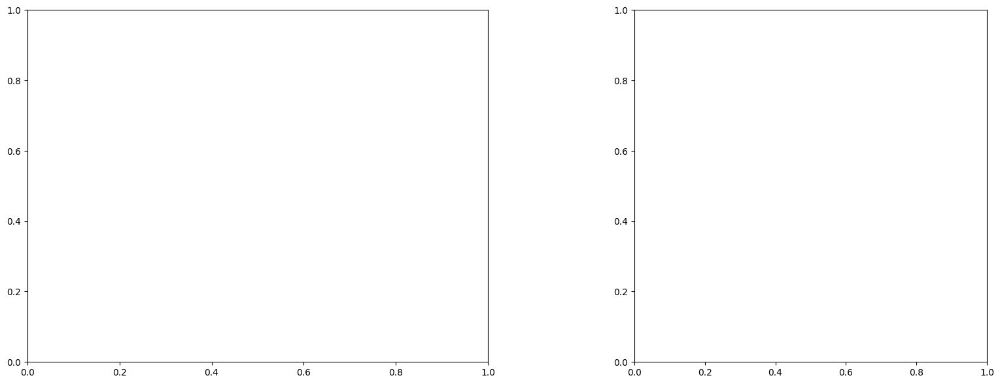

U and V components of current : [ 0.01006259 -0.85621634]
uncertainties for U and V: 0.07885940271582649 0.08499271485091947


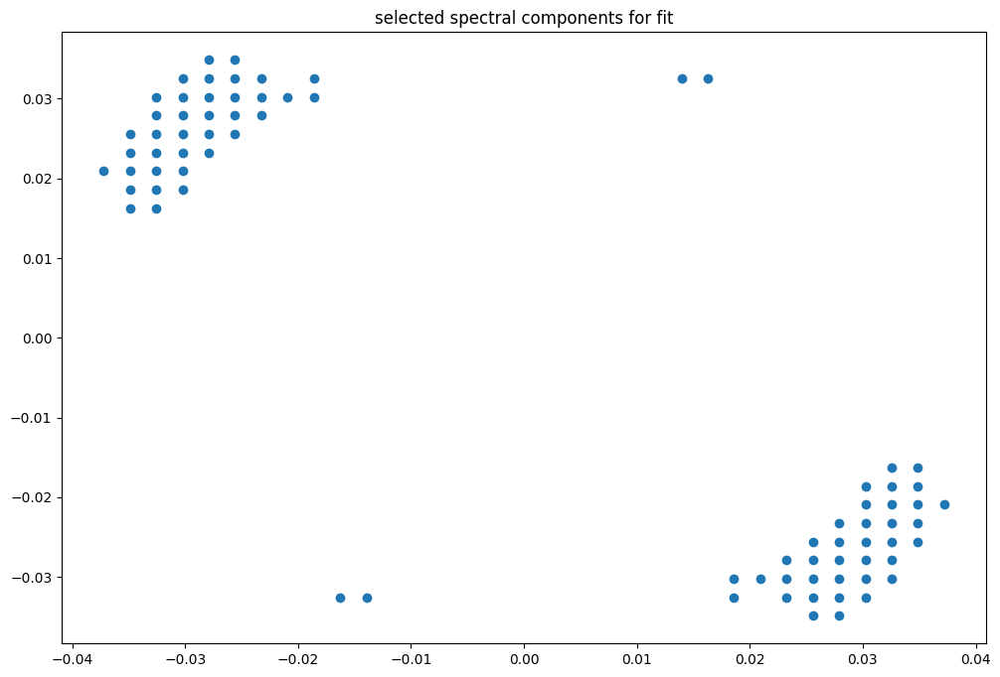

box [3000, 3700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

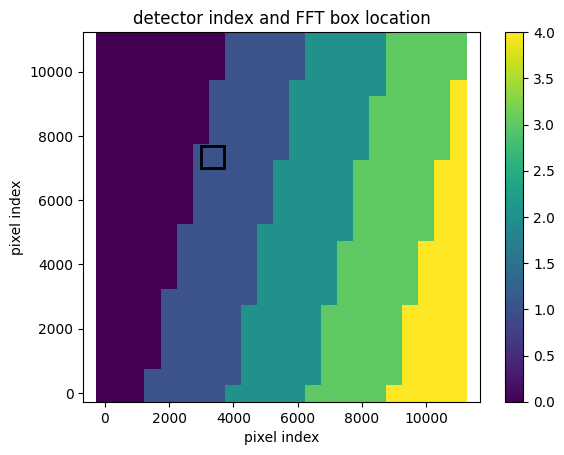

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


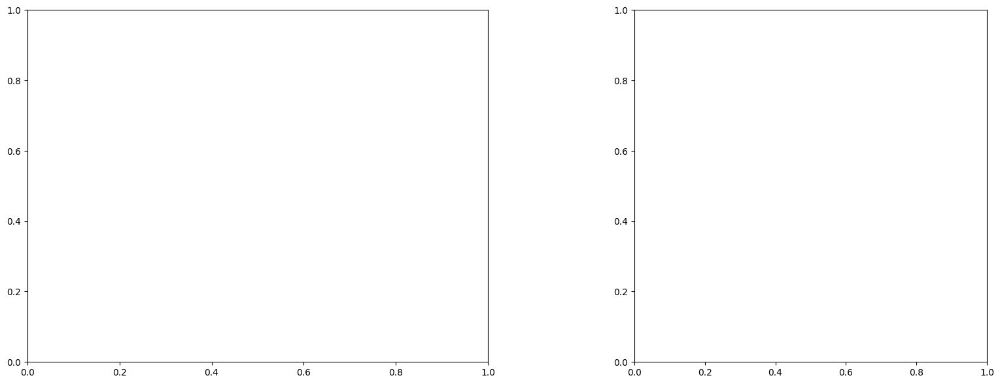

U and V components of current : [ 0.05698993 -0.39486024]
uncertainties for U and V: 0.10066135987747854 0.10364218462644446


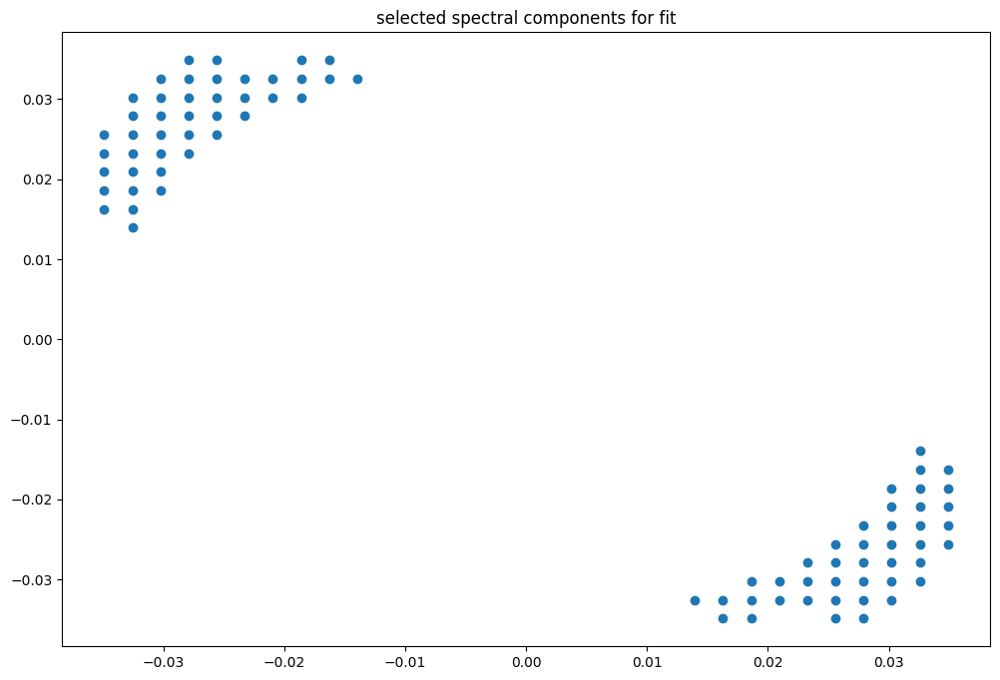

box [3000, 3700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

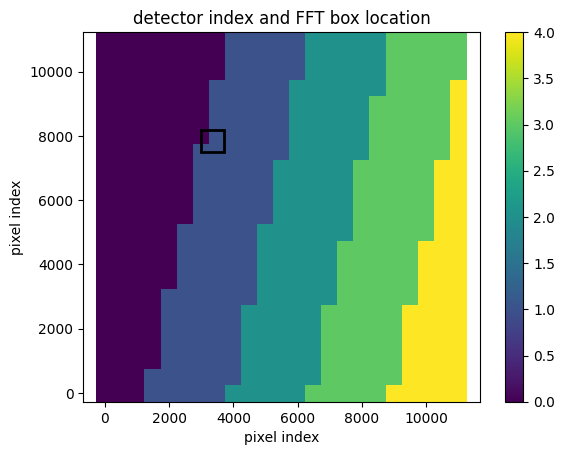

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.96
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


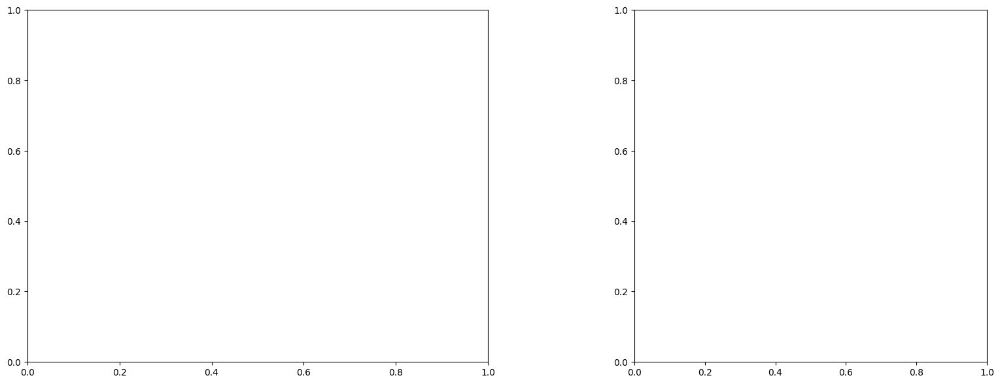

LinAlgError: Singular matrix

box [3000, 3700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

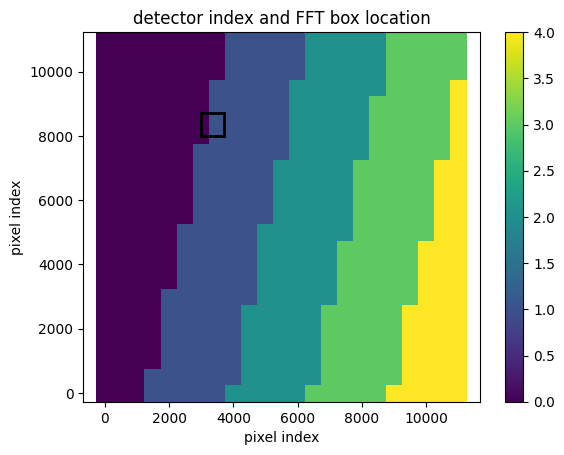

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


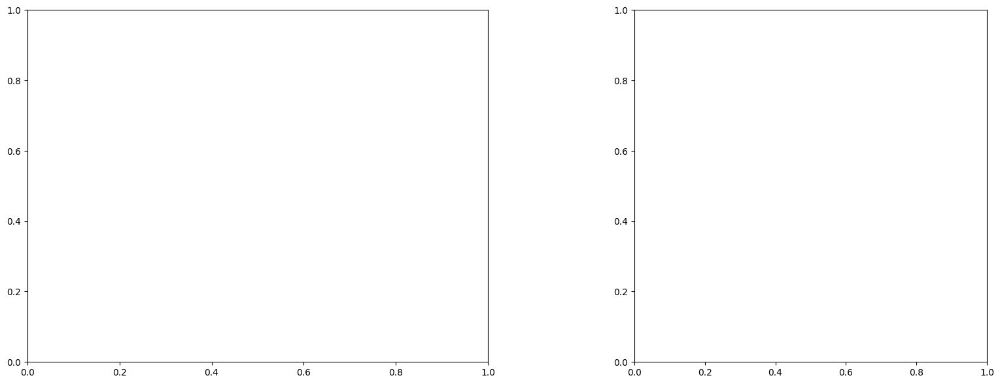

LinAlgError: Singular matrix

box [3000, 3700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

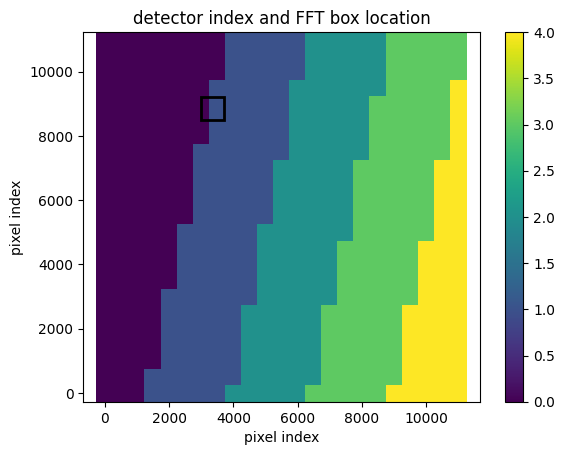

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


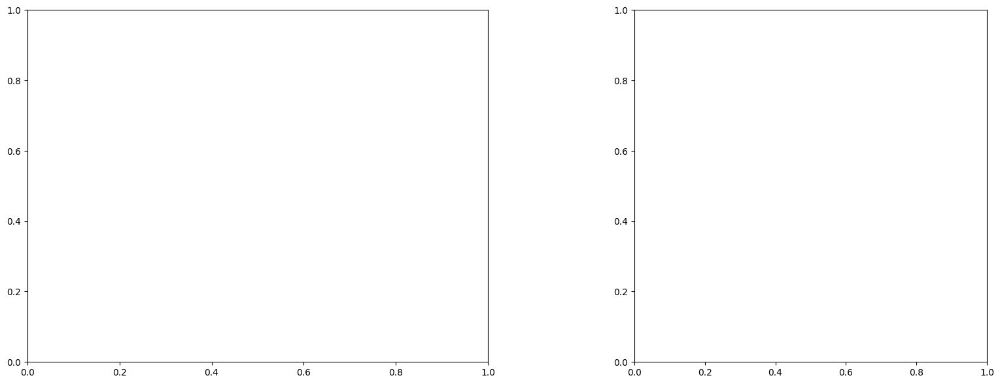

LinAlgError: Singular matrix

box [3000, 3700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

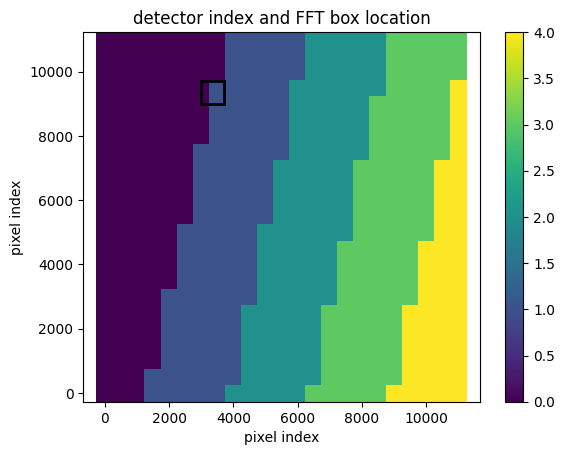

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


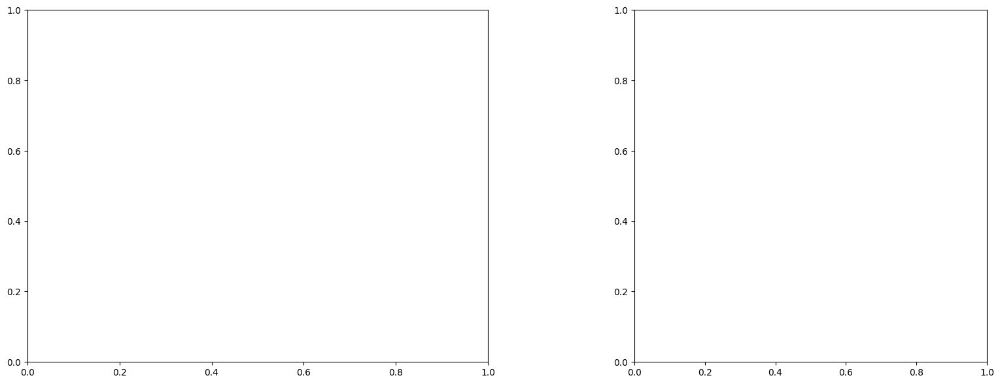

LinAlgError: Singular matrix

box [3000, 3700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

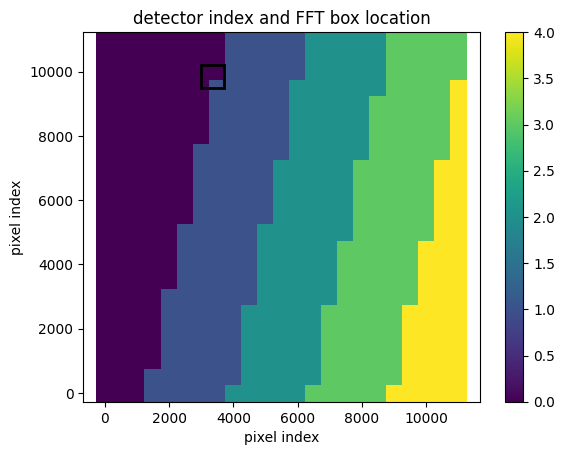

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.26
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


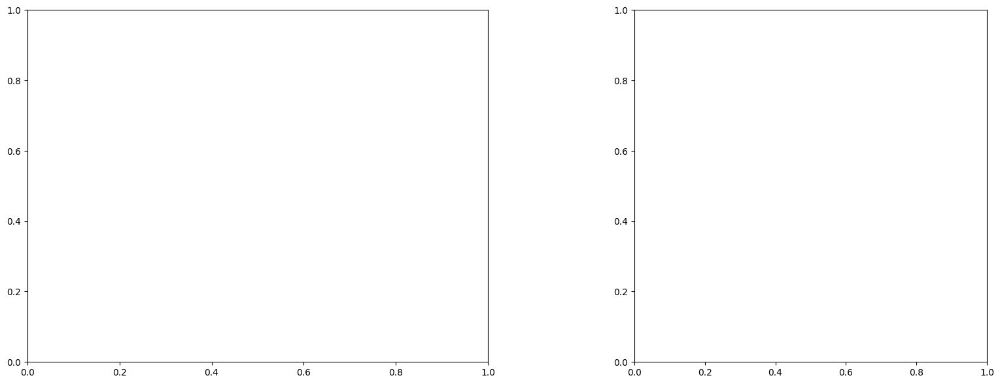

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [3000, 3700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

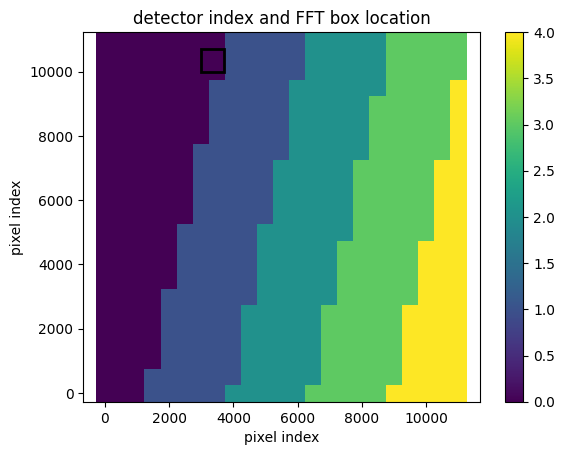

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 43)
(43, 43)
(43, 43)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


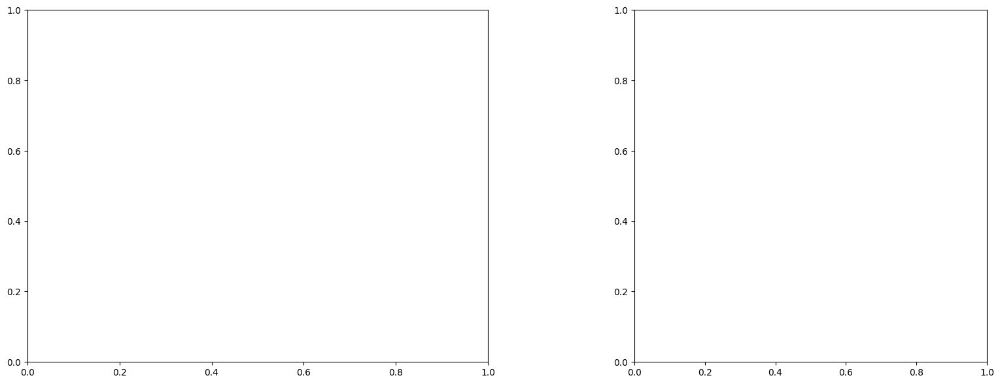

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [3000, 3700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

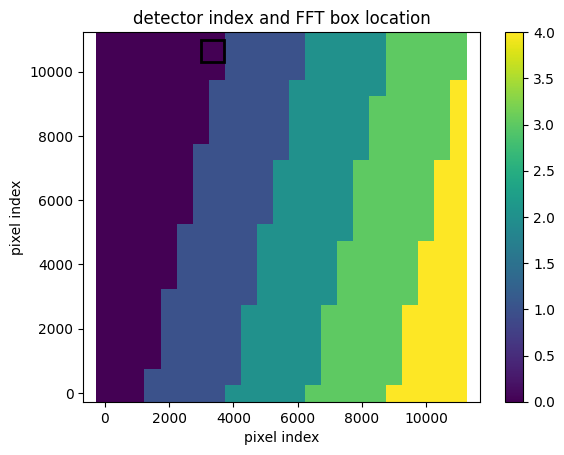

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.0
Valeur non trouvée
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst
(43, 42)
(43, 42)
(43, 42)


/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: divide by zero encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:2: RuntimeWarning: invalid value encountered in divide
  img1=imgs[0,:,:]/np.median(imgs[0,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: divide by zero encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())
/tmp/ipykernel_11584/474725974.py:3: RuntimeWarning: invalid value encountered in divide
  img2=imgs[3,:,:]/np.median(imgs[3,:,:].flatten())


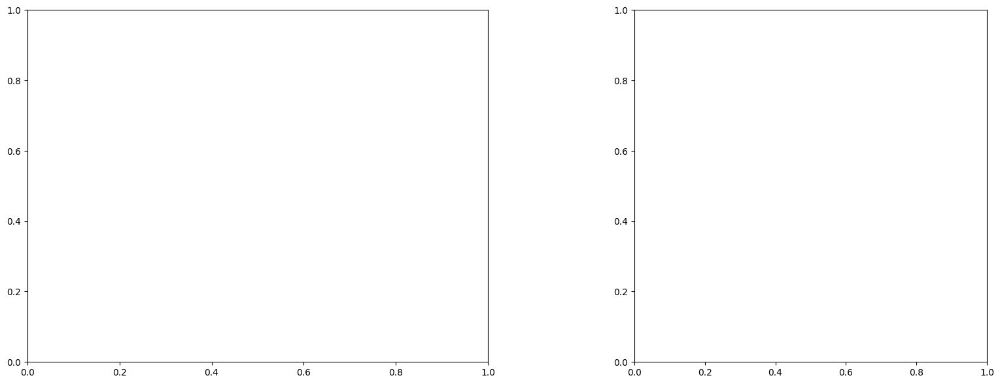

ValueError: could not convert string to float: 'usage: main_computeDT.py [-h] -lon LONGITUDE -lat LATITUDE -src SRC_BAND -dst'

box [3500, 4200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

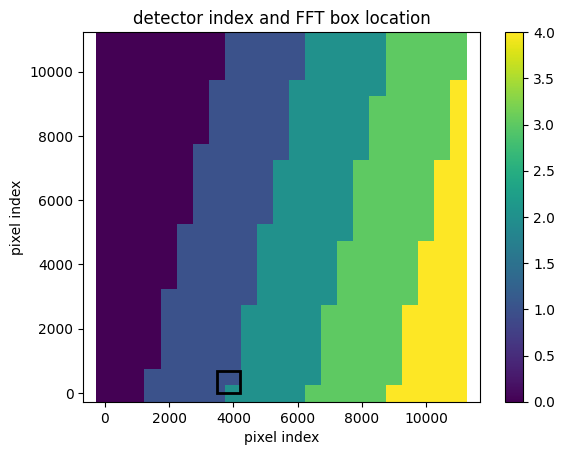

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.2600000000000002
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075988590156313
(43, 43)
(43, 43)
(43, 43)


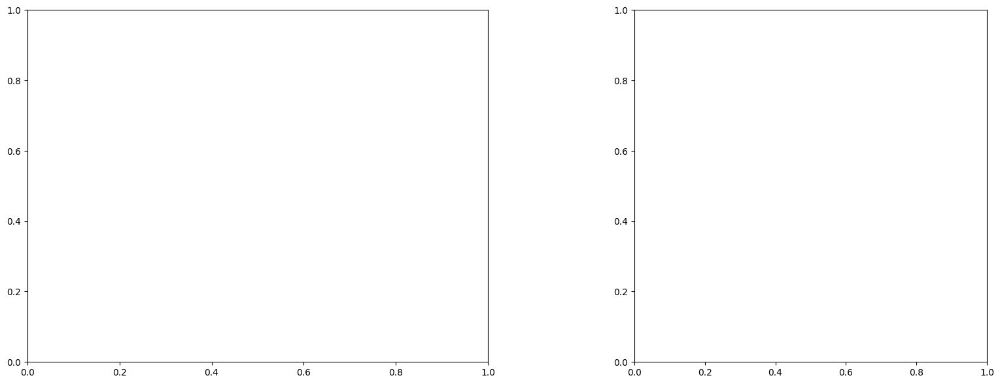

U and V components of current : [ 0.34641527 -0.69888448]
uncertainties for U and V: 0.13007872447468255 0.1390535399429226


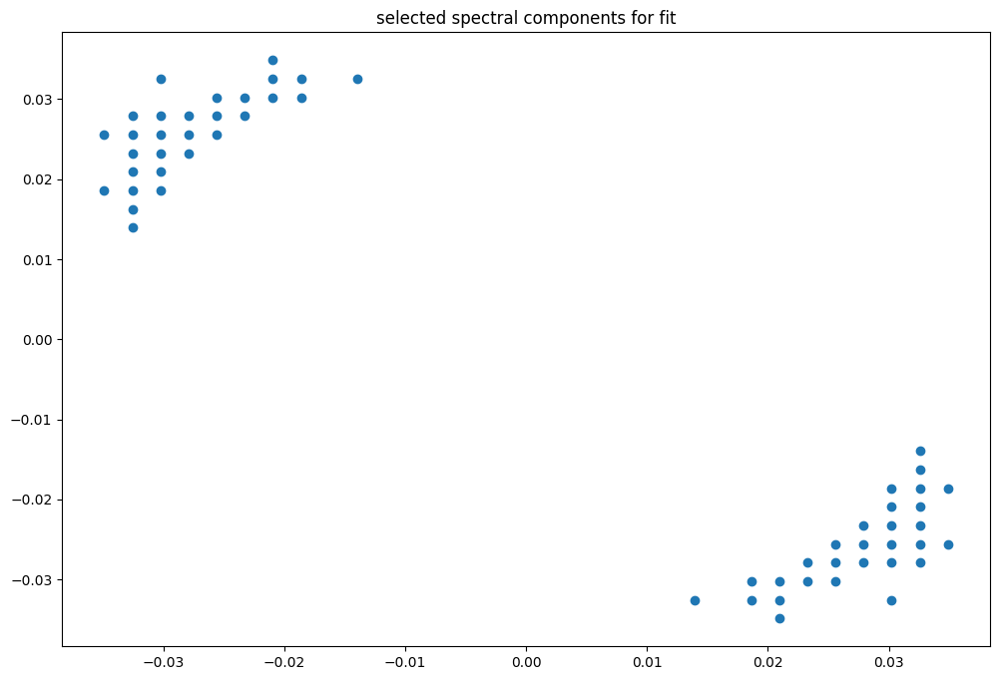

box [3500, 4200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

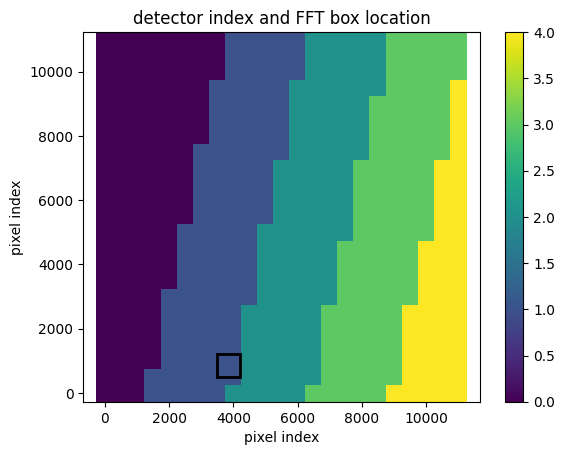

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


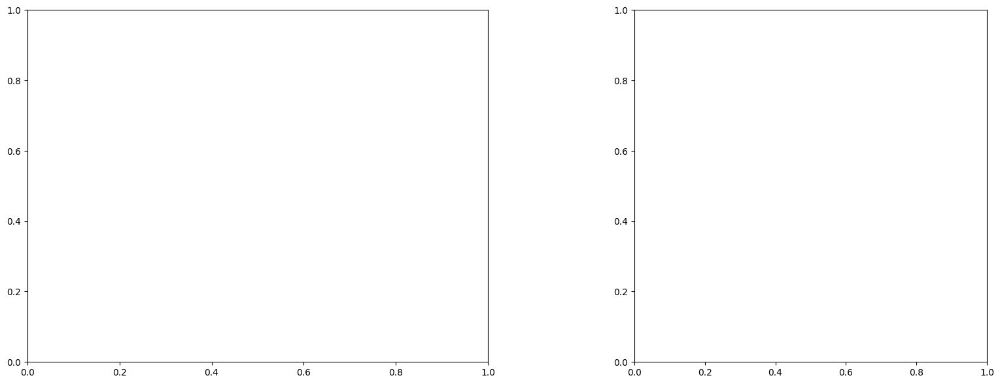

U and V components of current : [ 0.13516632 -1.02188693]
uncertainties for U and V: 0.07219825271014715 0.07667546744409036


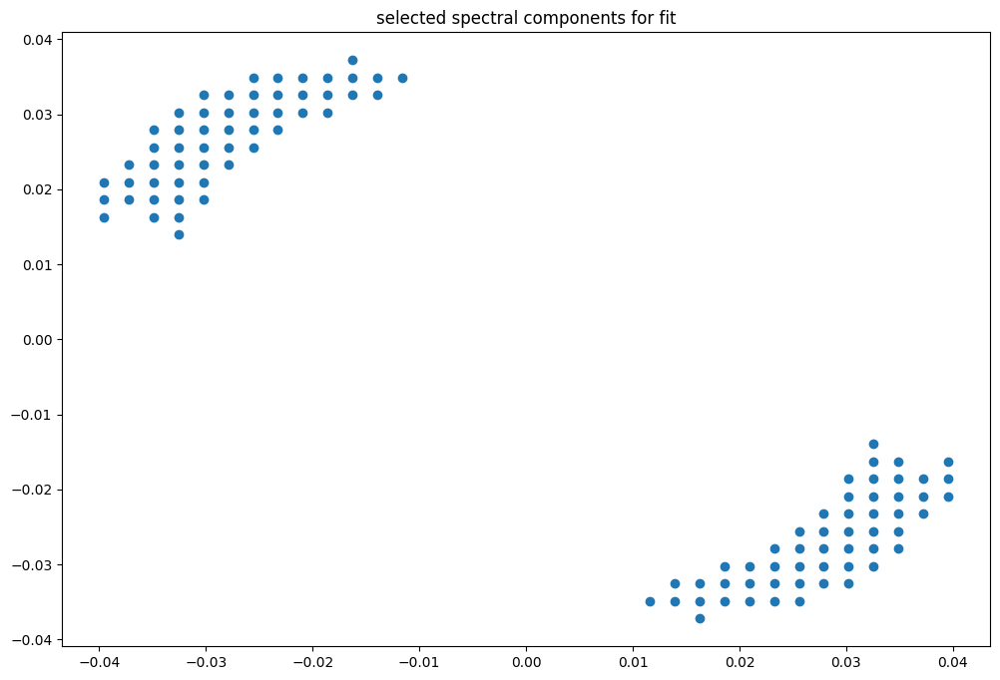

box [3500, 4200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

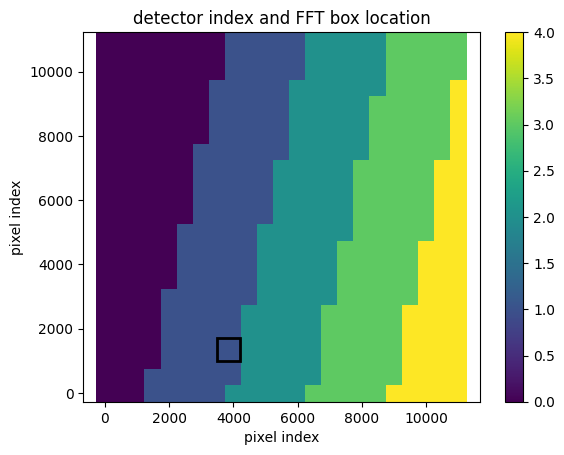

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.00759595927867
(43, 43)
(43, 43)
(43, 43)


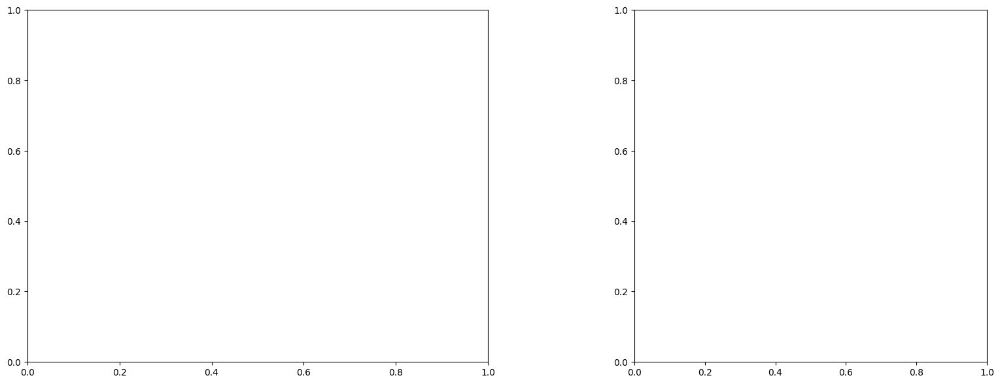

U and V components of current : [ 0.45838228 -0.80441878]
uncertainties for U and V: 0.08338608342678874 0.08611936804327304


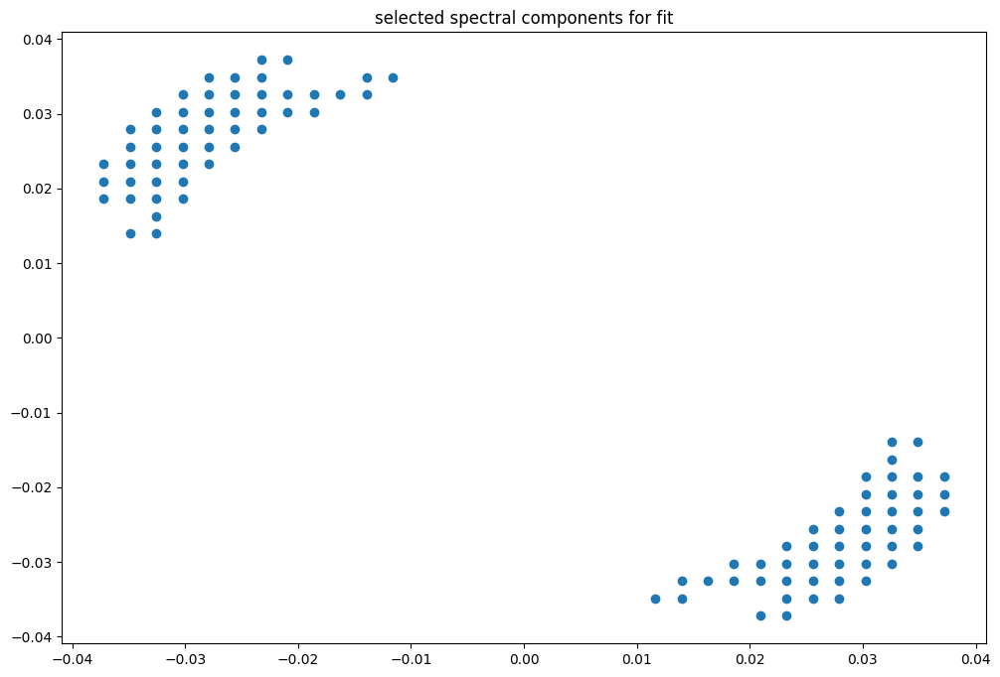

box [3500, 4200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

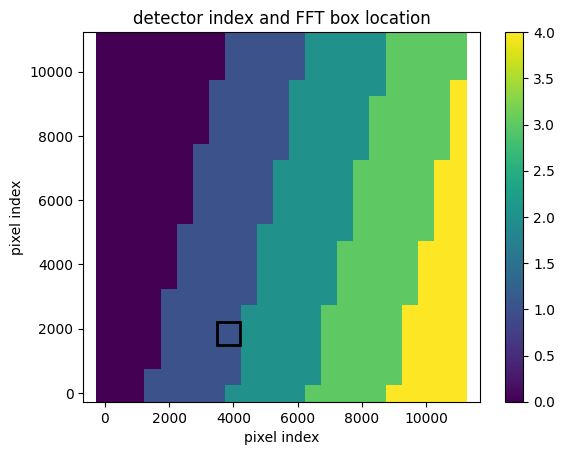

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007593329038979
(43, 43)
(43, 43)
(43, 43)


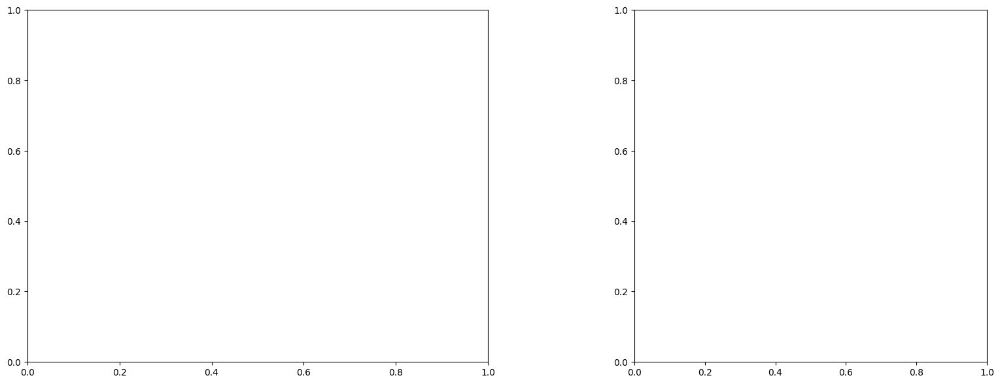

U and V components of current : [ 0.29350417 -0.75300494]
uncertainties for U and V: 0.08621524036701891 0.08731912024046072


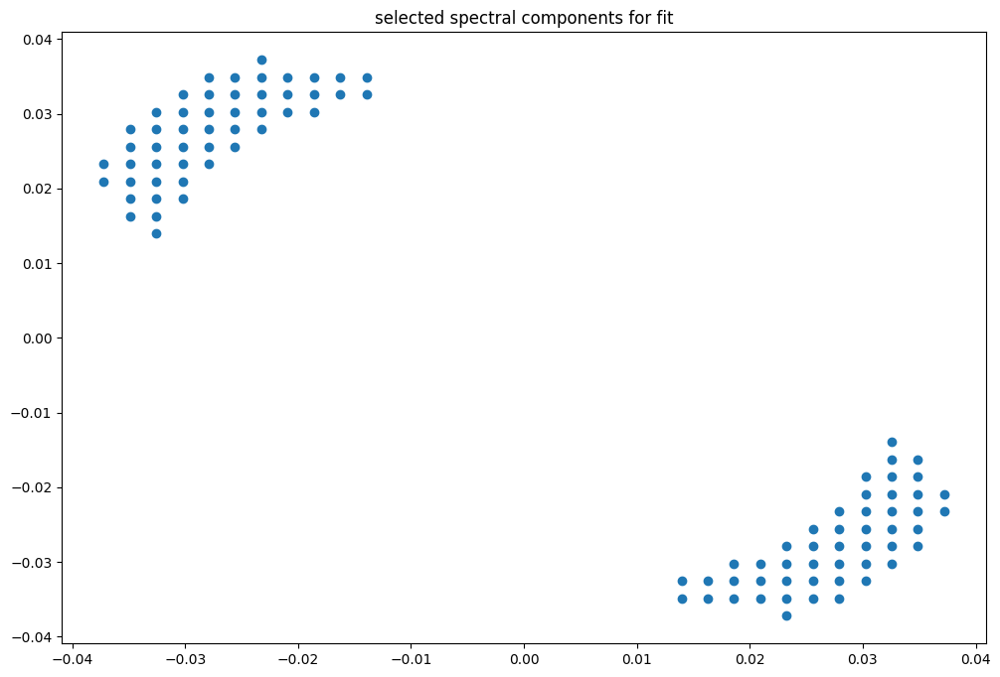

box [3500, 4200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

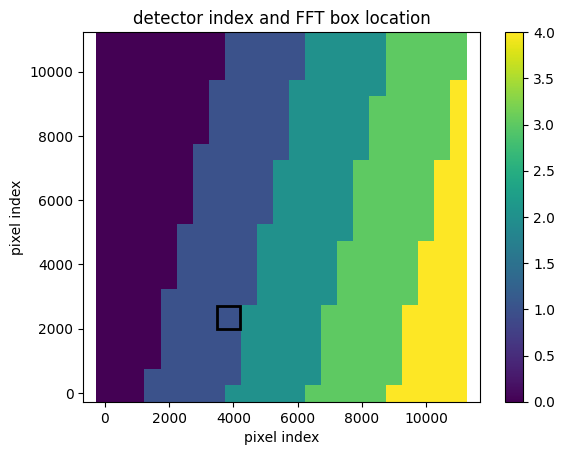

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075905646891494
(43, 43)
(43, 43)
(43, 43)


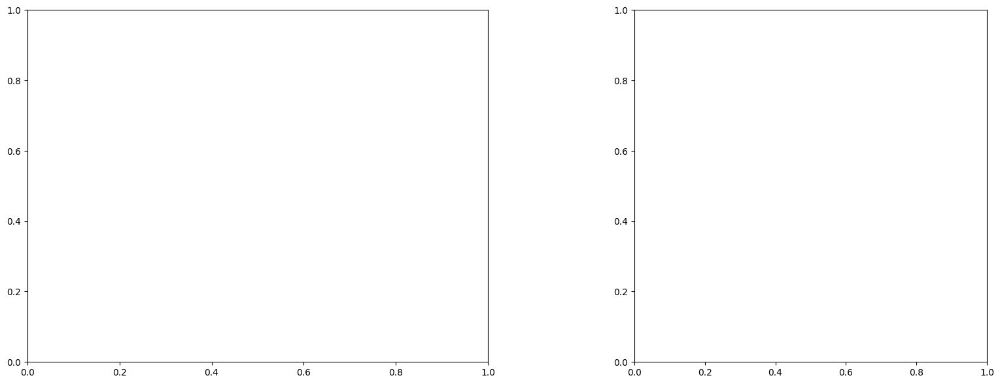

U and V components of current : [ 0.29638049 -0.58675624]
uncertainties for U and V: 0.07121866434300152 0.08235584412618421


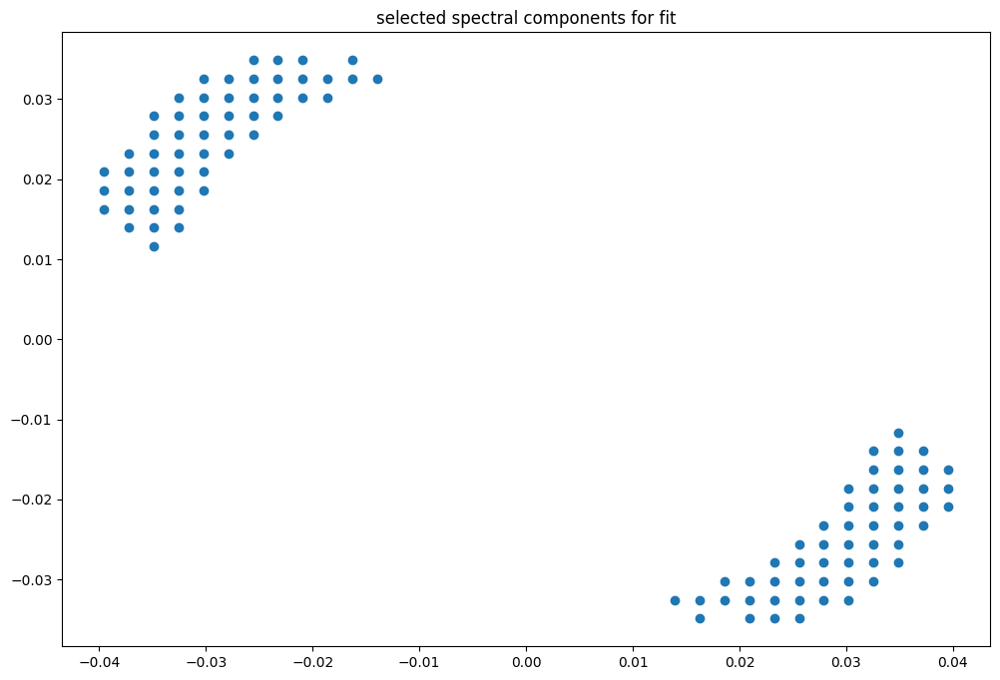

box [3500, 4200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

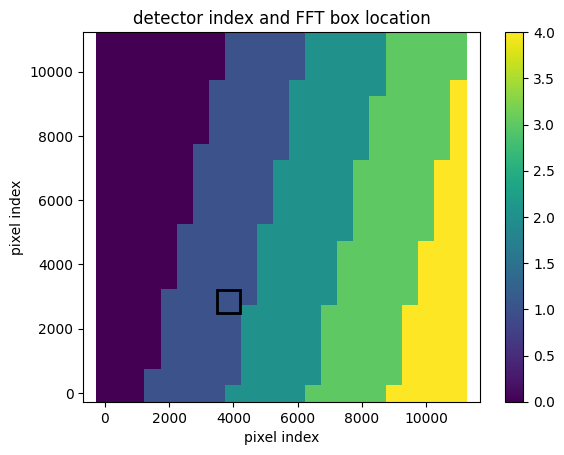

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


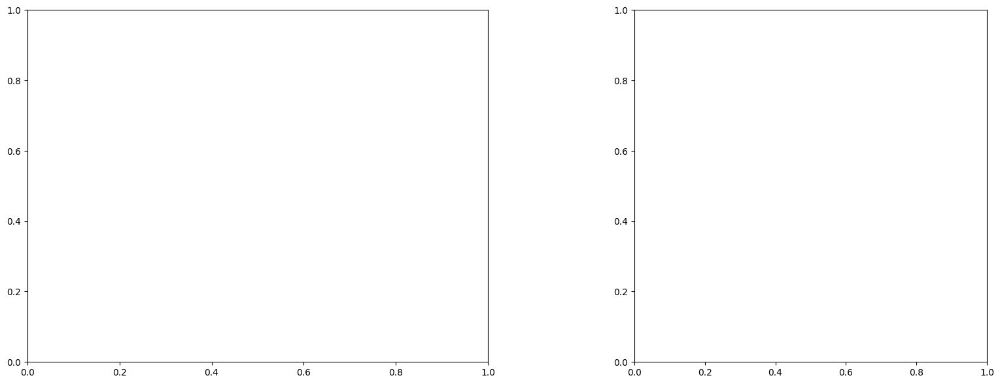

U and V components of current : [ 0.16769532 -0.84551388]
uncertainties for U and V: 0.06737024912686973 0.08162174488123168


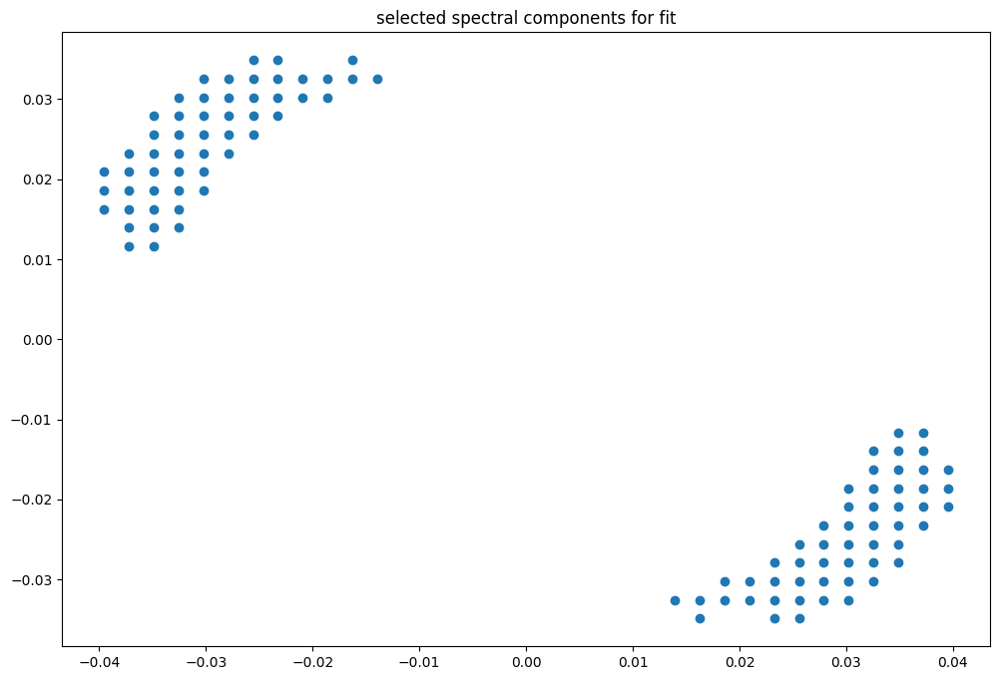

box [3500, 4200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

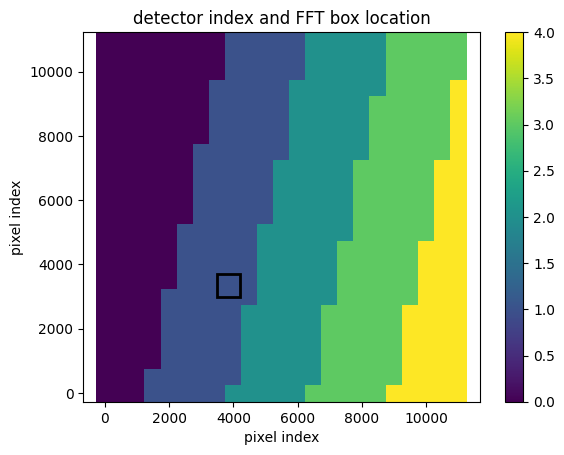

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


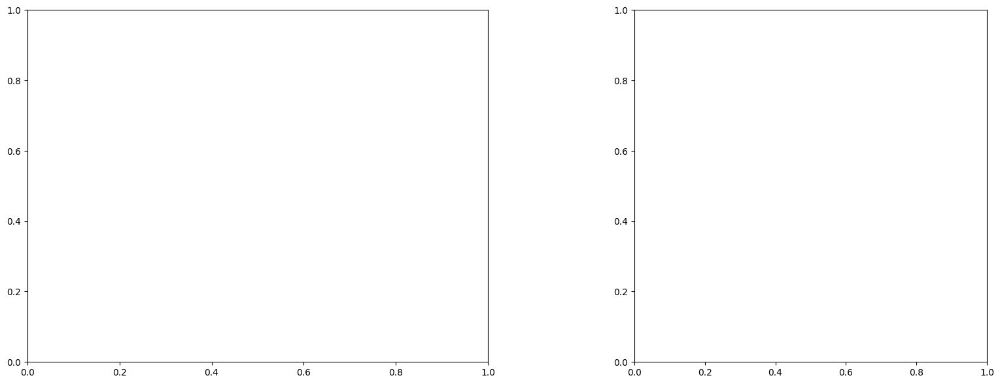

U and V components of current : [ 0.17785747 -0.76892305]
uncertainties for U and V: 0.08148515918383029 0.09991797407749943


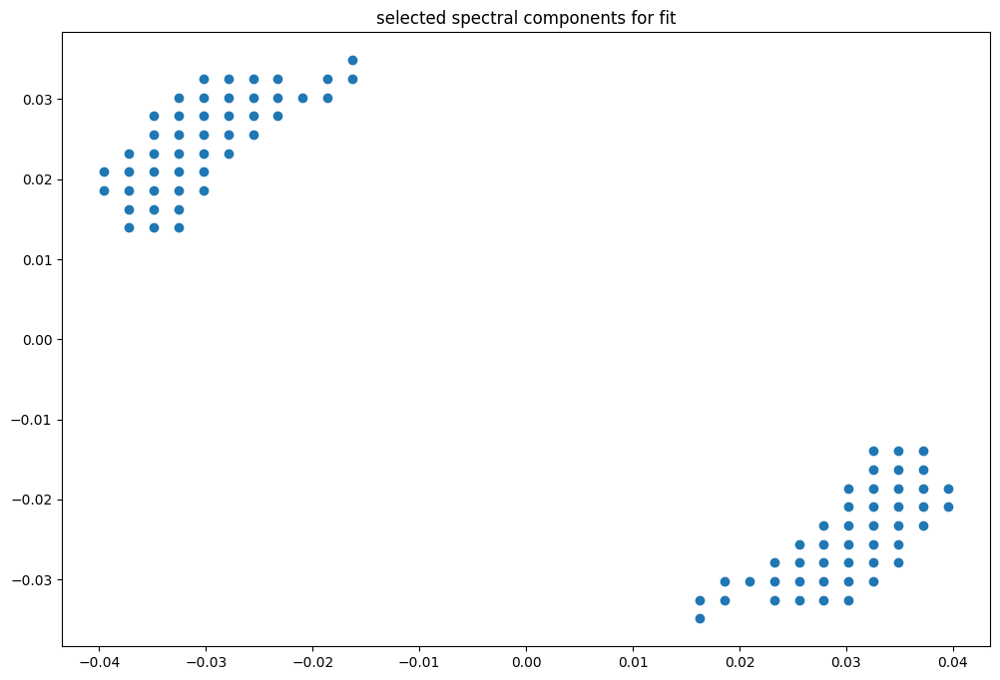

box [3500, 4200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

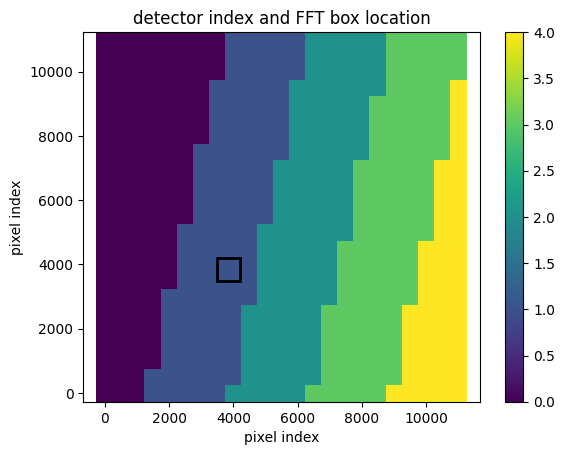

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


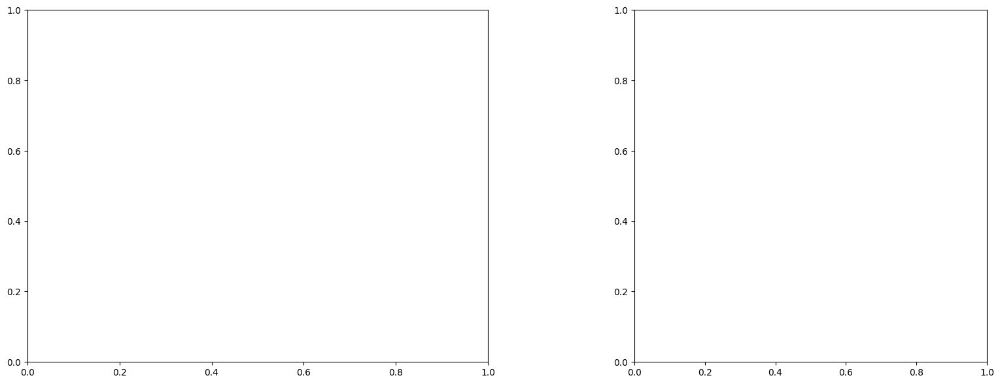

U and V components of current : [ 0.10217475 -0.89816393]
uncertainties for U and V: 0.08011058886329019 0.09710241013037738


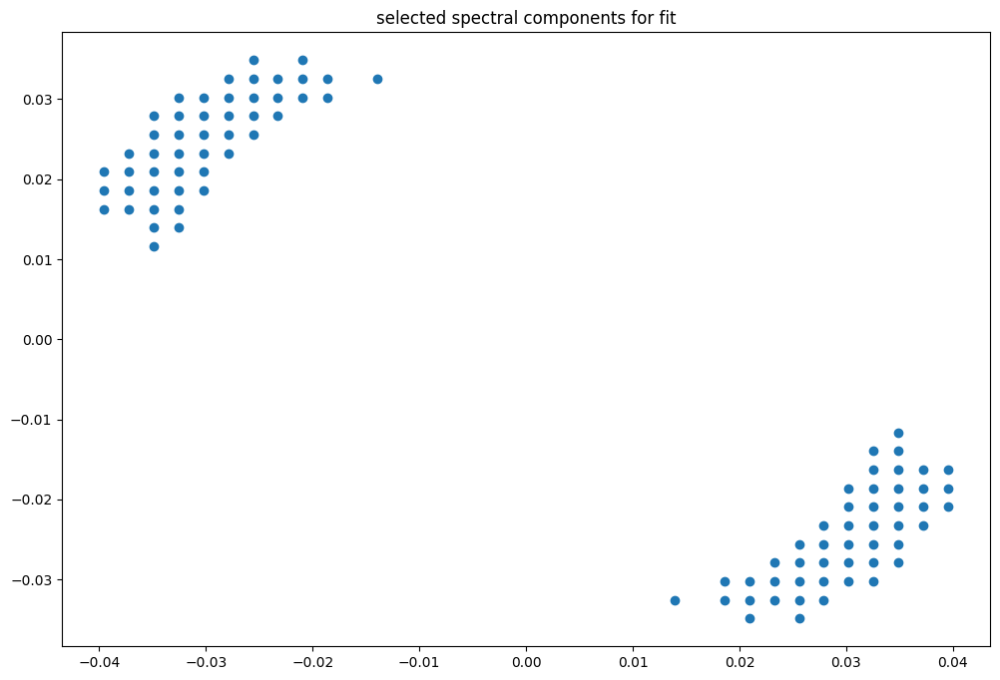

box [3500, 4200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

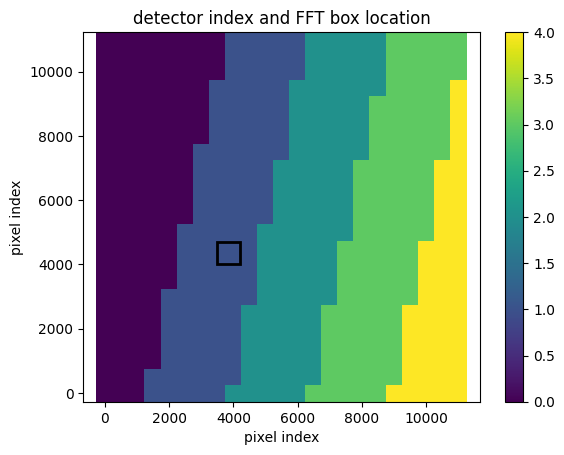

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


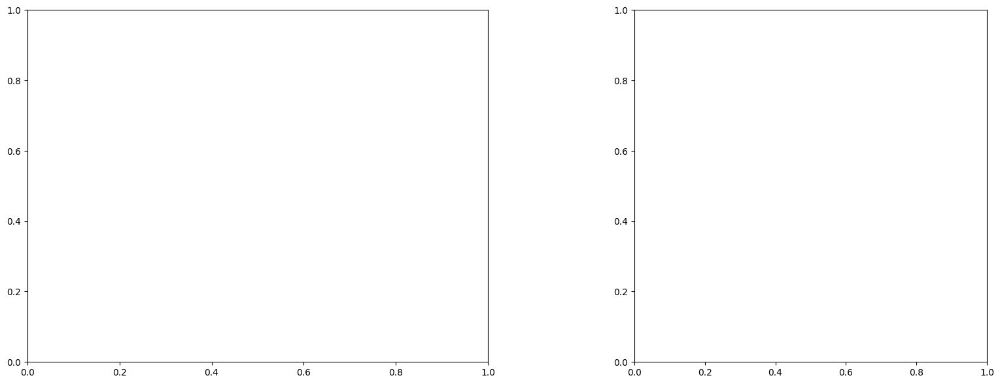

U and V components of current : [ 0.39267816 -0.64809657]
uncertainties for U and V: 0.08621176129065458 0.09986619701546125


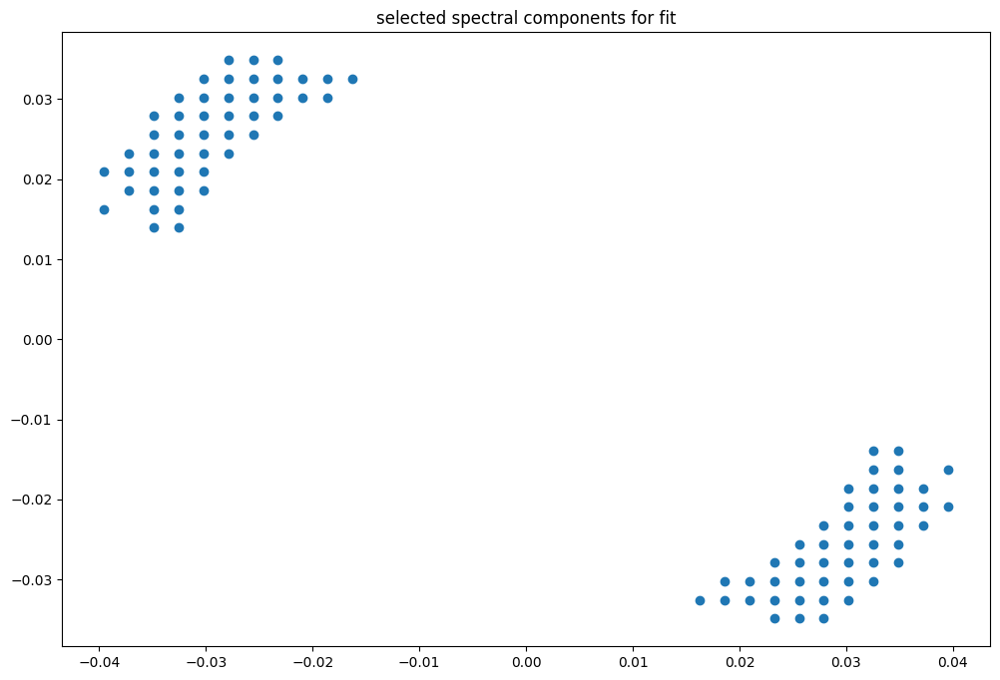

box [3500, 4200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

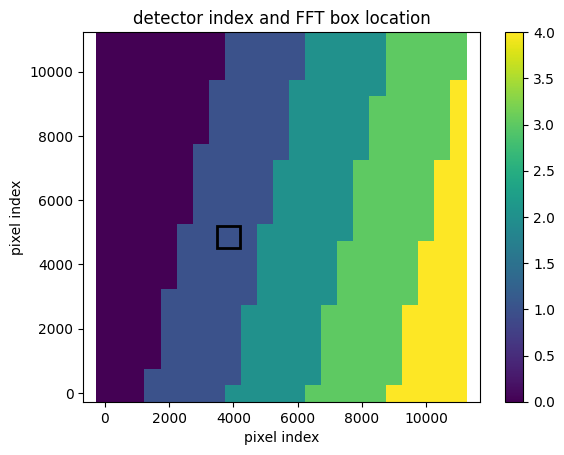

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


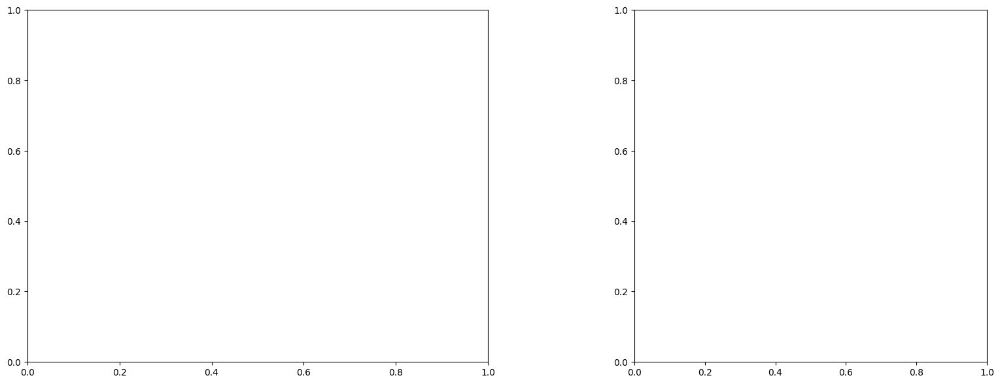

U and V components of current : [ 0.44026053 -0.66067234]
uncertainties for U and V: 0.08213667489020143 0.09054472323504464


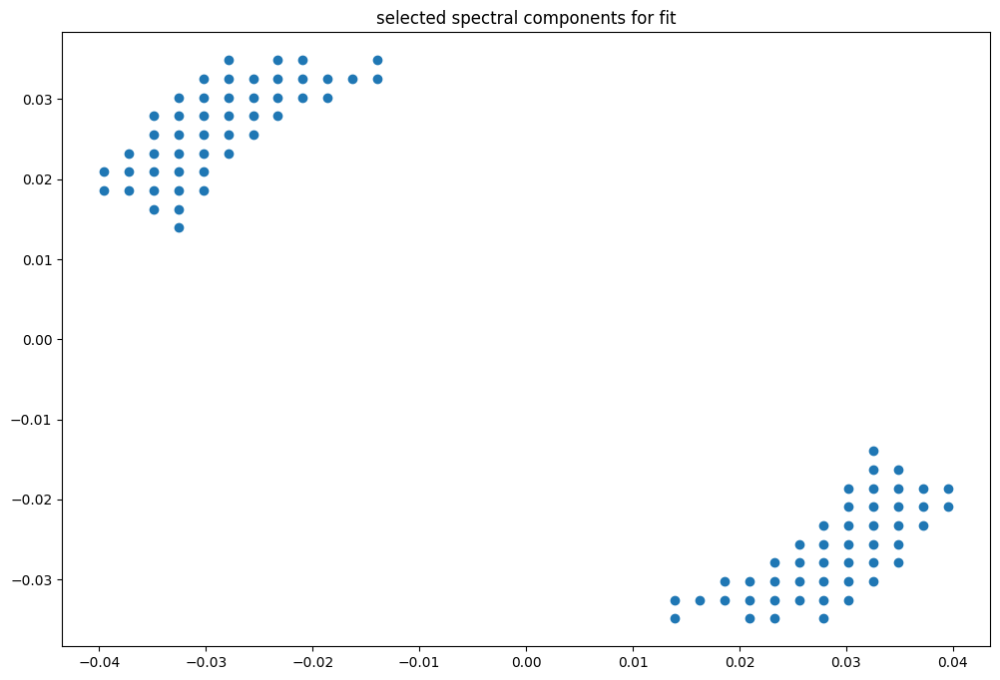

box [3500, 4200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

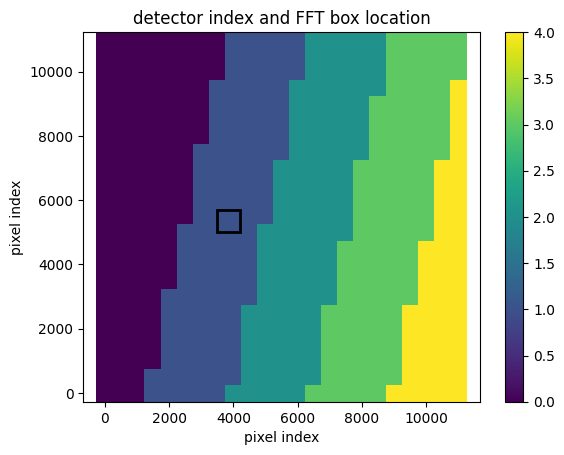

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


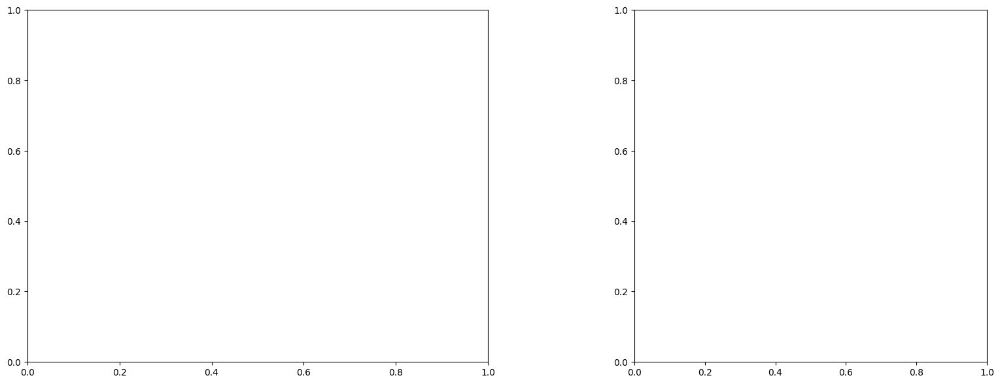

U and V components of current : [ 0.15496352 -0.55654248]
uncertainties for U and V: 0.060112696165784296 0.07204106212945553


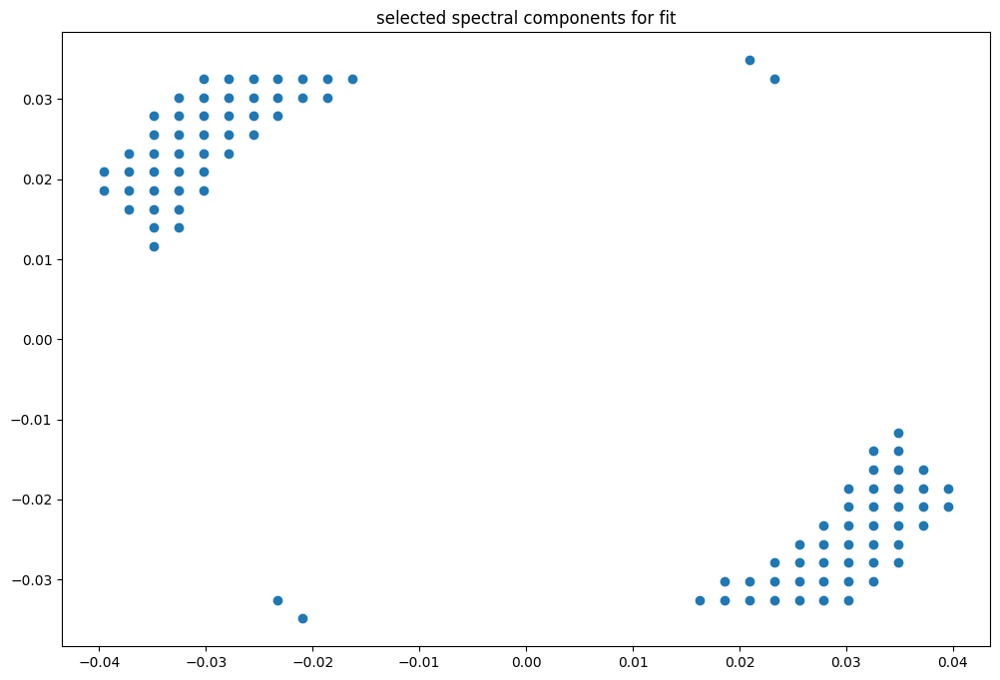

box [3500, 4200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

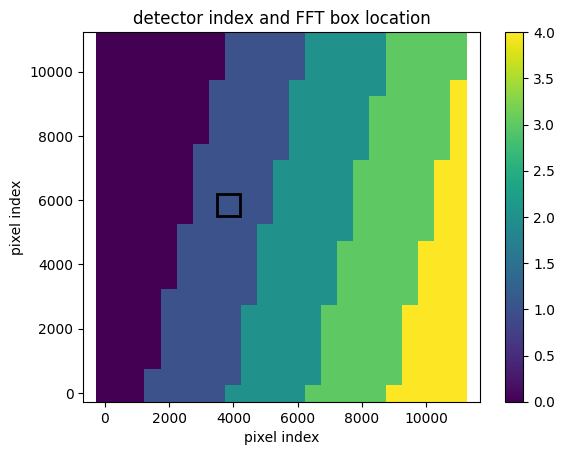

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


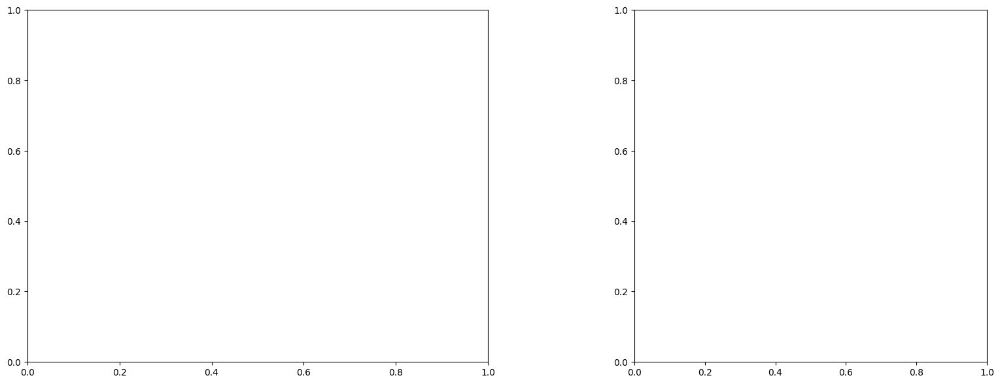

U and V components of current : [ 0.07831476 -0.59584982]
uncertainties for U and V: 0.0670198247580751 0.08487381486669136


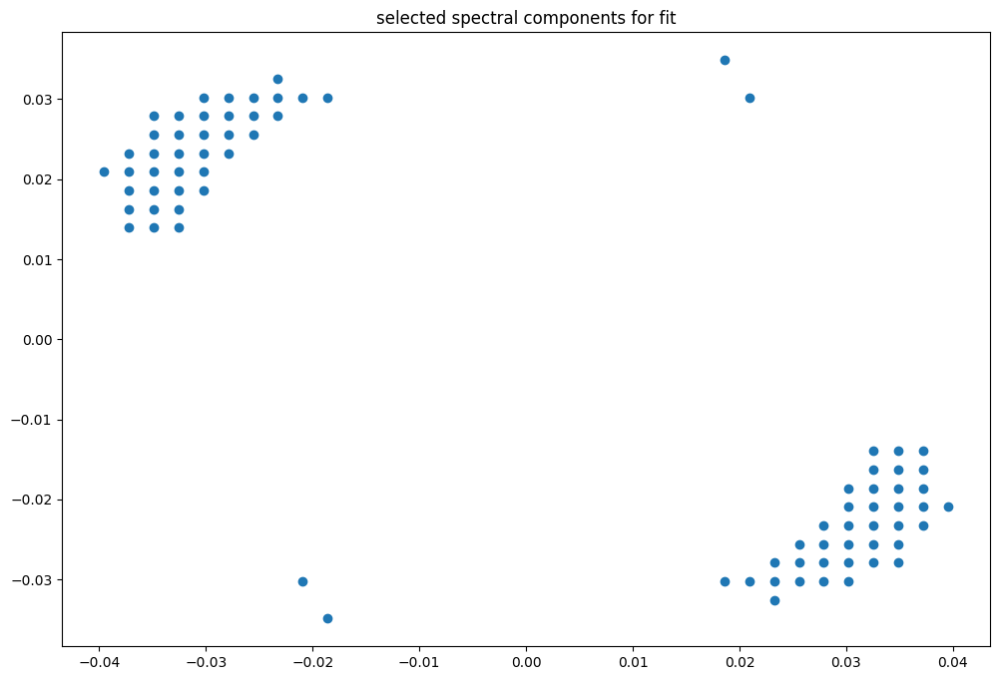

box [3500, 4200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

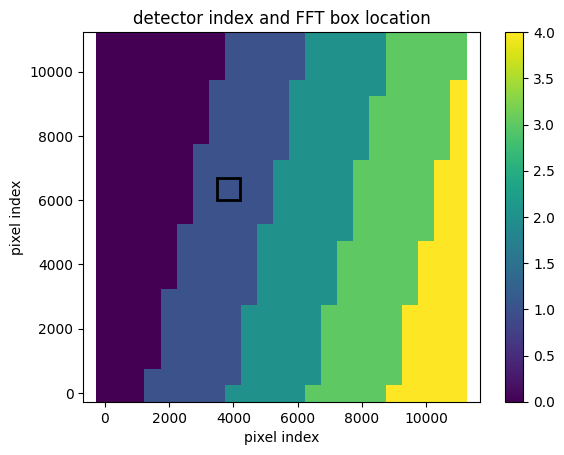

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


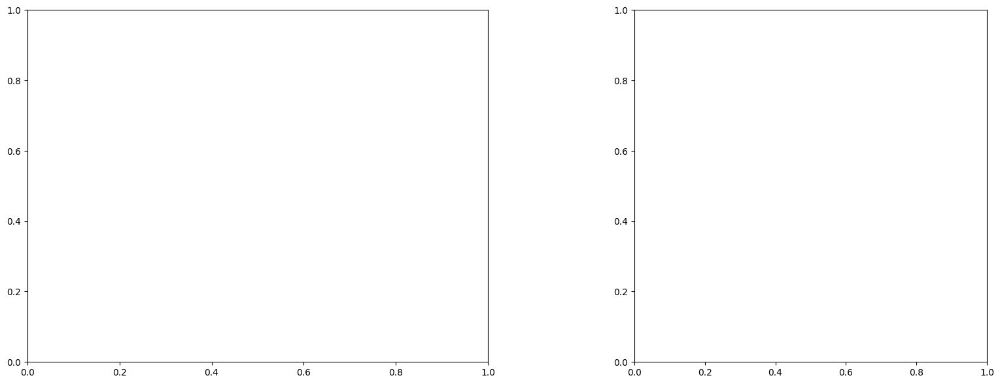

U and V components of current : [-0.09920588 -1.1114251 ]
uncertainties for U and V: 0.05746181652037704 0.06780579695619796


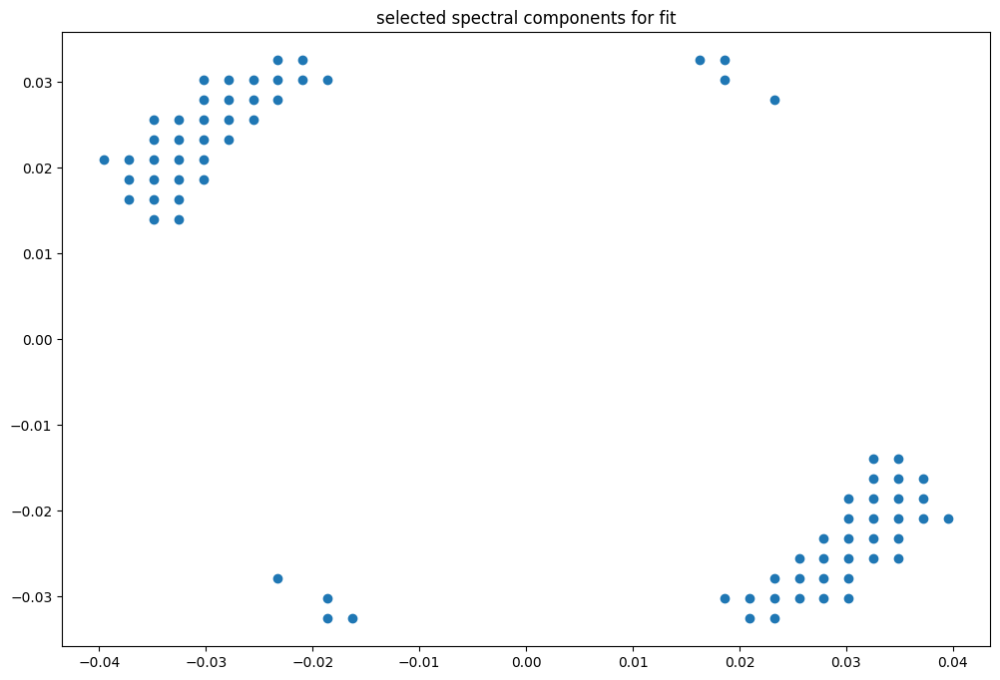

box [3500, 4200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

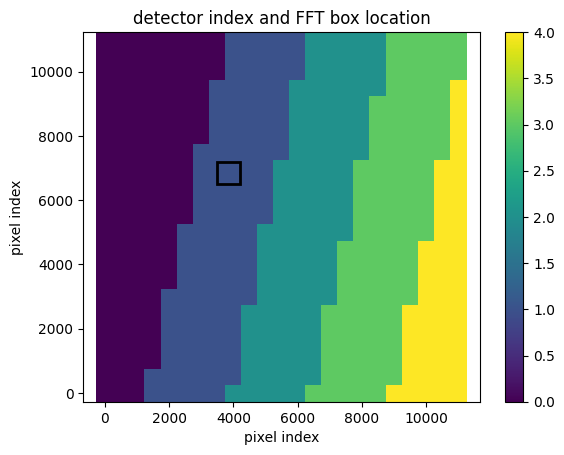

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


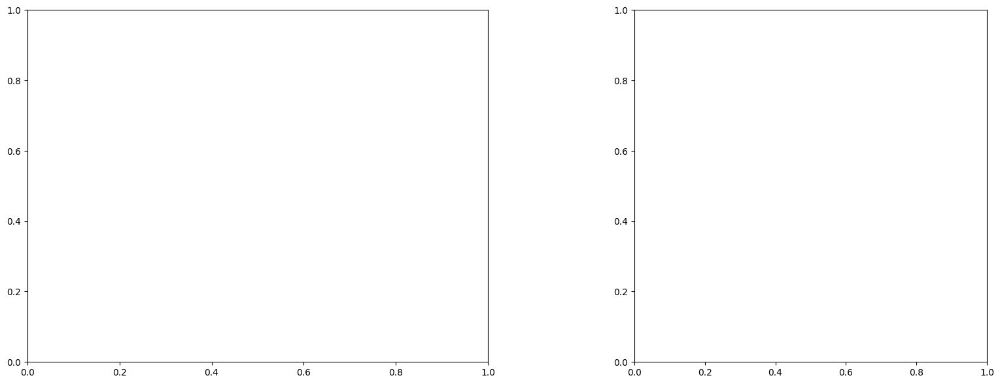

U and V components of current : [-0.01926212 -1.05624438]
uncertainties for U and V: 0.09464571184326885 0.11103340052887425


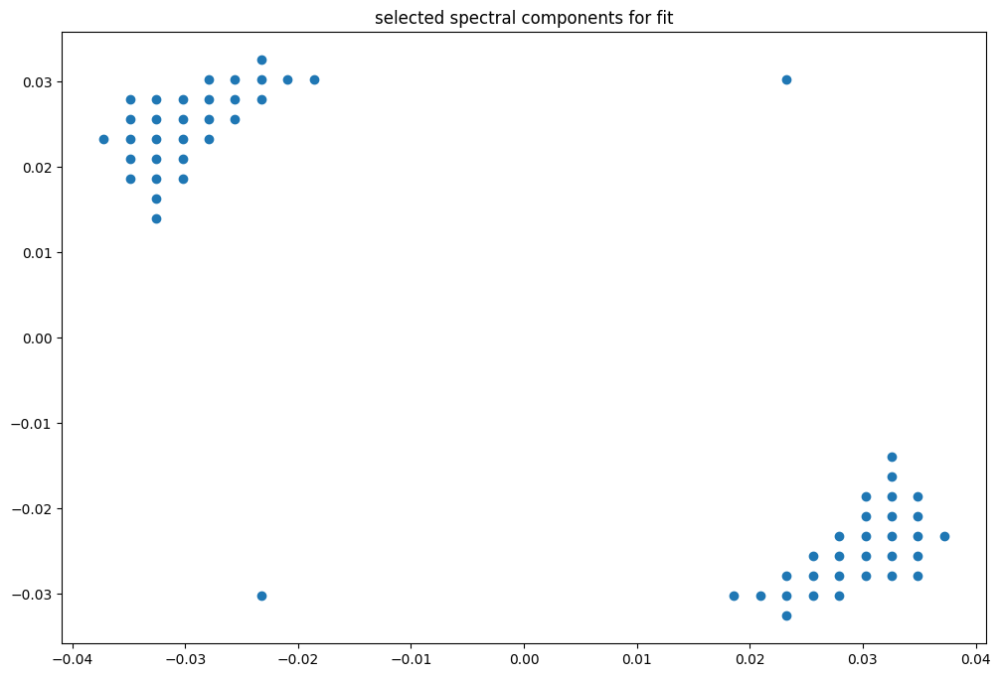

box [3500, 4200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

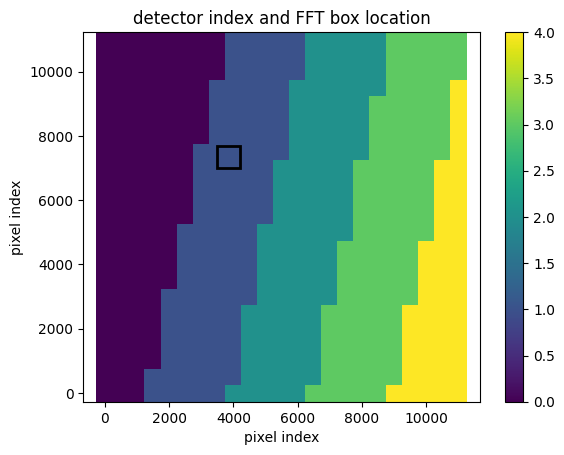

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


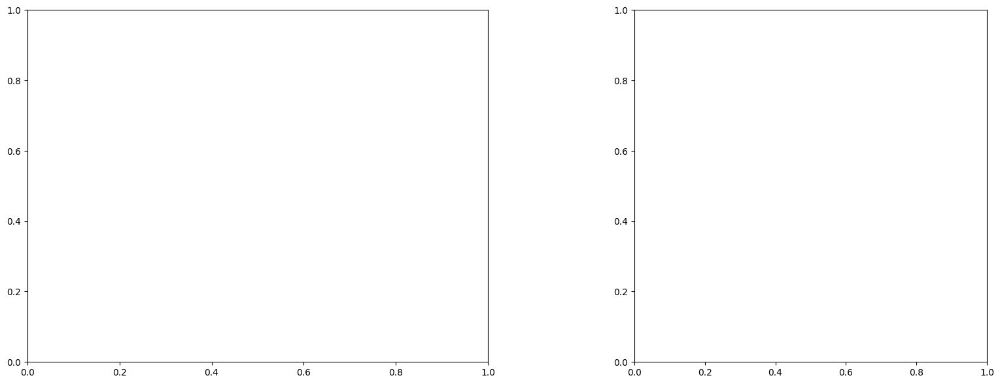

U and V components of current : [ 0.02167093 -1.04902233]
uncertainties for U and V: 0.09717410369988619 0.11161974657060365


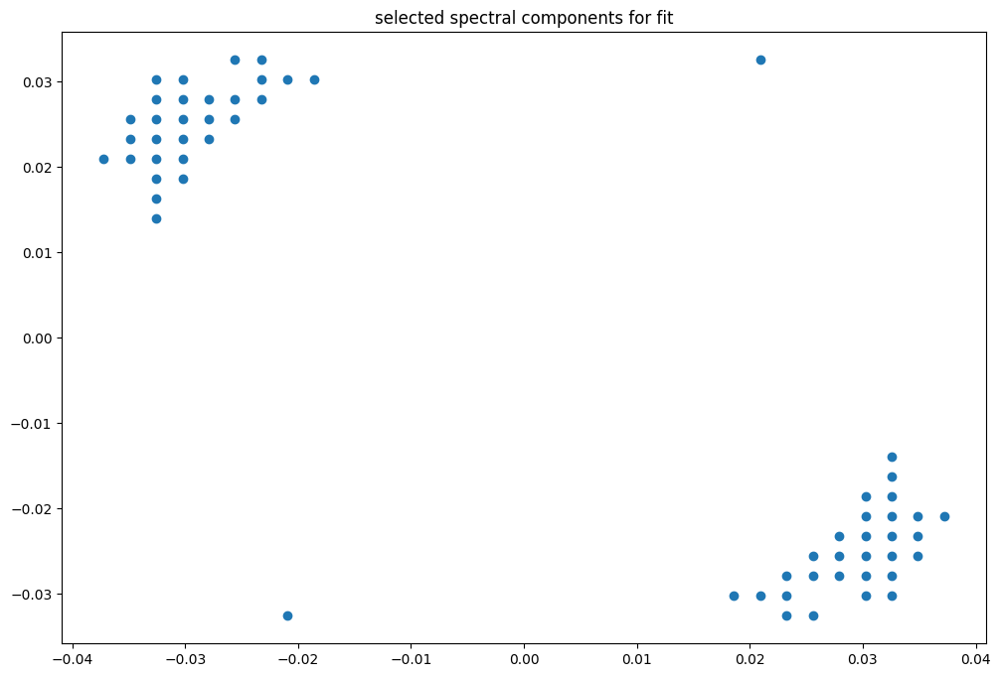

box [3500, 4200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

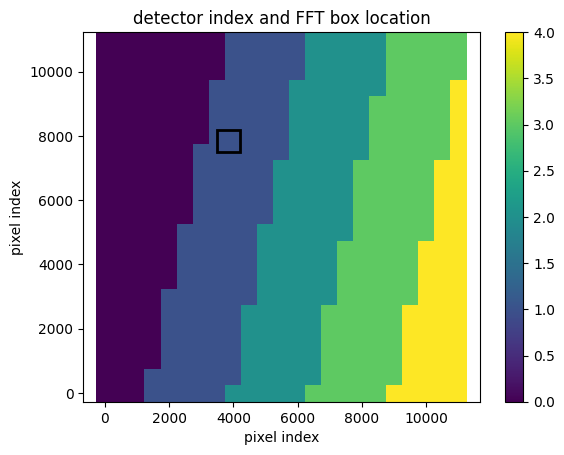

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


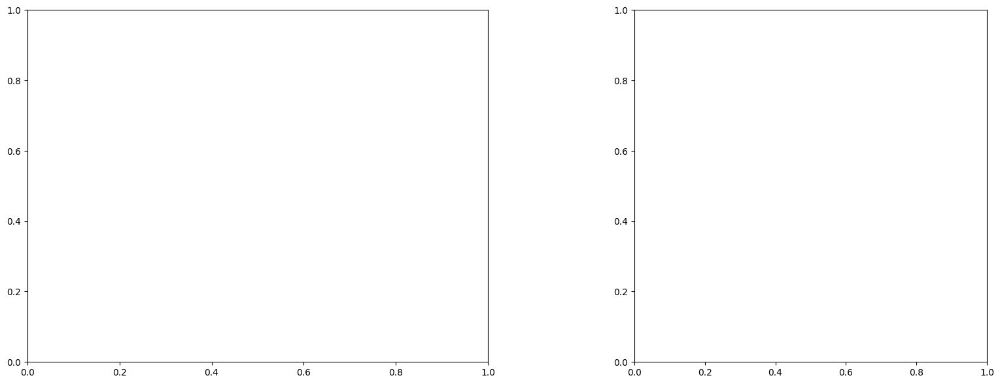

U and V components of current : [-0.20132255 -0.97079505]
uncertainties for U and V: 0.07575337262544969 0.08179891216175926


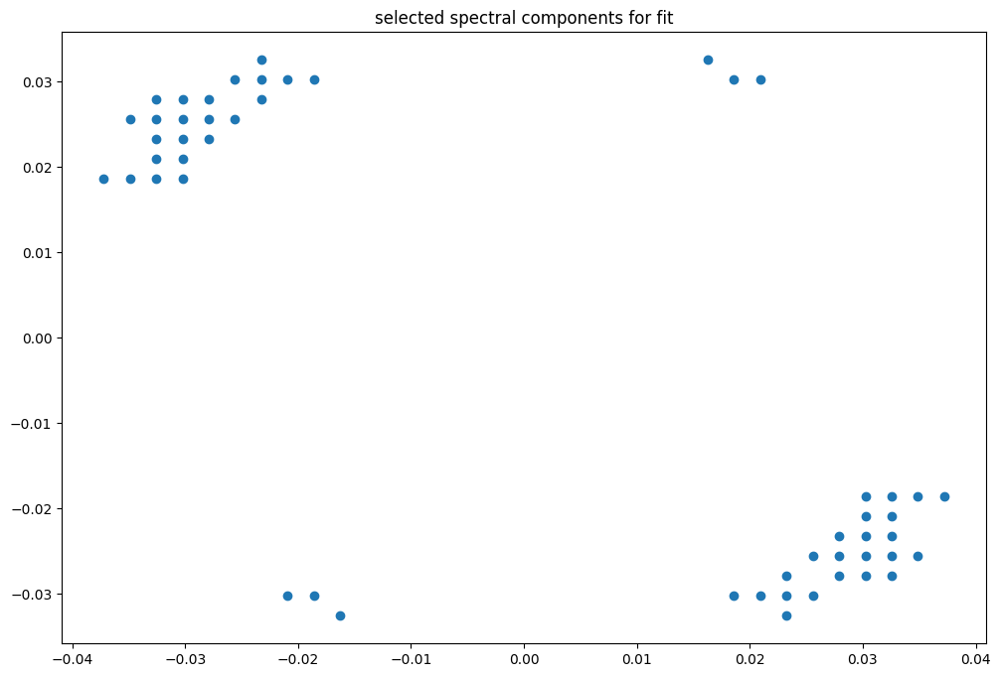

box [3500, 4200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

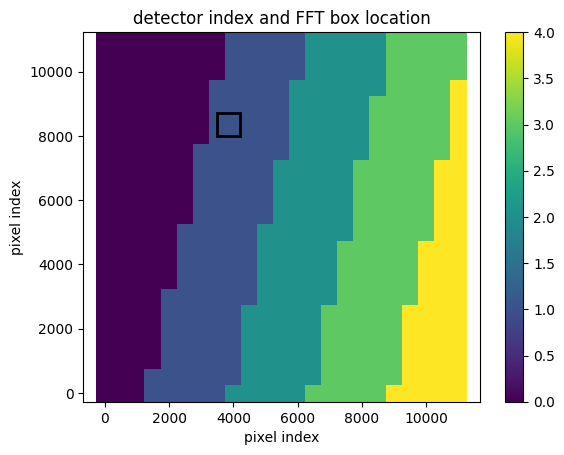

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


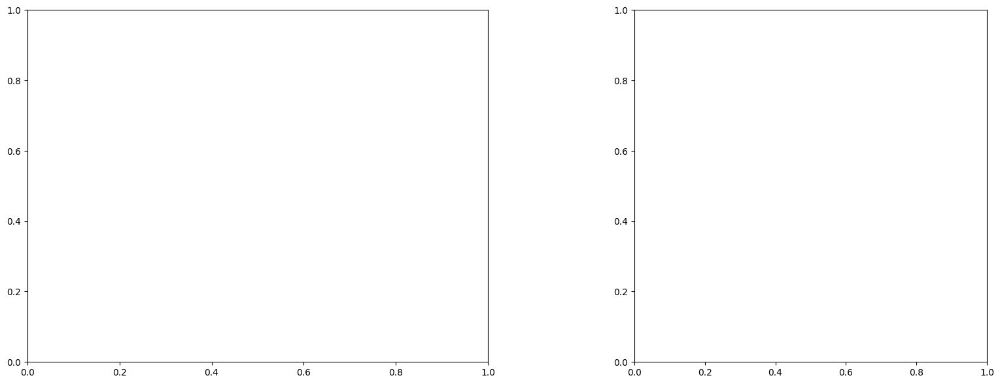

U and V components of current : [-0.30464782 -0.45836852]
uncertainties for U and V: 0.0943338185006461 0.08781727866495441


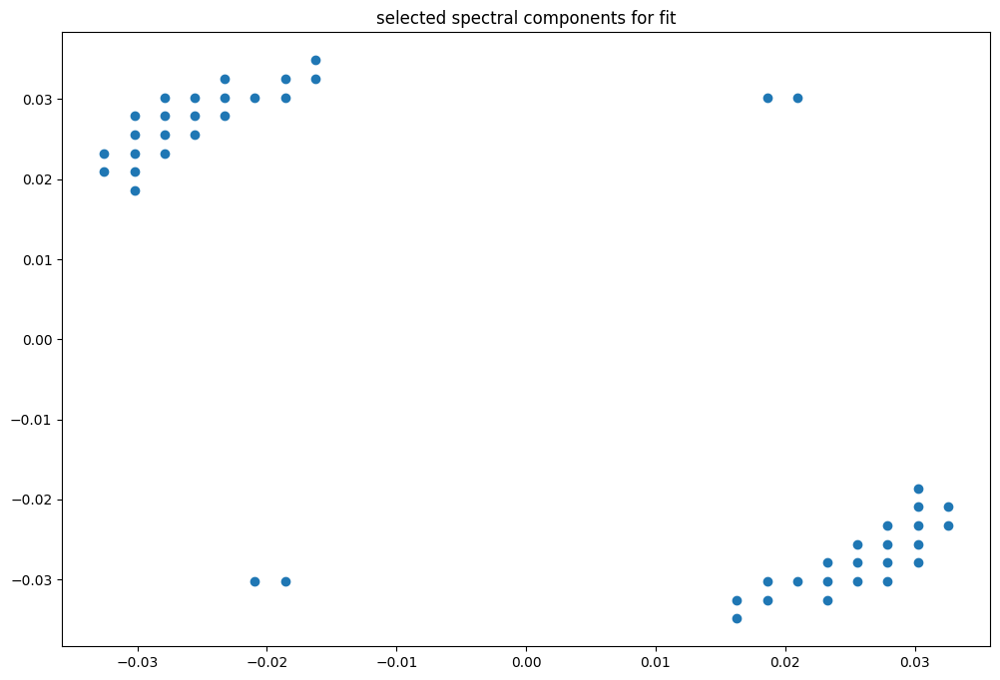

box [3500, 4200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

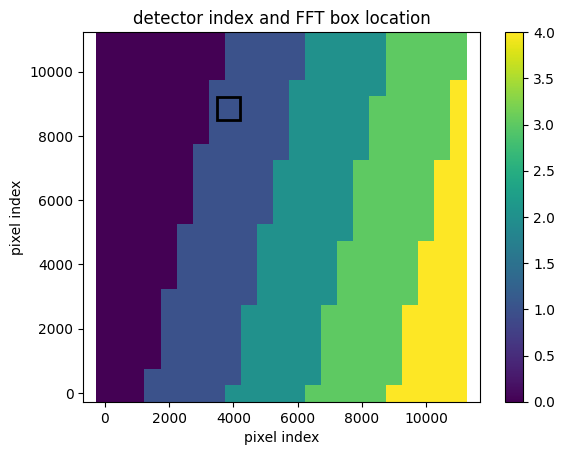

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


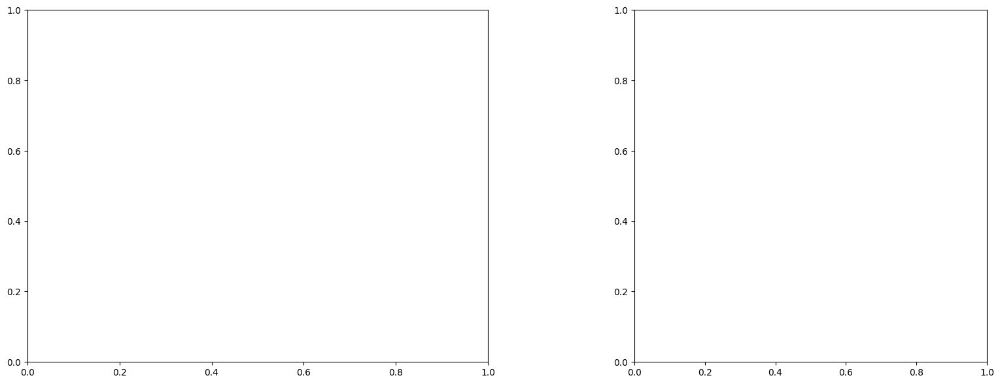

U and V components of current : [-0.68984748 -0.62008374]
uncertainties for U and V: 0.1337805903554245 0.1136875495100773


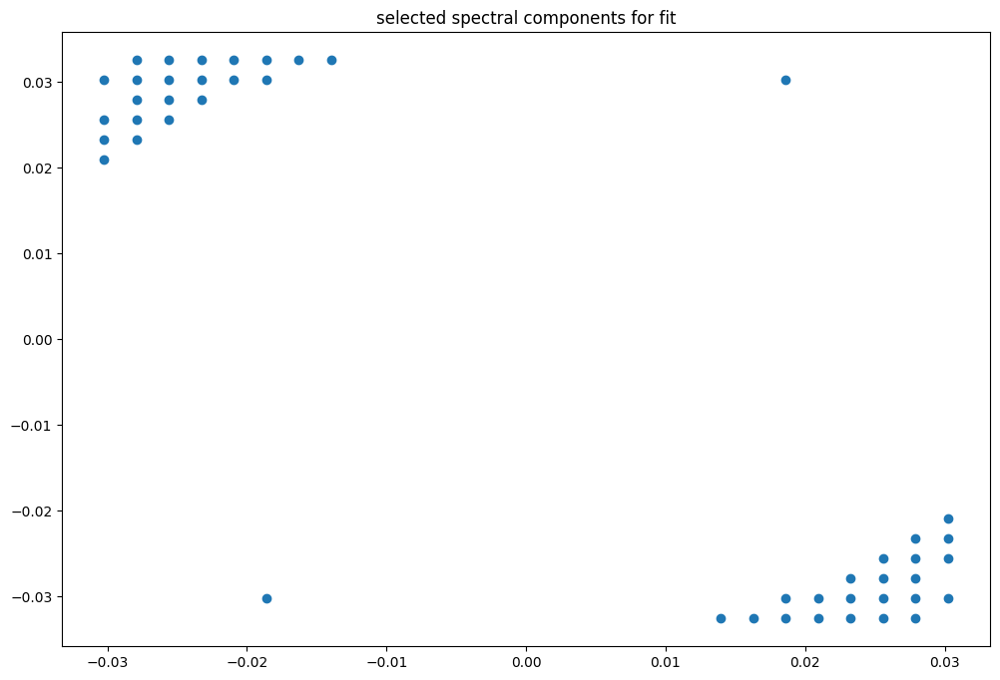

box [3500, 4200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

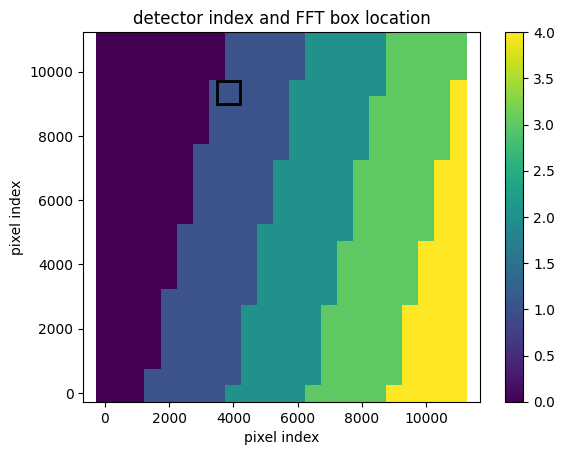

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


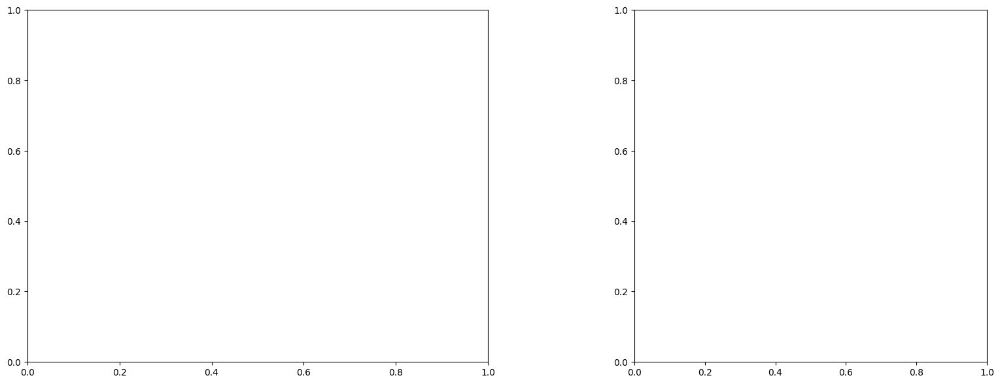

U and V components of current : [-0.21186002 -0.16804023]
uncertainties for U and V: 0.2980174216412154 0.2155572737065818


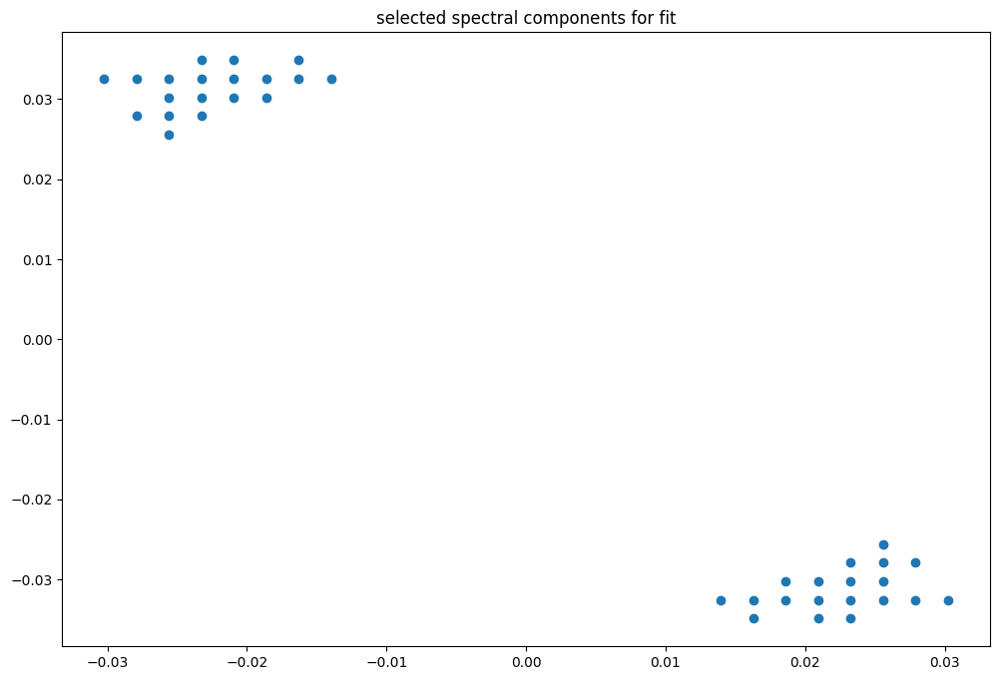

box [3500, 4200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

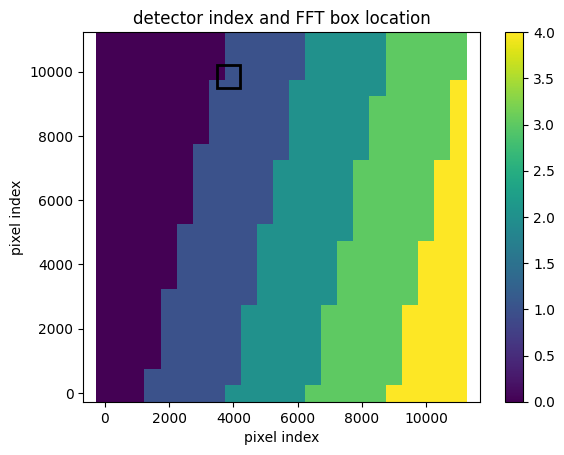

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.96
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


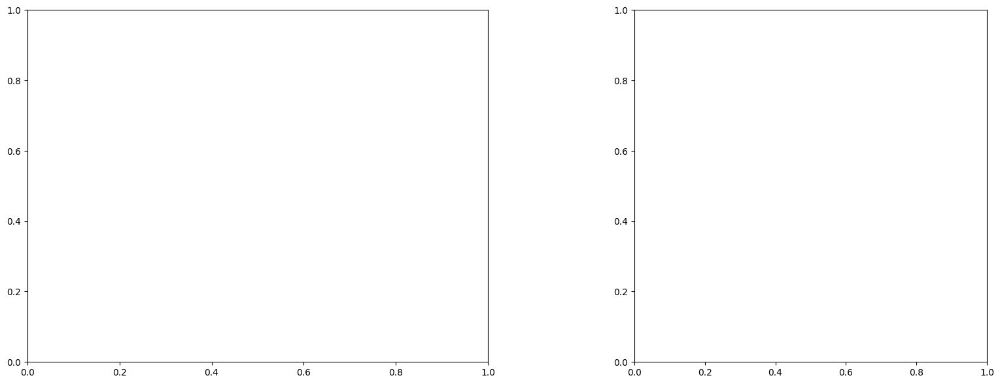

LinAlgError: Singular matrix

box [3500, 4200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

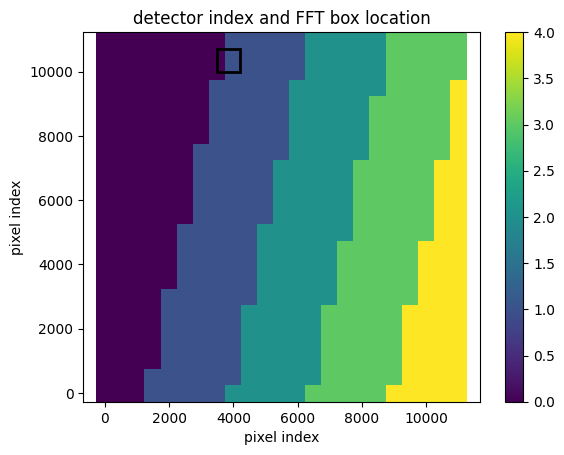

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7000000000000001
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 43)
(43, 43)
(43, 43)


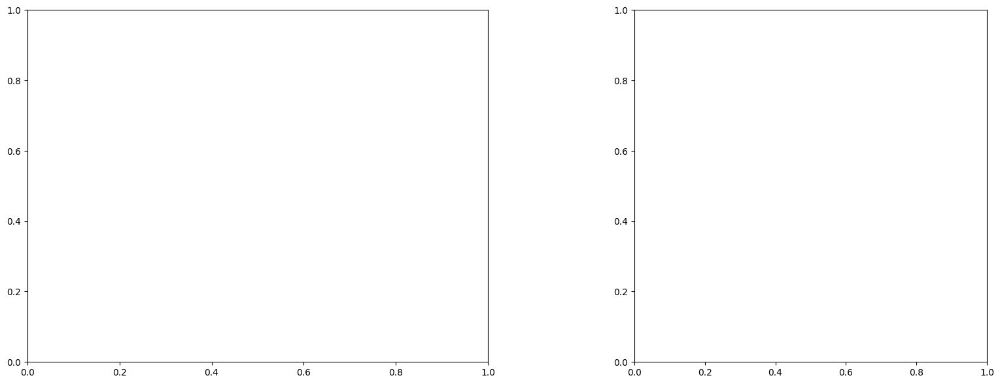

LinAlgError: Singular matrix

box [3500, 4200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

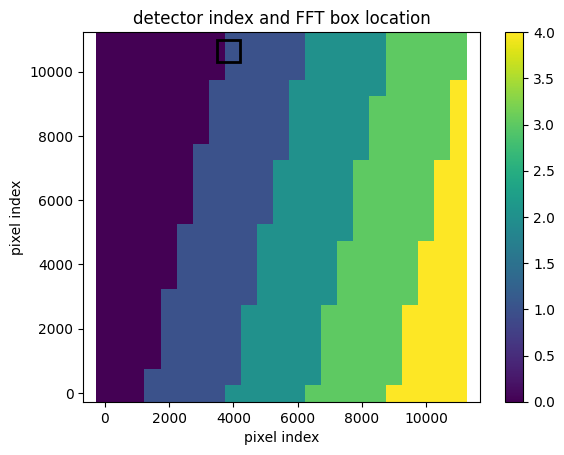

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.7
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 42)
(43, 42)
(43, 42)


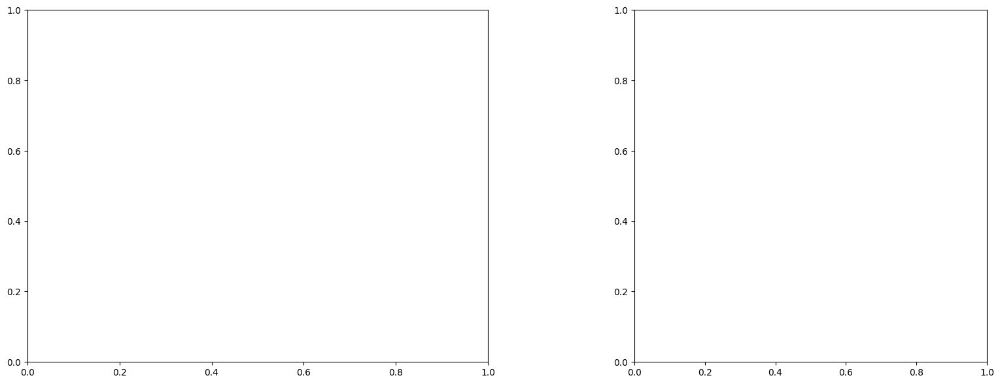

LinAlgError: Singular matrix

box [4000, 4700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

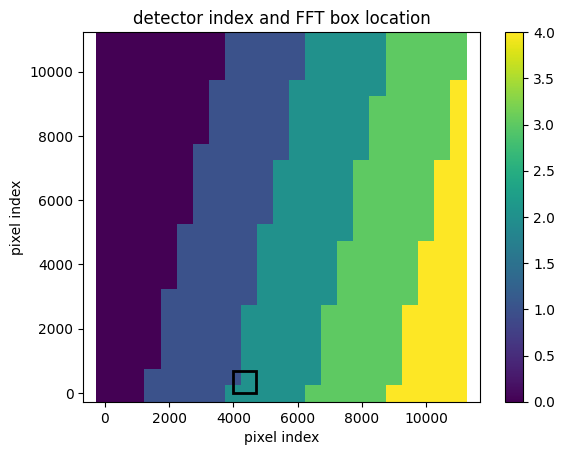

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(43, 43)
(43, 43)
(43, 43)


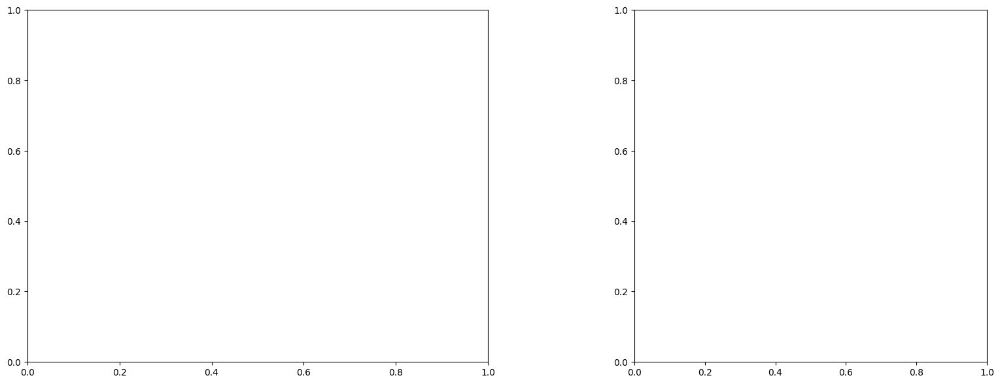

LinAlgError: Singular matrix

box [4000, 4700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

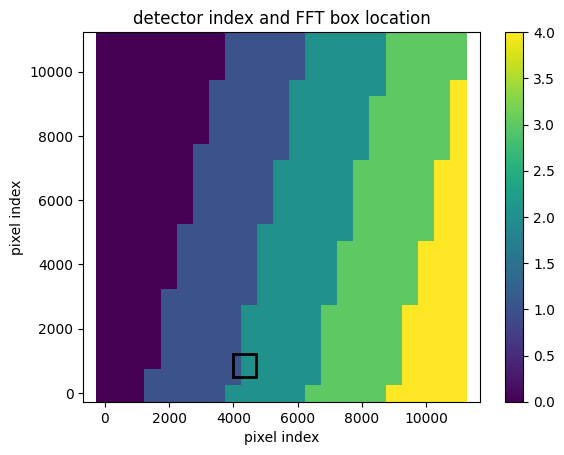

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


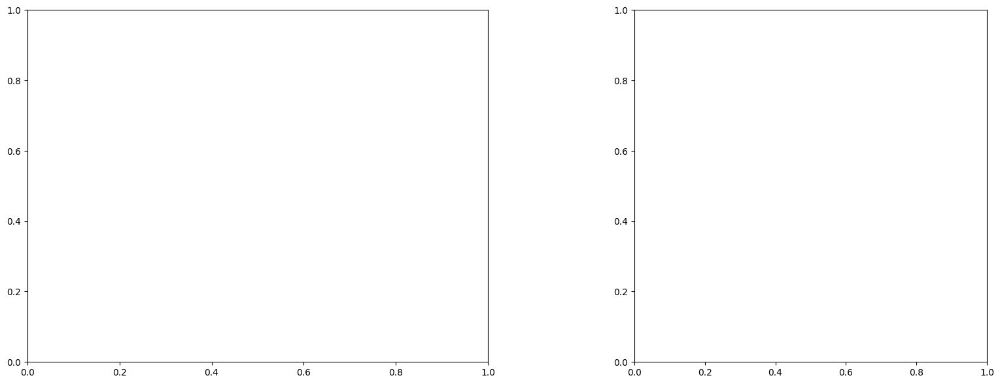

LinAlgError: Singular matrix

box [4000, 4700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

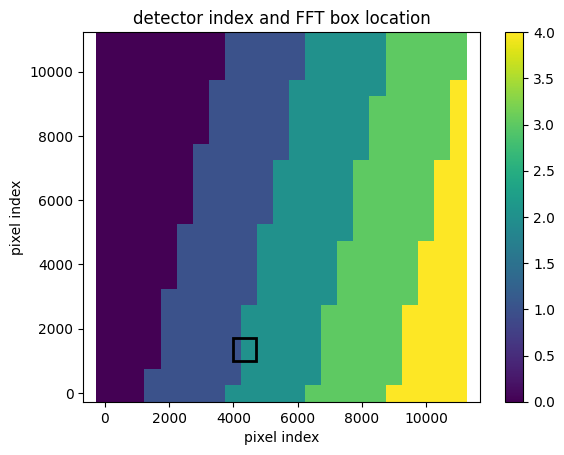

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


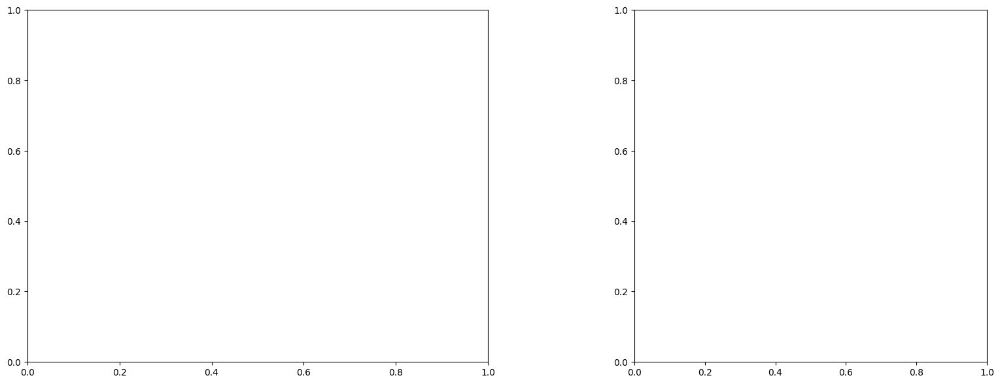

LinAlgError: Singular matrix

box [4000, 4700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

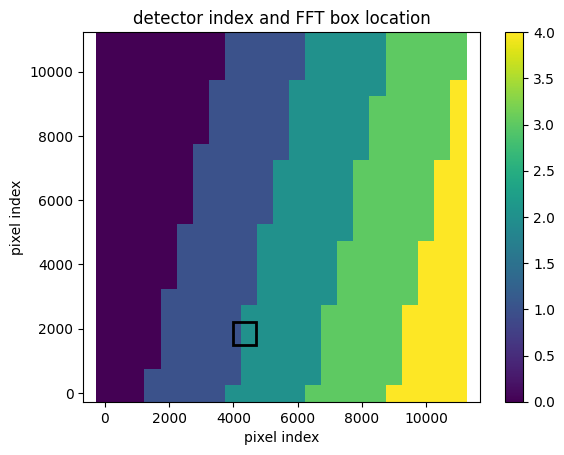

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


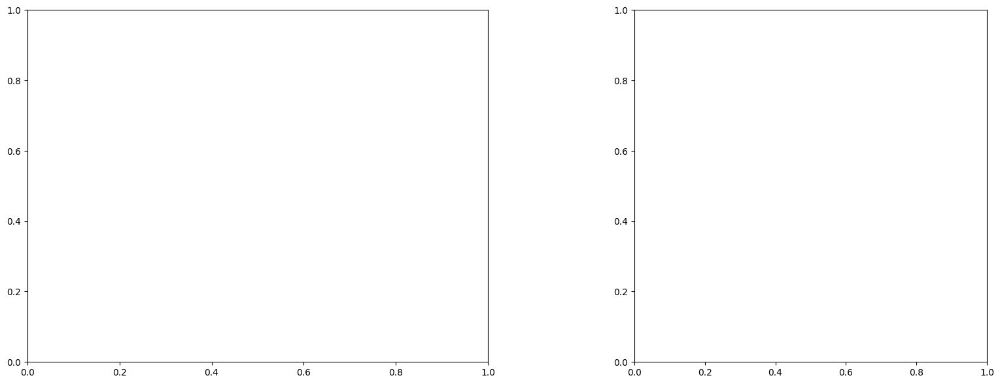

LinAlgError: Singular matrix

box [4000, 4700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

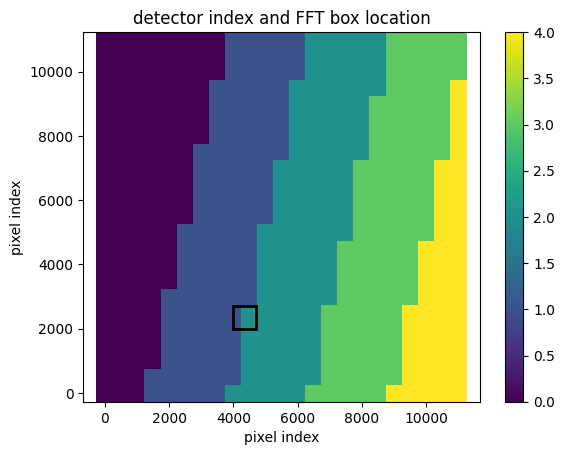

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


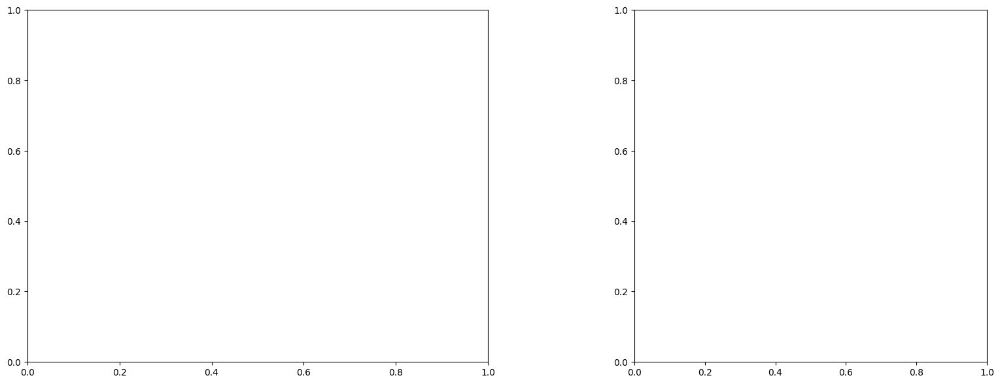

LinAlgError: Singular matrix

box [4000, 4700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

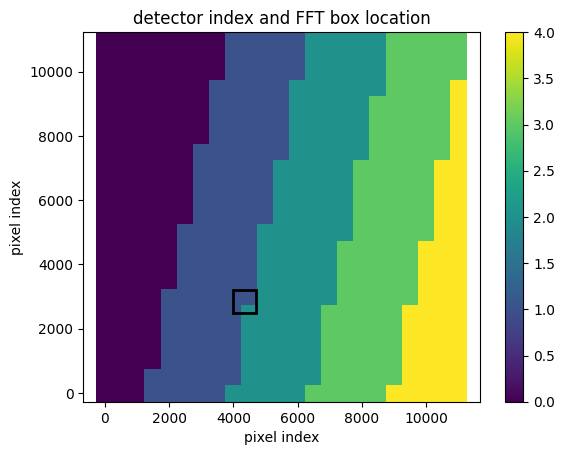

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075880269791748
(43, 43)
(43, 43)
(43, 43)


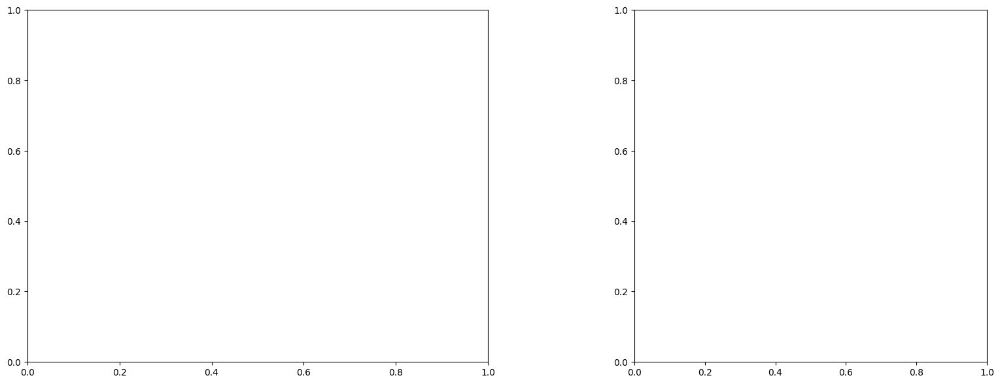

U and V components of current : [ 0.13483763 -0.68884395]
uncertainties for U and V: 0.08475021518526009 0.10604923232155321


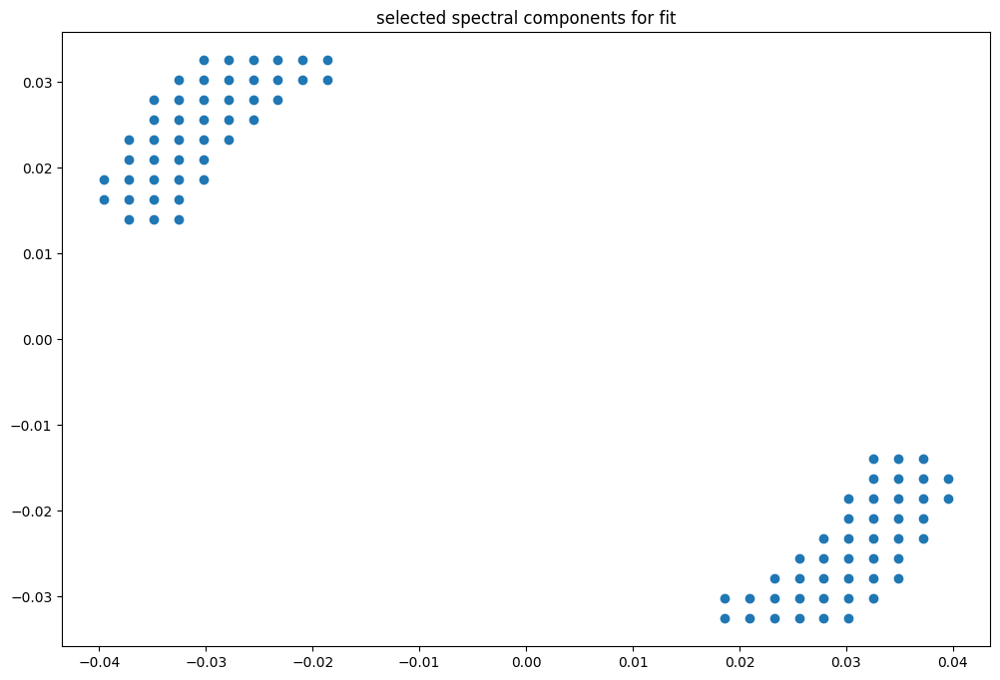

box [4000, 4700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

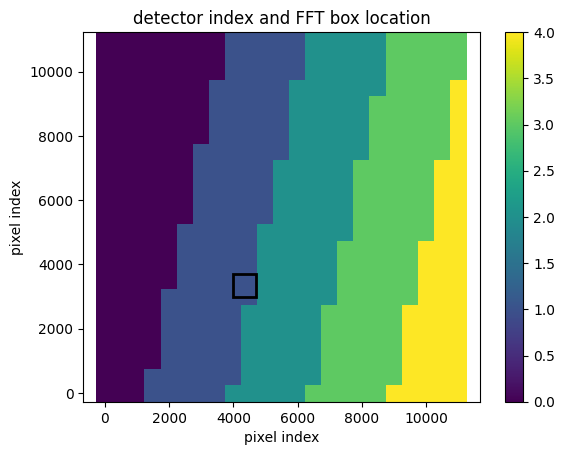

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


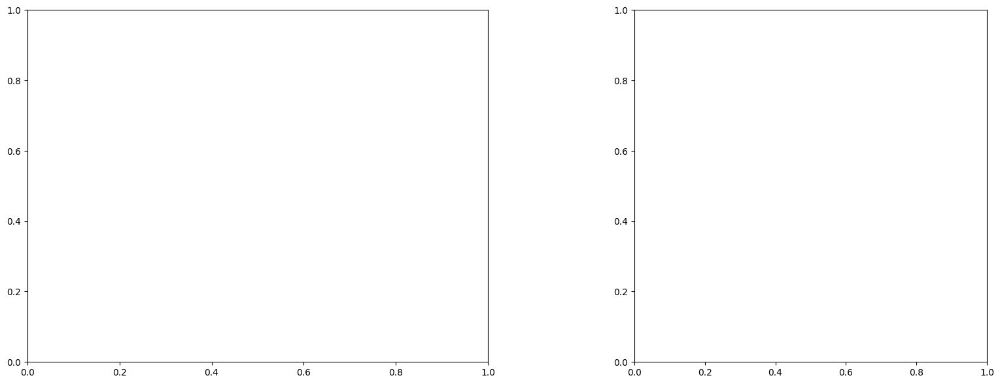

U and V components of current : [ 0.10396971 -0.79596618]
uncertainties for U and V: 0.0571897379833793 0.06825625834638013


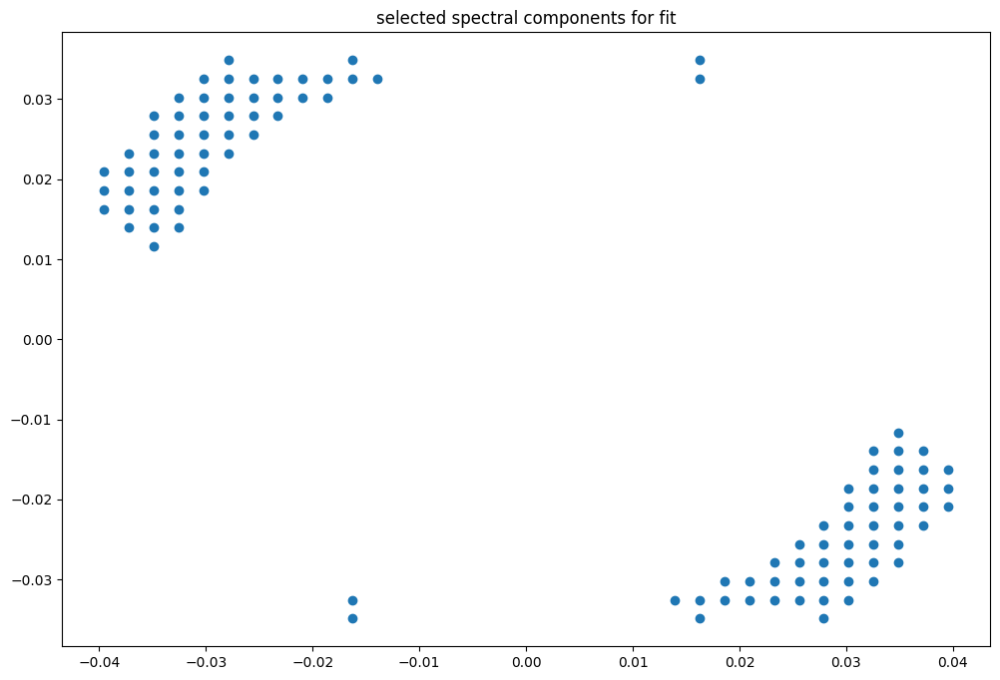

box [4000, 4700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

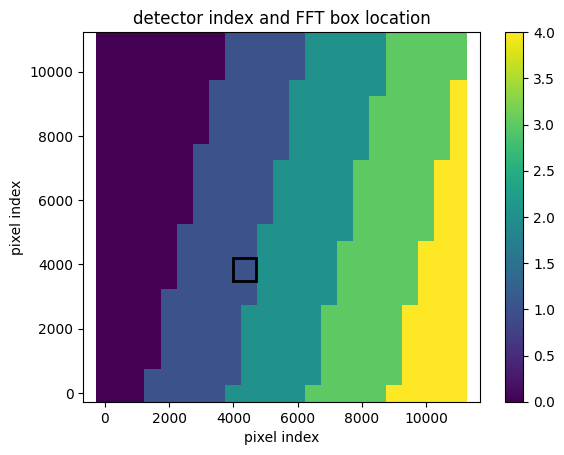

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075853051132049
(43, 43)
(43, 43)
(43, 43)


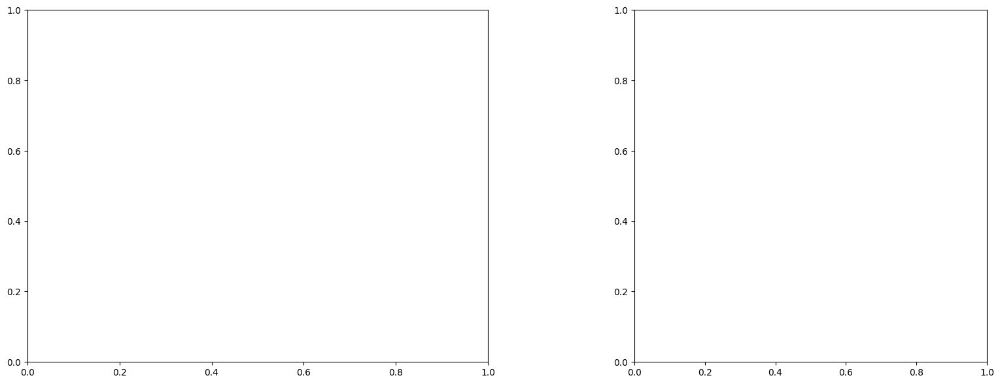

U and V components of current : [ 0.08713524 -0.7302506 ]
uncertainties for U and V: 0.067883677204504 0.08046136437196433


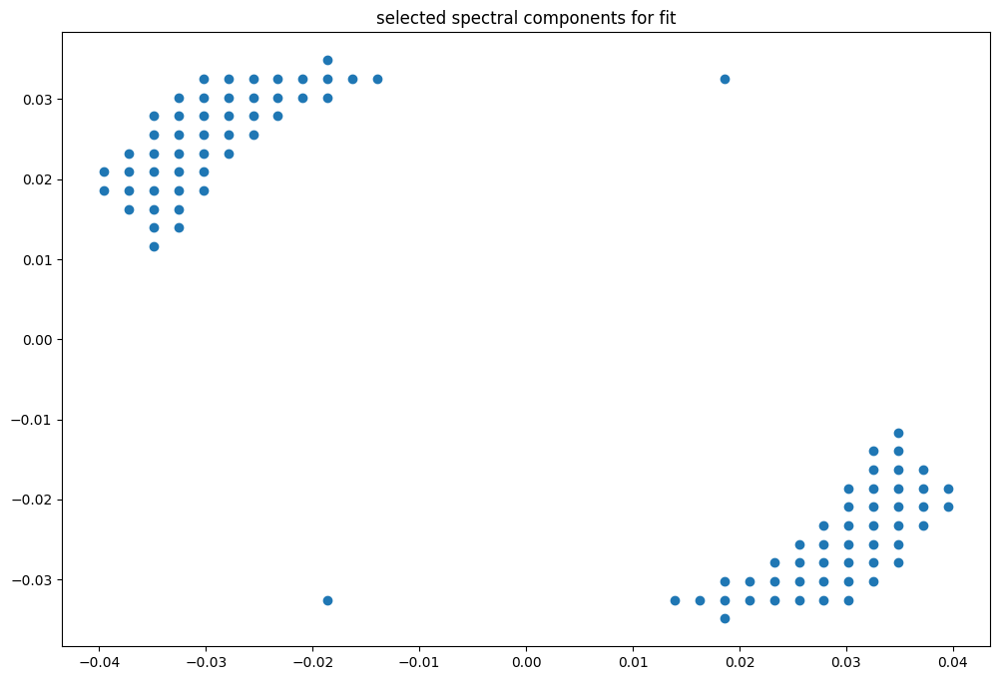

box [4000, 4700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

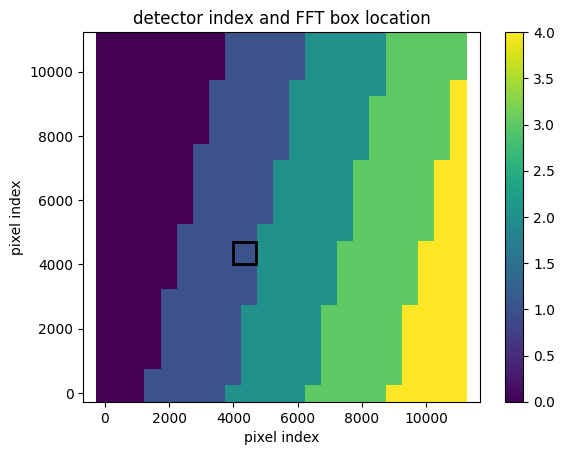

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007582685620866
(43, 43)
(43, 43)
(43, 43)


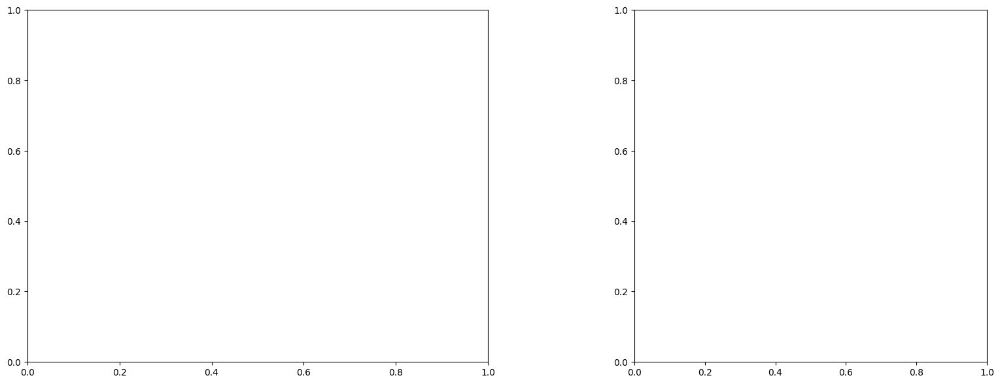

U and V components of current : [-0.05471458 -0.91626752]
uncertainties for U and V: 0.08551222705666142 0.09411539997560803


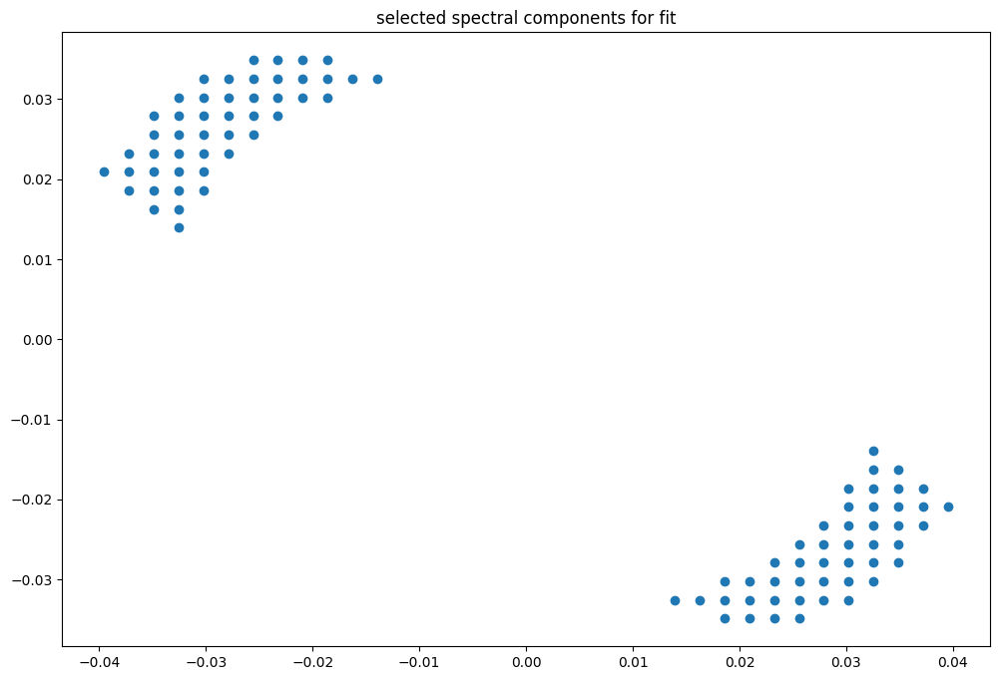

box [4000, 4700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

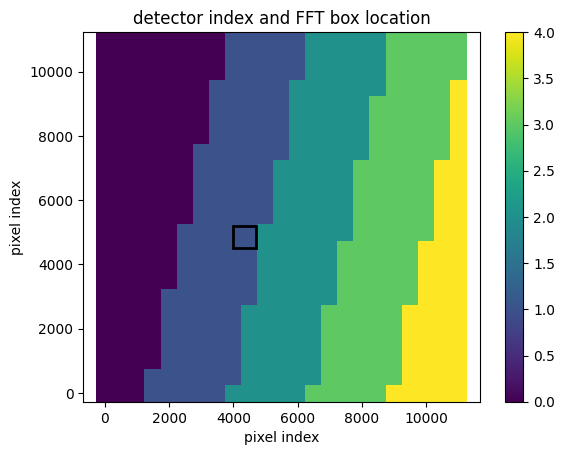

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


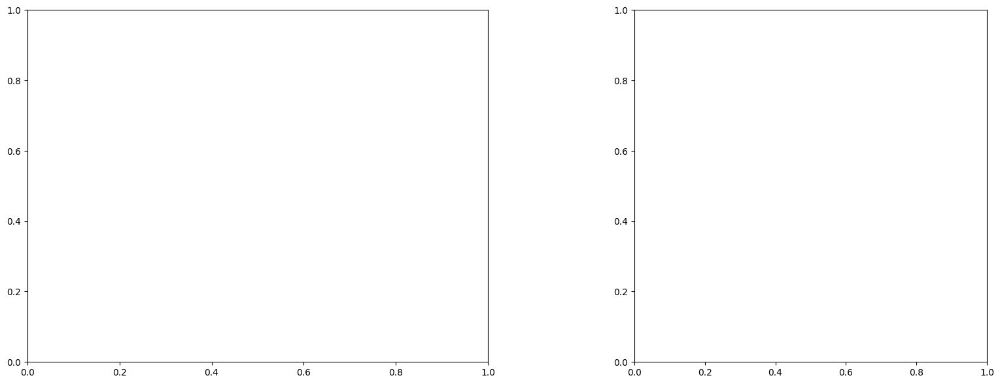

U and V components of current : [ 0.15617464 -0.80339578]
uncertainties for U and V: 0.08679988584837836 0.09440930239814915


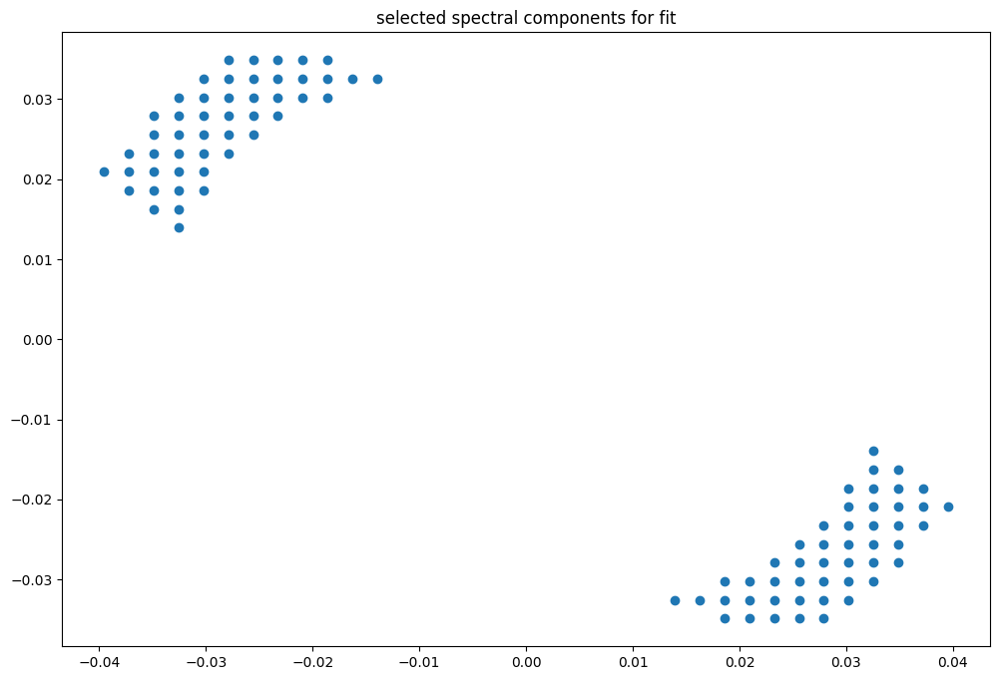

box [4000, 4700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

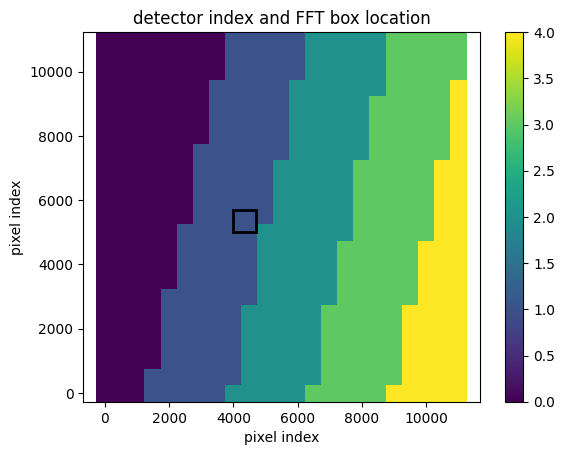

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075803864026343
(43, 43)
(43, 43)
(43, 43)


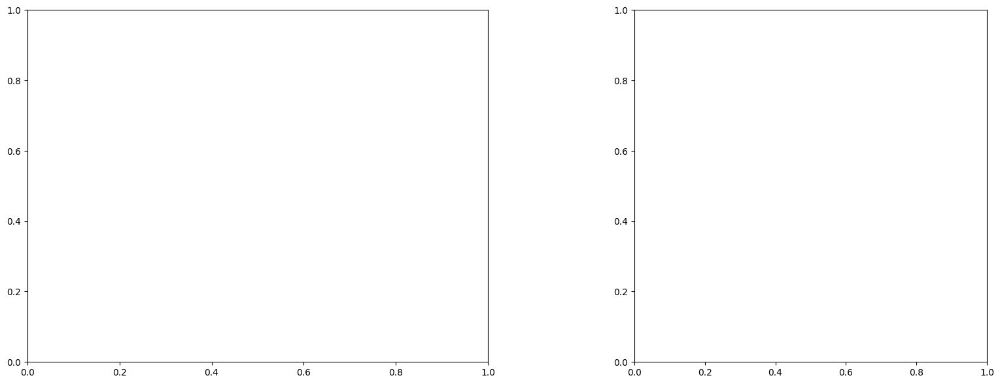

U and V components of current : [ 0.0225245  -1.22145026]
uncertainties for U and V: 0.07152479250353586 0.07858876436615773


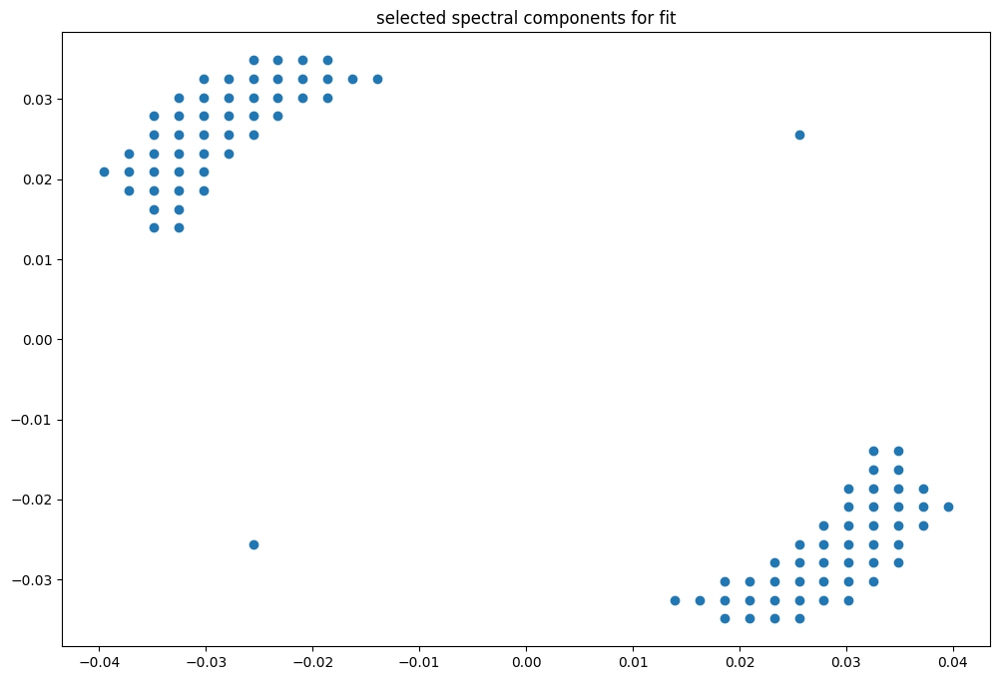

box [4000, 4700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

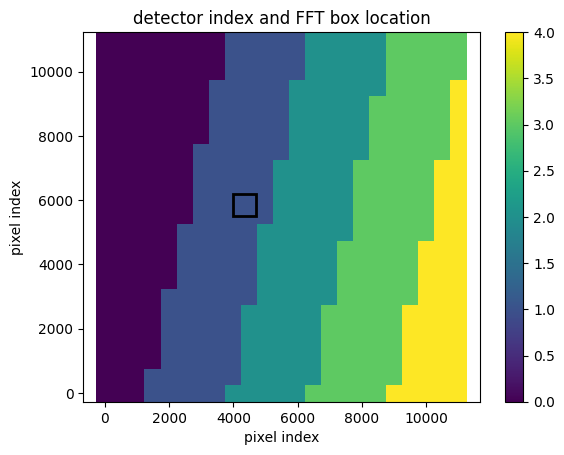

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


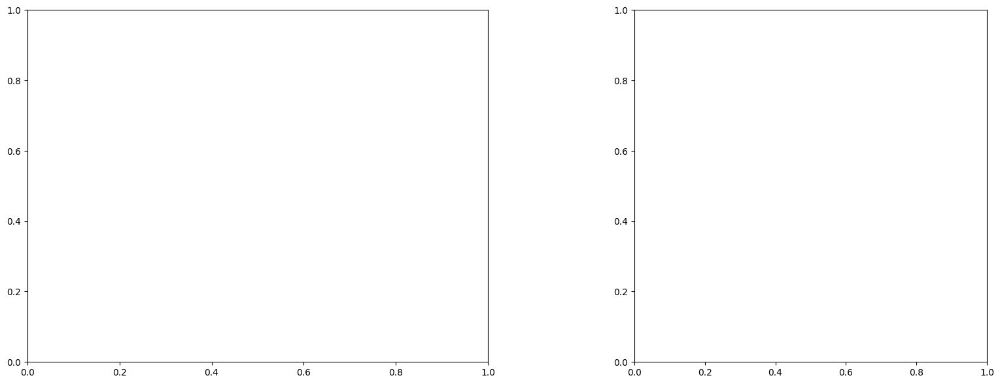

U and V components of current : [ 0.21926096 -0.83200194]
uncertainties for U and V: 0.08423272273091101 0.09357704182149565


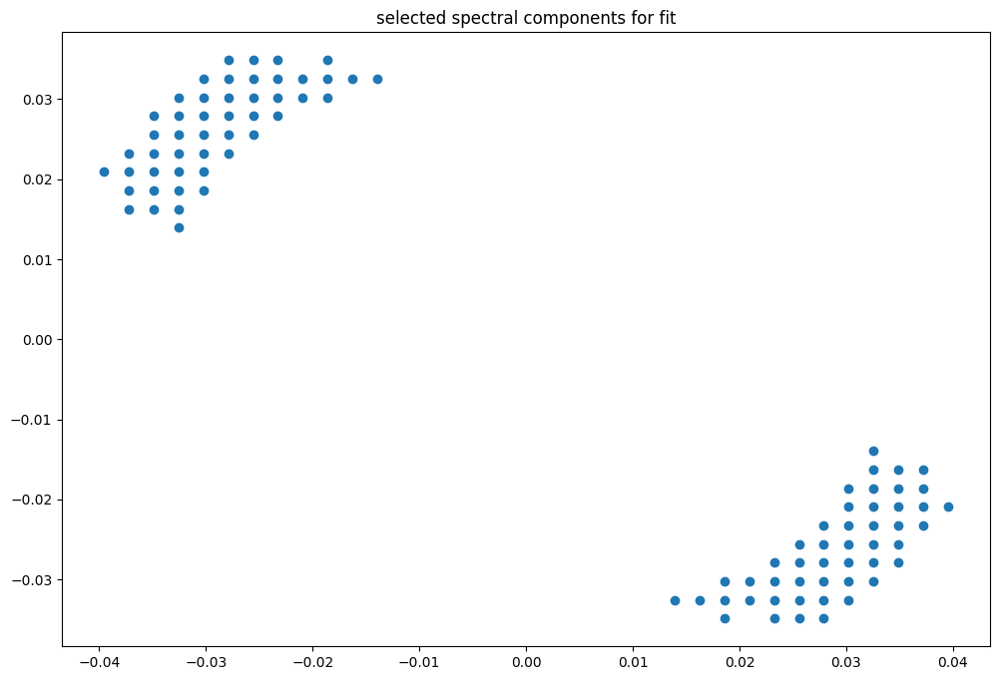

box [4000, 4700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

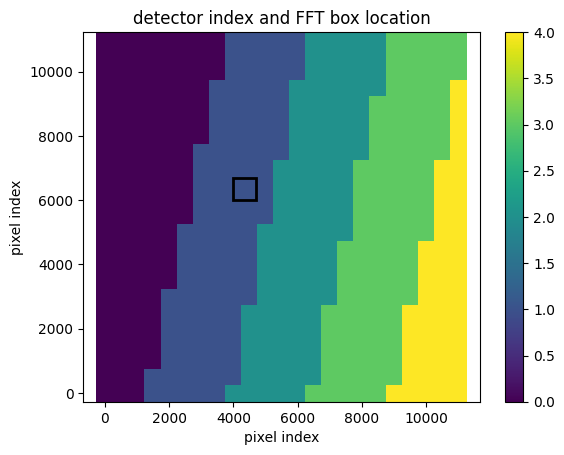

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


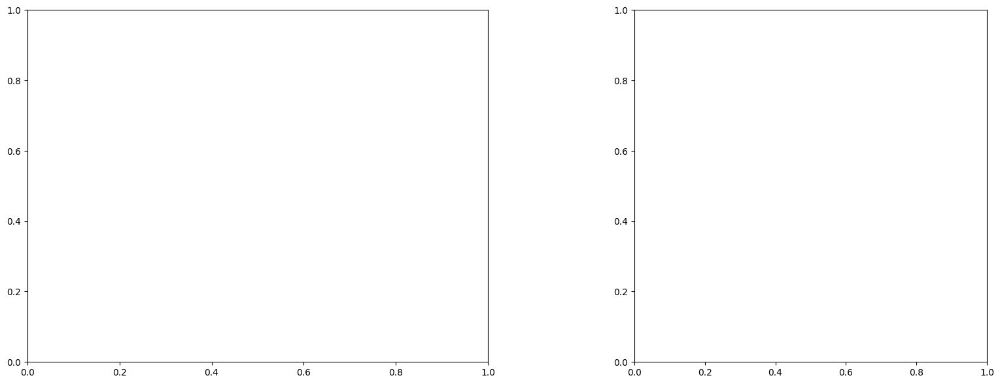

U and V components of current : [-0.22587472 -1.35073887]
uncertainties for U and V: 0.0564437428421981 0.06388186017073147


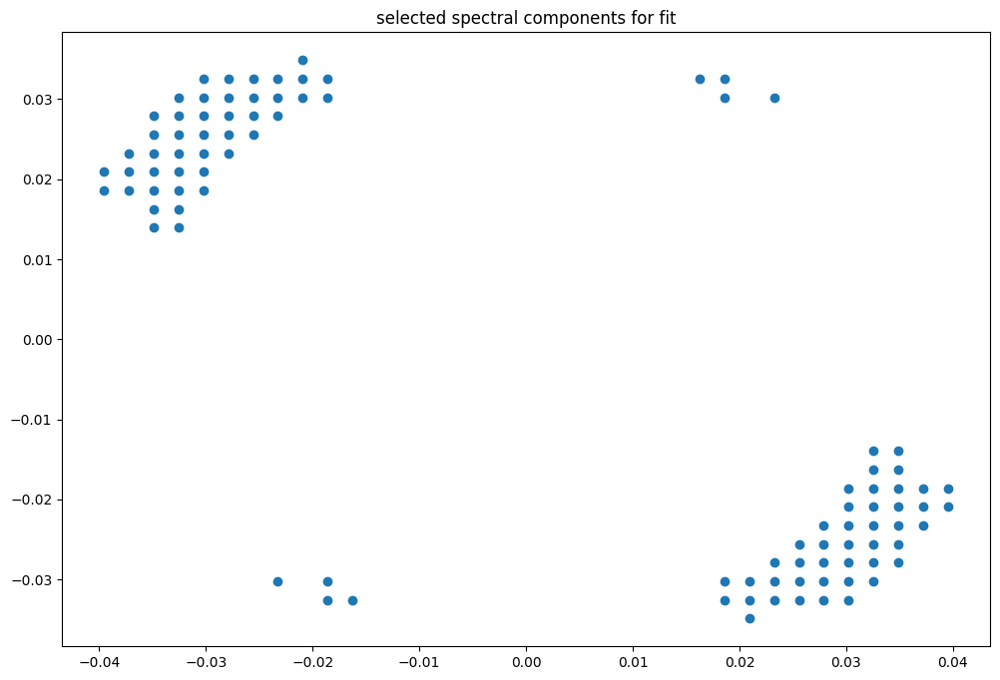

box [4000, 4700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

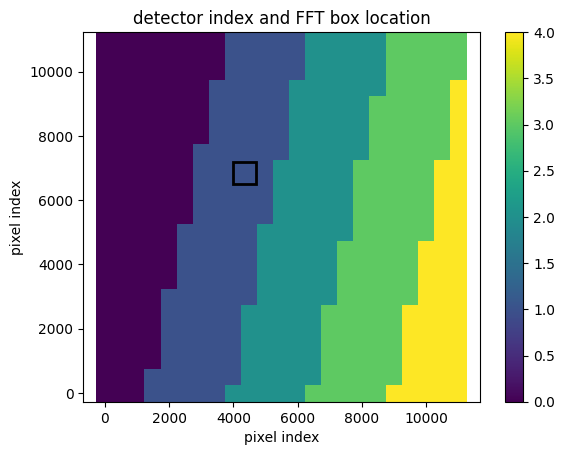

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


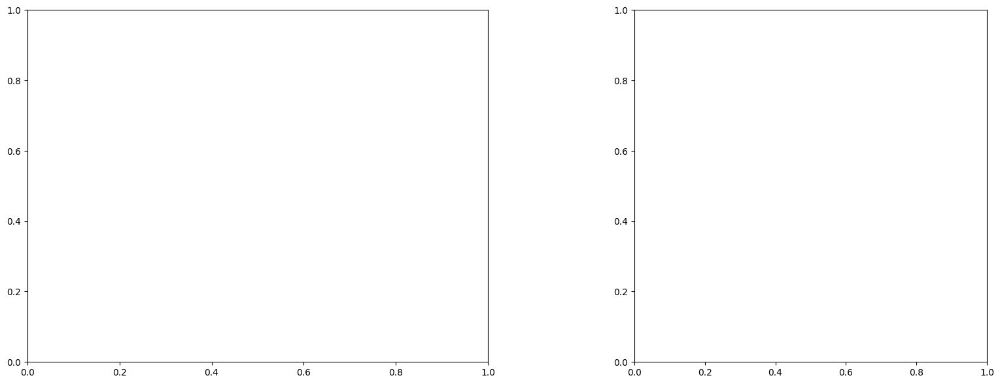

U and V components of current : [-0.08659746 -1.70014354]
uncertainties for U and V: 0.0757821256480649 0.08079806043181936


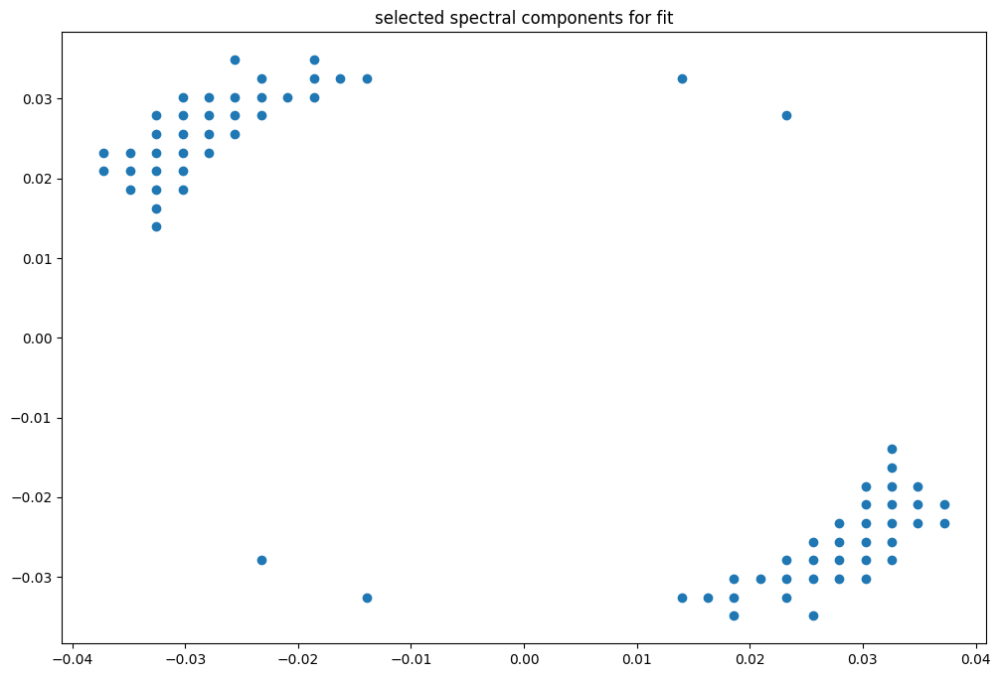

box [4000, 4700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

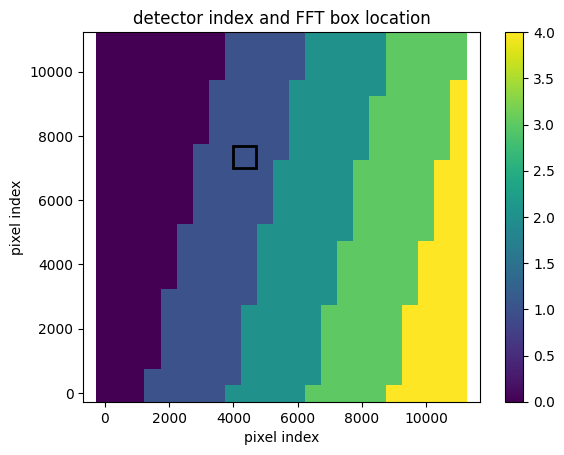

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


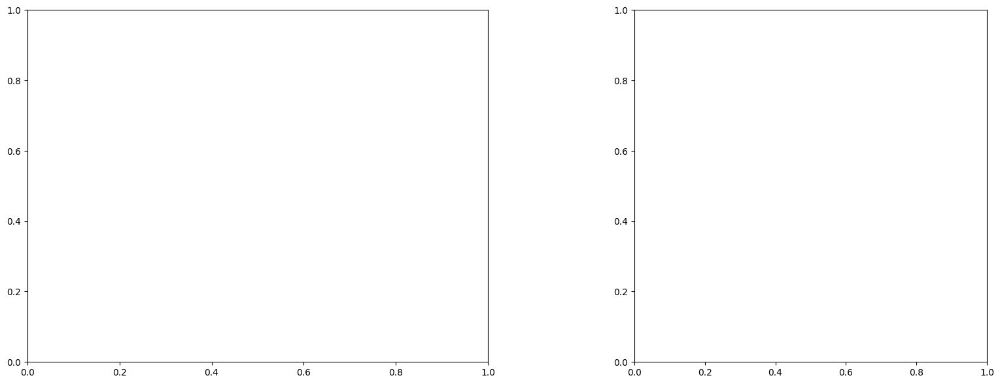

U and V components of current : [-0.02669404 -1.11337245]
uncertainties for U and V: 0.05338852999752703 0.0561809150426411


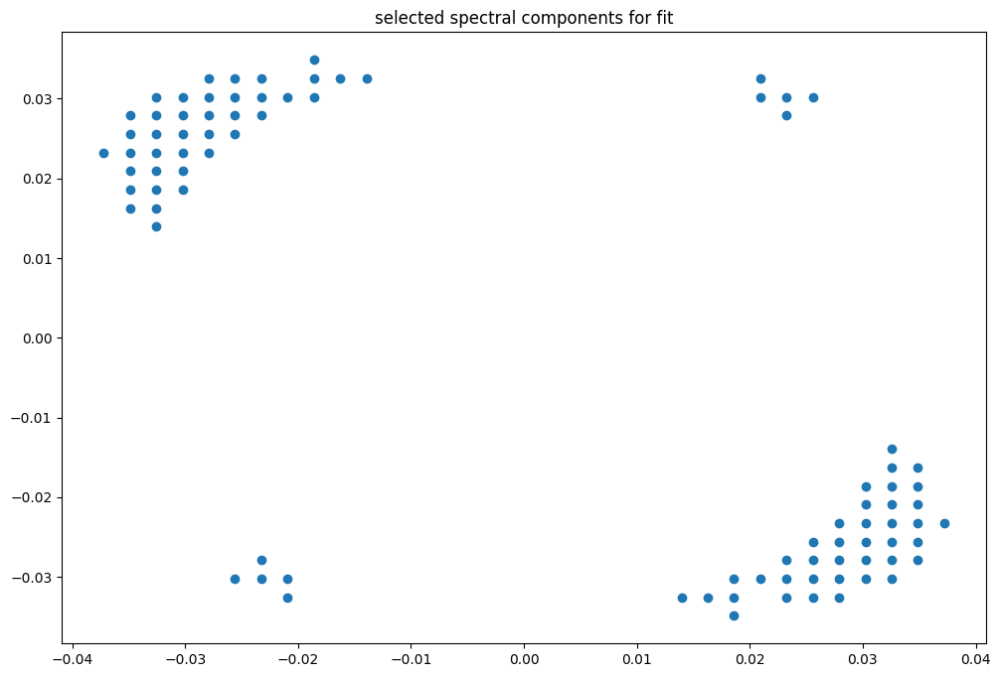

box [4000, 4700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

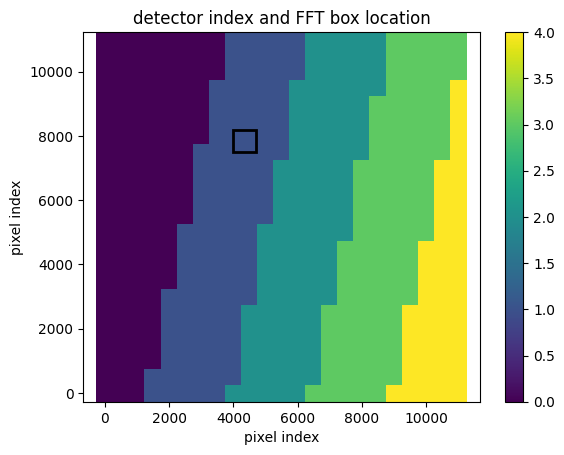

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


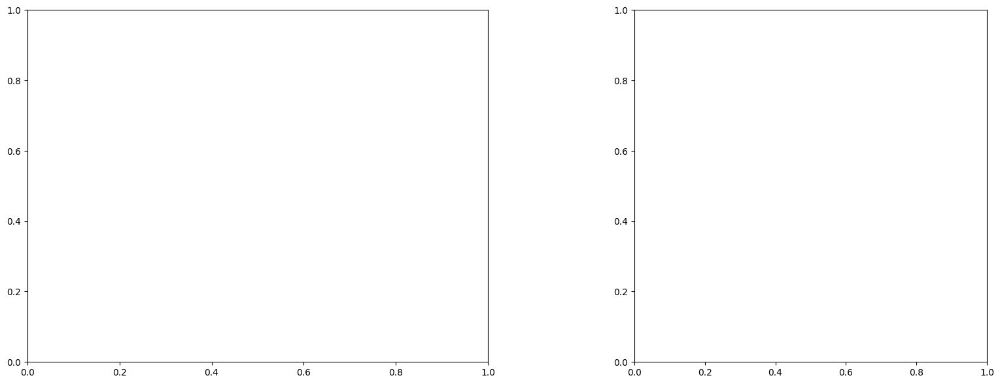

U and V components of current : [-0.14924526 -0.8103041 ]
uncertainties for U and V: 0.04597490140160573 0.048853707959872116


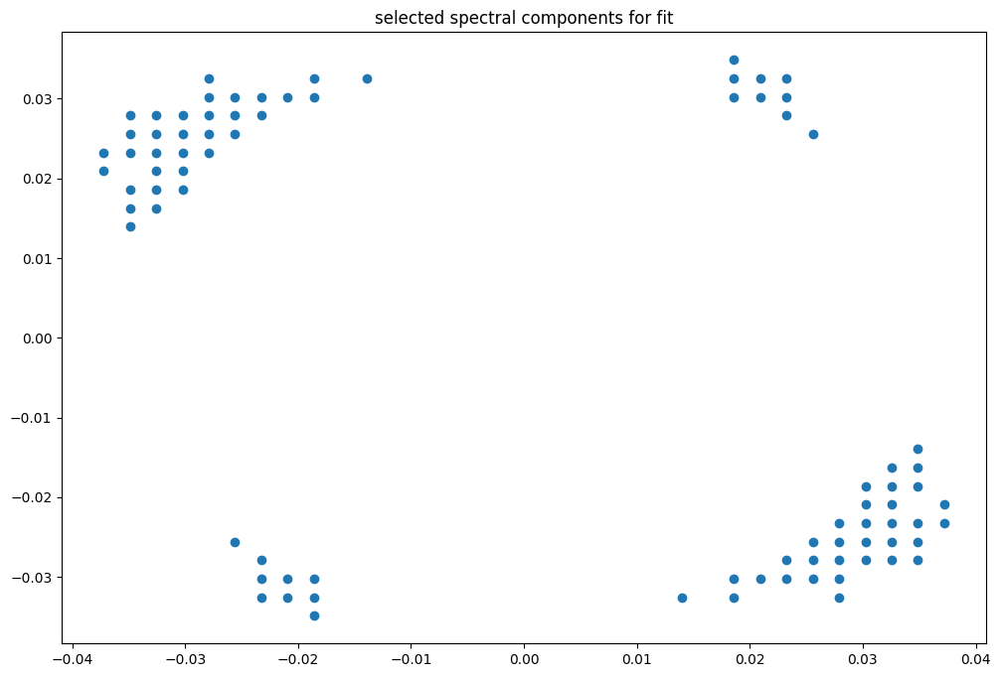

box [4000, 4700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

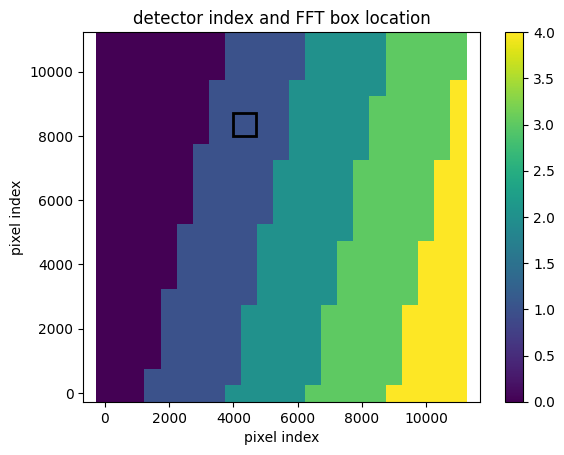

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


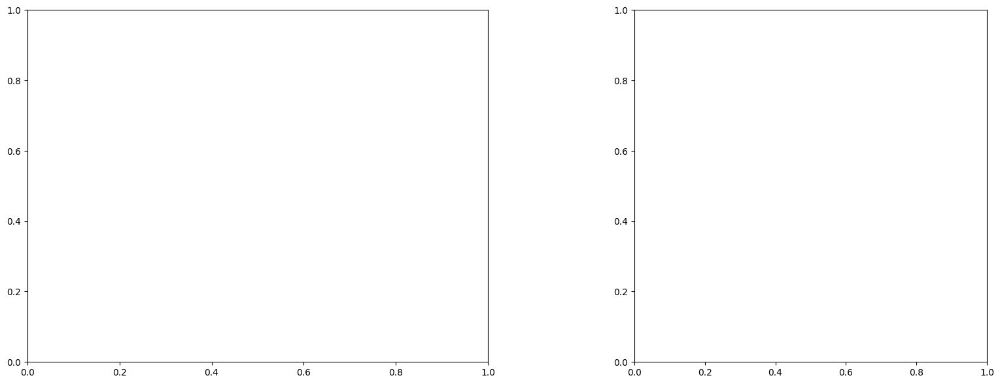

U and V components of current : [-0.23178843 -0.9506068 ]
uncertainties for U and V: 0.0703772117535619 0.06830113411622747


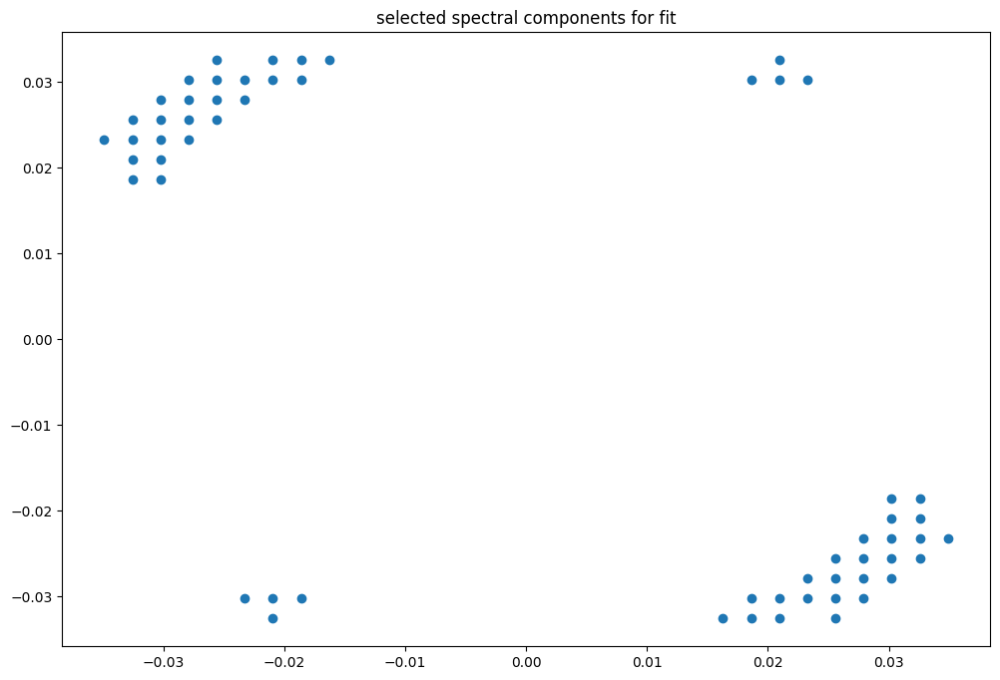

box [4000, 4700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

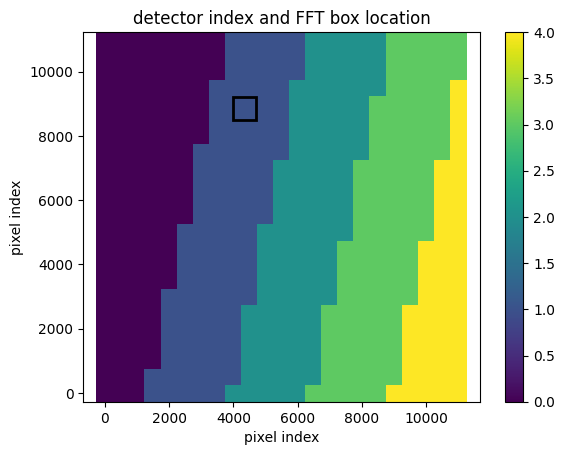

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


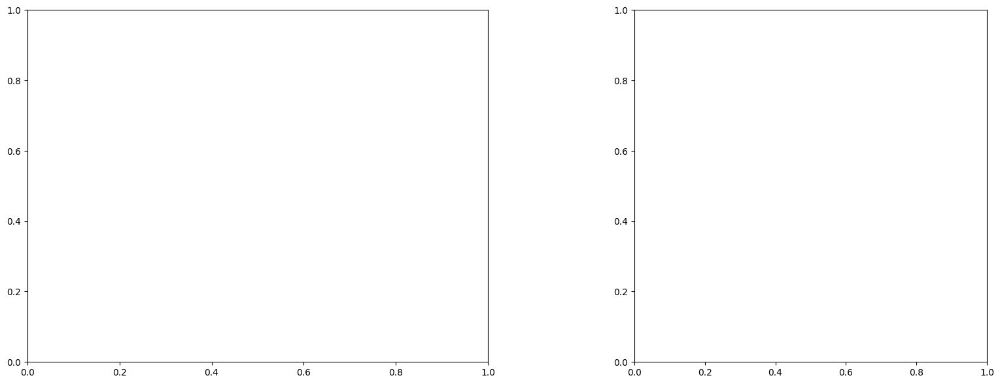

U and V components of current : [-0.41795284 -1.12024396]
uncertainties for U and V: 0.1427889188976879 0.11074563807993233


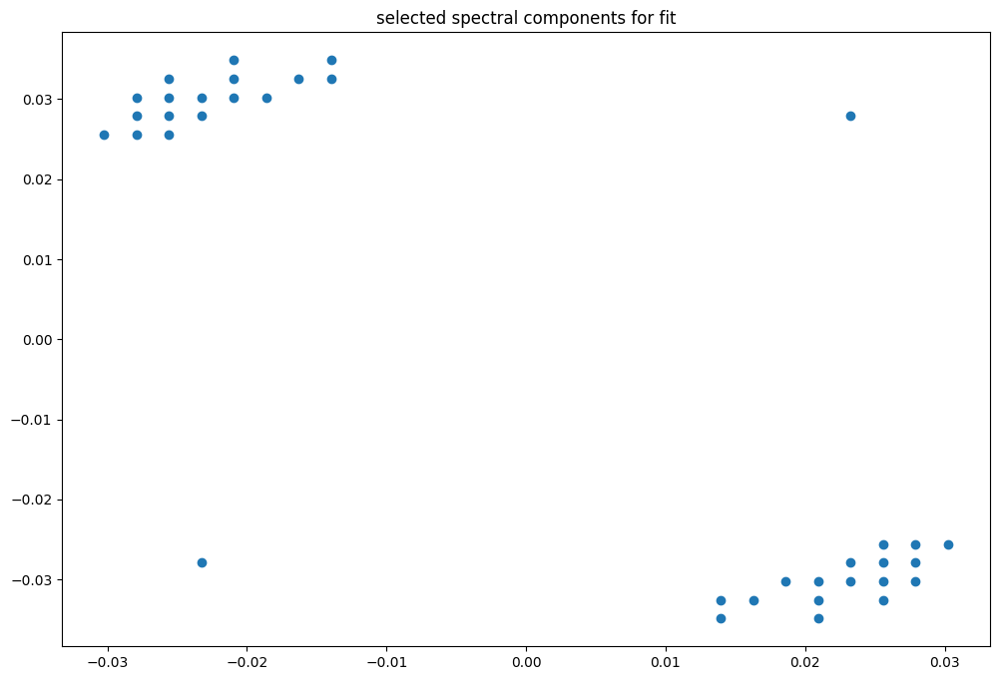

box [4000, 4700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

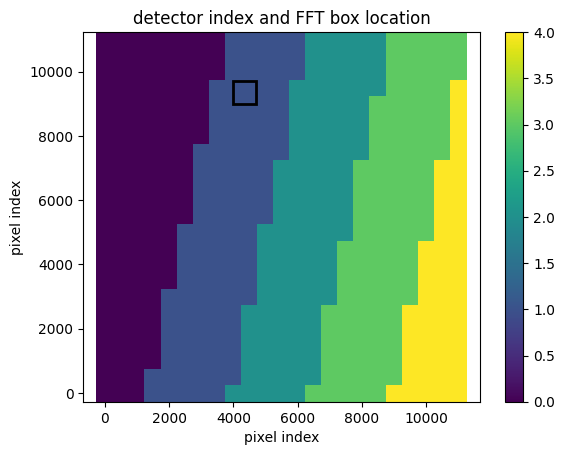

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


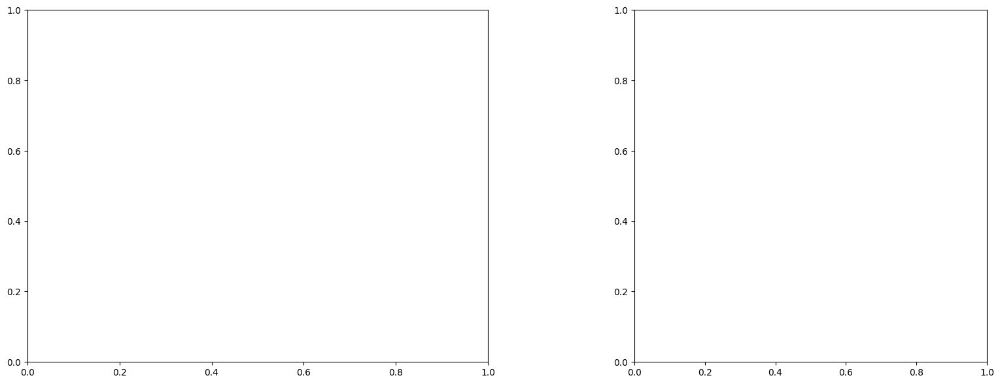

U and V components of current : [-0.05443647 -1.15842868]
uncertainties for U and V: 0.15903545380380177 0.10905516707165942


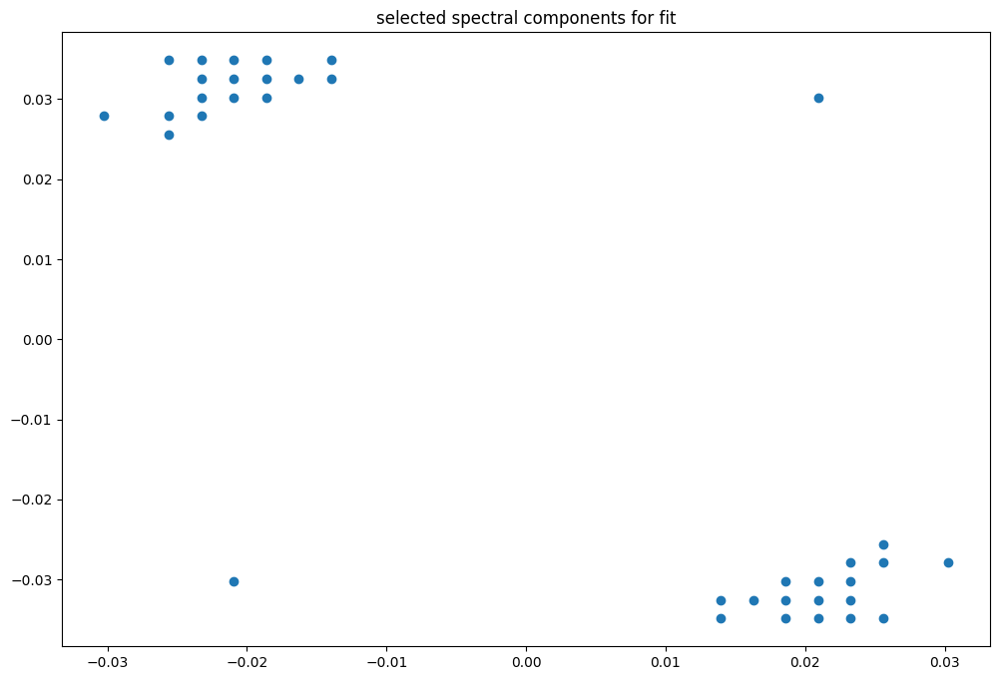

box [4000, 4700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

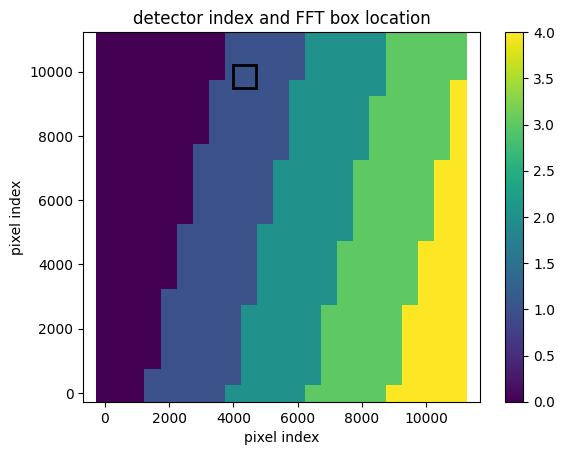

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


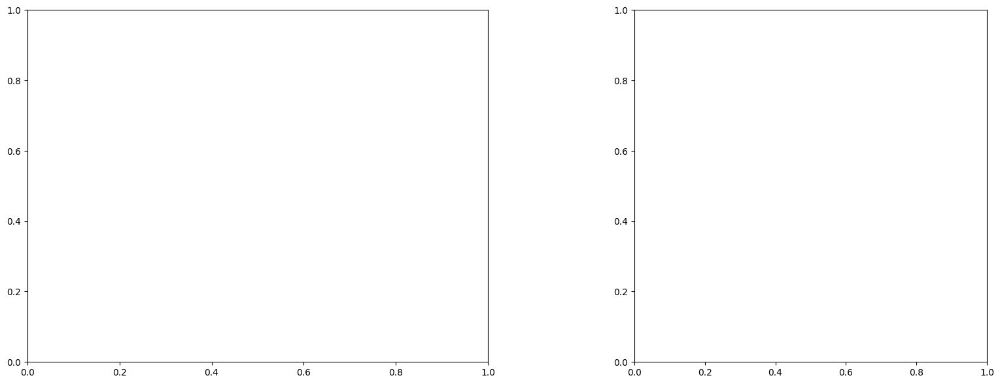

U and V components of current : [ 0.1921773  -0.47610378]
uncertainties for U and V: 0.0903357916610307 0.08353909588072658


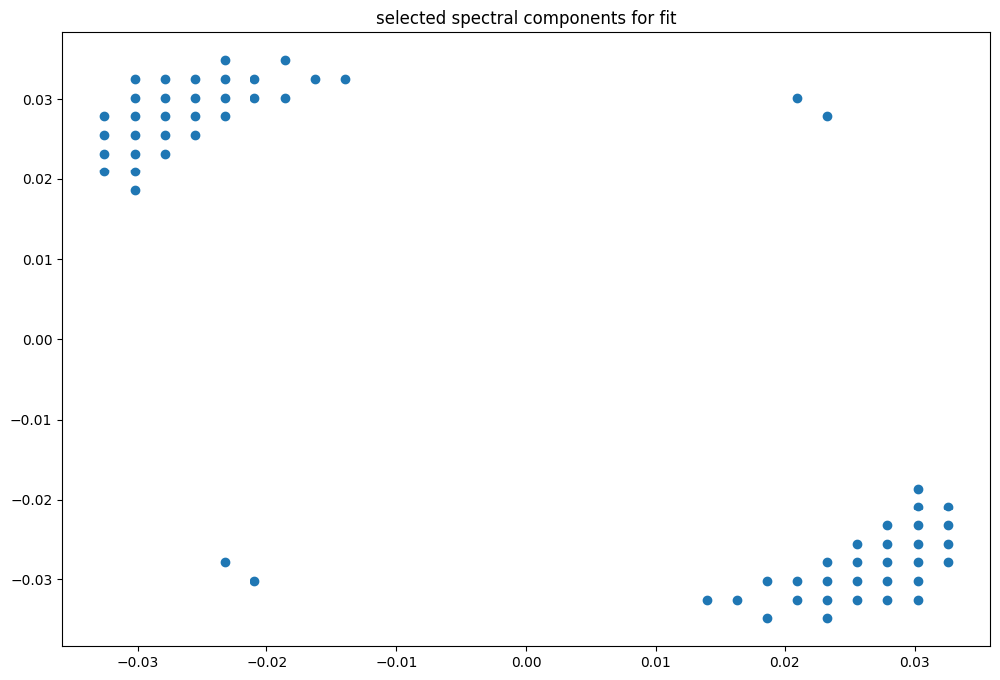

box [4000, 4700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

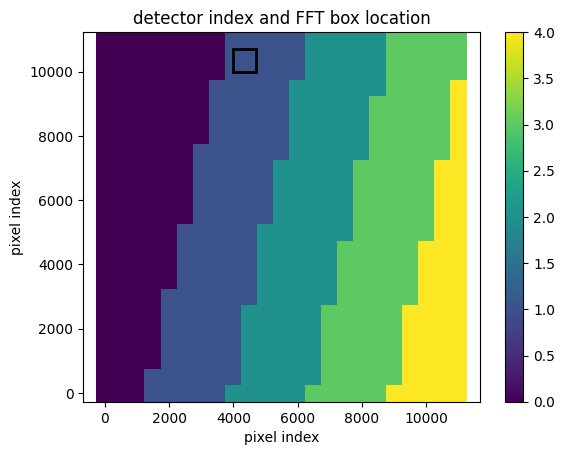

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 43)
(43, 43)
(43, 43)


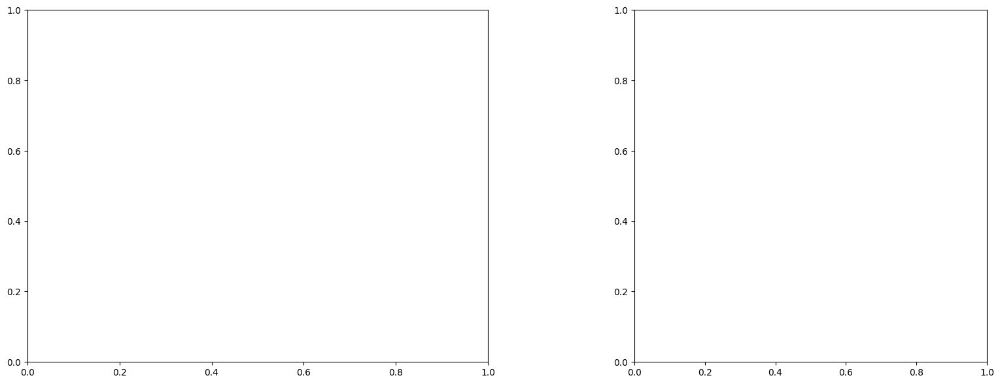

U and V components of current : [ 0.26735455 -0.68113032]
uncertainties for U and V: 0.16093035991676183 0.13788634672562758


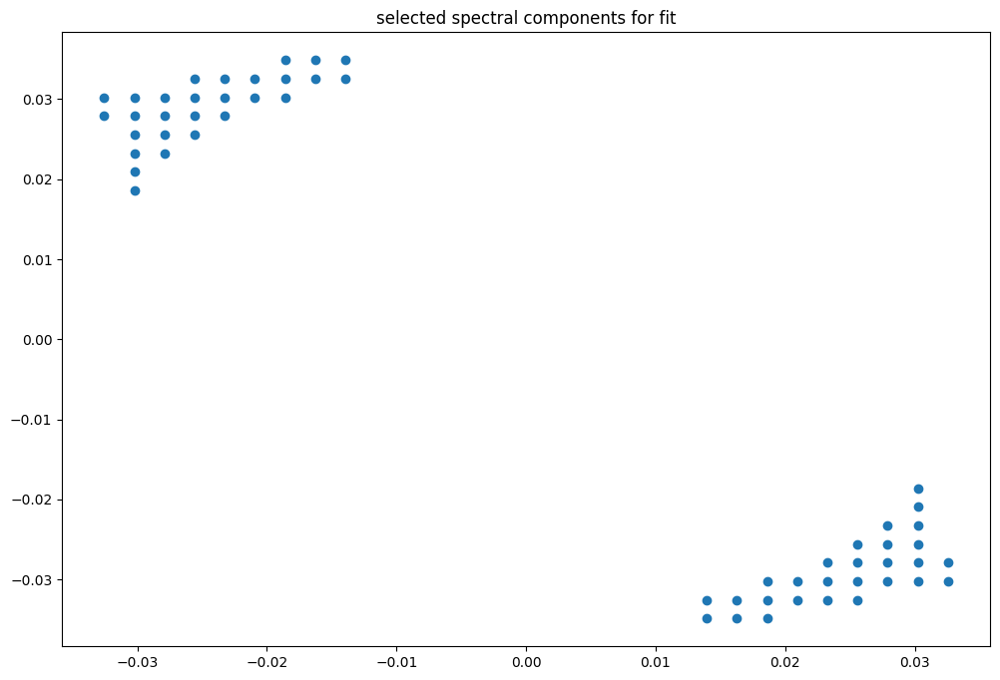

box [4000, 4700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

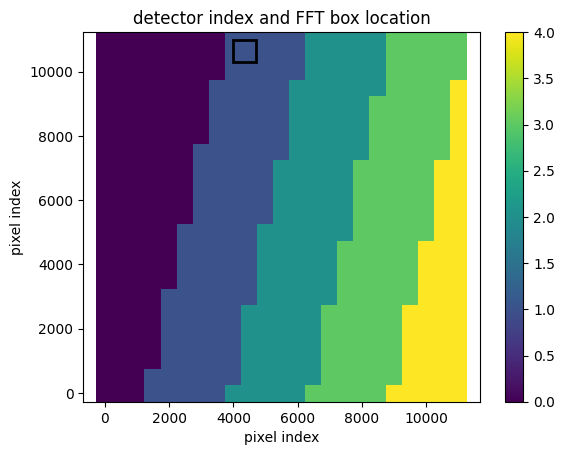

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 42)
(43, 42)
(43, 42)


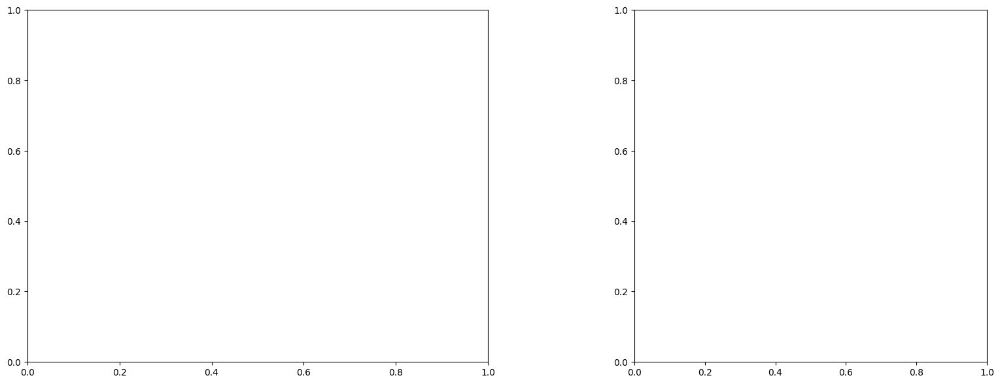

U and V components of current : [ 0.91558415 -0.60819321]
uncertainties for U and V: 0.22627567547827013 0.17490355650737086


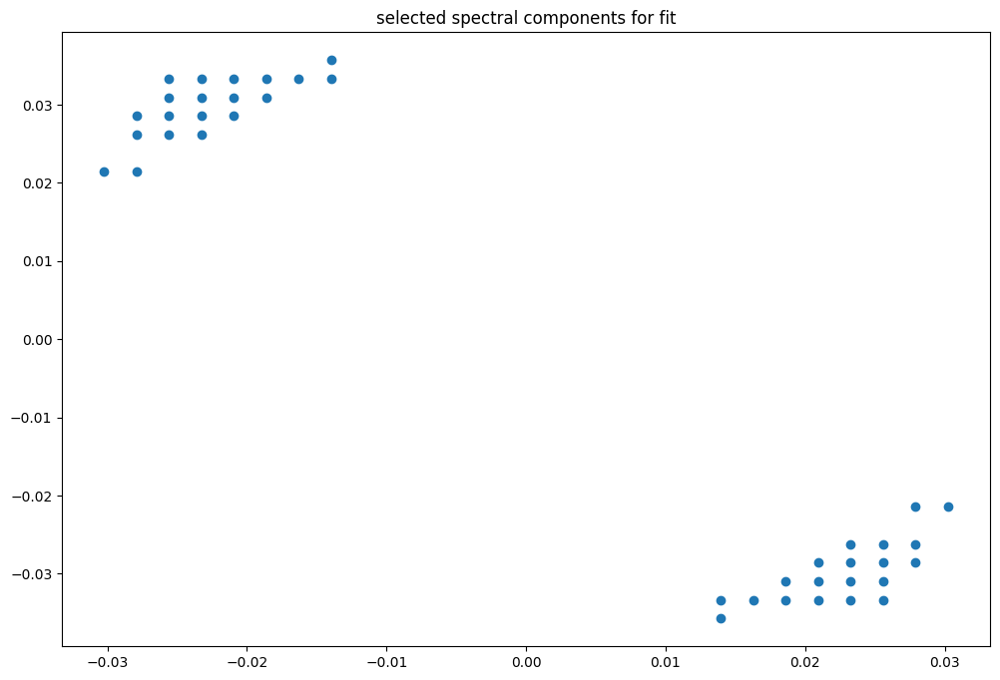

box [4500, 5200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

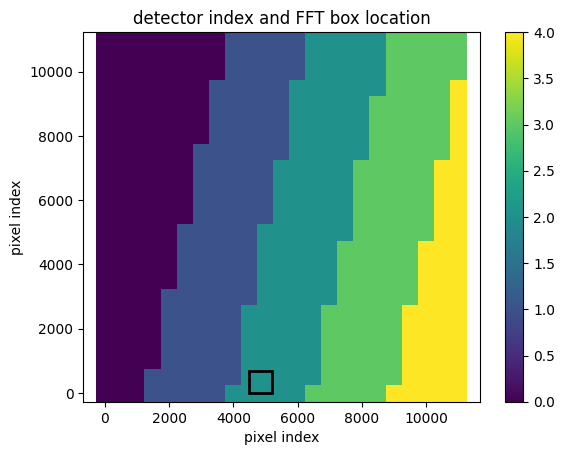

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(43, 43)
(43, 43)
(43, 43)


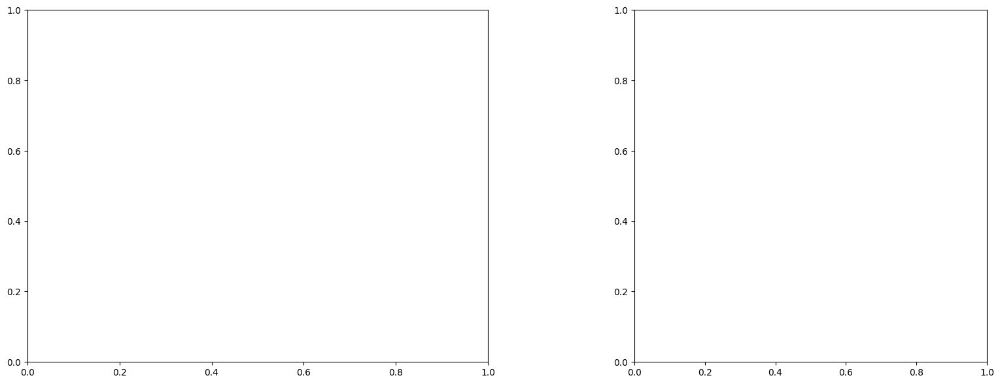

U and V components of current : [-0.03281218 -0.91700171]
uncertainties for U and V: 0.05861468488391535 0.060967075906646365


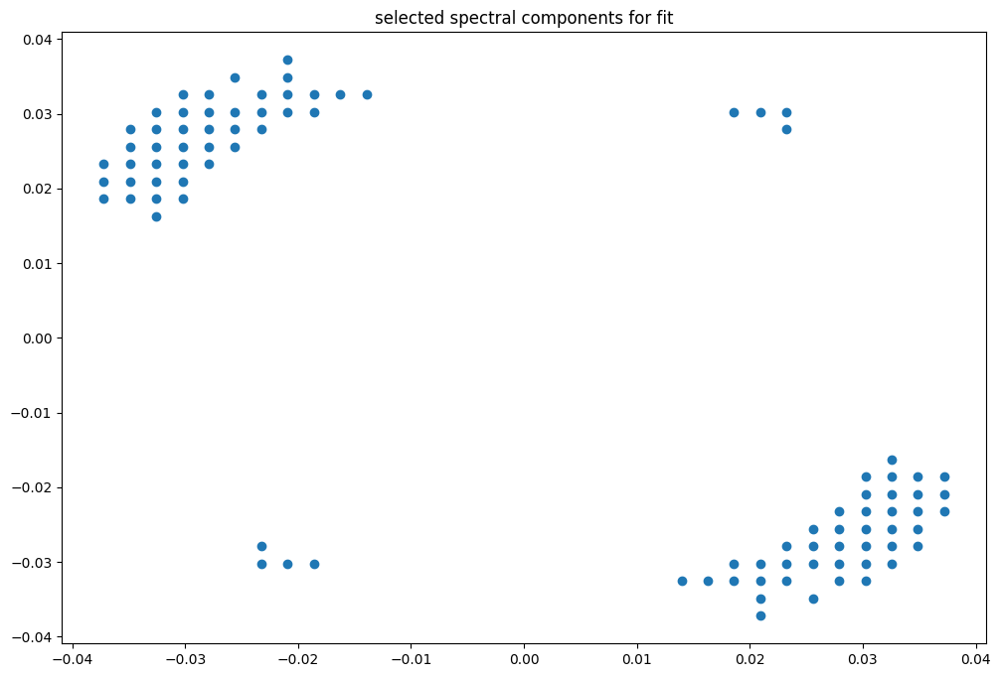

box [4500, 5200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

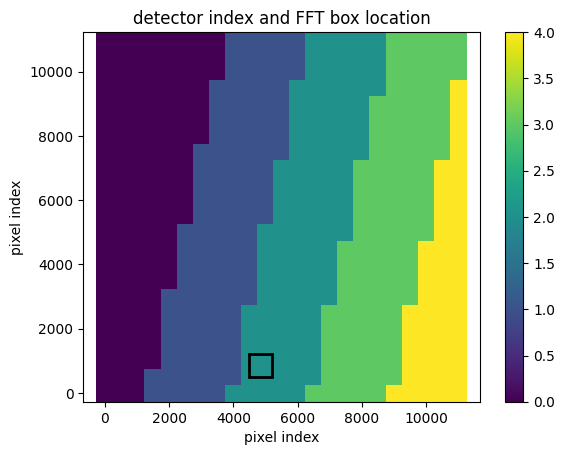

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


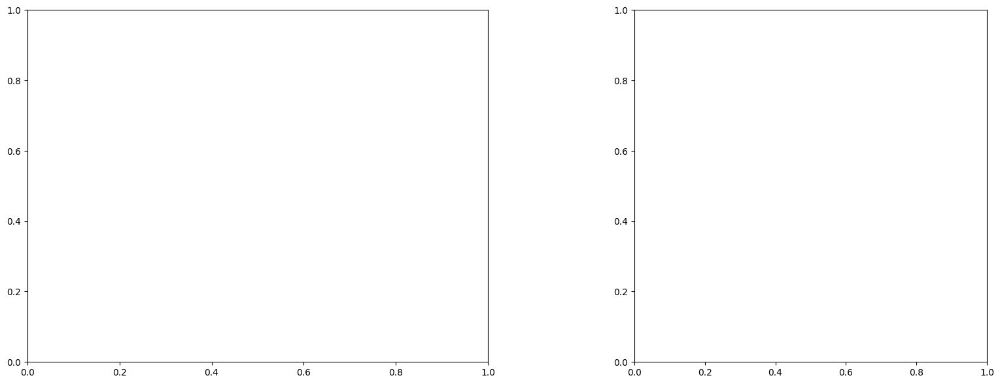

U and V components of current : [ 0.9024215  -0.26059138]
uncertainties for U and V: 0.10729293358963554 0.11248444169840313


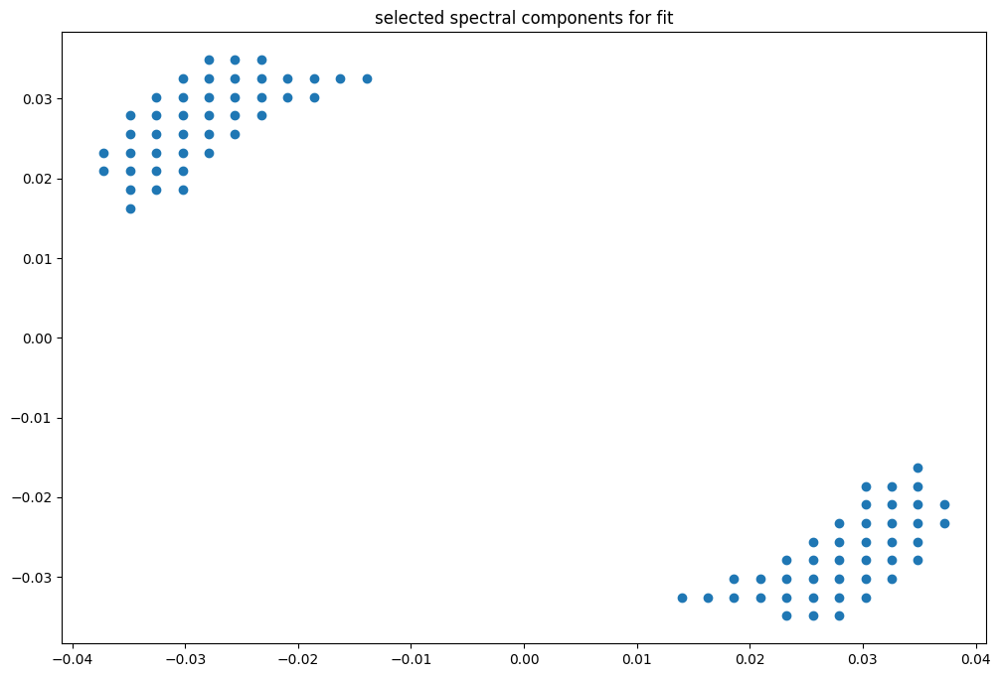

box [4500, 5200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

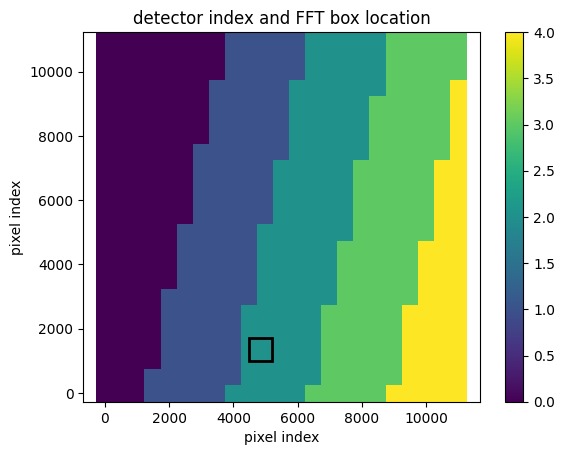

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


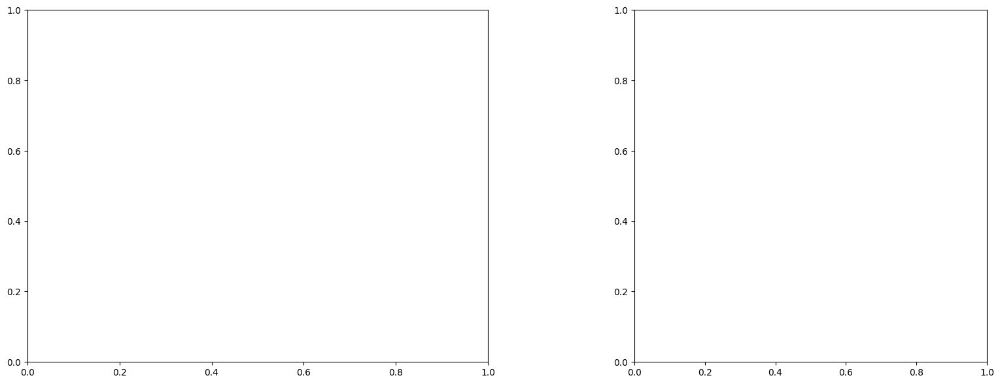

U and V components of current : [ 0.11978147 -1.2663632 ]
uncertainties for U and V: 0.07721646253085887 0.0806040423026674


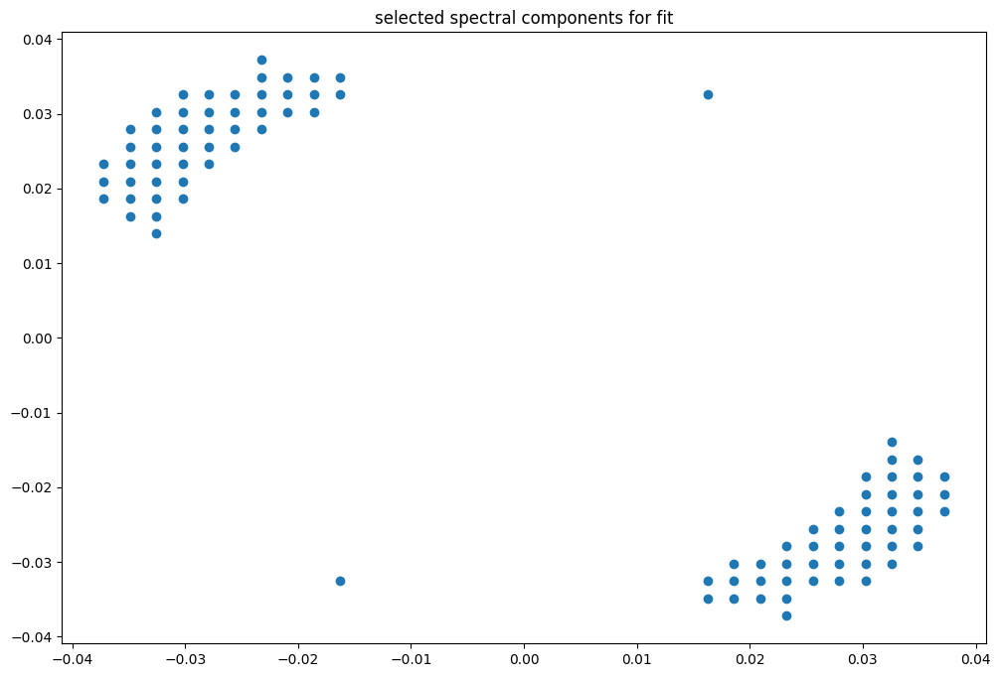

box [4500, 5200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

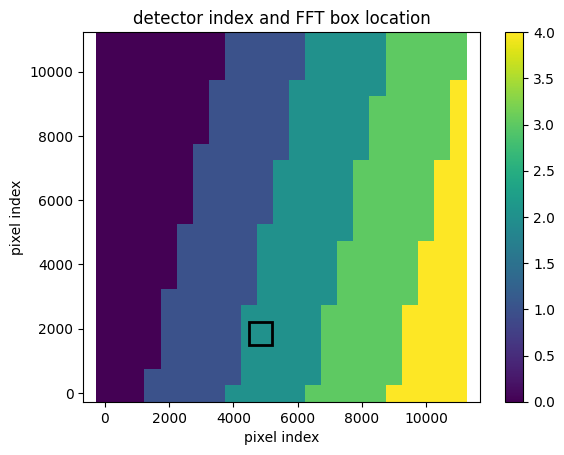

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


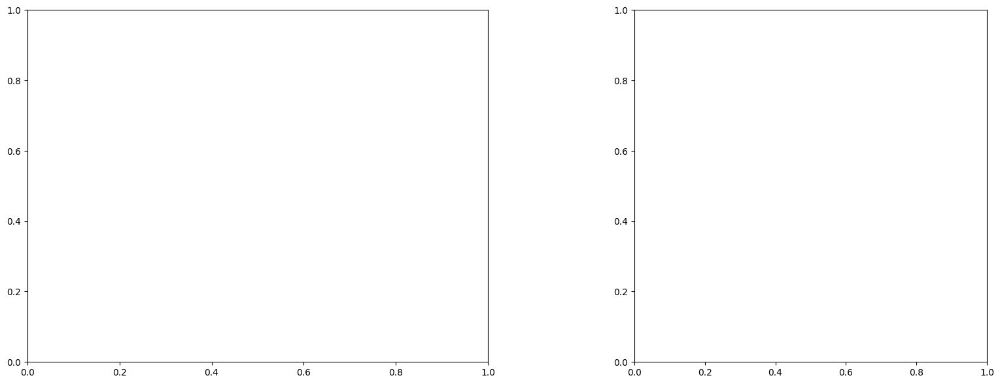

U and V components of current : [ 0.62679972 -0.37269976]
uncertainties for U and V: 0.0946767418886799 0.10852655583753253


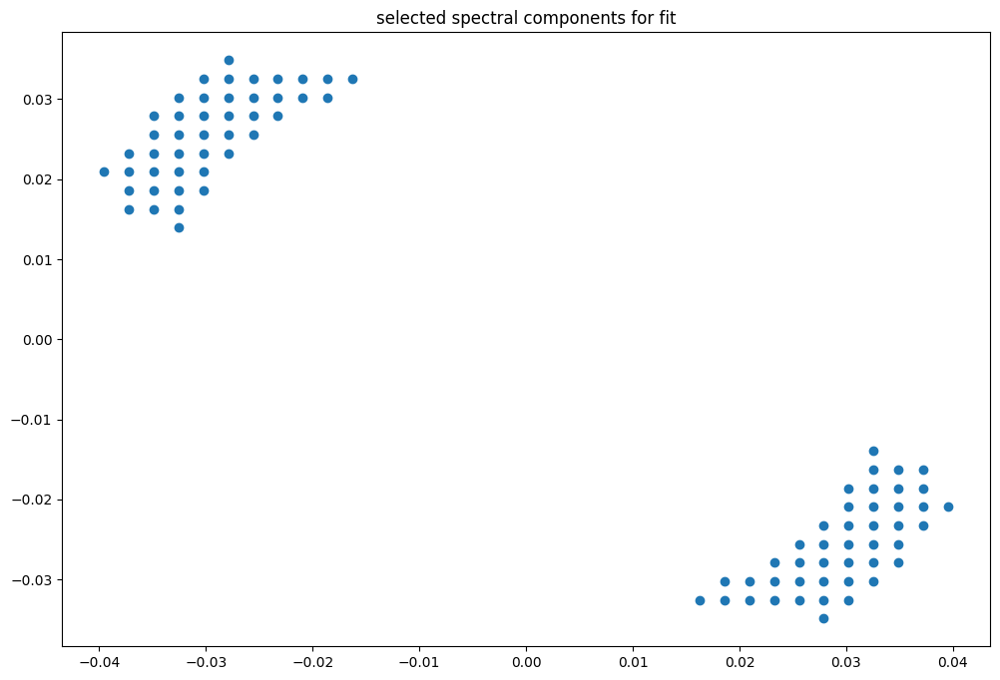

box [4500, 5200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

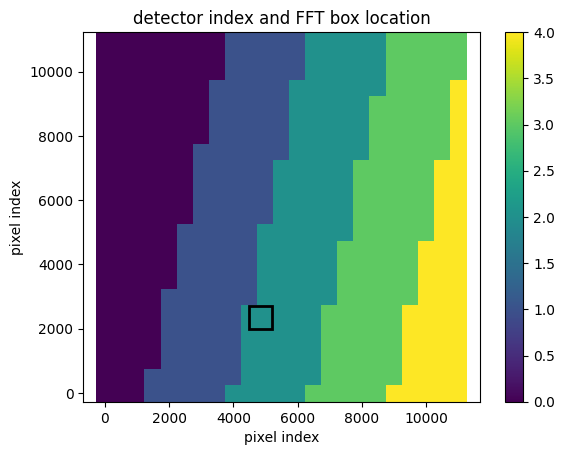

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


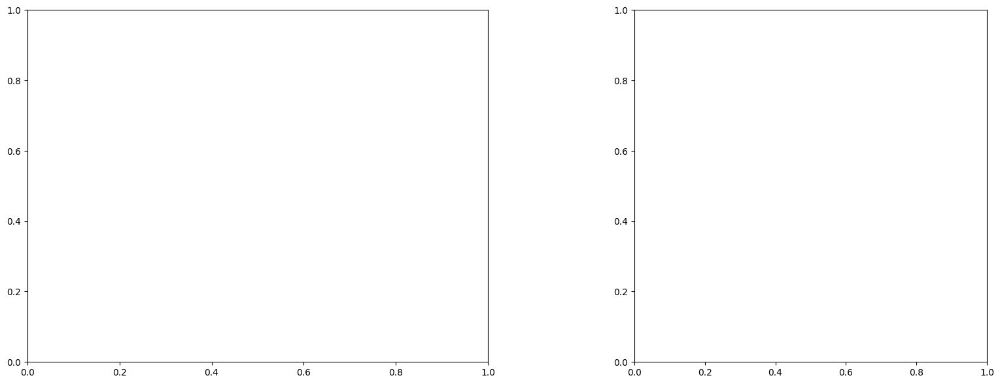

LinAlgError: Singular matrix

box [4500, 5200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

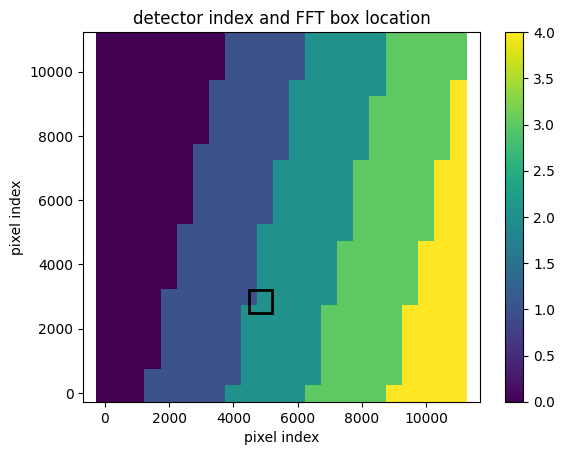

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


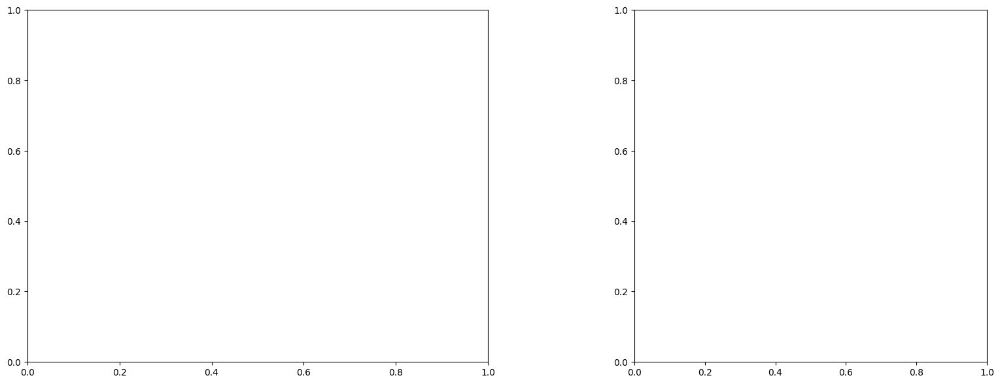

LinAlgError: Singular matrix

box [4500, 5200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

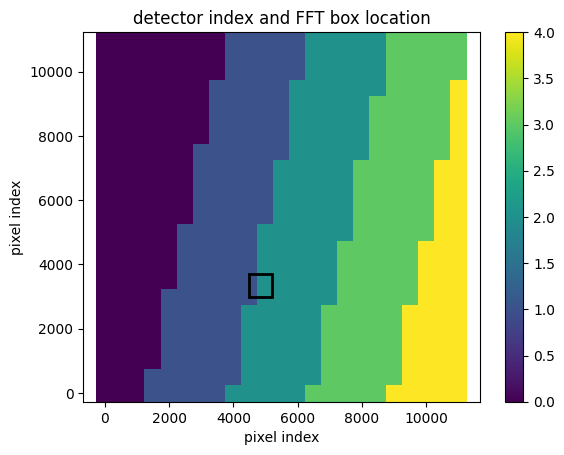

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


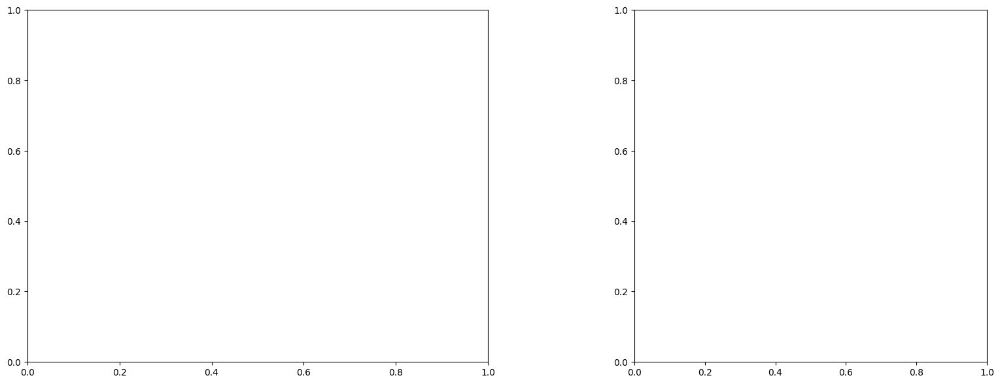

LinAlgError: Singular matrix

box [4500, 5200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

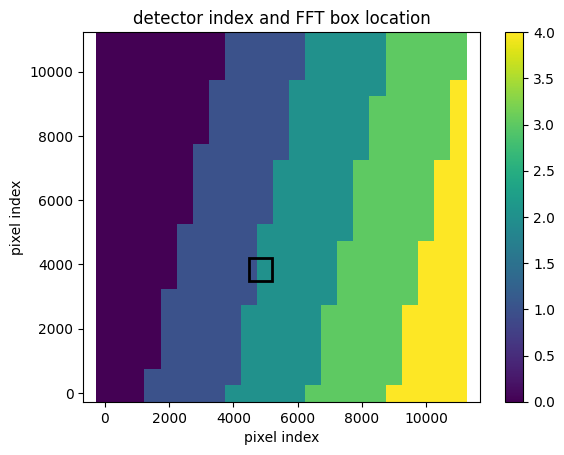

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


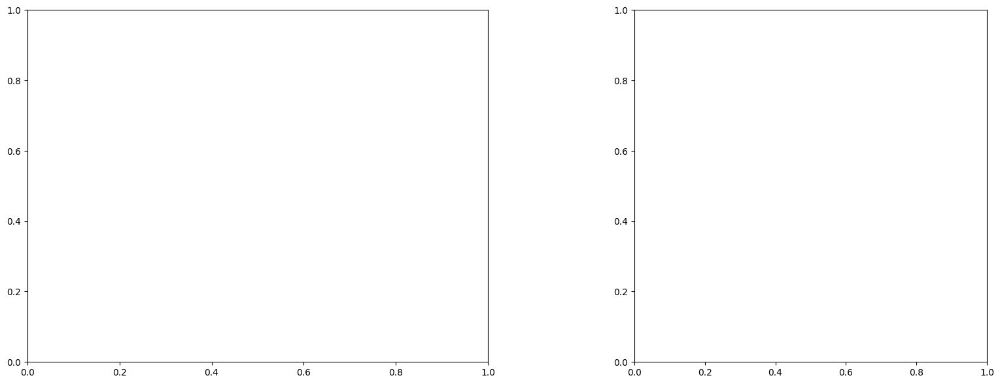

LinAlgError: Singular matrix

box [4500, 5200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

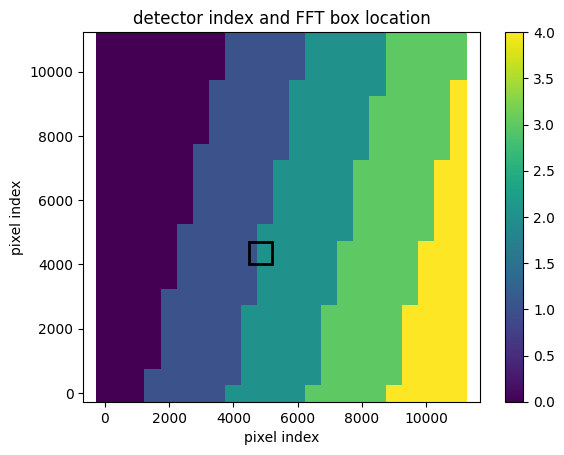

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


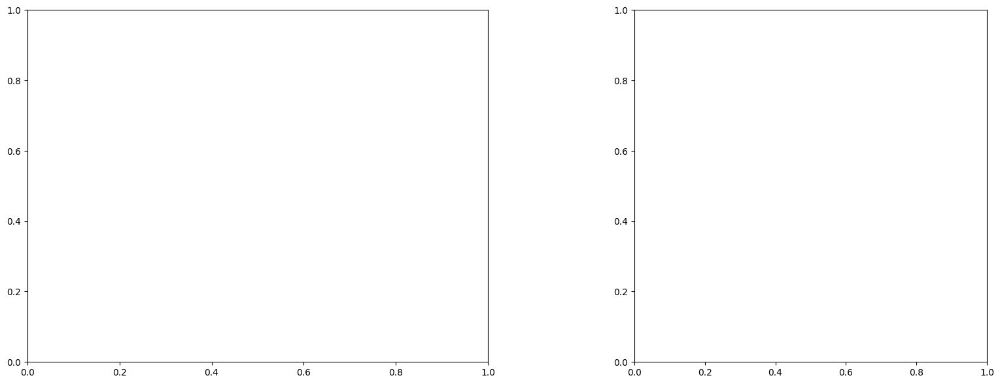

LinAlgError: Singular matrix

box [4500, 5200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

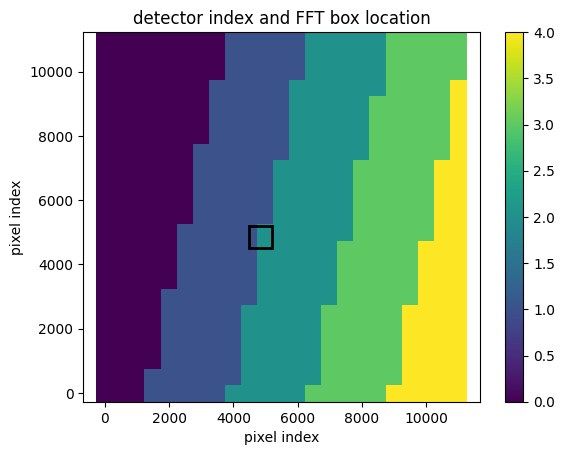

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


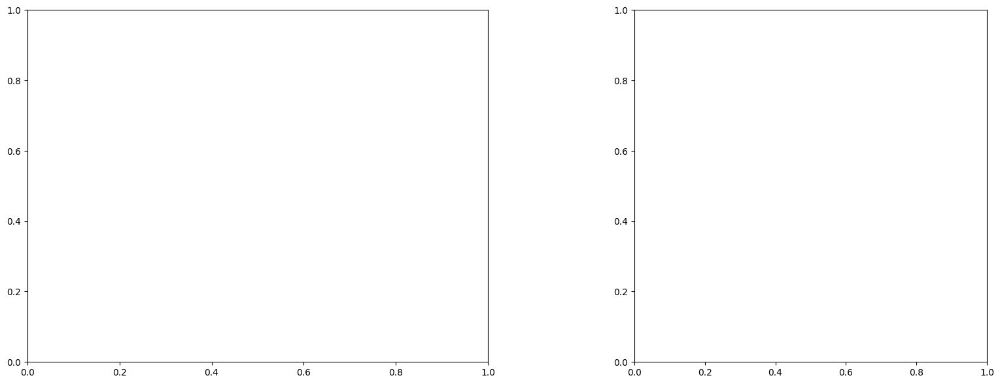

U and V components of current : [0.35783192 1.05013837]
uncertainties for U and V: 0.34882274437935507 0.3539792473445138


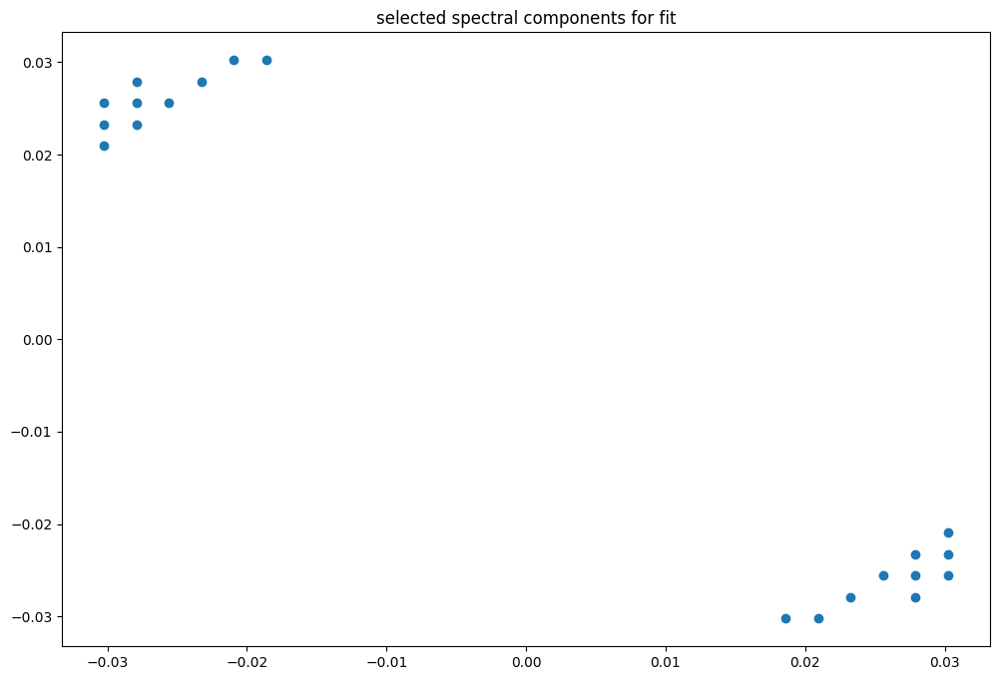

box [4500, 5200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

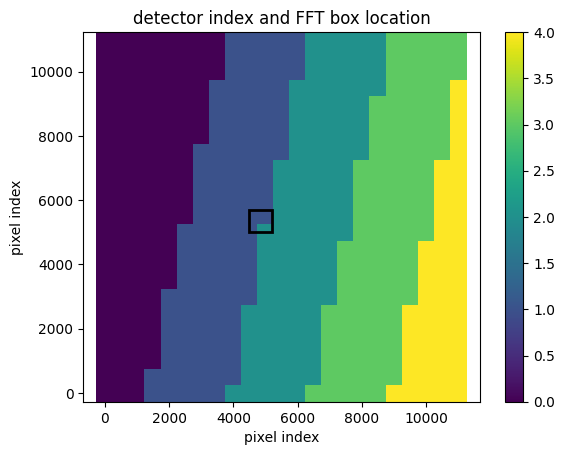

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.26
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


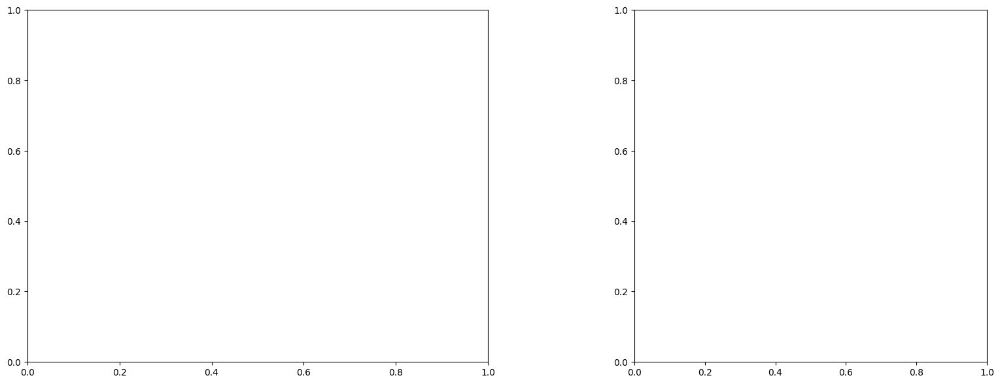

U and V components of current : [-0.11592127 -0.74068949]
uncertainties for U and V: 0.0771234754788364 0.08213856802401828


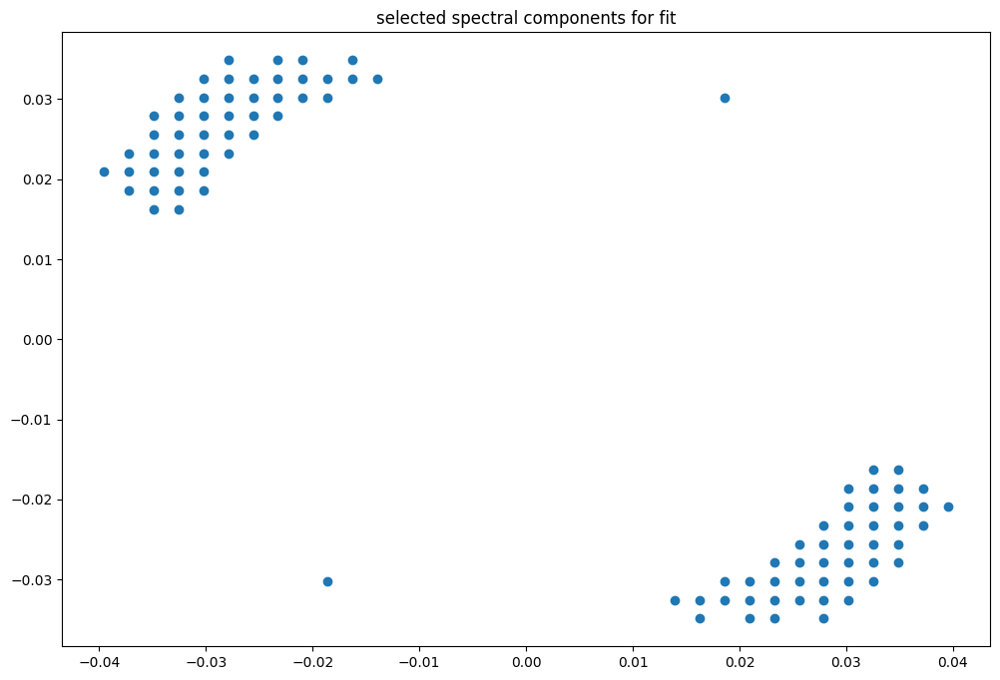

box [4500, 5200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

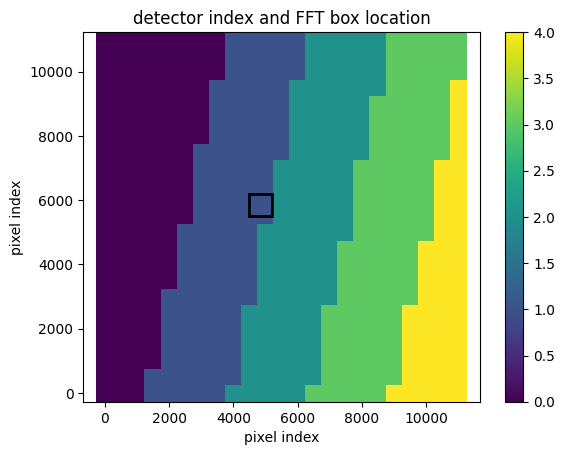

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007577735349925
(43, 43)
(43, 43)
(43, 43)


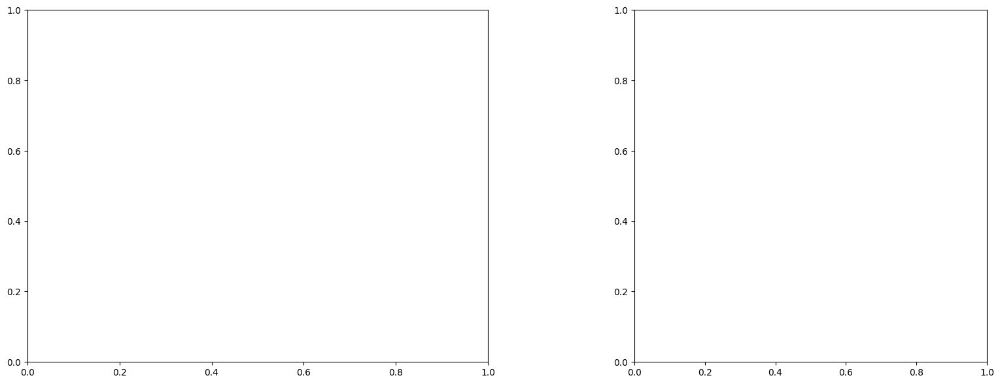

U and V components of current : [ 0.37733421 -0.87344224]
uncertainties for U and V: 0.09946166768449788 0.1047360957297819


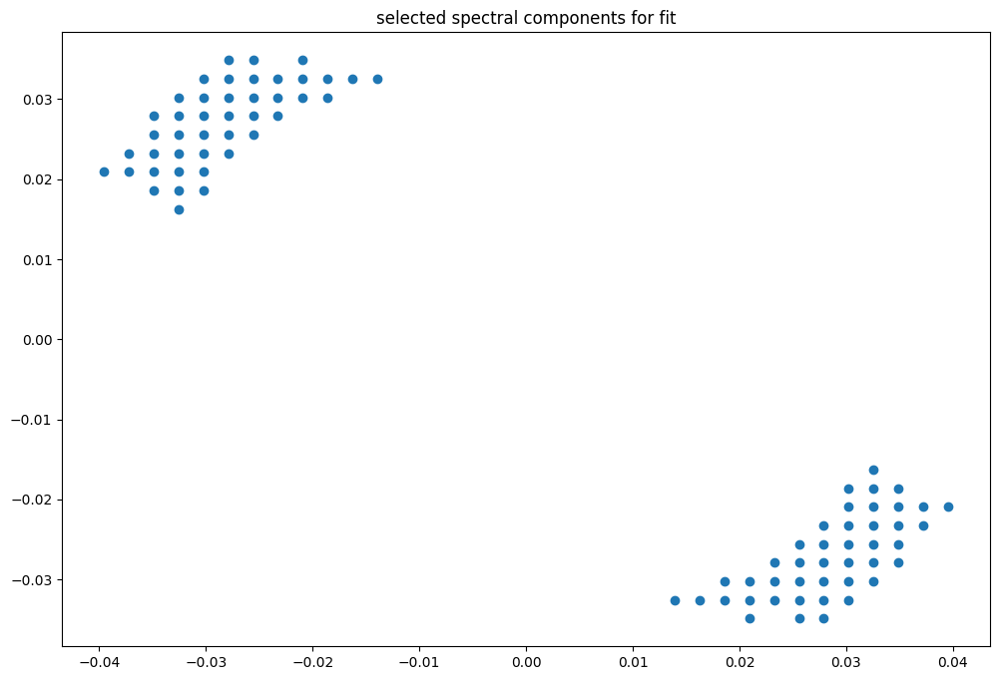

box [4500, 5200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

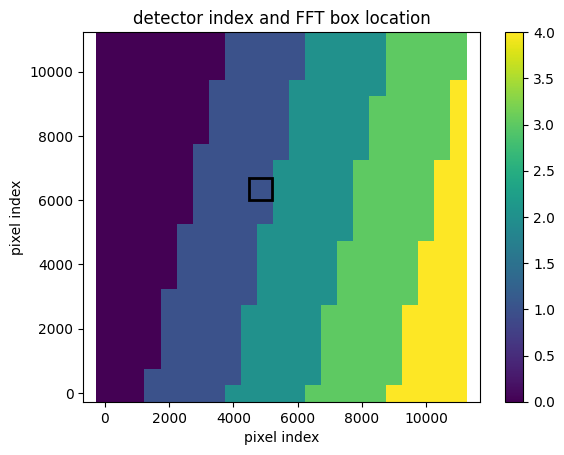

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075756068647472
(43, 43)
(43, 43)
(43, 43)


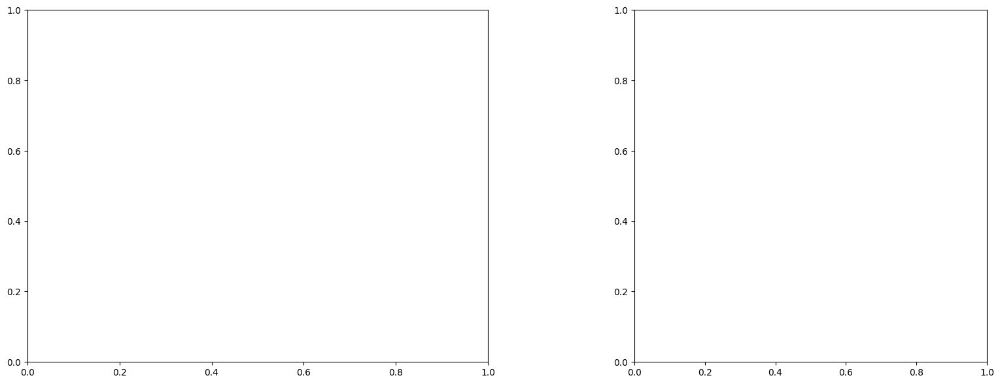

U and V components of current : [ 0.03070196 -1.10840216]
uncertainties for U and V: 0.07972882298408848 0.0842287849458097


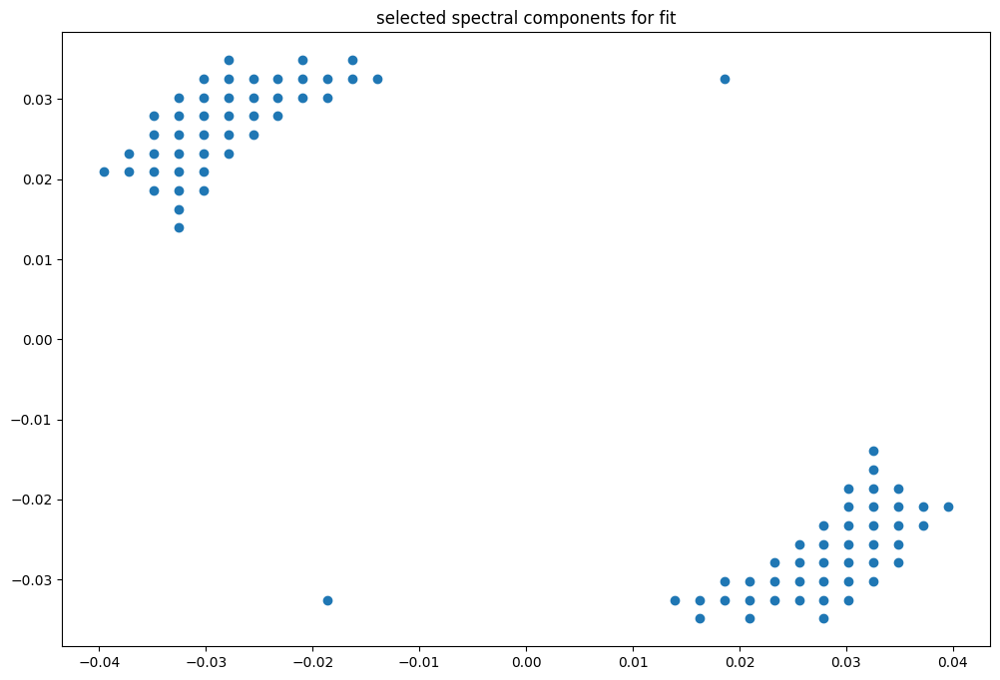

box [4500, 5200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

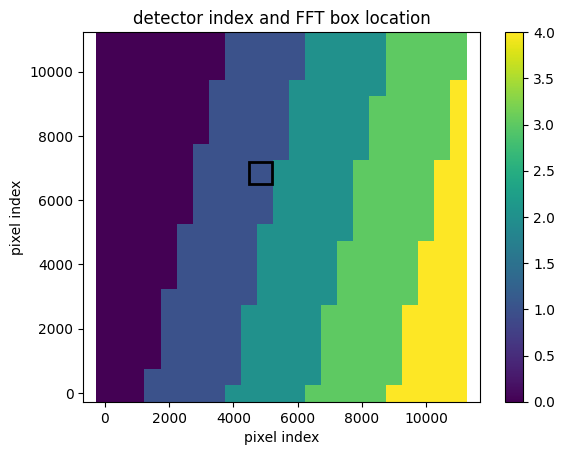

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075731631257834
(43, 43)
(43, 43)
(43, 43)


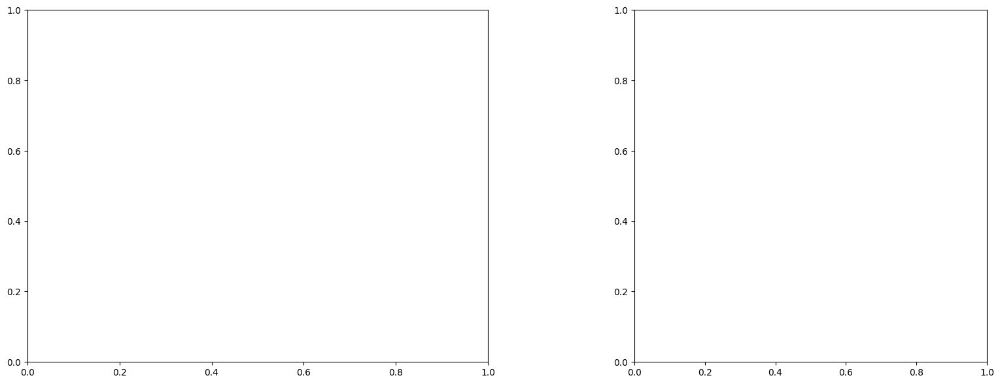

U and V components of current : [ 1.21705325e-03 -1.24742821e+00]
uncertainties for U and V: 0.12238152128437979 0.12858915804236062


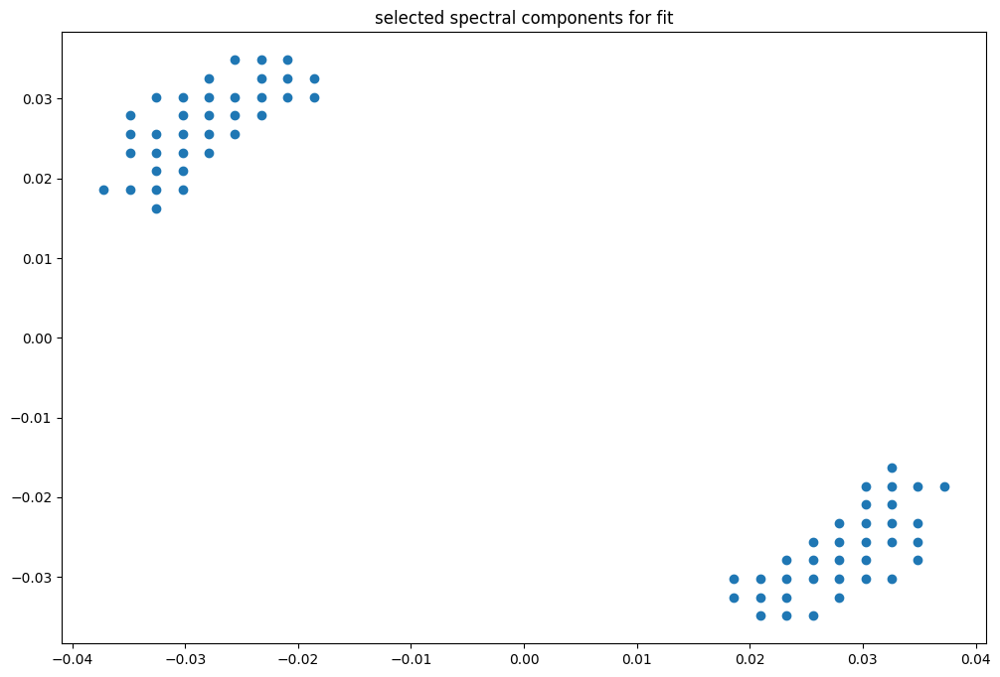

box [4500, 5200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

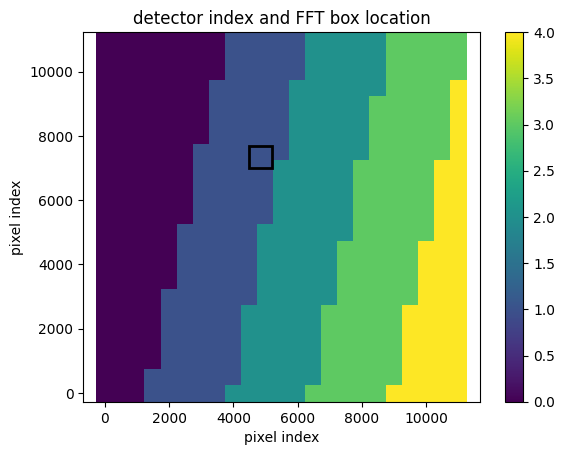

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


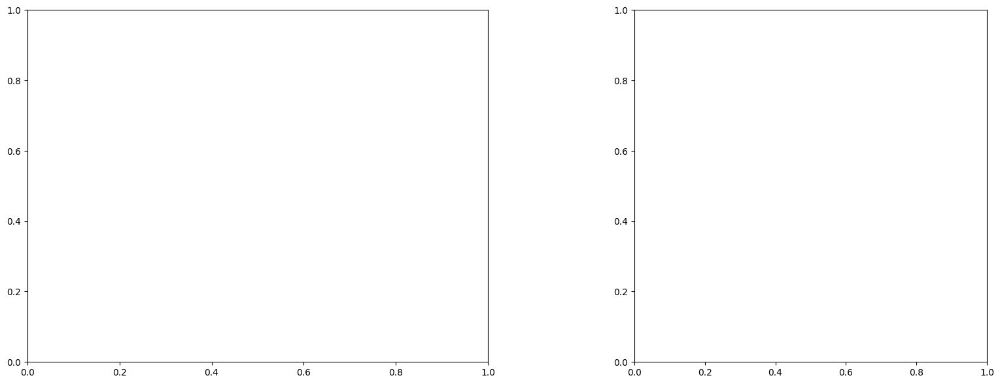

U and V components of current : [-0.0329558  -1.02830895]
uncertainties for U and V: 0.06256952444850505 0.07123467251149246


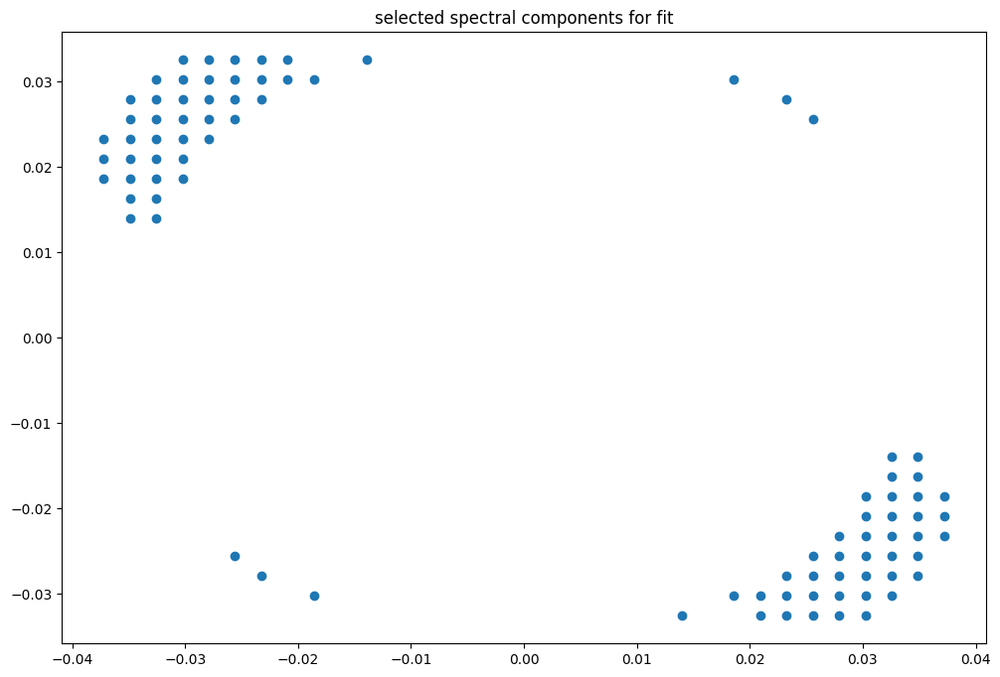

box [4500, 5200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

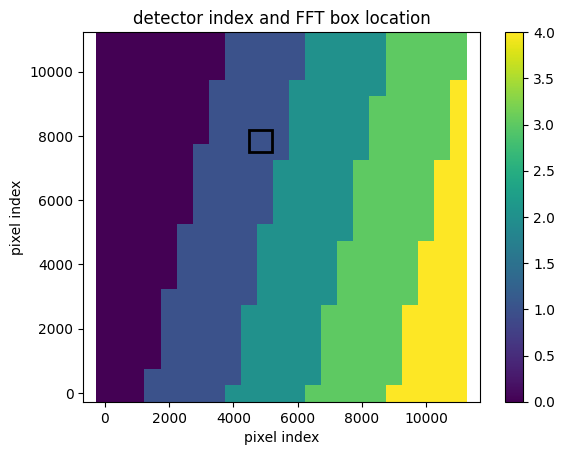

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


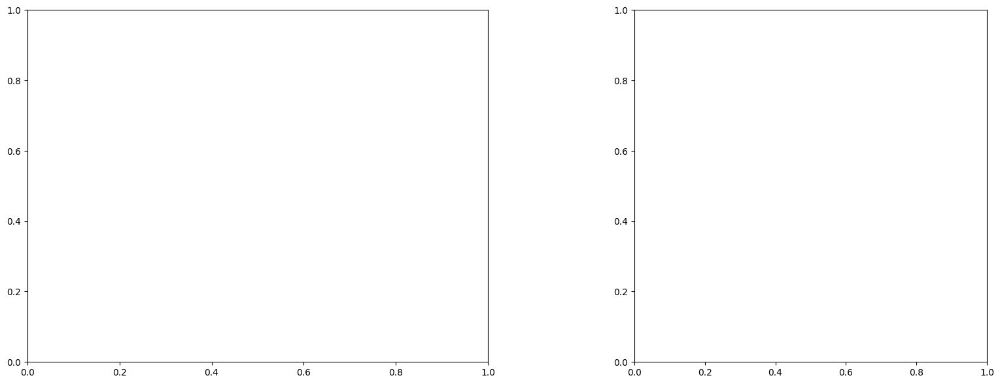

U and V components of current : [-0.27302683 -1.58291645]
uncertainties for U and V: 0.09287900586583882 0.09939622392681627


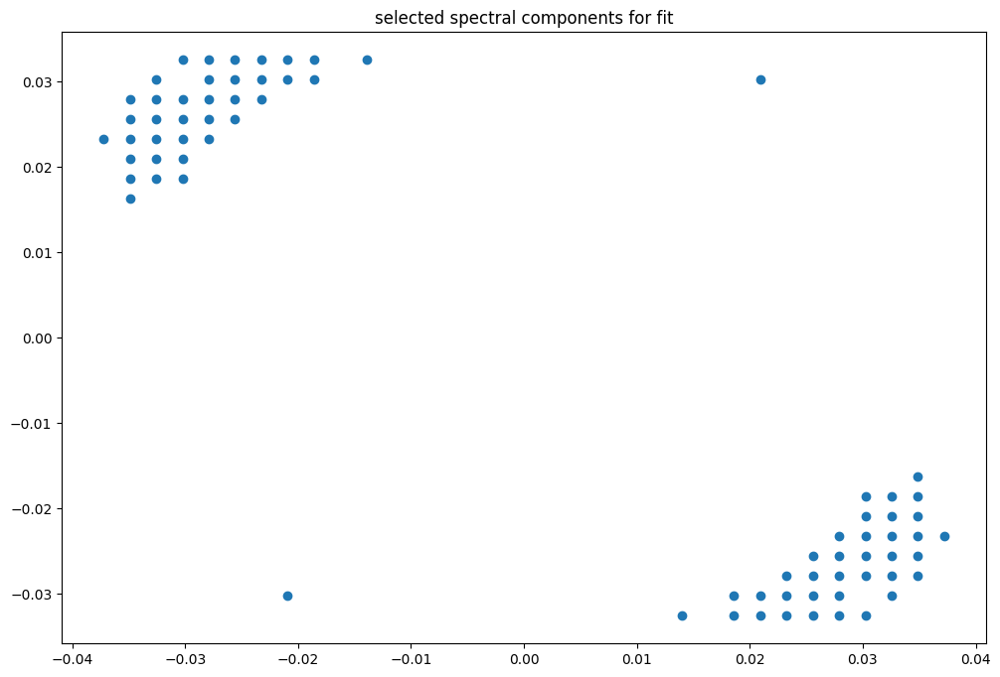

box [4500, 5200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

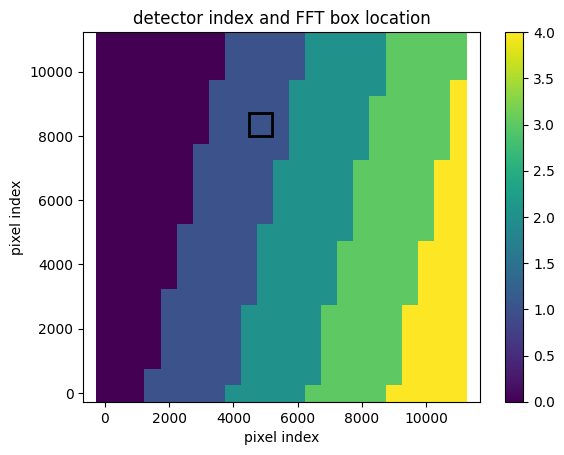

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


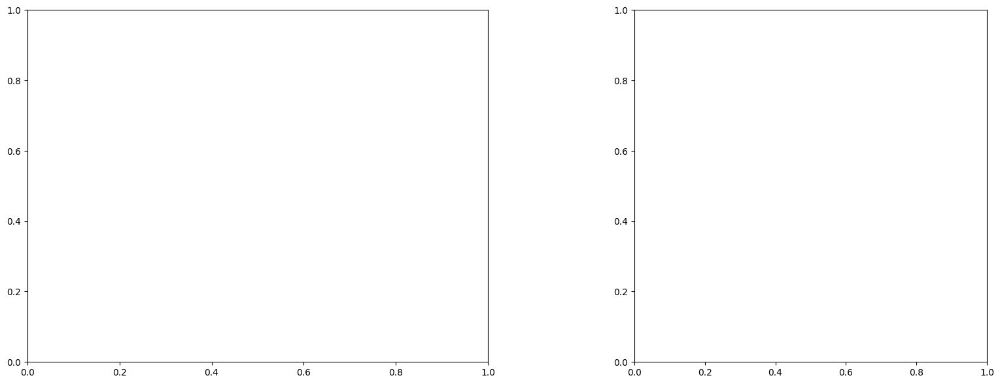

U and V components of current : [-0.26651786 -2.15737883]
uncertainties for U and V: 0.07197616704716457 0.06689684772673644


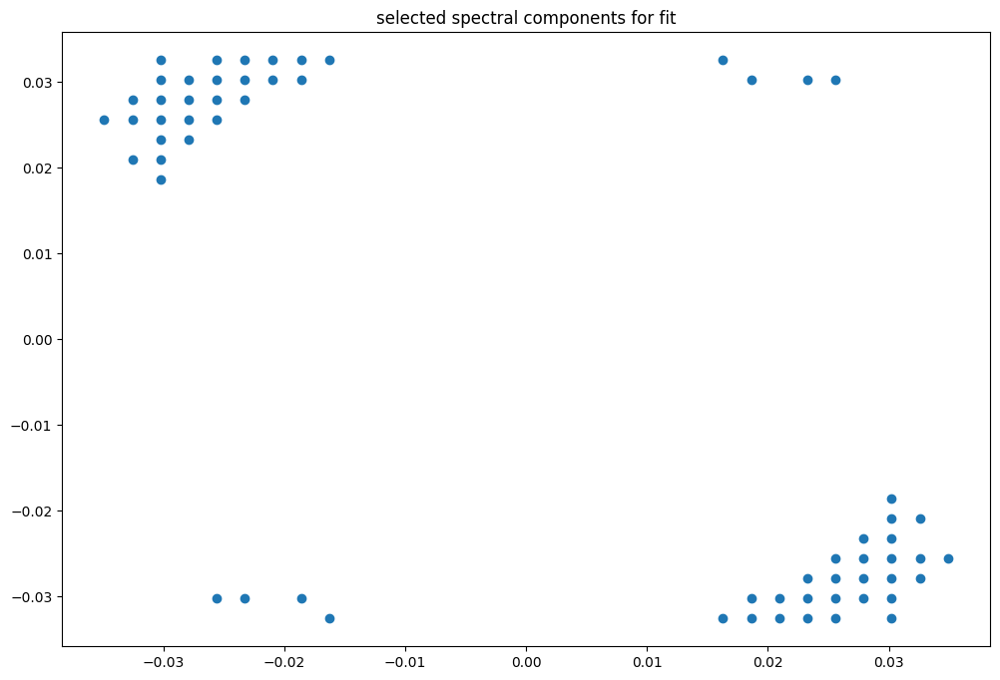

box [4500, 5200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

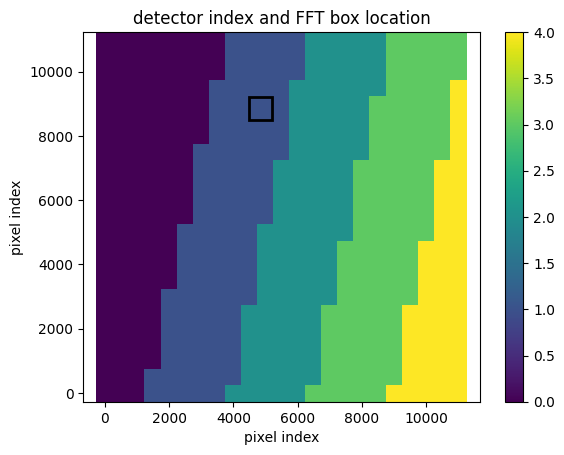

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


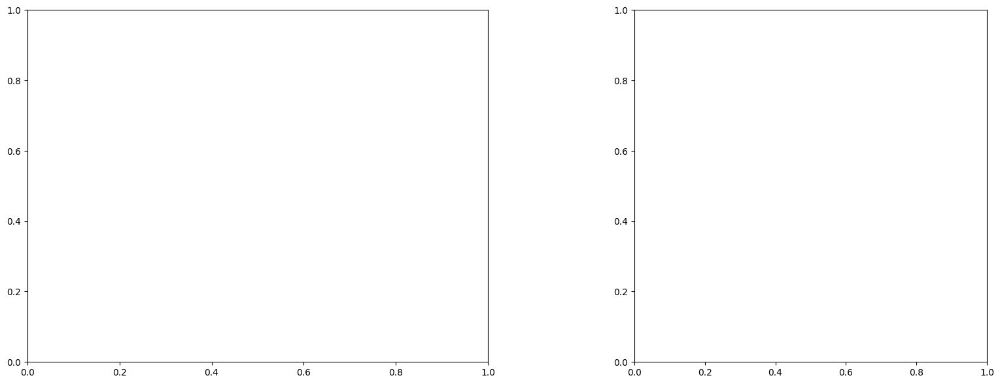

U and V components of current : [-0.41772234 -2.27585946]
uncertainties for U and V: 0.10699285192903929 0.08696099383974237


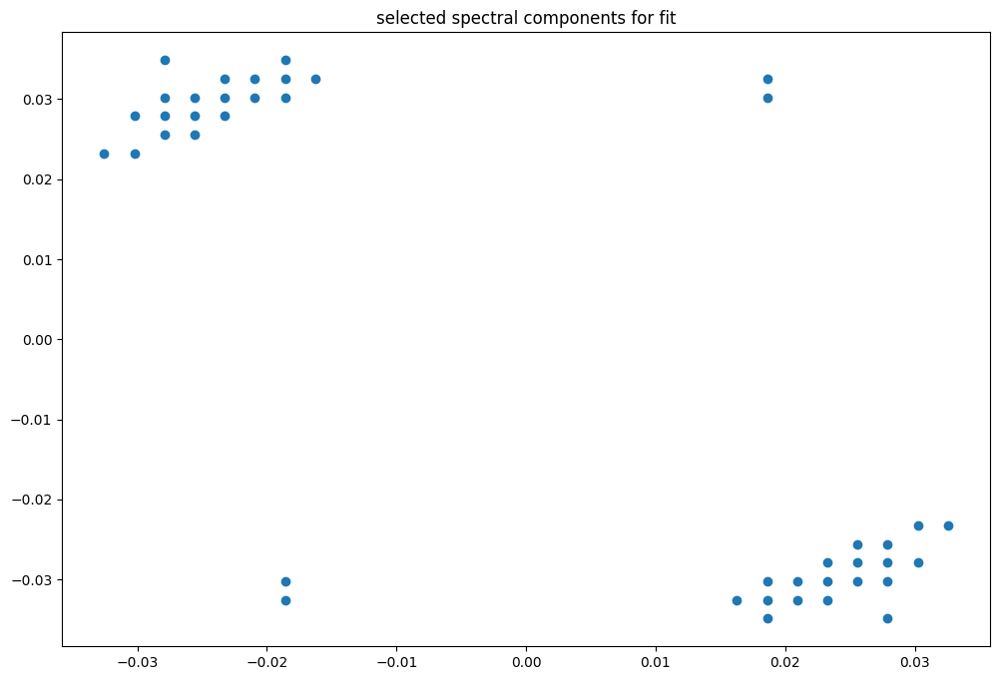

box [4500, 5200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

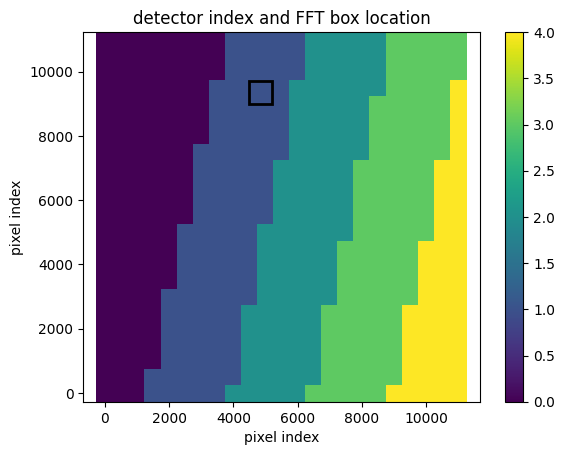

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


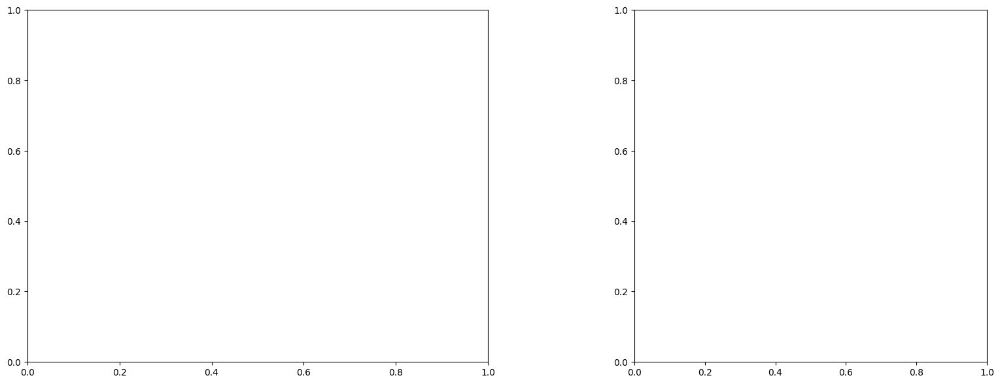

U and V components of current : [-0.58089341 -2.57111373]
uncertainties for U and V: 0.16226241674600567 0.14711381931698198


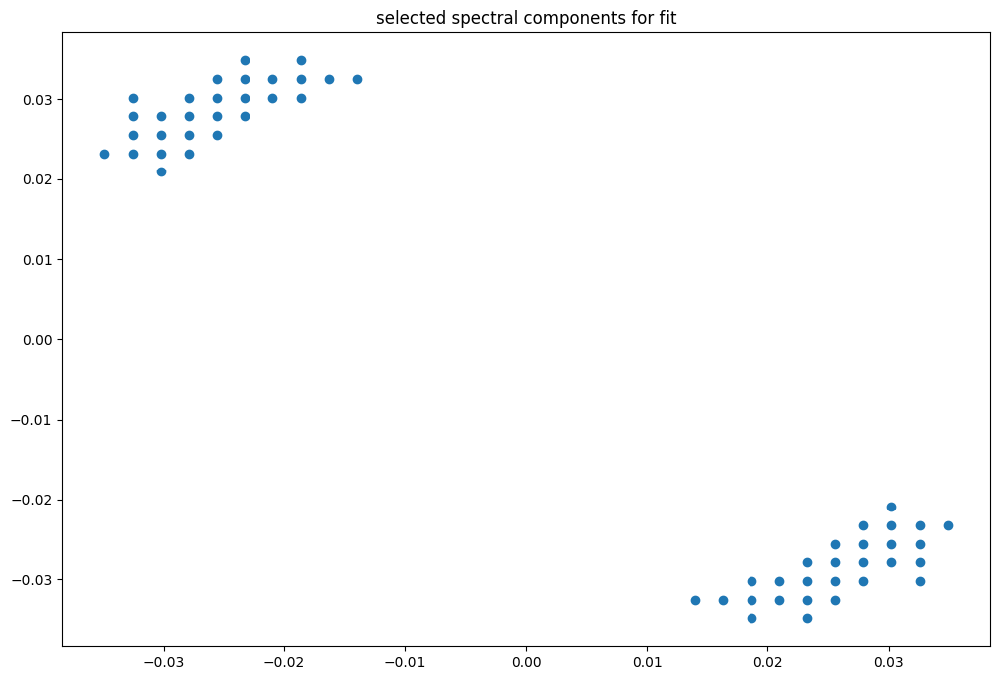

box [4500, 5200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

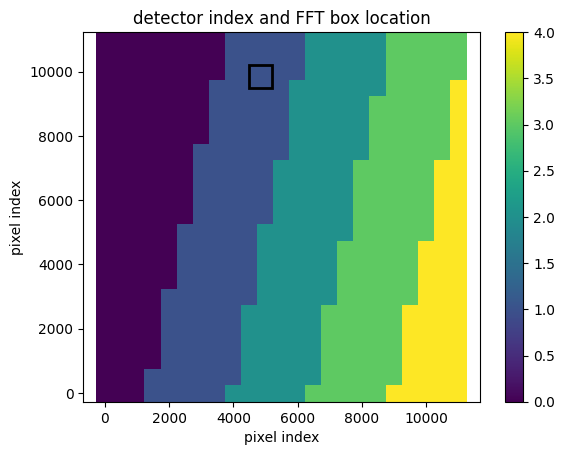

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


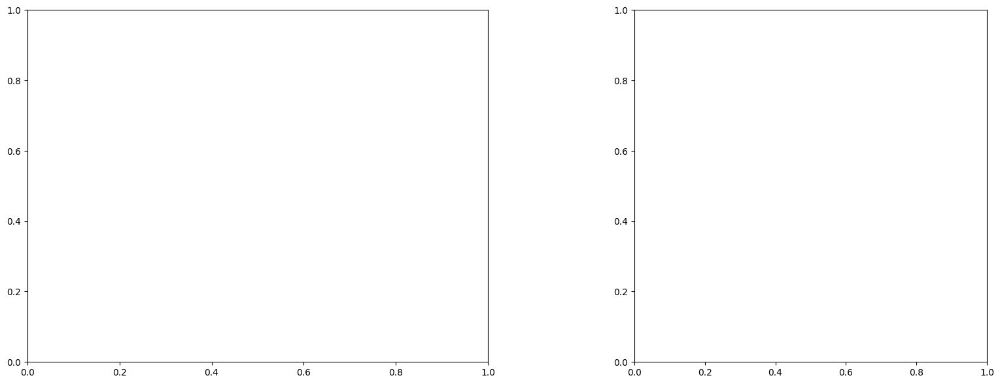

U and V components of current : [-0.01158087 -1.6305752 ]
uncertainties for U and V: 0.07850837721658302 0.07011505478250836


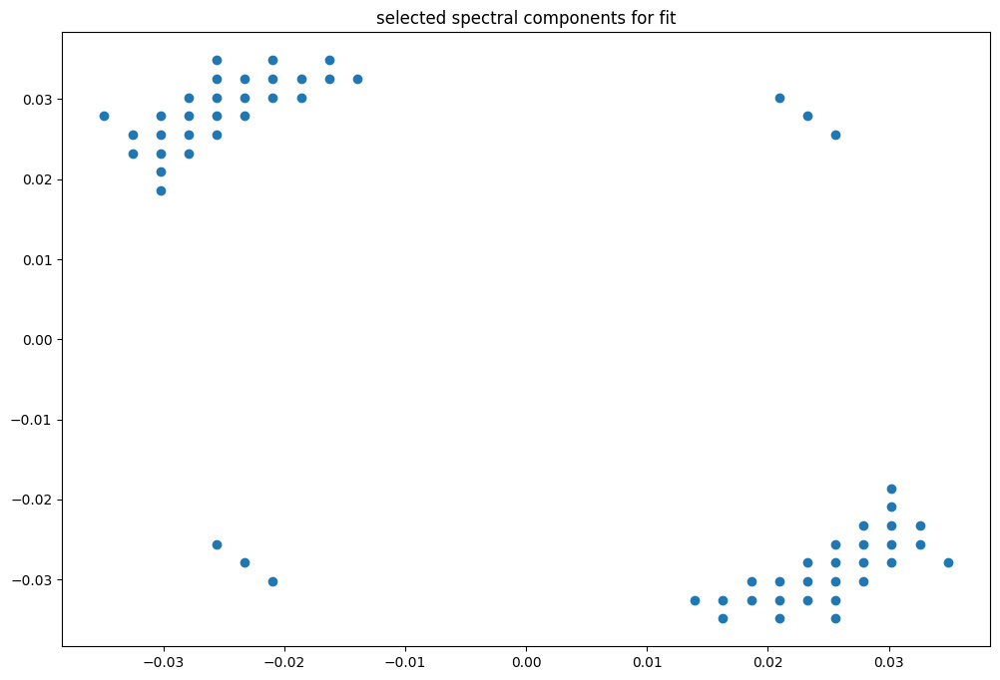

box [4500, 5200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

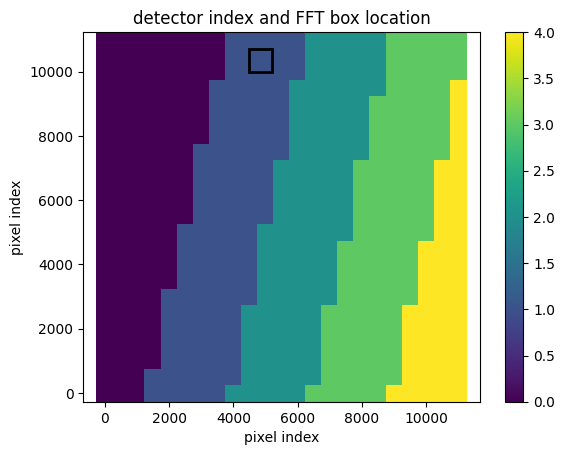

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 43)
(43, 43)
(43, 43)


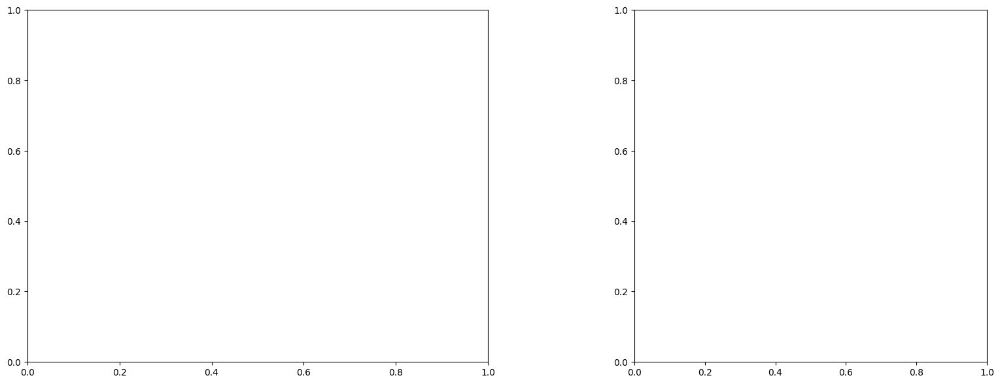

U and V components of current : [-0.45240121 -2.93907834]
uncertainties for U and V: 0.12765892838071558 0.10985527630309874


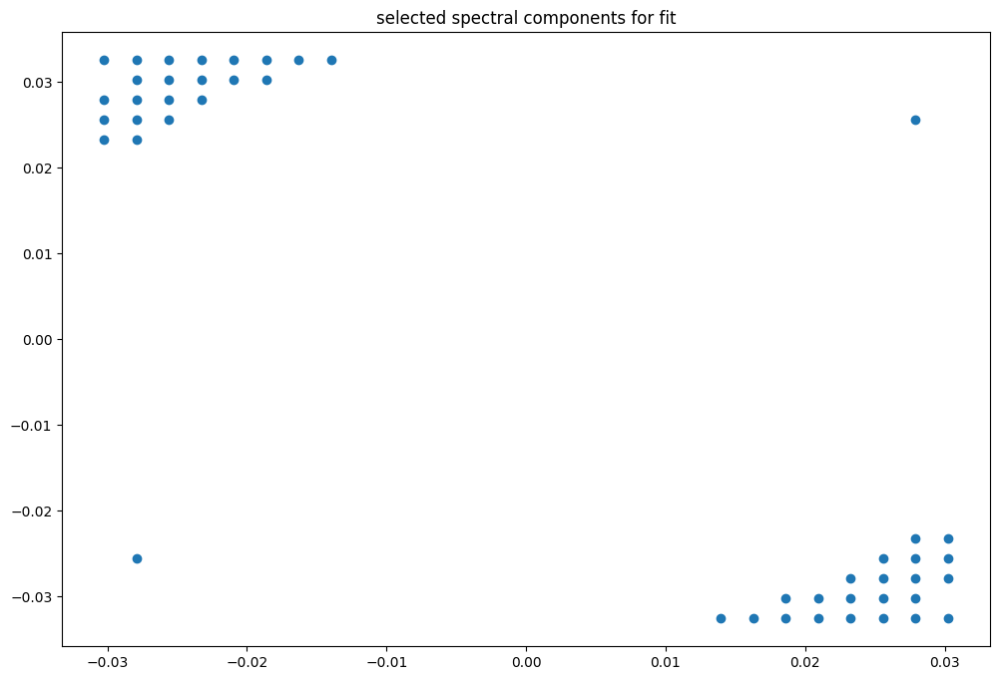

box [4500, 5200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

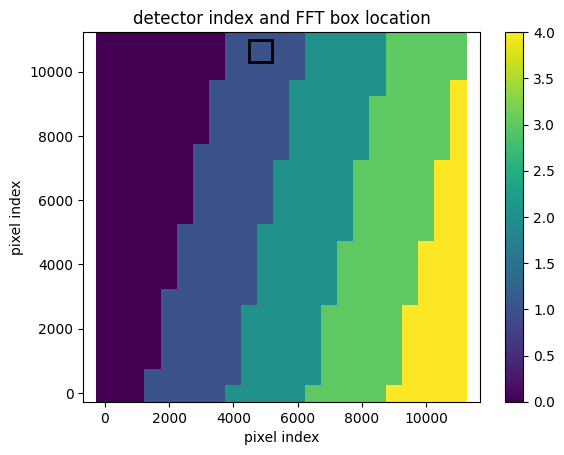

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
0.9999999999999999
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 42)
(43, 42)
(43, 42)


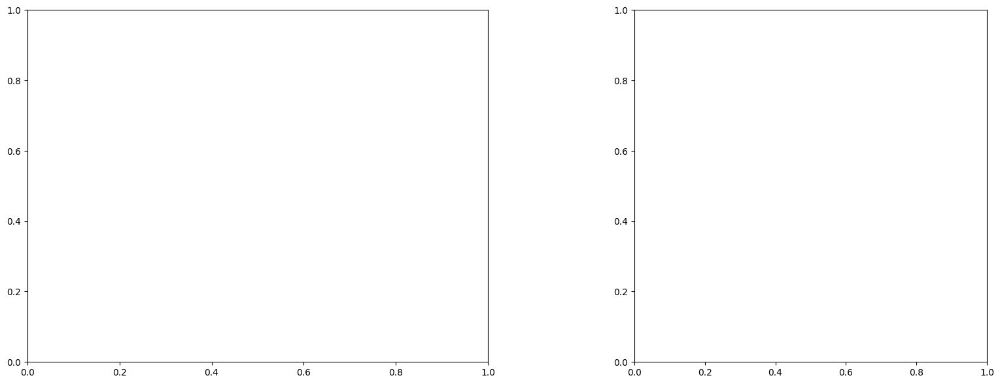

U and V components of current : [ 0.15341003 -2.65181525]
uncertainties for U and V: 0.07548263241876099 0.07592376136944289


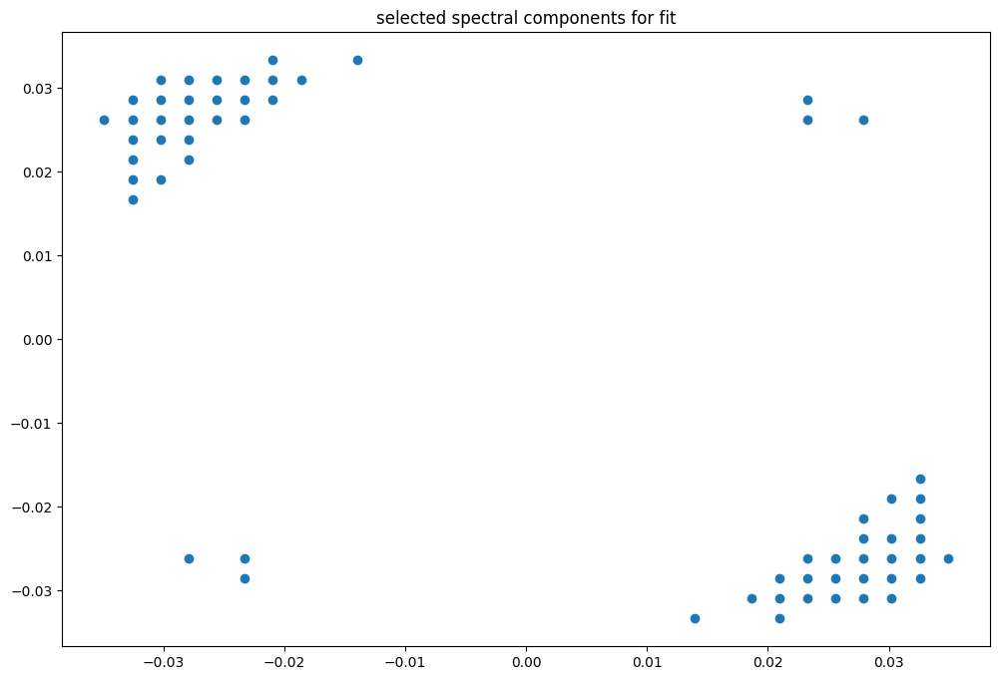

box [5000, 5700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

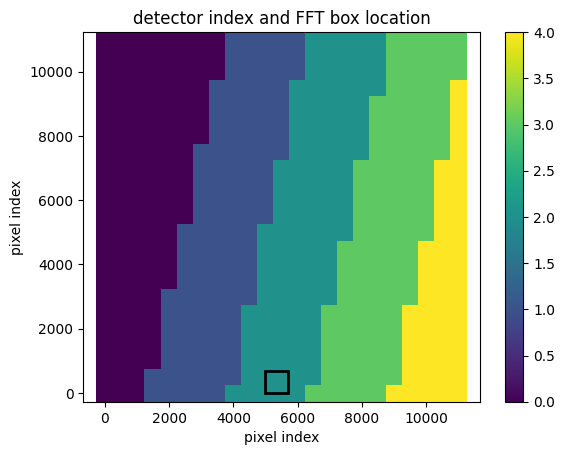

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009148440733356
(43, 43)
(43, 43)
(43, 43)


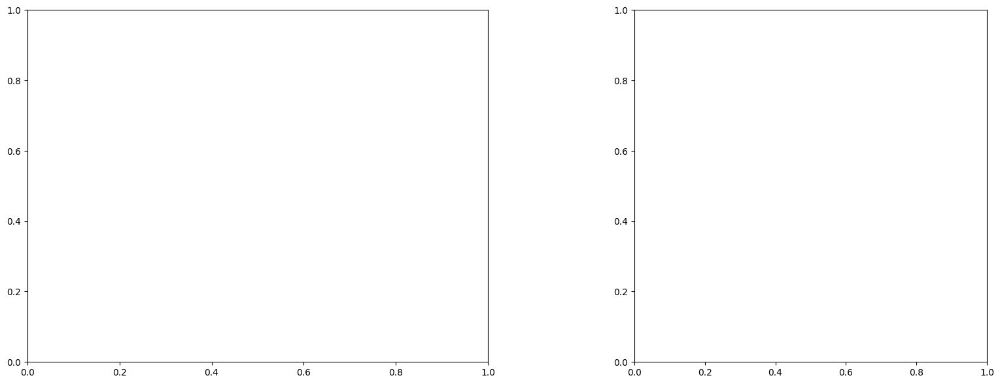

U and V components of current : [ 1.23150811 -0.79521954]
uncertainties for U and V: 0.17959668022219713 0.1843003764649952


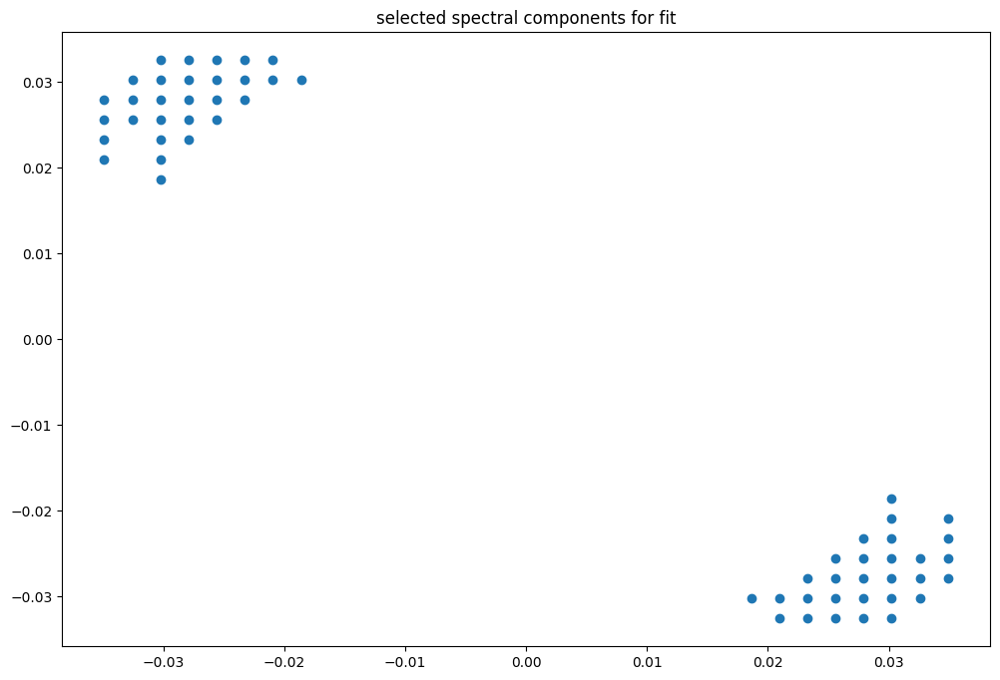

box [5000, 5700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

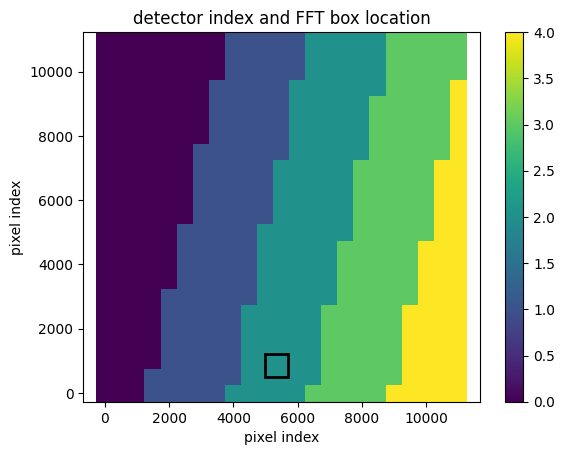

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


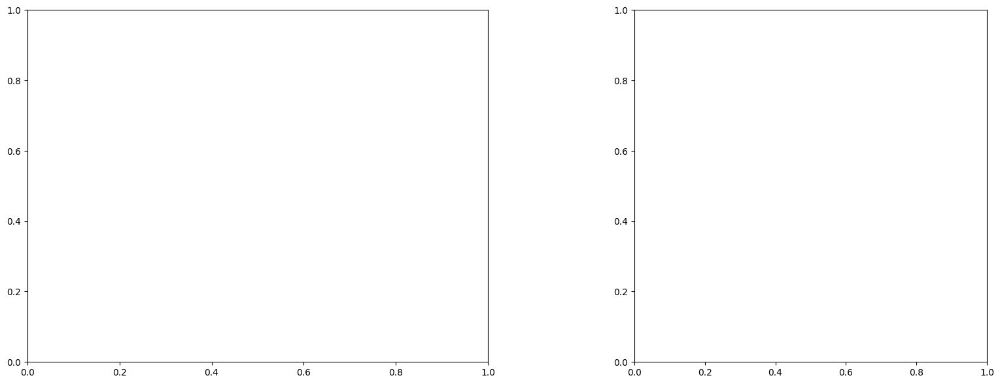

U and V components of current : [ 0.95082133 -0.76892274]
uncertainties for U and V: 0.1381101435791923 0.1433590919698411


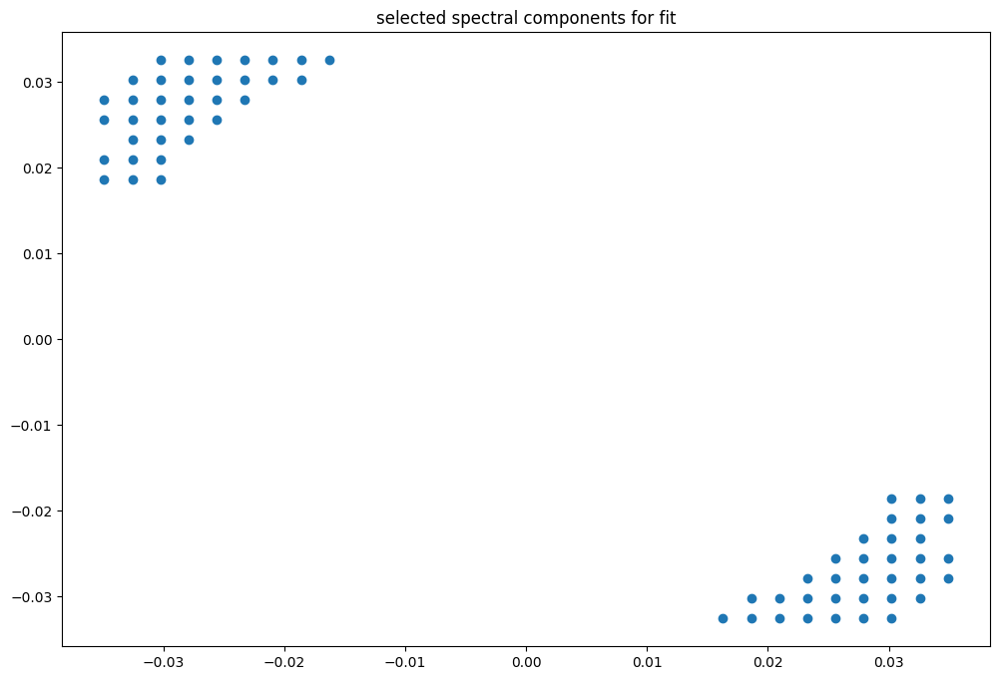

box [5000, 5700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

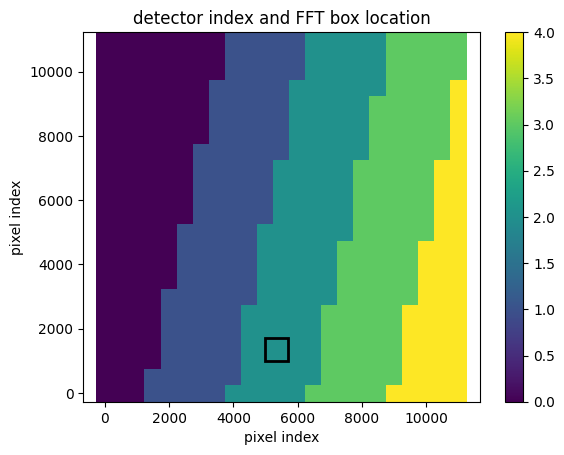

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


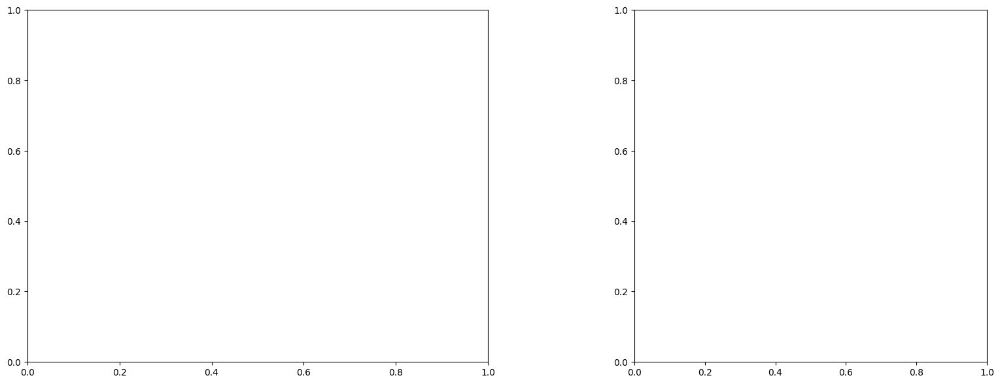

U and V components of current : [ 0.62007282 -0.7531969 ]
uncertainties for U and V: 0.1074831512612487 0.11376328473989109


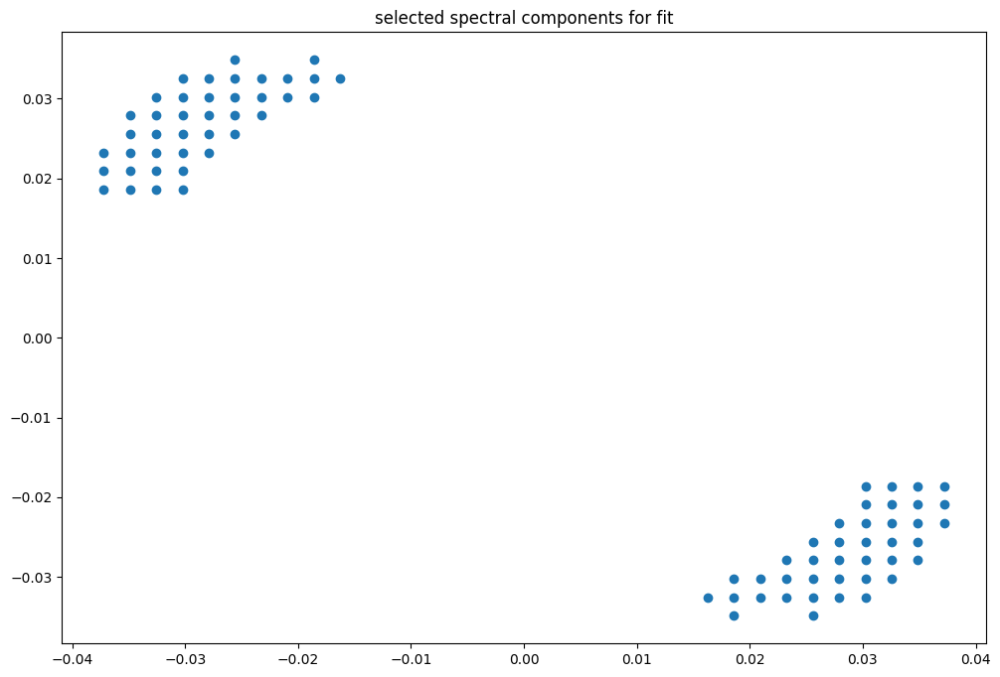

box [5000, 5700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

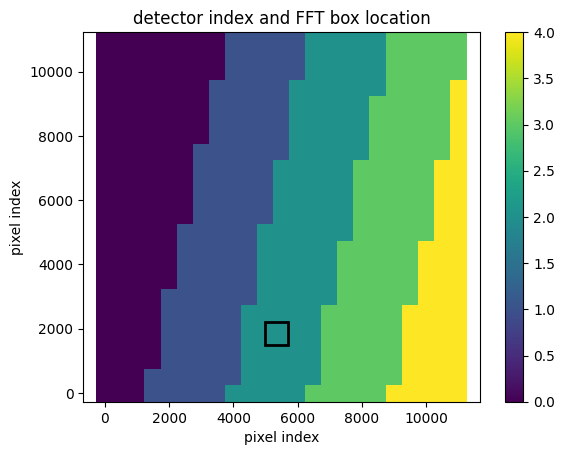

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


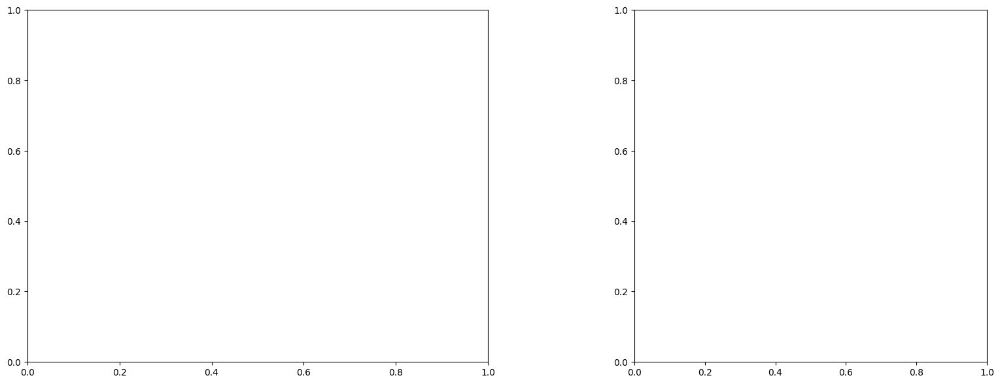

U and V components of current : [ 0.39244987 -0.82123354]
uncertainties for U and V: 0.0947718510841798 0.10588396400187267


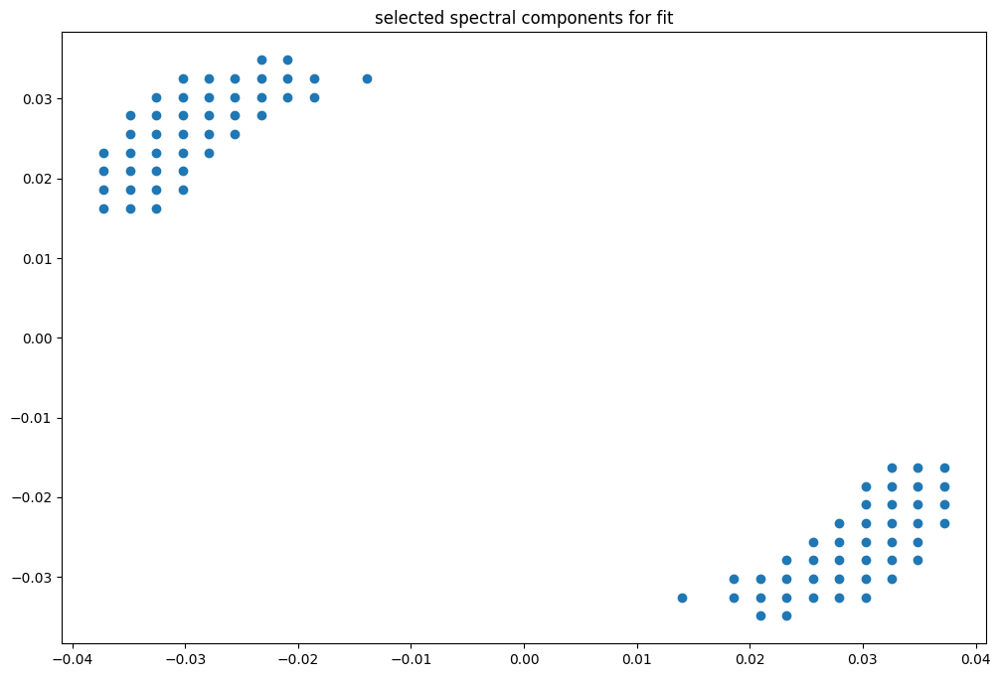

box [5000, 5700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

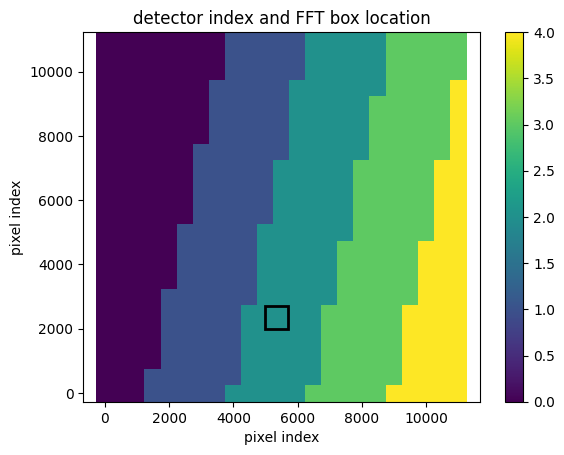

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


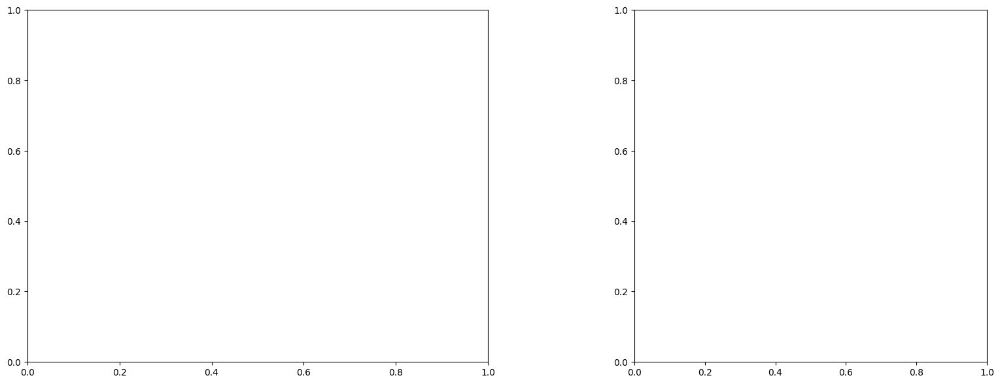

U and V components of current : [ 0.41249242 -0.63740152]
uncertainties for U and V: 0.08315601978323252 0.09372327023989166


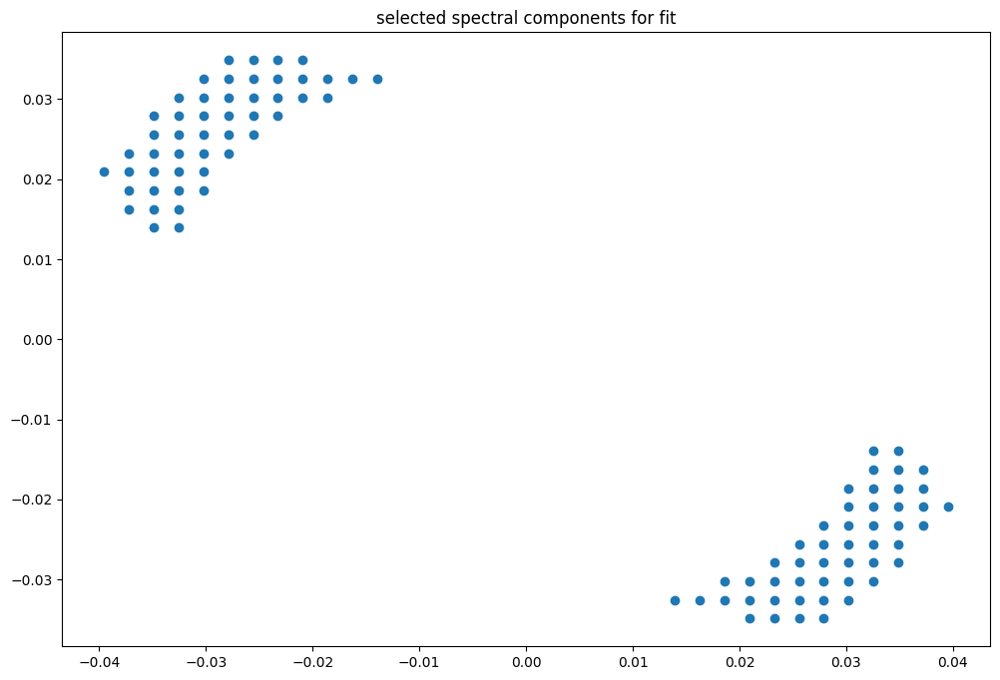

box [5000, 5700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

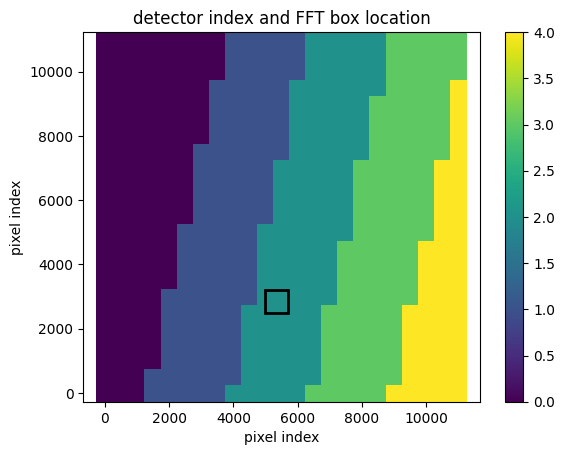

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


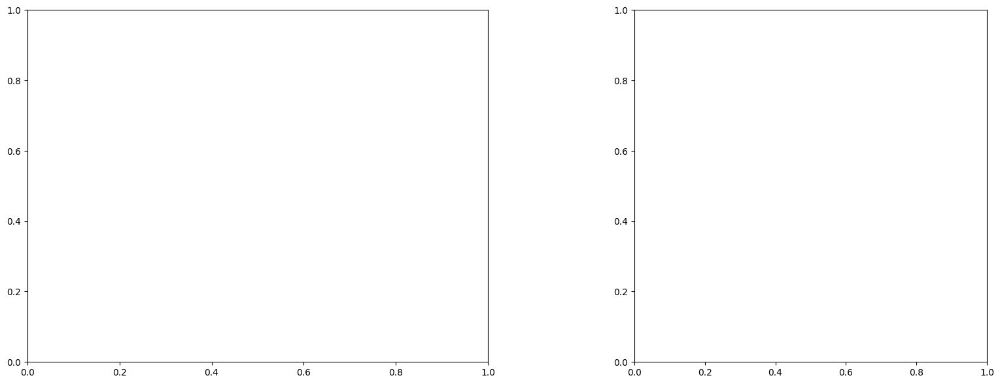

U and V components of current : [ 0.13137464 -0.61302994]
uncertainties for U and V: 0.0710191632898673 0.08241194393425577


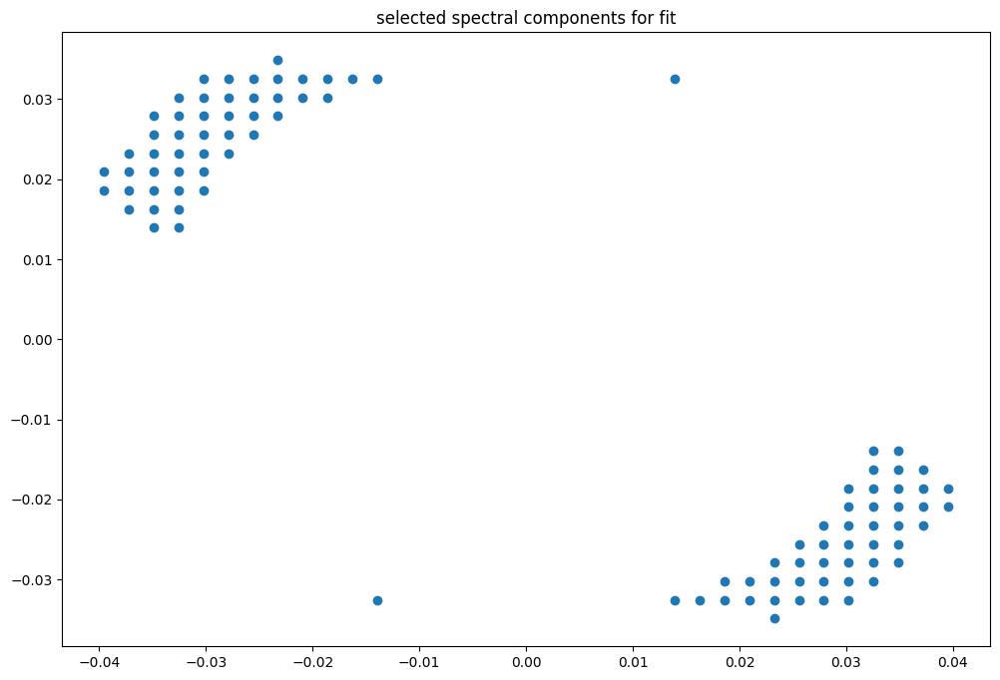

box [5000, 5700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

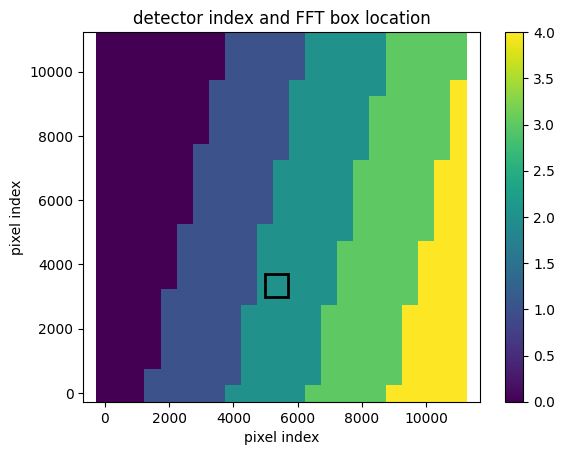

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


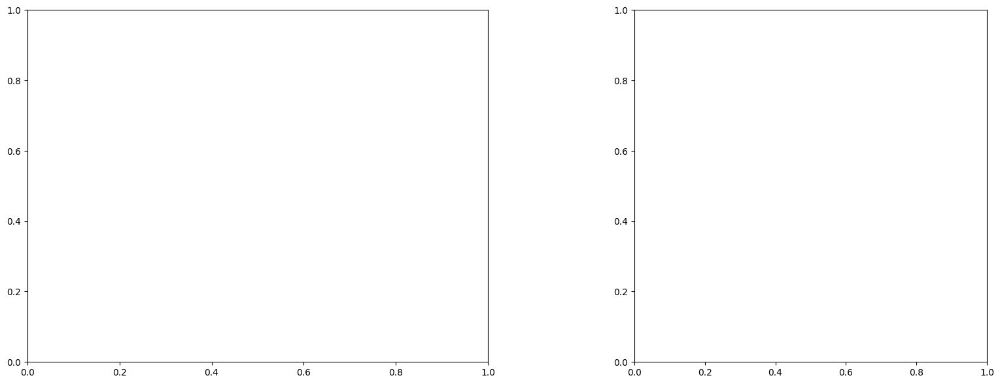

U and V components of current : [-0.00504543 -0.50944295]
uncertainties for U and V: 0.06416299068251602 0.07322829443001241


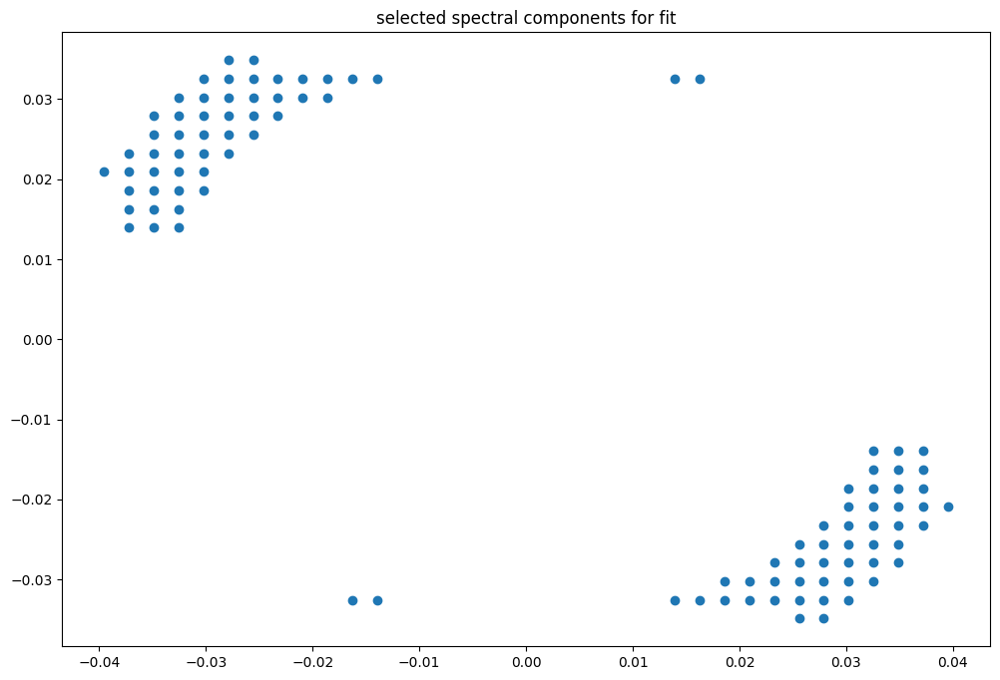

box [5000, 5700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

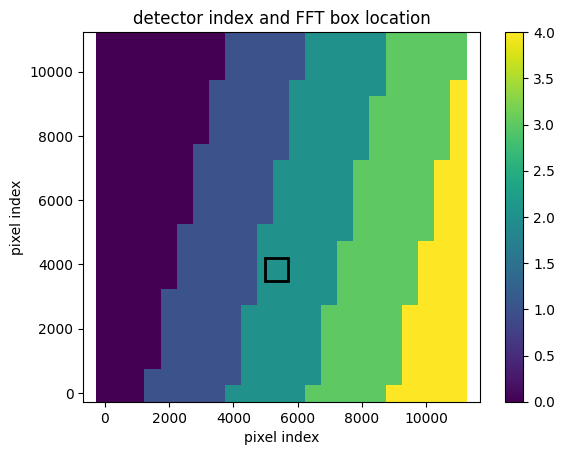

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


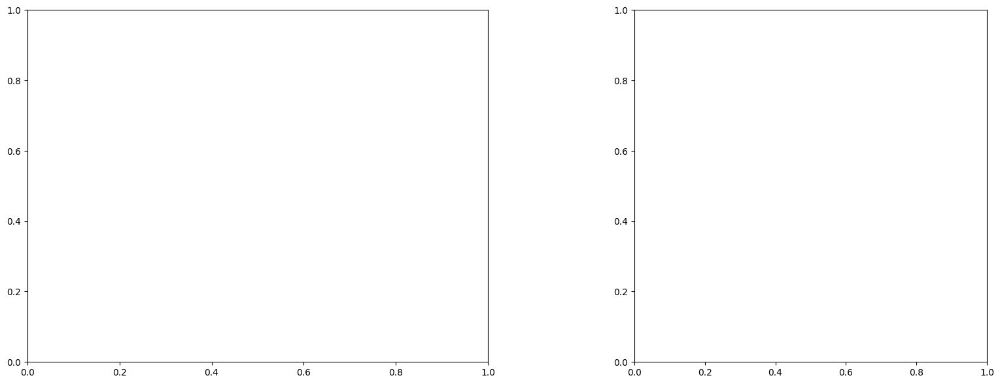

U and V components of current : [-0.18190952 -0.93931064]
uncertainties for U and V: 0.07102755495608386 0.07811936556094322


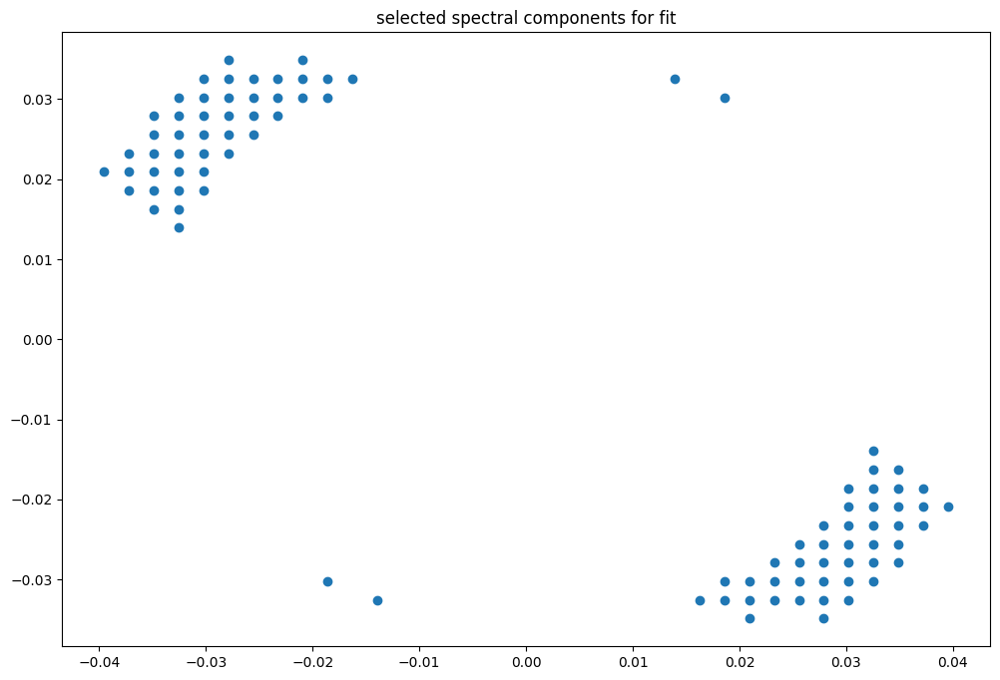

box [5000, 5700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

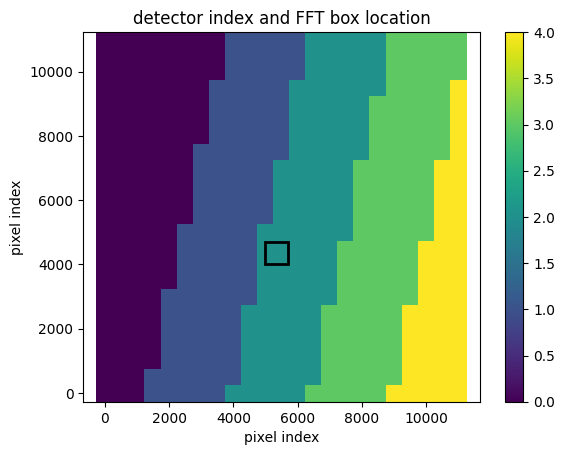

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


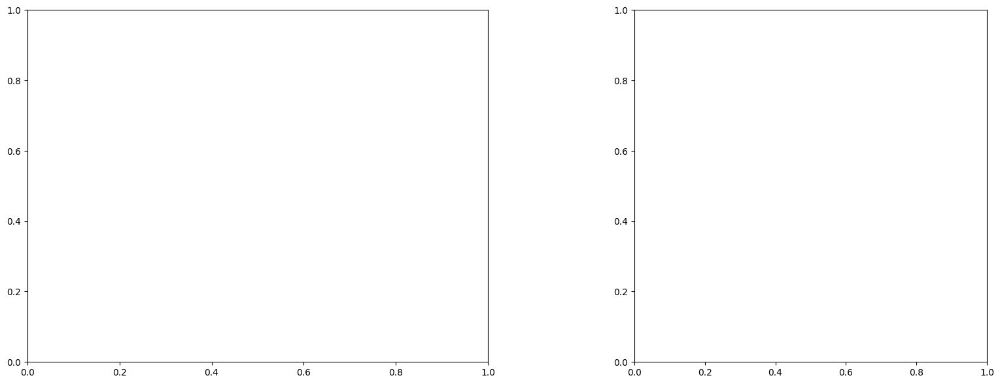

U and V components of current : [ 0.35465808 -0.36457543]
uncertainties for U and V: 0.18588909357417258 0.20260822047549631


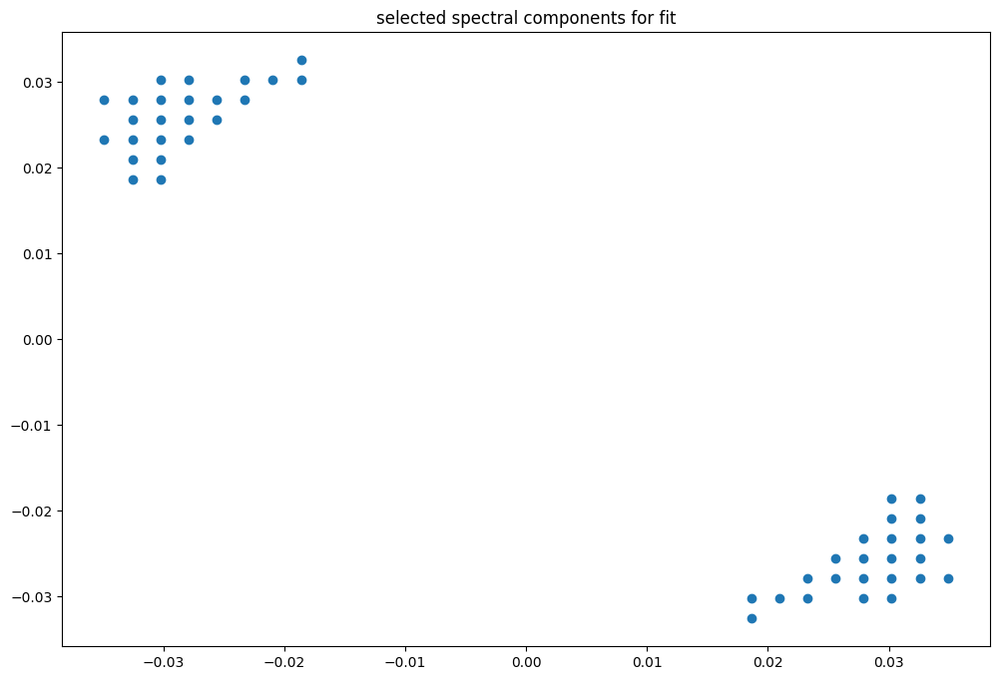

box [5000, 5700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

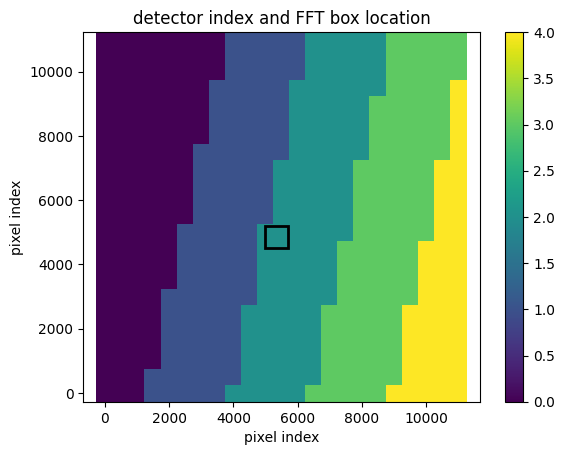

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


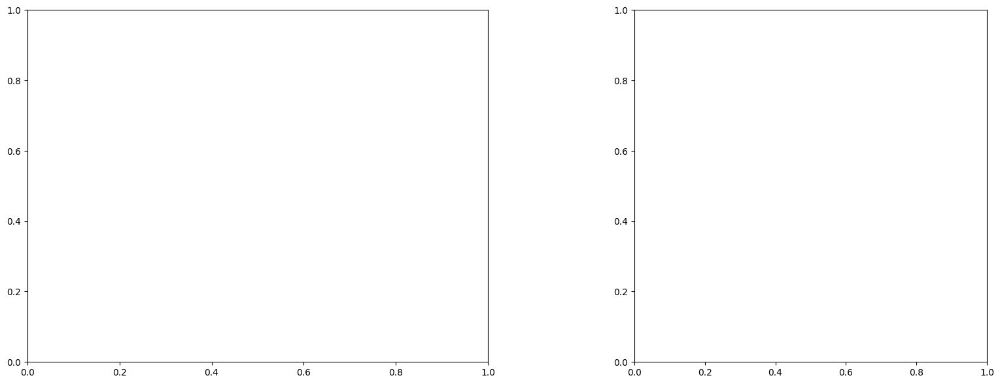

LinAlgError: Singular matrix

box [5000, 5700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

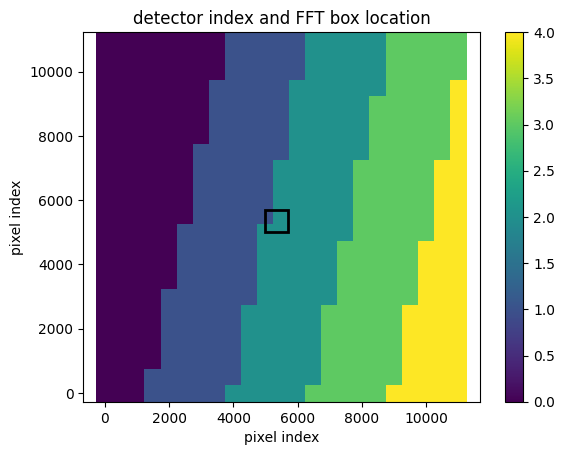

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.96
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


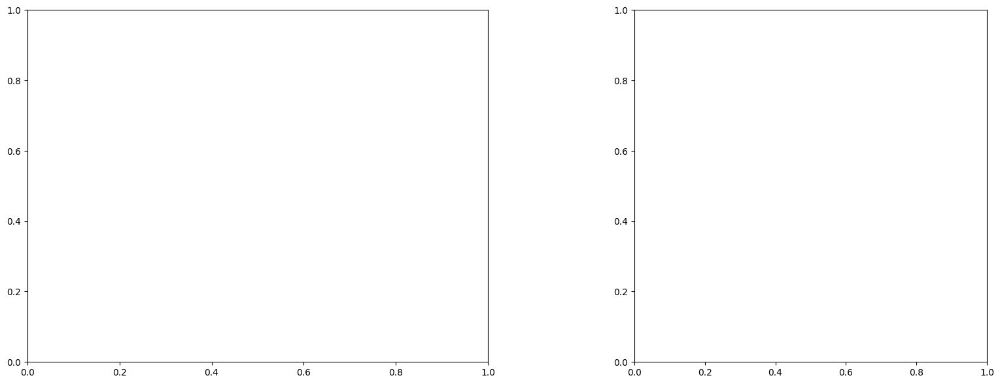

LinAlgError: Singular matrix

box [5000, 5700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

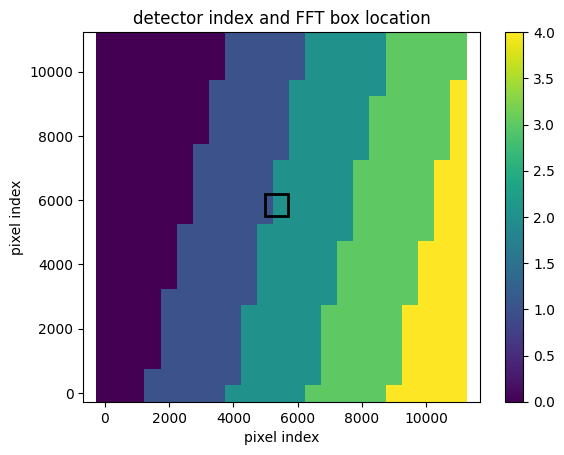

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


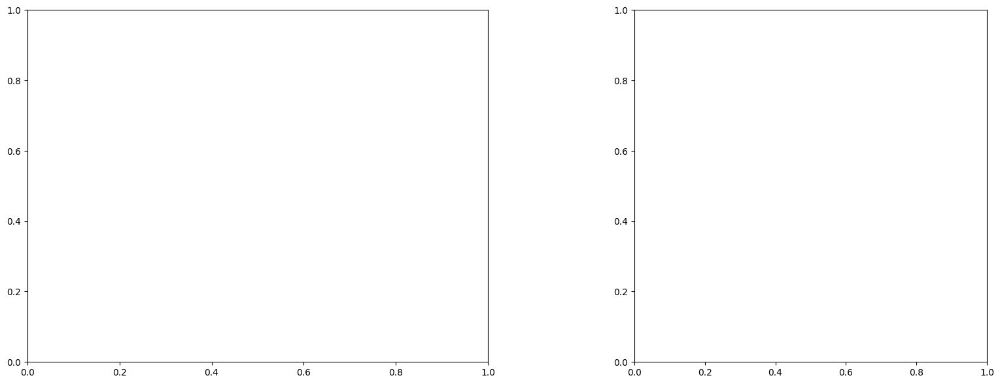

LinAlgError: Singular matrix

box [5000, 5700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

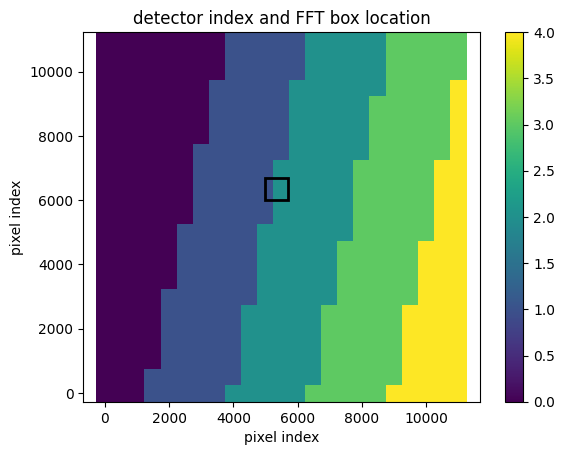

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


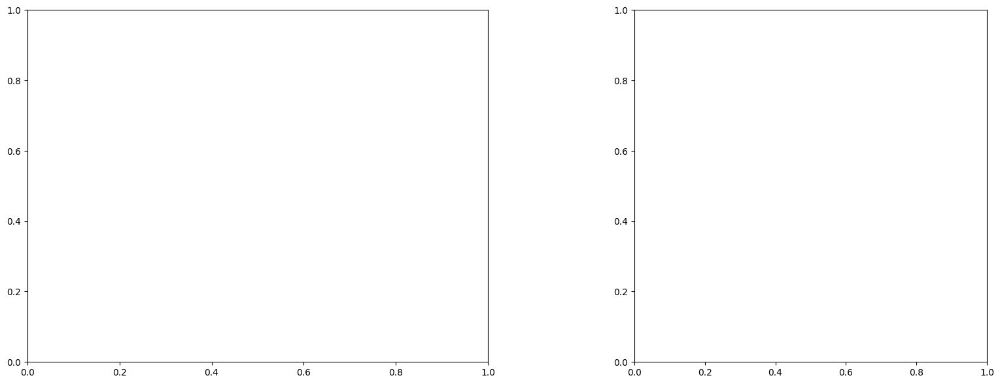

LinAlgError: Singular matrix

box [5000, 5700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

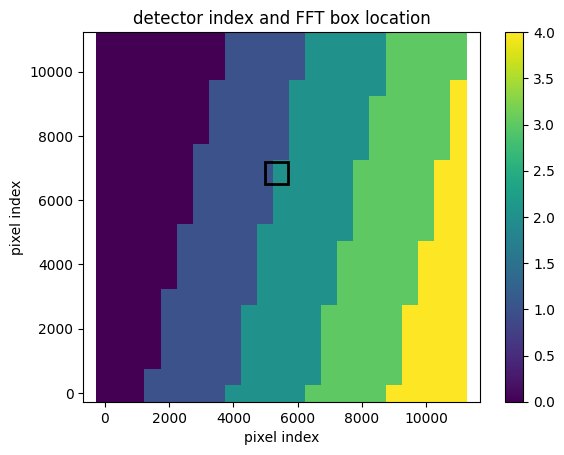

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


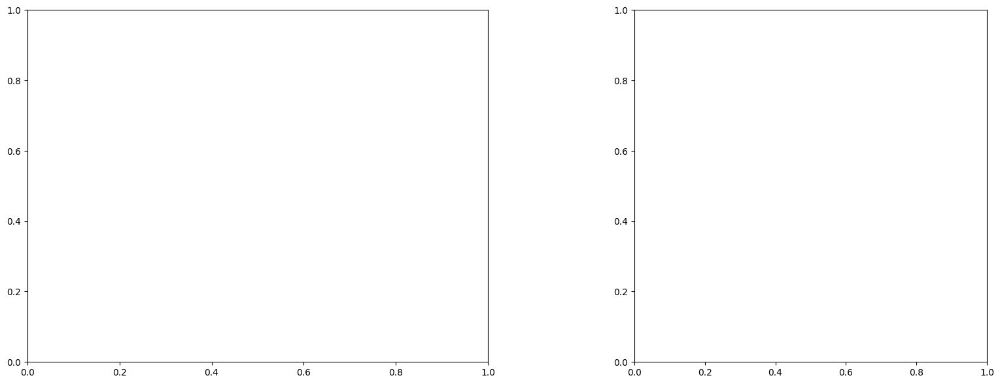

LinAlgError: Singular matrix

box [5000, 5700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

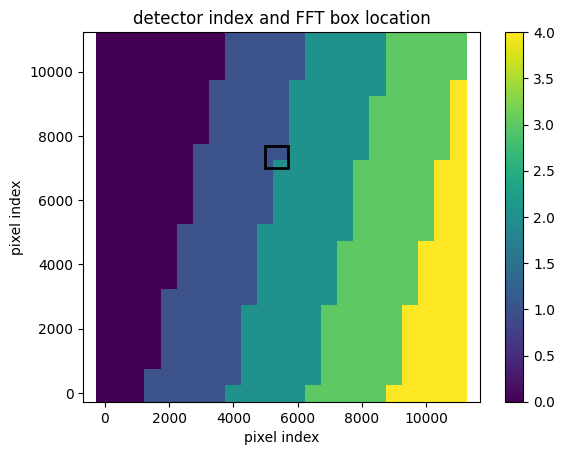

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.26
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


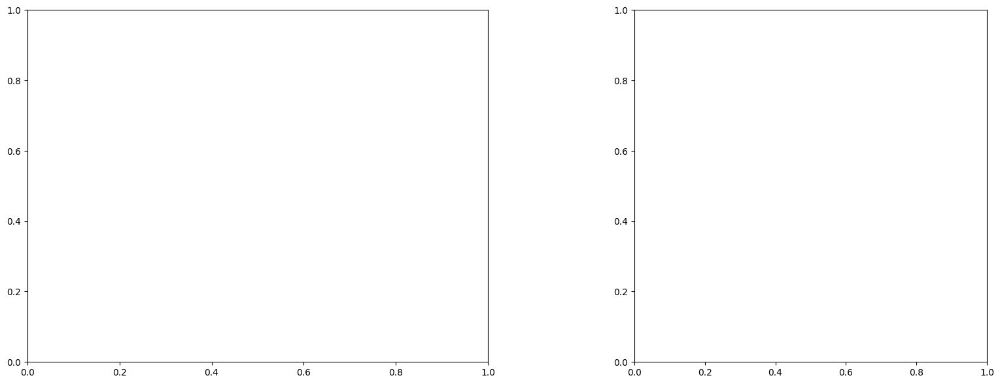

U and V components of current : [-0.02332839 -1.23948432]
uncertainties for U and V: 0.17311293224834393 0.20019690531329457


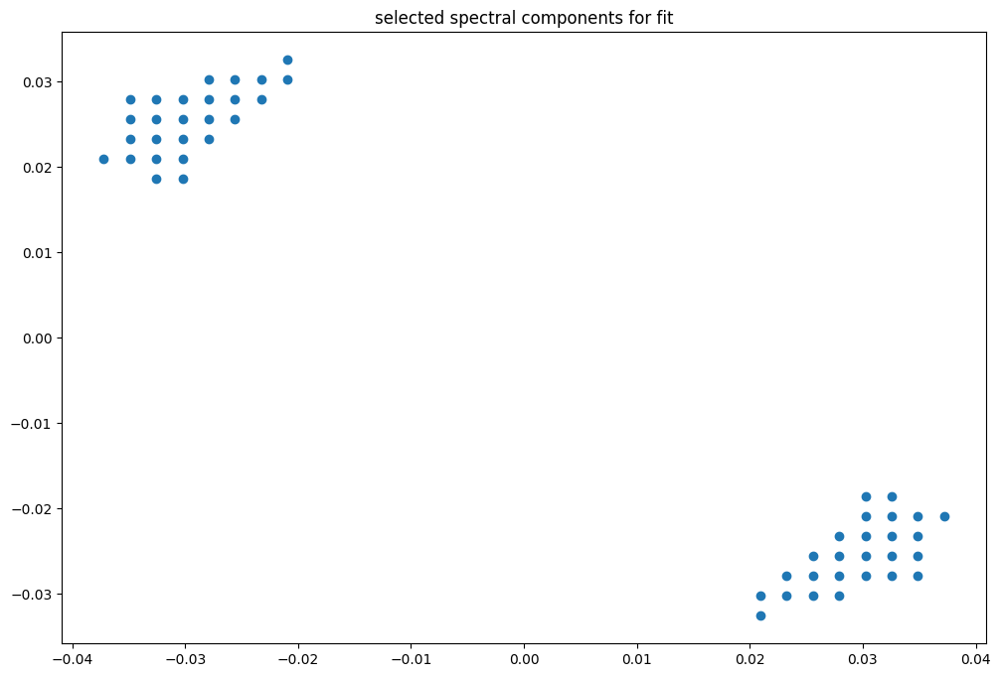

box [5000, 5700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

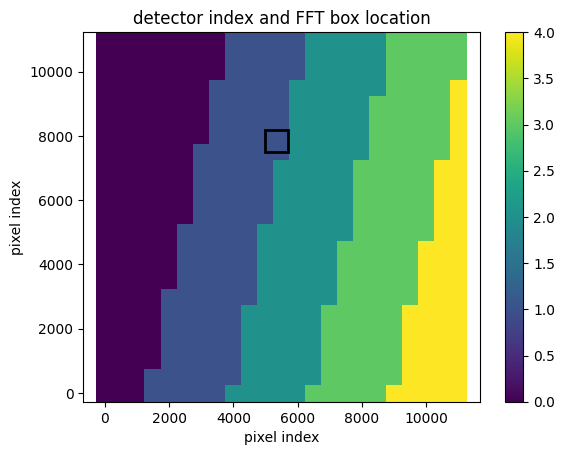

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.007570836949239
(43, 43)
(43, 43)
(43, 43)


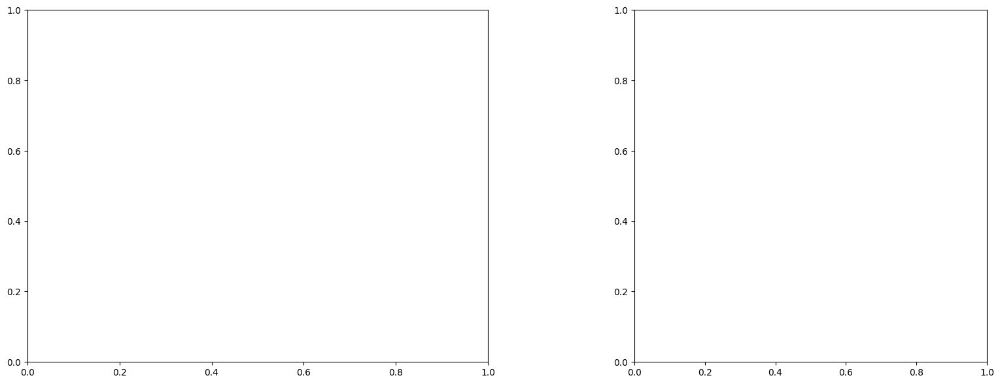

U and V components of current : [-0.19137979 -2.11928287]
uncertainties for U and V: 0.11845227180265397 0.11537249943239962


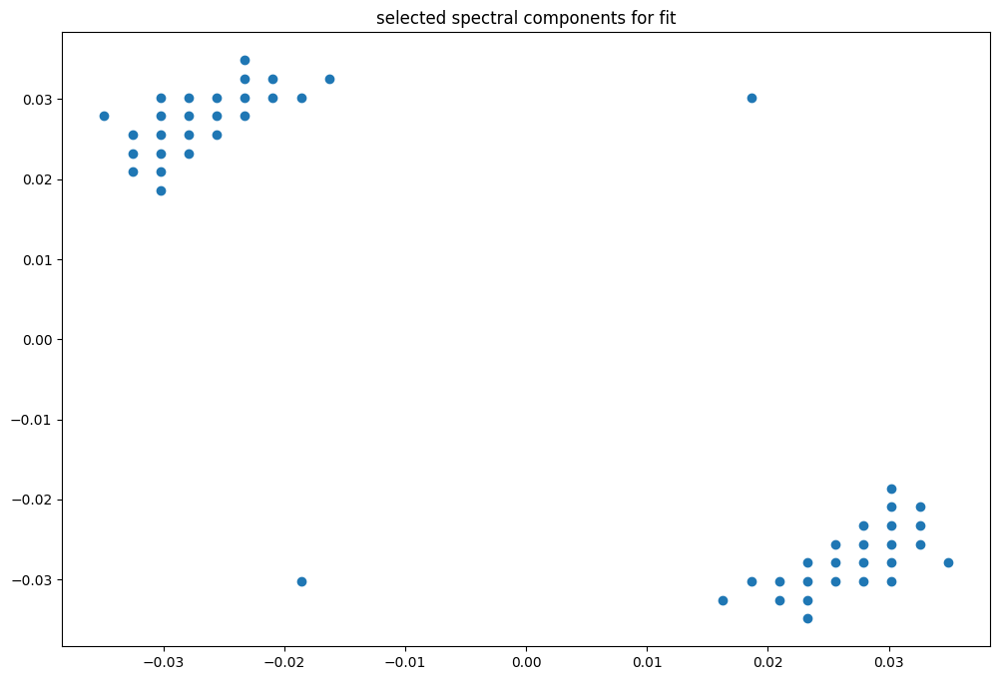

box [5000, 5700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

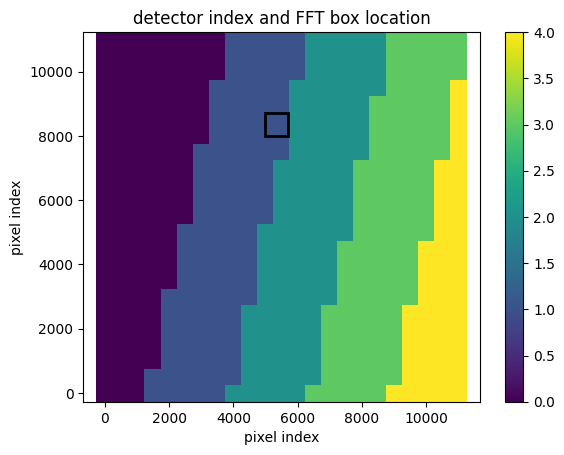

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075687274969196
(43, 43)
(43, 43)
(43, 43)


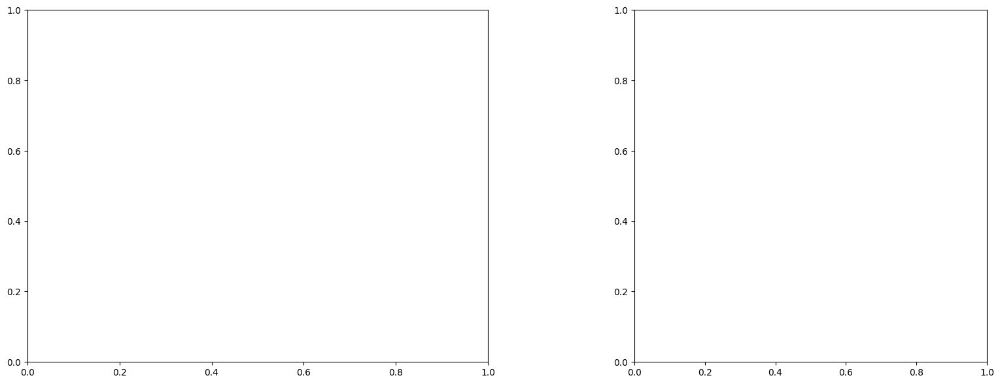

U and V components of current : [ 0.221805   -2.26338111]
uncertainties for U and V: 0.2115363292028378 0.18457607841695597


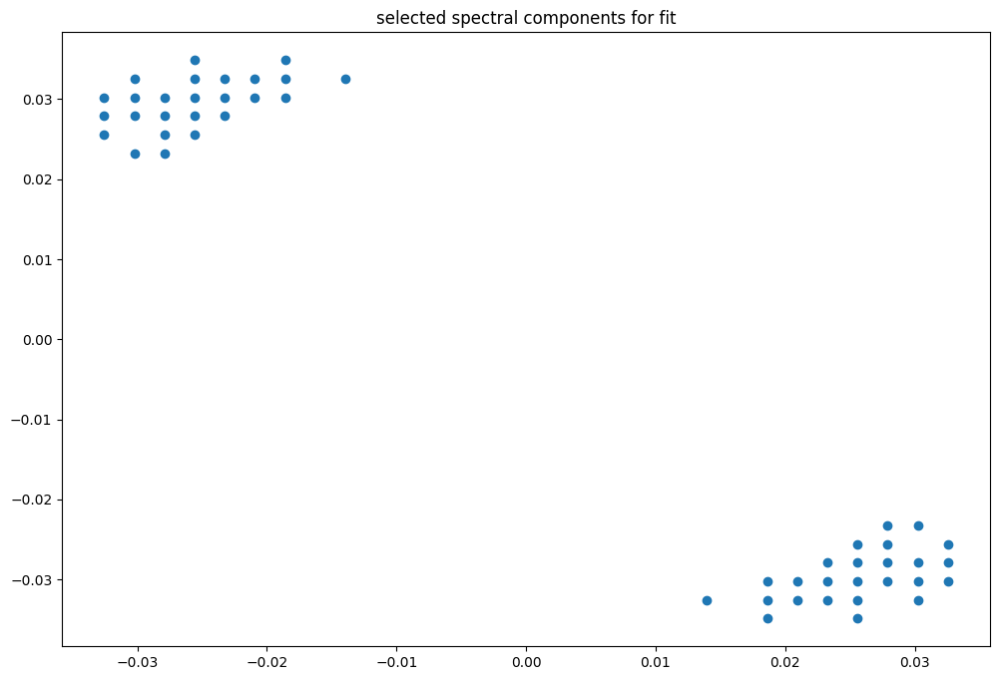

box [5000, 5700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

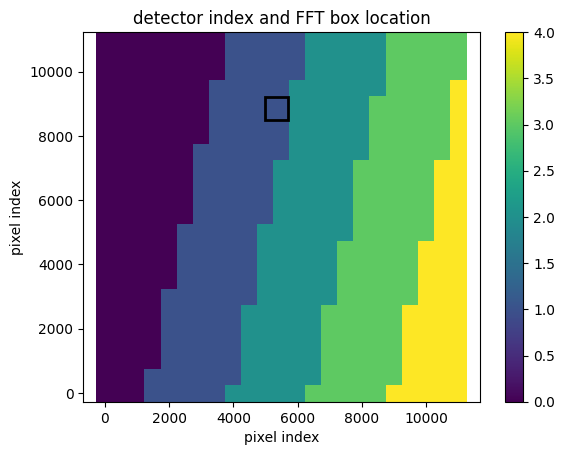

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075666599140392
(43, 43)
(43, 43)
(43, 43)


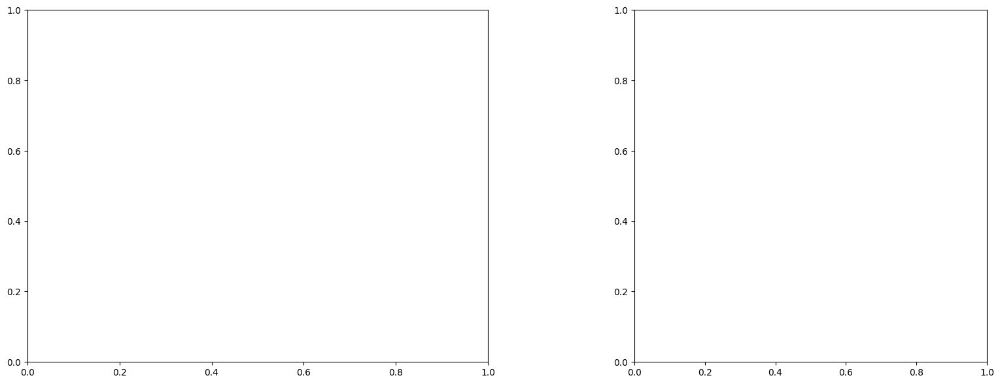

U and V components of current : [-0.4631536  -2.53330144]
uncertainties for U and V: 0.1237128097355914 0.10485013965673573


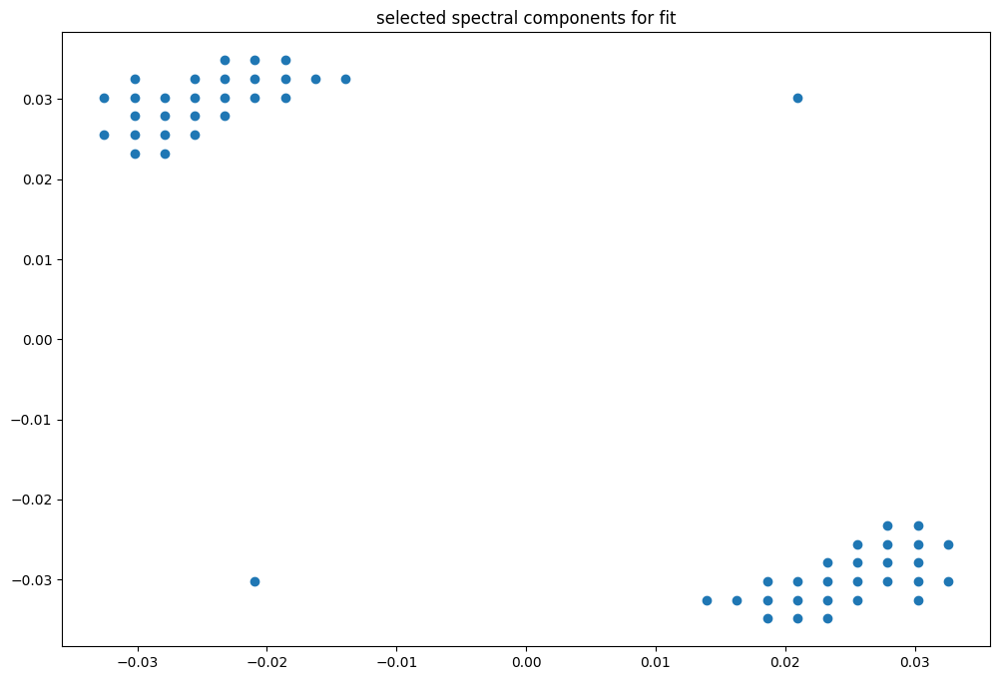

box [5000, 5700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

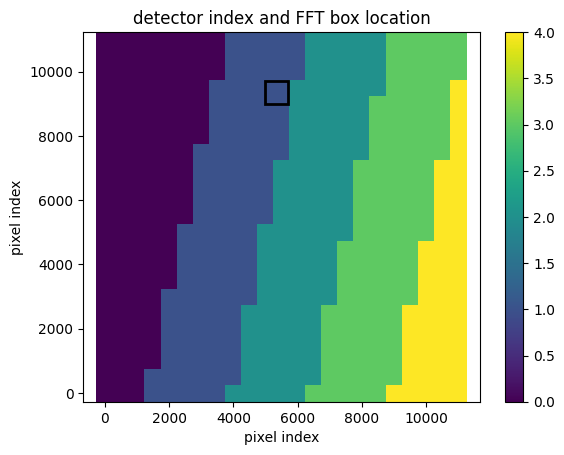

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


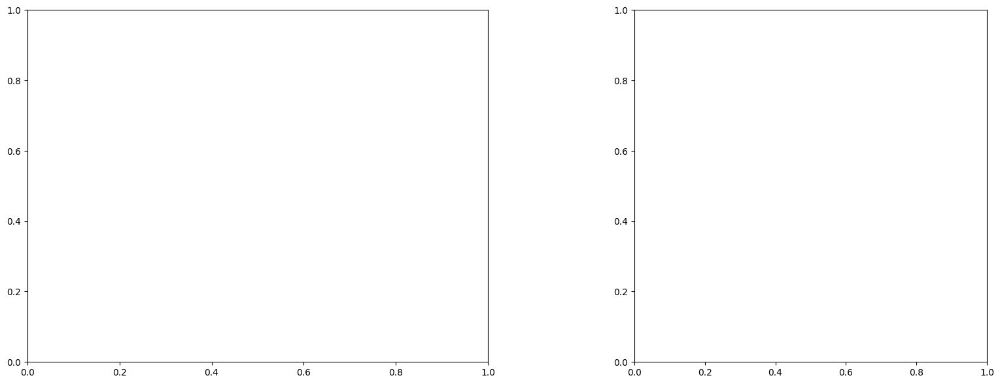

U and V components of current : [ 0.73950687 -1.84393135]
uncertainties for U and V: 0.18240681289268118 0.17064424671863954


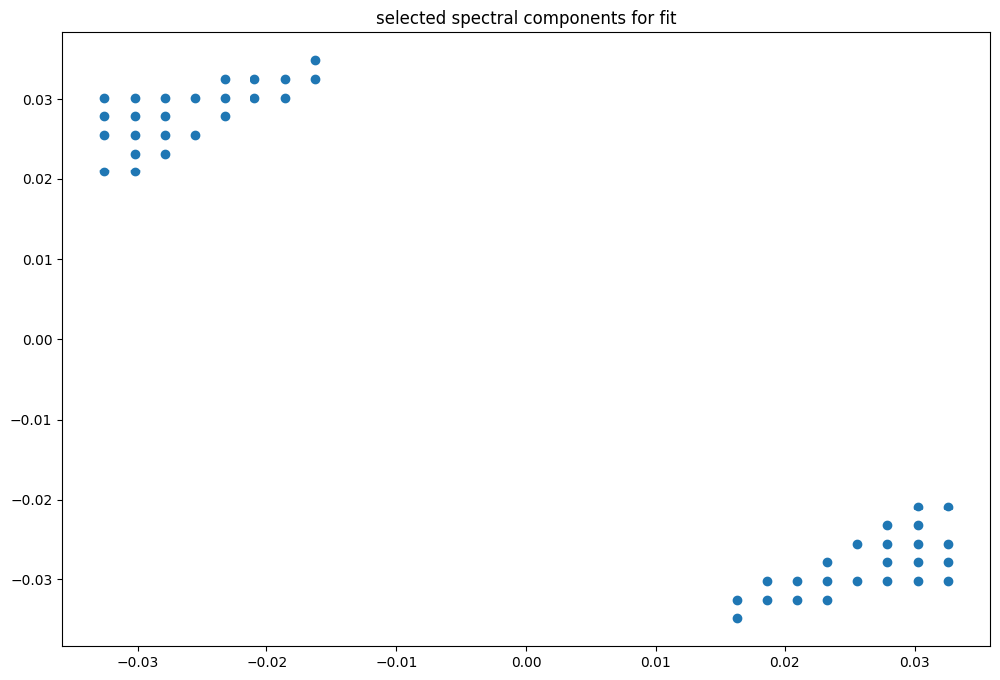

box [5000, 5700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

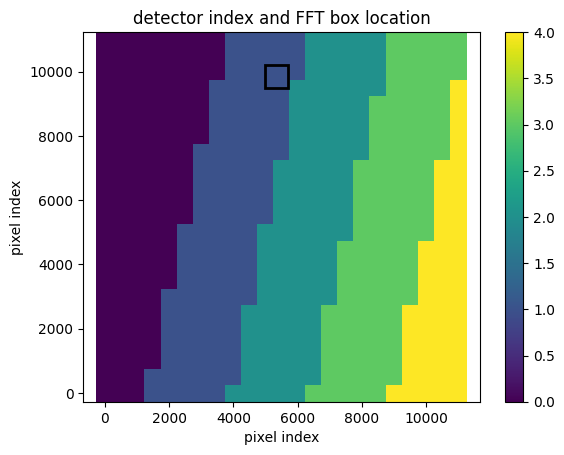

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


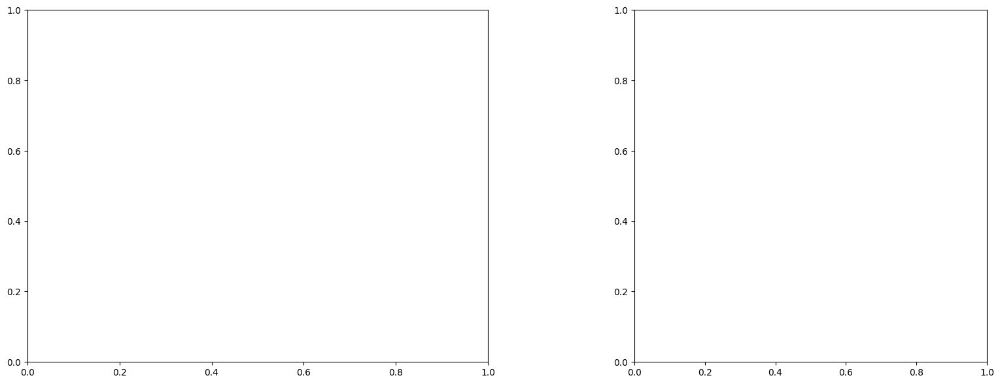

U and V components of current : [-0.16881699 -2.45262067]
uncertainties for U and V: 0.07367023276532488 0.07431842113625083


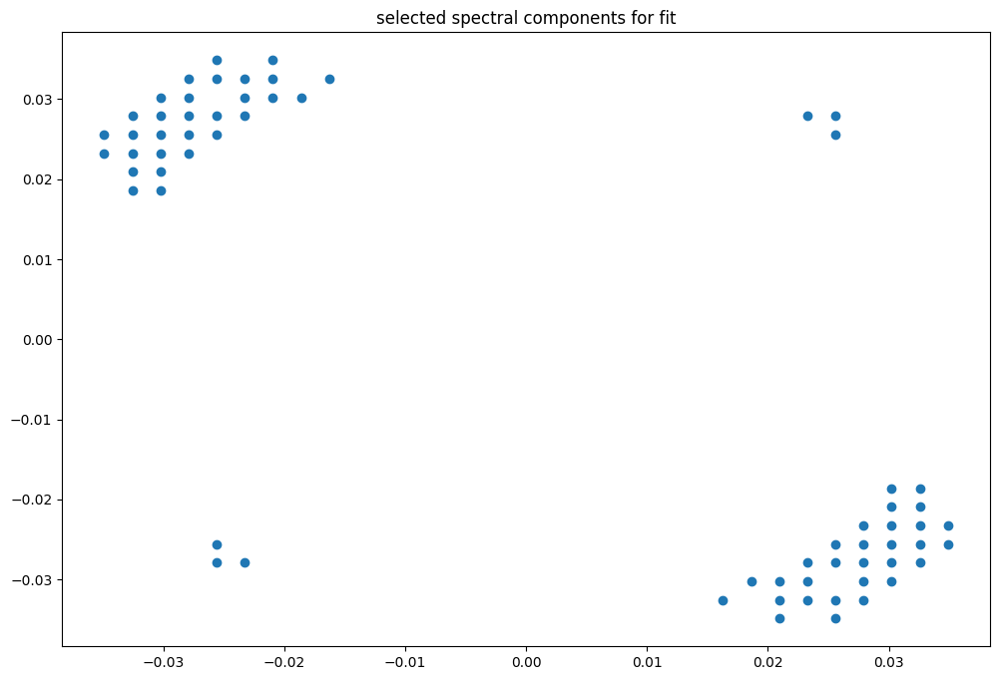

box [5000, 5700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

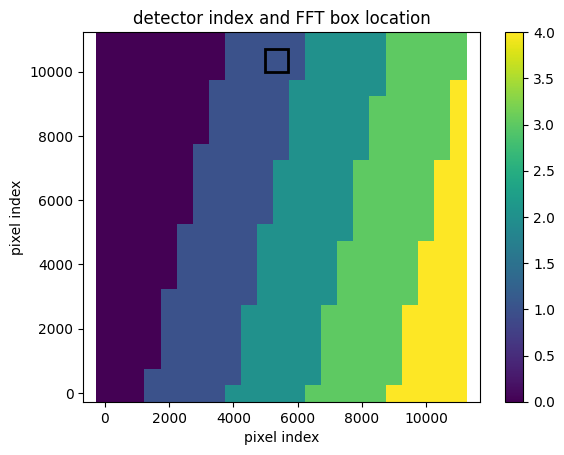

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 43)
(43, 43)
(43, 43)


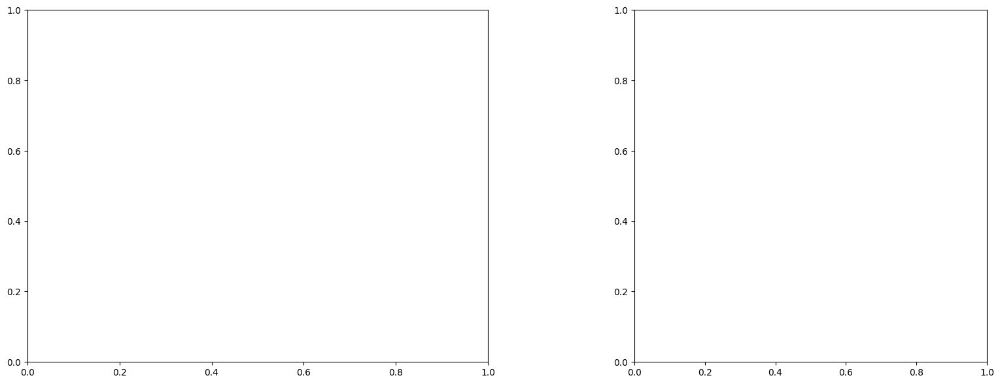

U and V components of current : [-0.0554077  -2.05527665]
uncertainties for U and V: 0.08206816022294991 0.08556003528468242


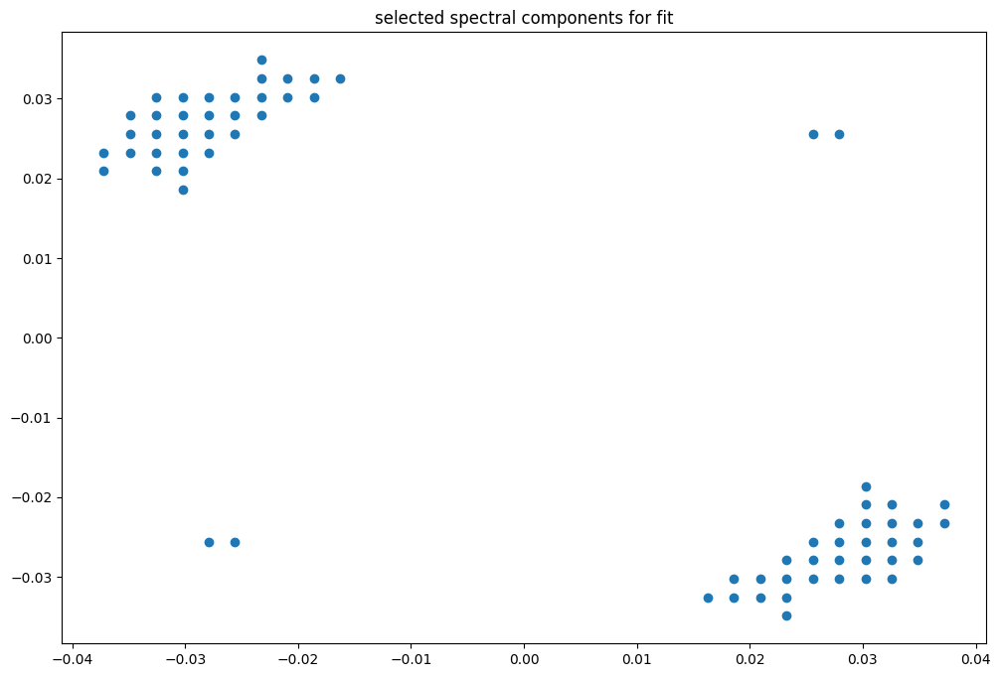

box [5000, 5700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

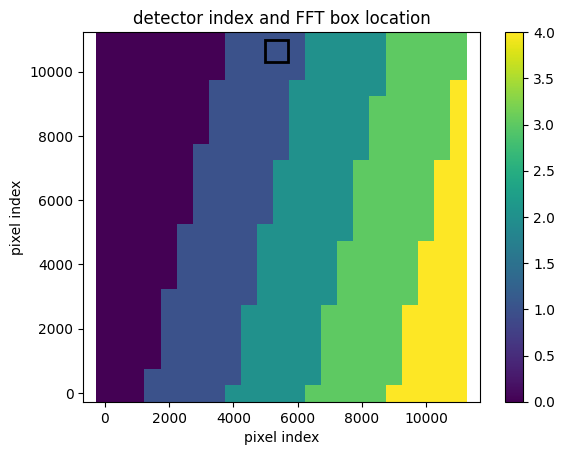

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 42)
(43, 42)
(43, 42)


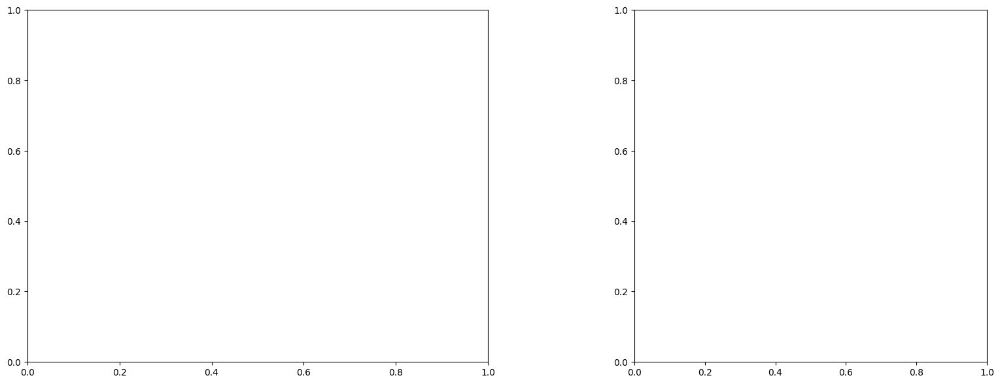

U and V components of current : [ 0.15122004 -2.14147625]
uncertainties for U and V: 0.07100065879029743 0.07471019382734782


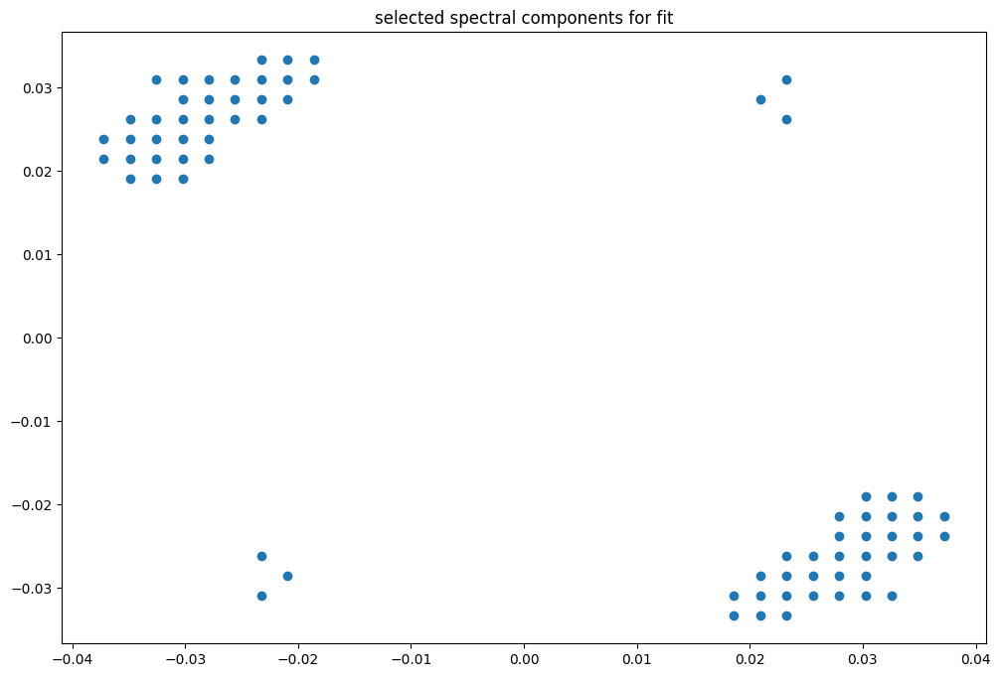

box [5500, 6200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

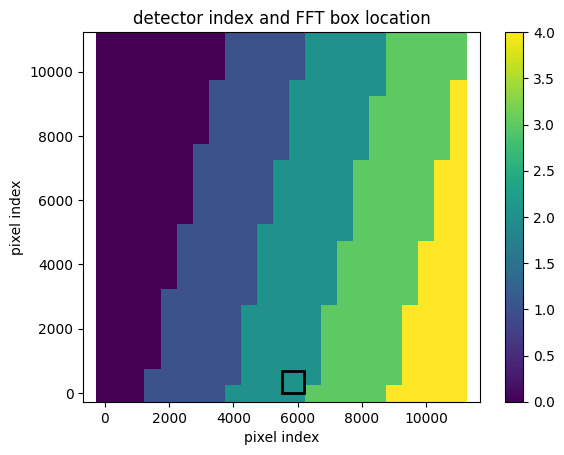

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


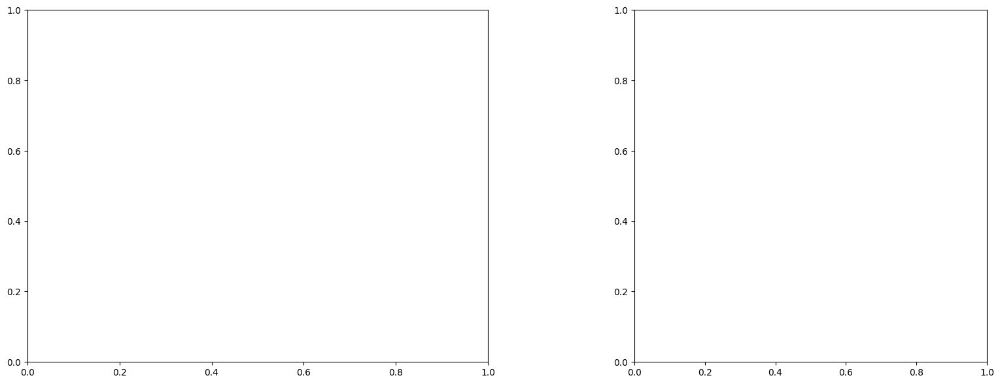

U and V components of current : [-0.45489466 -2.51687695]
uncertainties for U and V: 0.10992969203415534 0.11032942920965028


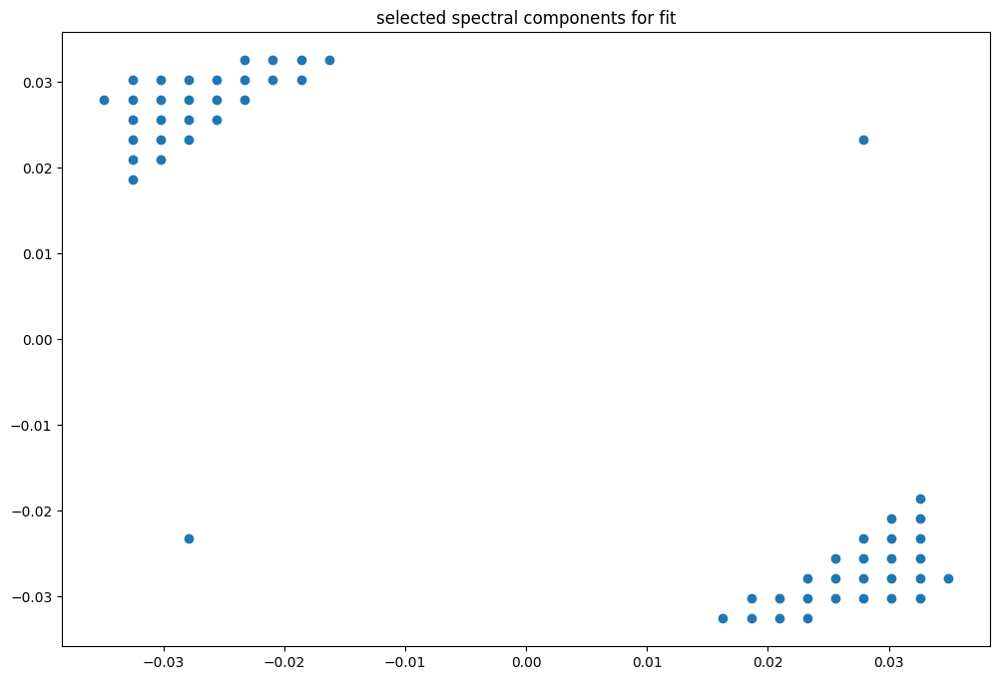

box [5500, 6200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

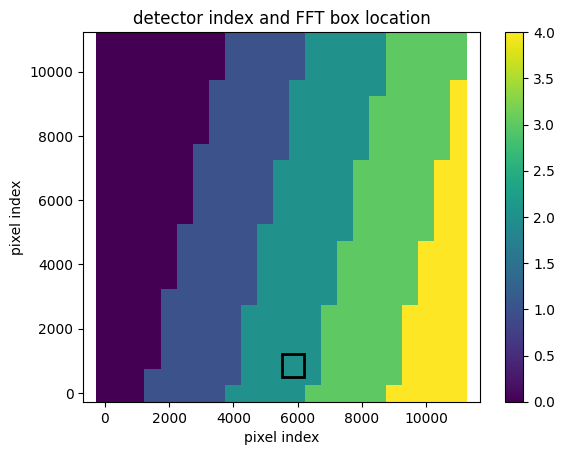

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


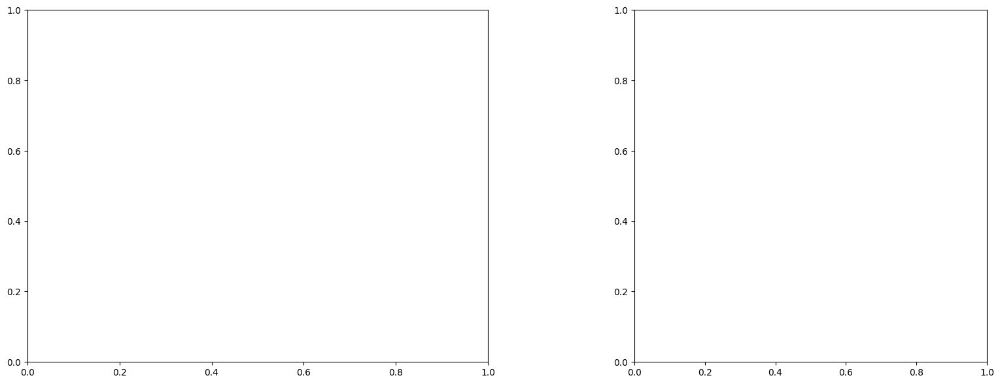

U and V components of current : [ 0.08145765 -1.39552704]
uncertainties for U and V: 0.09501881320211182 0.10112487976640713


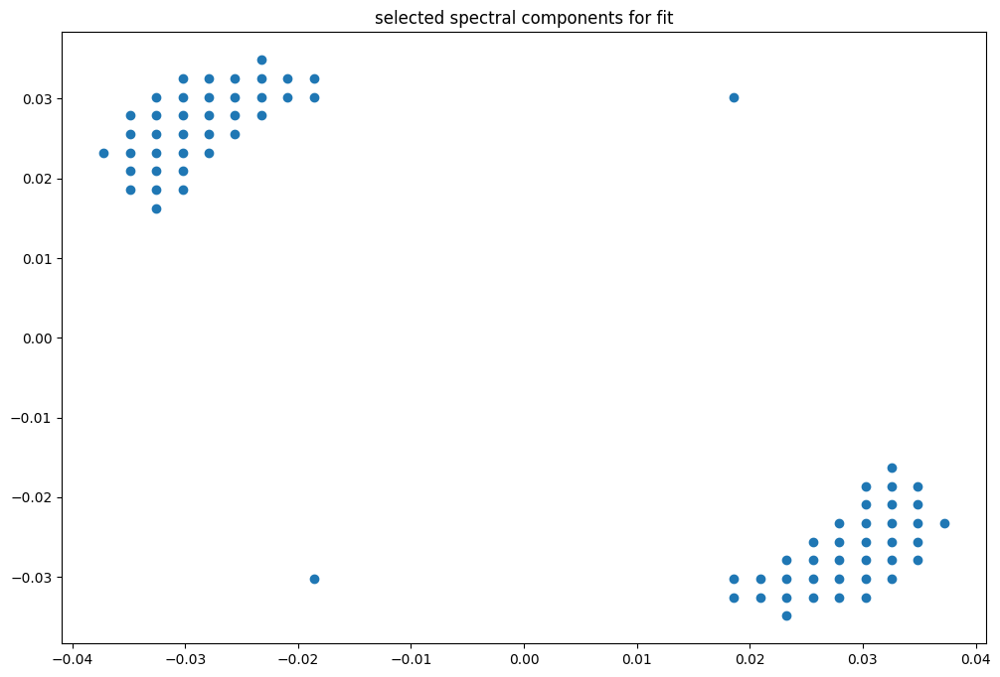

box [5500, 6200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

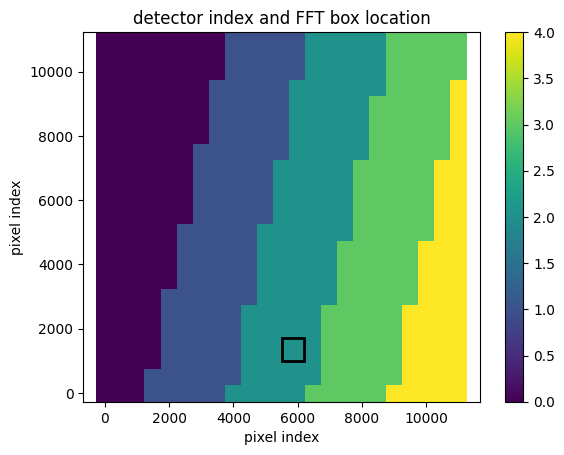

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


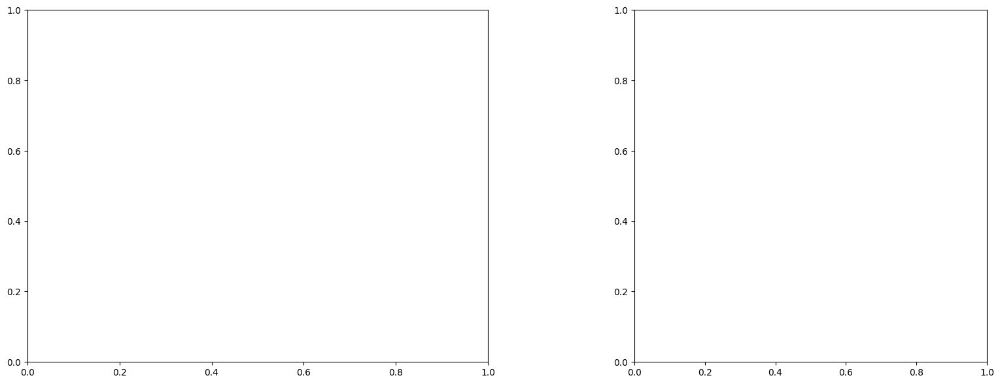

U and V components of current : [ 0.87596068 -0.67670998]
uncertainties for U and V: 0.11497186563074324 0.12473072930981045


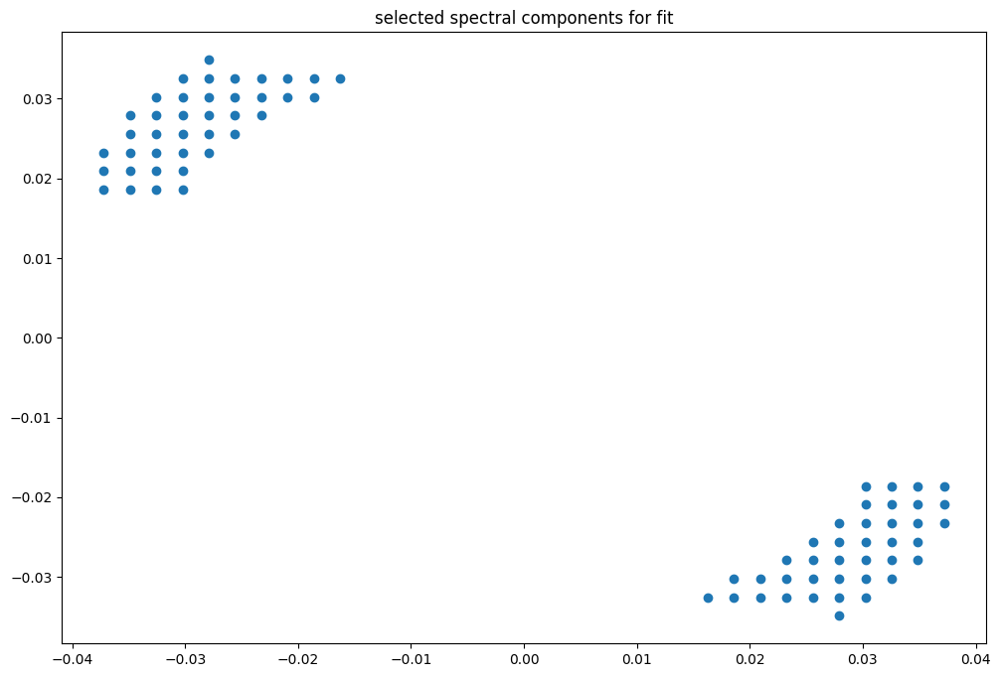

box [5500, 6200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

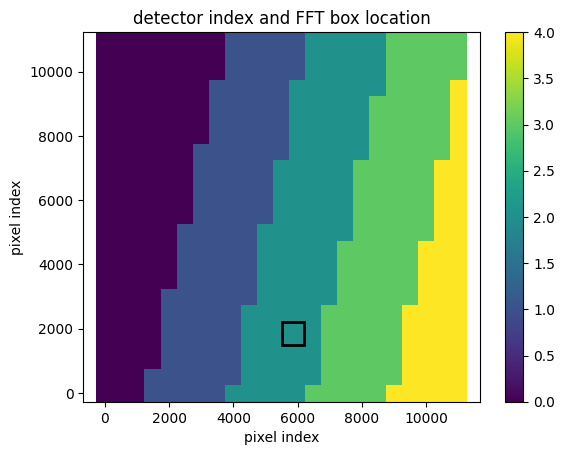

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


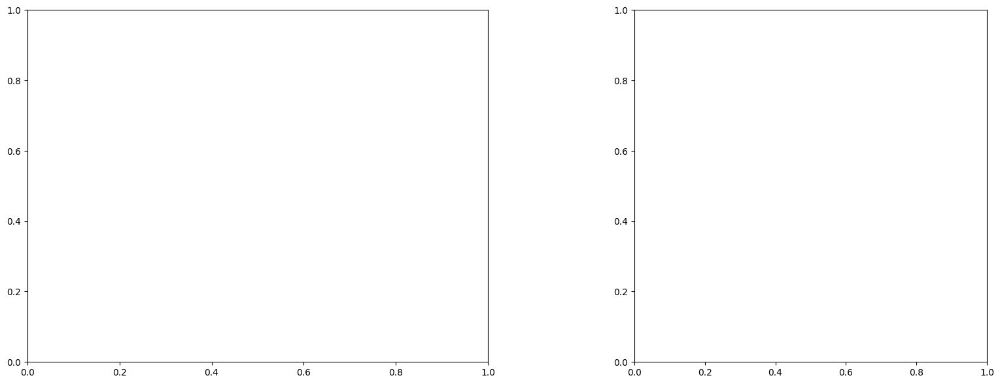

U and V components of current : [ 0.18920612 -0.86663722]
uncertainties for U and V: 0.09653771691978034 0.10148412846945105


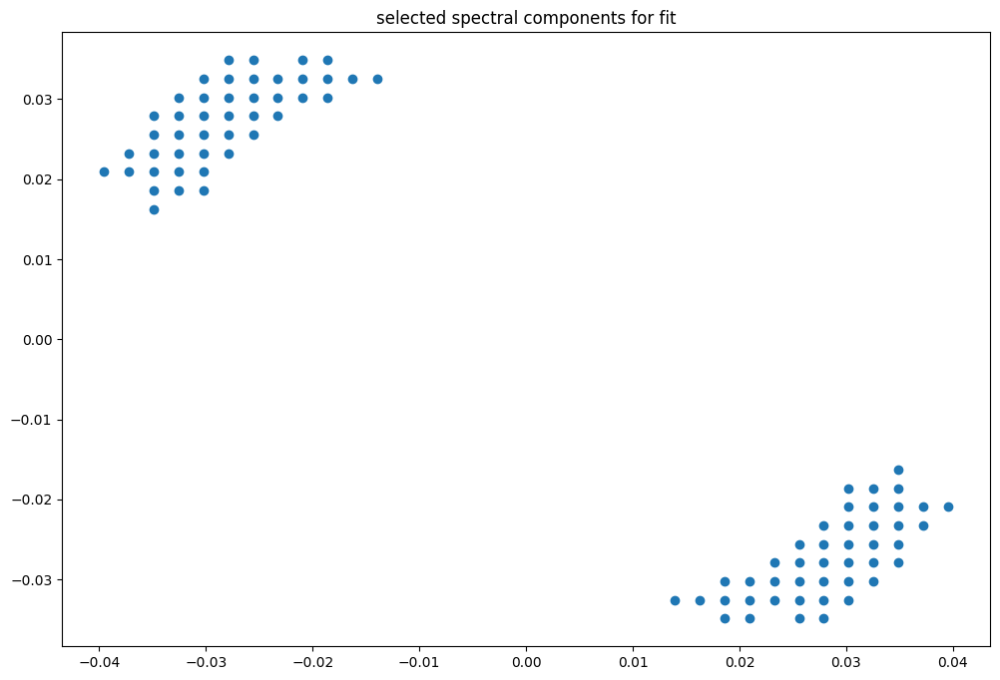

box [5500, 6200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

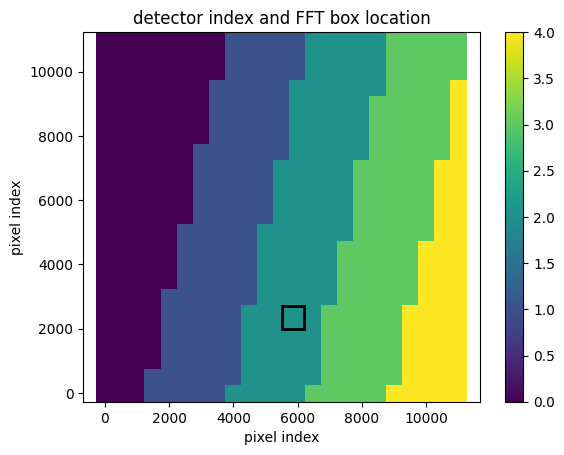

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


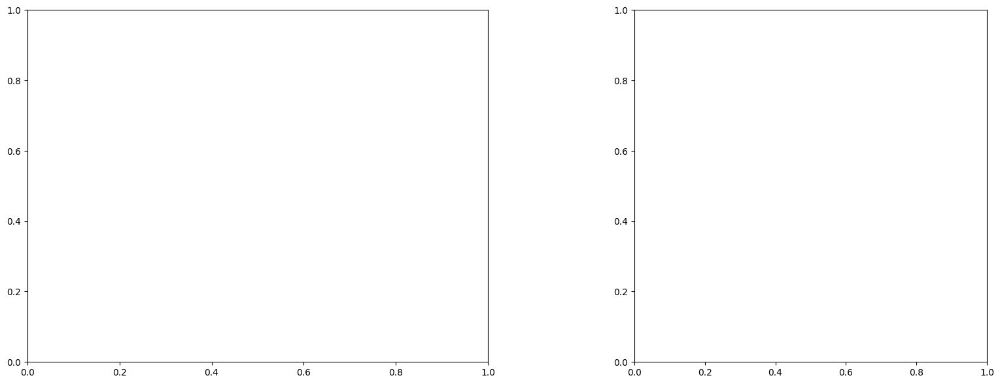

U and V components of current : [ 0.80888524 -0.54746143]
uncertainties for U and V: 0.10521862083515429 0.11719138566569838


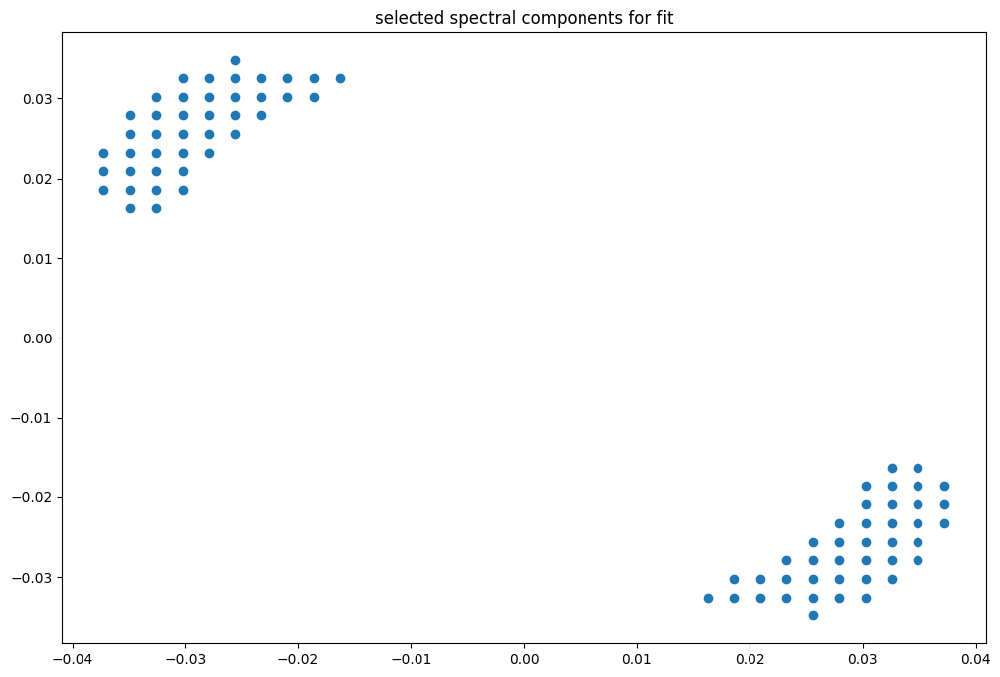

box [5500, 6200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

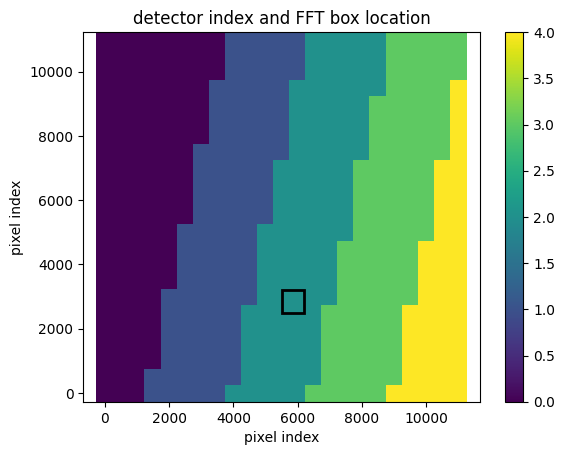

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


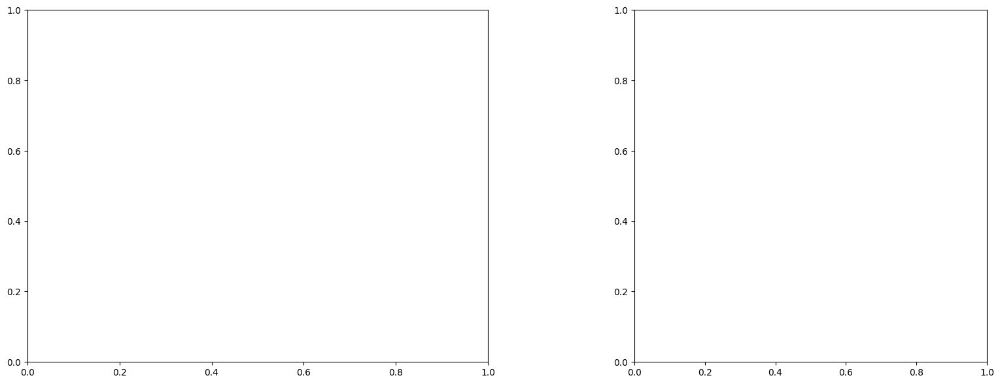

U and V components of current : [ 0.53162474 -0.39711688]
uncertainties for U and V: 0.0965445706400565 0.10792336234351668


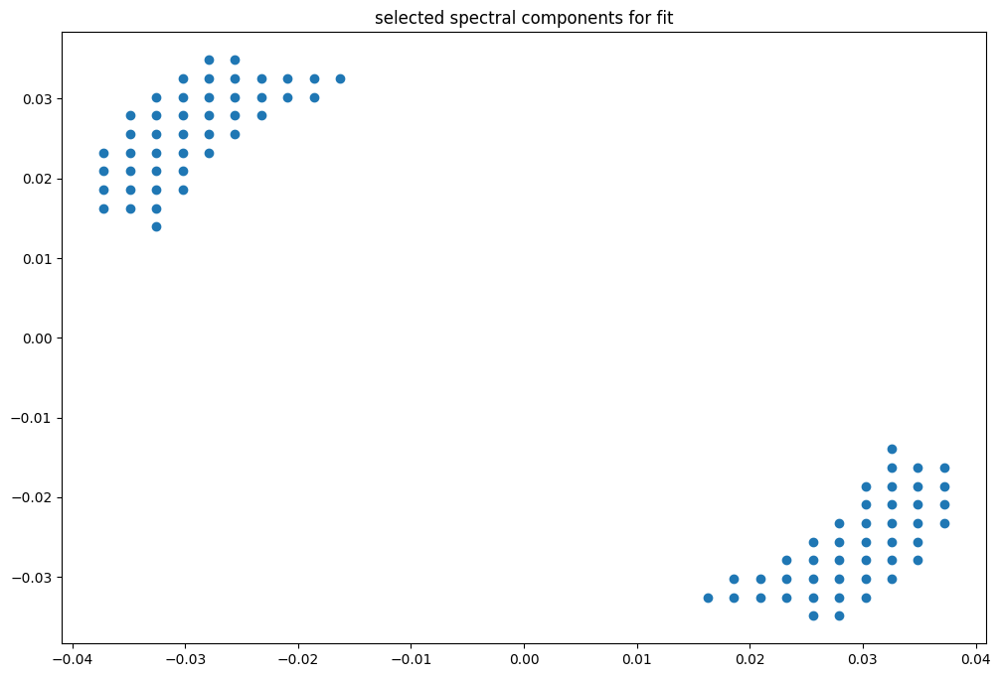

box [5500, 6200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

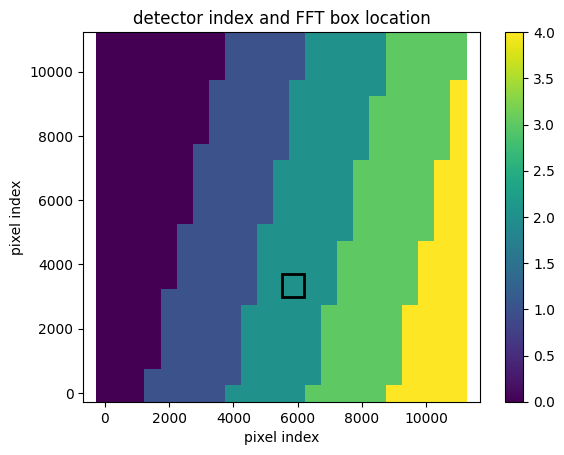

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


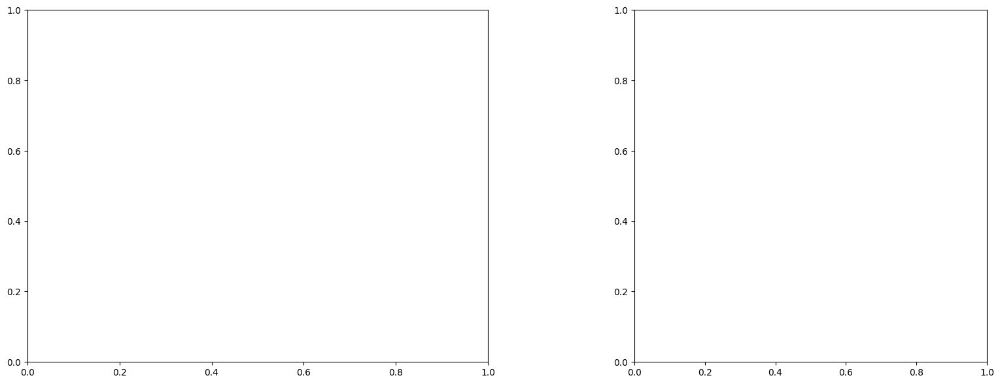

U and V components of current : [ 0.61166572 -0.2717253 ]
uncertainties for U and V: 0.09997243938984317 0.10629485809597679


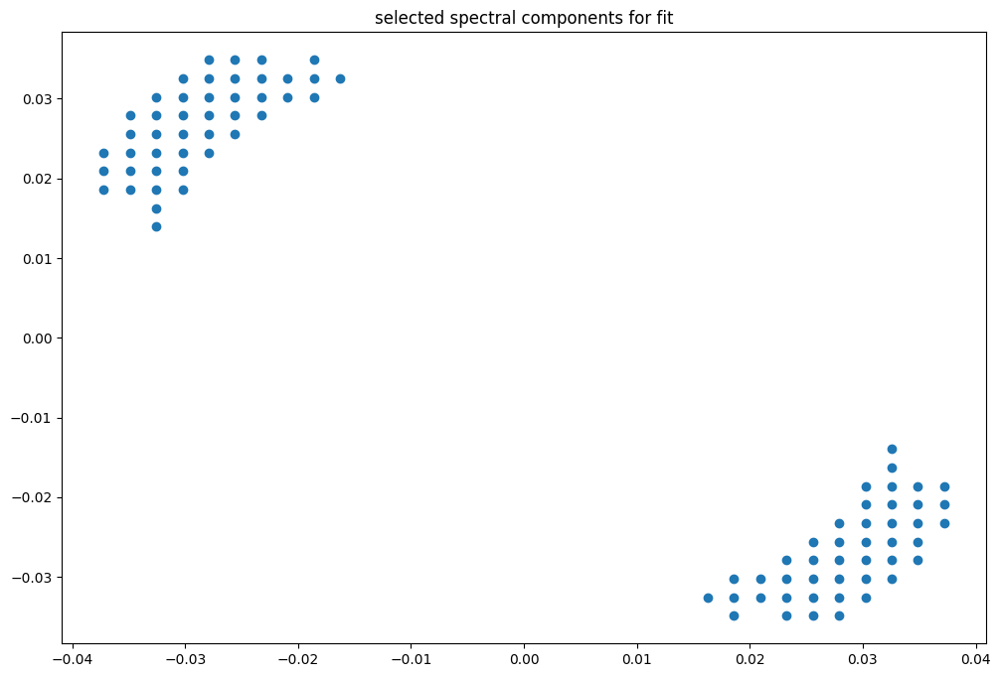

box [5500, 6200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

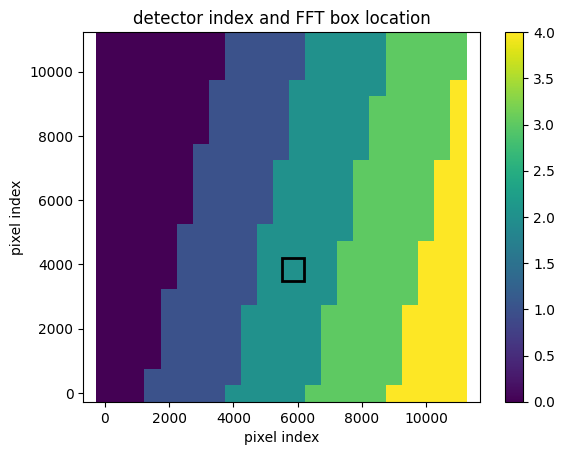

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


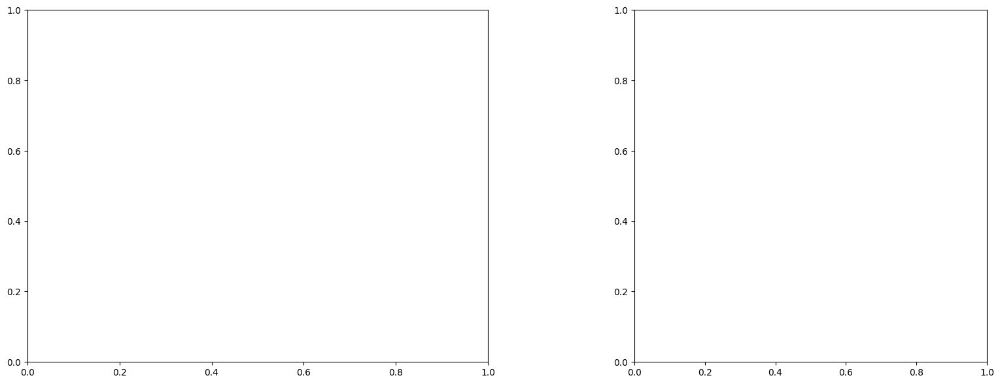

U and V components of current : [ 0.03625443 -0.64175326]
uncertainties for U and V: 0.11734986732837997 0.1173042195493818


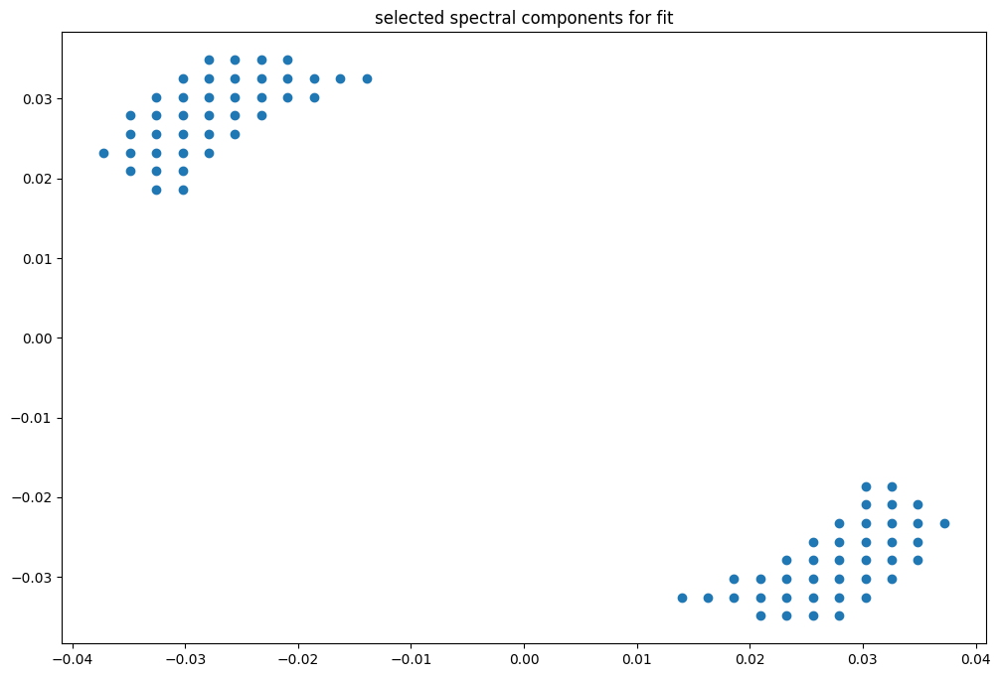

box [5500, 6200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

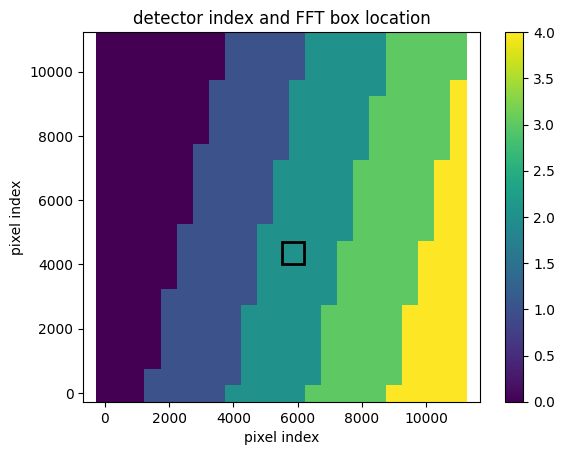

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


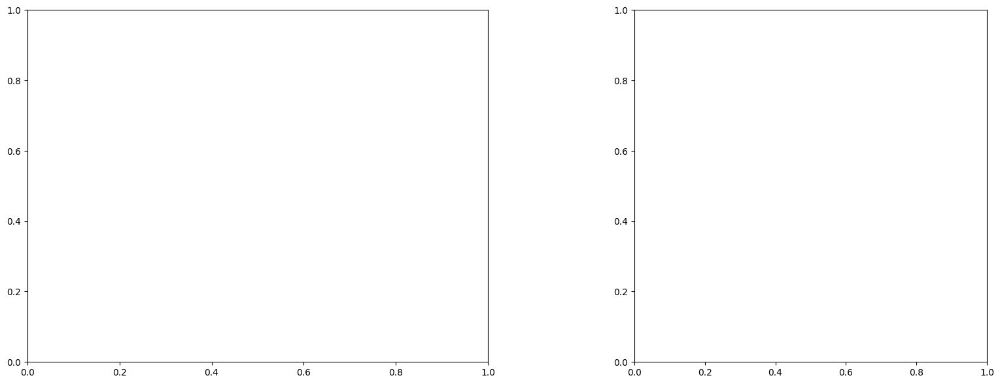

U and V components of current : [-0.21720266 -1.44430333]
uncertainties for U and V: 0.12579002320068272 0.12099958972909061


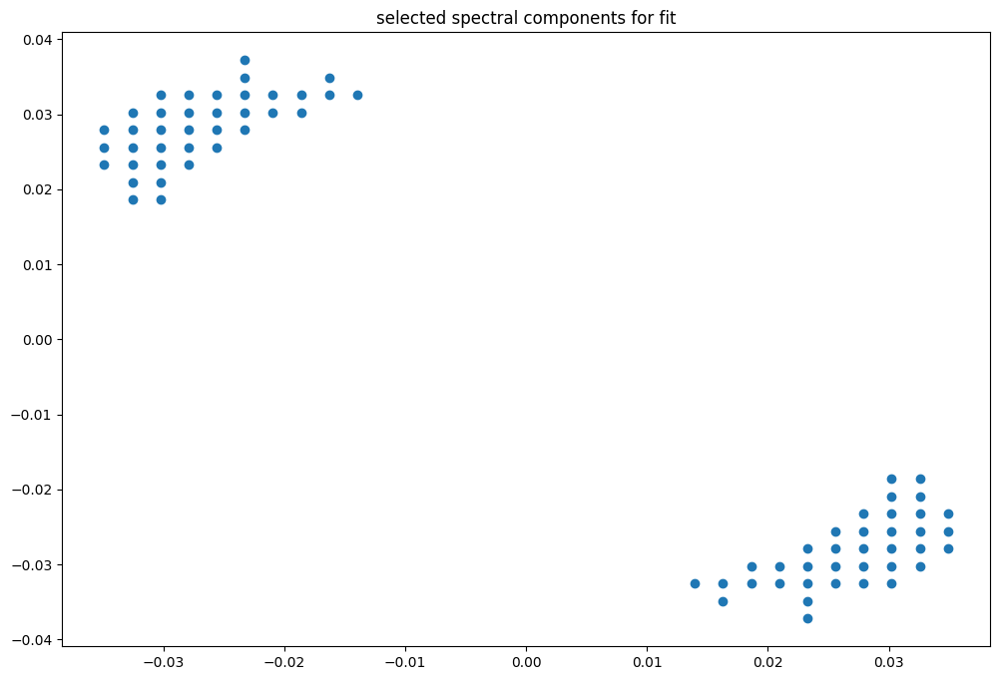

box [5500, 6200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

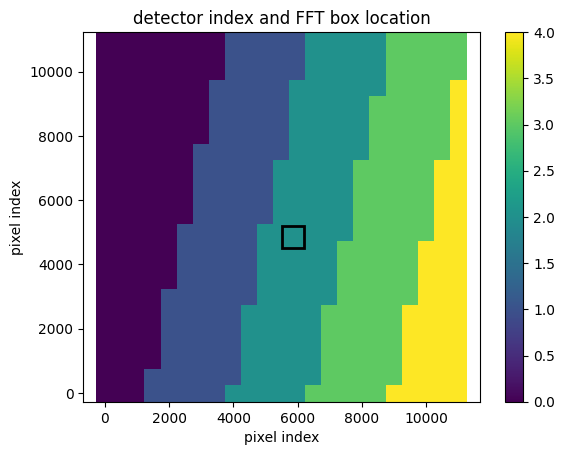

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


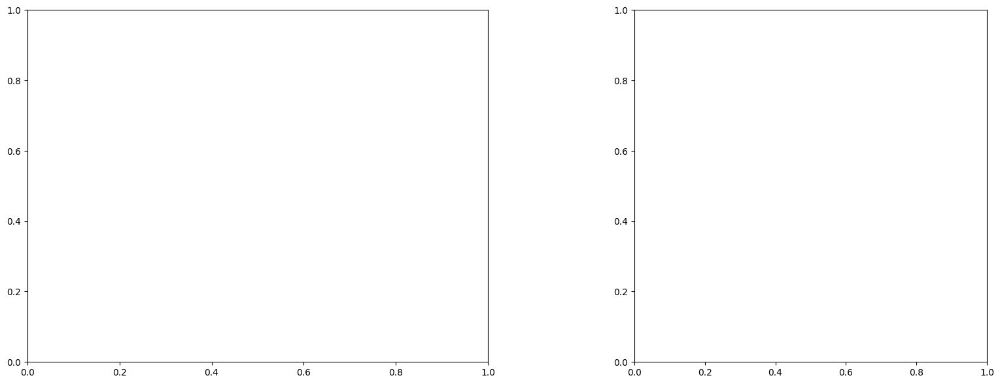

U and V components of current : [ 0.35248773 -0.63052199]
uncertainties for U and V: 0.11246162170324484 0.11680888685894979


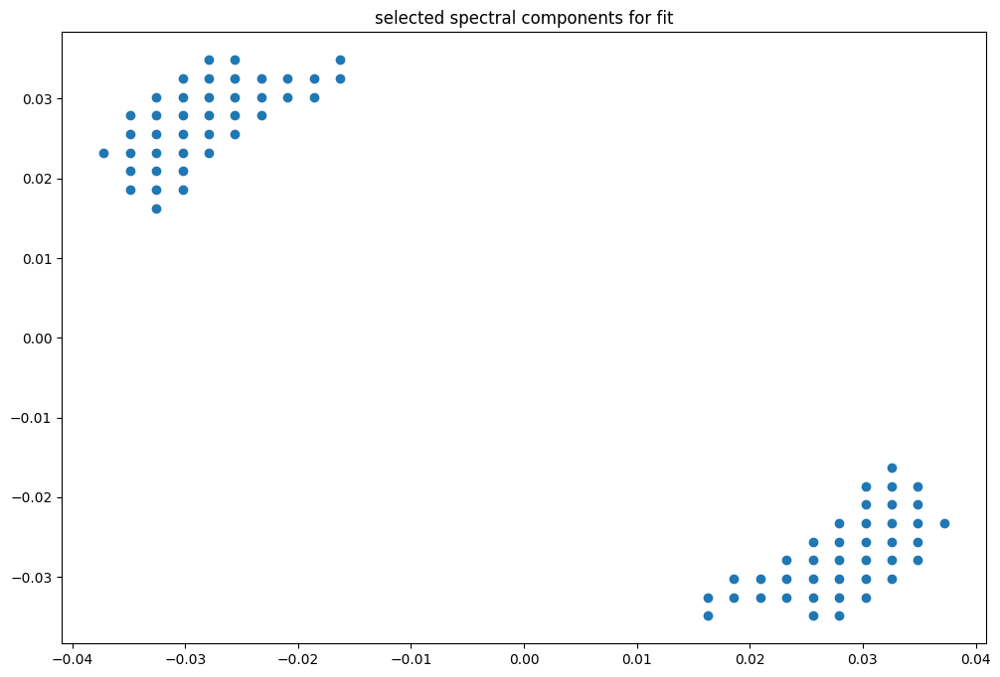

box [5500, 6200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

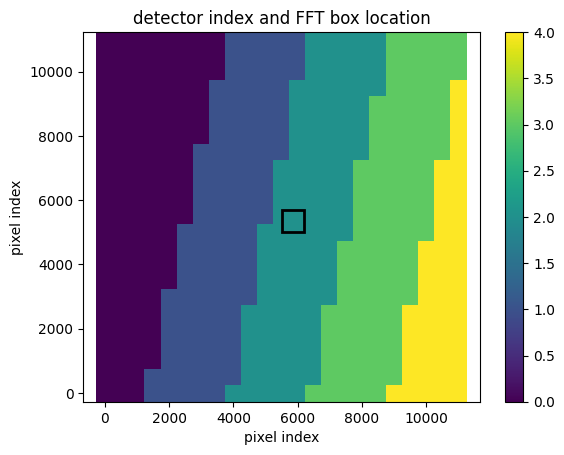

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


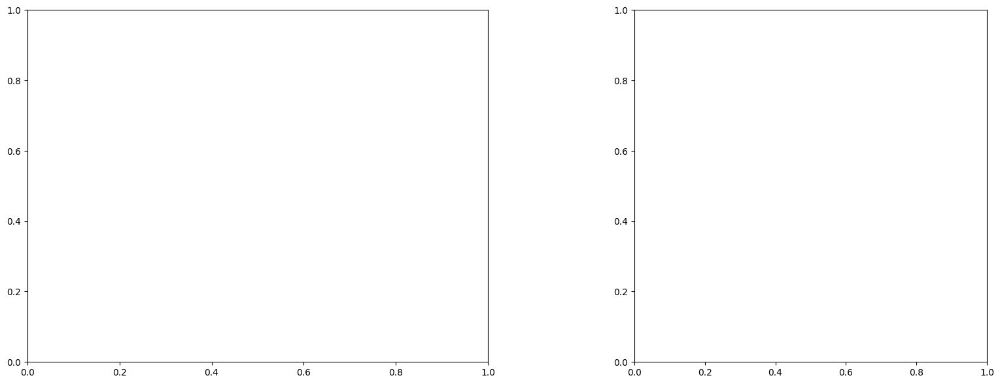

U and V components of current : [-0.57559128 -0.90141165]
uncertainties for U and V: 0.07072047244083314 0.068739503442402


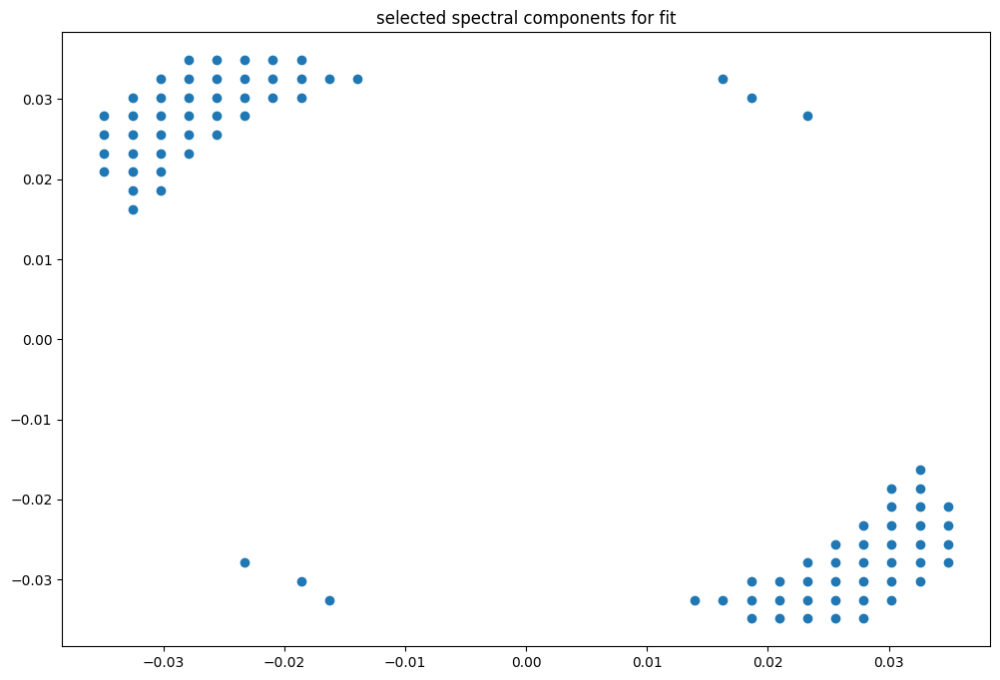

box [5500, 6200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

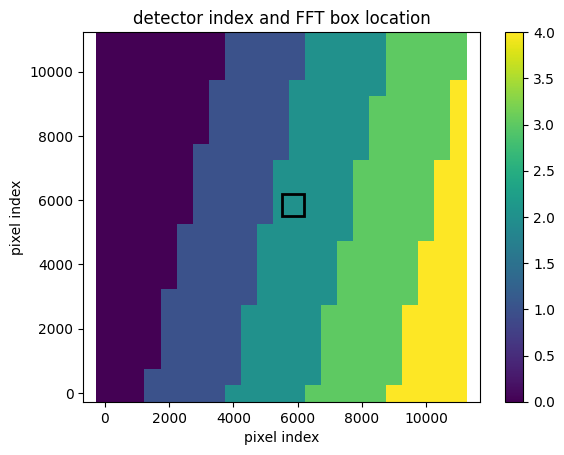

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


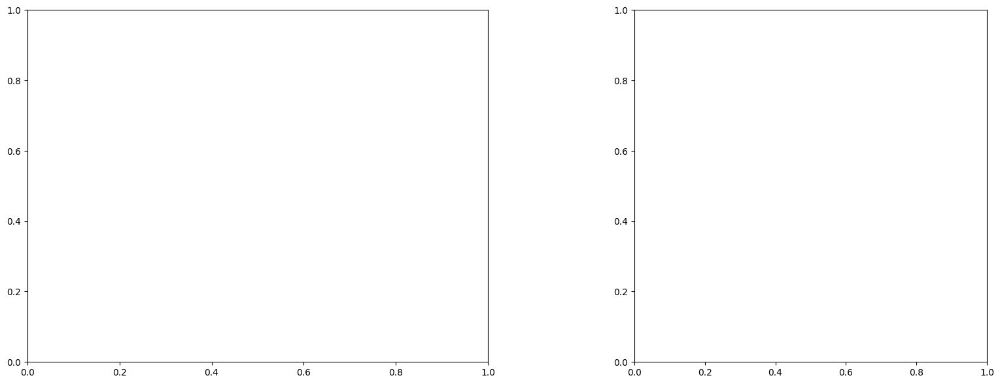

U and V components of current : [-0.68247047 -1.08461401]
uncertainties for U and V: 0.060922767243465736 0.05884871655717044


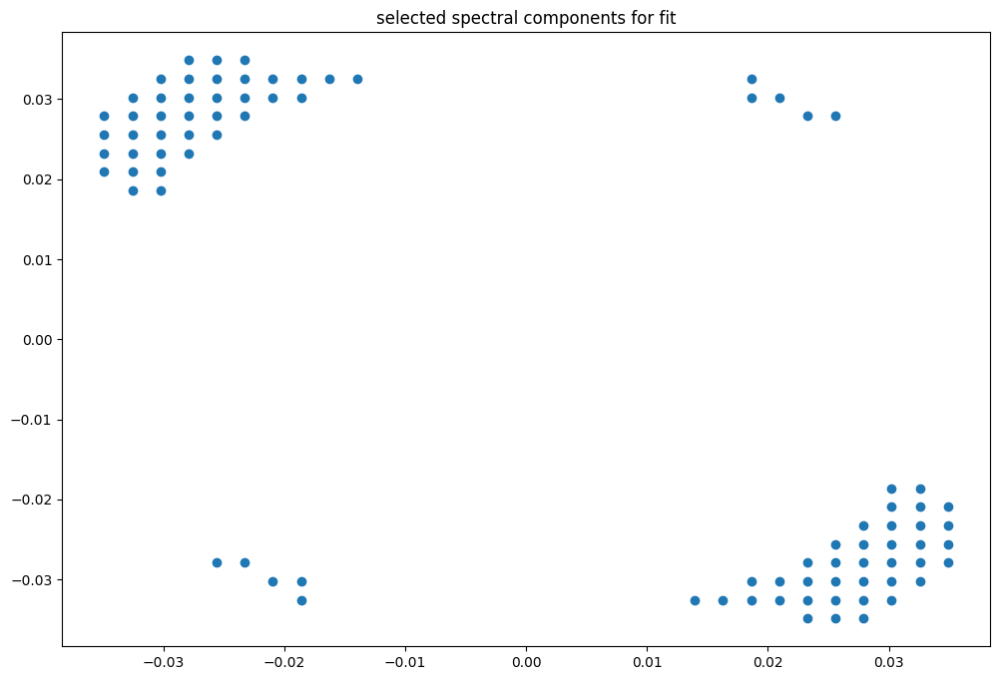

box [5500, 6200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

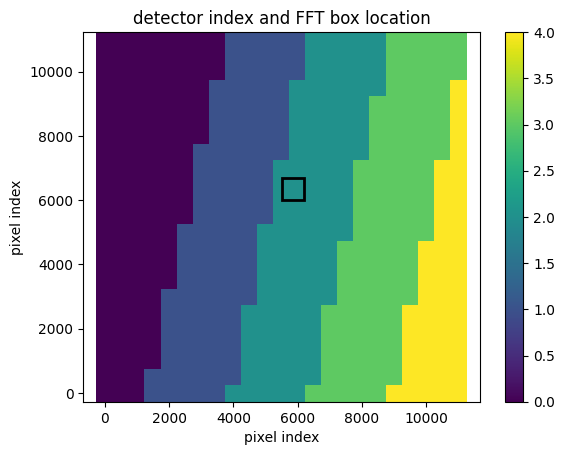

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


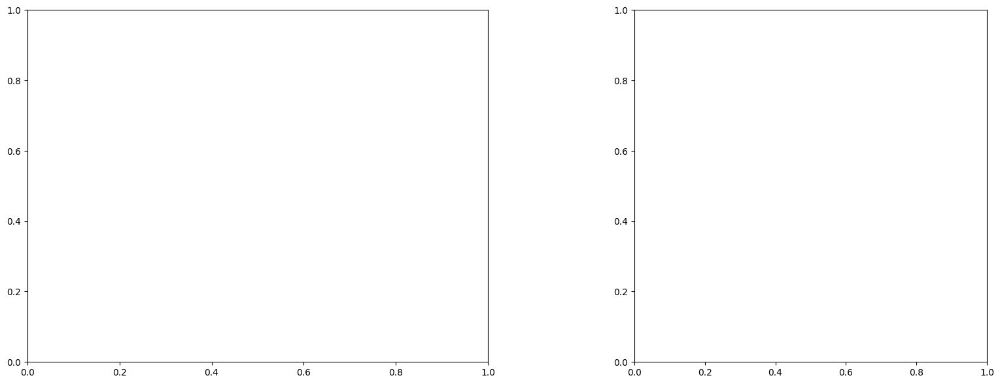

U and V components of current : [-0.32531675 -1.68385051]
uncertainties for U and V: 0.08741189802391547 0.09172787807028056


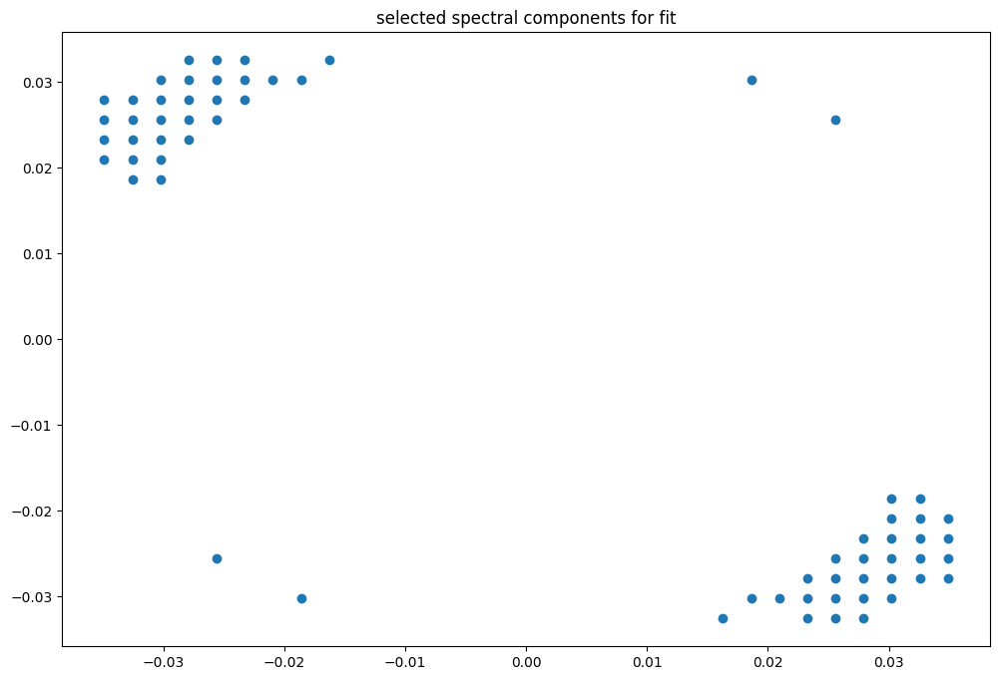

box [5500, 6200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

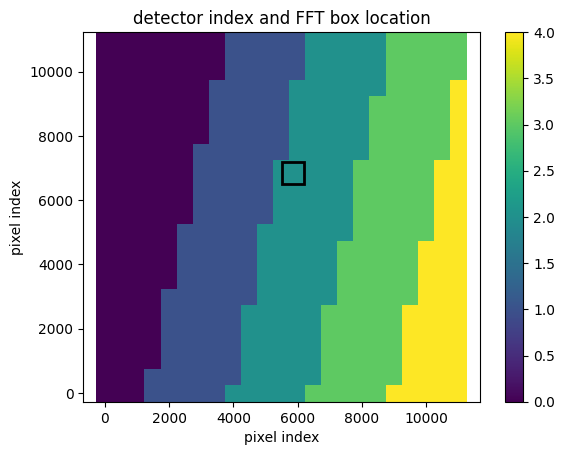

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


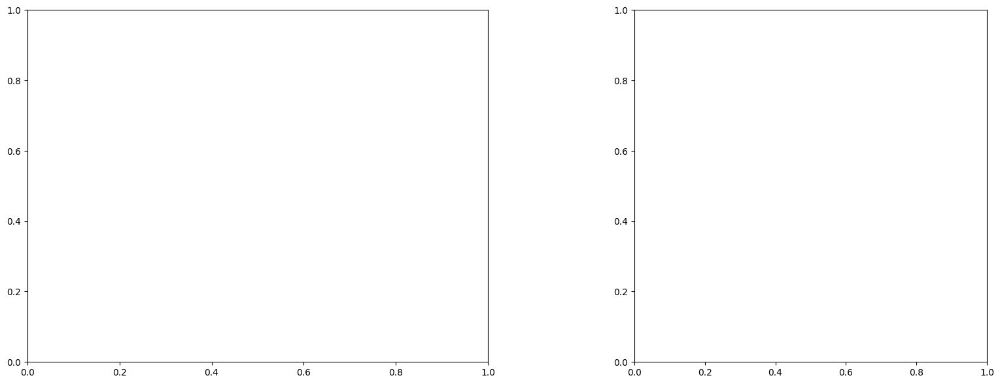

LinAlgError: Singular matrix

box [5500, 6200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

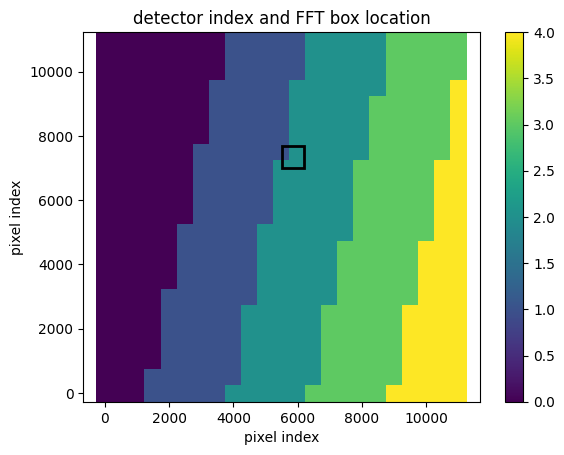

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.96
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


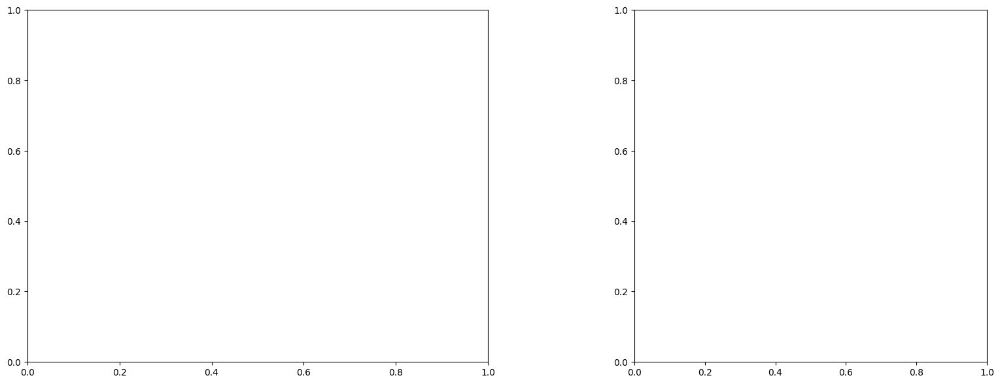

LinAlgError: Singular matrix

box [5500, 6200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

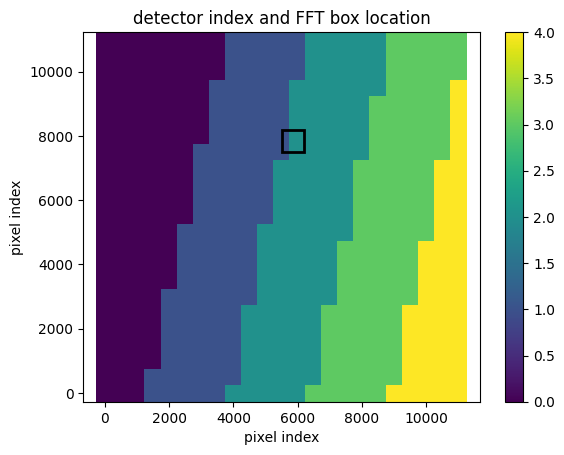

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


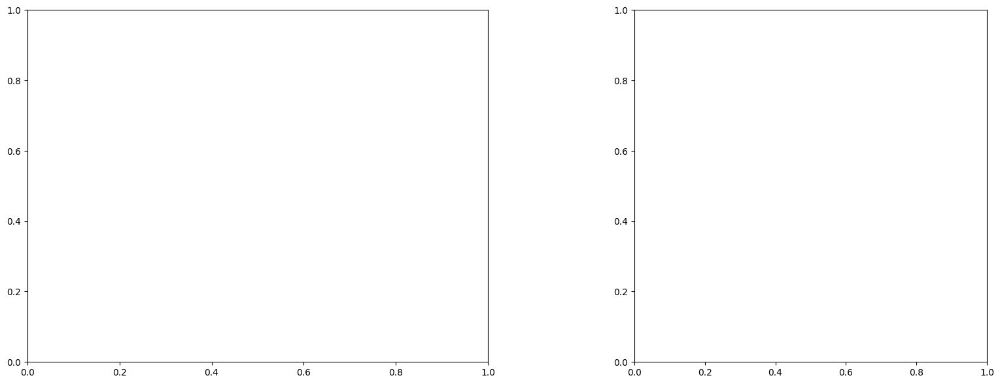

LinAlgError: Singular matrix

box [5500, 6200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

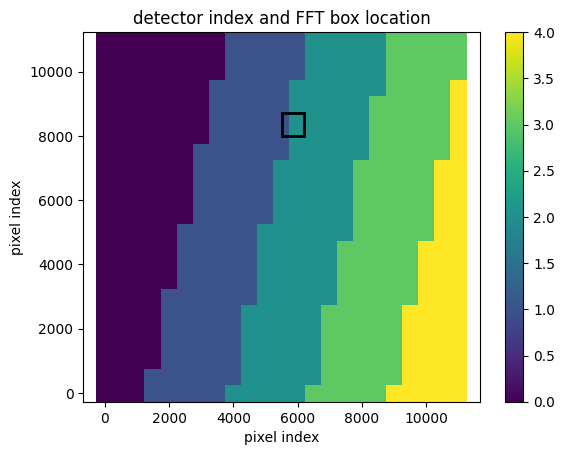

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


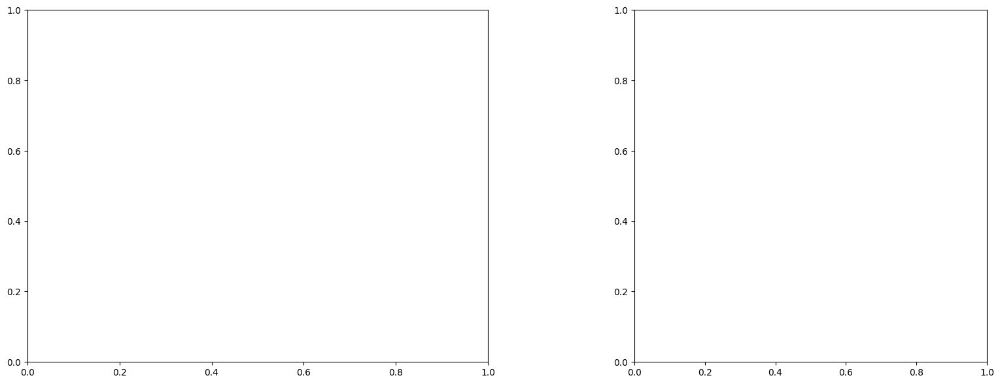

LinAlgError: Singular matrix

box [5500, 6200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

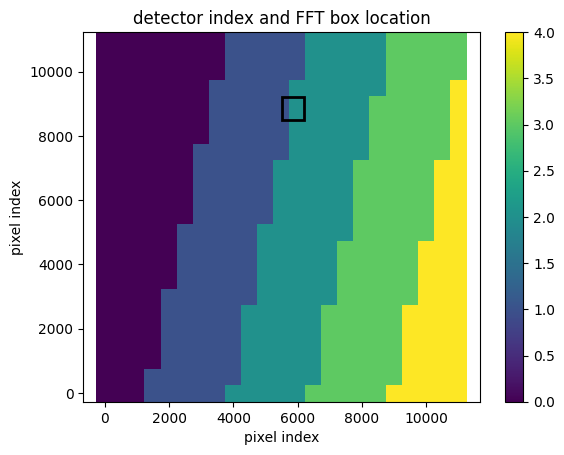

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


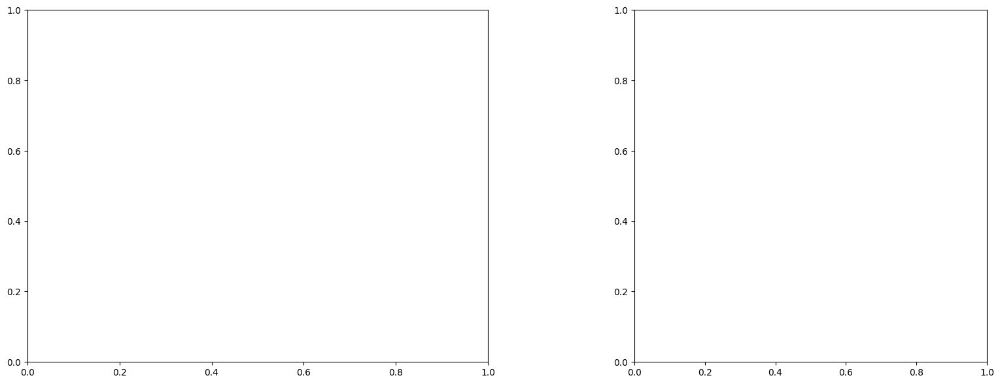

LinAlgError: Singular matrix

box [5500, 6200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

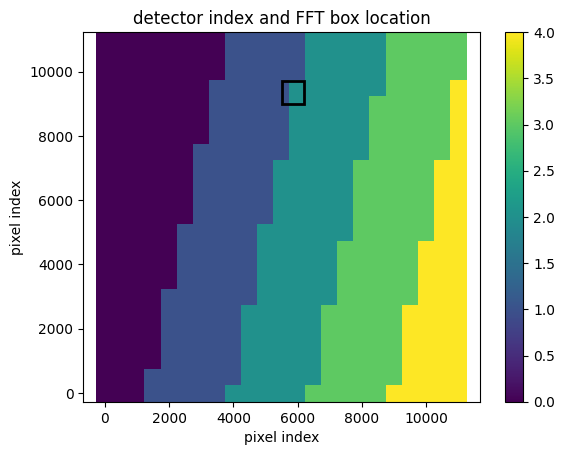

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


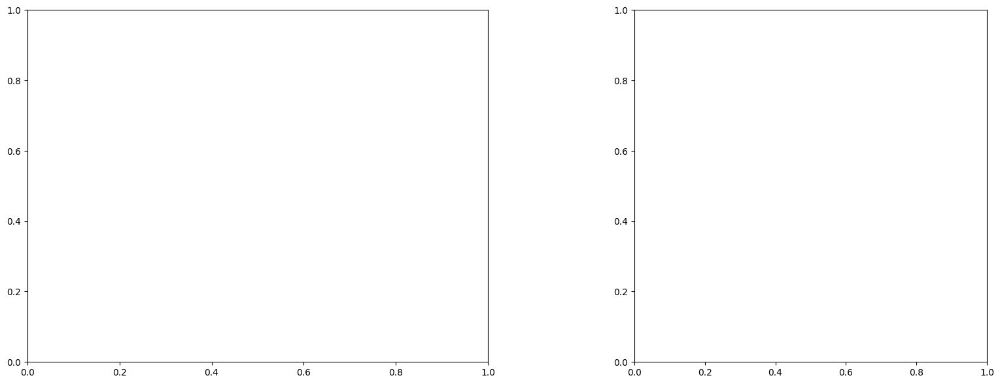

LinAlgError: Singular matrix

box [5500, 6200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

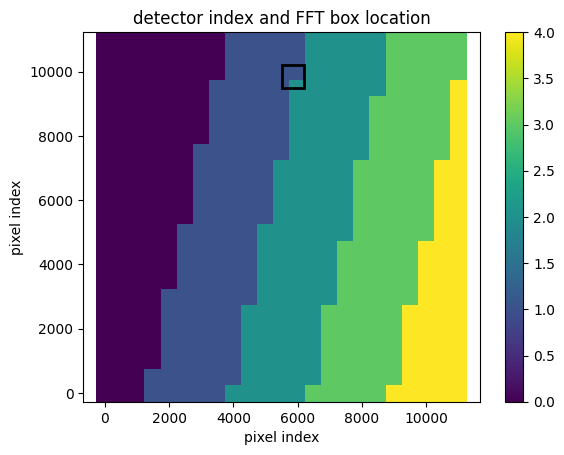

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075646809565215
(43, 43)
(43, 43)
(43, 43)


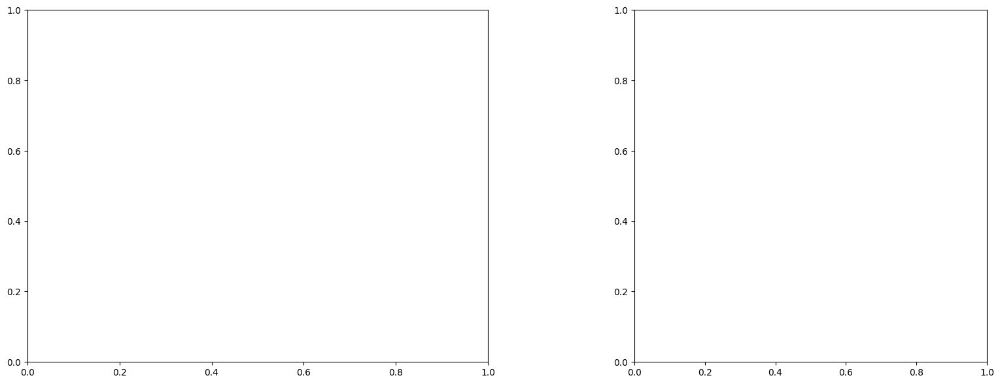

U and V components of current : [-0.2301349  -2.31868441]
uncertainties for U and V: 0.06311683531111834 0.06394676365227012


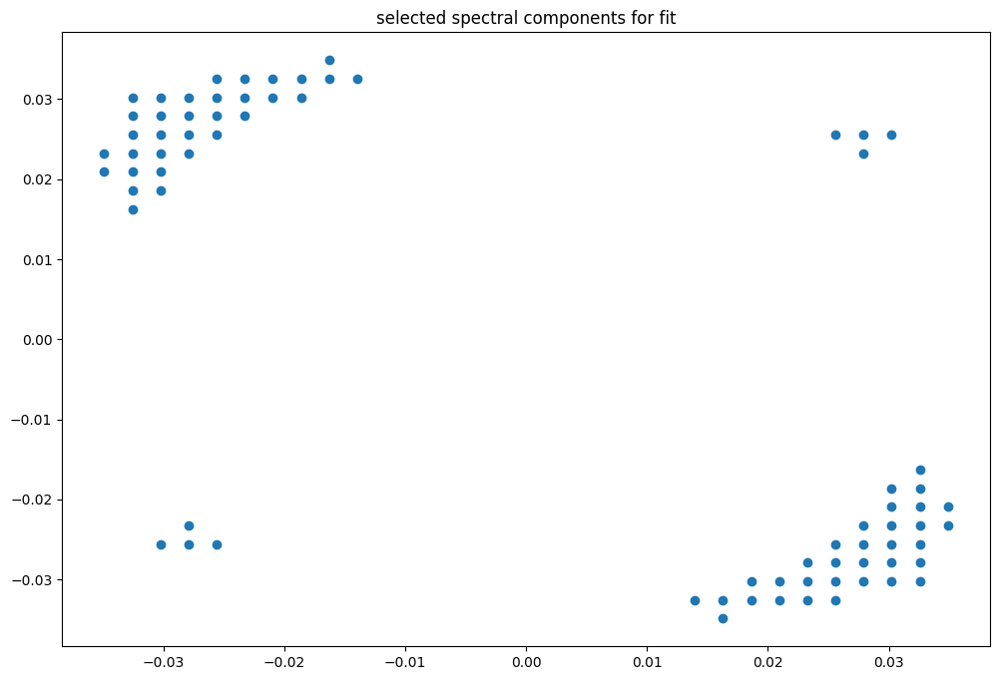

box [5500, 6200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

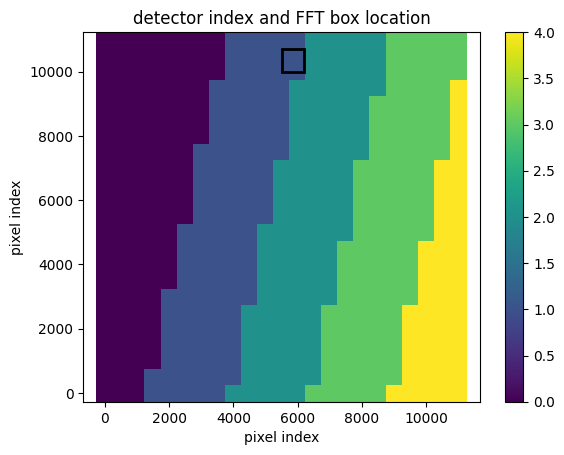

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075625671808175
(43, 43)
(43, 43)
(43, 43)


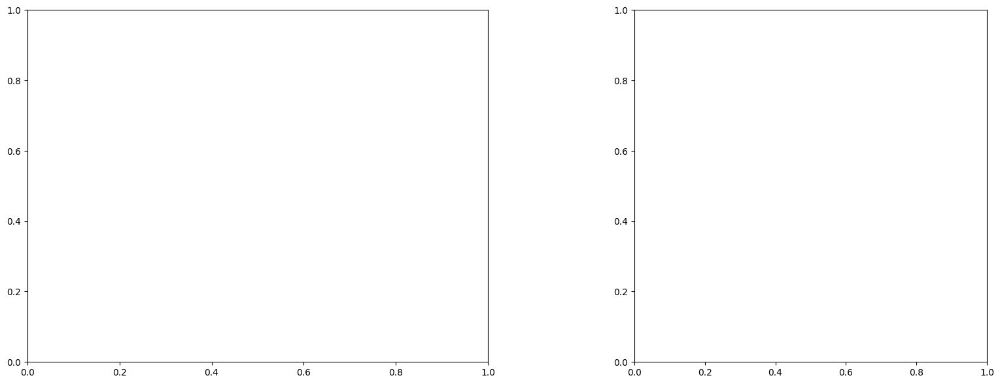

U and V components of current : [-0.21299898 -1.96502115]
uncertainties for U and V: 0.07450929413469198 0.07368113161056618


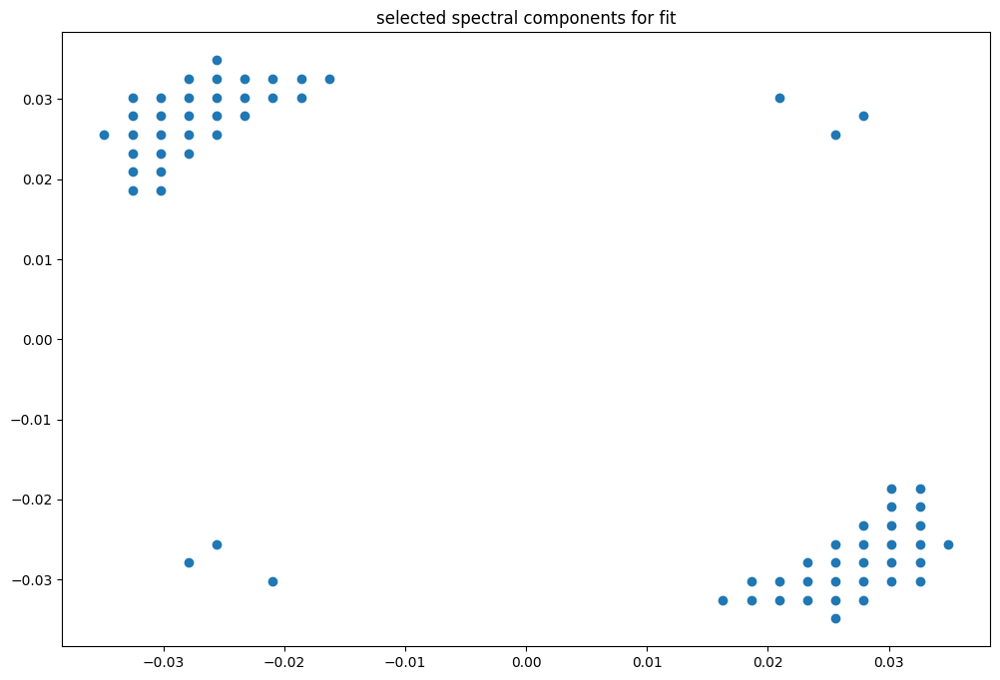

box [5500, 6200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

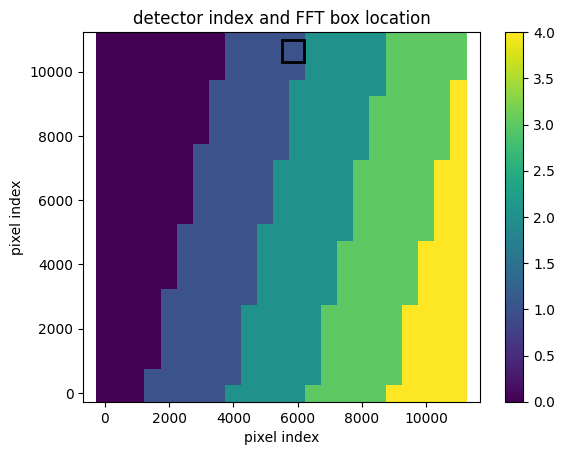

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.0
D01
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 1.0075605963501626
(43, 42)
(43, 42)
(43, 42)


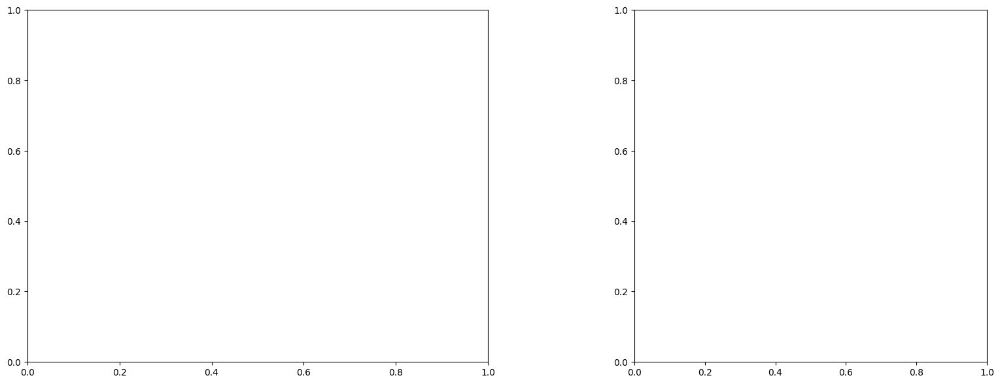

U and V components of current : [-0.37514087 -2.41758762]
uncertainties for U and V: 0.0653713871675642 0.06470678861025927


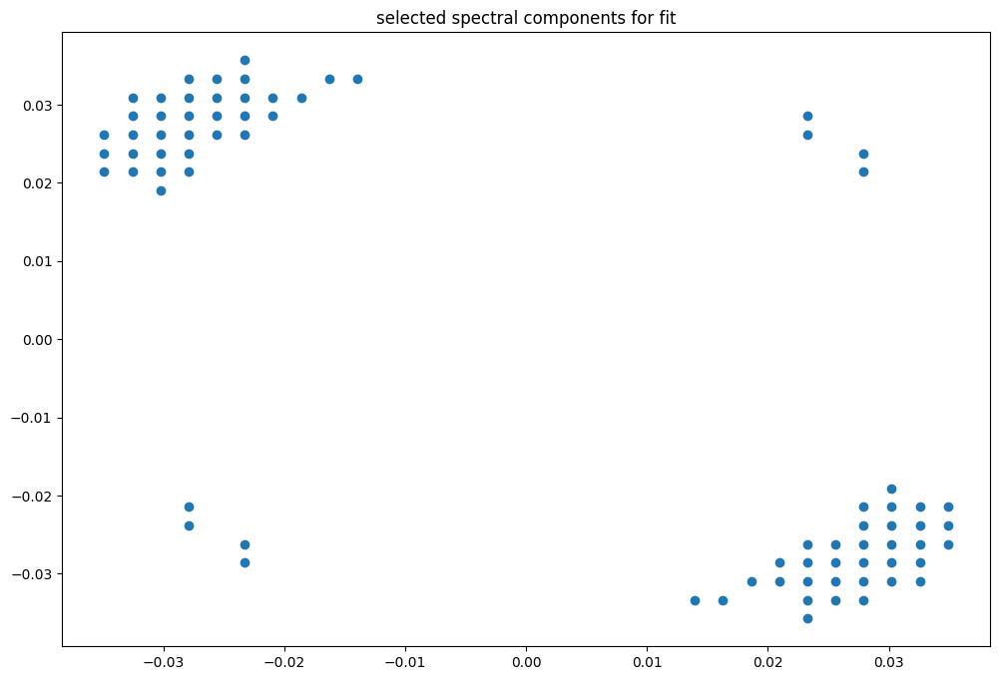

box [6000, 6700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

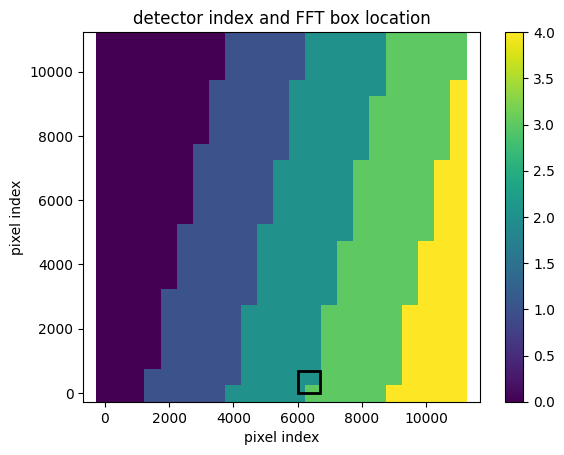

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.26
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091455365369024
(43, 43)
(43, 43)
(43, 43)


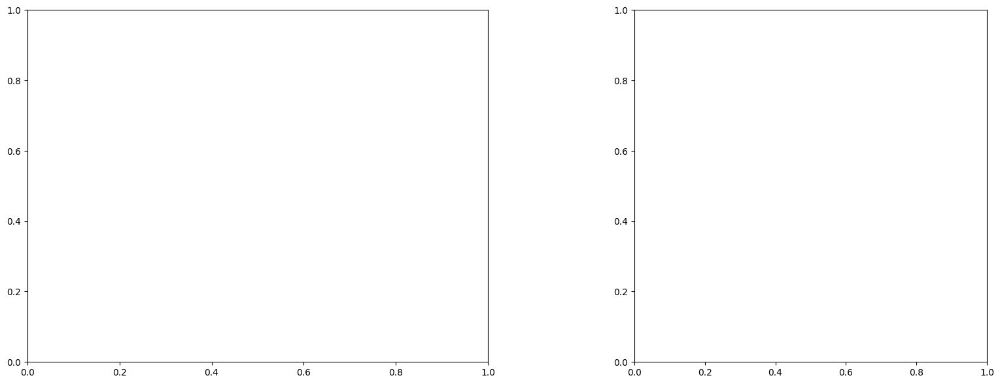

U and V components of current : [ 1.27934461 -0.72451718]
uncertainties for U and V: 0.1486550113963086 0.14383133288901667


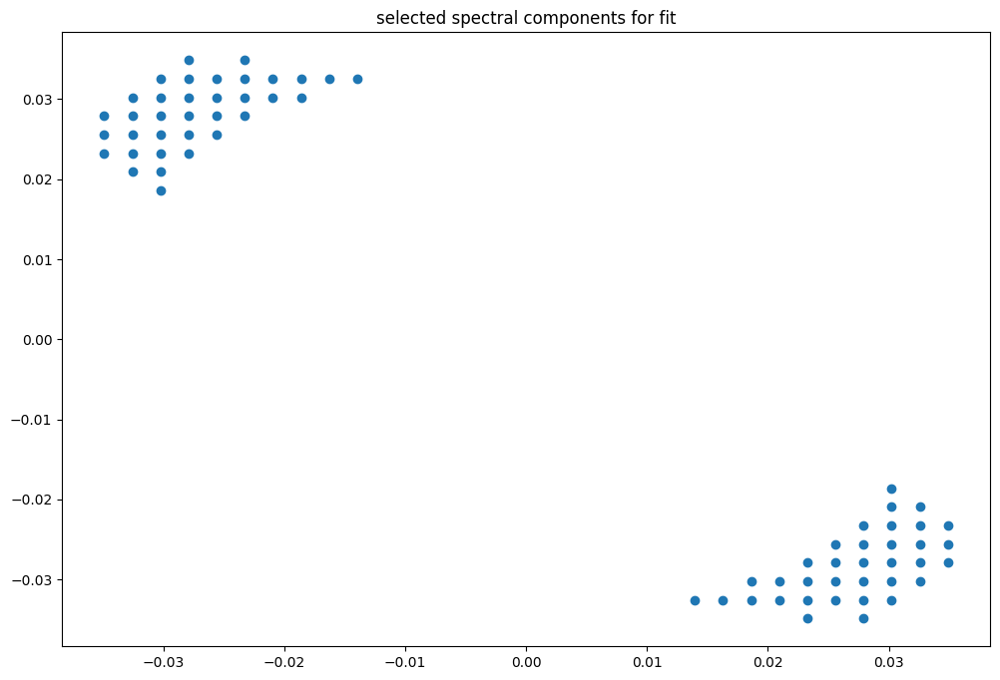

box [6000, 6700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

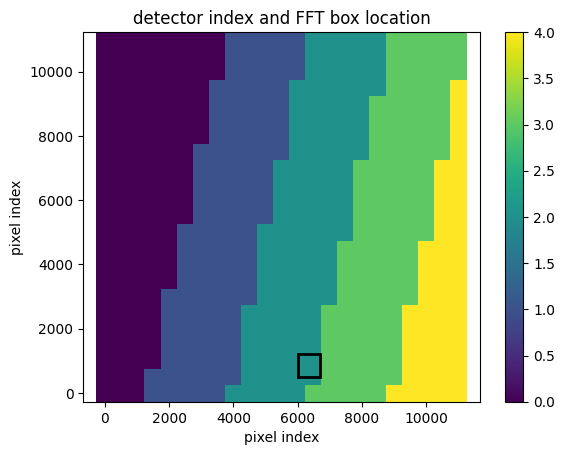

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


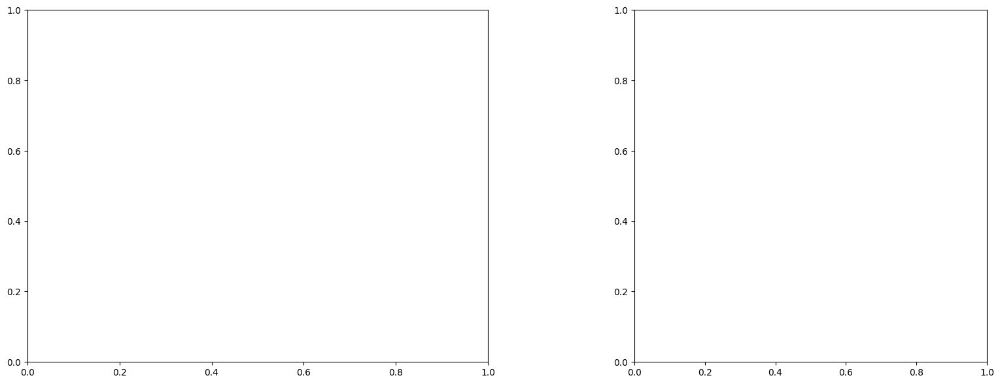

U and V components of current : [ 0.56742207 -0.86777053]
uncertainties for U and V: 0.1161395746097965 0.1125292076090509


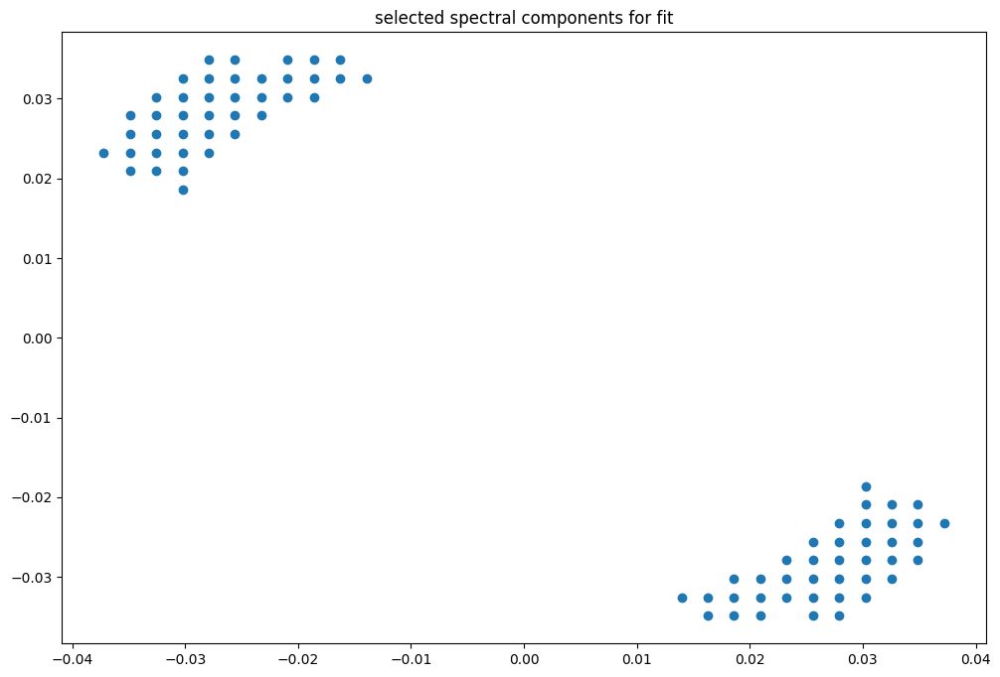

box [6000, 6700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

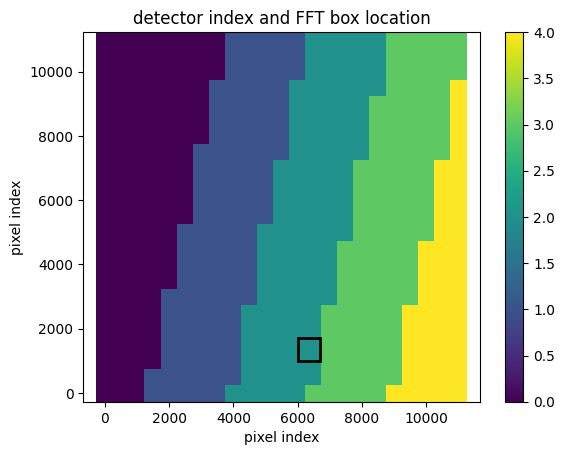

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091429022521774
(43, 43)
(43, 43)
(43, 43)


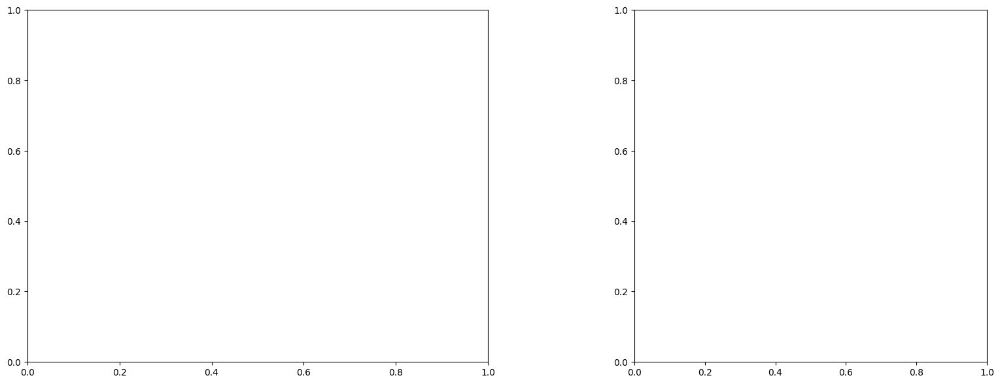

U and V components of current : [ 1.1092728  -0.40031785]
uncertainties for U and V: 0.11900332171252054 0.12257617814499866


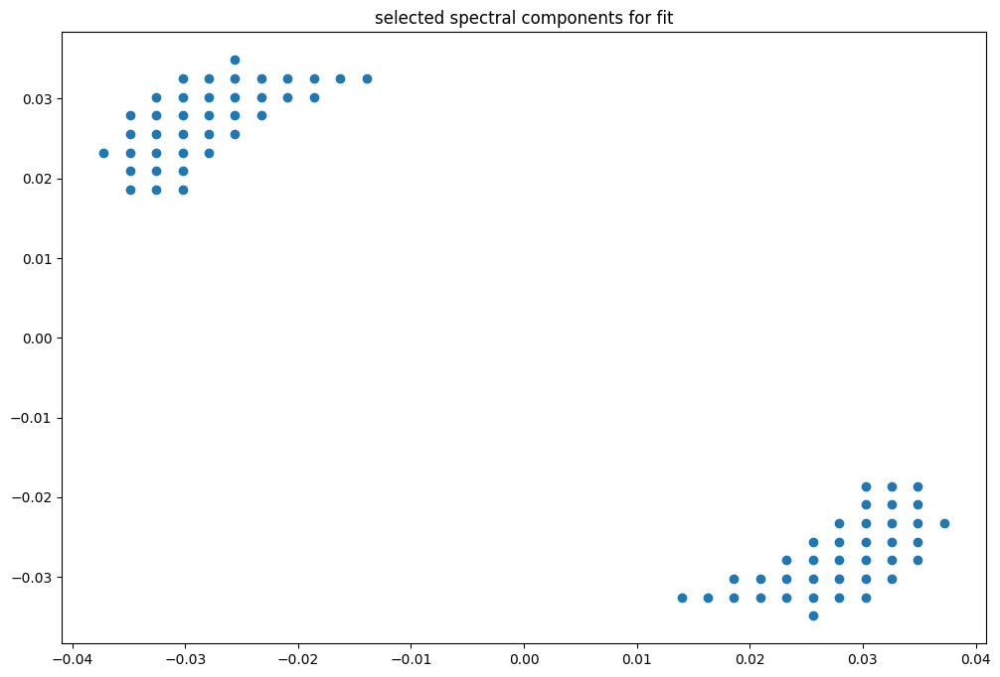

box [6000, 6700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

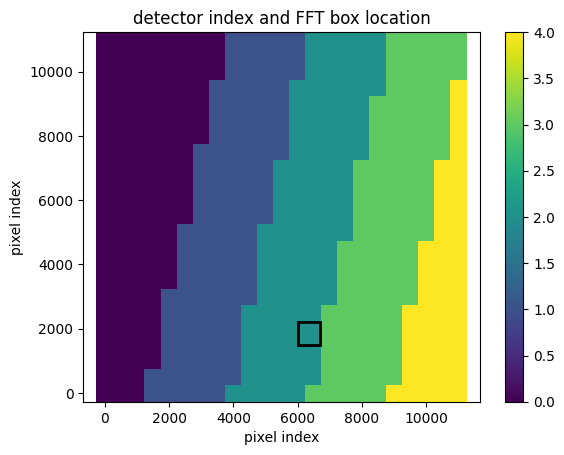

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091401336510668
(43, 43)
(43, 43)
(43, 43)


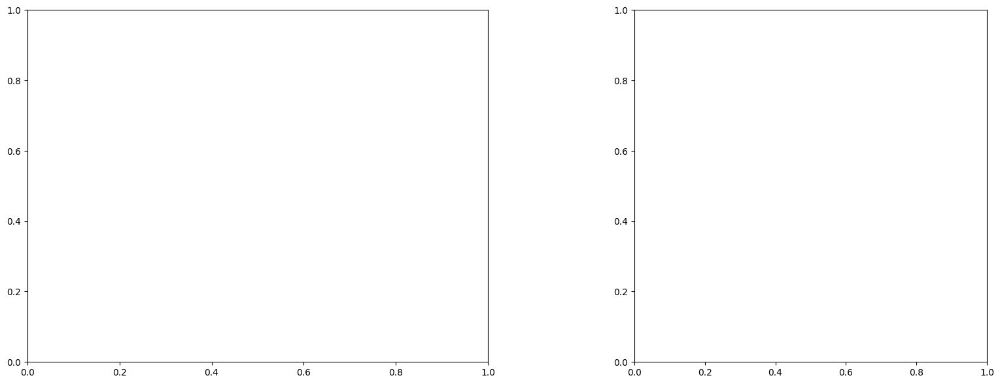

U and V components of current : [ 0.17000874 -0.97502045]
uncertainties for U and V: 0.08951091244413703 0.09240153814397595


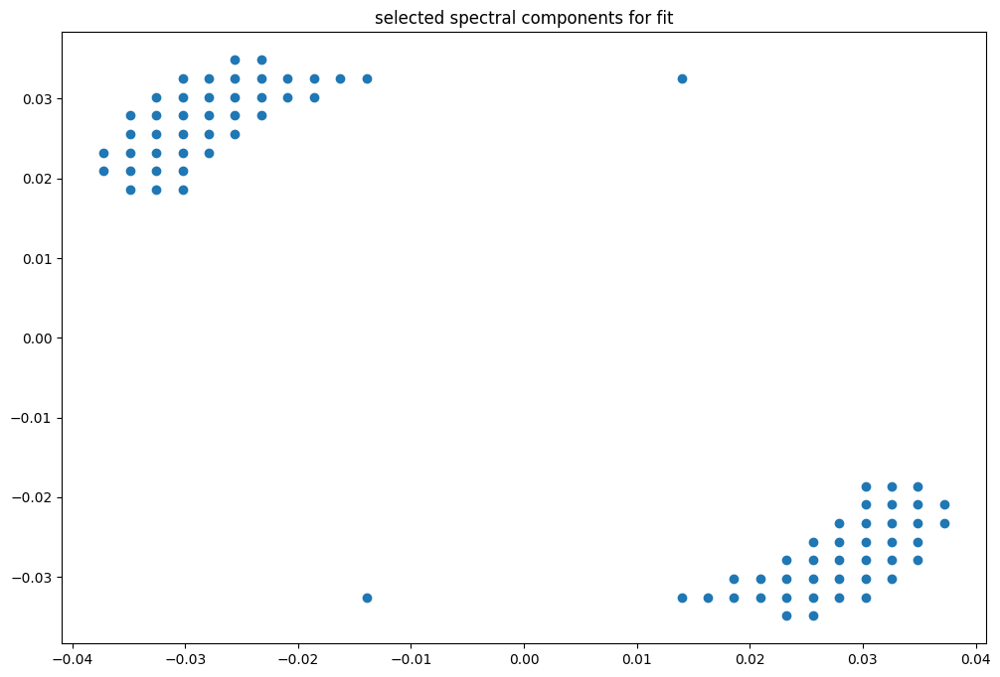

box [6000, 6700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

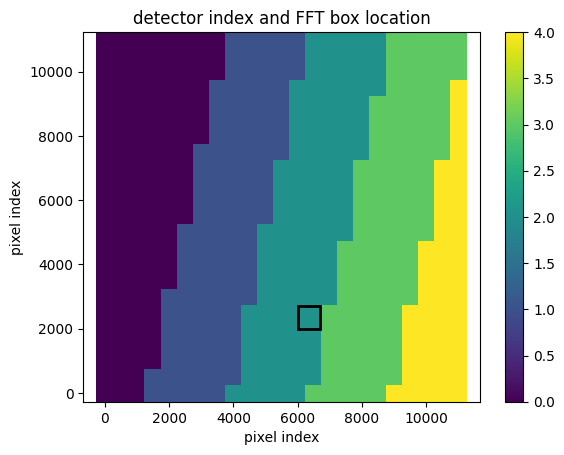

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


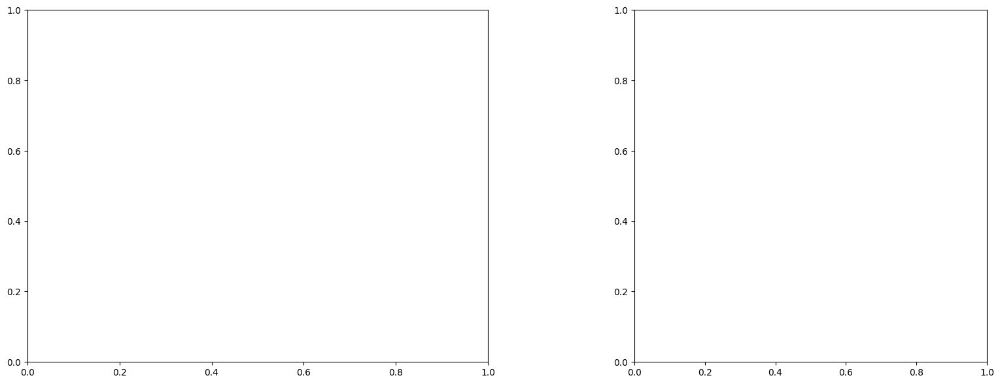

U and V components of current : [ 0.38164944 -0.97815326]
uncertainties for U and V: 0.09220406228677497 0.09407089544287855


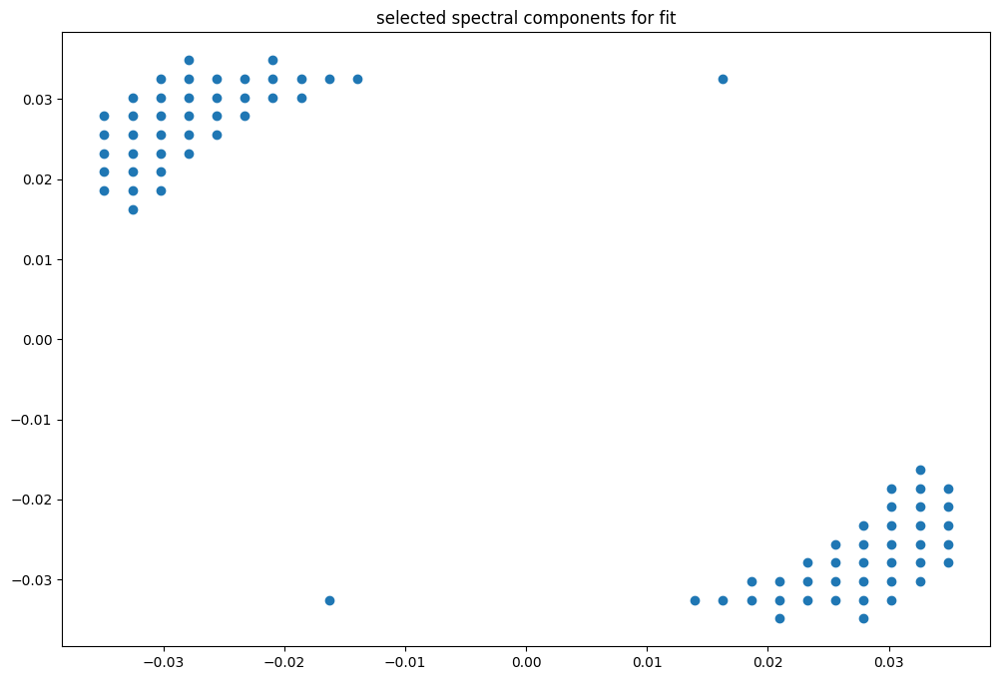

box [6000, 6700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

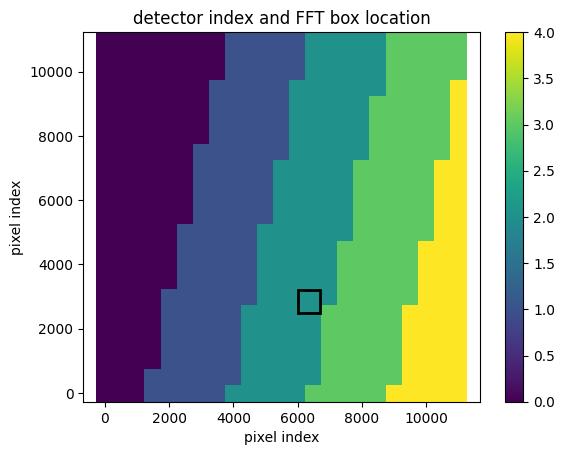

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091375920383594
(43, 43)
(43, 43)
(43, 43)


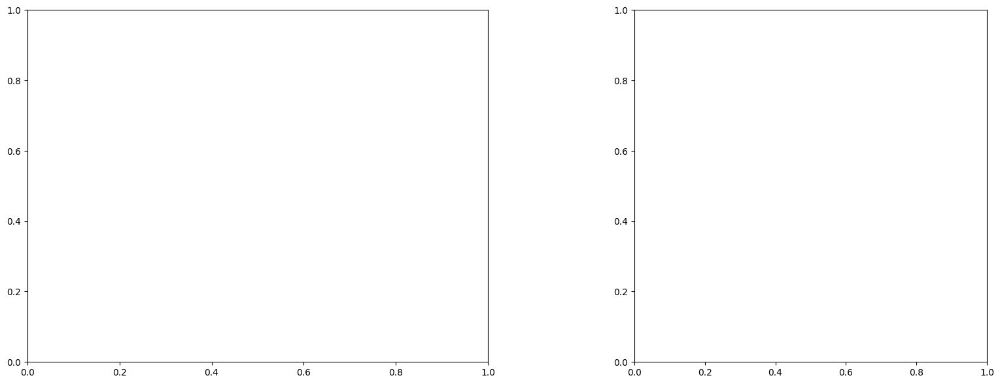

U and V components of current : [ 0.6526347  -0.57973746]
uncertainties for U and V: 0.13146100928203183 0.1338749490350697


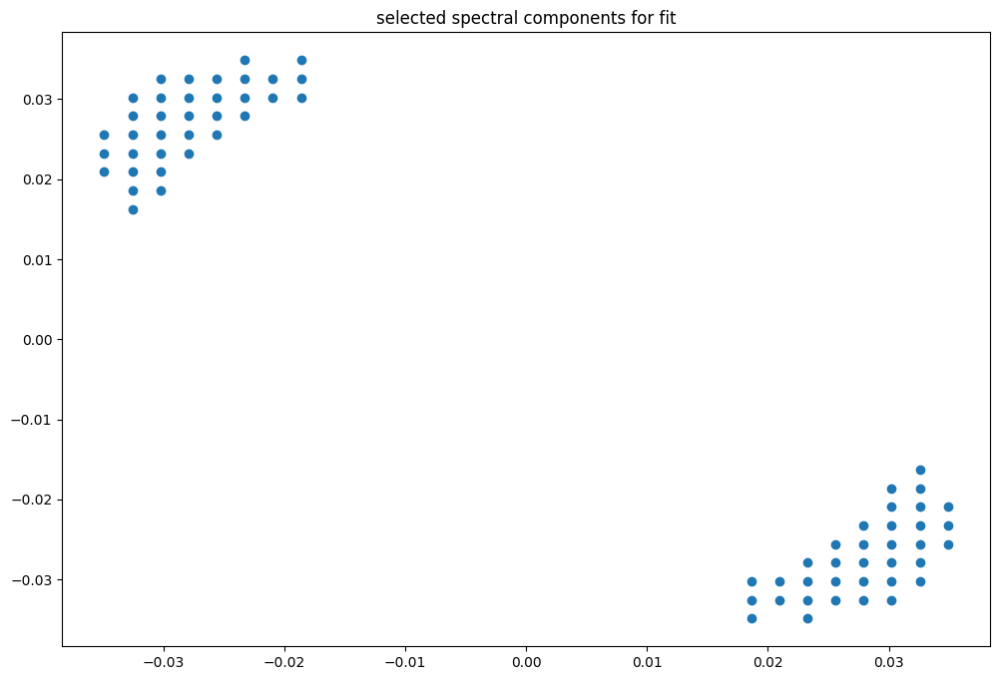

box [6000, 6700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

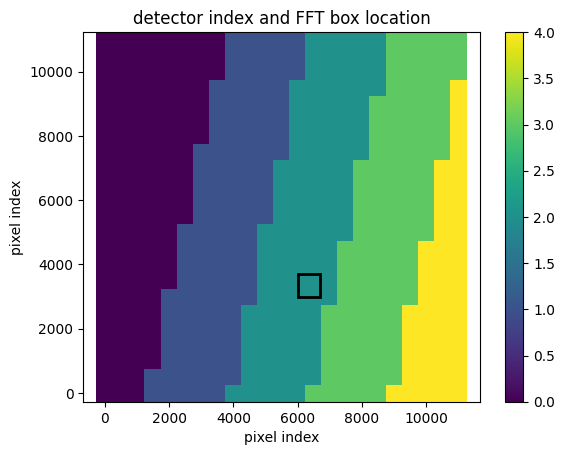

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


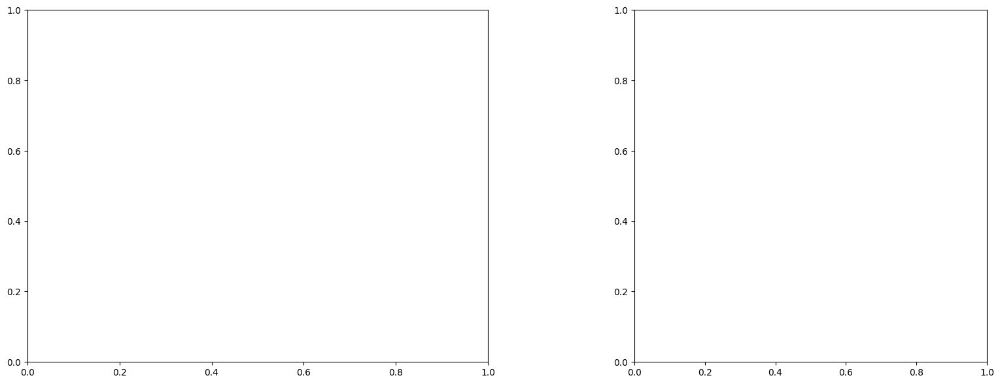

U and V components of current : [-0.29832274 -1.31296519]
uncertainties for U and V: 0.10721502108992942 0.10392208061789017


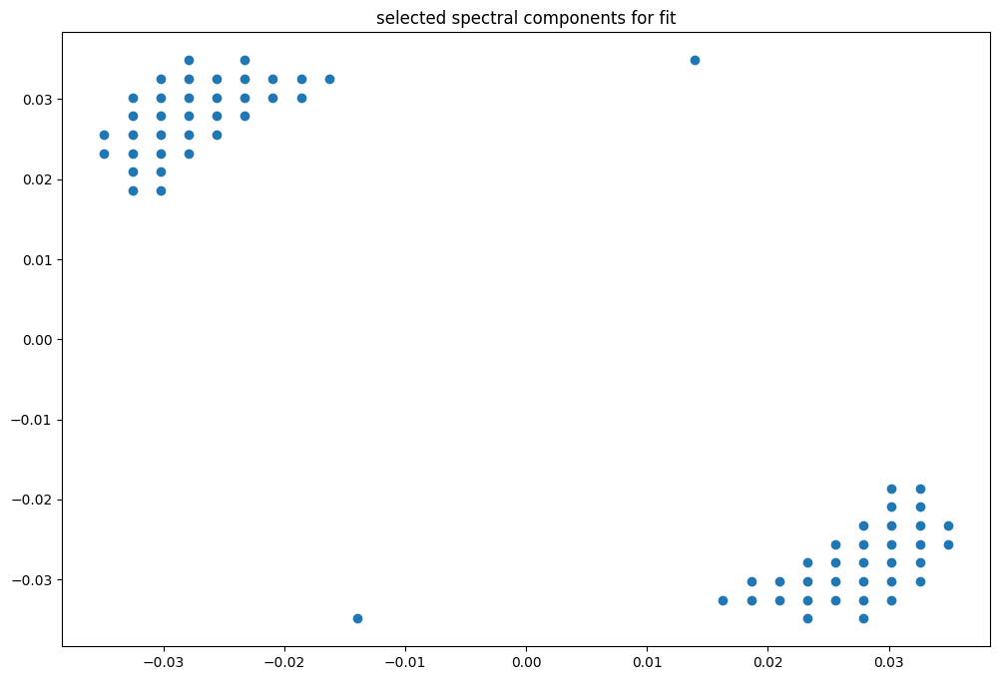

box [6000, 6700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

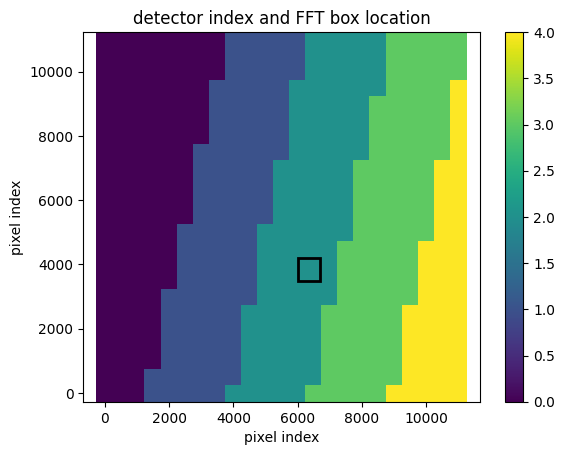

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


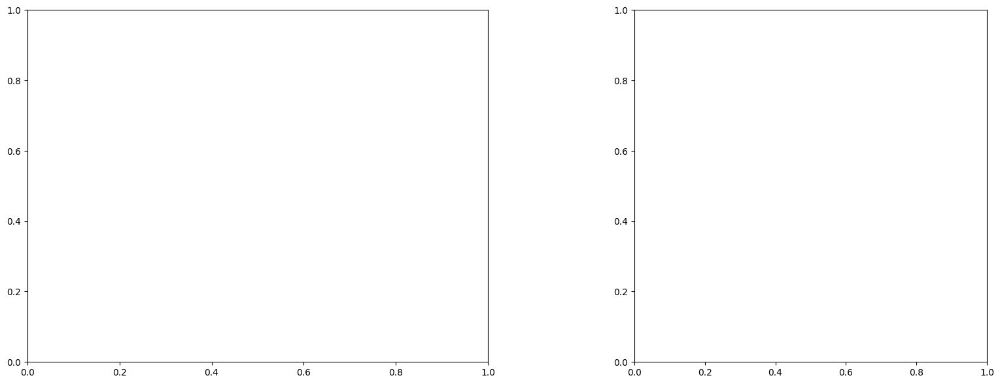

U and V components of current : [ 0.5163552  -0.40000759]
uncertainties for U and V: 0.13673143312521951 0.13508099476352806


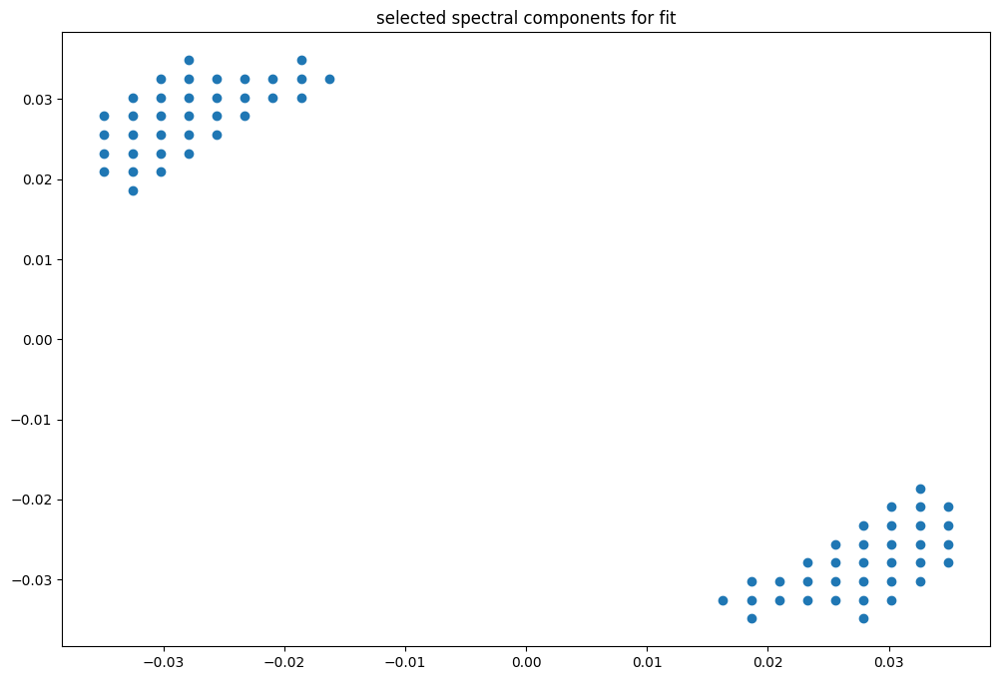

box [6000, 6700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

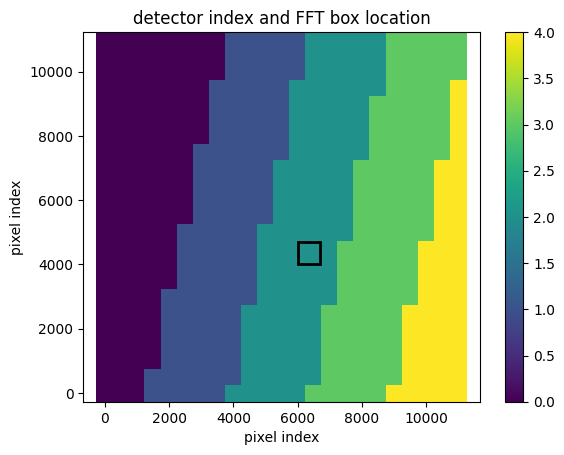

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


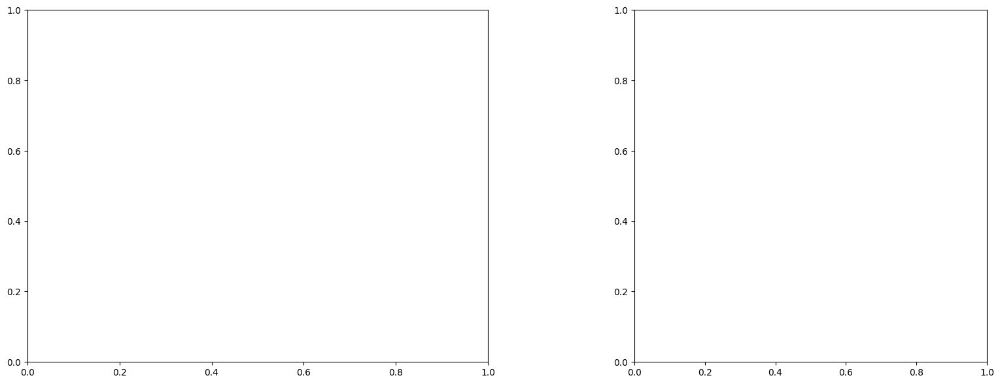

U and V components of current : [ 0.57368961 -0.67999545]
uncertainties for U and V: 0.14700573951646684 0.14509897787510195


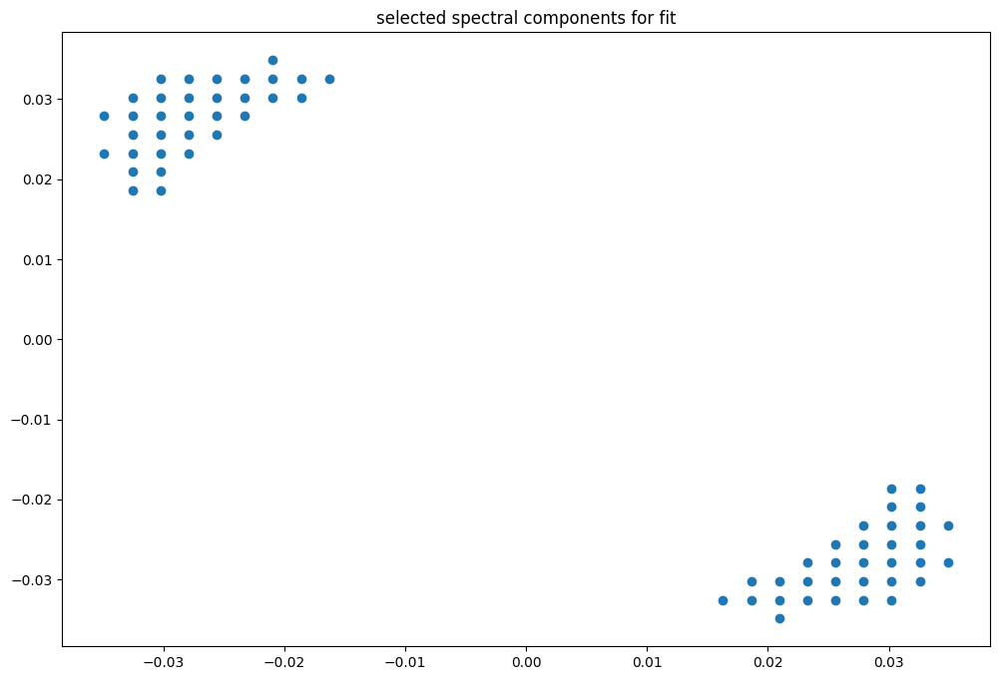

box [6000, 6700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

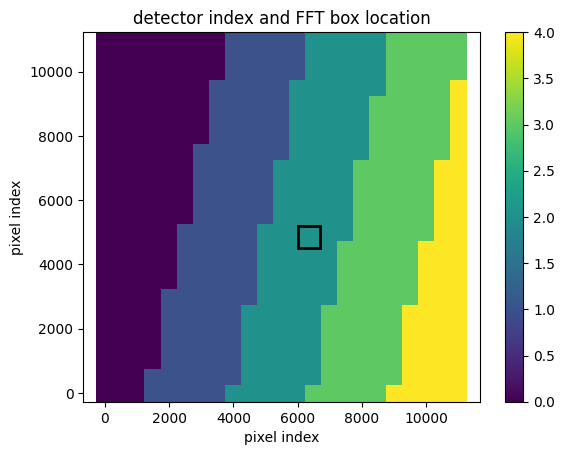

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


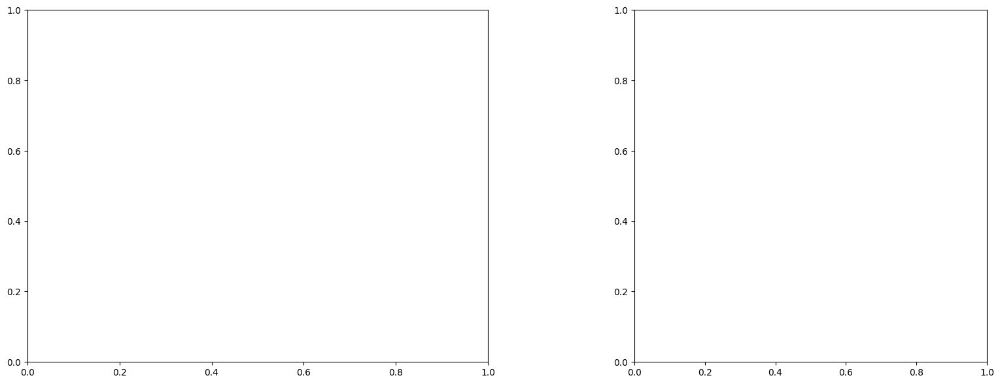

U and V components of current : [-0.41711969 -1.51008789]
uncertainties for U and V: 0.08276107634156968 0.07922117092162093


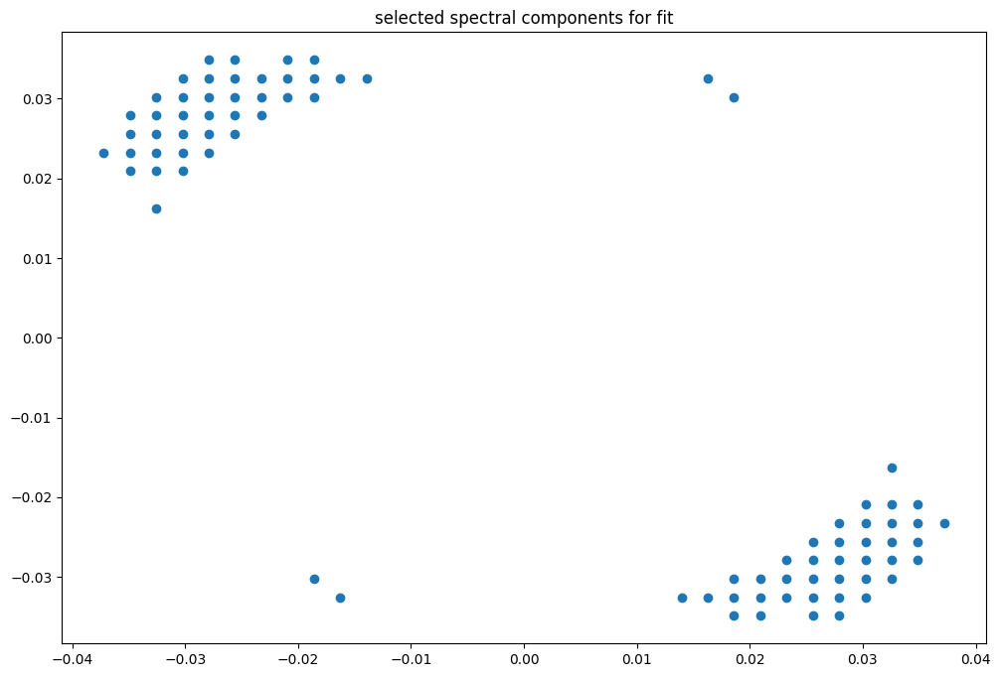

box [6000, 6700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

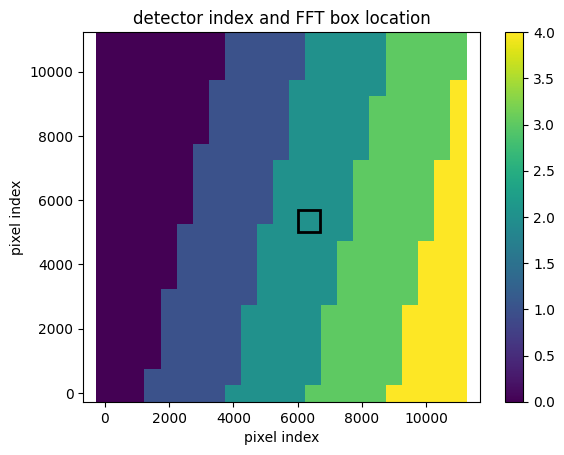

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


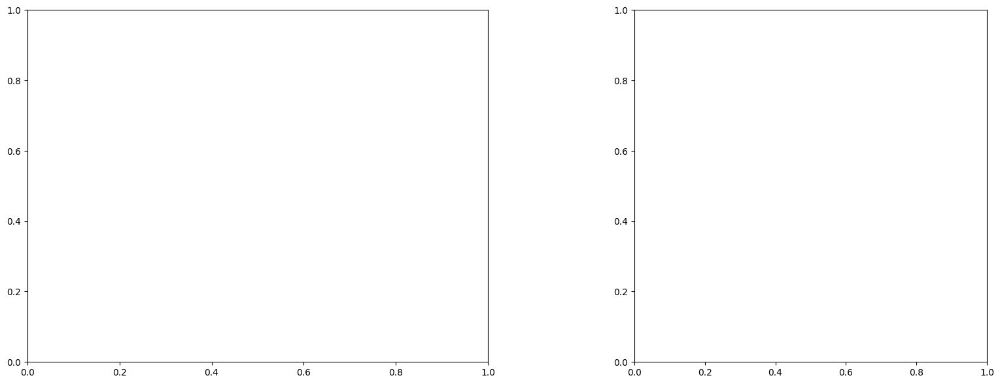

U and V components of current : [-0.68743203 -1.3943922 ]
uncertainties for U and V: 0.06001643367135124 0.056791842366641206


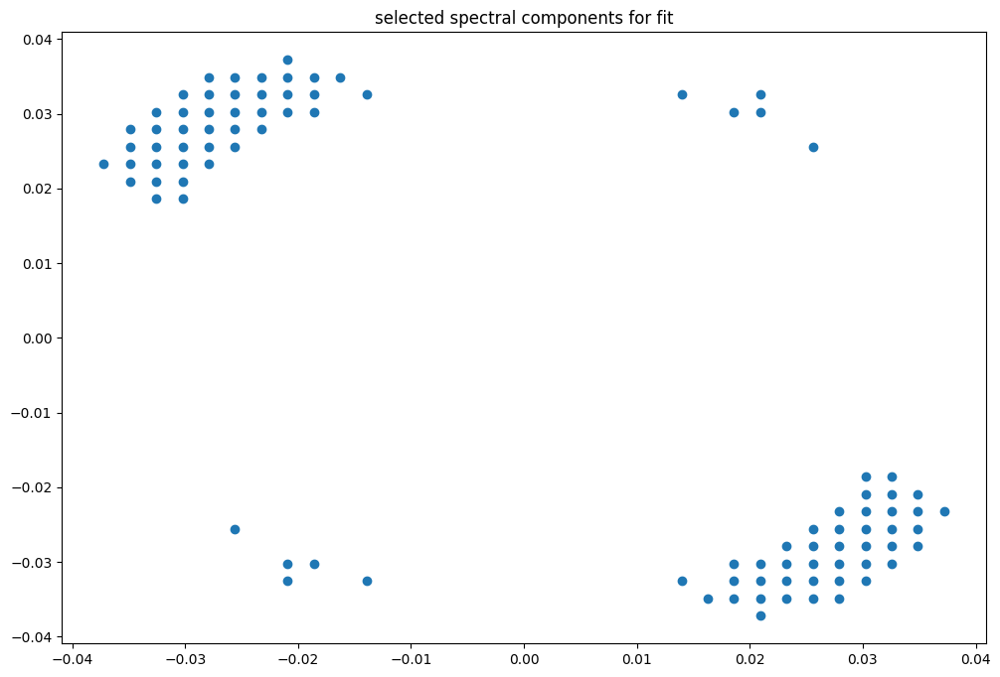

box [6000, 6700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

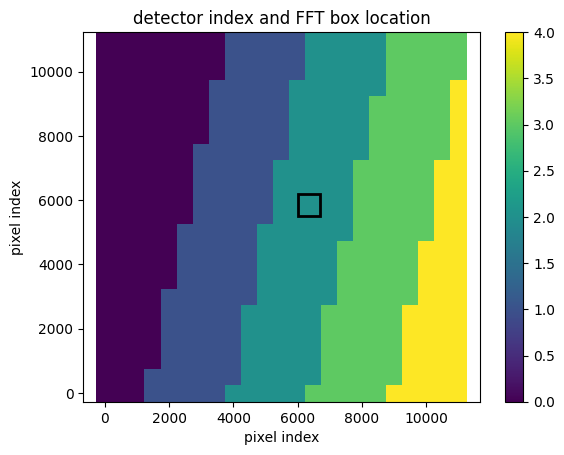

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


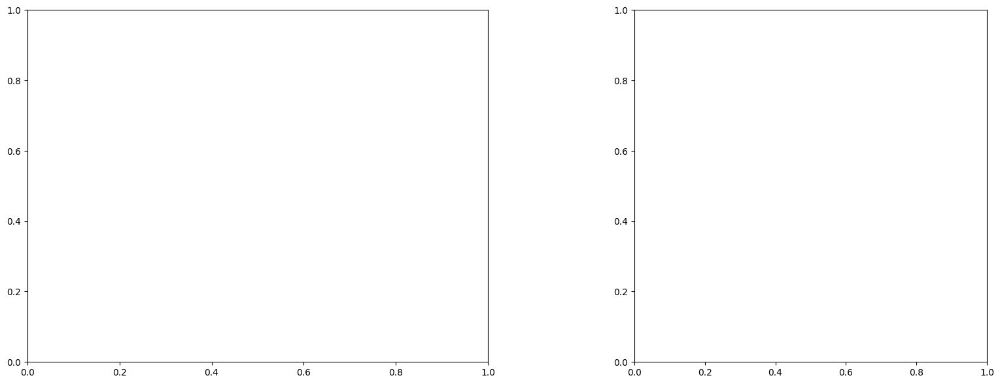

U and V components of current : [ 0.23998724 -0.53475916]
uncertainties for U and V: 0.12347231283319733 0.11869746684641634


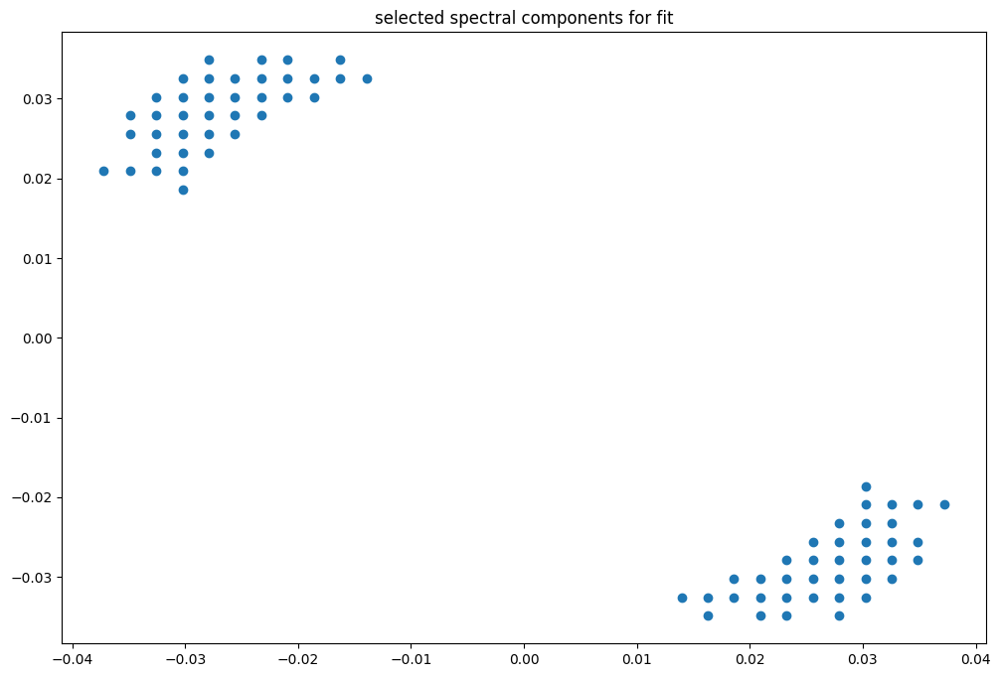

box [6000, 6700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

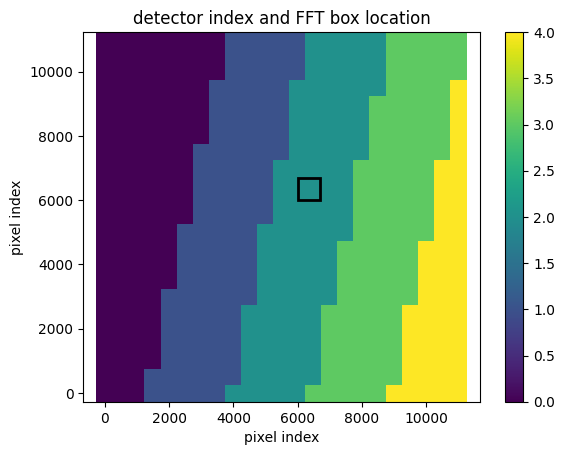

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


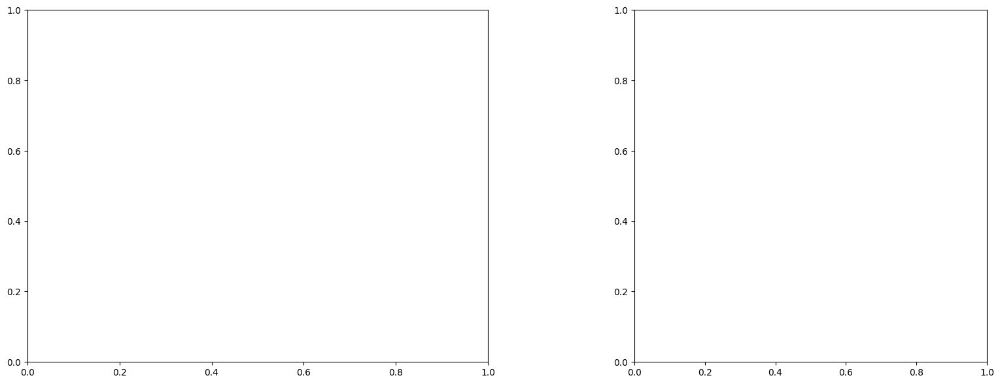

U and V components of current : [ 0.10252609 -1.10565922]
uncertainties for U and V: 0.12997288527977252 0.13339468319562453


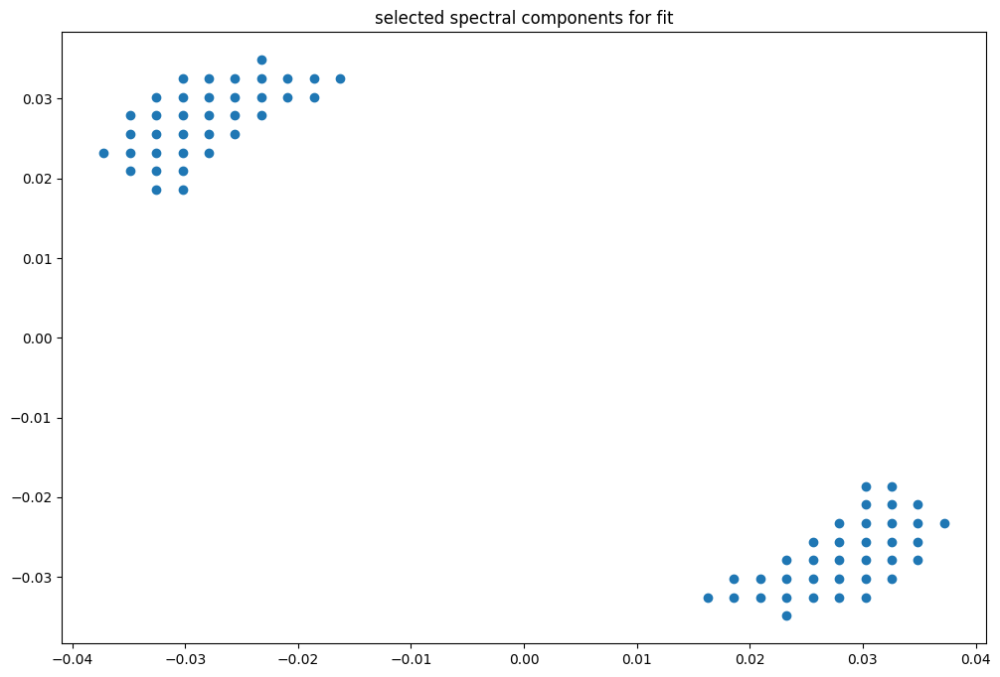

box [6000, 6700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

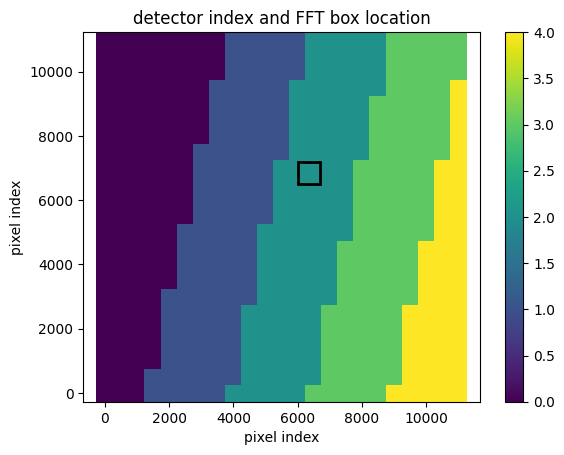

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


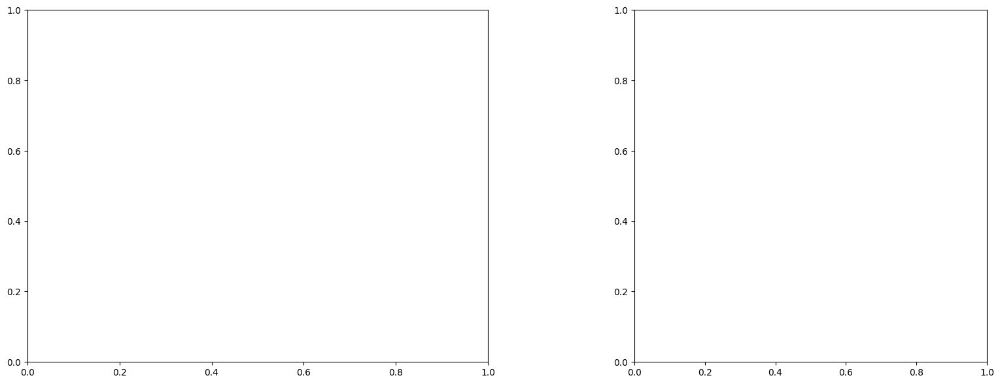

U and V components of current : [ 0.23301788 -1.06909169]
uncertainties for U and V: 0.1576235144387713 0.16825886402175988


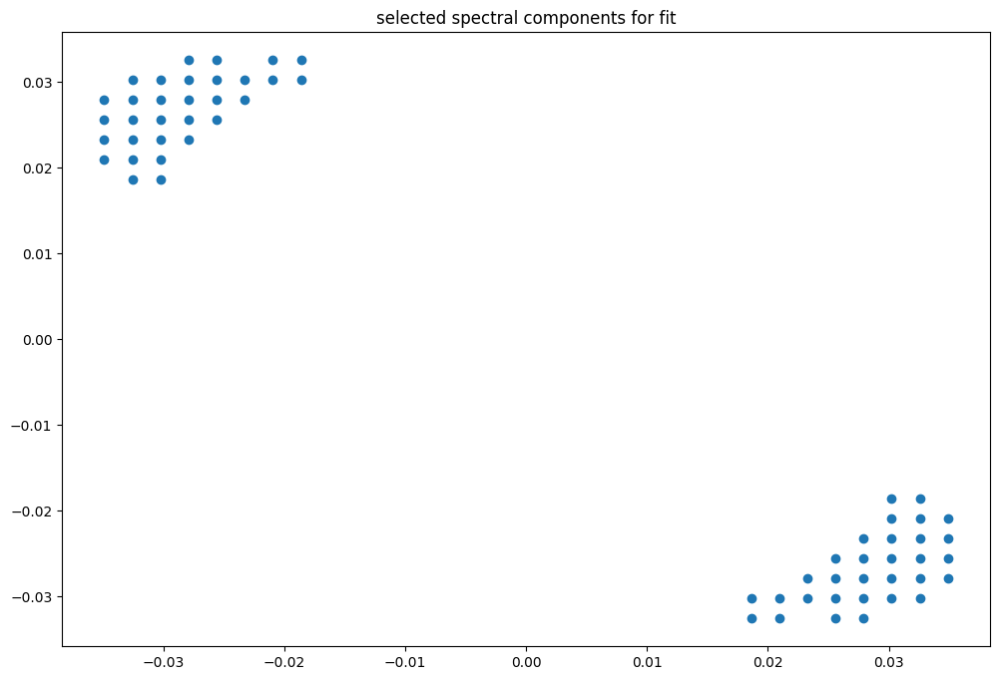

box [6000, 6700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

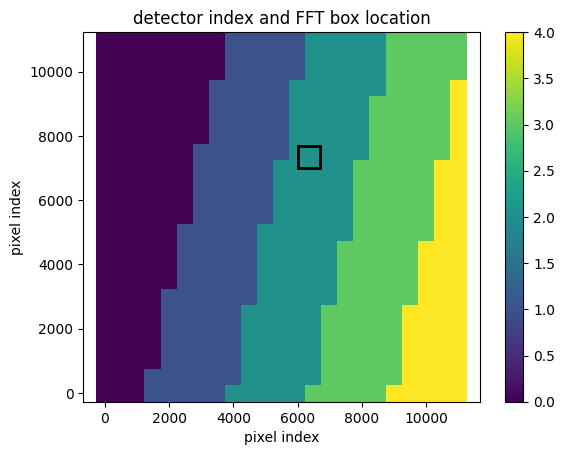

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


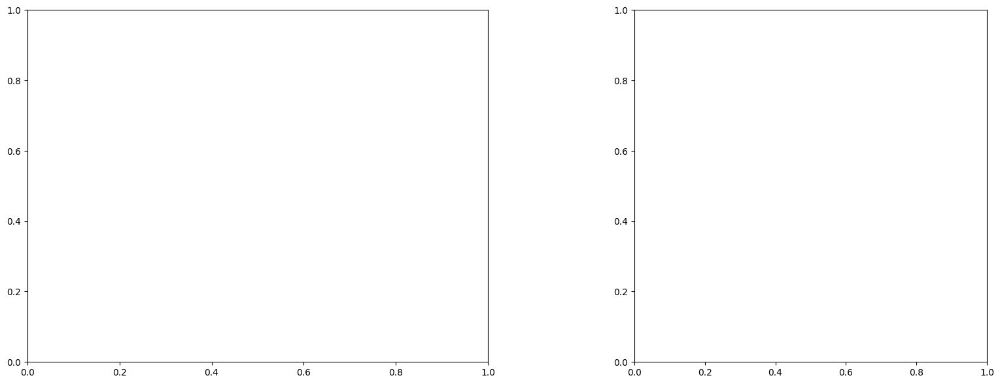

U and V components of current : [-0.59275256 -2.21260121]
uncertainties for U and V: 0.0843056095425072 0.07870624224965621


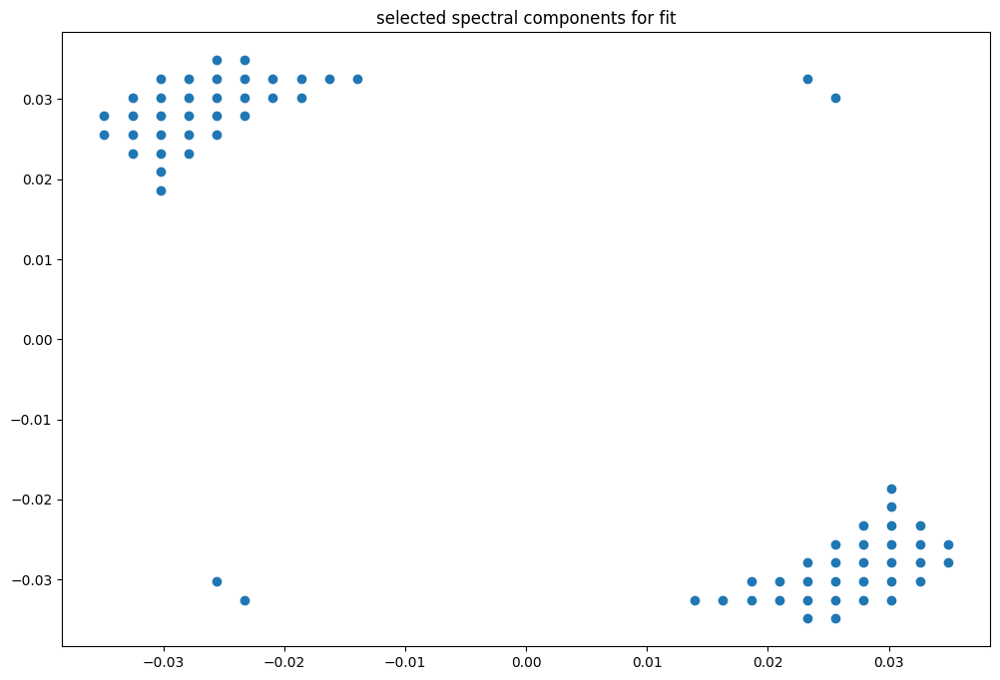

box [6000, 6700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

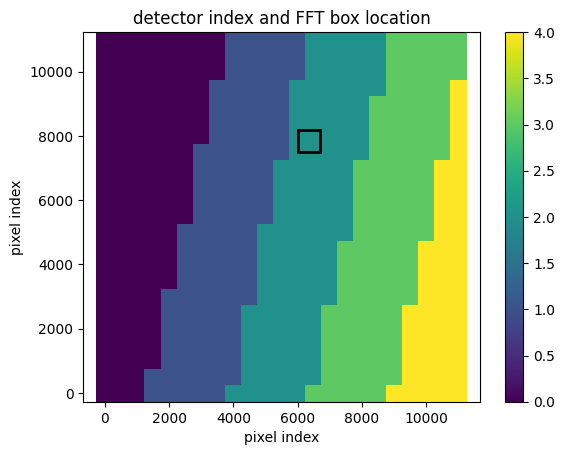

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


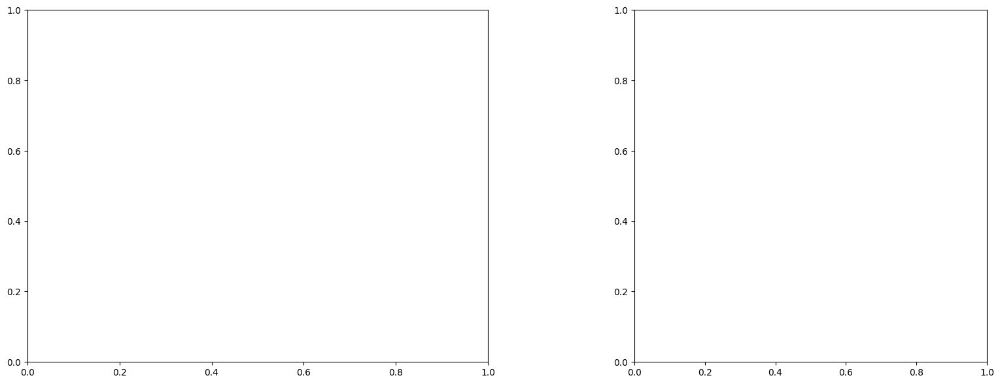

U and V components of current : [ 1.02209239 -0.75055227]
uncertainties for U and V: 0.21048141885496777 0.22129740031183237


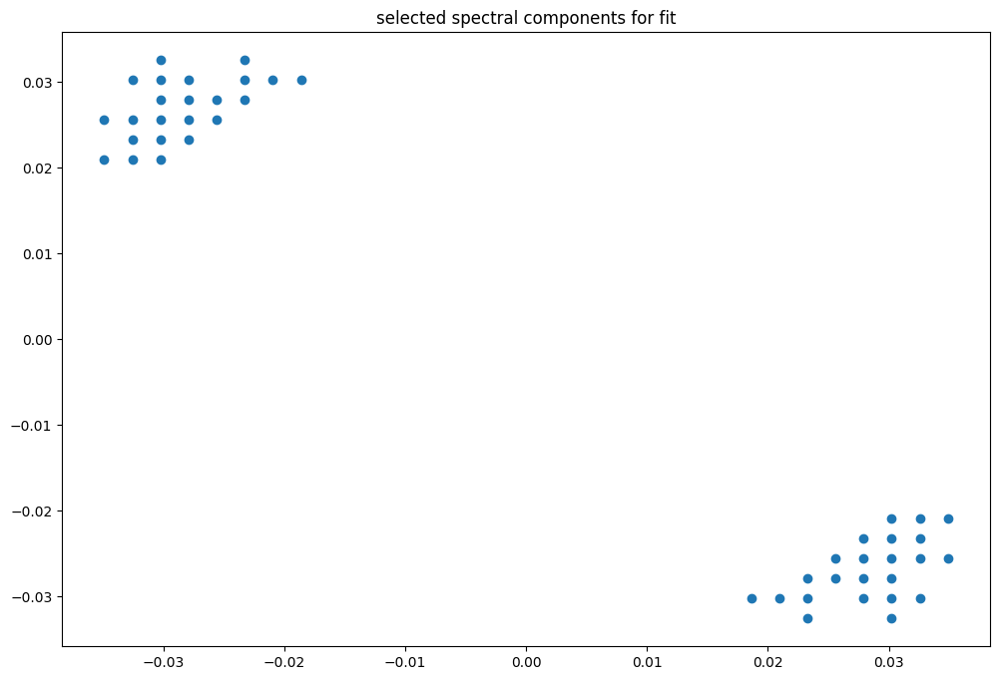

box [6000, 6700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

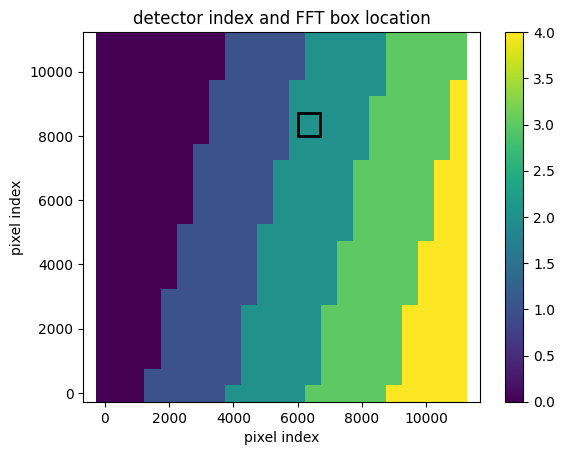

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


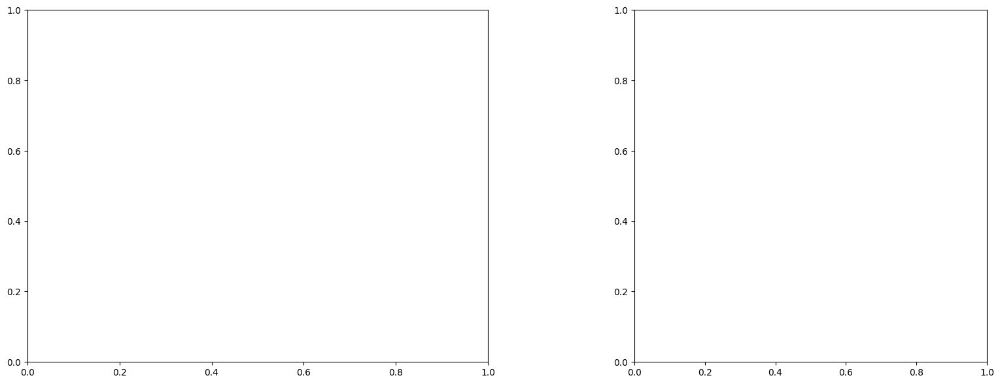

U and V components of current : [-0.83772673 -3.1374558 ]
uncertainties for U and V: 0.12575448921700916 0.11605767935665329


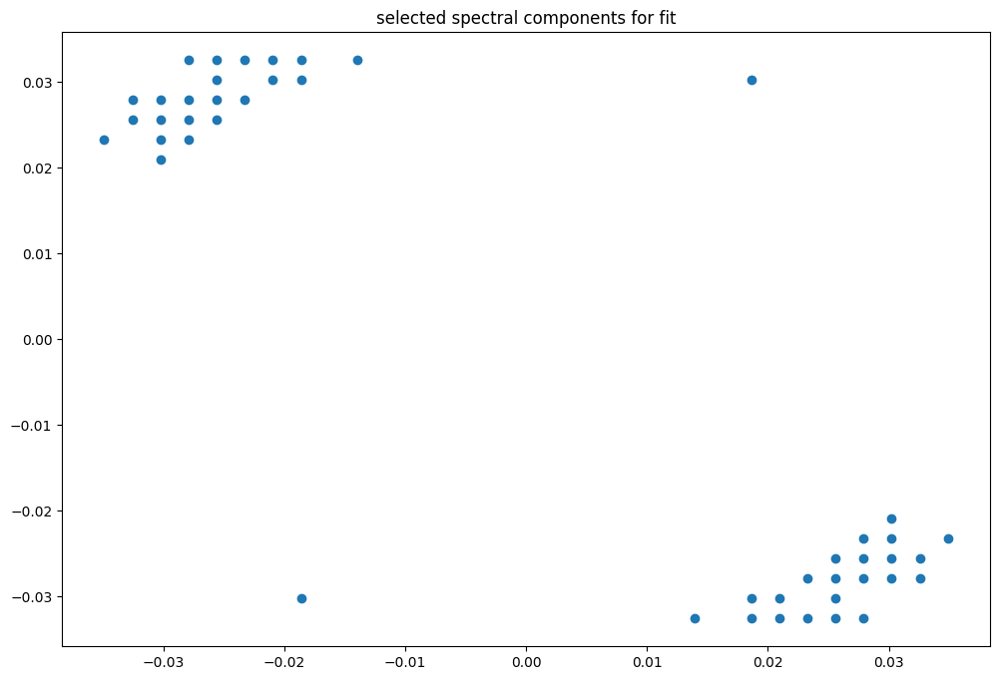

box [6000, 6700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

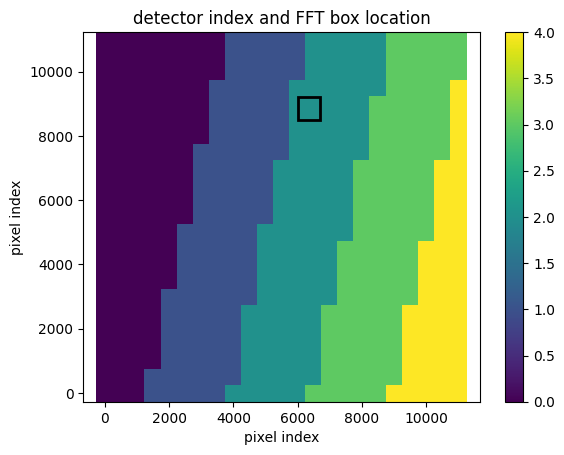

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


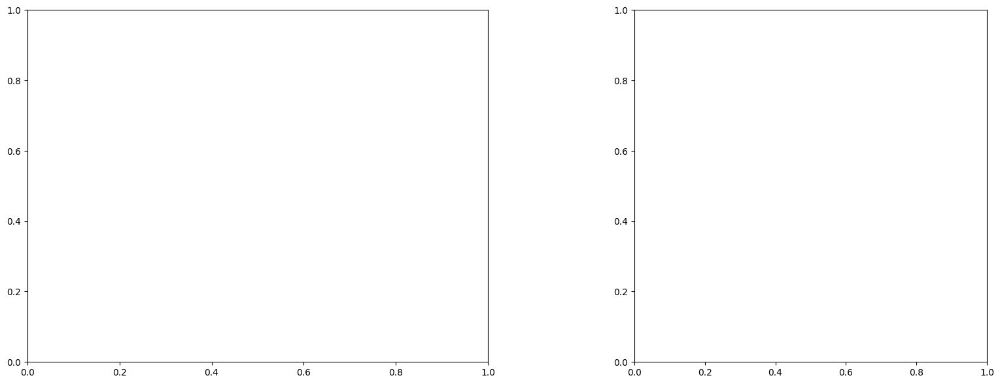

U and V components of current : [5.35994434 2.84855805]
uncertainties for U and V: 1.998110479507785 2.1911680549561074


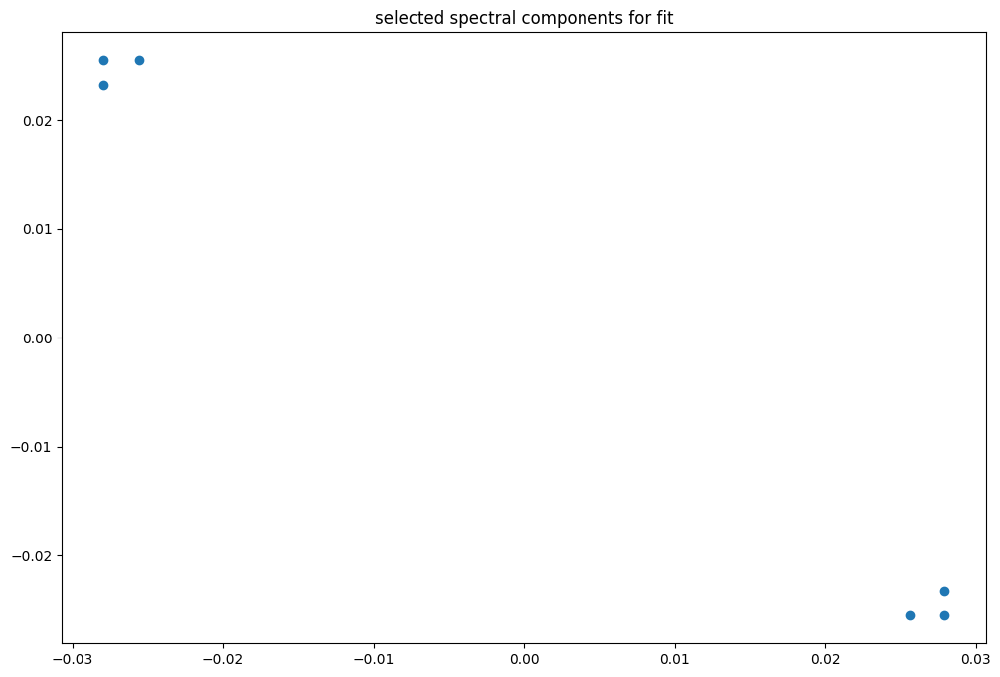

box [6000, 6700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

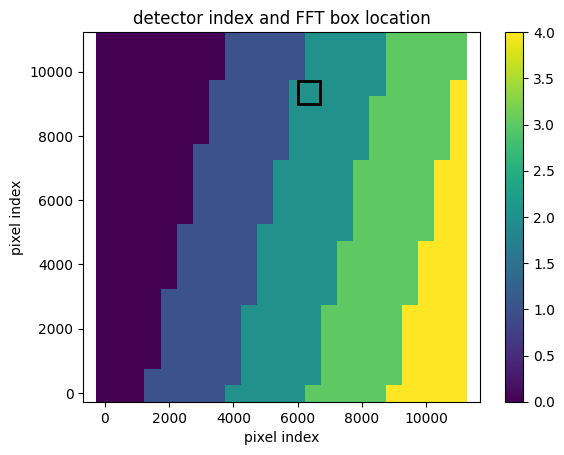

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


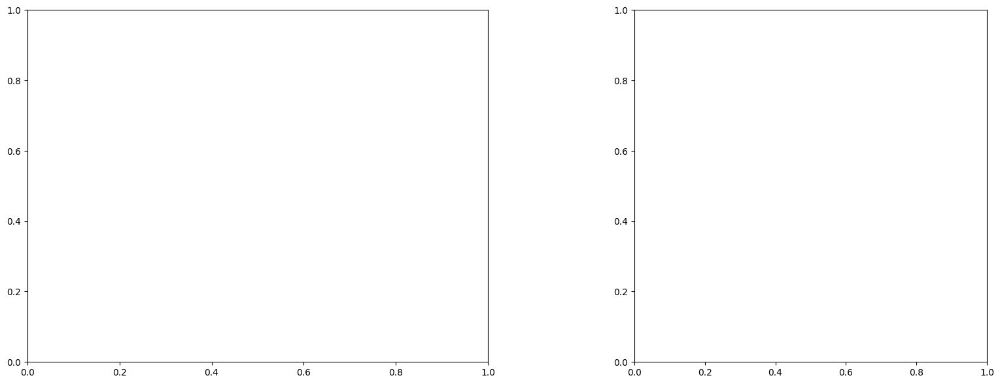

LinAlgError: Singular matrix

box [6000, 6700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

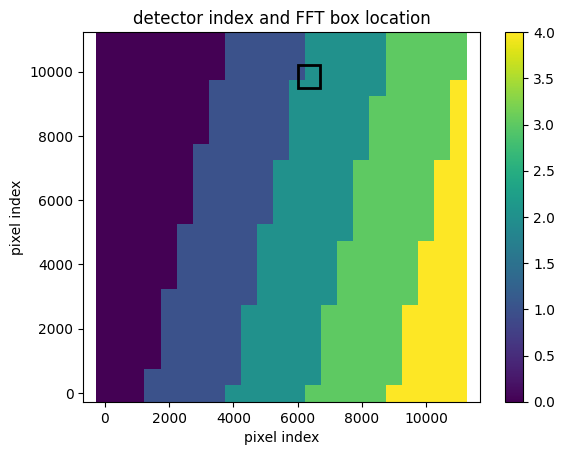

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


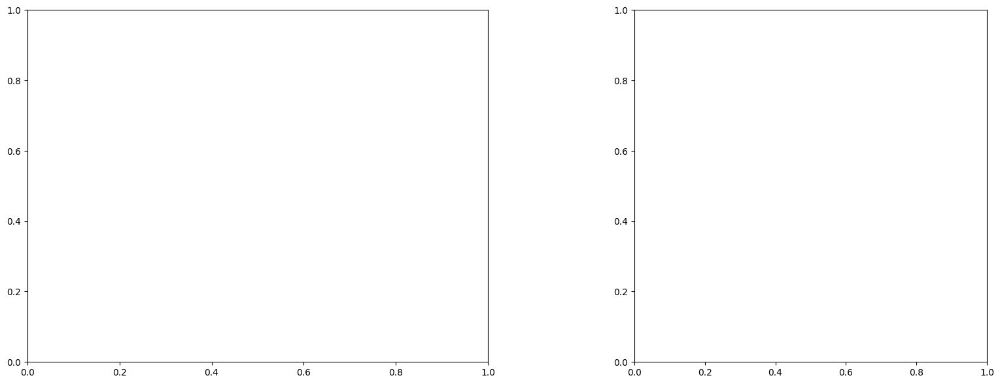

LinAlgError: Singular matrix

box [6000, 6700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

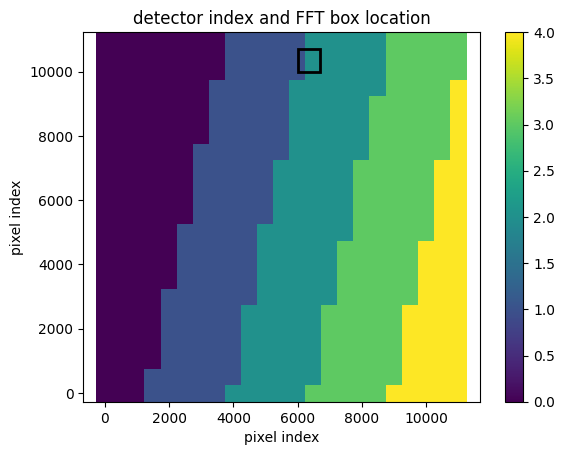

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.7000000000000002
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


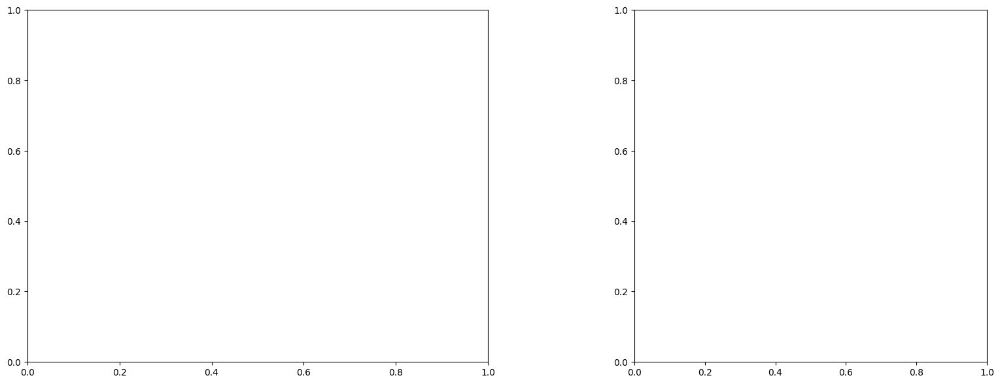

LinAlgError: Singular matrix

box [6000, 6700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

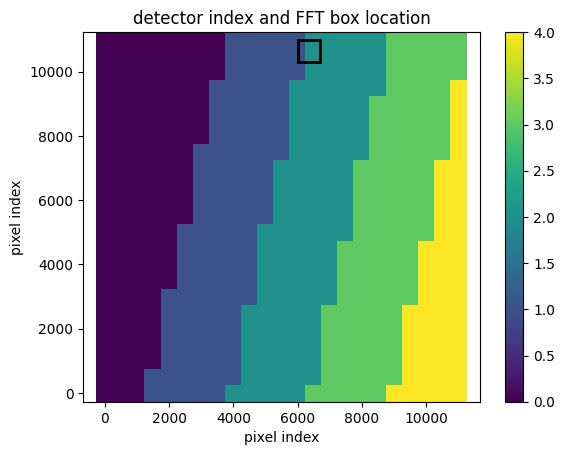

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
1.6999999999999997
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 42)
(43, 42)
(43, 42)


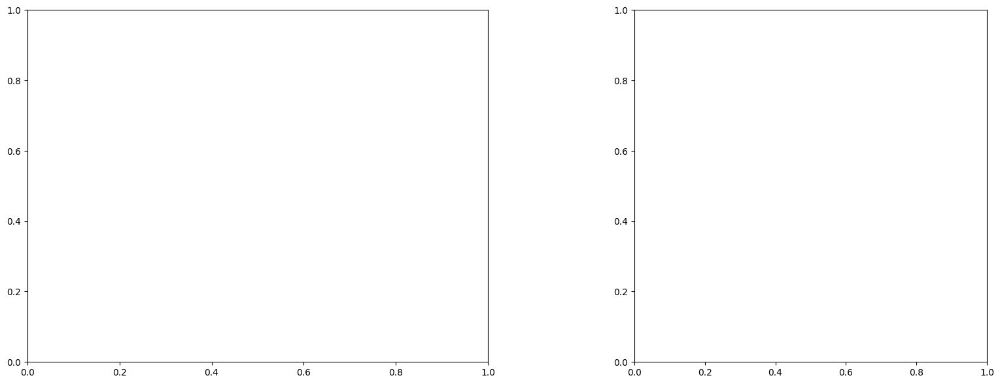

LinAlgError: Singular matrix

box [6500, 7200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

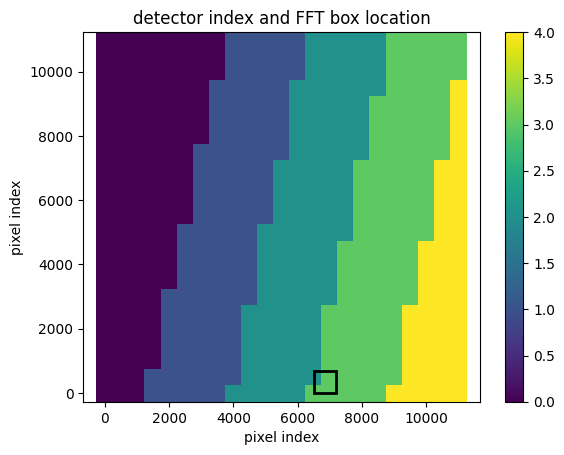

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(43, 43)
(43, 43)
(43, 43)


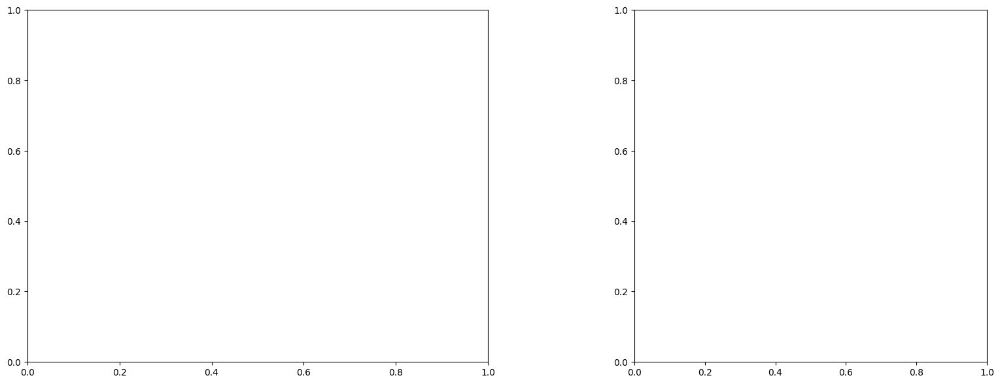

LinAlgError: Singular matrix

box [6500, 7200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

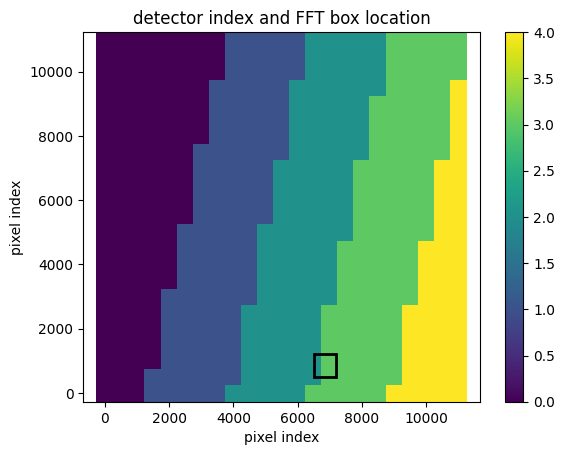

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


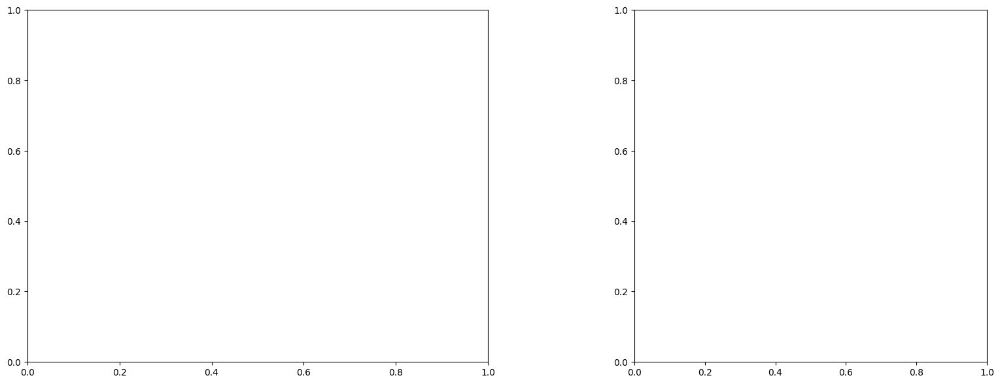

LinAlgError: Singular matrix

box [6500, 7200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

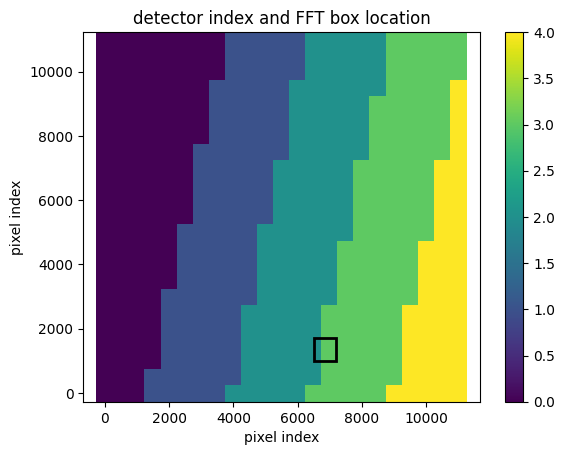

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


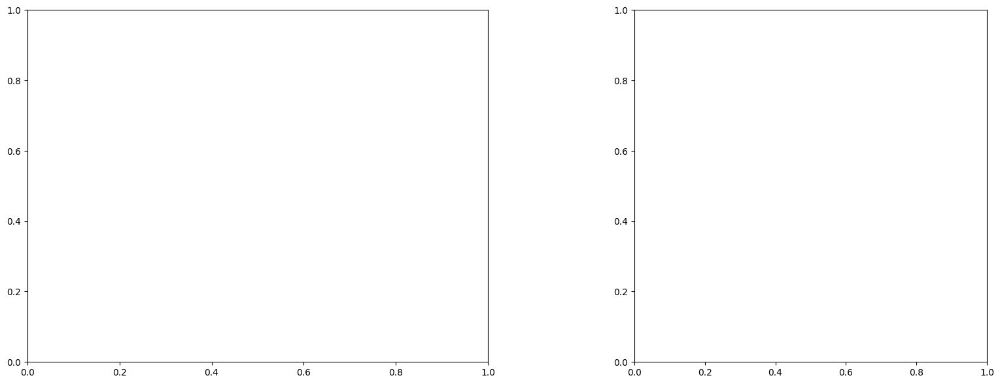

LinAlgError: Singular matrix

box [6500, 7200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

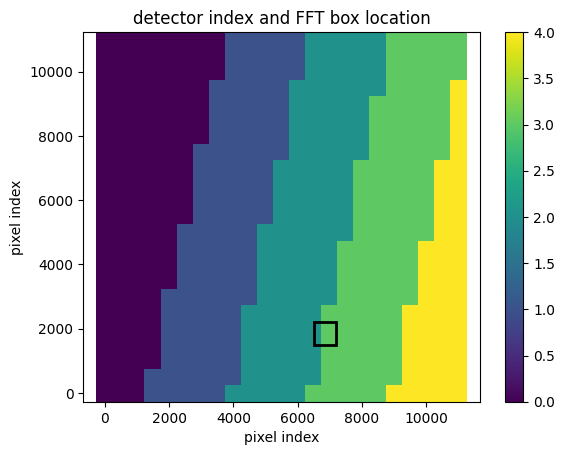

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


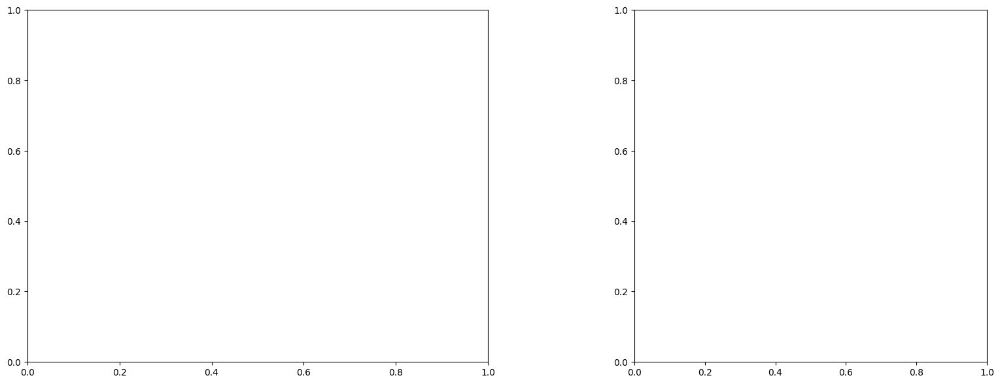

LinAlgError: Singular matrix

box [6500, 7200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

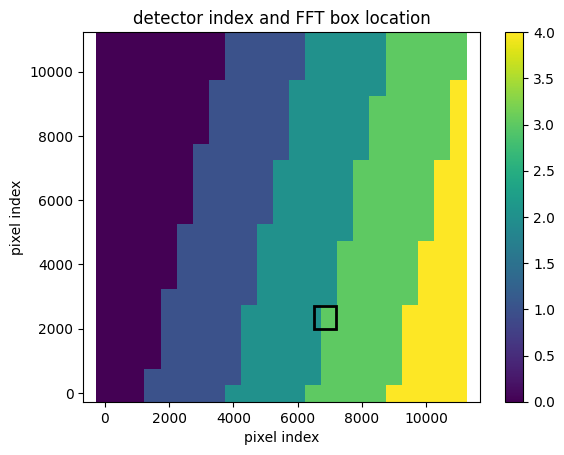

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


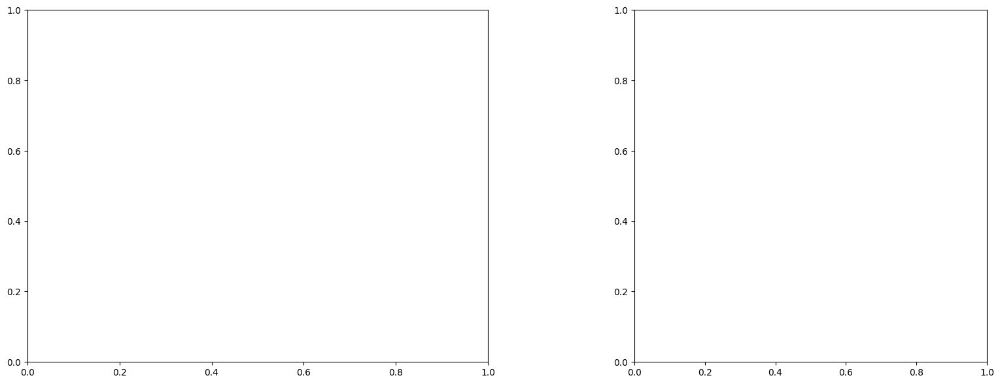

LinAlgError: Singular matrix

box [6500, 7200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

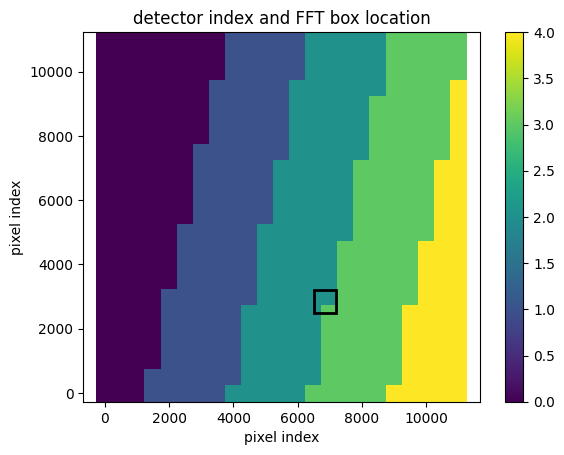

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


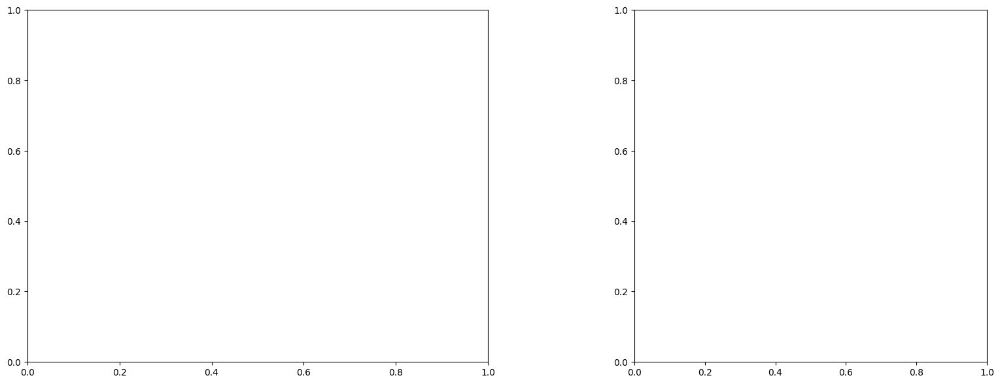

U and V components of current : [-0.41559577 -1.50516026]
uncertainties for U and V: 0.0912993446942827 0.08521232003998946


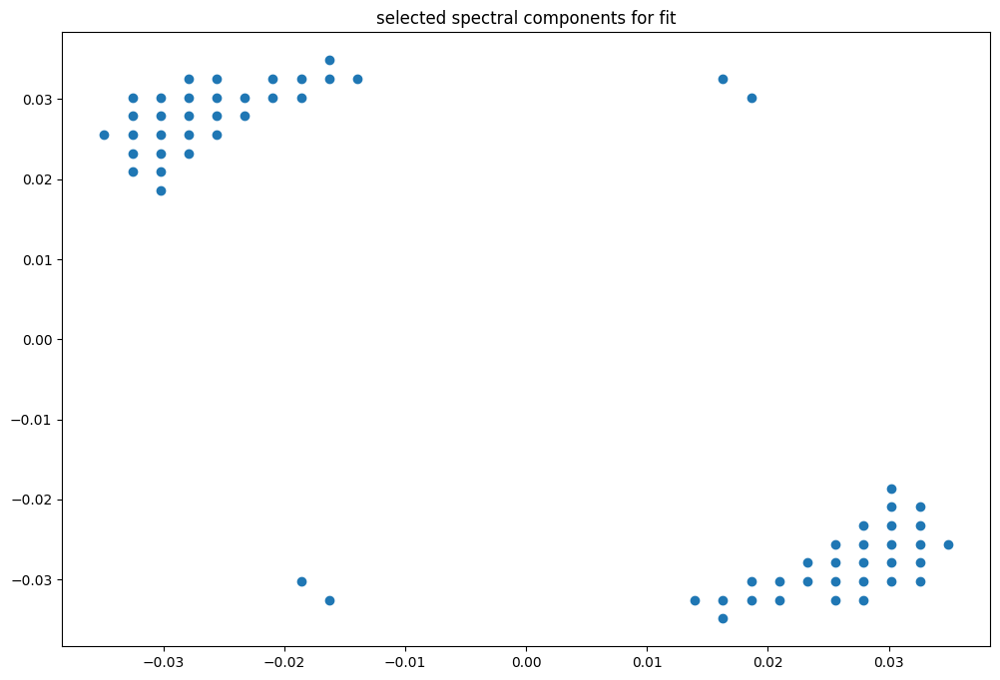

box [6500, 7200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

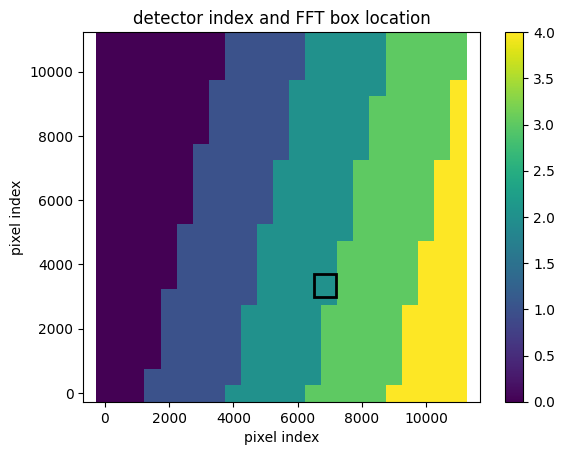

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091348659864443
(43, 43)
(43, 43)
(43, 43)


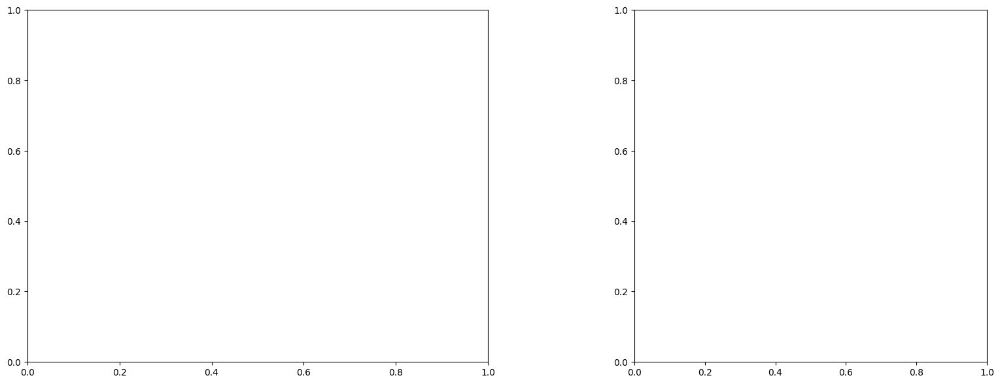

U and V components of current : [-0.7747071 -1.6270314]
uncertainties for U and V: 0.06132646560315771 0.054654717223805084


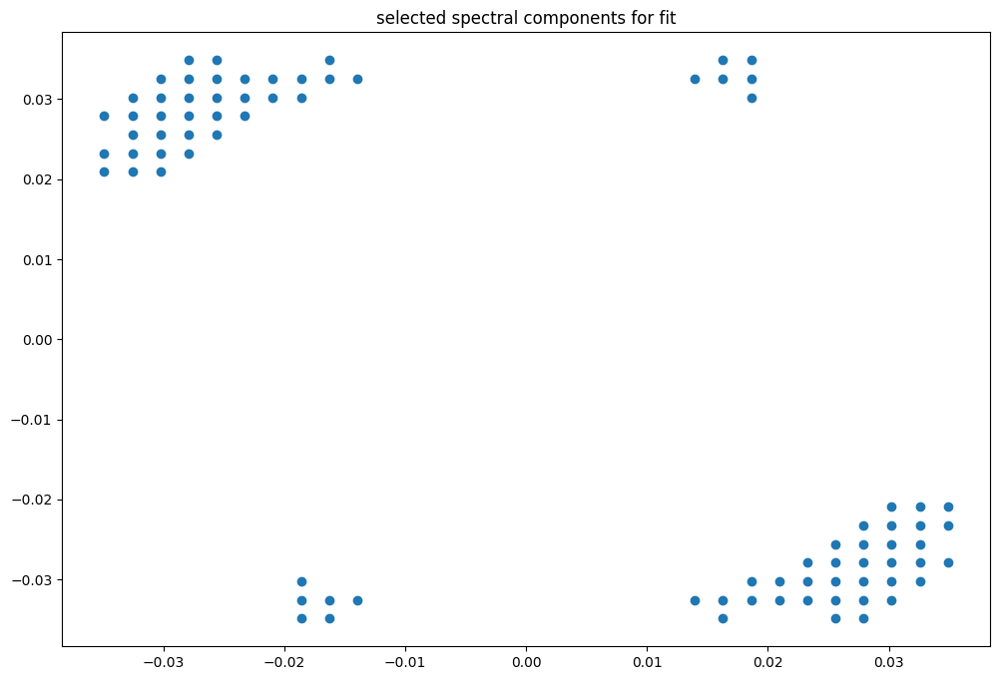

box [6500, 7200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

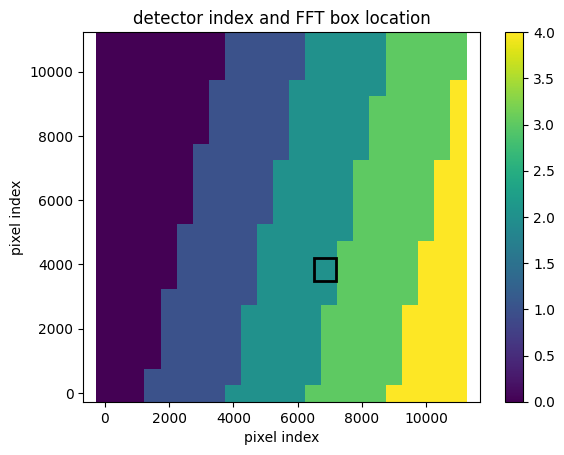

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091322424655997
(43, 43)
(43, 43)
(43, 43)


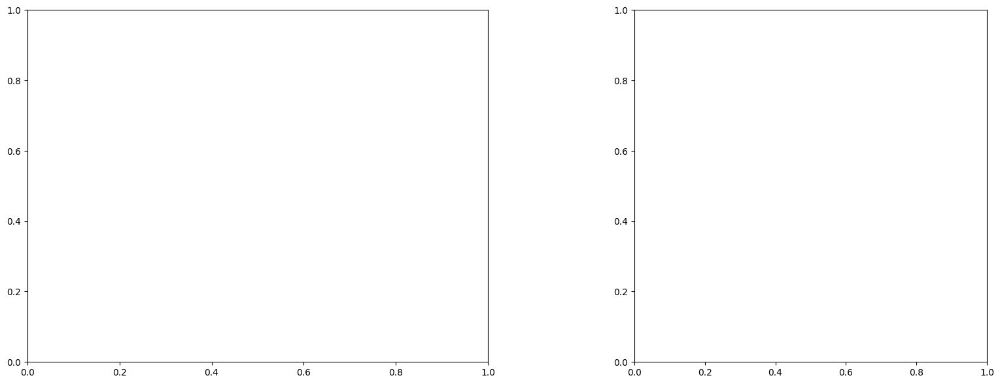

U and V components of current : [-0.2619365  -1.39919686]
uncertainties for U and V: 0.08666184160856344 0.08225168685464382


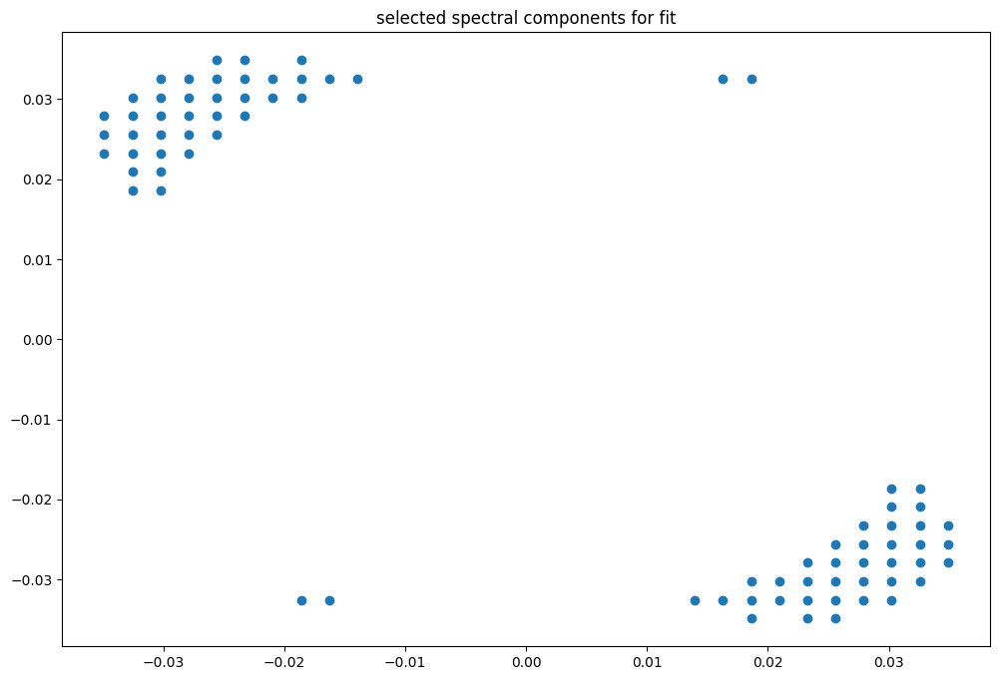

box [6500, 7200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

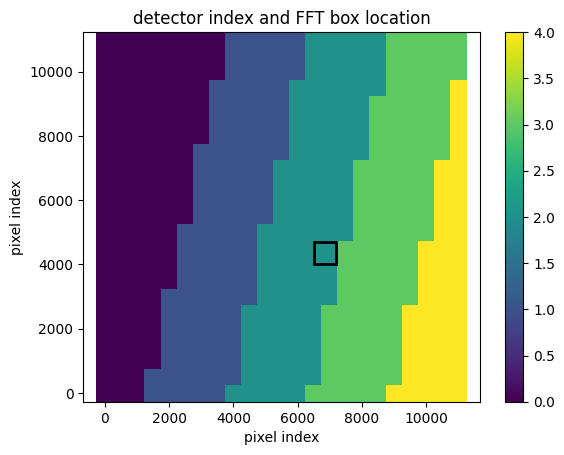

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091299397114109
(43, 43)
(43, 43)
(43, 43)


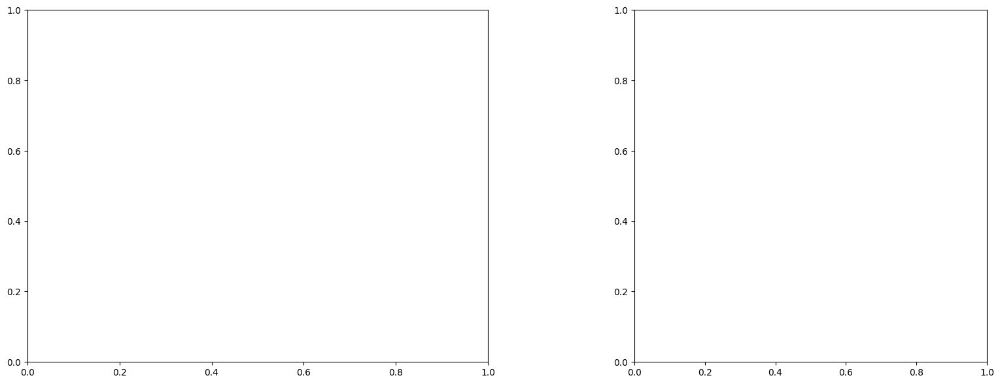

U and V components of current : [ 0.18495809 -1.27651695]
uncertainties for U and V: 0.11362364300099698 0.10848933565651722


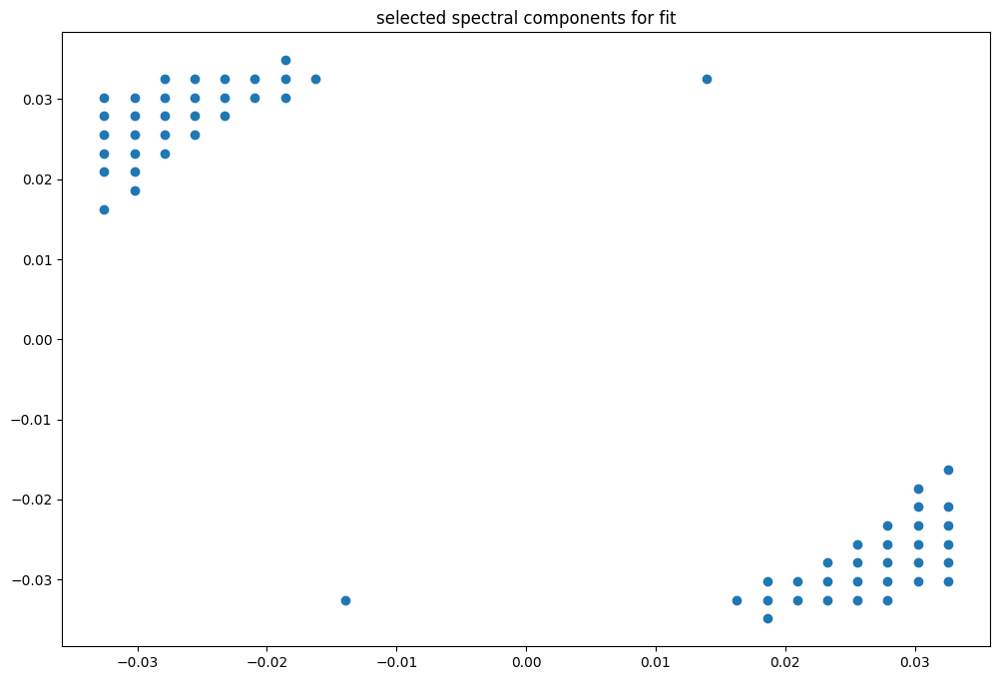

box [6500, 7200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

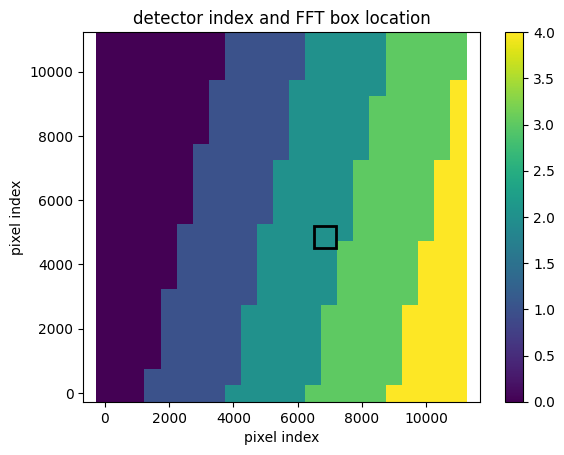

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


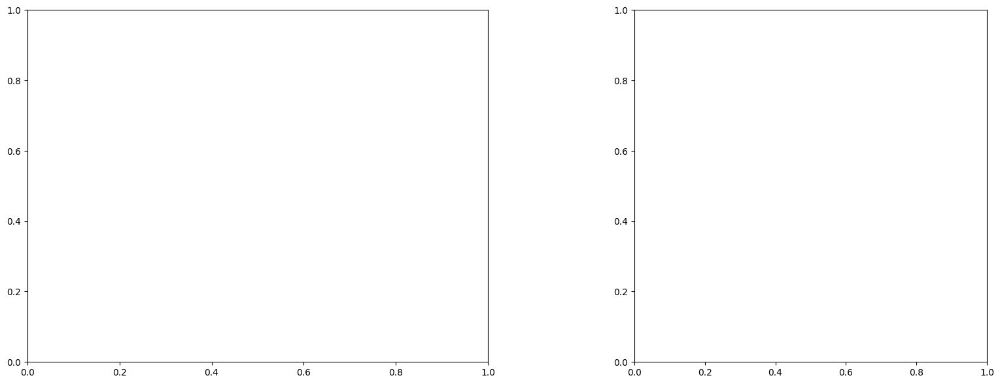

U and V components of current : [-0.46980456 -2.13938028]
uncertainties for U and V: 0.10562601766248139 0.0973844050780172


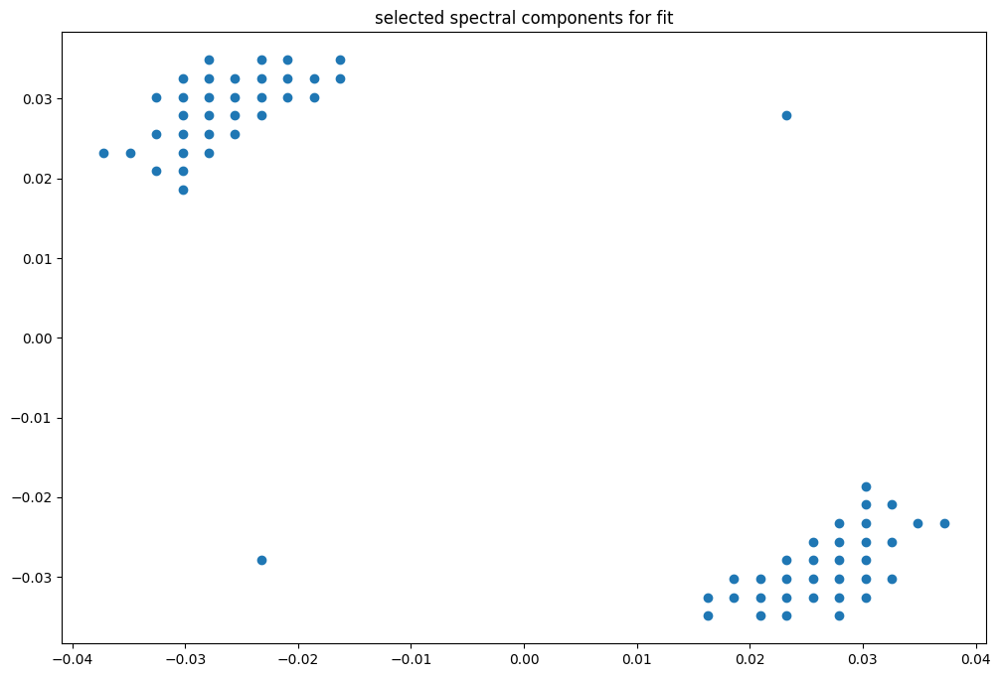

box [6500, 7200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

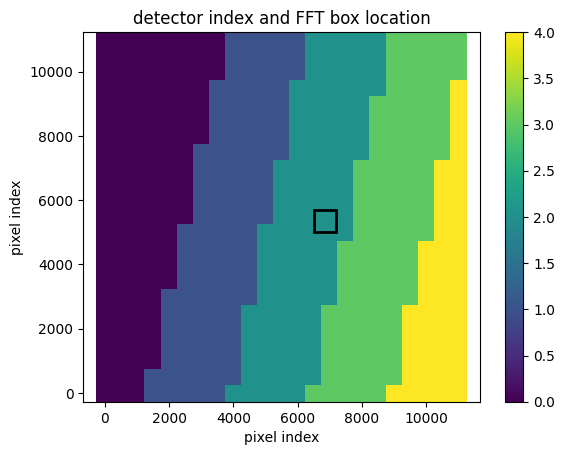

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


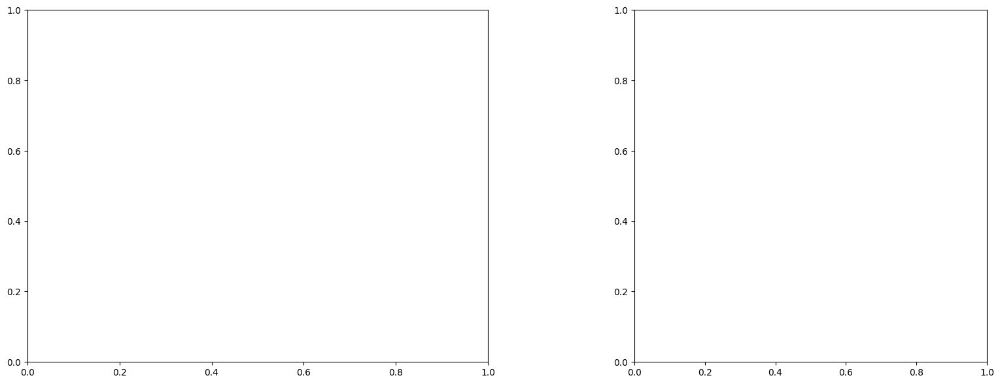

U and V components of current : [-0.62746331 -1.62351146]
uncertainties for U and V: 0.07565230474124776 0.0712159814049112


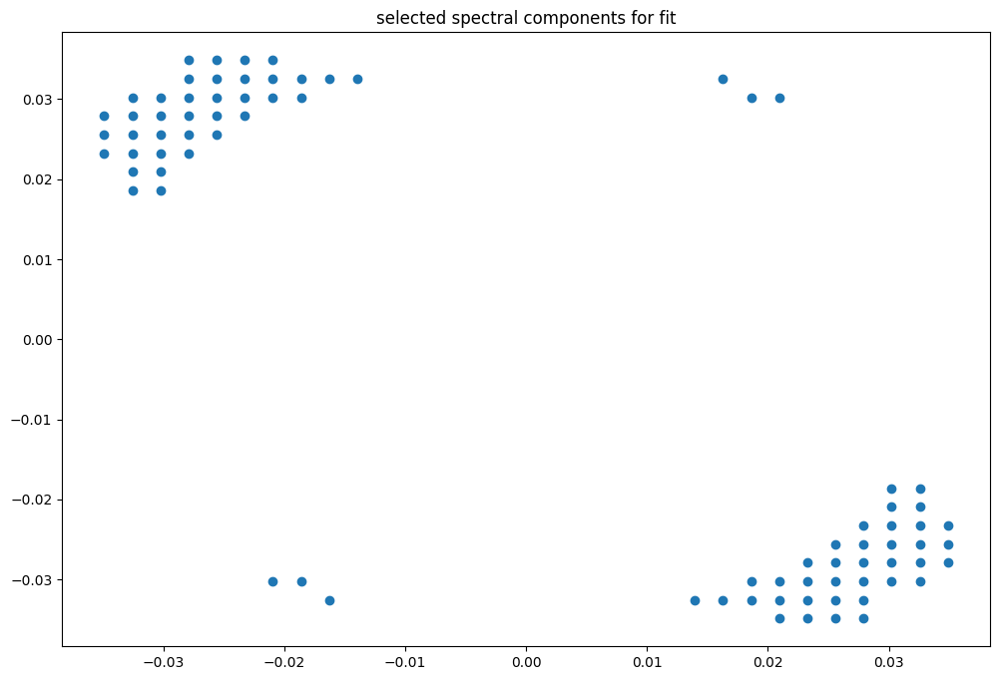

box [6500, 7200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

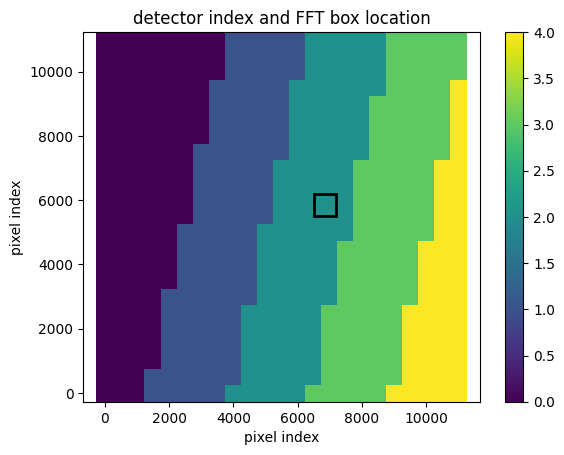

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


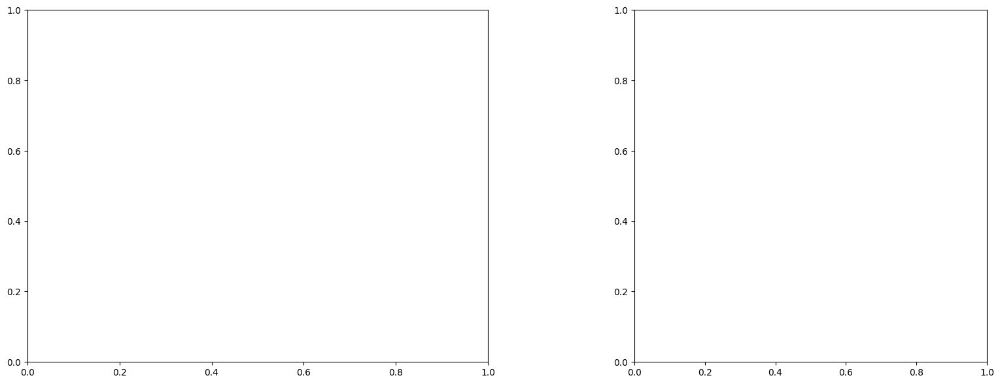

U and V components of current : [-0.14056841 -1.3168223 ]
uncertainties for U and V: 0.0907427975944303 0.08687974754005279


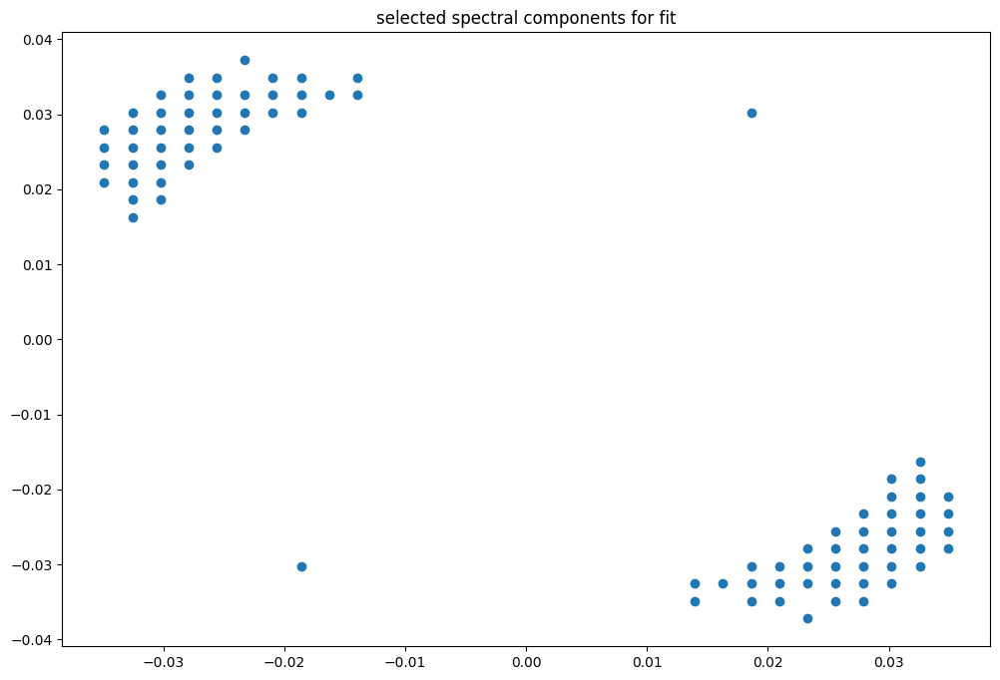

box [6500, 7200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

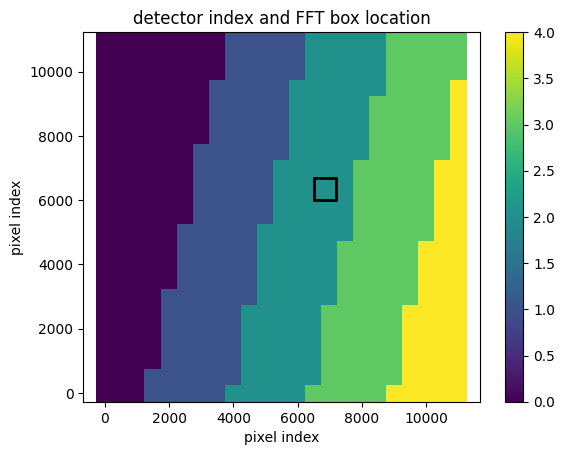

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


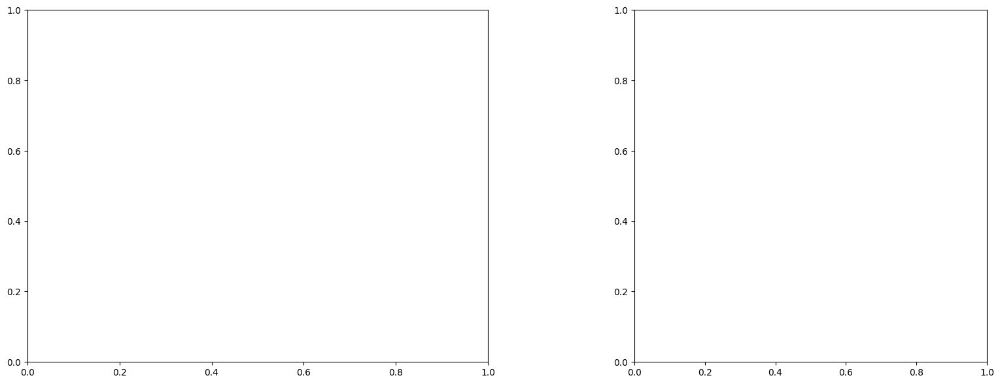

U and V components of current : [-0.11909908 -1.64374524]
uncertainties for U and V: 0.09821485268172155 0.10080971691989175


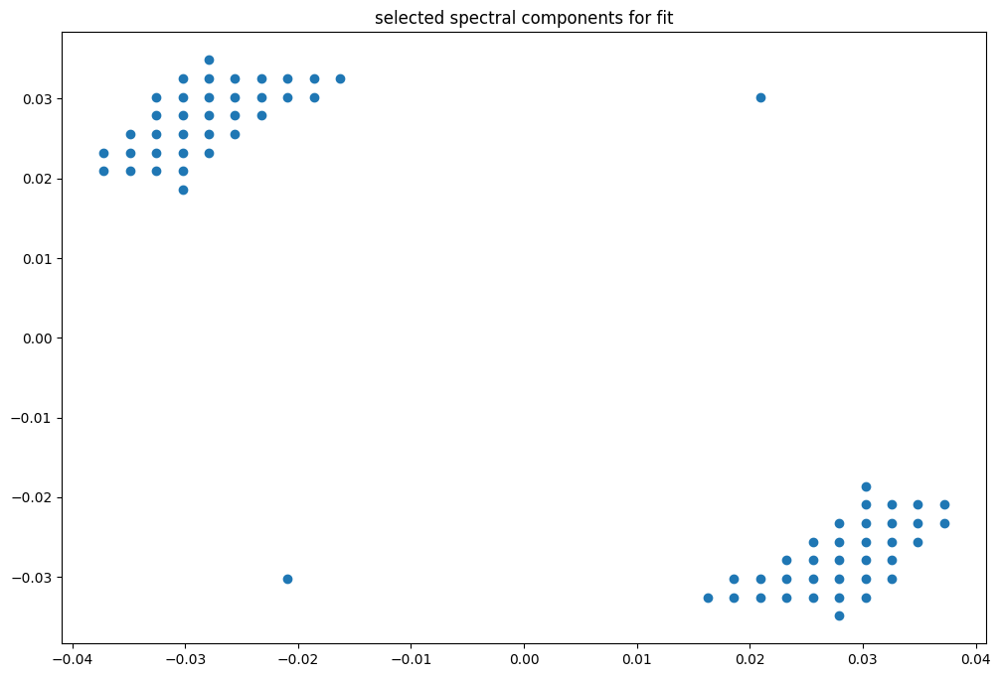

box [6500, 7200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

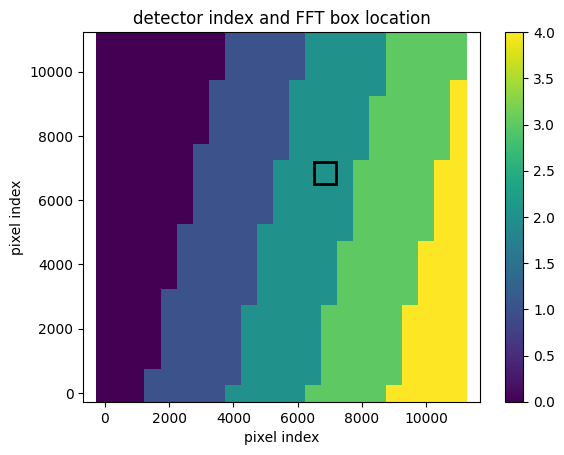

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


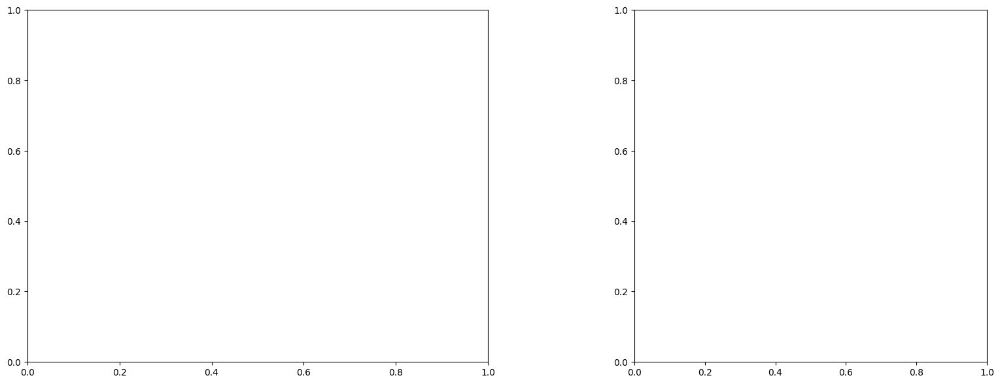

U and V components of current : [ 0.84482116 -0.52414105]
uncertainties for U and V: 0.12489473457449045 0.12951195986984526


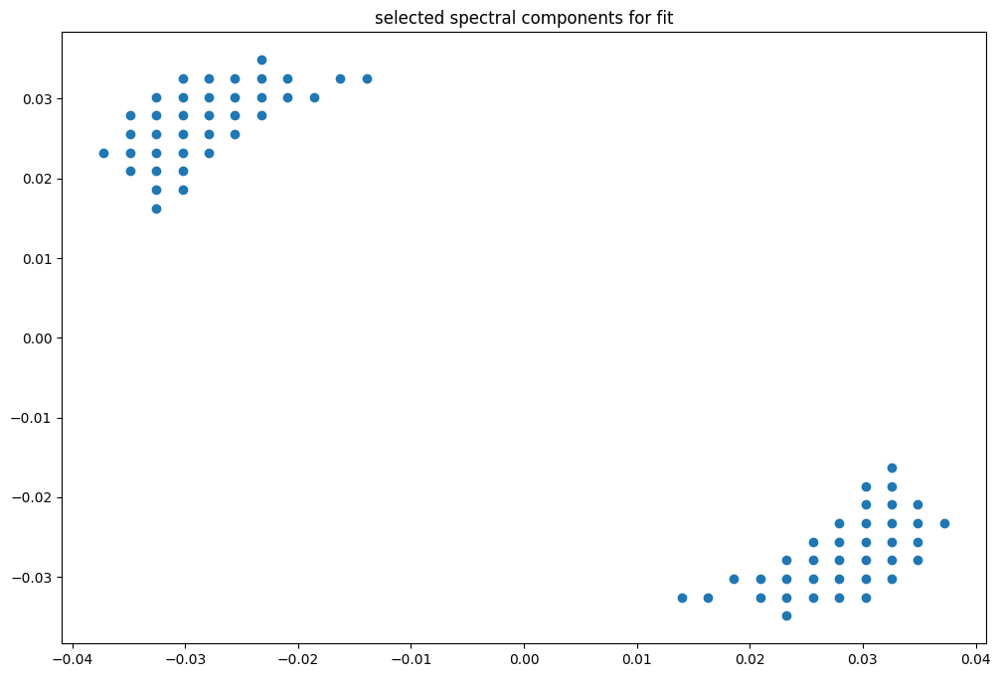

box [6500, 7200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

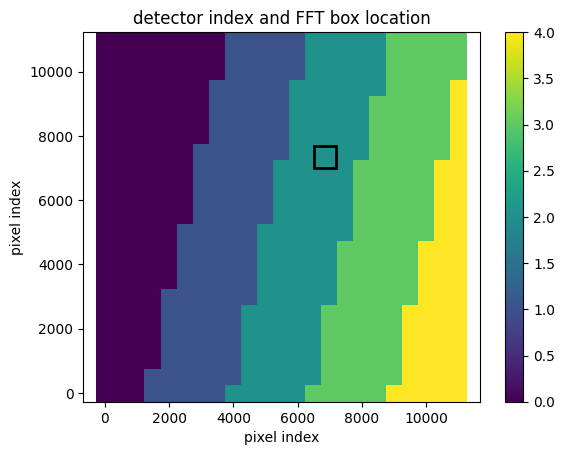

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


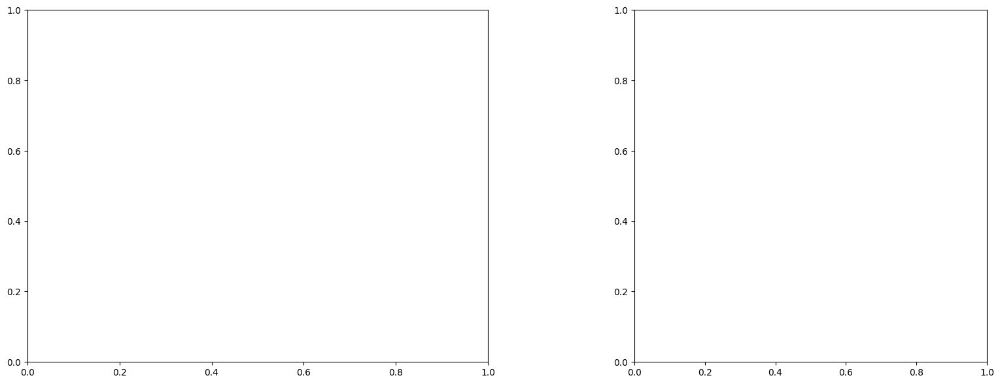

U and V components of current : [-0.24248265 -3.01564124]
uncertainties for U and V: 0.11678421574382636 0.11852909833566175


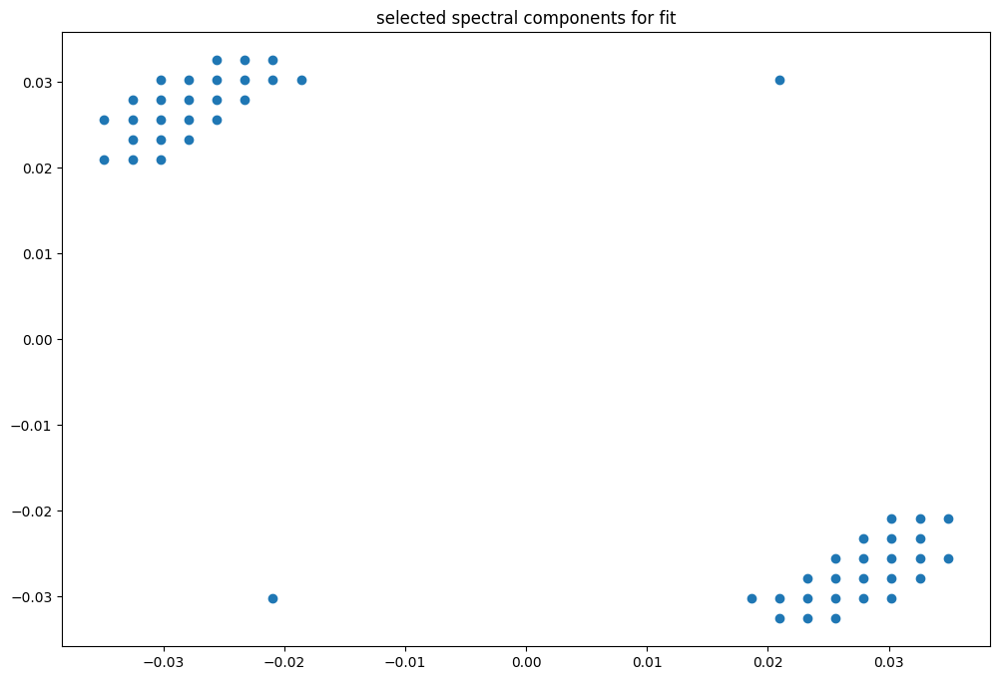

box [6500, 7200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

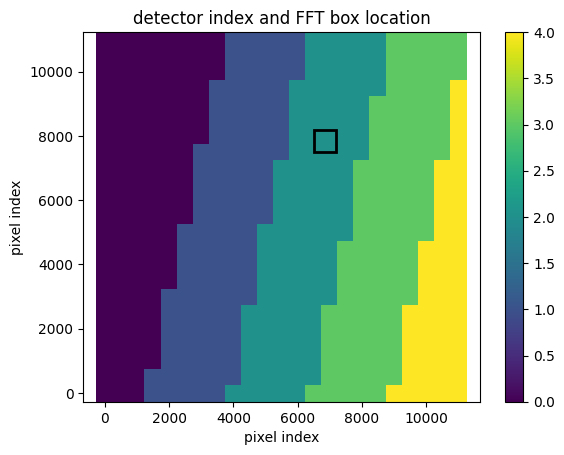

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


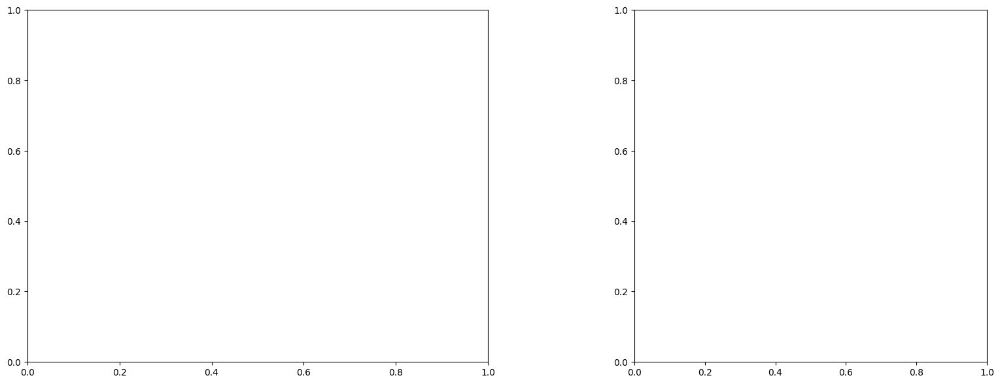

U and V components of current : [ 1.51272373 -0.66962759]
uncertainties for U and V: 0.208708078542615 0.2071583684825921


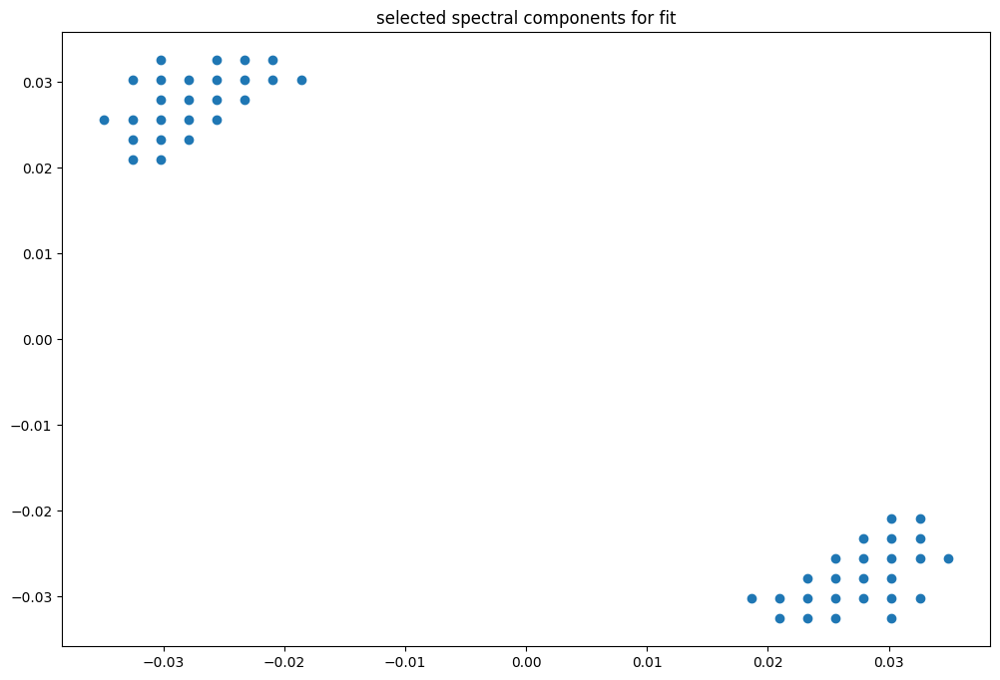

box [6500, 7200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

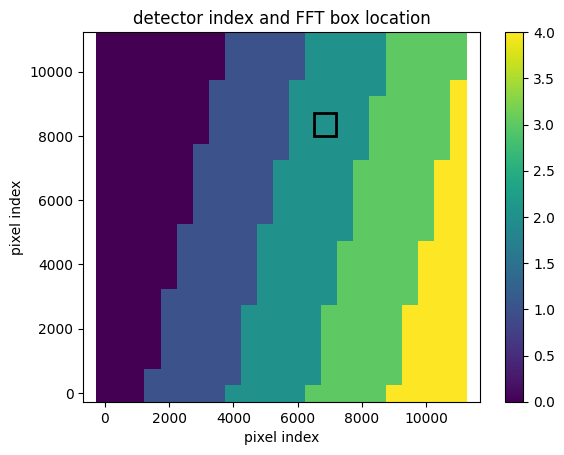

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


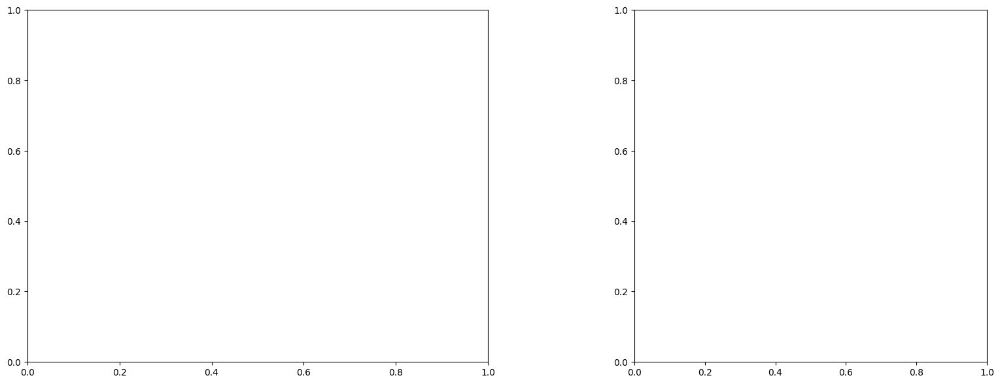

U and V components of current : [ 0.93410965 -0.95350626]
uncertainties for U and V: 0.1649534378336425 0.1712859037755302


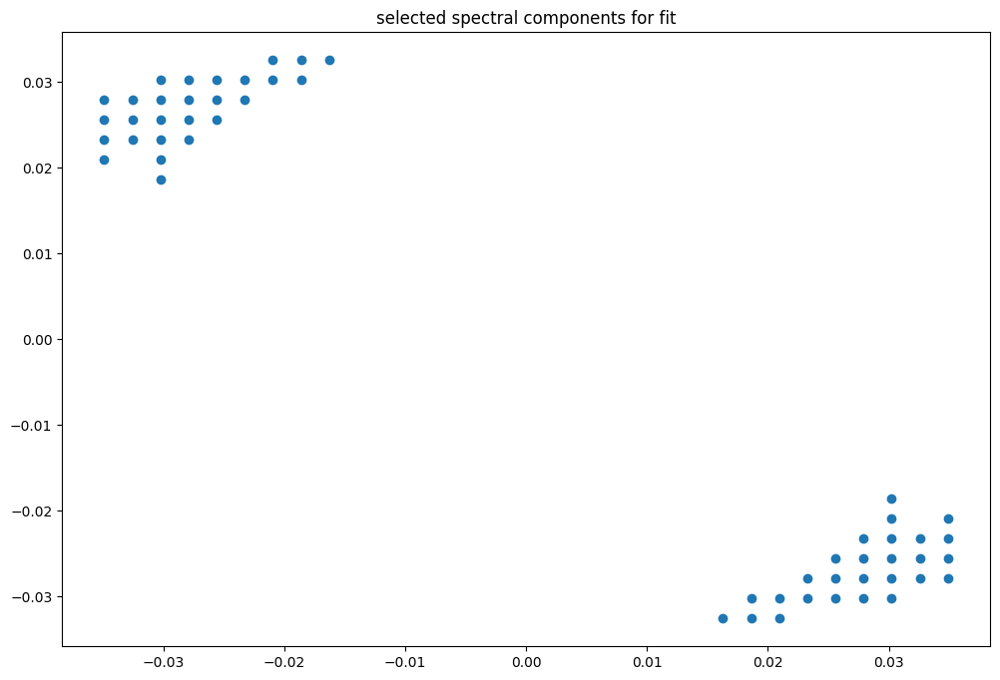

box [6500, 7200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

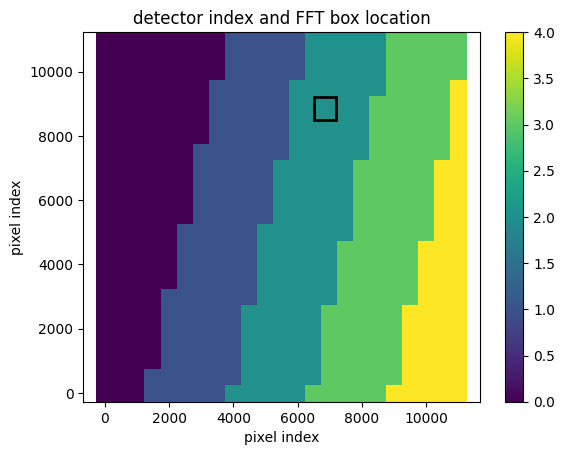

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


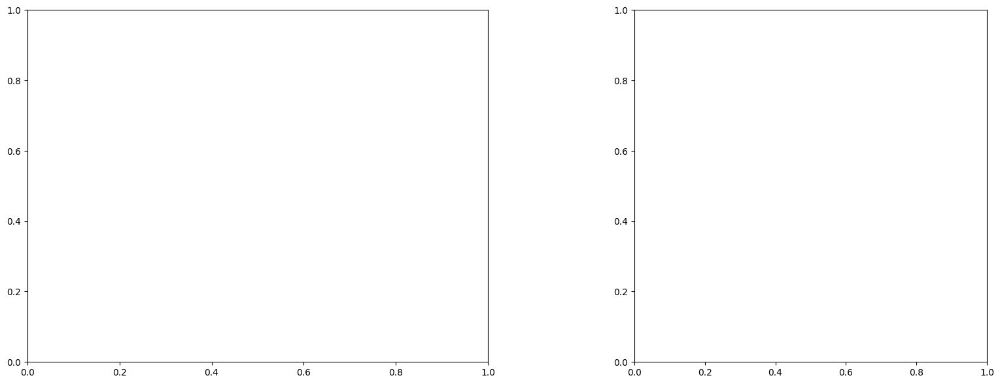

U and V components of current : [ 0.40955134 -1.88916835]
uncertainties for U and V: 0.22850744372167883 0.22503882454744178


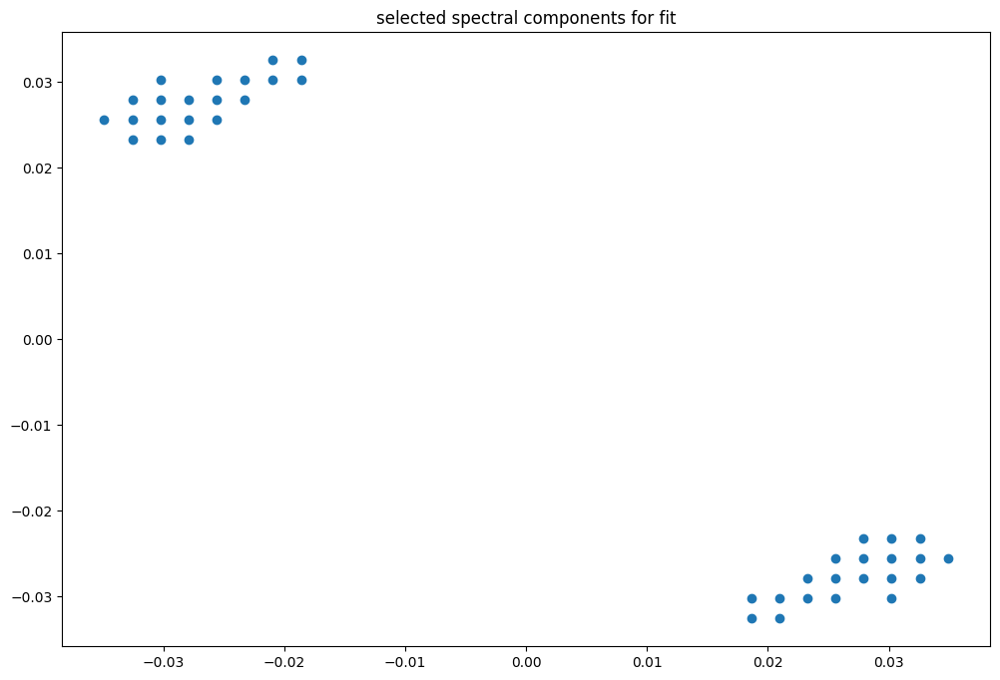

box [6500, 7200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

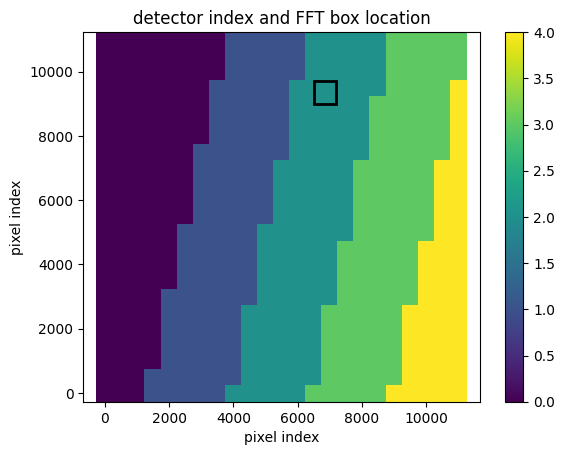

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


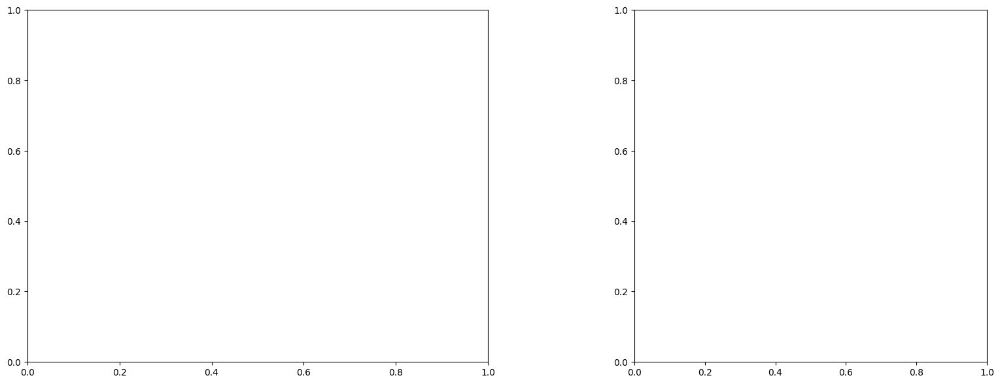

U and V components of current : [-0.64271712 -2.51520873]
uncertainties for U and V: 0.08883224989901842 0.09058932061245505


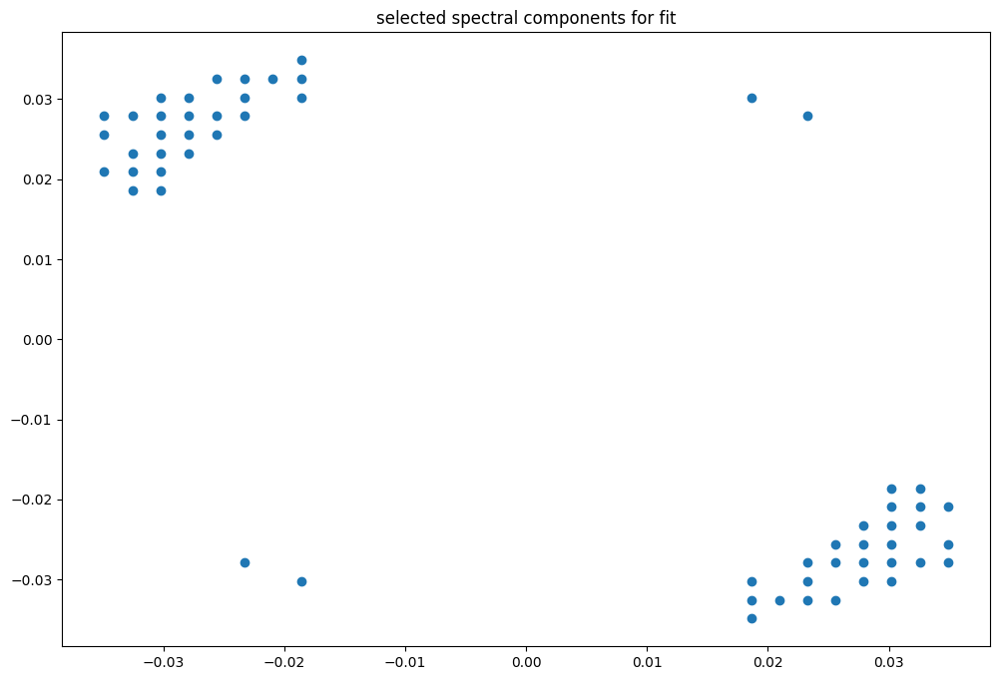

box [6500, 7200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

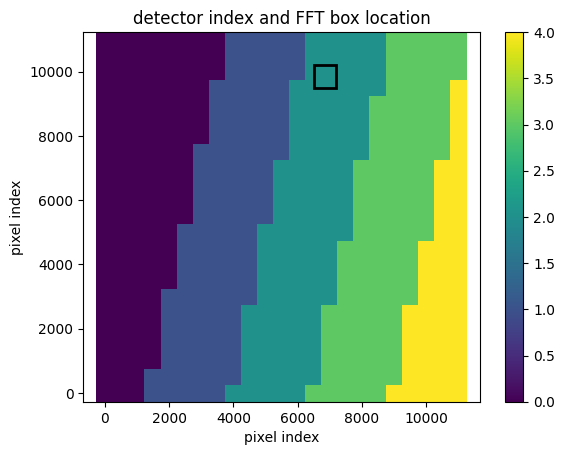

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


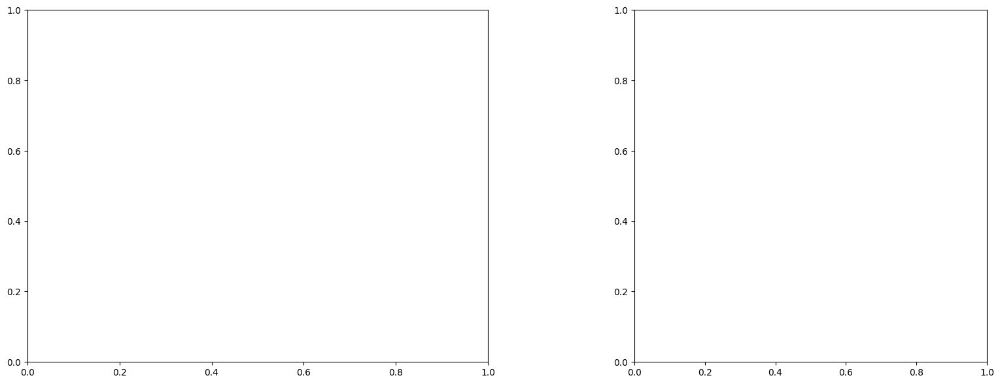

U and V components of current : [-0.10300321 -1.93777849]
uncertainties for U and V: 0.1736695639080668 0.1813543676822424


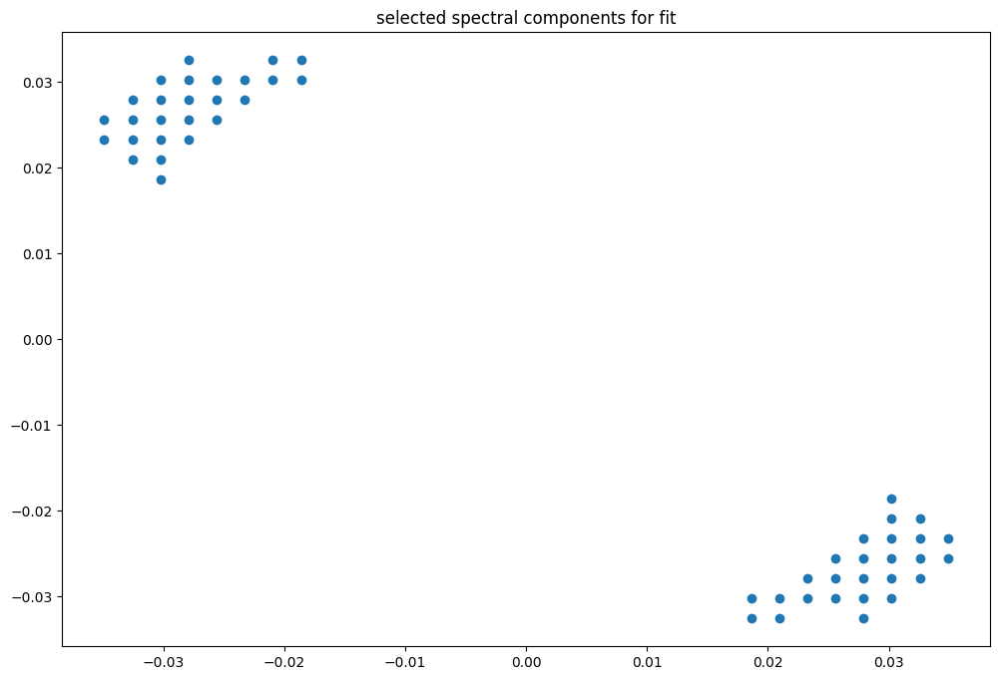

box [6500, 7200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

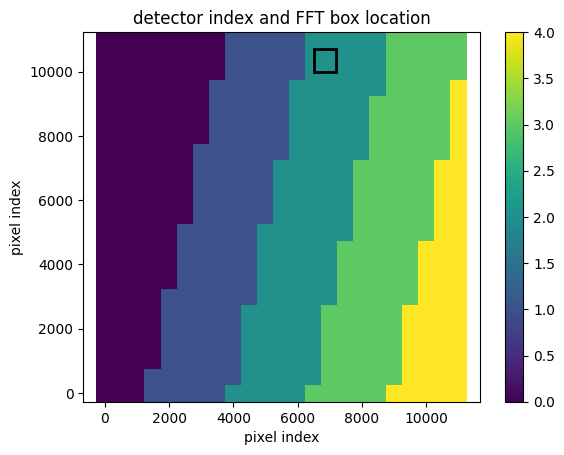

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 43)
(43, 43)
(43, 43)


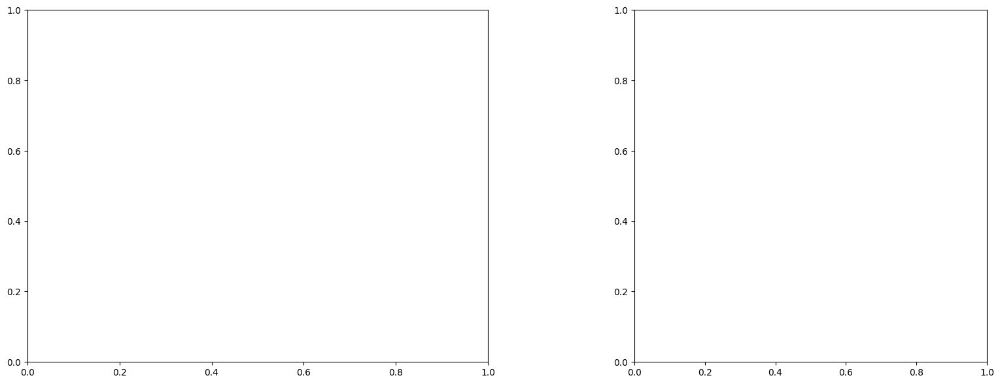

U and V components of current : [-0.21768227 -1.55553417]
uncertainties for U and V: 0.09932300402903832 0.10447879599294654


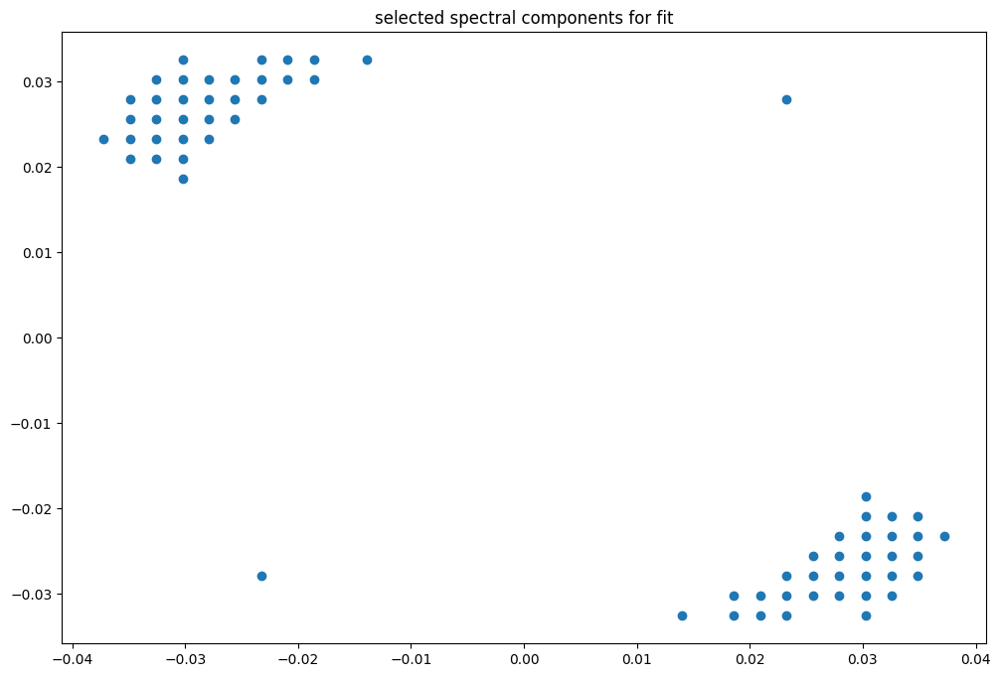

box [6500, 7200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

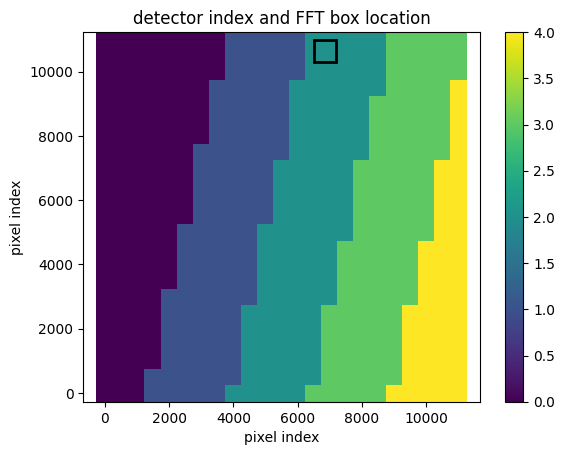

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 42)
(43, 42)
(43, 42)


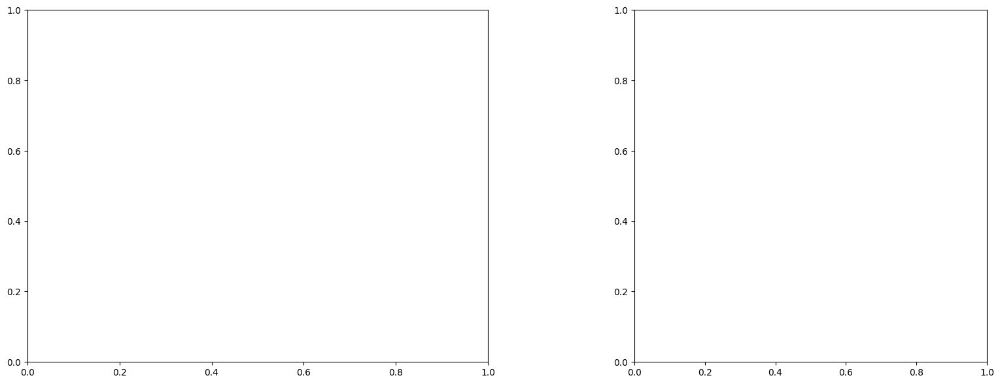

U and V components of current : [-0.23700333 -1.64751005]
uncertainties for U and V: 0.08116781574337266 0.08661215240549172


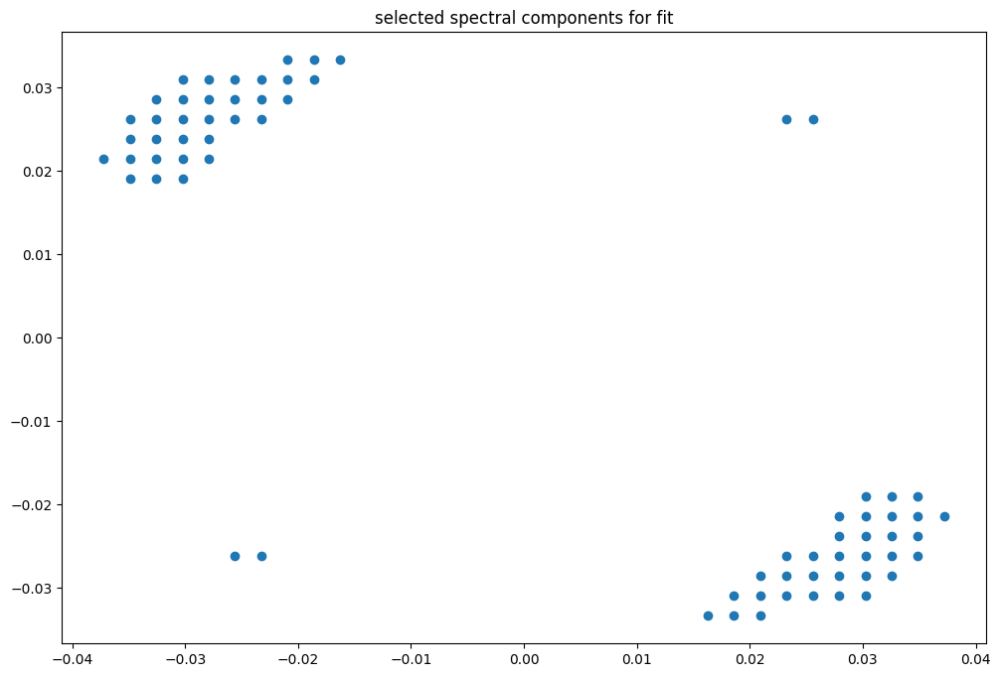

box [7000, 7700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

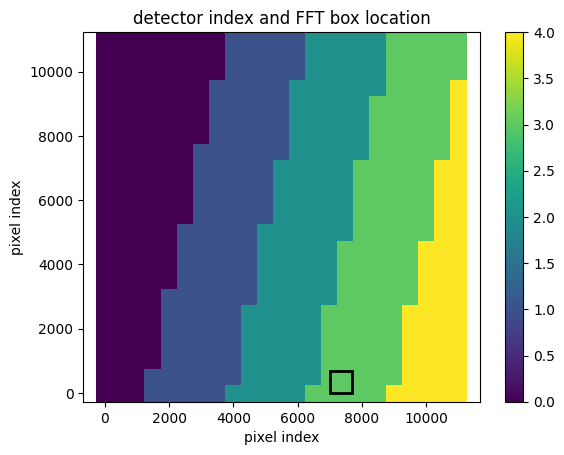

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(43, 43)
(43, 43)
(43, 43)


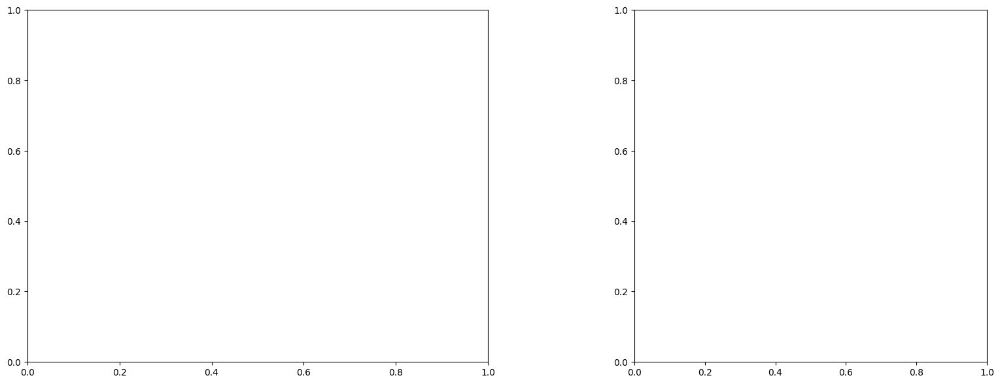

U and V components of current : [ 1.44190623 -0.34018736]
uncertainties for U and V: 0.11893052226777949 0.09663932813034733


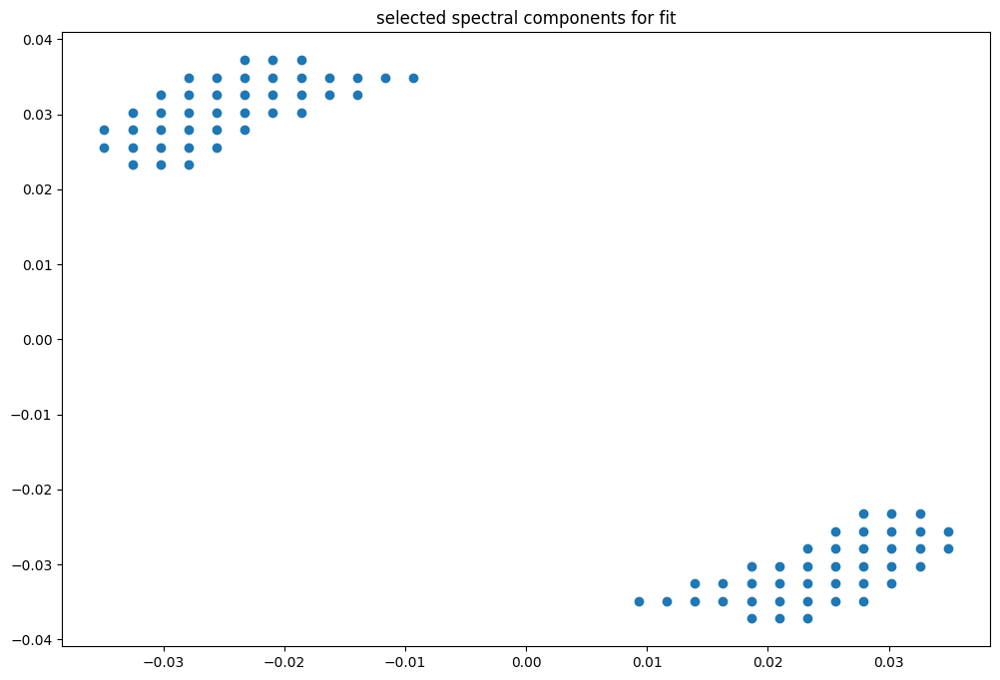

box [7000, 7700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

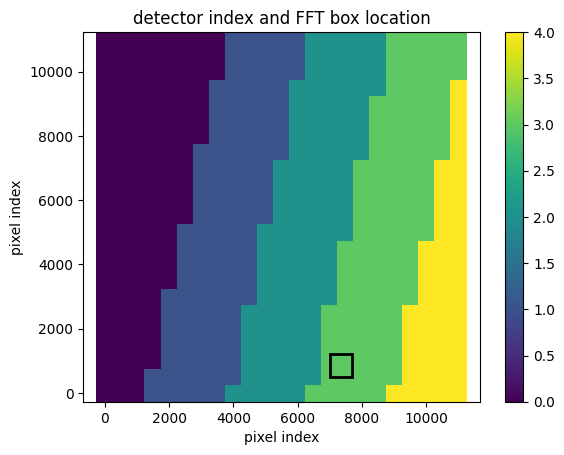

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


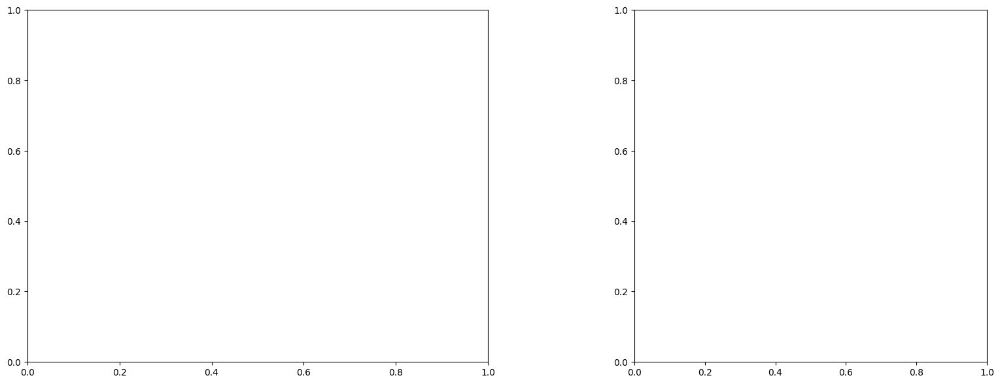

U and V components of current : [1.45214927 0.04871458]
uncertainties for U and V: 0.11873089910734766 0.10180644863518269


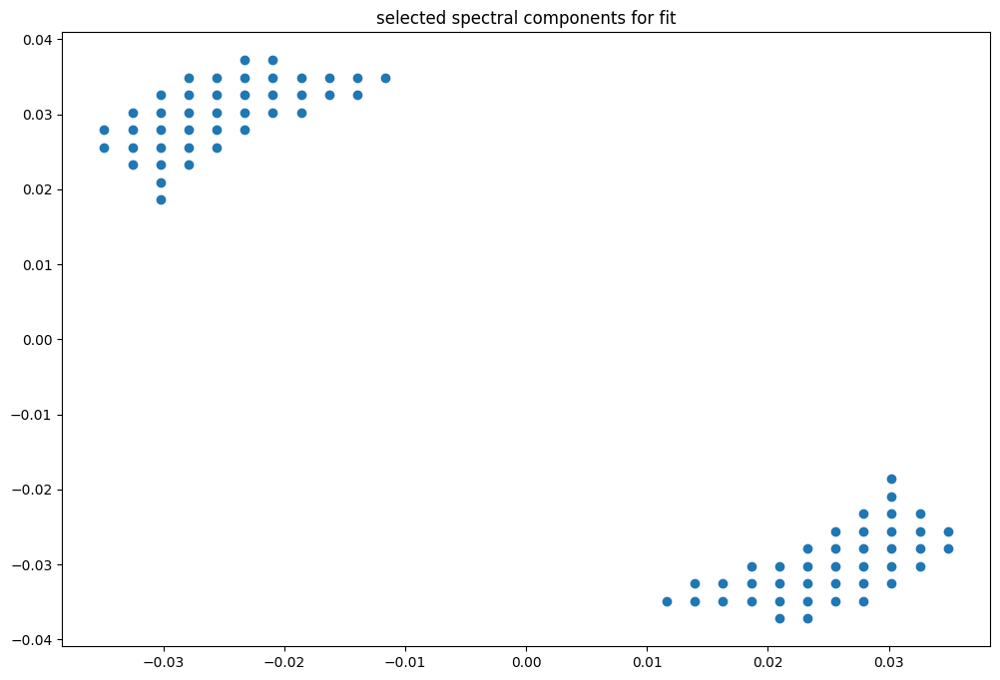

box [7000, 7700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

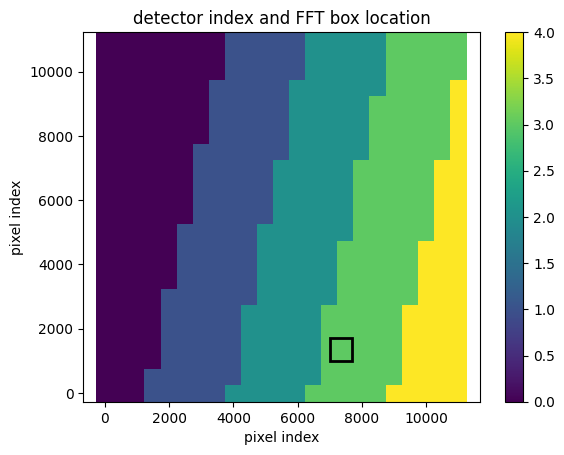

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


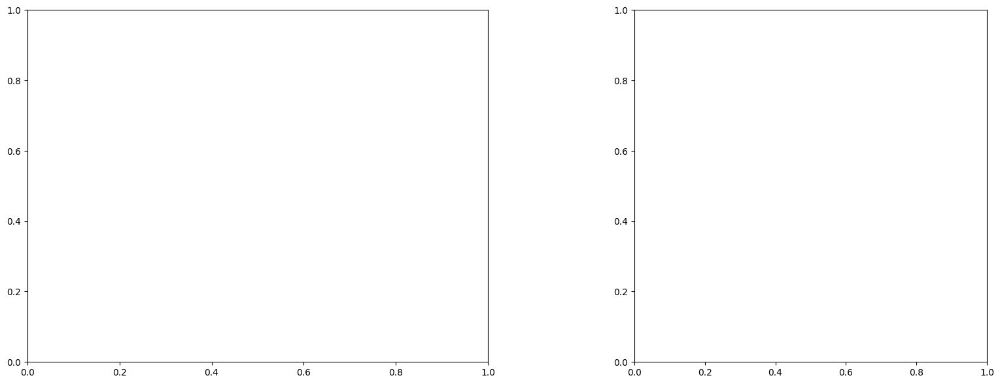

U and V components of current : [ 0.53179845 -0.83030689]
uncertainties for U and V: 0.1013697701723377 0.08950989624627728


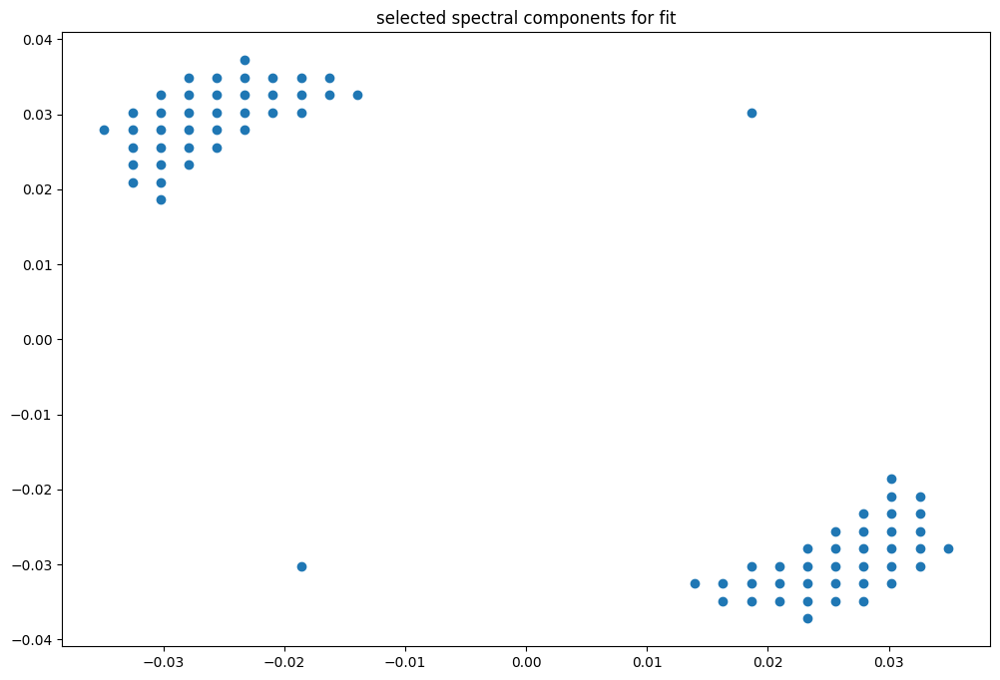

box [7000, 7700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

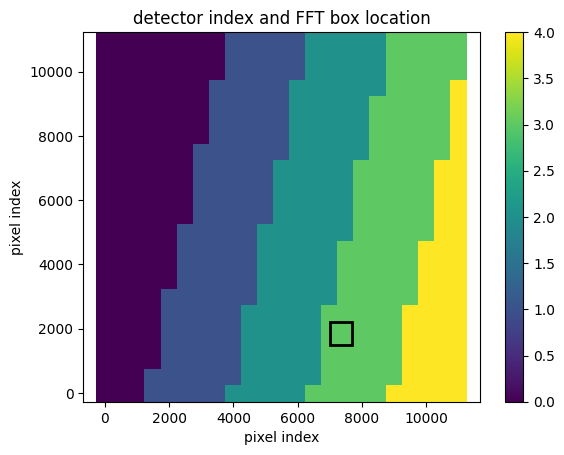

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


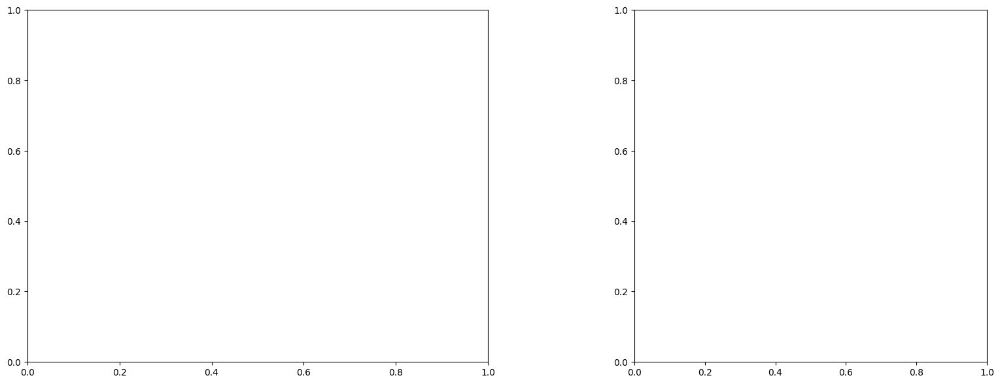

U and V components of current : [ 1.02677337 -0.49829834]
uncertainties for U and V: 0.14573479050896634 0.1249983915939607


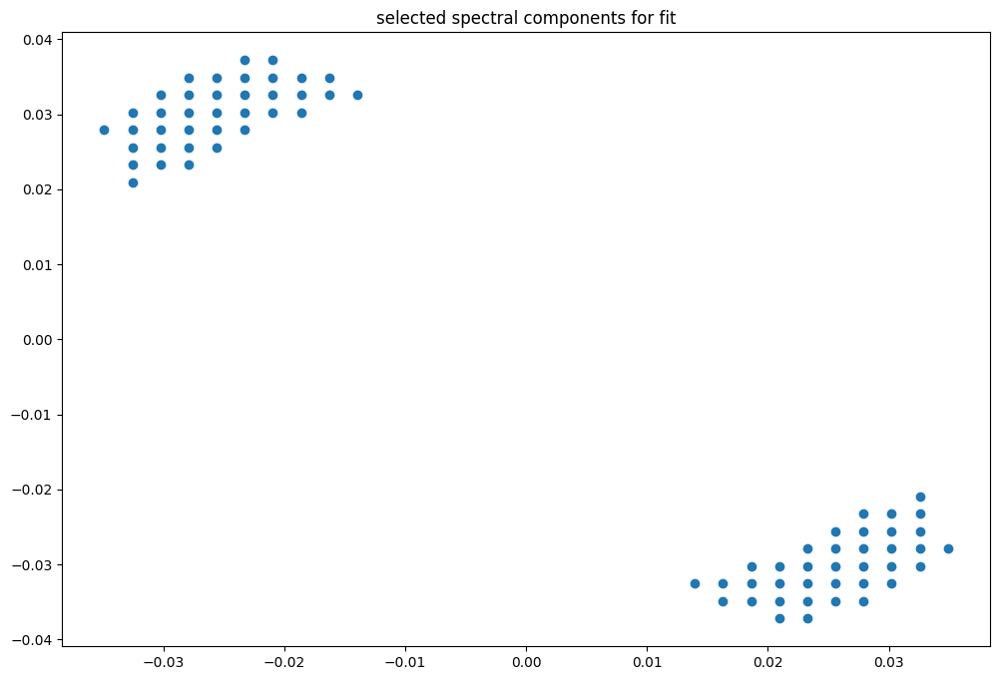

box [7000, 7700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

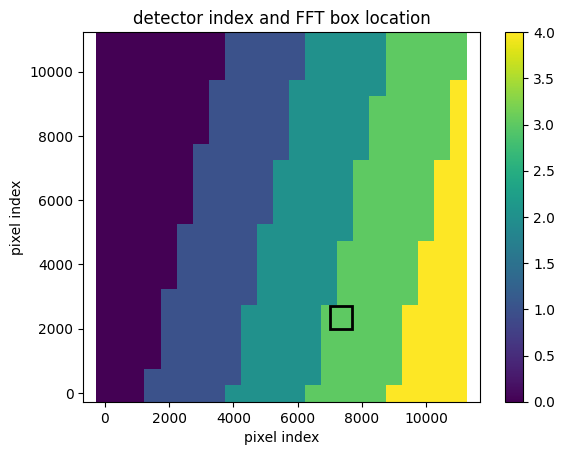

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


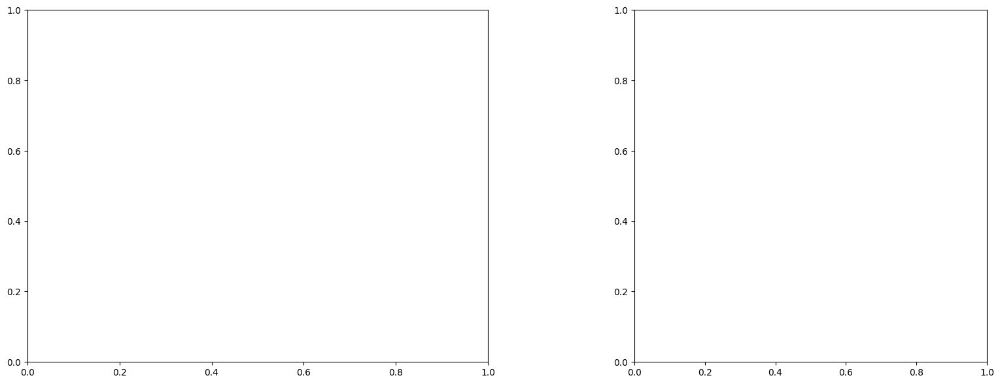

LinAlgError: Singular matrix

box [7000, 7700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

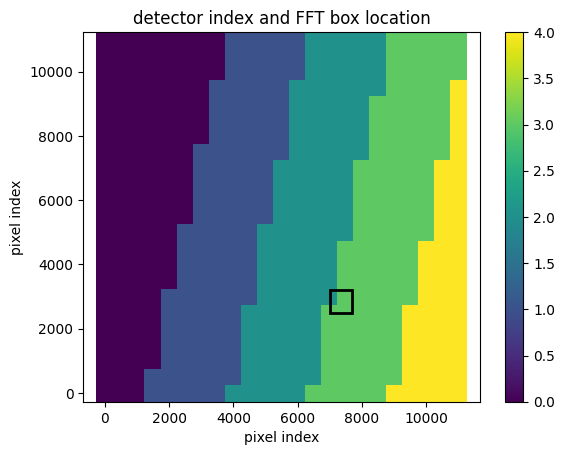

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


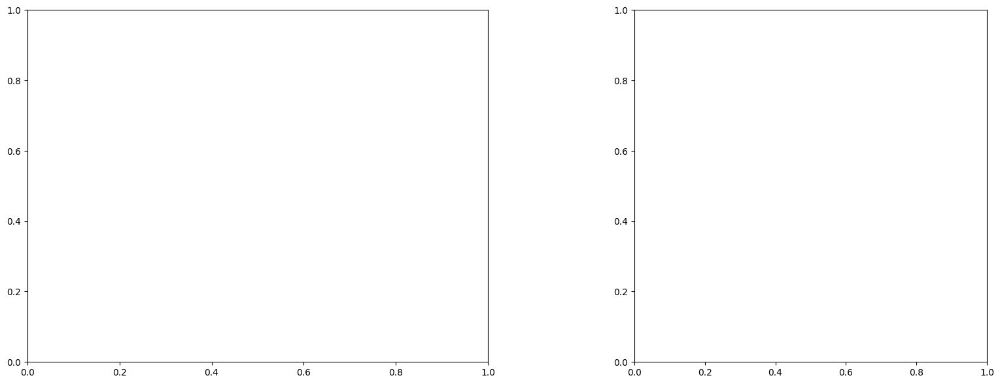

LinAlgError: Singular matrix

box [7000, 7700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

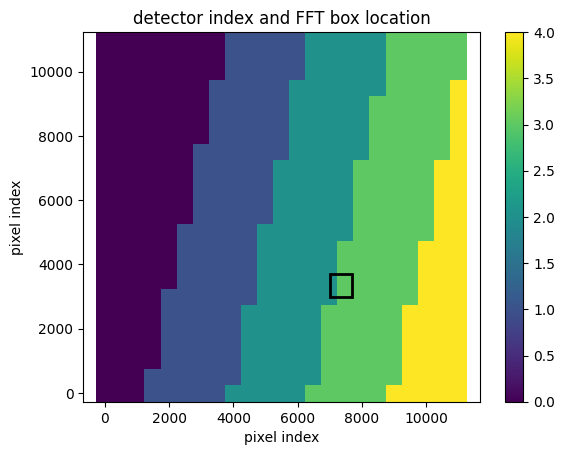

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


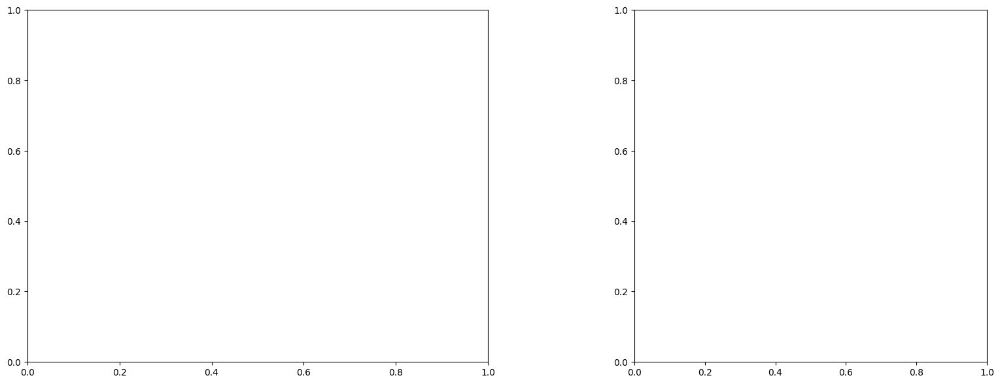

LinAlgError: Singular matrix

box [7000, 7700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

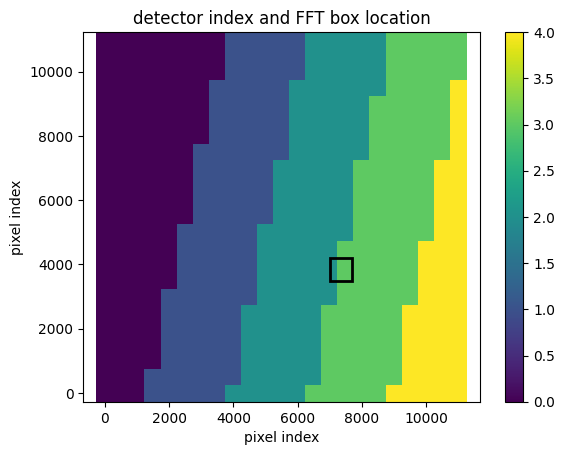

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


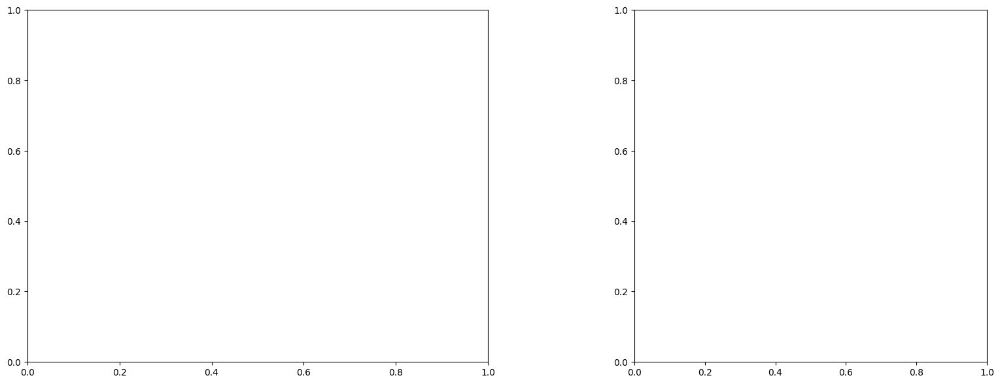

LinAlgError: Singular matrix

box [7000, 7700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

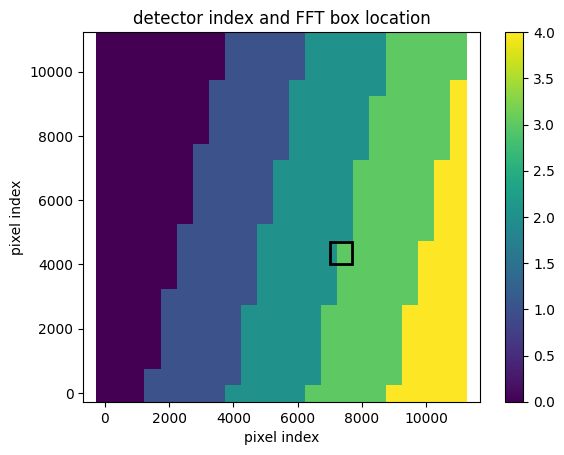

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


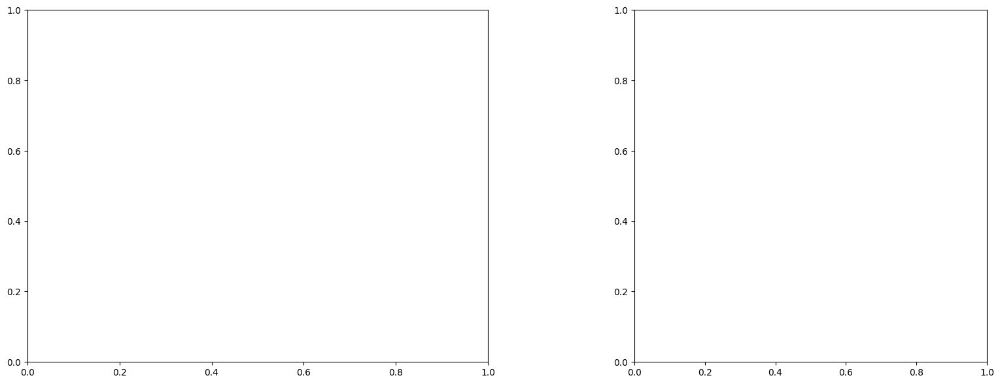

LinAlgError: Singular matrix

box [7000, 7700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

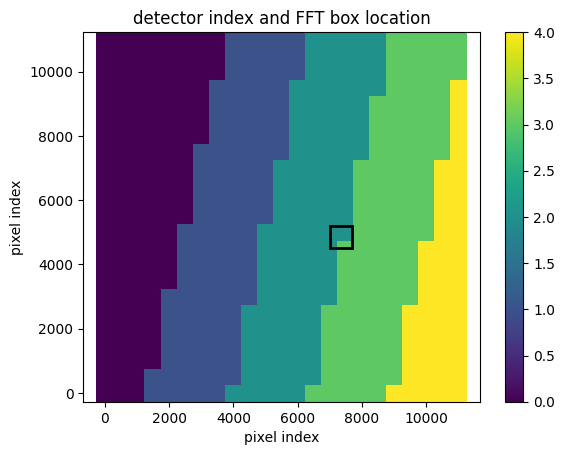

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


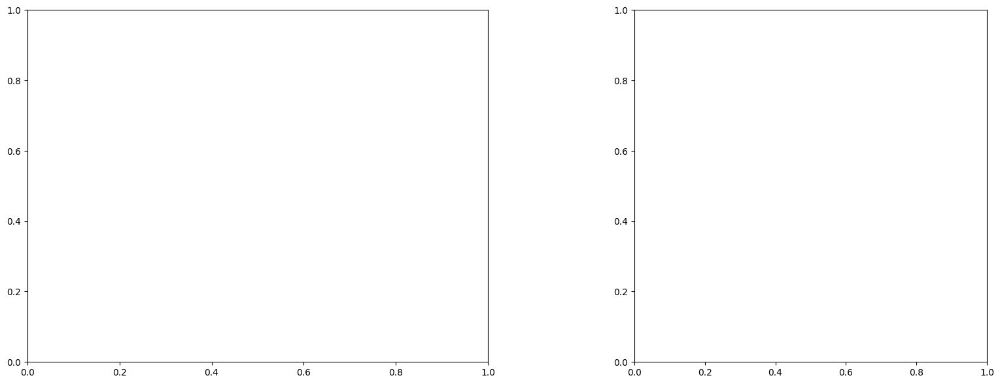

U and V components of current : [ 0.80298219 -0.68144008]
uncertainties for U and V: 0.3990574356898977 0.3884142761668114


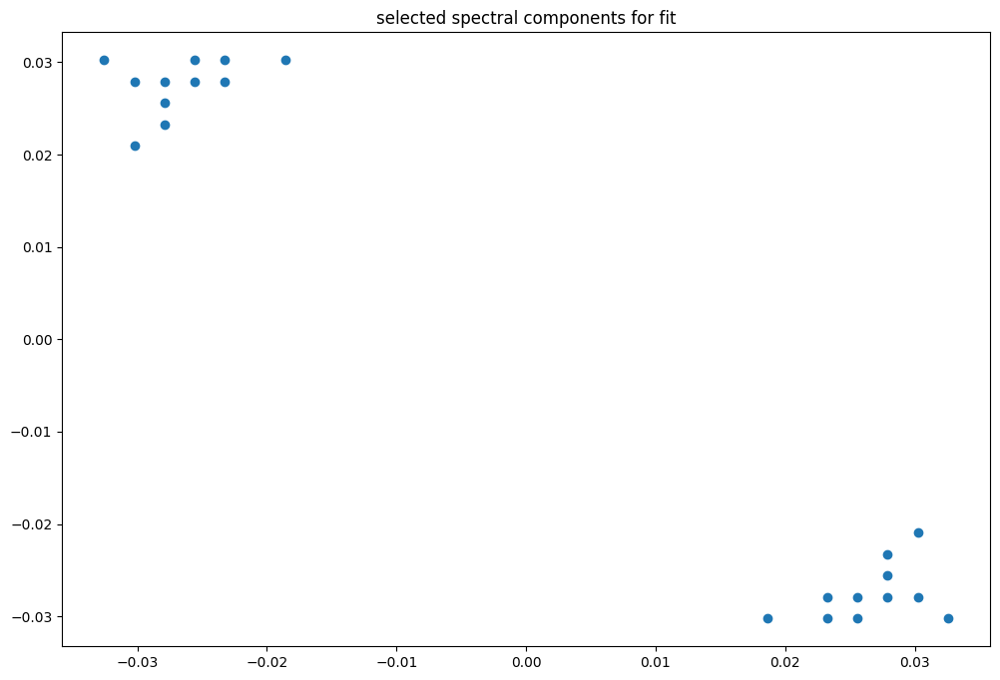

box [7000, 7700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

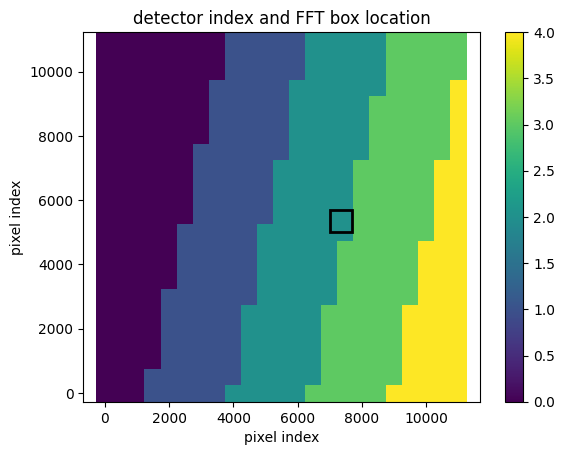

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091272845816597
(43, 43)
(43, 43)
(43, 43)


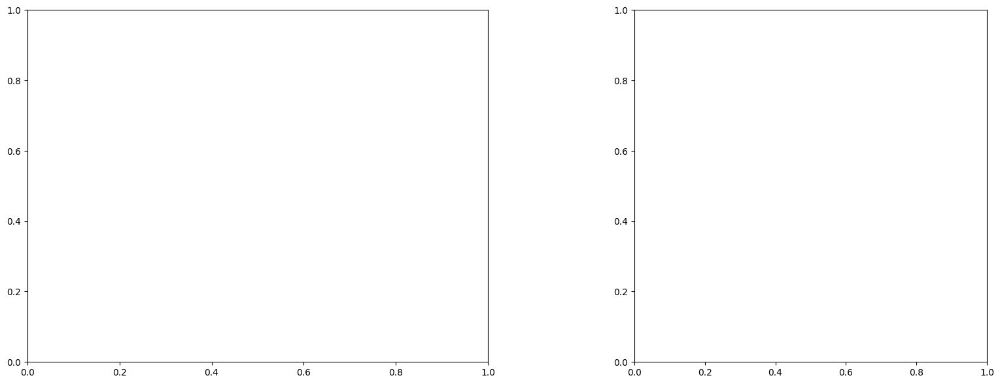

U and V components of current : [-0.29221877 -1.1895029 ]
uncertainties for U and V: 0.06472047703677529 0.061892263973065256


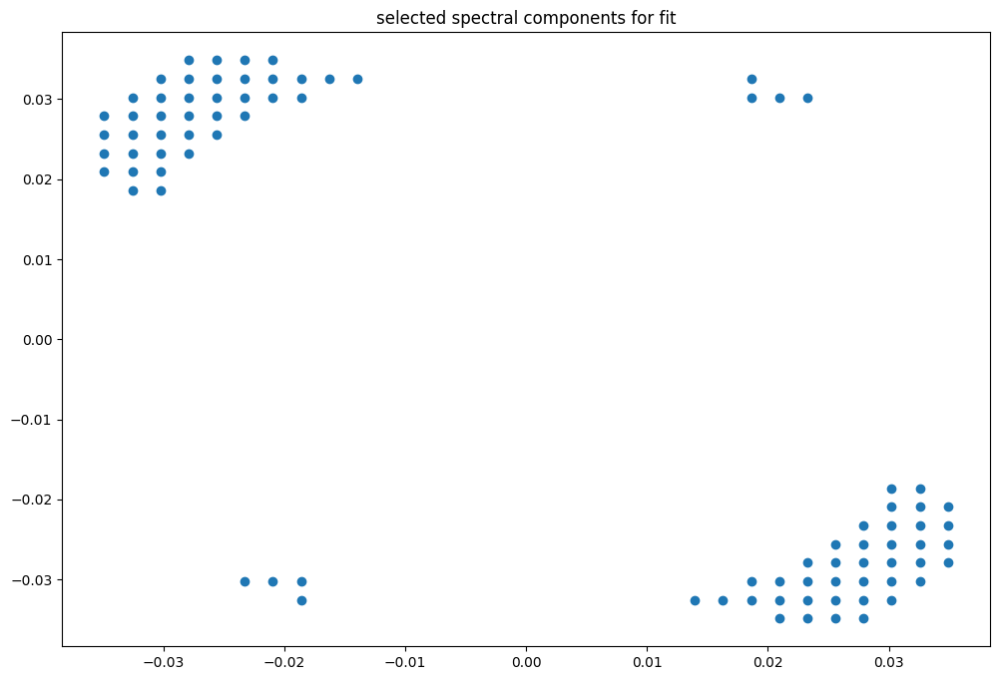

box [7000, 7700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

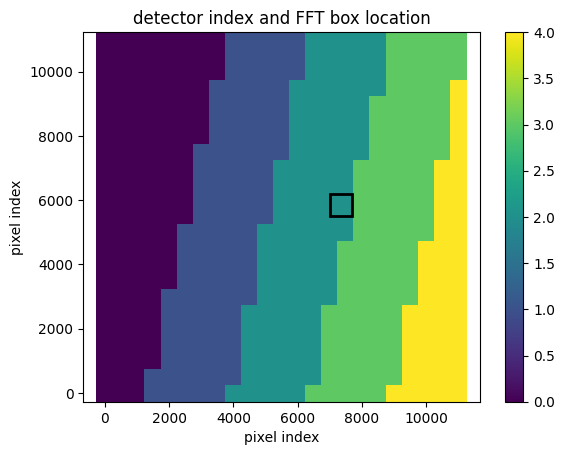

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091251528230947
(43, 43)
(43, 43)
(43, 43)


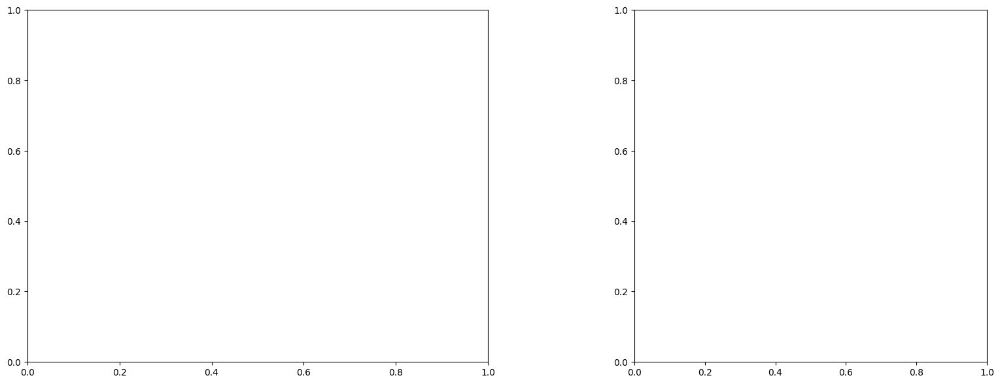

U and V components of current : [-0.45005972 -1.9383117 ]
uncertainties for U and V: 0.10576789676690317 0.1067342638137672


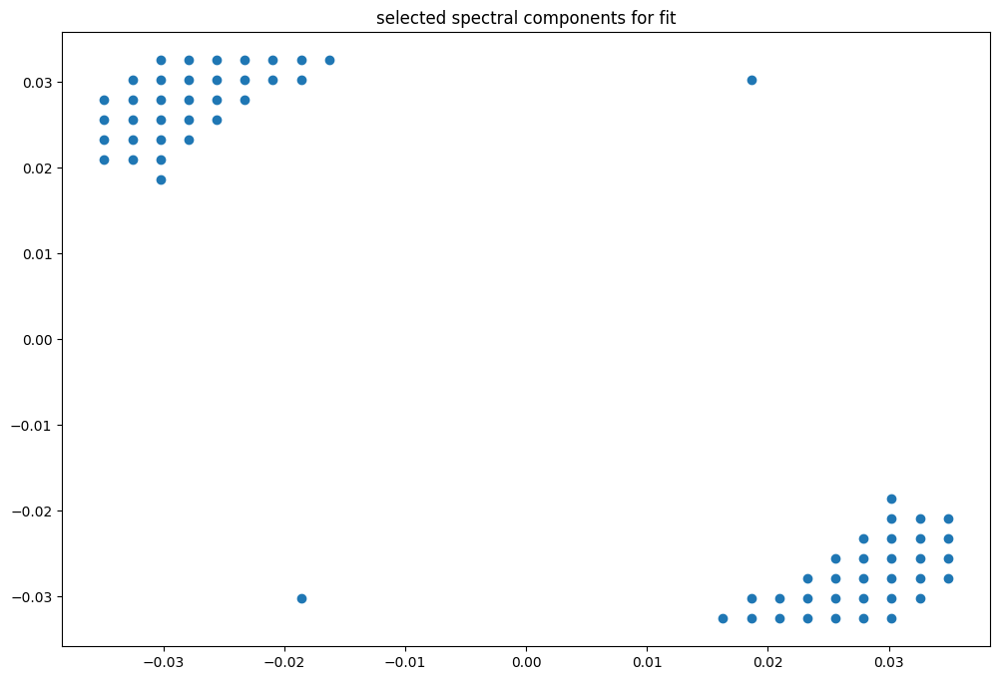

box [7000, 7700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

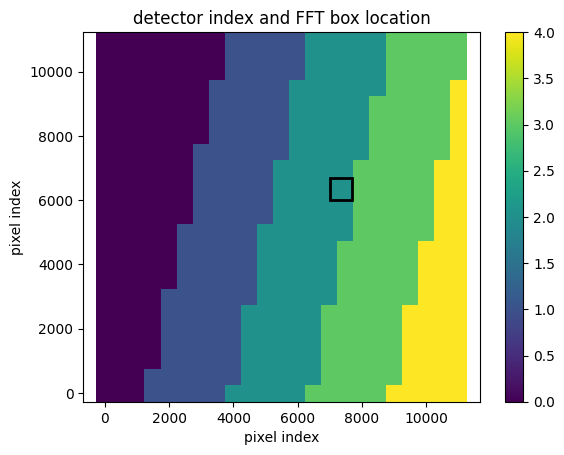

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091227053259155
(43, 43)
(43, 43)
(43, 43)


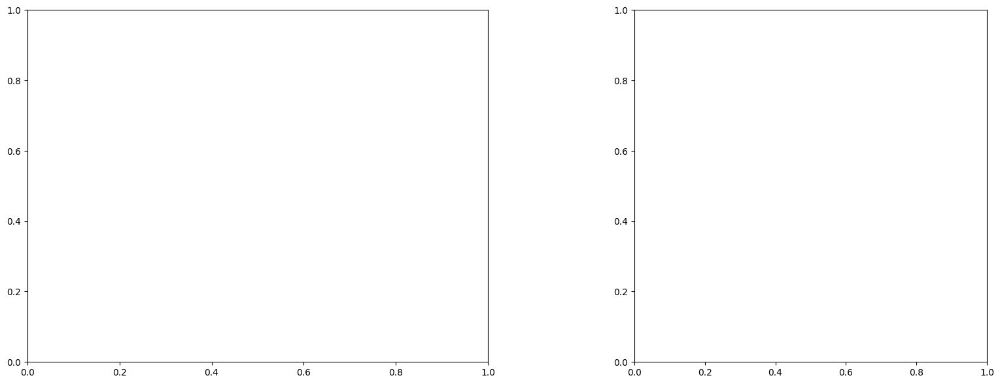

U and V components of current : [-0.2218557  -1.67086432]
uncertainties for U and V: 0.08311532927732336 0.07715729671671871


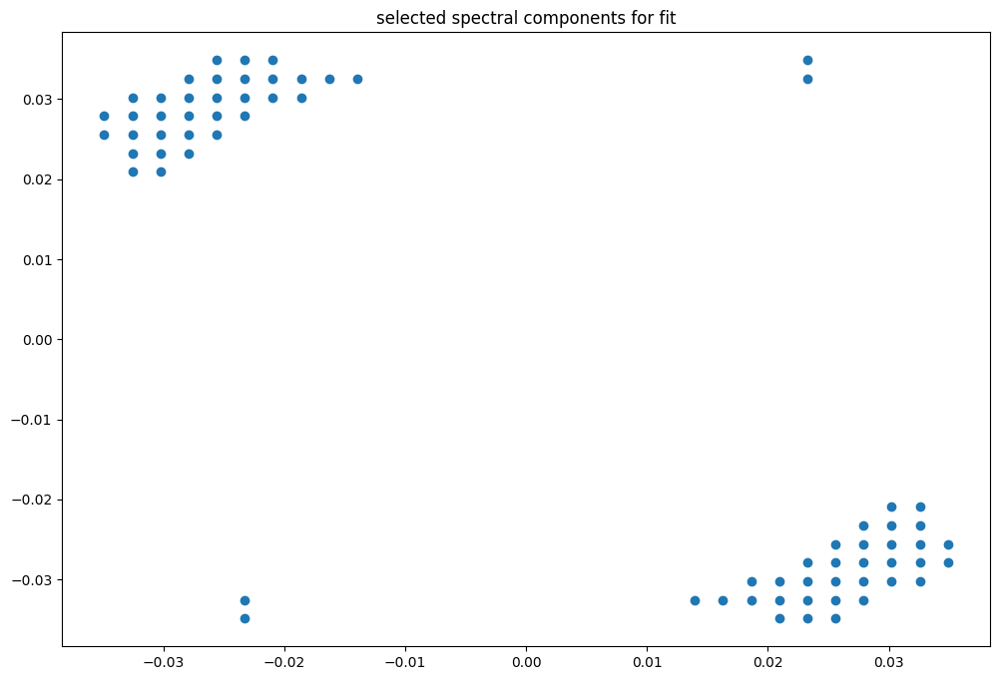

box [7000, 7700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

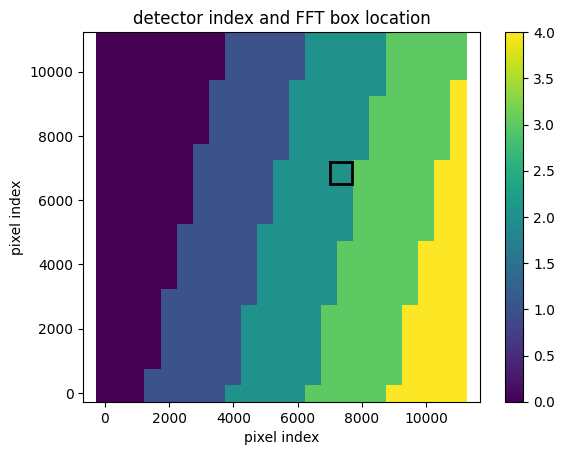

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


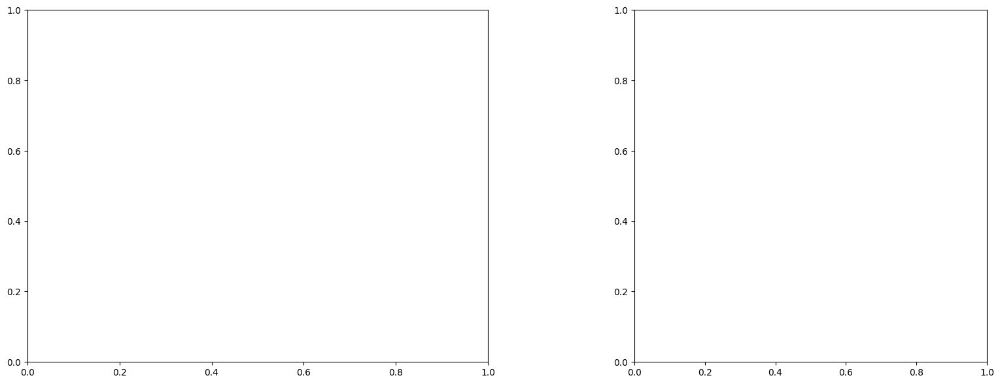

U and V components of current : [-0.31580849 -1.65745905]
uncertainties for U and V: 0.08361990785869562 0.08597395093000873


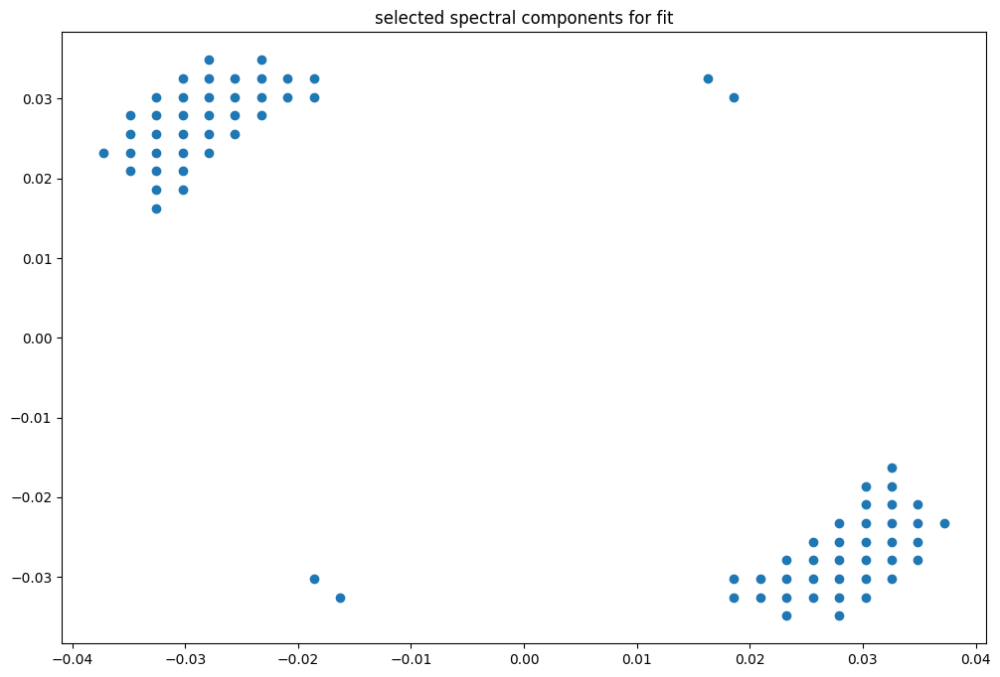

box [7000, 7700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

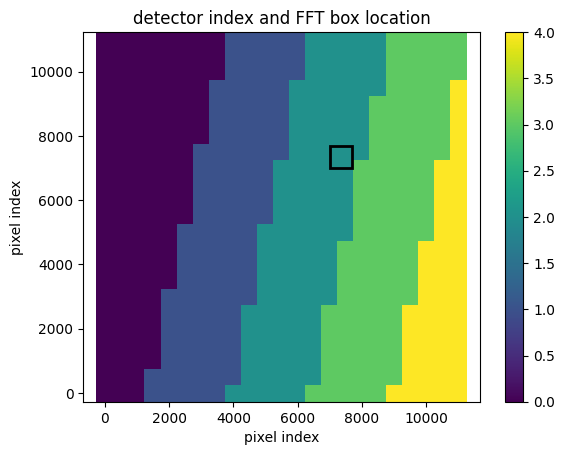

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


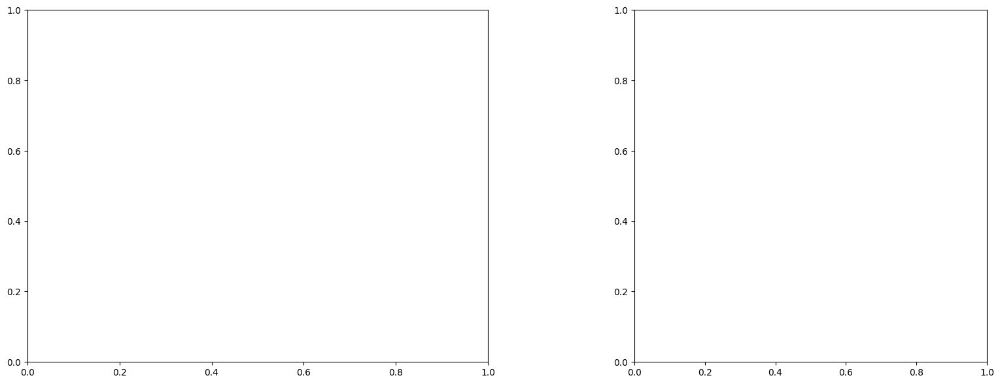

U and V components of current : [-0.09621145 -1.76049177]
uncertainties for U and V: 0.12049259118618927 0.11271661636174879


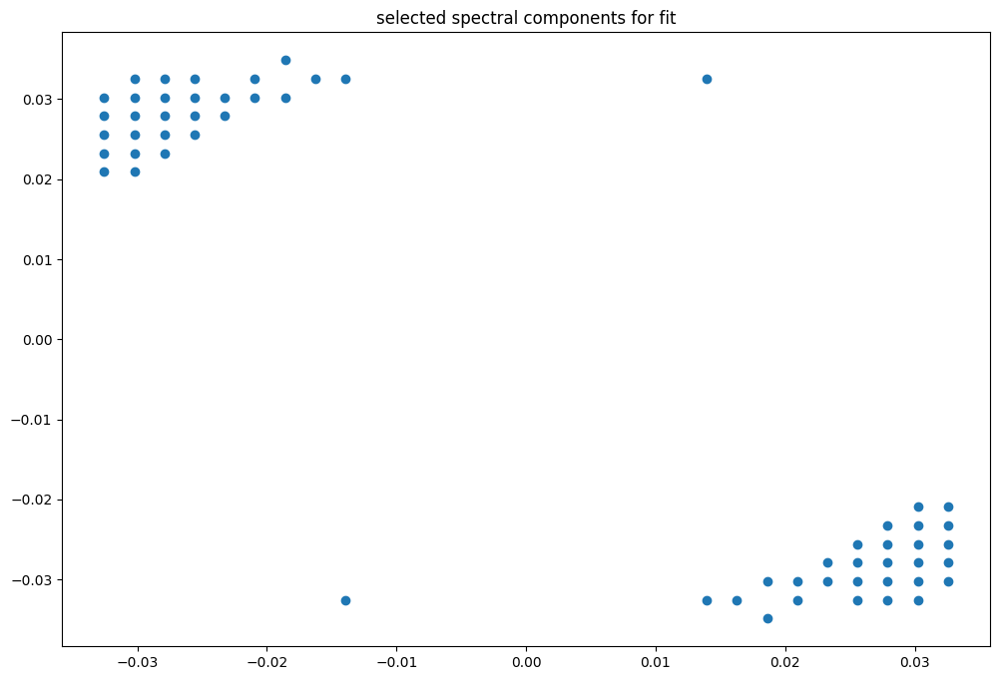

box [7000, 7700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

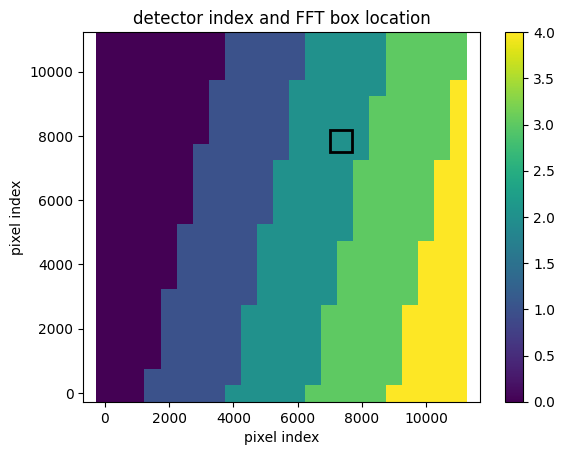

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


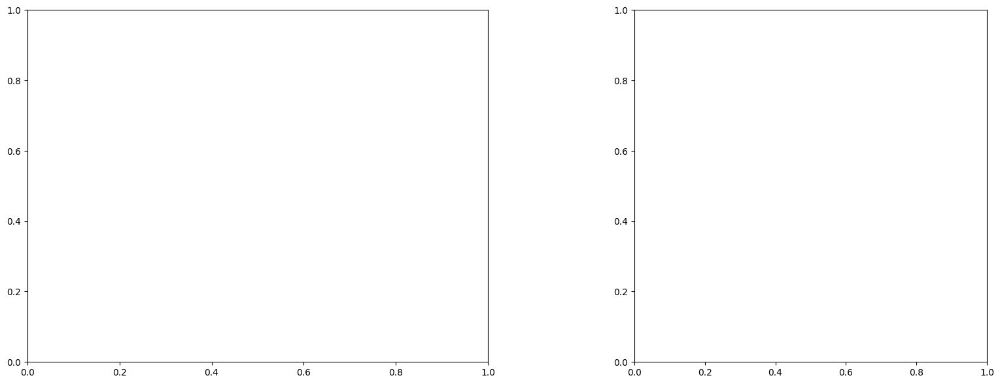

U and V components of current : [-0.21028434 -2.61132107]
uncertainties for U and V: 0.22098169502779758 0.19480240506919996


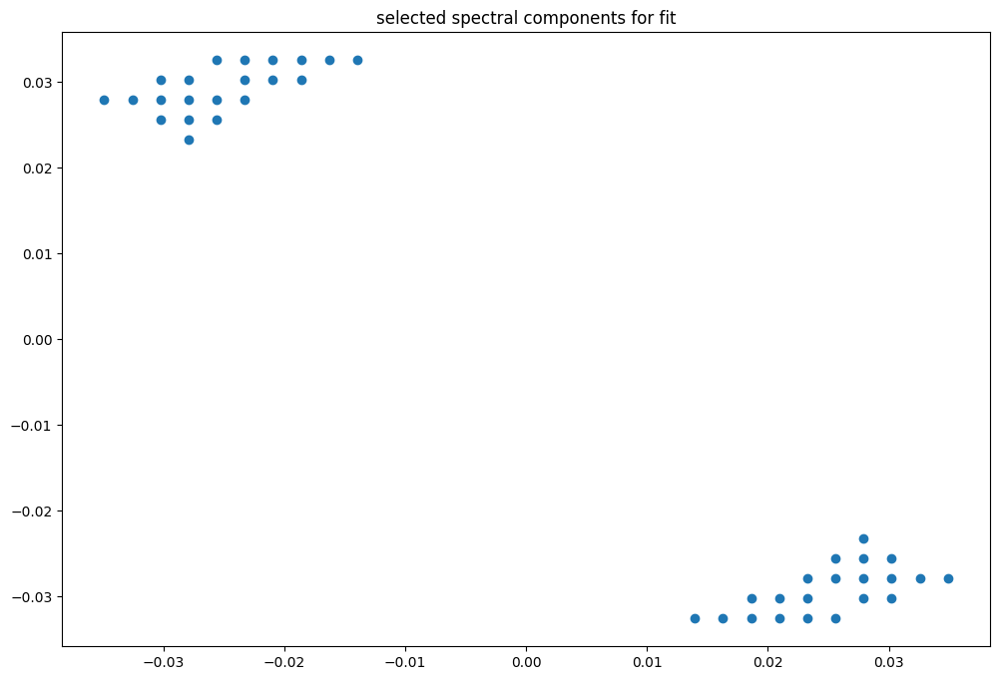

box [7000, 7700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

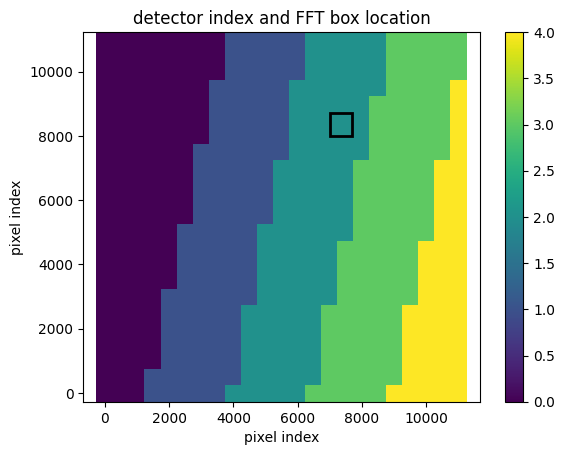

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


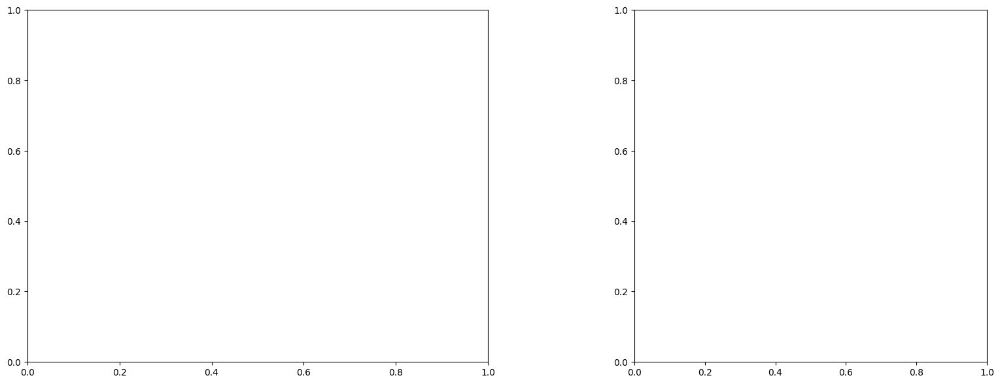

U and V components of current : [-0.90675278 -3.28435506]
uncertainties for U and V: 0.08653948030666427 0.08143508875233207


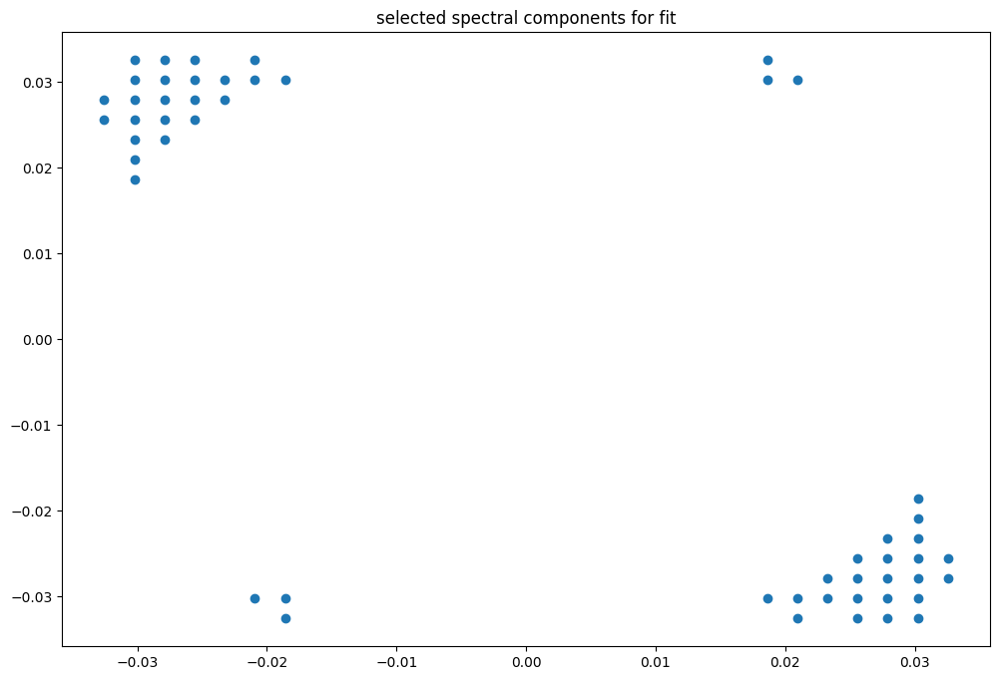

box [7000, 7700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

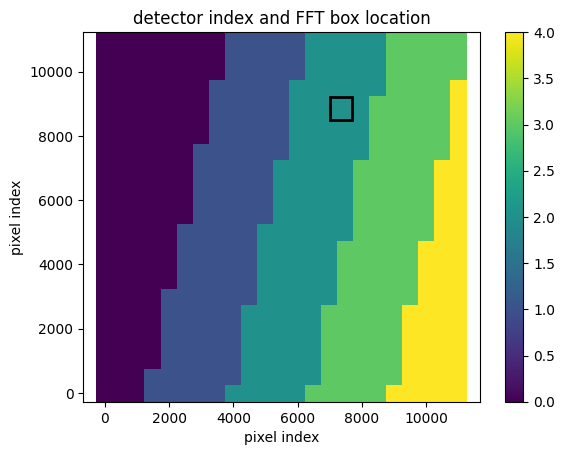

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


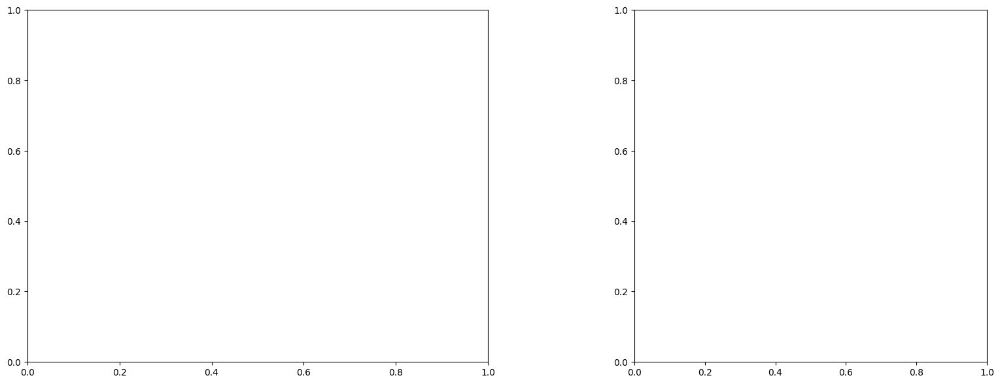

U and V components of current : [-0.38809513 -2.25461008]
uncertainties for U and V: 0.12102840898376417 0.12715118324247415


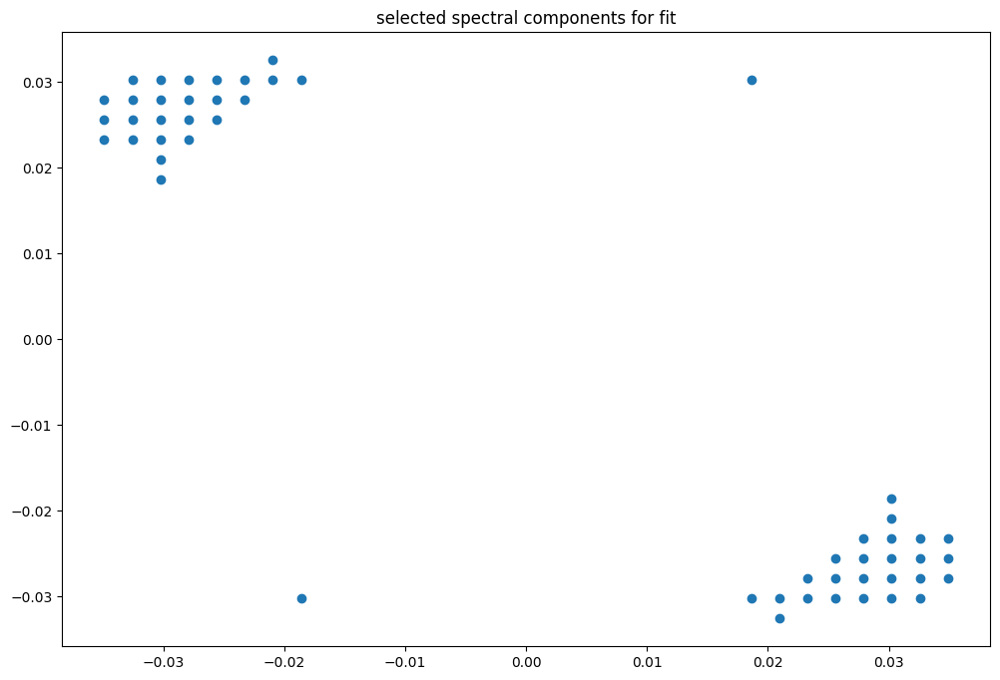

box [7000, 7700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

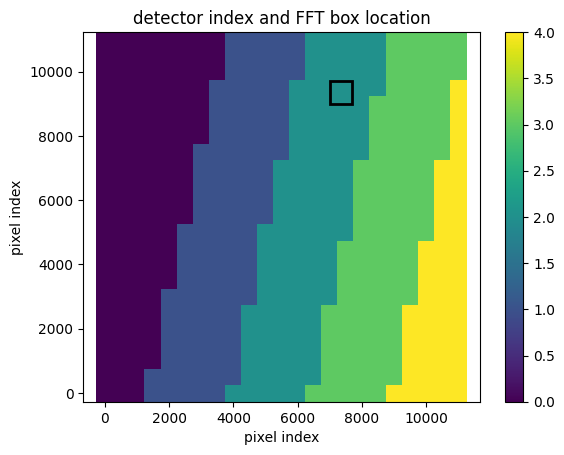

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


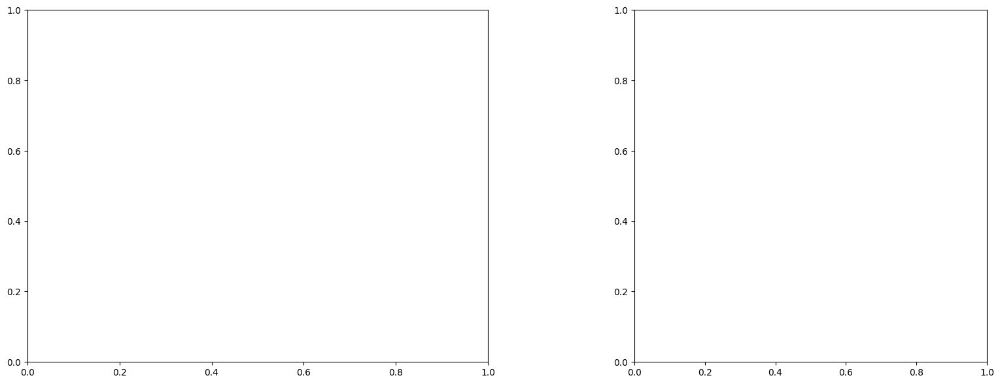

U and V components of current : [ 0.74367383 -1.12331107]
uncertainties for U and V: 0.1770859611050859 0.19756319203152795


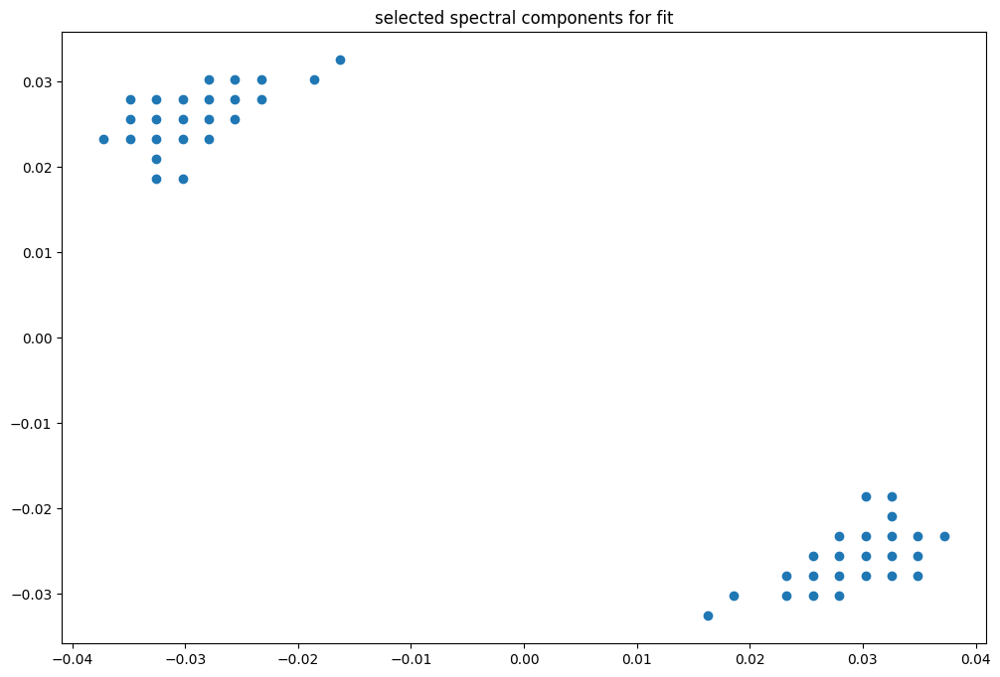

box [7000, 7700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

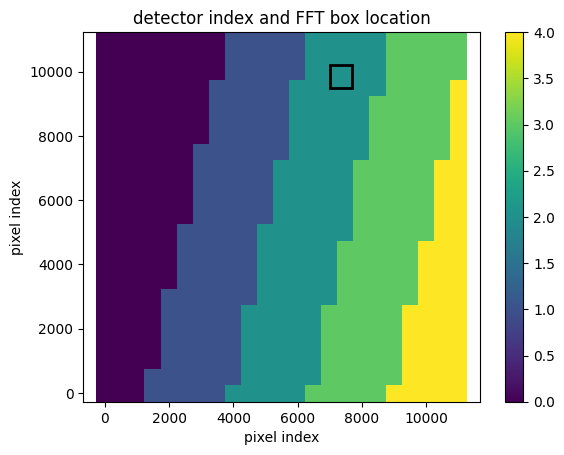

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


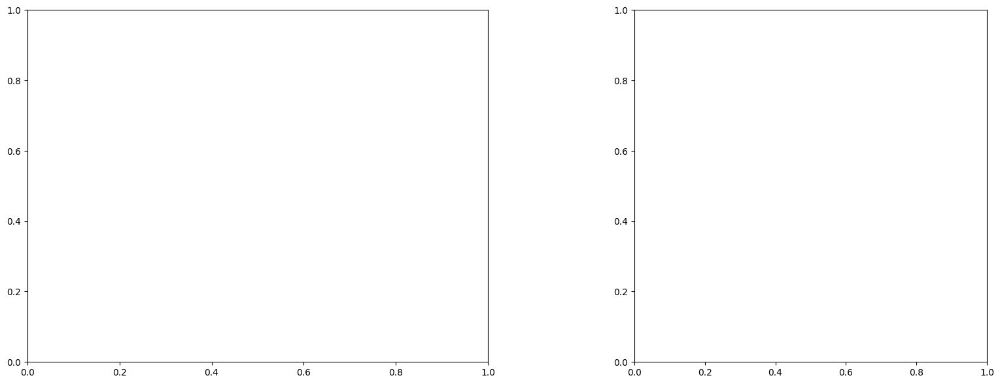

U and V components of current : [-0.42866332 -1.88427217]
uncertainties for U and V: 0.10694096680963822 0.10662323760439486


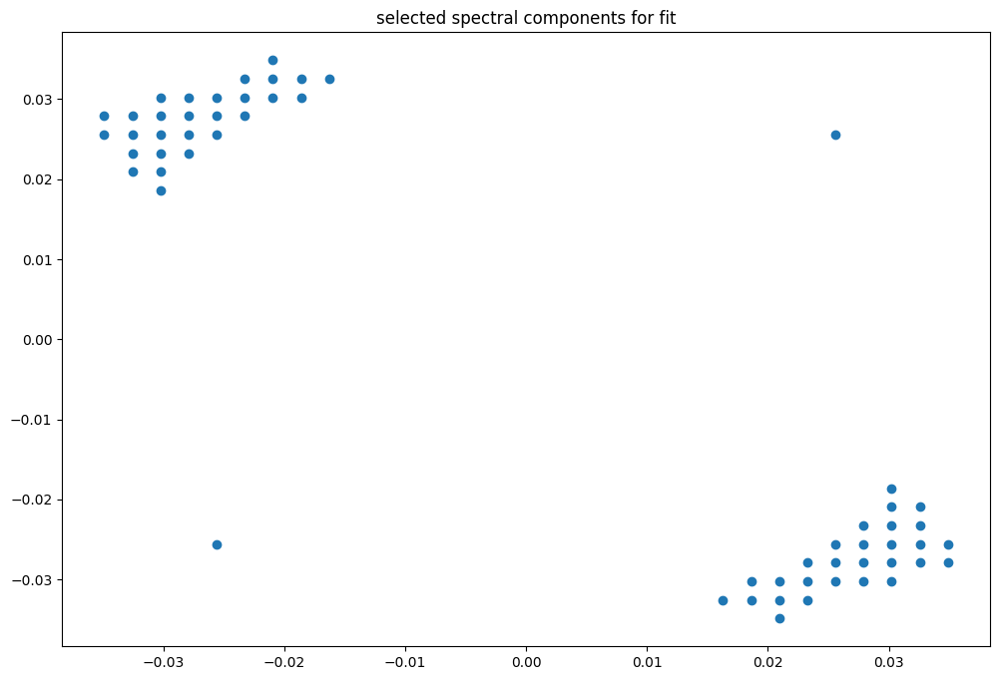

box [7000, 7700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

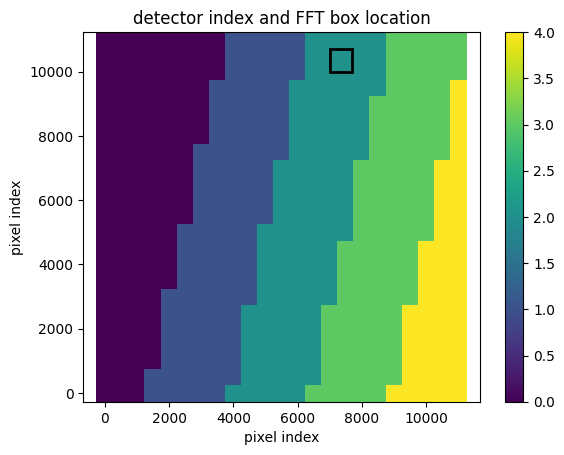

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 43)
(43, 43)
(43, 43)


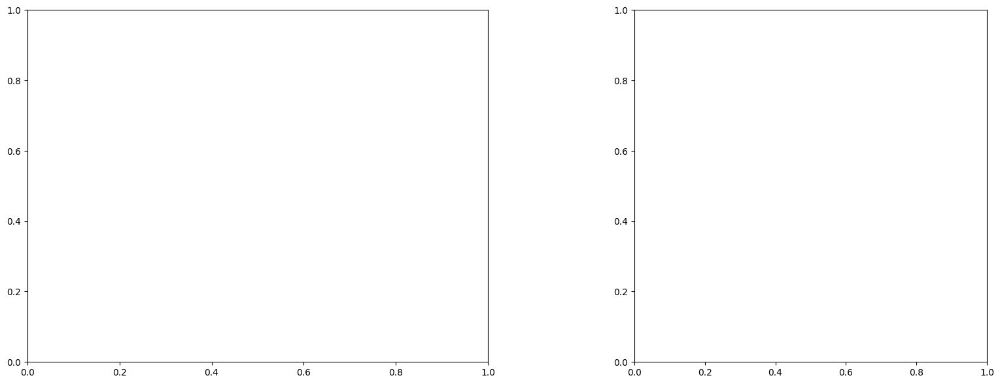

U and V components of current : [ 0.19070021 -0.96537659]
uncertainties for U and V: 0.14186025048627146 0.1510621202030254


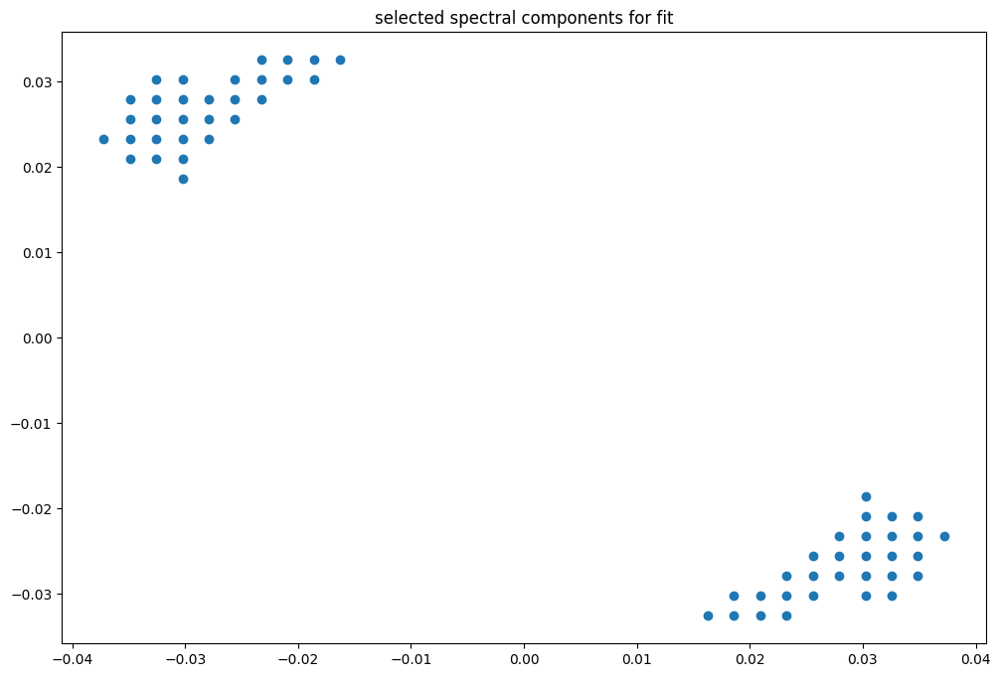

box [7000, 7700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

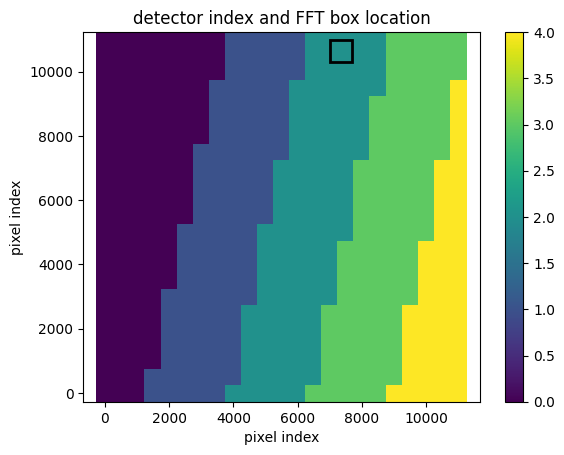

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 42)
(43, 42)
(43, 42)


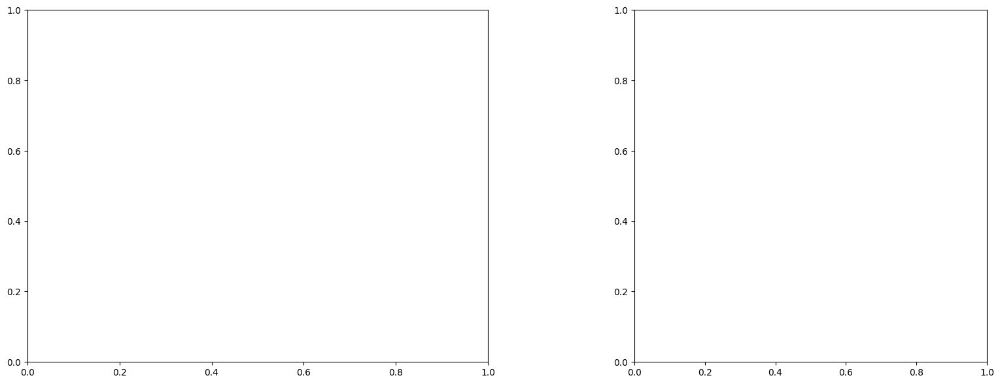

U and V components of current : [-0.49234887 -2.12515487]
uncertainties for U and V: 0.10879658336135246 0.11444914274411287


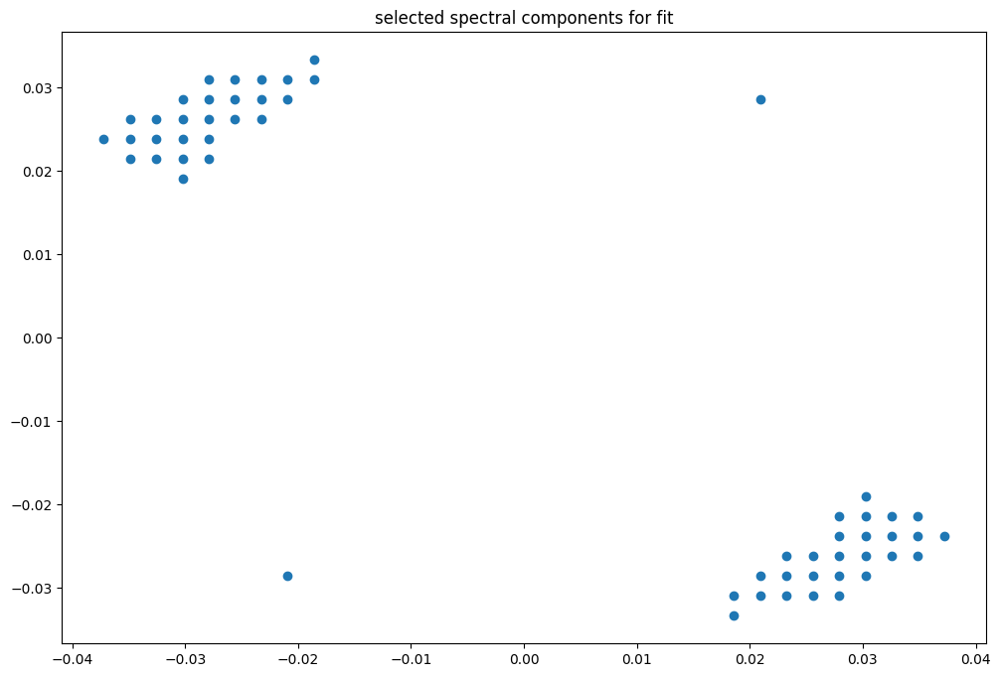

box [7500, 8200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

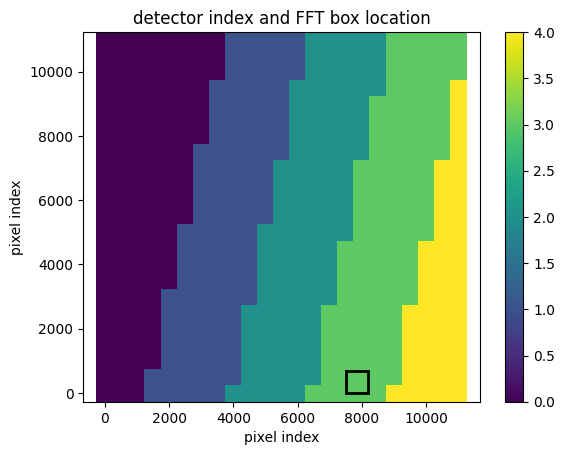

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(43, 43)
(43, 43)
(43, 43)


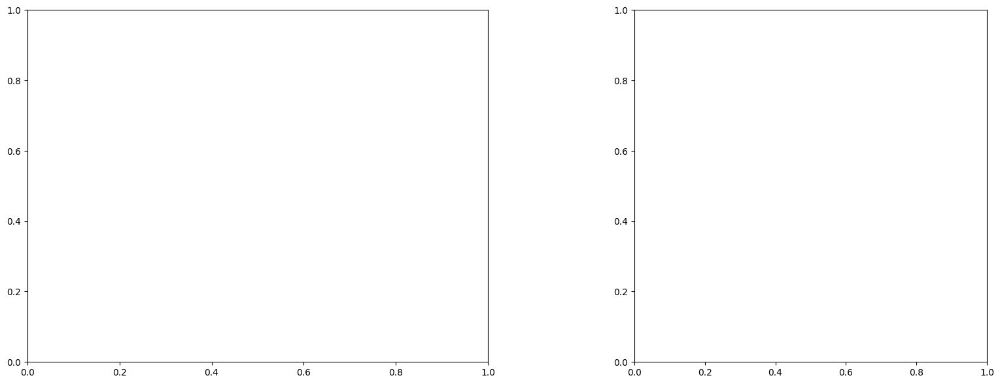

U and V components of current : [ 0.73352815 -0.3438755 ]
uncertainties for U and V: 0.11513651487832922 0.08650729184365959


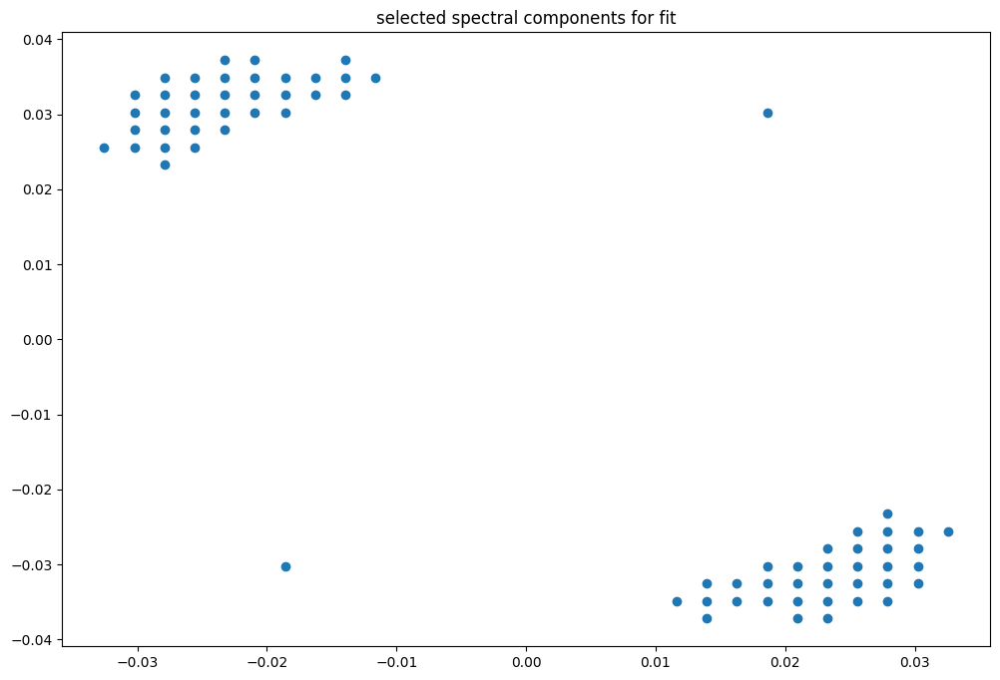

box [7500, 8200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

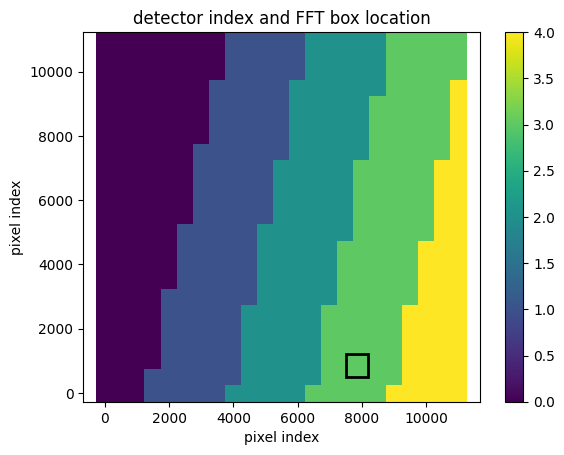

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


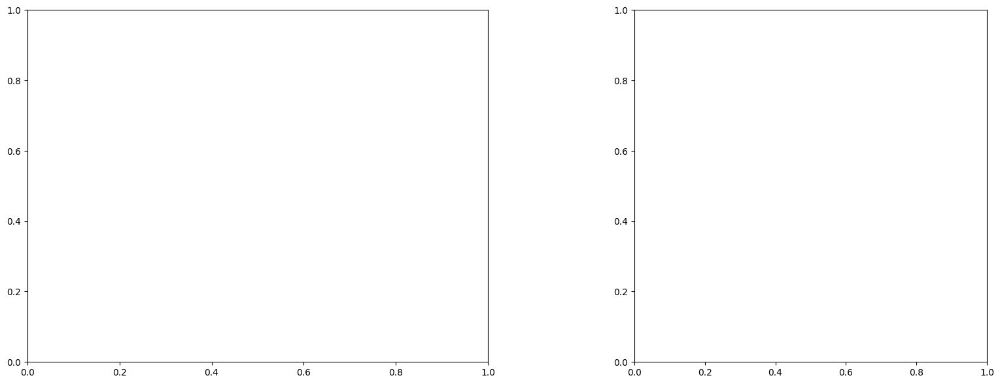

U and V components of current : [ 1.59526645 -0.38945566]
uncertainties for U and V: 0.16052697946558367 0.12204674740133417


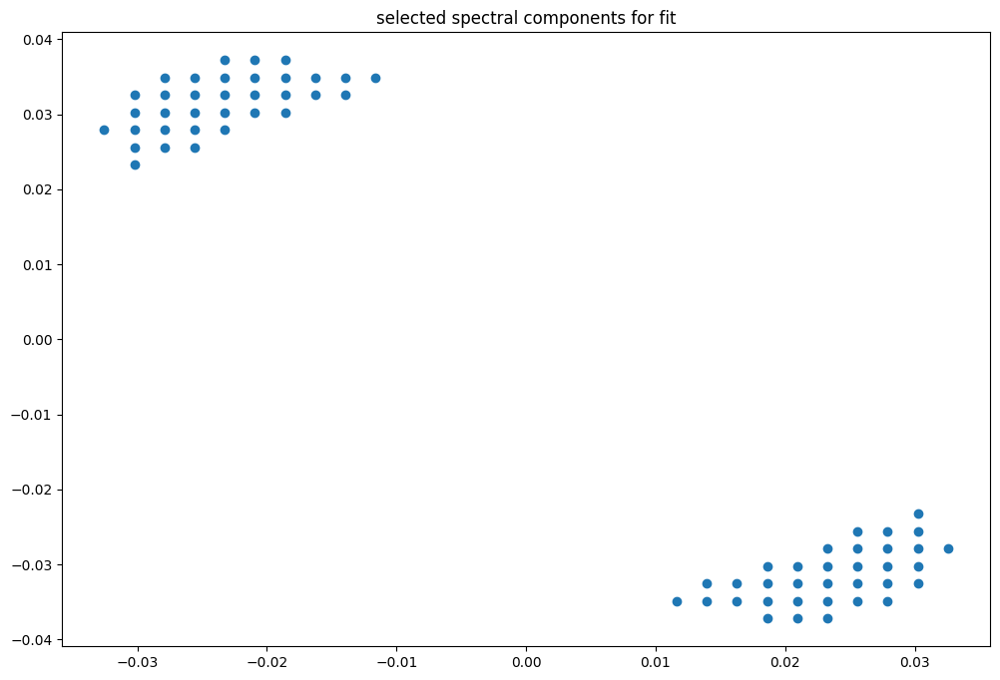

box [7500, 8200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

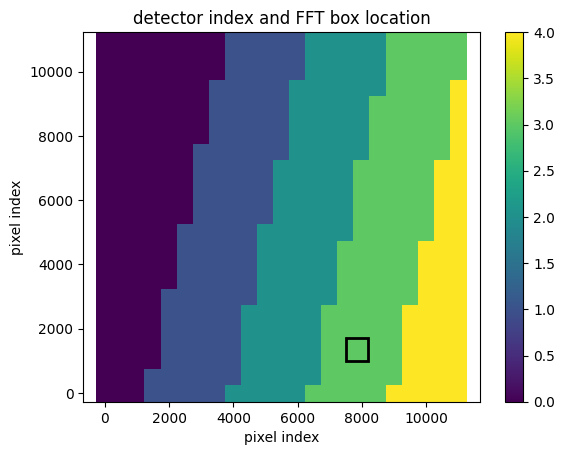

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


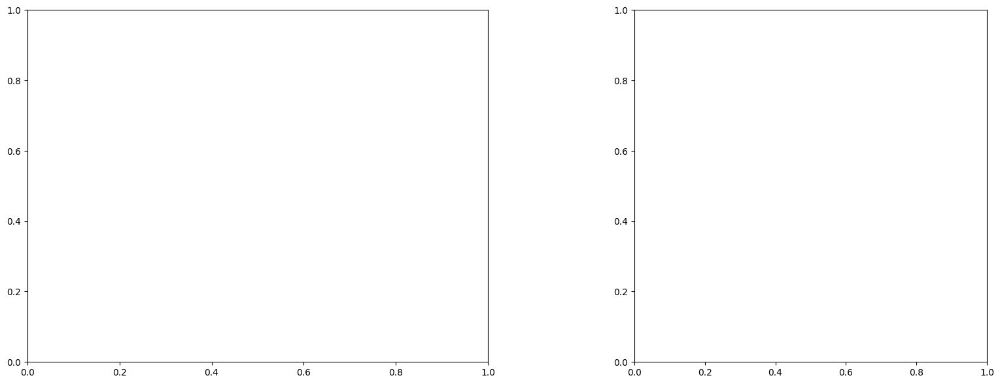

U and V components of current : [2.00020956 0.45002057]
uncertainties for U and V: 0.13011755193980776 0.1049236420955971


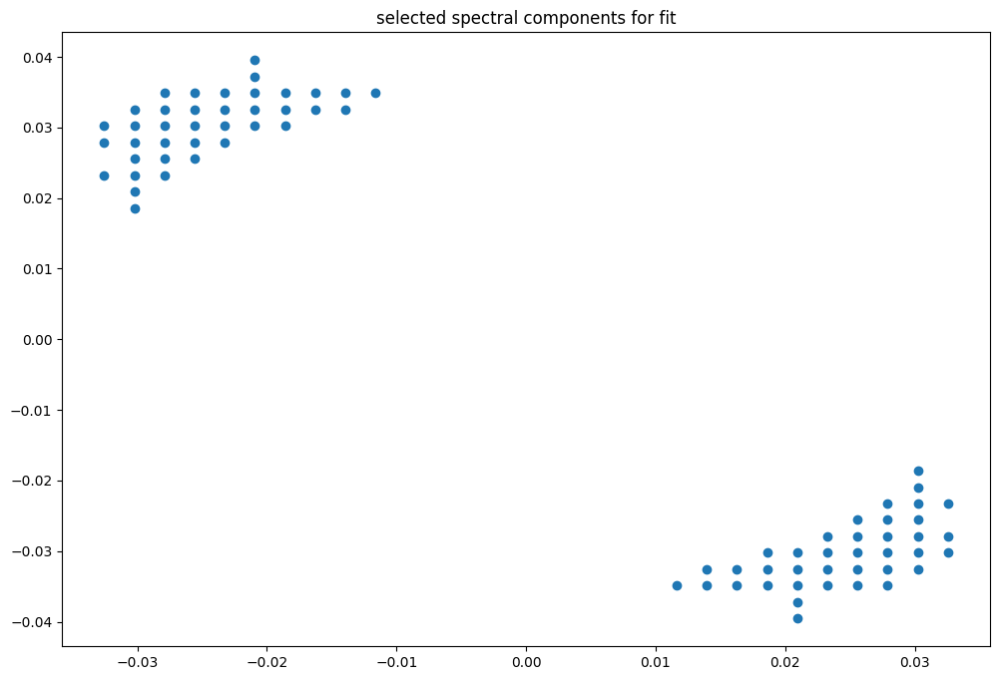

box [7500, 8200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

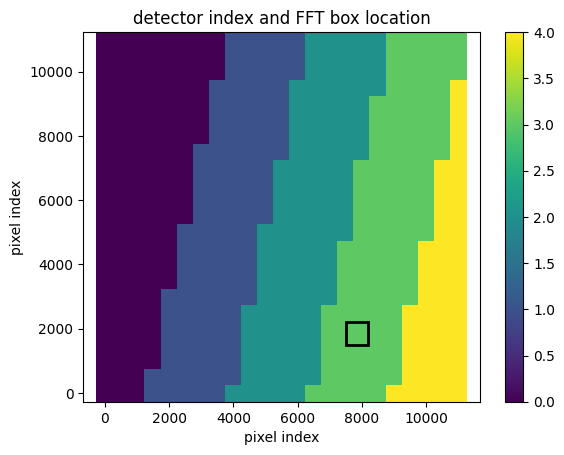

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


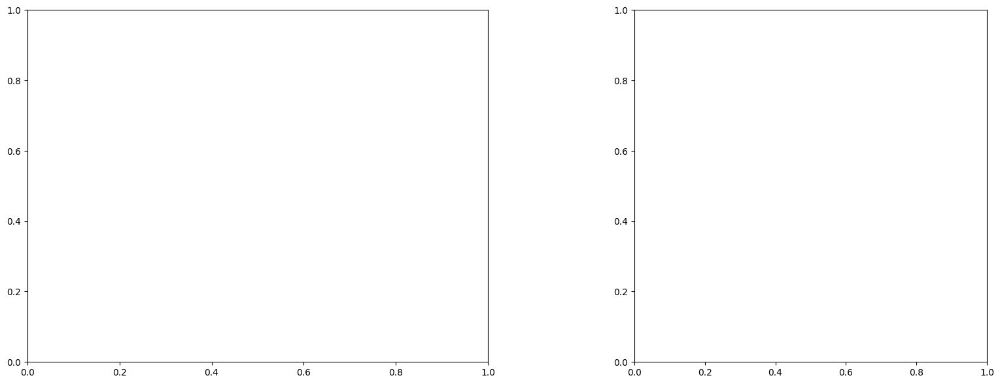

U and V components of current : [ 0.15734013 -1.07280769]
uncertainties for U and V: 0.11139215066328213 0.09260806329619939


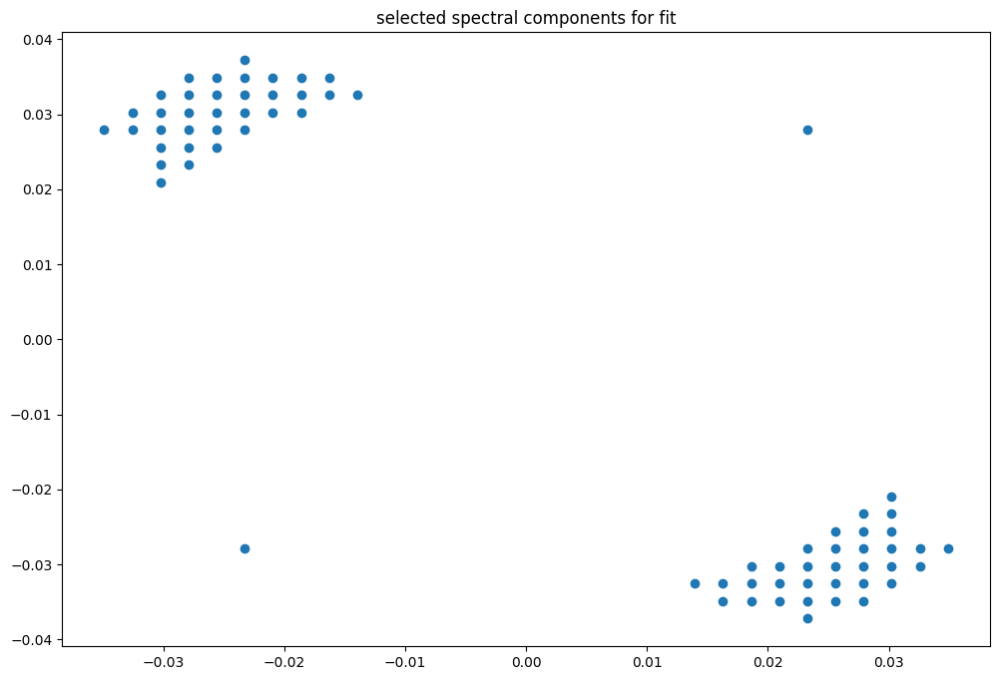

box [7500, 8200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

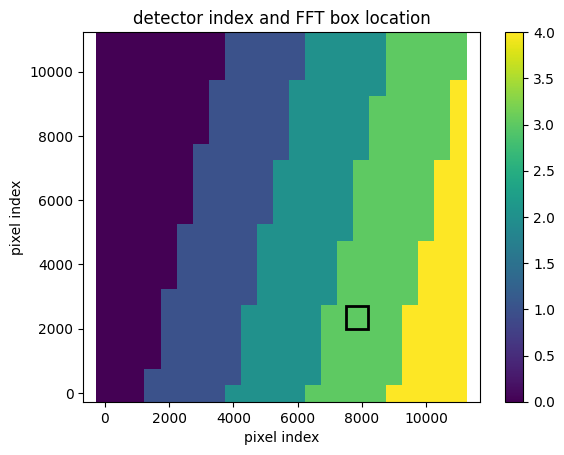

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


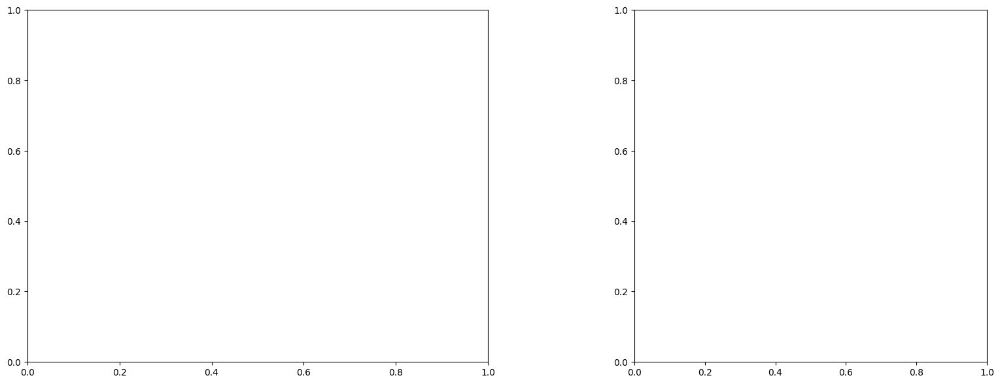

U and V components of current : [-0.17435444 -1.47765234]
uncertainties for U and V: 0.06509156144058384 0.057067662944110684


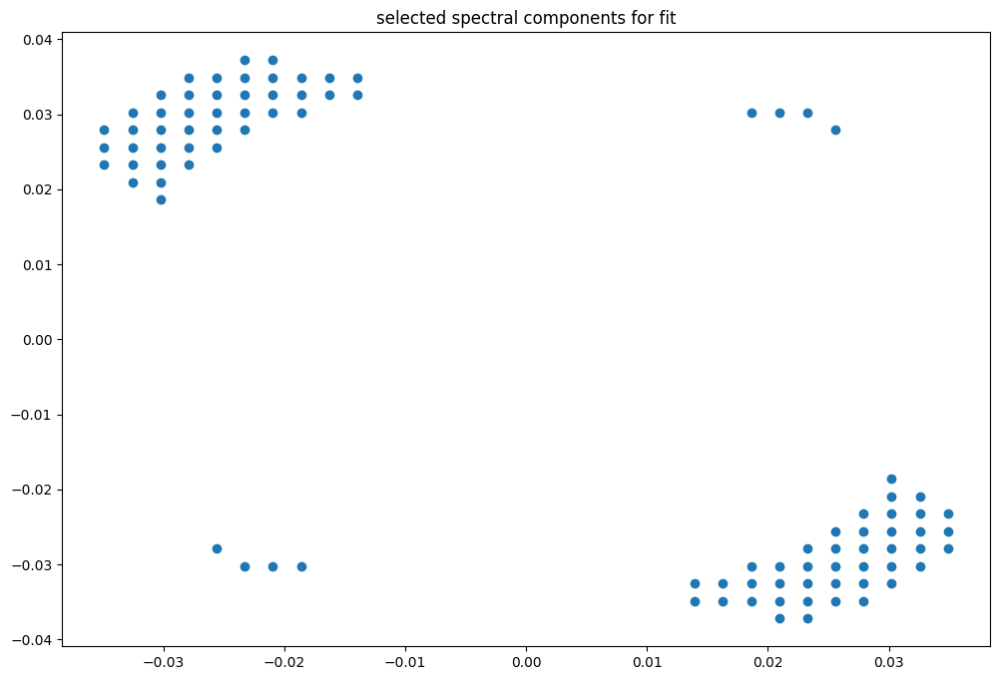

box [7500, 8200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

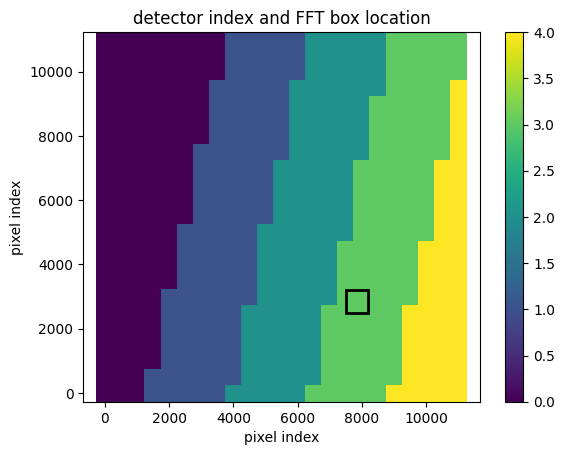

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


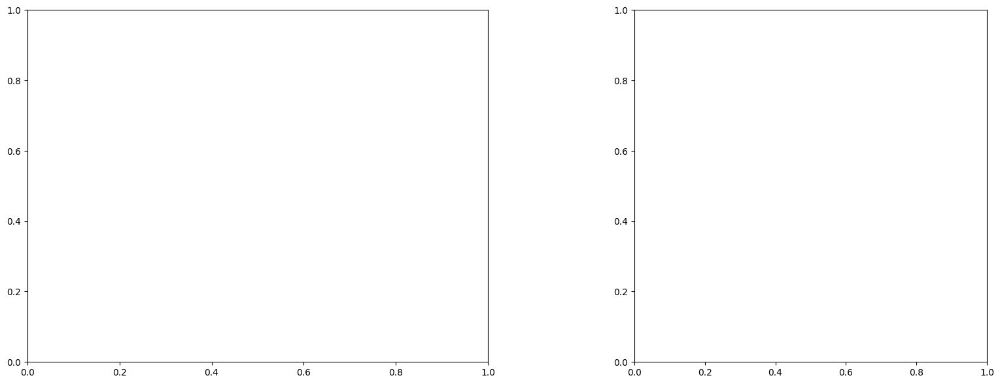

U and V components of current : [-0.073993   -1.30970349]
uncertainties for U and V: 0.08628337122309314 0.07753938753497851


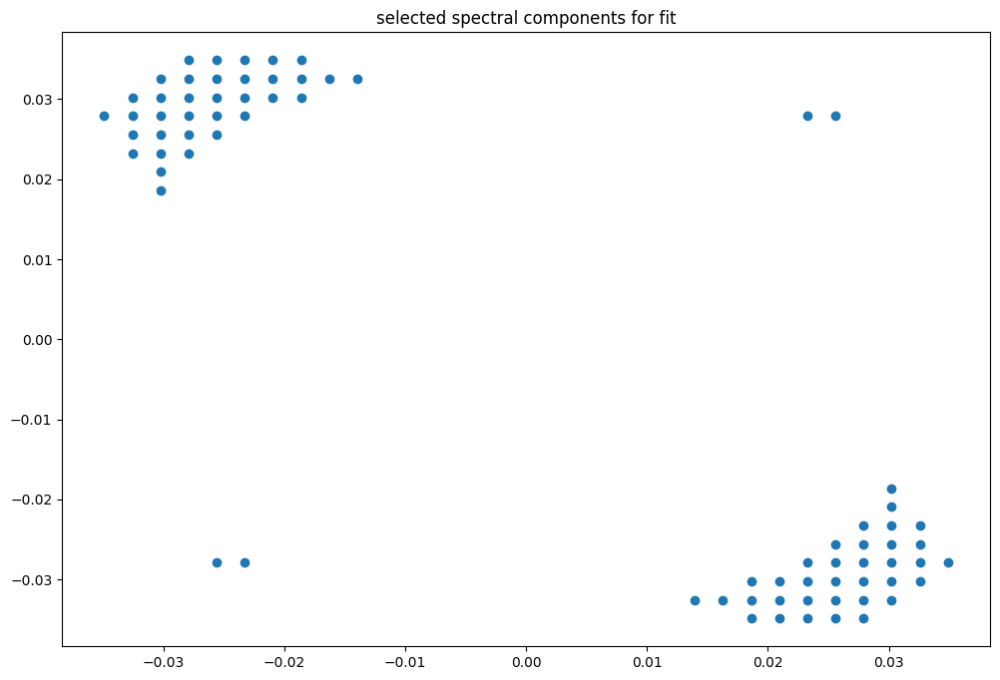

box [7500, 8200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

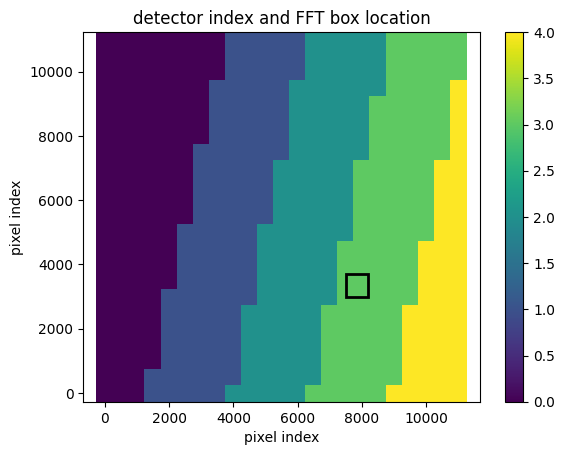

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


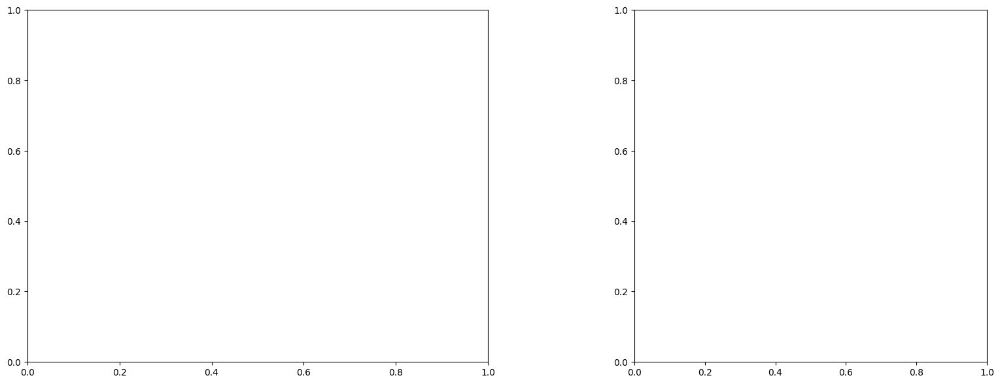

U and V components of current : [-0.06893382 -1.61230304]
uncertainties for U and V: 0.09299988008296481 0.08437271780785352


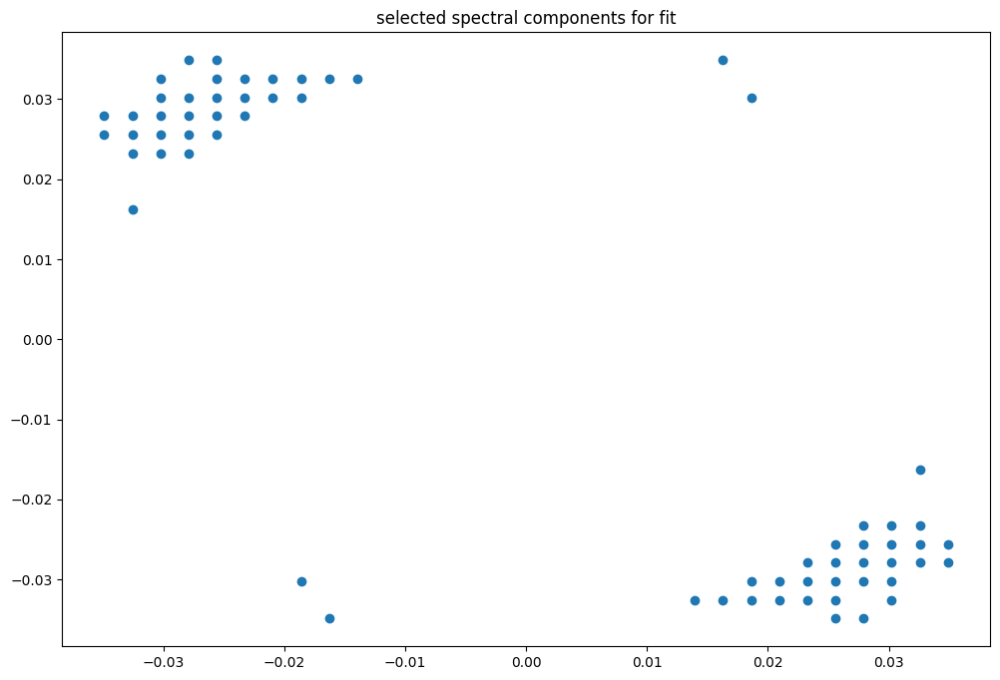

box [7500, 8200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

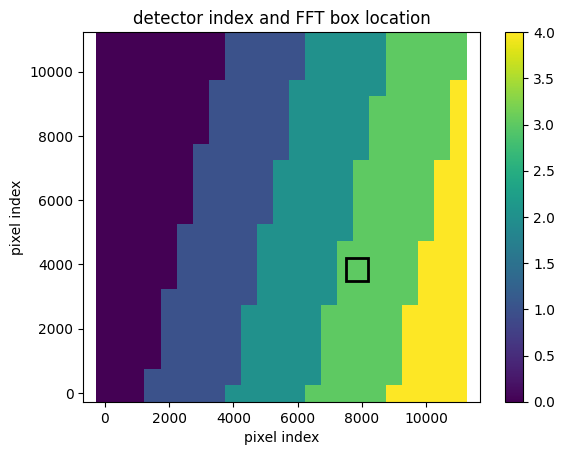

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


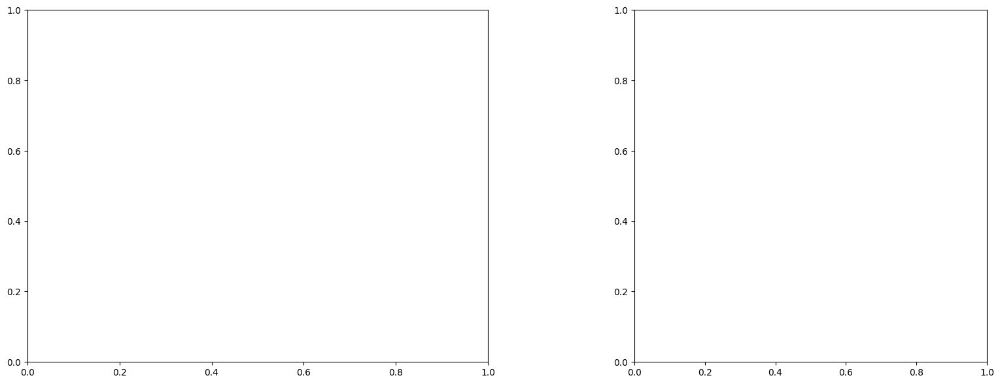

U and V components of current : [-0.36448559 -1.50226129]
uncertainties for U and V: 0.05759296589484889 0.049374178725276066


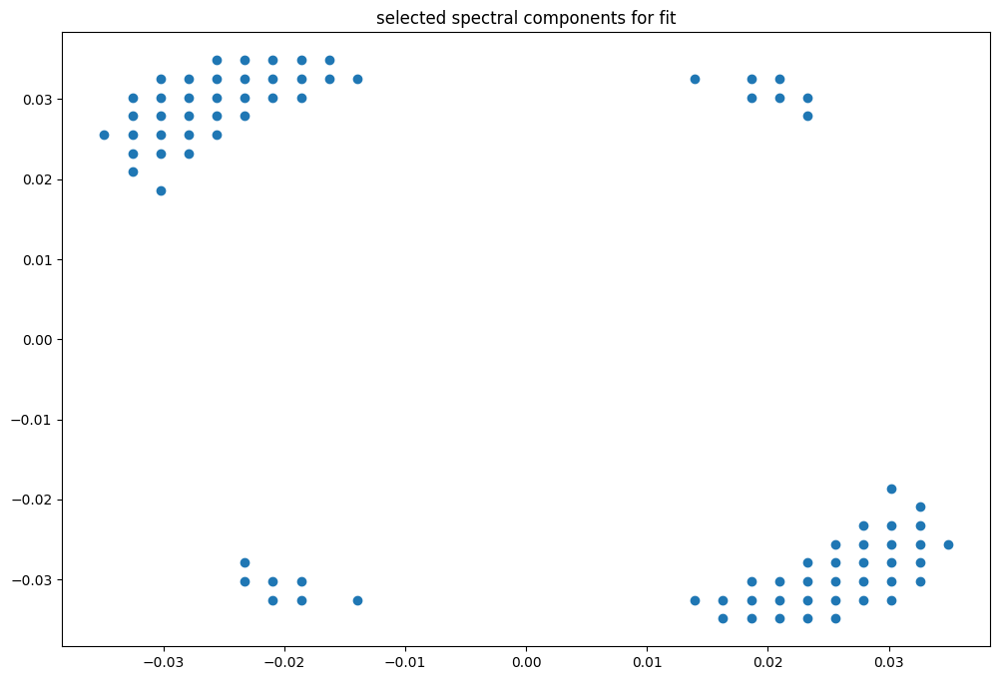

box [7500, 8200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

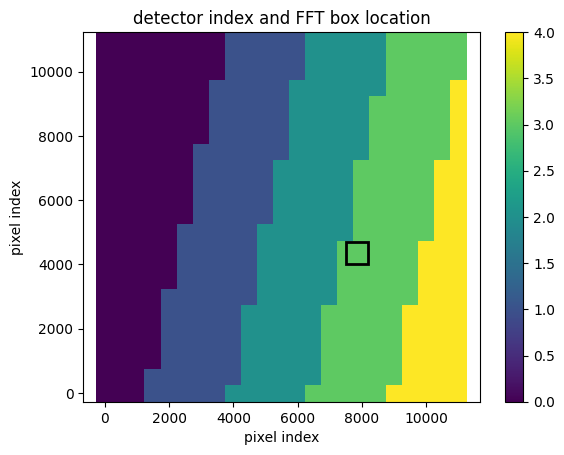

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


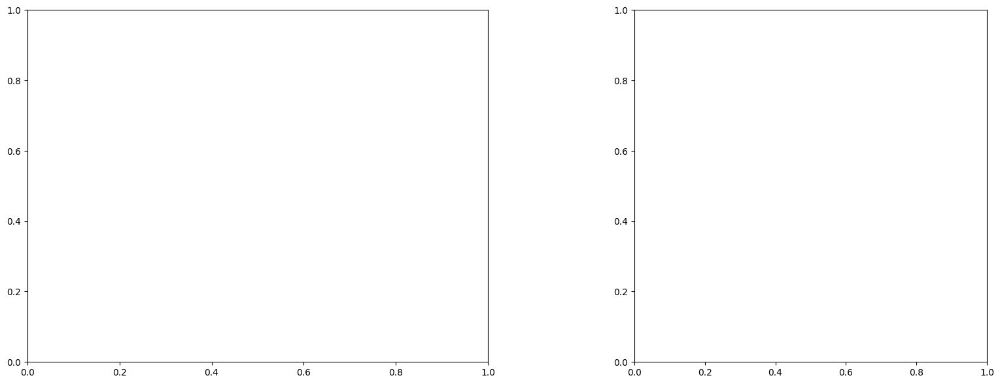

U and V components of current : [ 0.47544726 -0.81597008]
uncertainties for U and V: 0.37033249944051017 0.37288709309899265


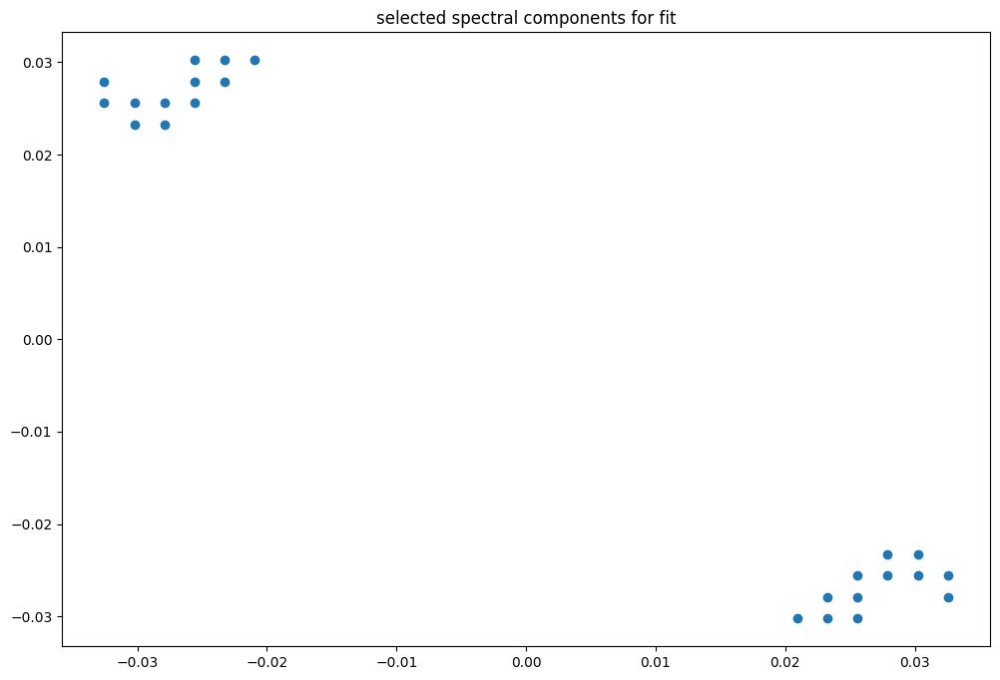

box [7500, 8200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

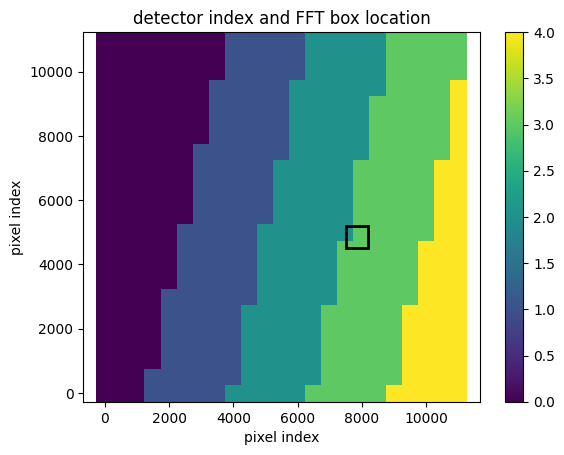

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


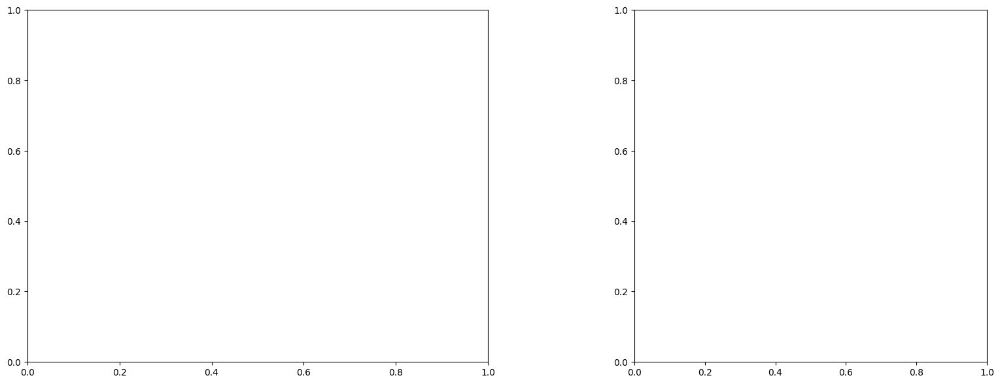

LinAlgError: Singular matrix

box [7500, 8200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

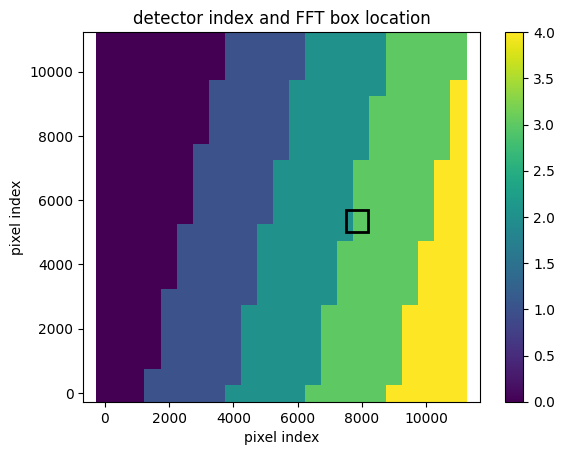

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


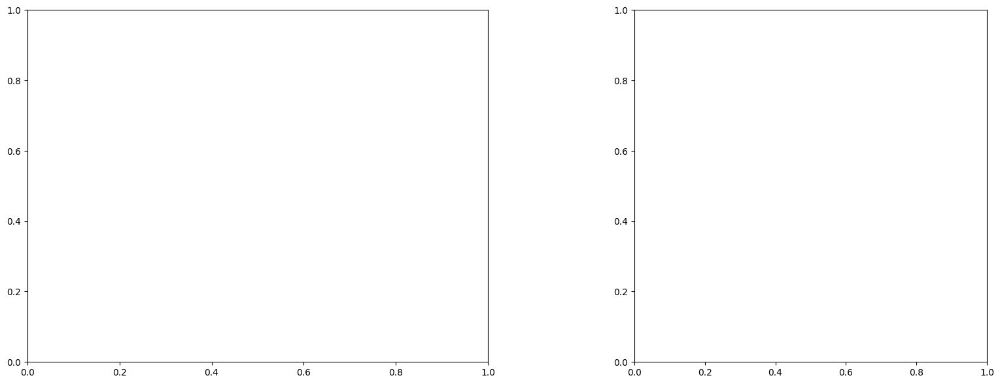

LinAlgError: Singular matrix

box [7500, 8200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

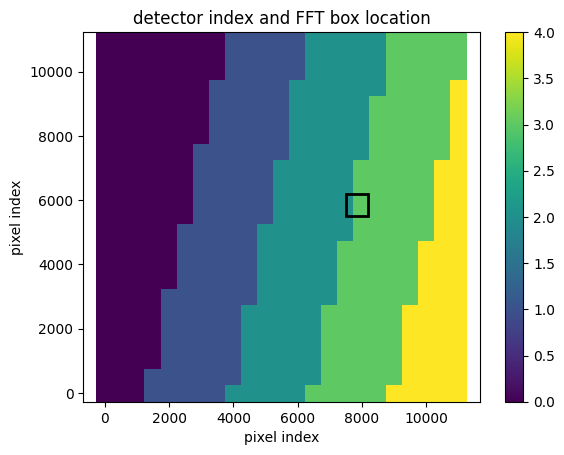

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


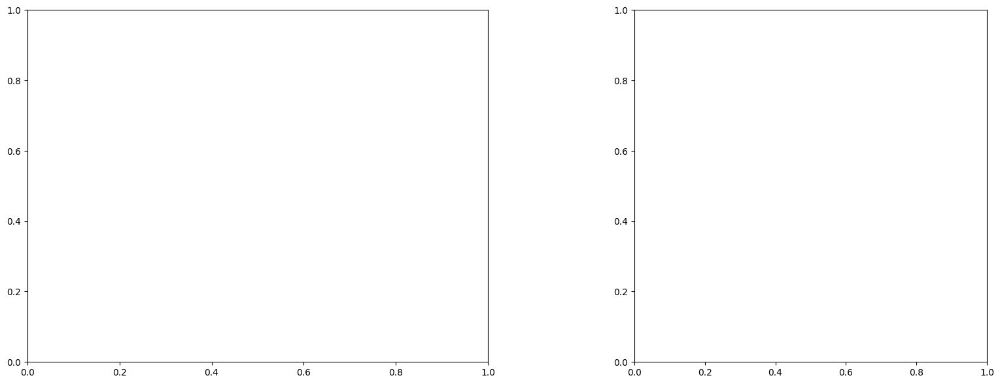

LinAlgError: Singular matrix

box [7500, 8200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

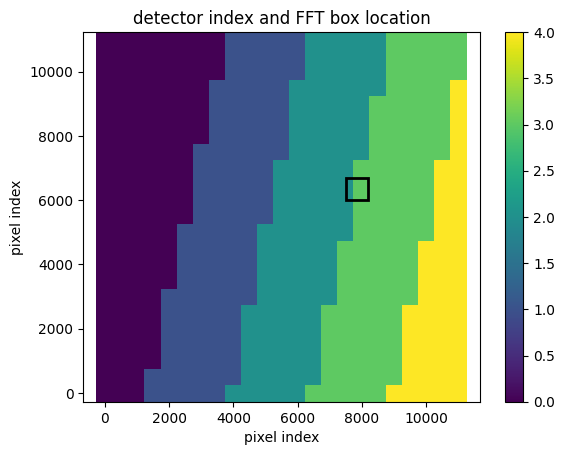

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


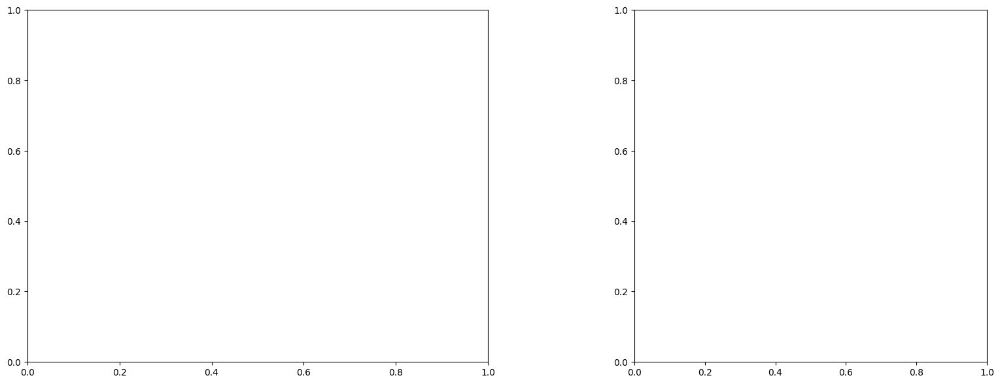

LinAlgError: Singular matrix

box [7500, 8200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

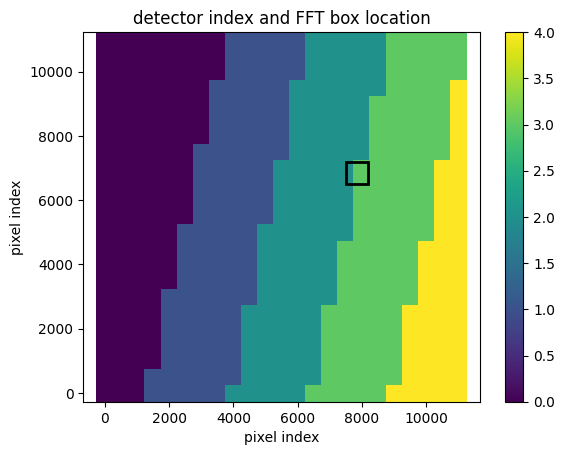

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


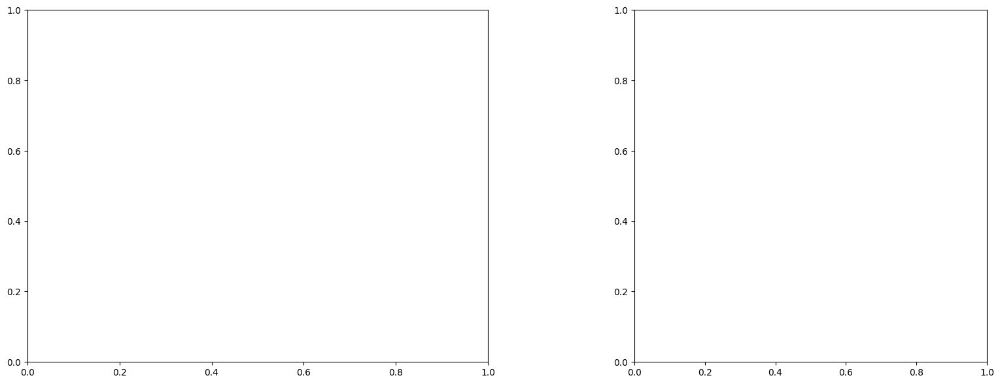

LinAlgError: Singular matrix

box [7500, 8200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

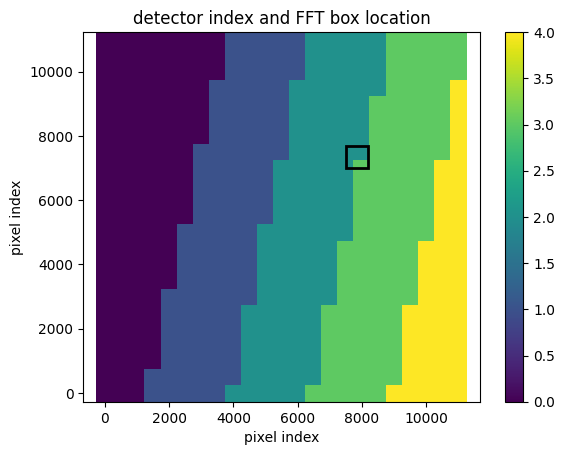

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091203755719549
(43, 43)
(43, 43)
(43, 43)


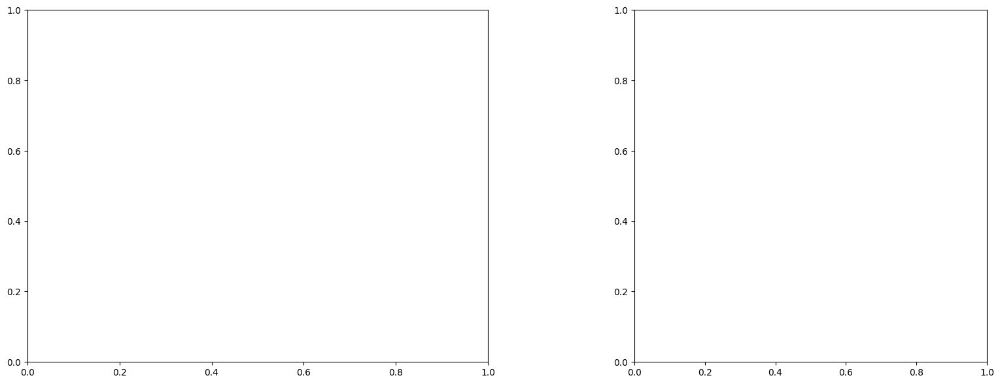

U and V components of current : [ 0.69964667 -1.44799042]
uncertainties for U and V: 0.2175157441680036 0.1980511726560577


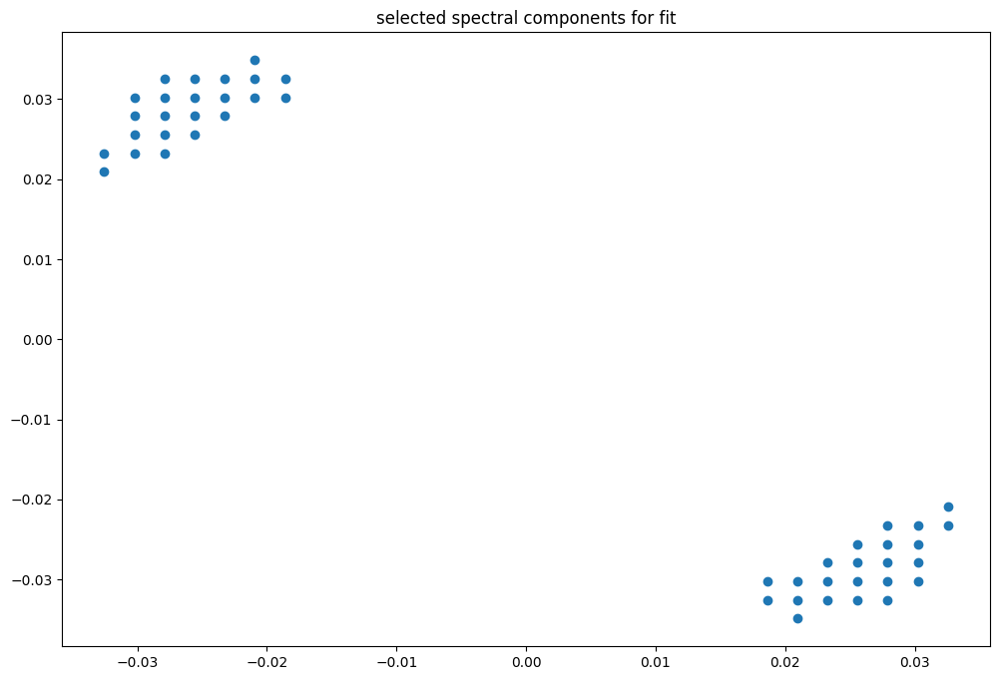

box [7500, 8200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

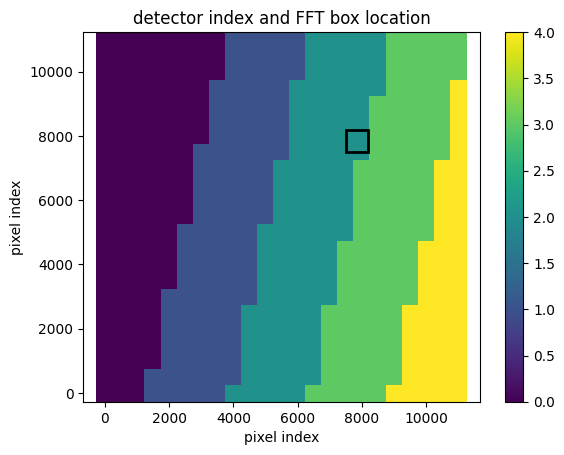

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009118262875518
(43, 43)
(43, 43)
(43, 43)


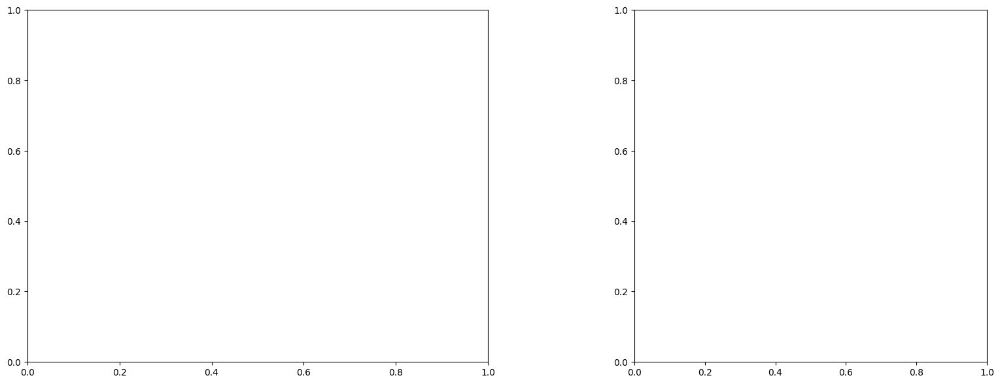

U and V components of current : [-0.55279778 -2.49674071]
uncertainties for U and V: 0.06956942066246014 0.06309287493574879


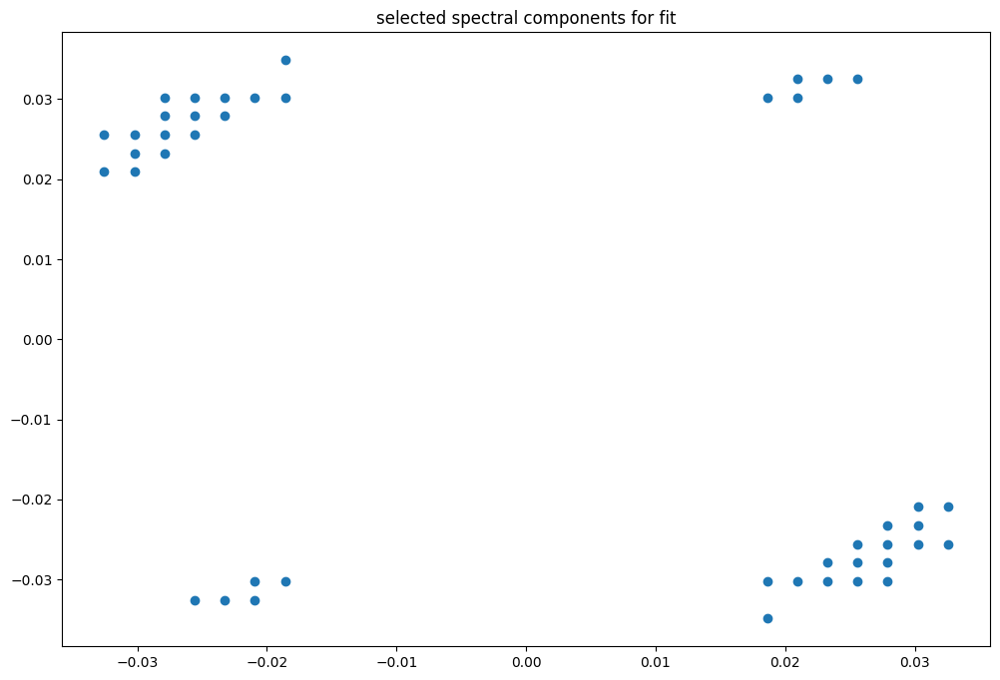

box [7500, 8200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

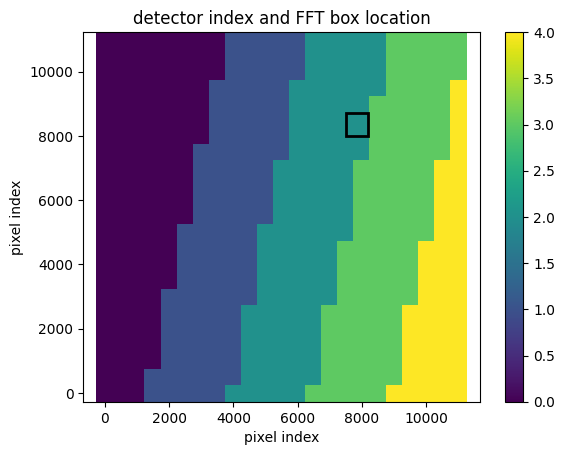

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009116192112911
(43, 43)
(43, 43)
(43, 43)


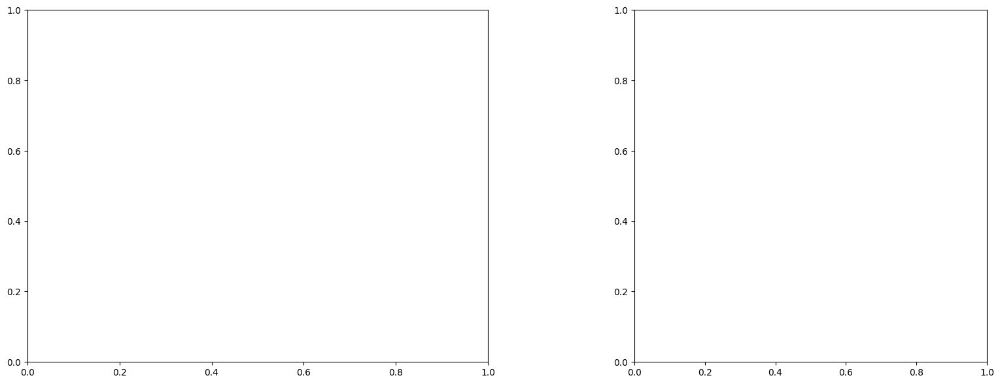

U and V components of current : [ 0.83603146 -1.77905542]
uncertainties for U and V: 0.25584882096083844 0.2524708850517948


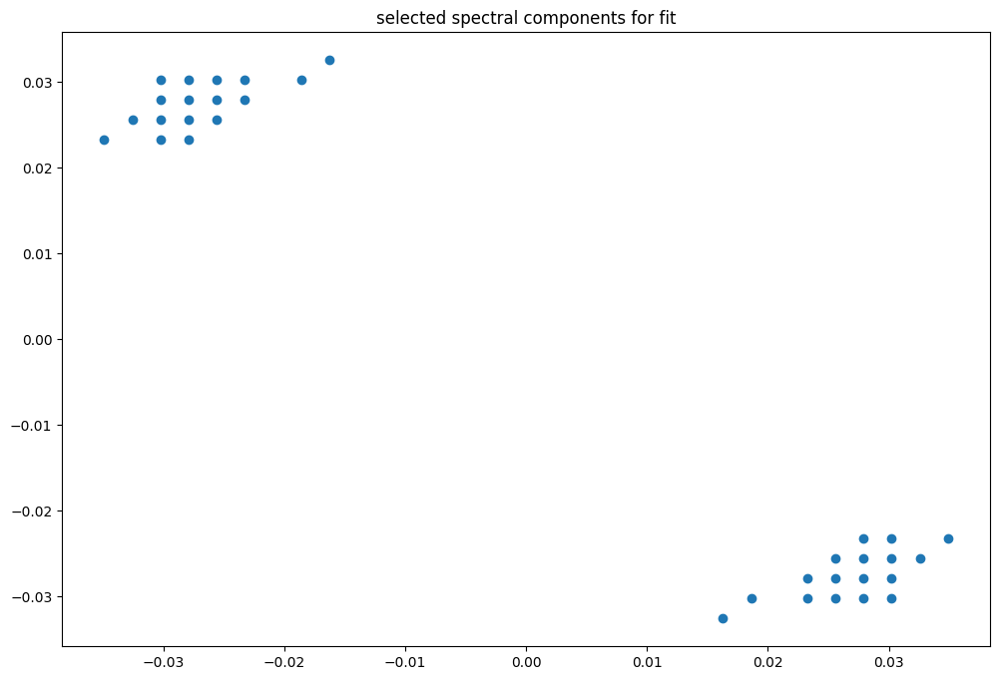

box [7500, 8200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

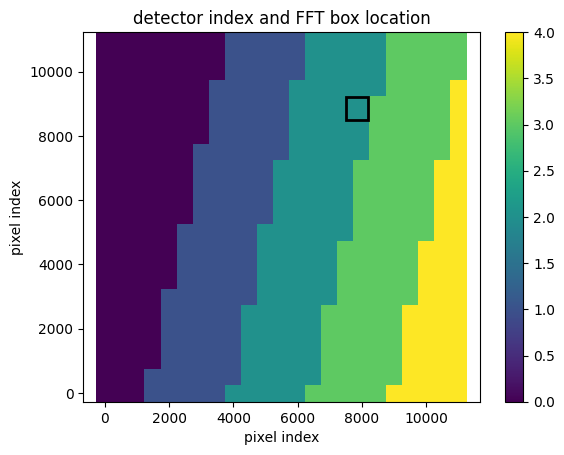

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


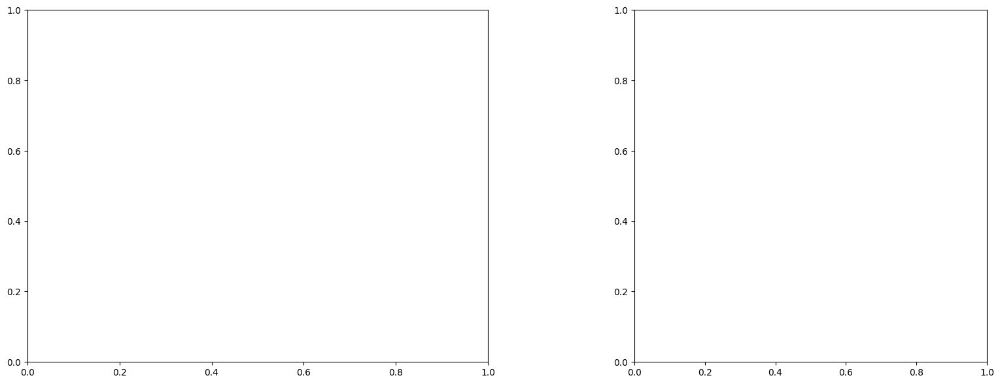

U and V components of current : [-0.2068766  -2.17038986]
uncertainties for U and V: 0.07667098857367032 0.07581831174345142


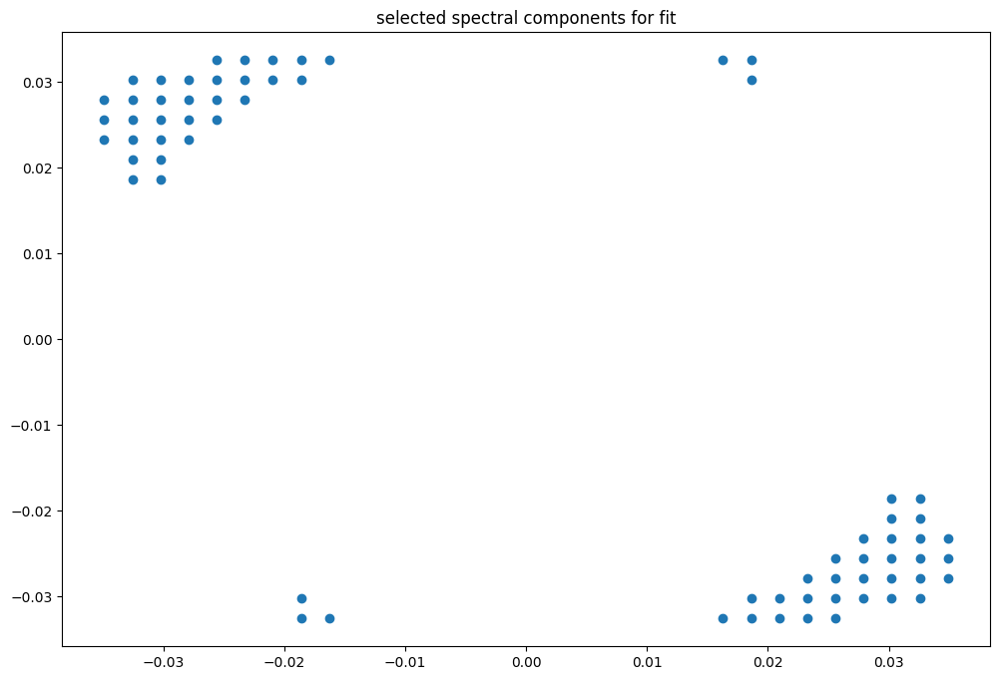

box [7500, 8200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

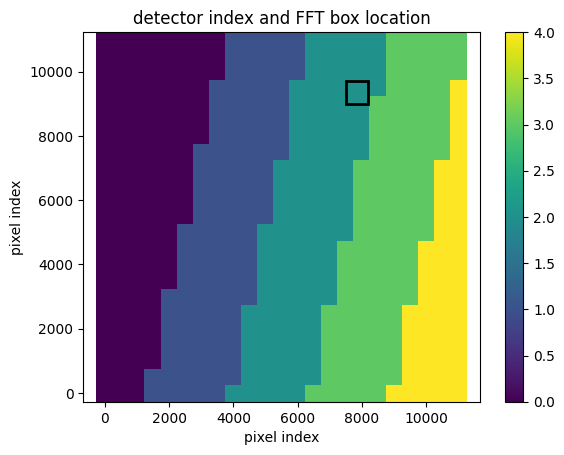

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.009114210111964
(43, 43)
(43, 43)
(43, 43)


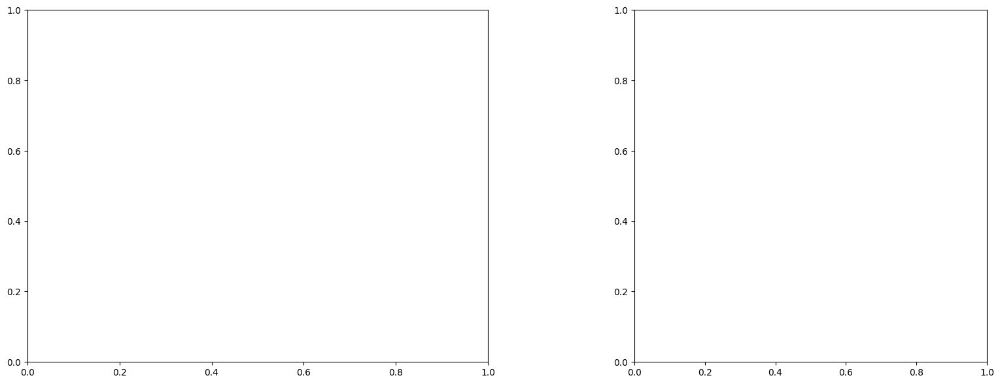

U and V components of current : [ 0.65483965 -0.63034589]
uncertainties for U and V: 0.19233410910353435 0.19113075885853506


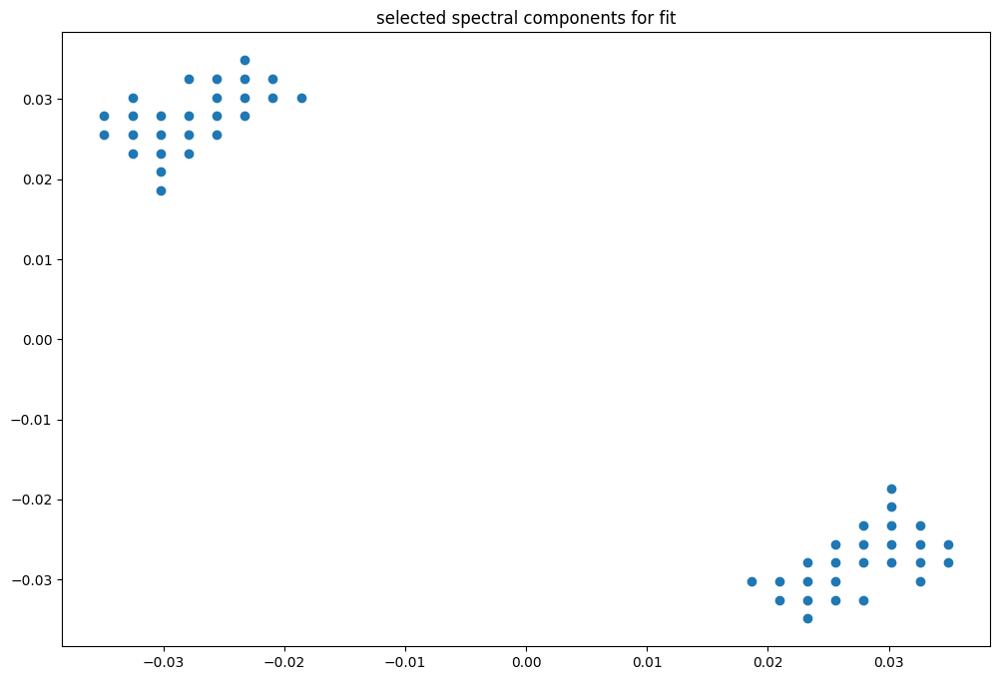

box [7500, 8200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

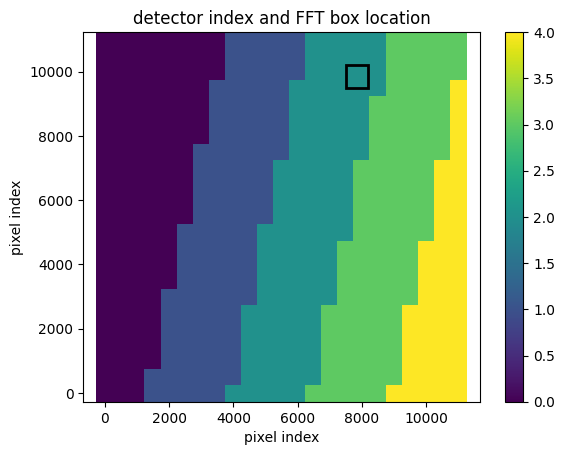

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


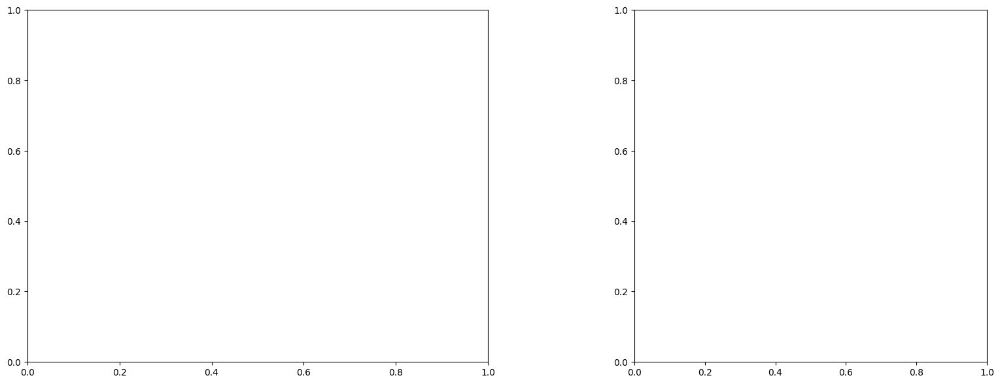

U and V components of current : [-0.52030223 -2.02033741]
uncertainties for U and V: 0.11975394727999562 0.12223938748878868


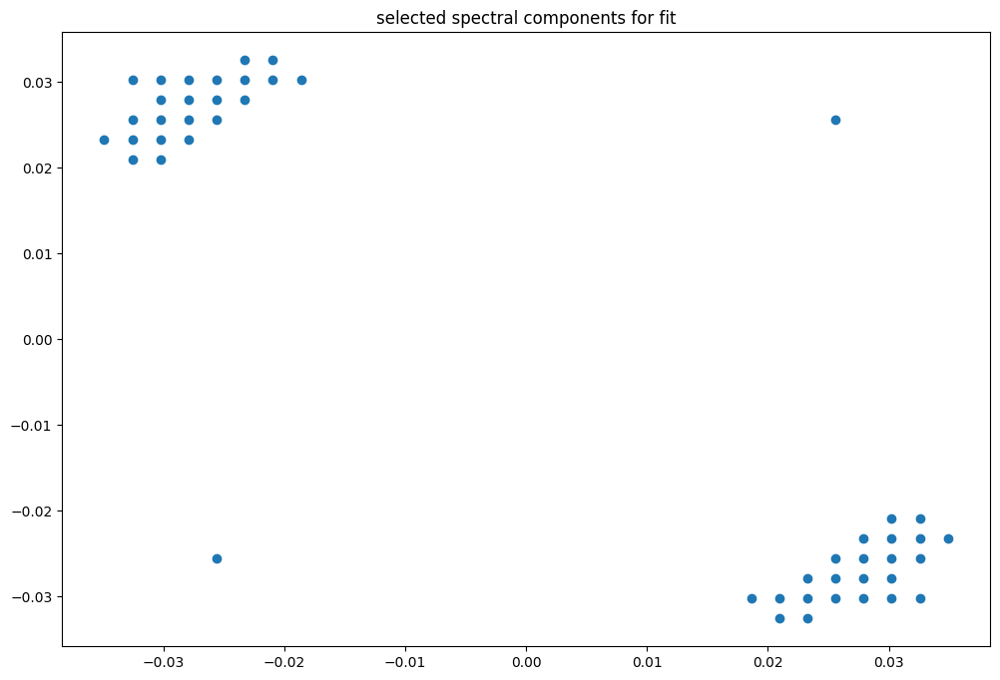

box [7500, 8200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

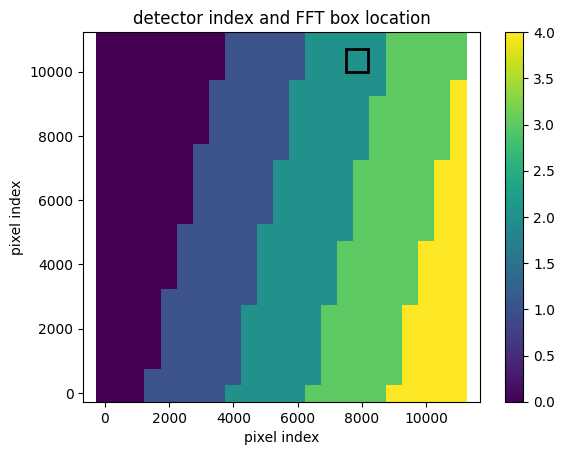

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 43)
(43, 43)
(43, 43)


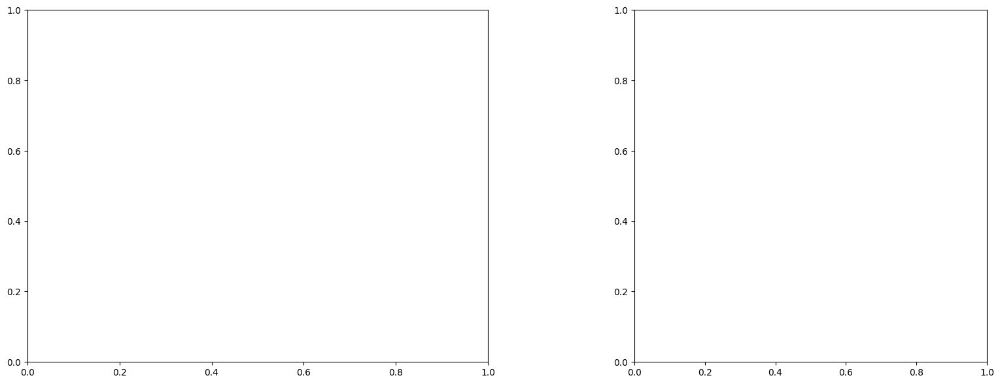

U and V components of current : [-0.43078377 -1.99717945]
uncertainties for U and V: 0.0838005103786504 0.08017108464015354


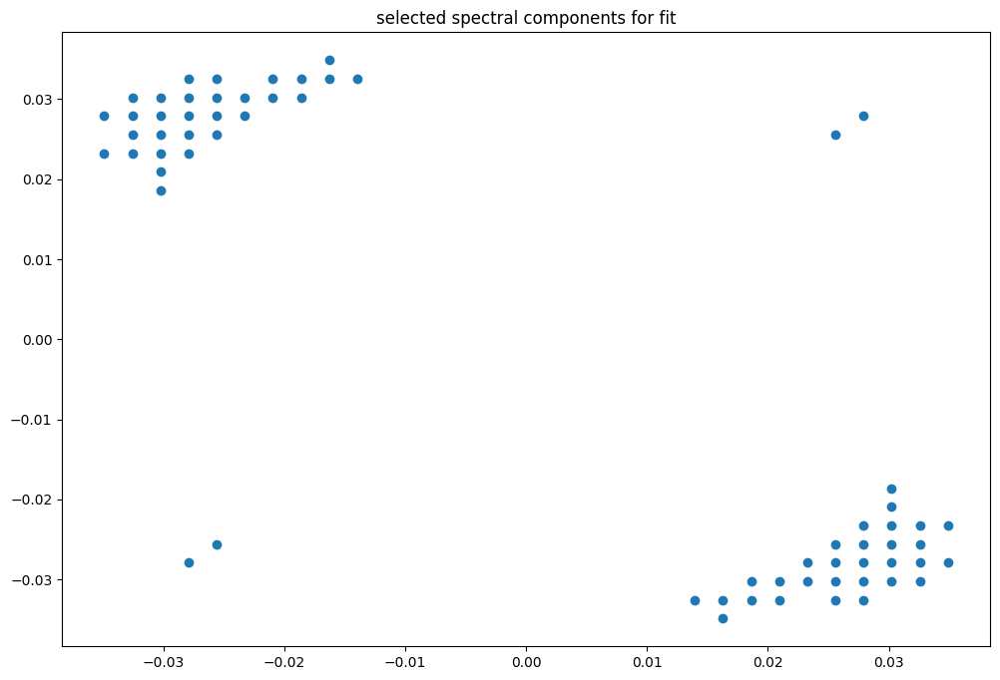

box [7500, 8200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

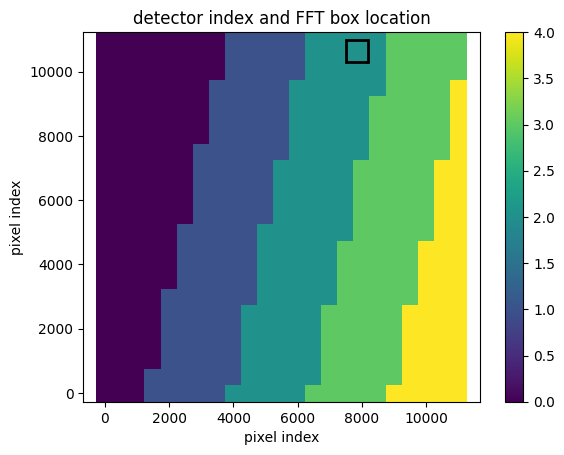

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 42)
(43, 42)
(43, 42)


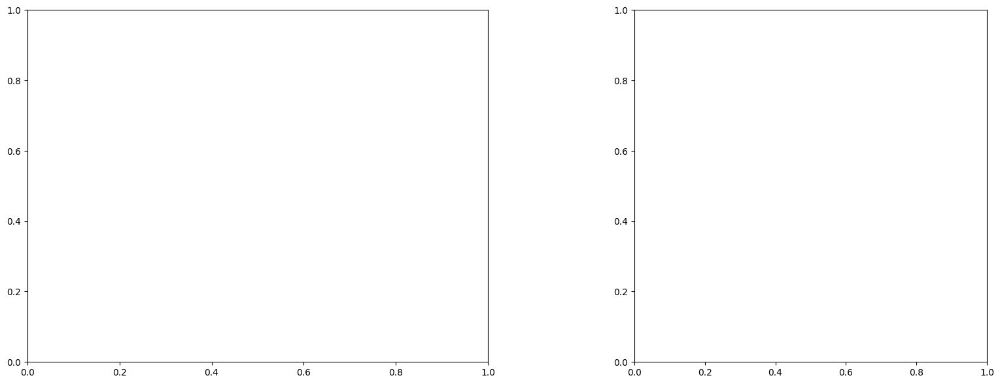

U and V components of current : [-0.40323848 -1.97044338]
uncertainties for U and V: 0.0887449846736867 0.08788115956393412


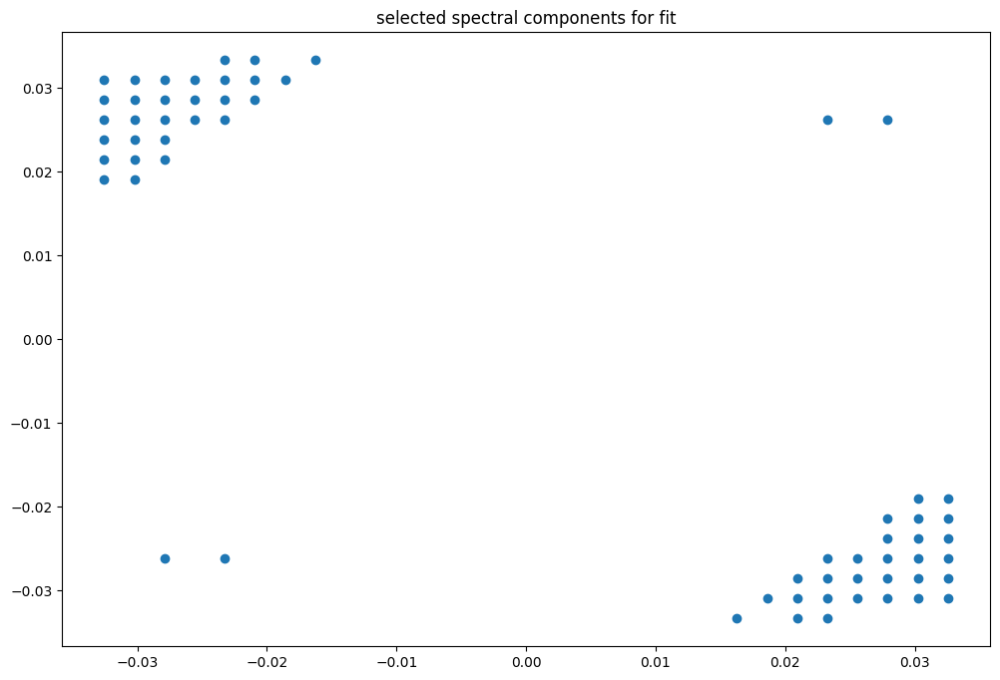

box [8000, 8700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

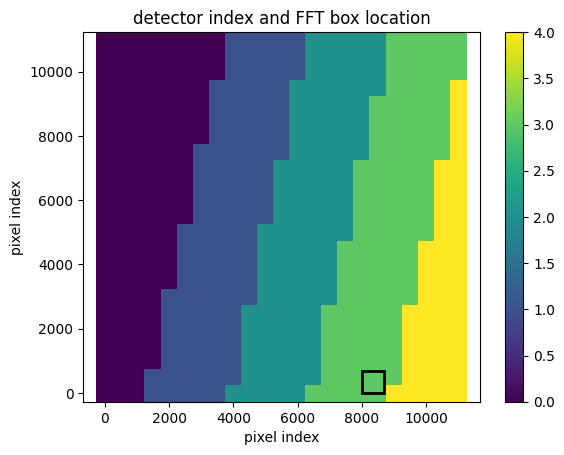

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947571314375389
(43, 43)
(43, 43)
(43, 43)


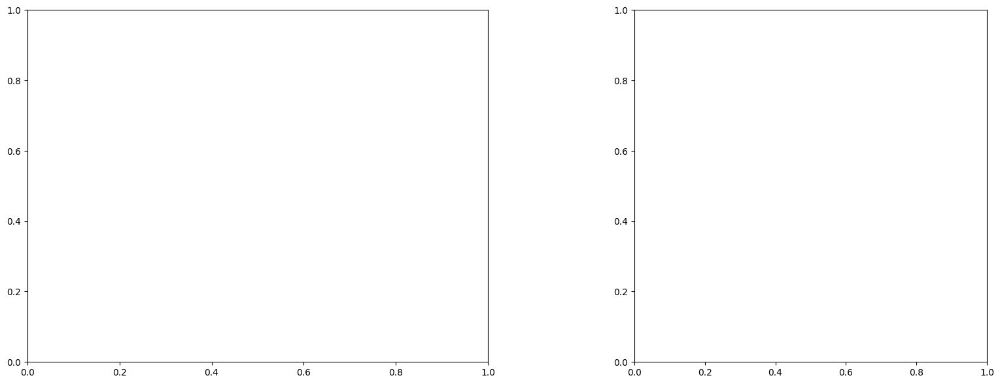

U and V components of current : [ 0.66897068 -0.49023194]
uncertainties for U and V: 0.05699138376356483 0.04097716476709336


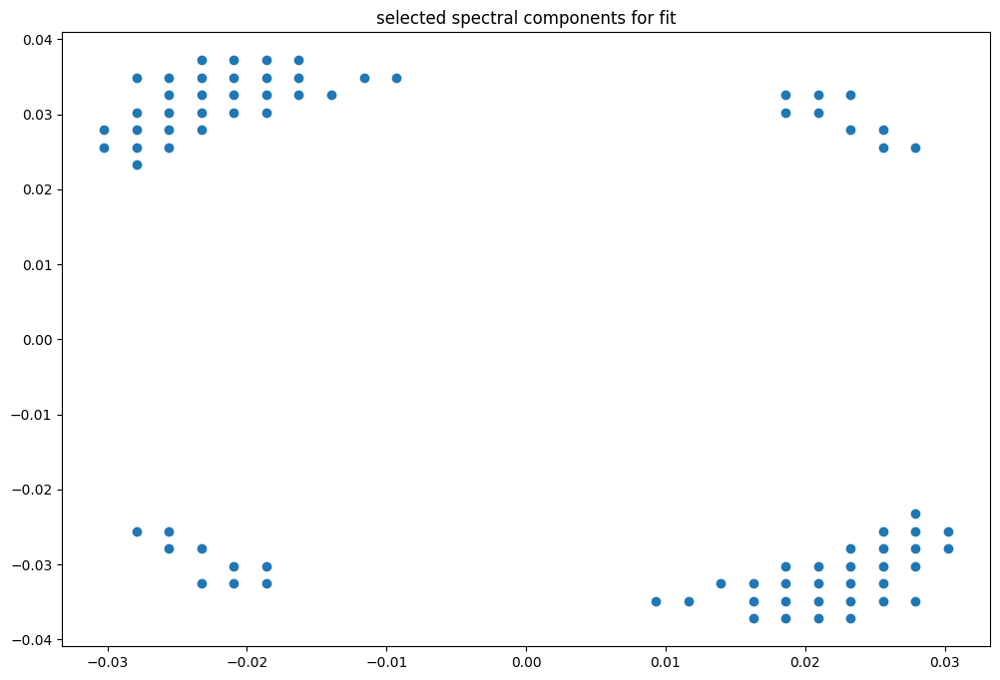

box [8000, 8700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

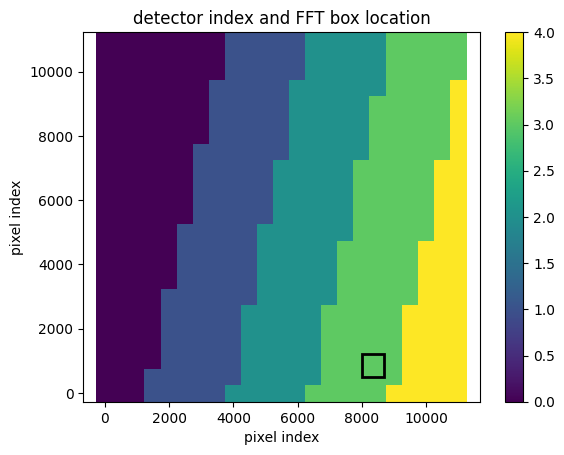

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


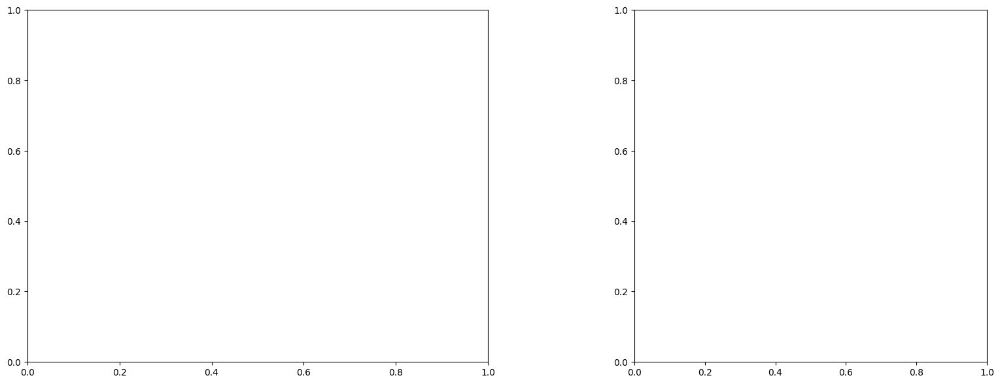

U and V components of current : [ 1.12351011 -0.63021714]
uncertainties for U and V: 0.083374947782754 0.0638610684710686


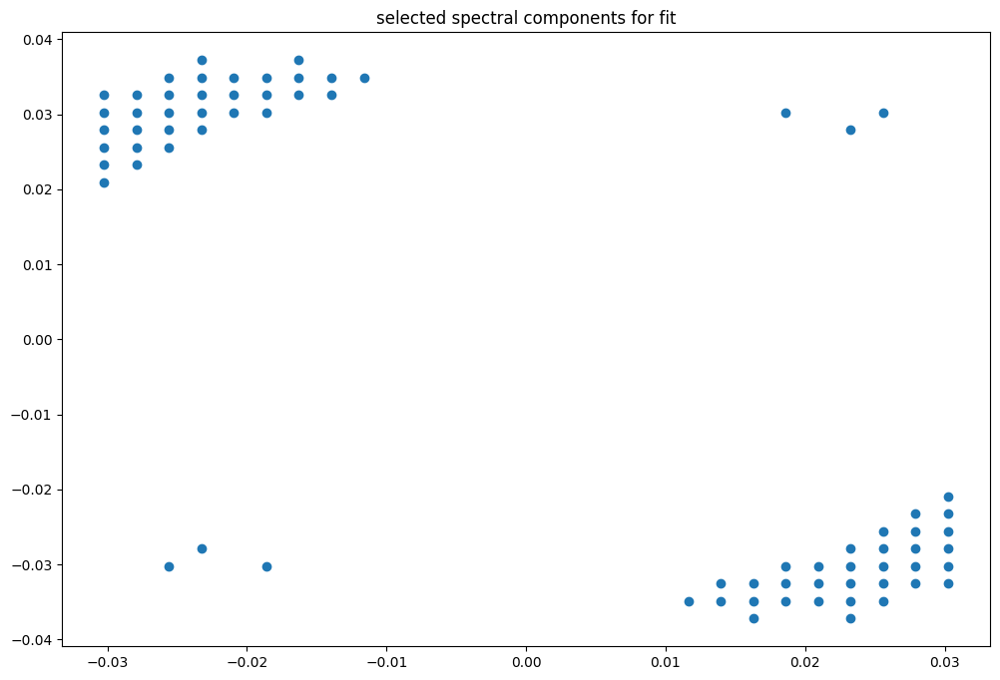

box [8000, 8700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

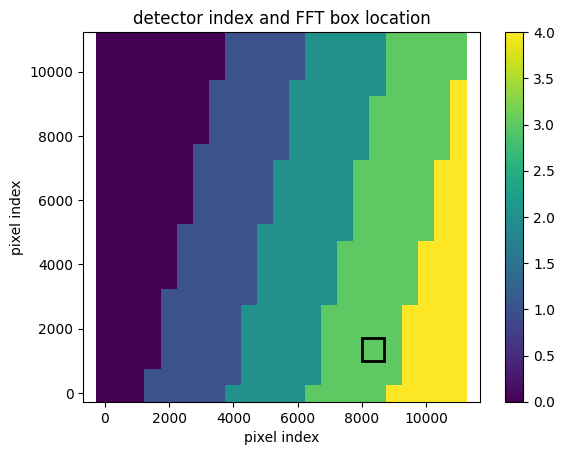

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


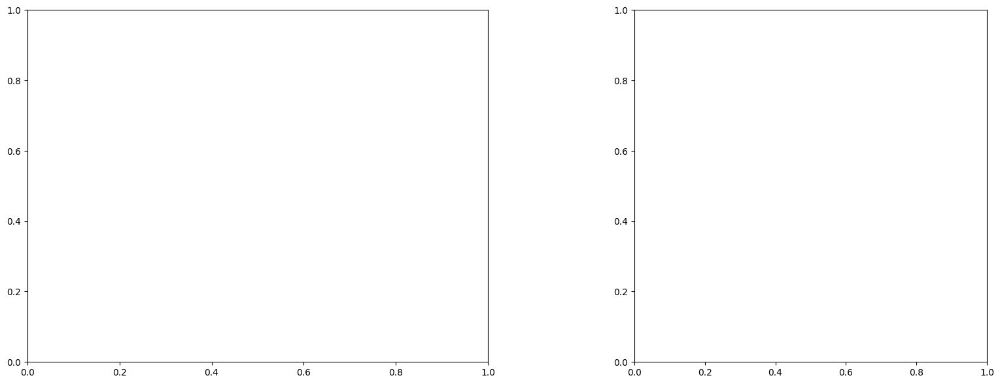

U and V components of current : [ 1.77434689 -0.03937227]
uncertainties for U and V: 0.14743999041932568 0.10819947752745422


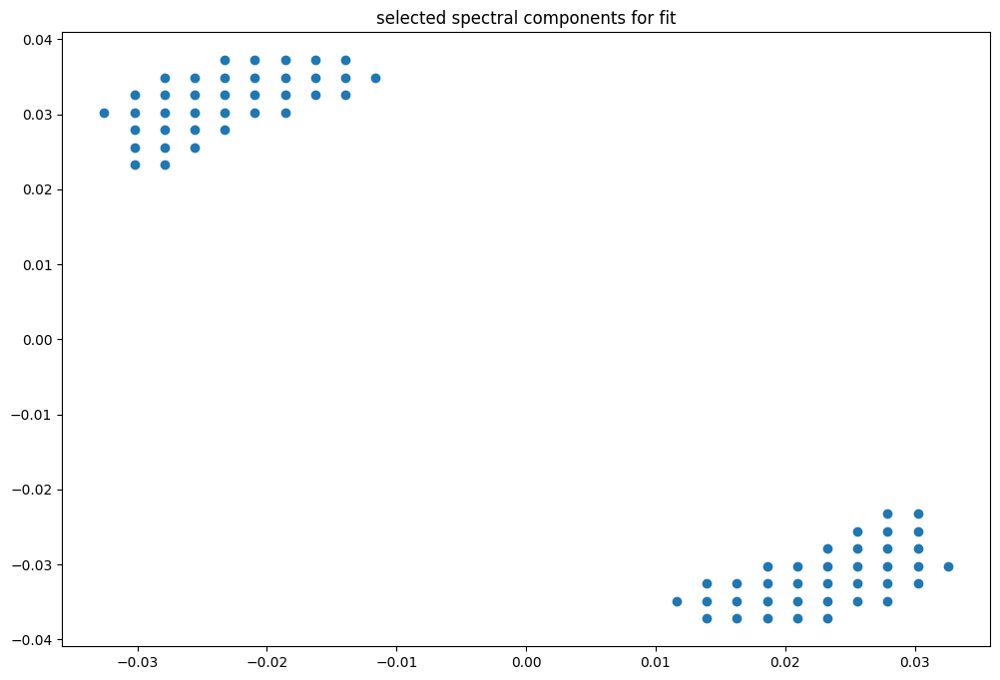

box [8000, 8700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

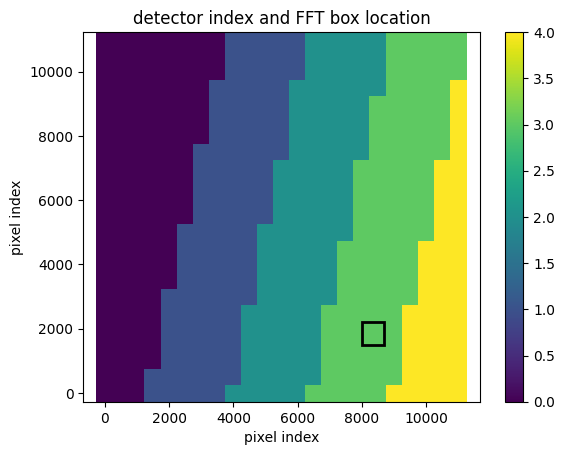

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


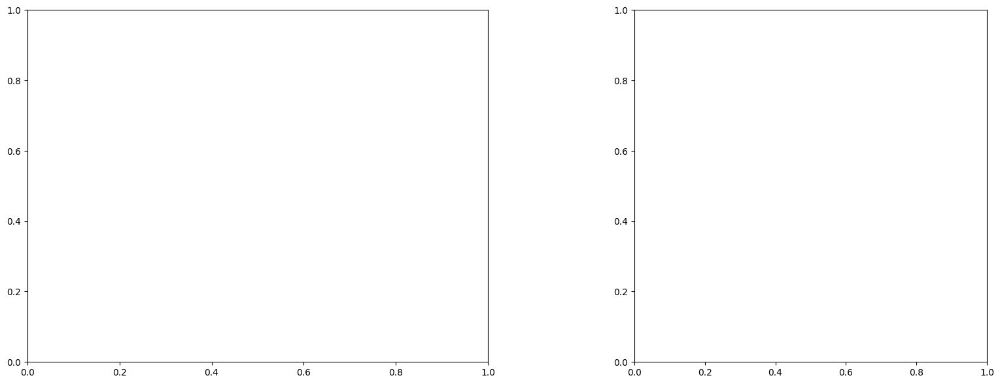

U and V components of current : [1.77720021 0.15694462]
uncertainties for U and V: 0.11966092278802372 0.10403312543586433


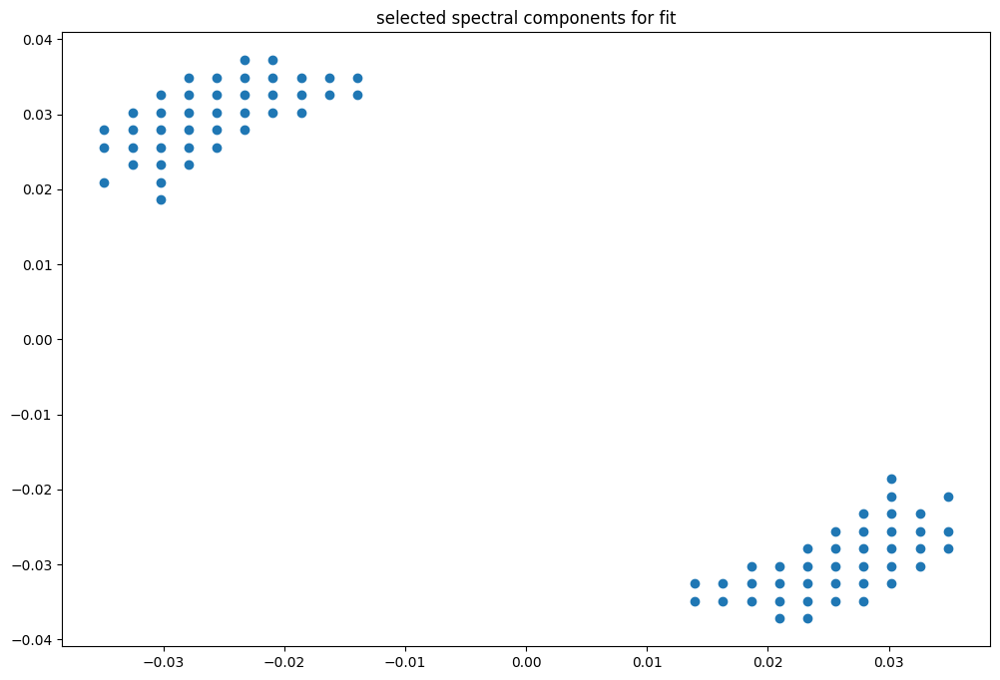

box [8000, 8700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

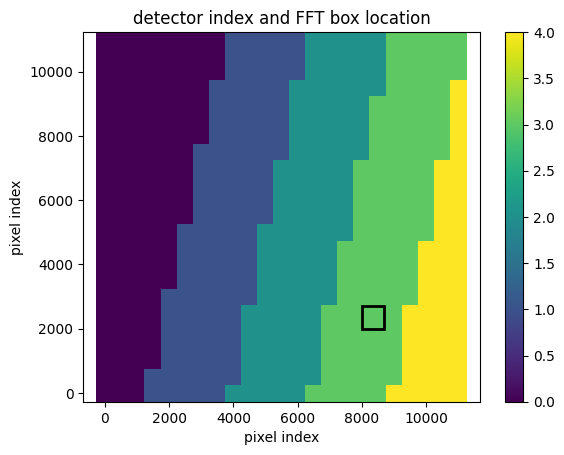

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


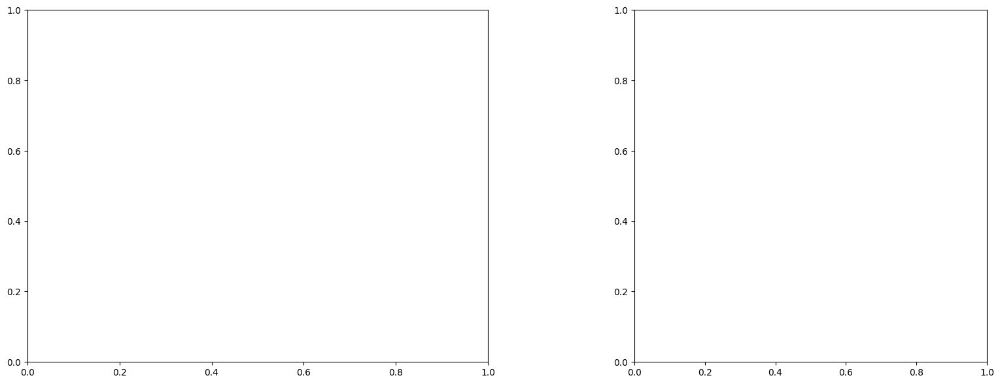

U and V components of current : [ 0.04399334 -1.84828063]
uncertainties for U and V: 0.09276455858595317 0.07664279284957098


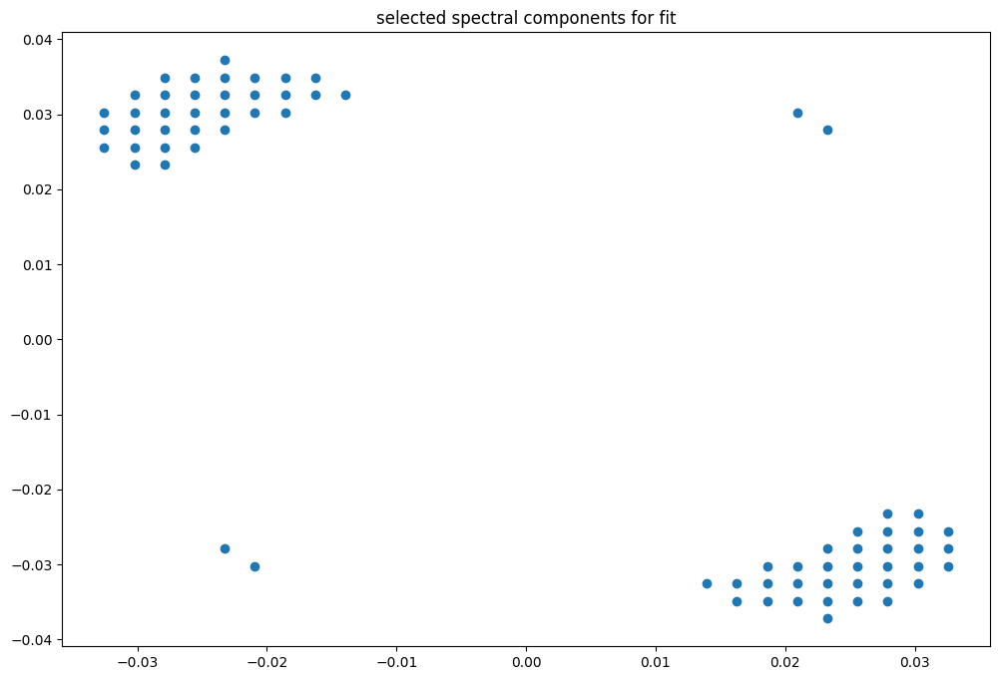

box [8000, 8700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

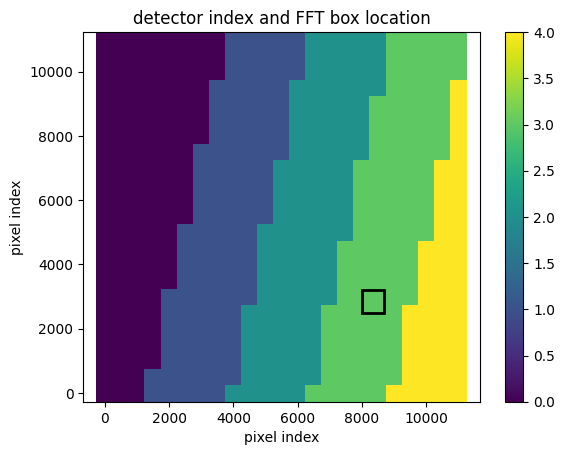

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


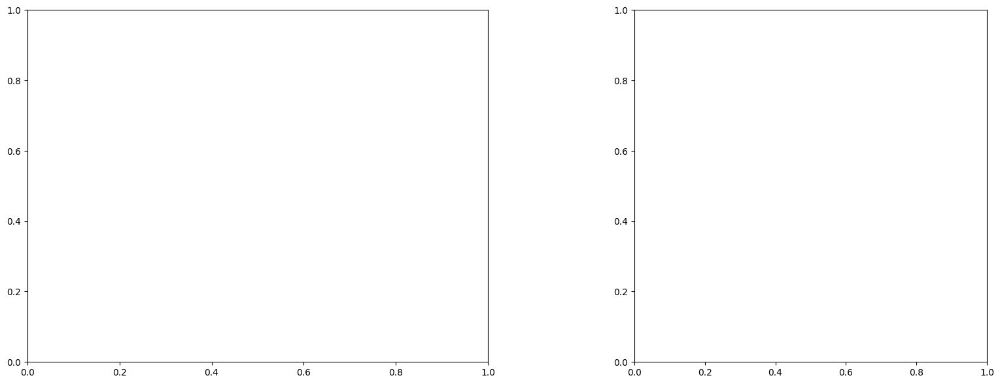

U and V components of current : [-0.16736847 -1.85624763]
uncertainties for U and V: 0.07157202017076719 0.06104350627147326


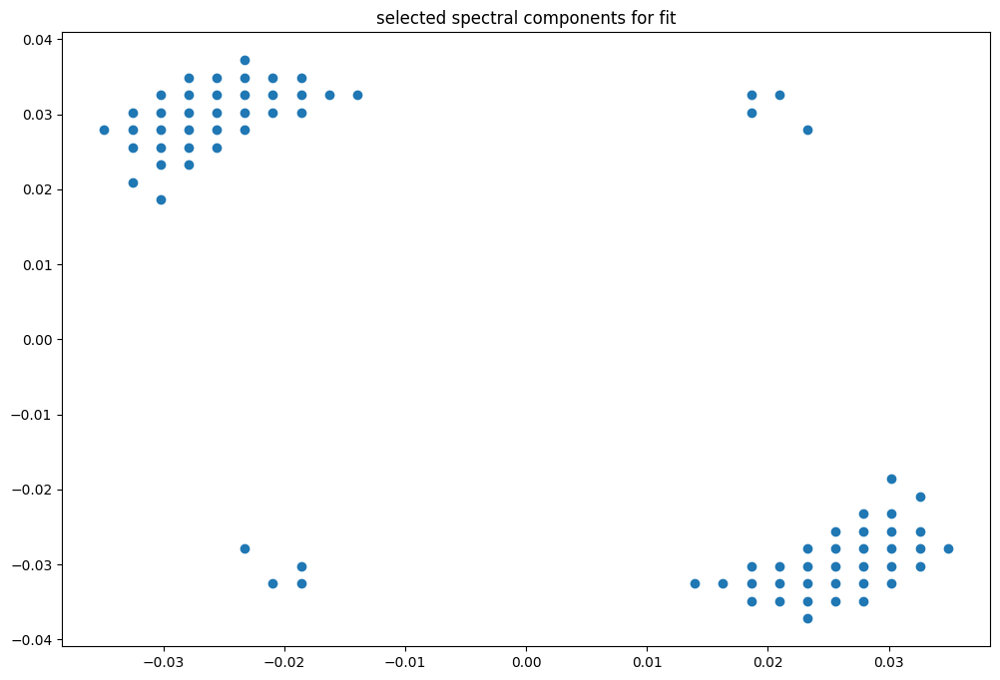

box [8000, 8700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

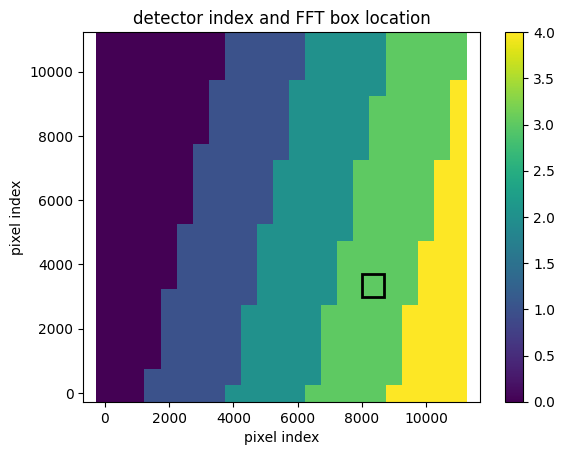

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


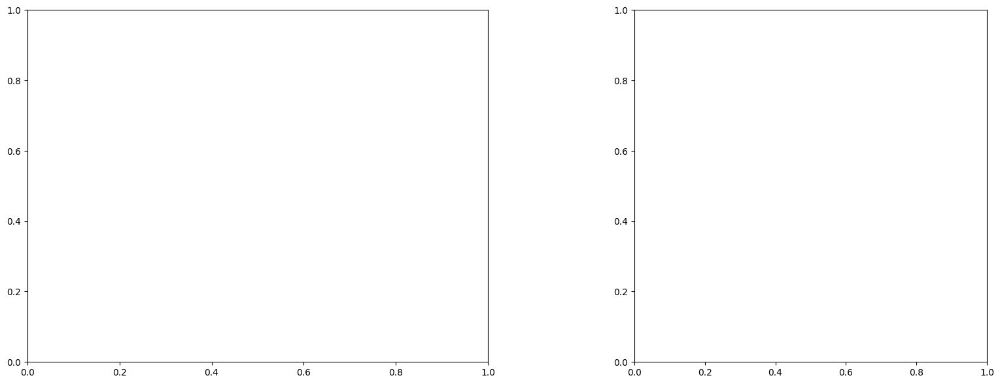

U and V components of current : [ 1.14754666 -0.25931609]
uncertainties for U and V: 0.13528552895638327 0.11895170195521307


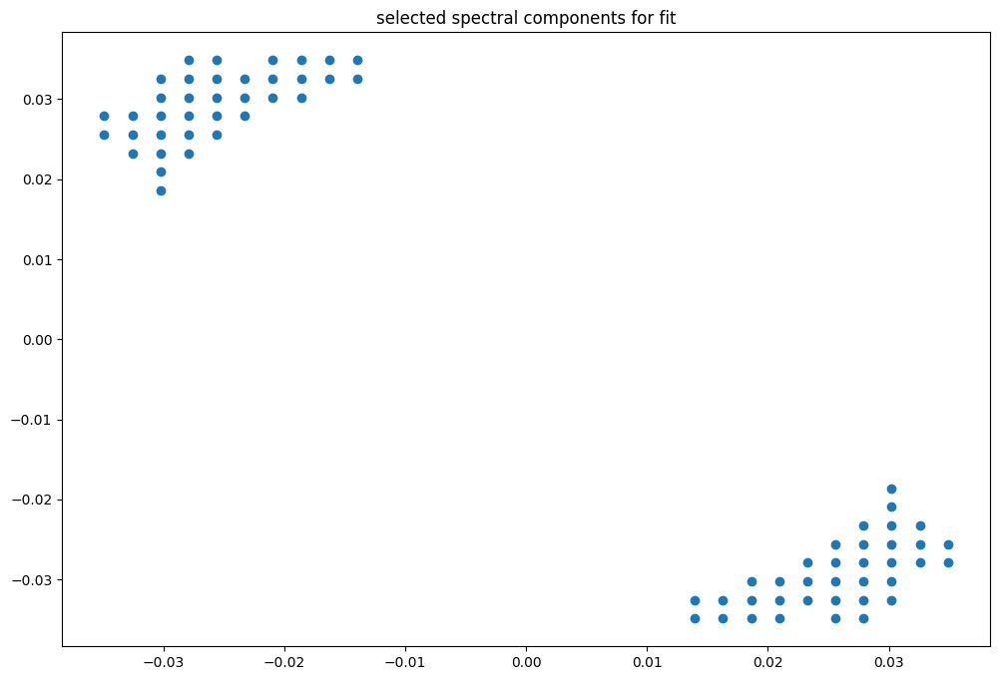

box [8000, 8700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

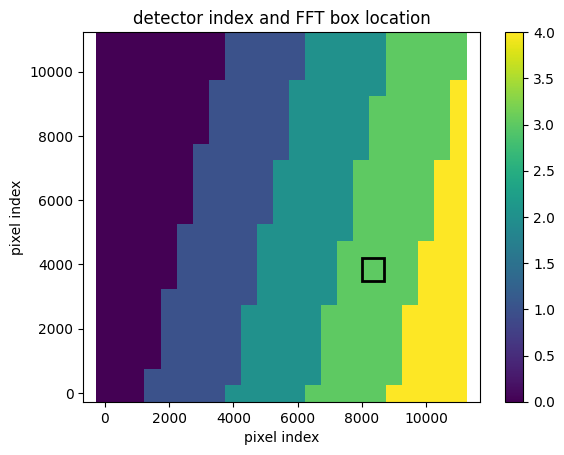

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


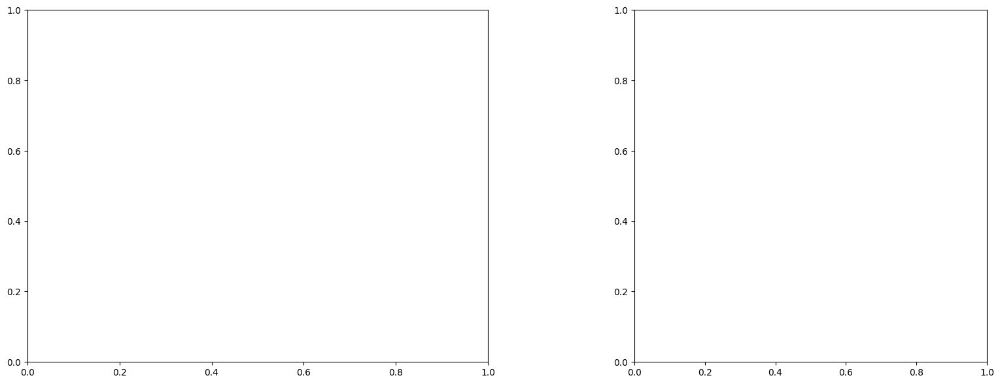

U and V components of current : [-0.3003627  -1.86307037]
uncertainties for U and V: 0.053426857569969274 0.04386370147542578


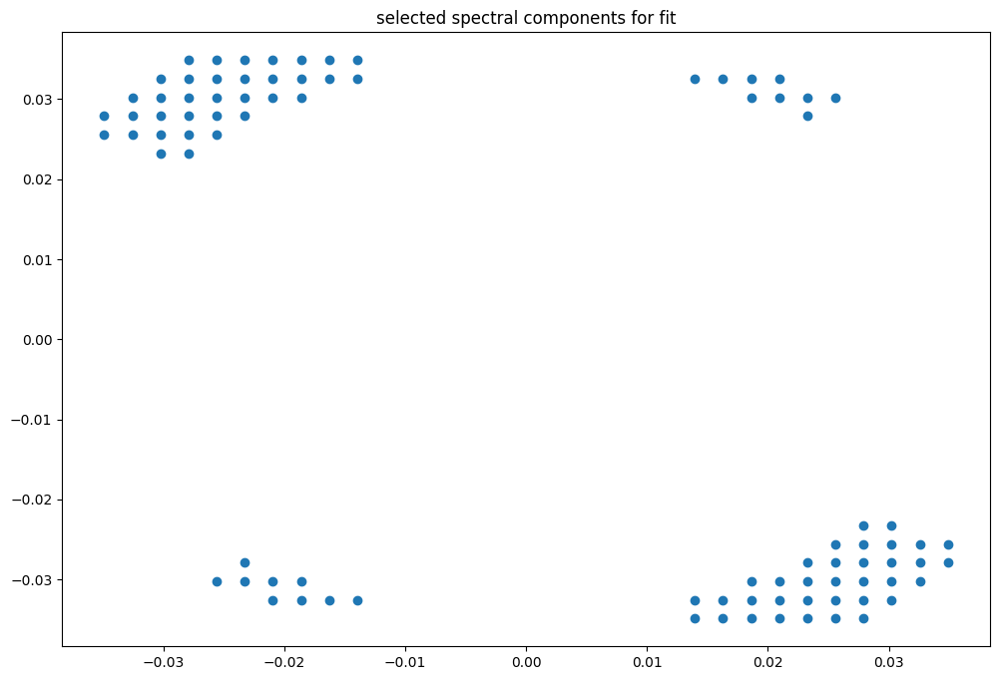

box [8000, 8700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

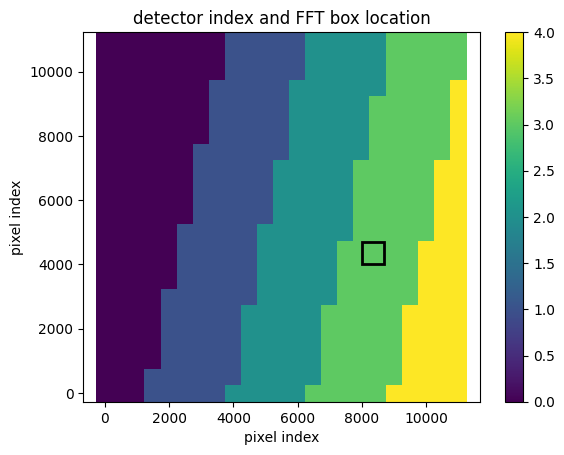

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


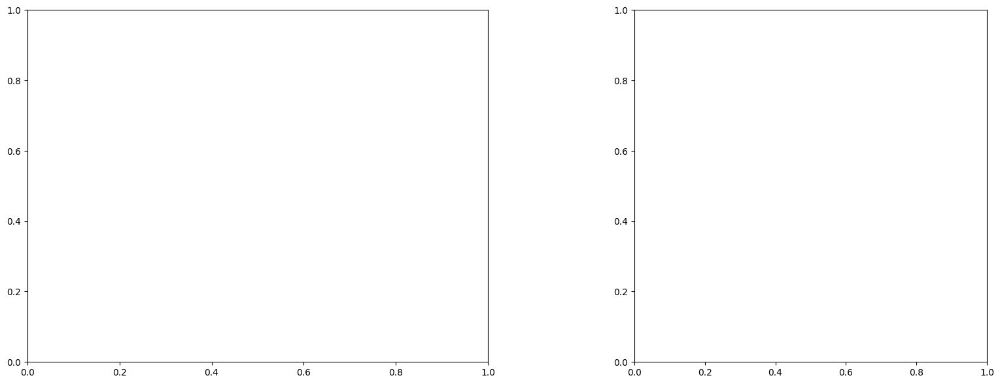

U and V components of current : [-0.44928701 -1.58345765]
uncertainties for U and V: 0.055045806047770686 0.04907851312758765


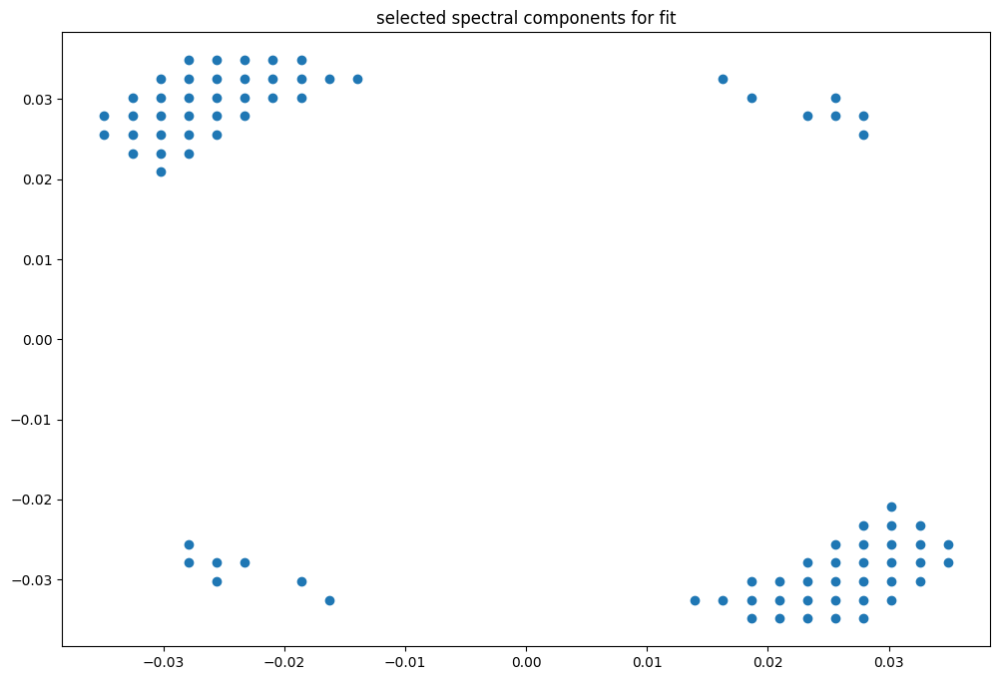

box [8000, 8700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

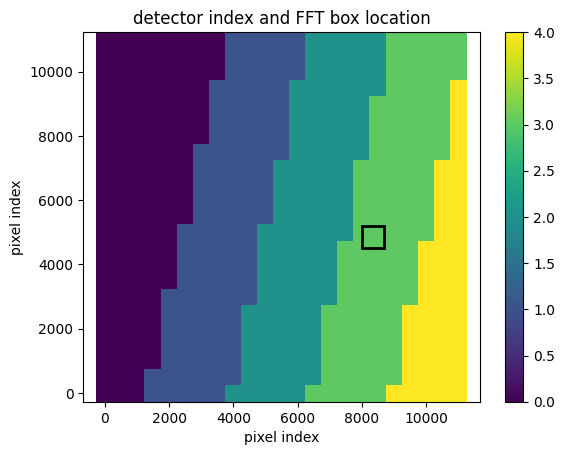

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


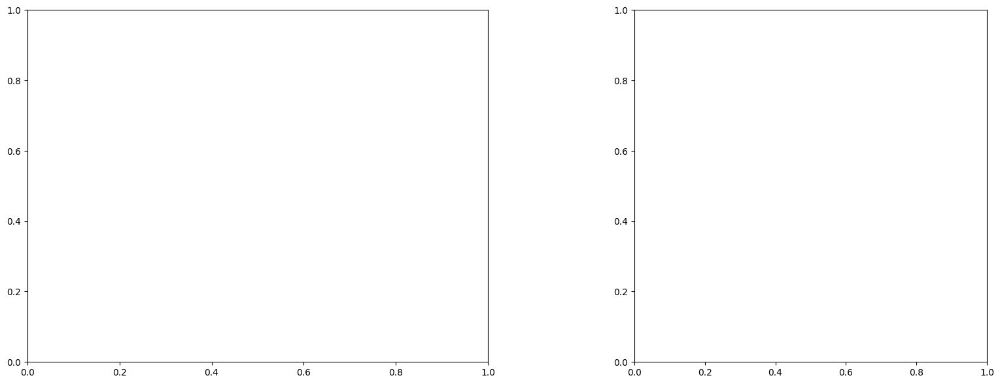

U and V components of current : [-0.22408161 -1.35155764]
uncertainties for U and V: 0.04342621660444137 0.03728998881738611


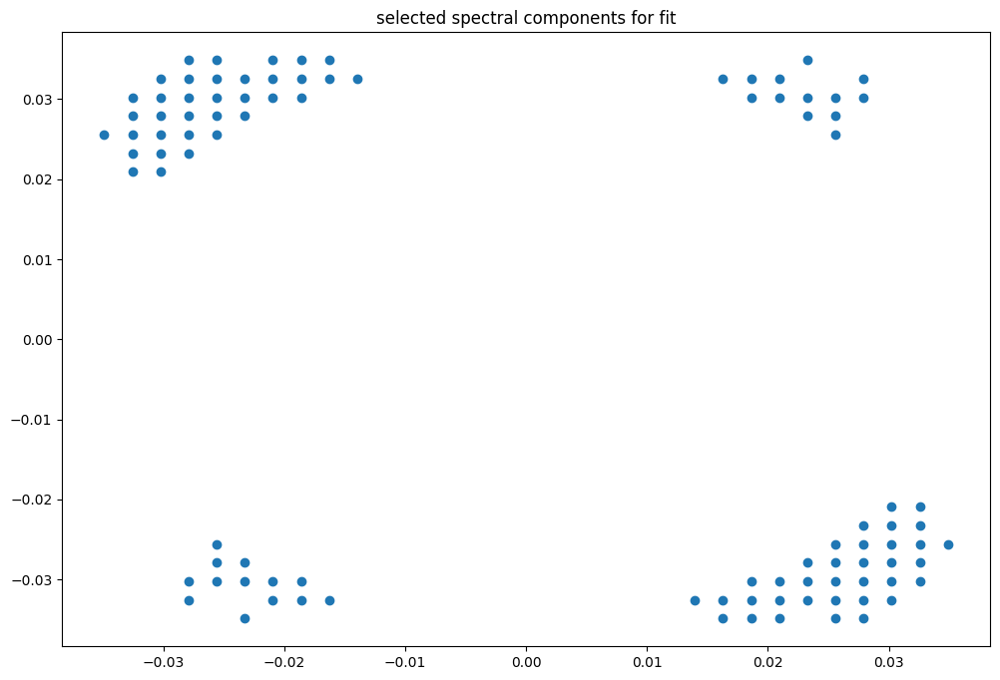

box [8000, 8700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

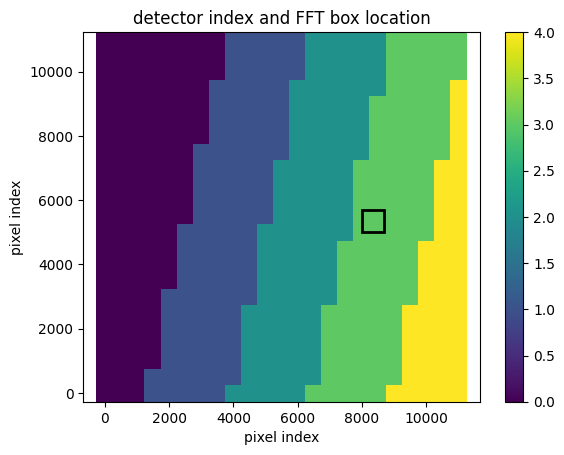

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


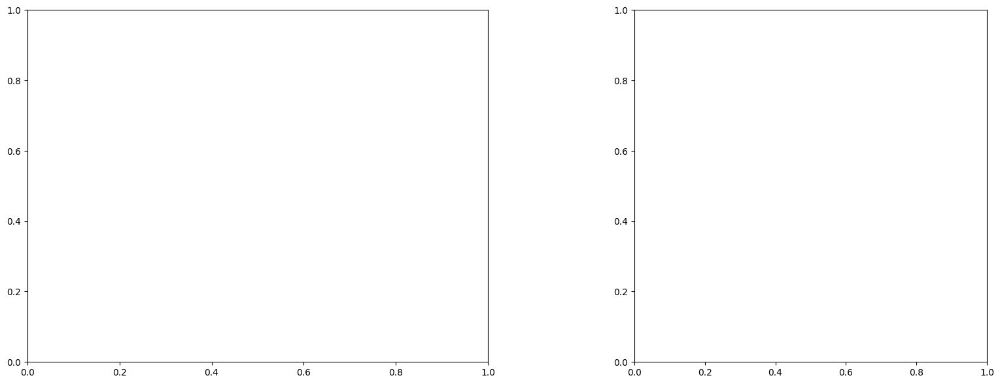

U and V components of current : [-0.16837145 -1.16417447]
uncertainties for U and V: 0.05310240367666639 0.0477508221932568


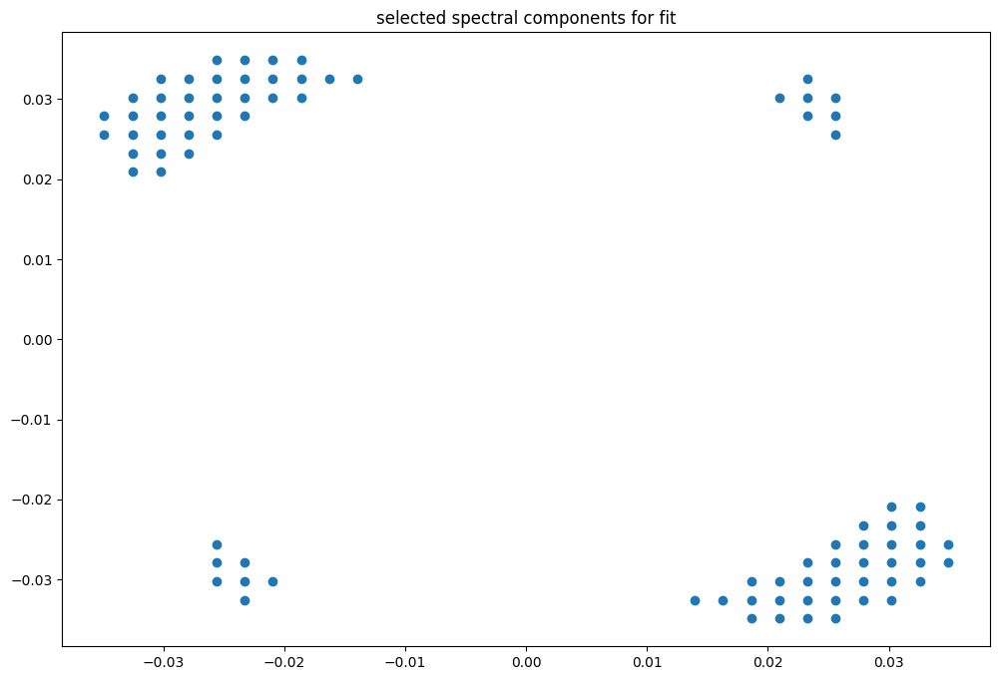

box [8000, 8700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

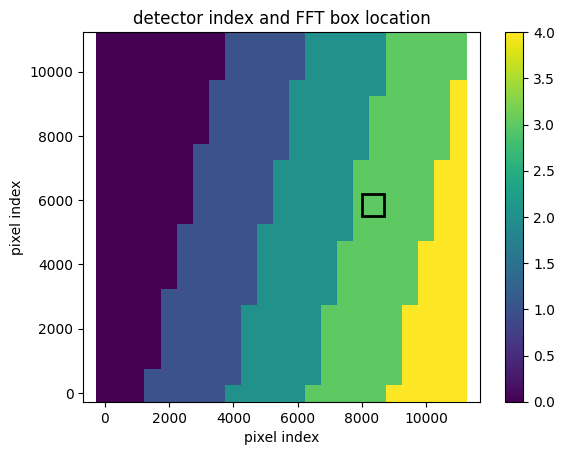

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


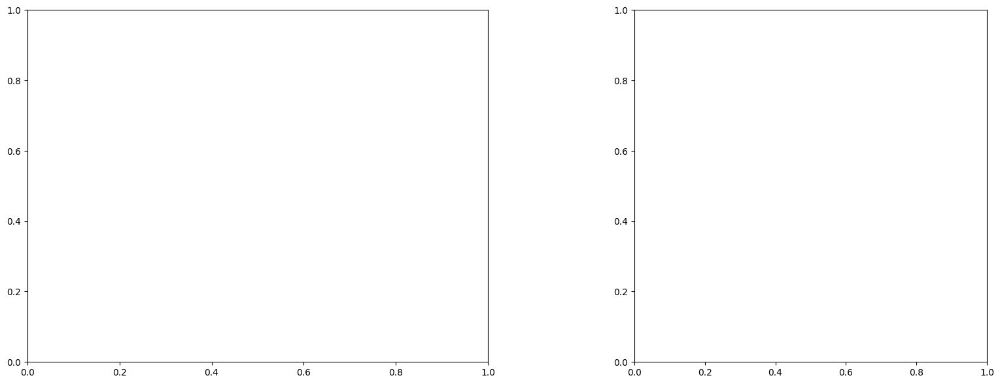

U and V components of current : [-0.05203503 -1.38867929]
uncertainties for U and V: 0.05360781078586339 0.04757774902903671


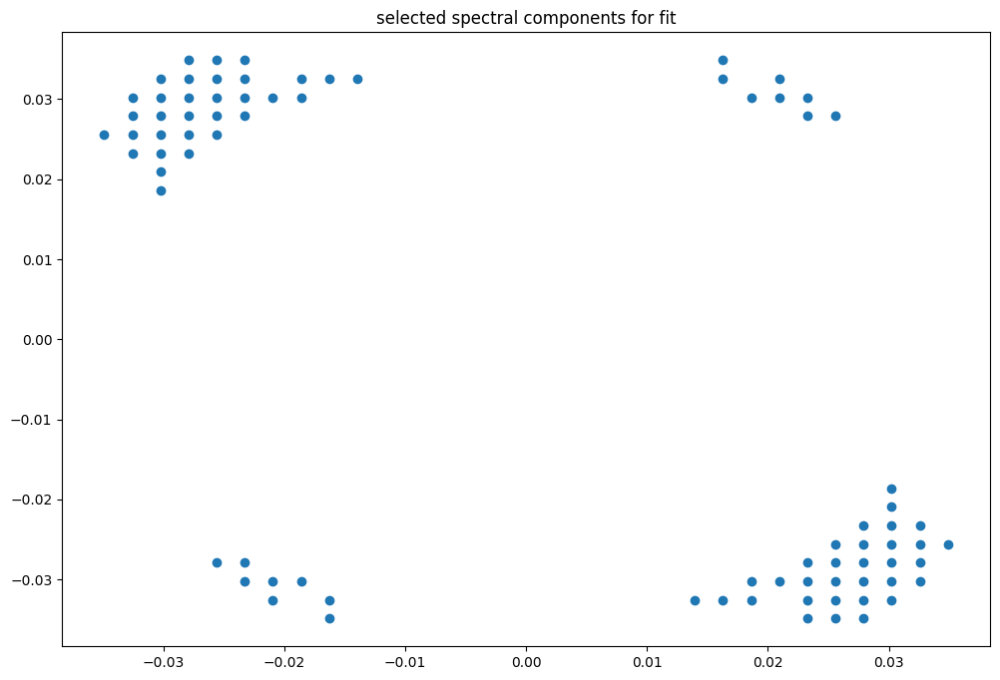

box [8000, 8700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

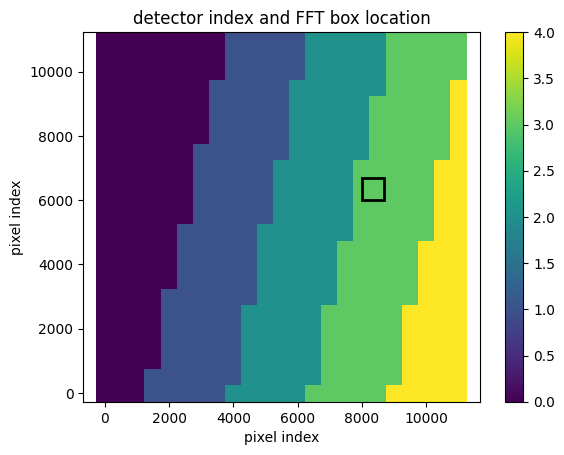

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


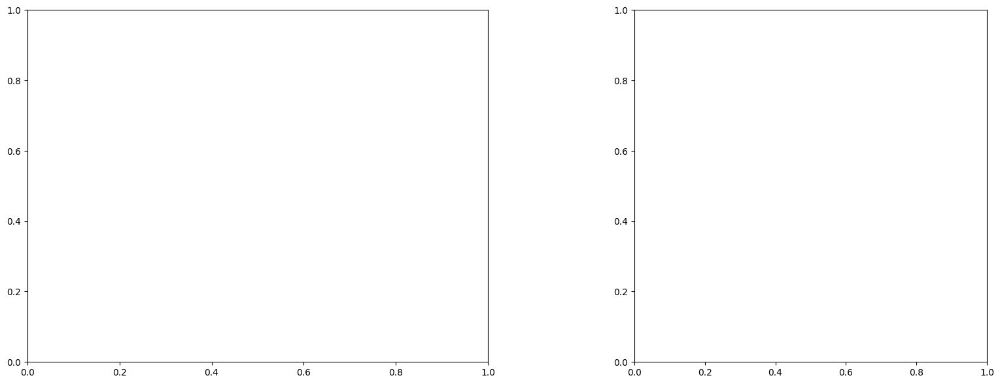

U and V components of current : [-0.07666384 -1.48729923]
uncertainties for U and V: 0.05804882973497354 0.0497402249744972


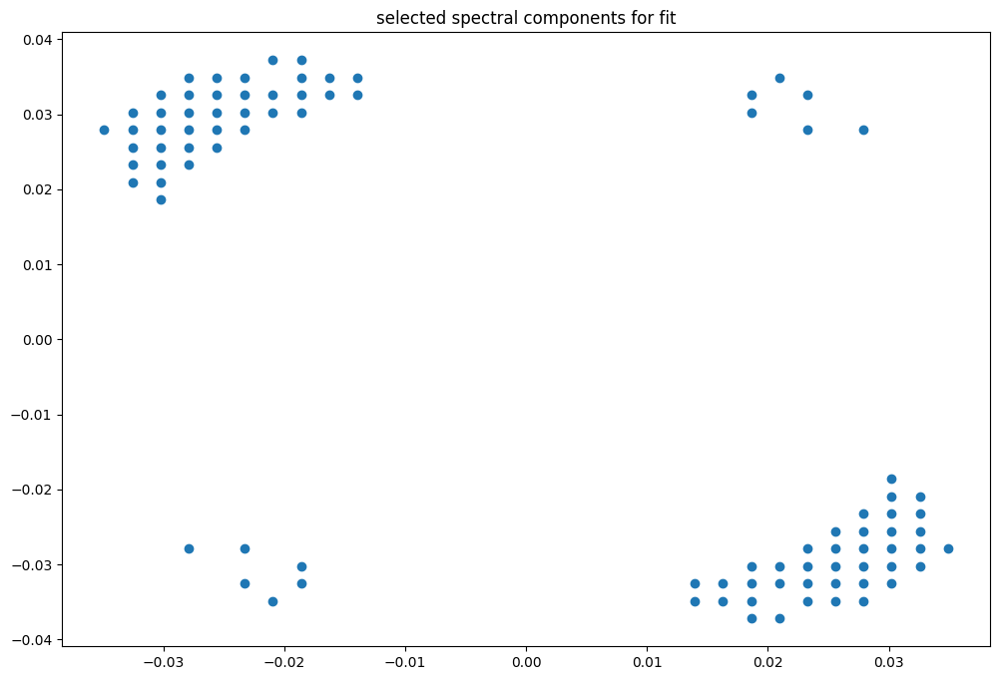

box [8000, 8700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

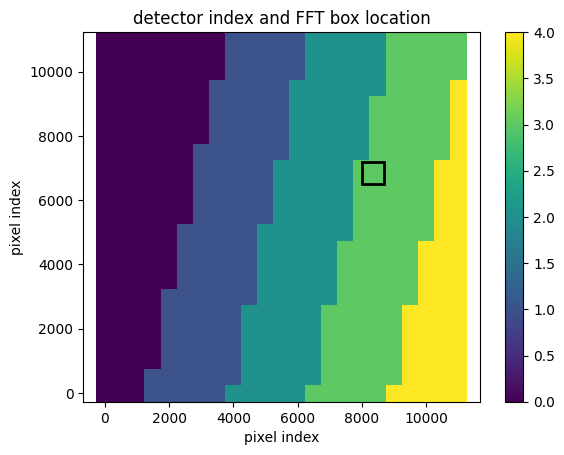

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


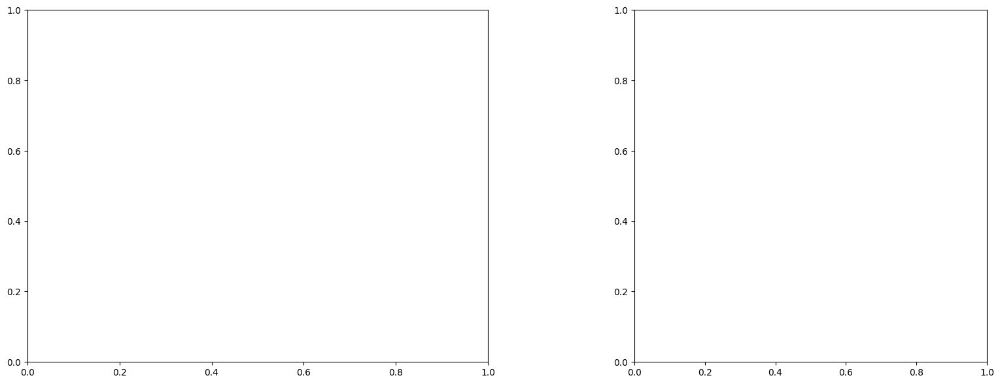

LinAlgError: Singular matrix

box [8000, 8700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

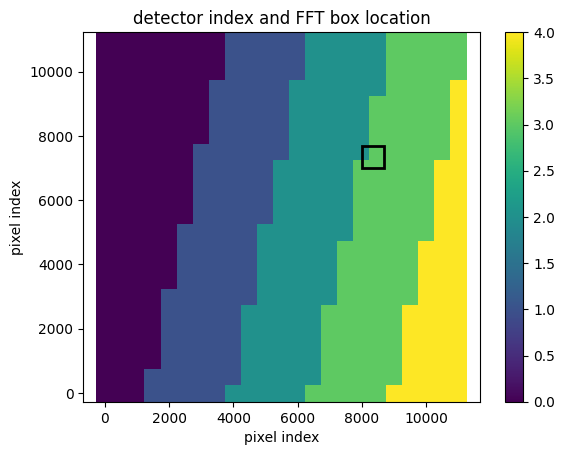

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.96
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


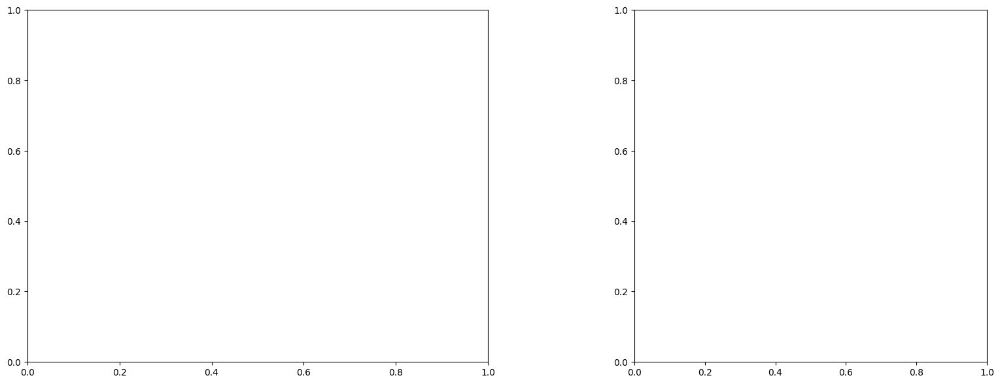

LinAlgError: Singular matrix

box [8000, 8700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

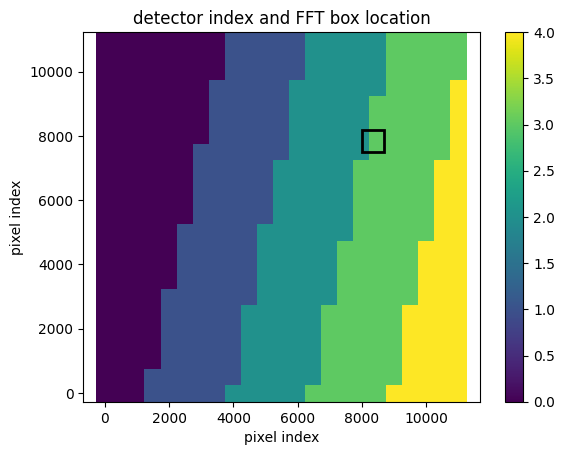

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


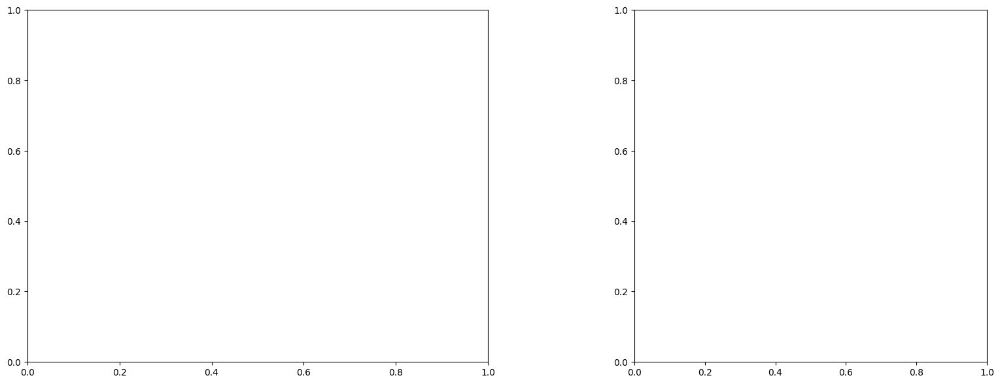

LinAlgError: Singular matrix

box [8000, 8700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

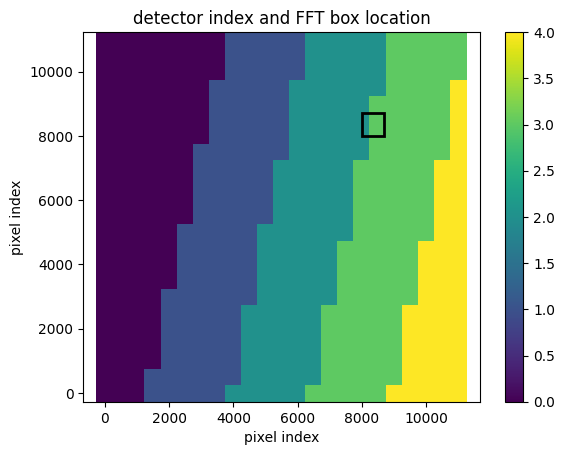

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.7
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


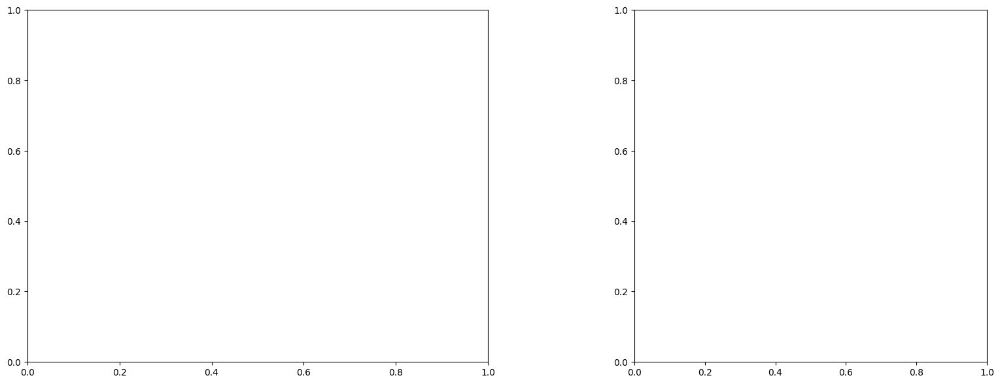

LinAlgError: Singular matrix

box [8000, 8700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

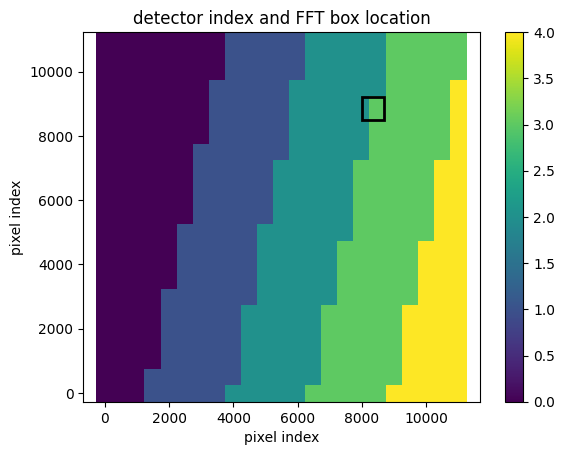

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


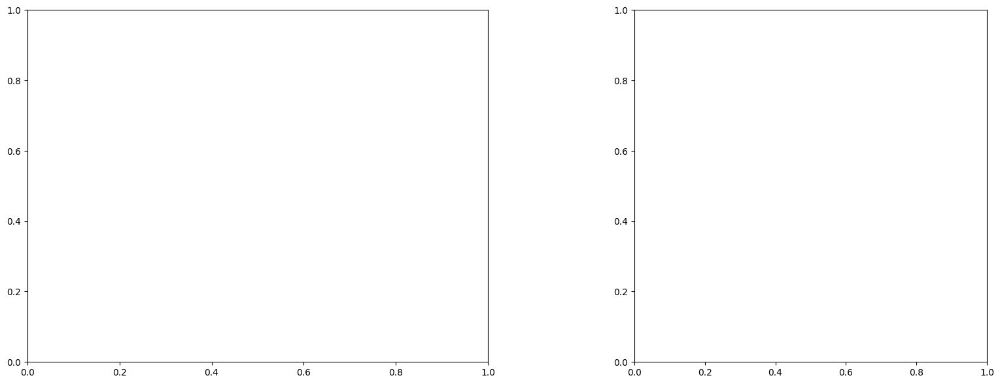

LinAlgError: Singular matrix

box [8000, 8700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

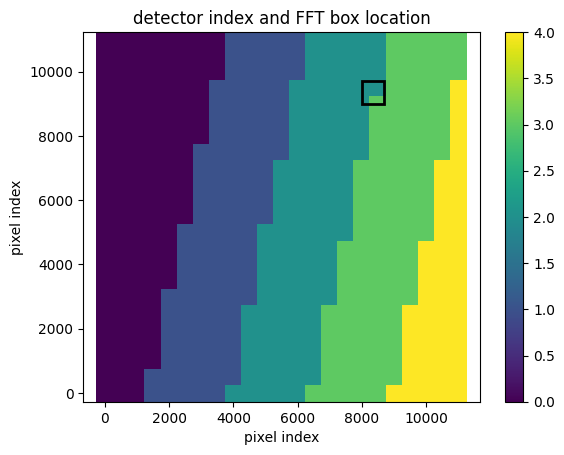

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.26
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


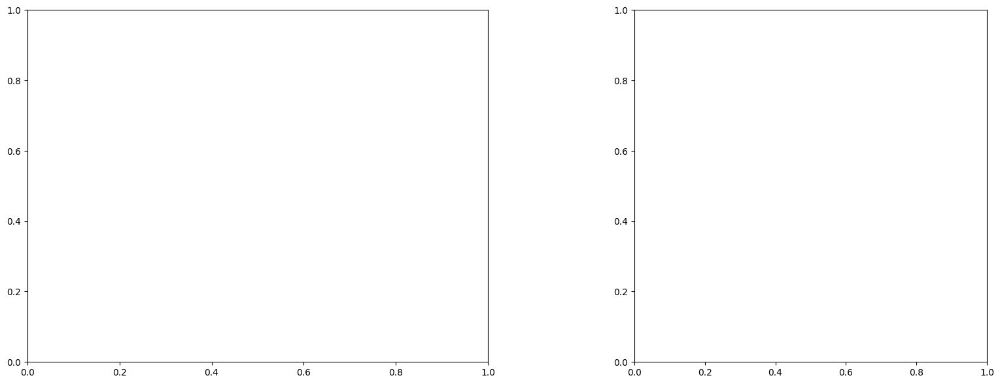

LinAlgError: Singular matrix

box [8000, 8700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

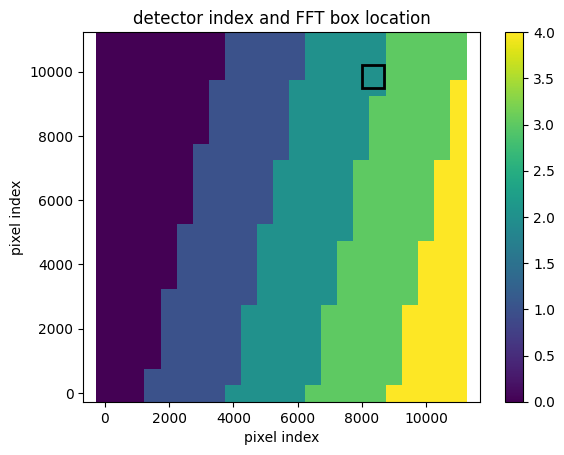

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091120930854935
(43, 43)
(43, 43)
(43, 43)


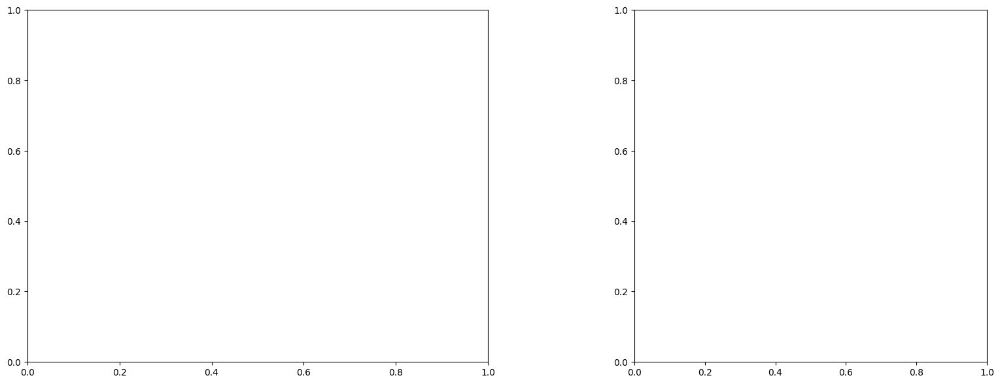

U and V components of current : [-0.25804239 -1.9546612 ]
uncertainties for U and V: 0.09369268714469009 0.09066619413536658


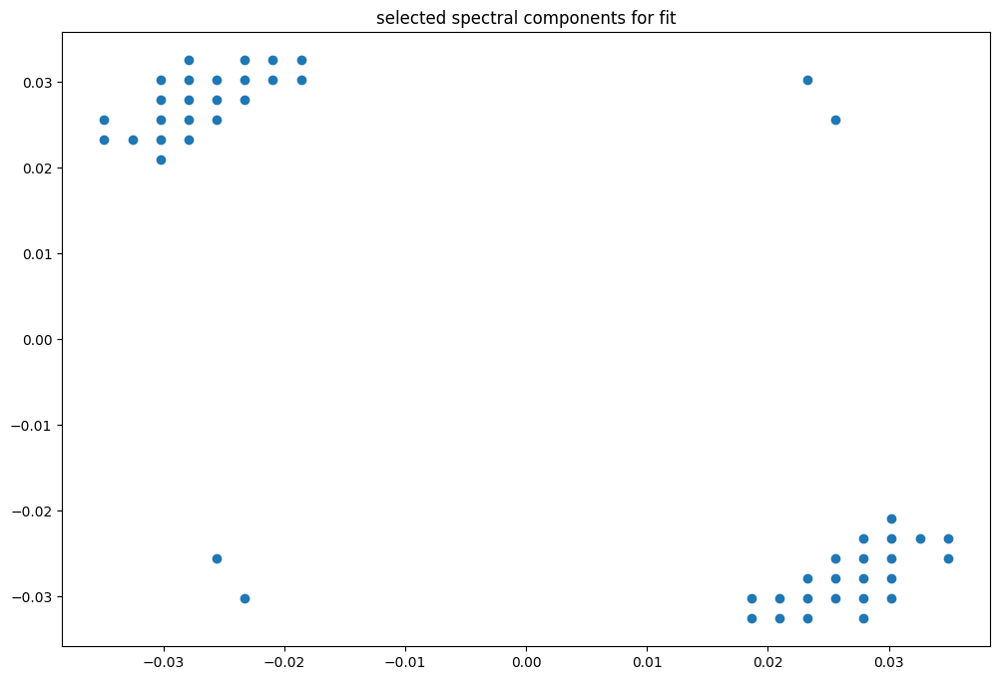

box [8000, 8700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

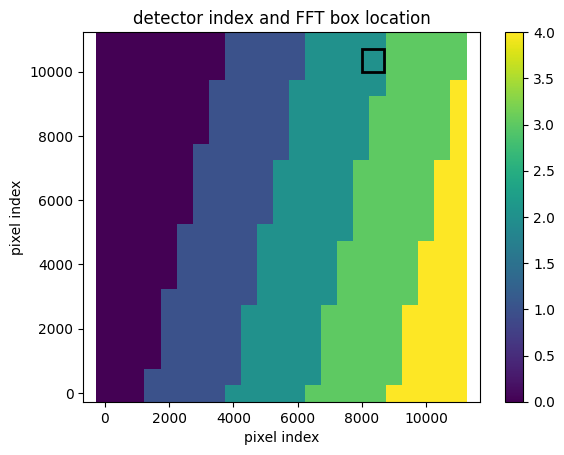

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 43)
(43, 43)
(43, 43)


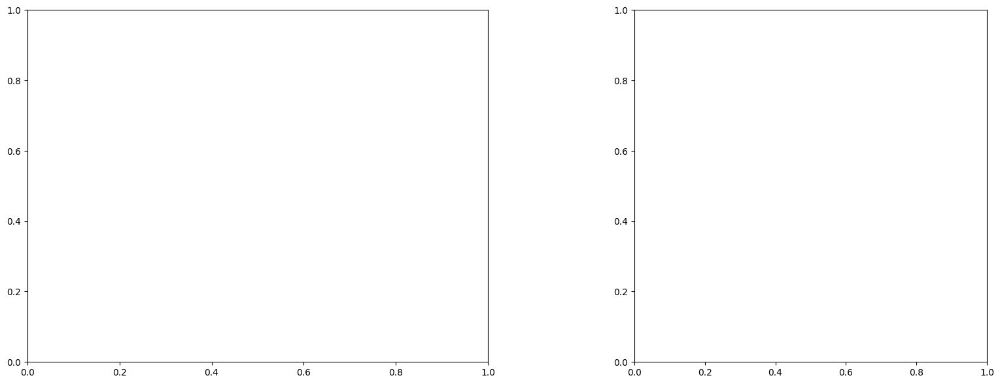

U and V components of current : [-0.74484942 -2.8788461 ]
uncertainties for U and V: 0.13514806322663517 0.126242152739372


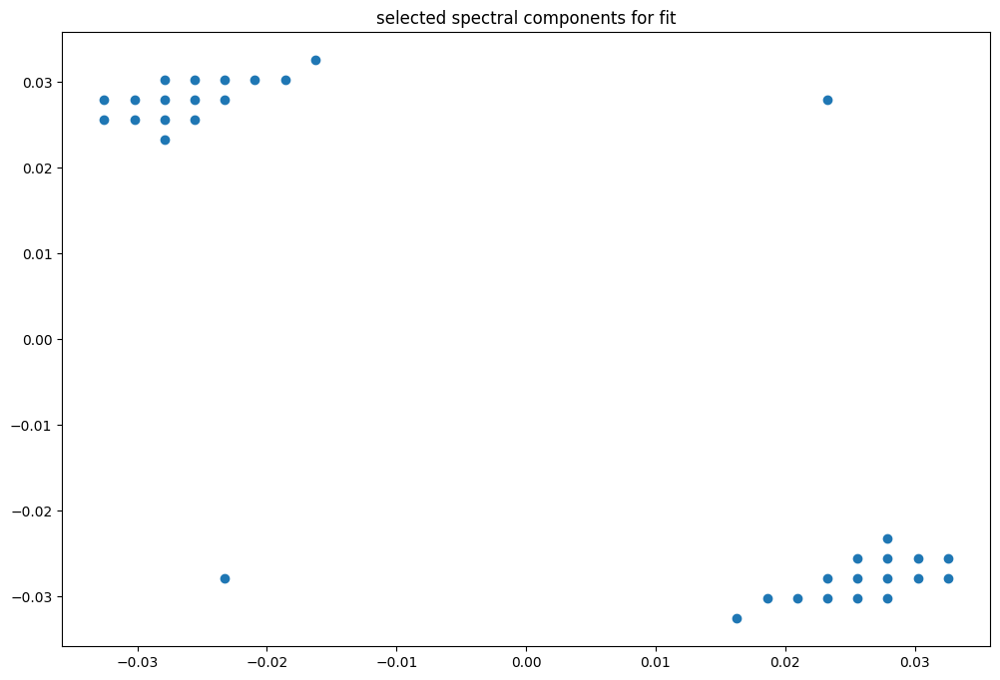

box [8000, 8700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

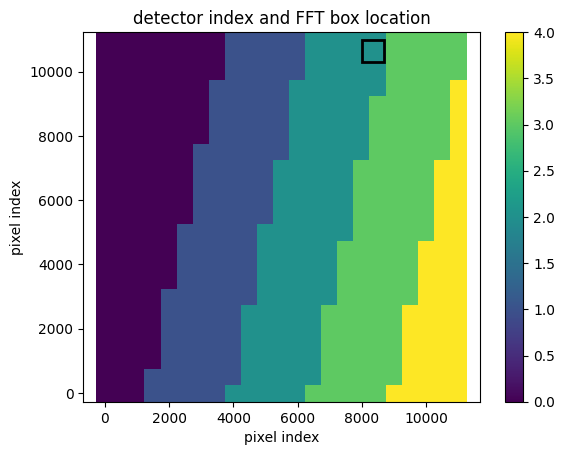

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.0
D02
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -1.0091101192239071
(43, 42)
(43, 42)
(43, 42)


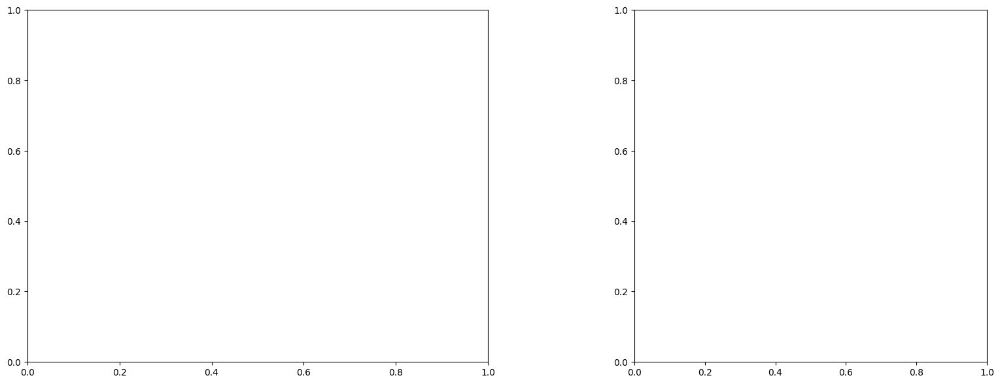

U and V components of current : [-0.38633277 -2.79199613]
uncertainties for U and V: 0.09548830482125441 0.09420962196968576


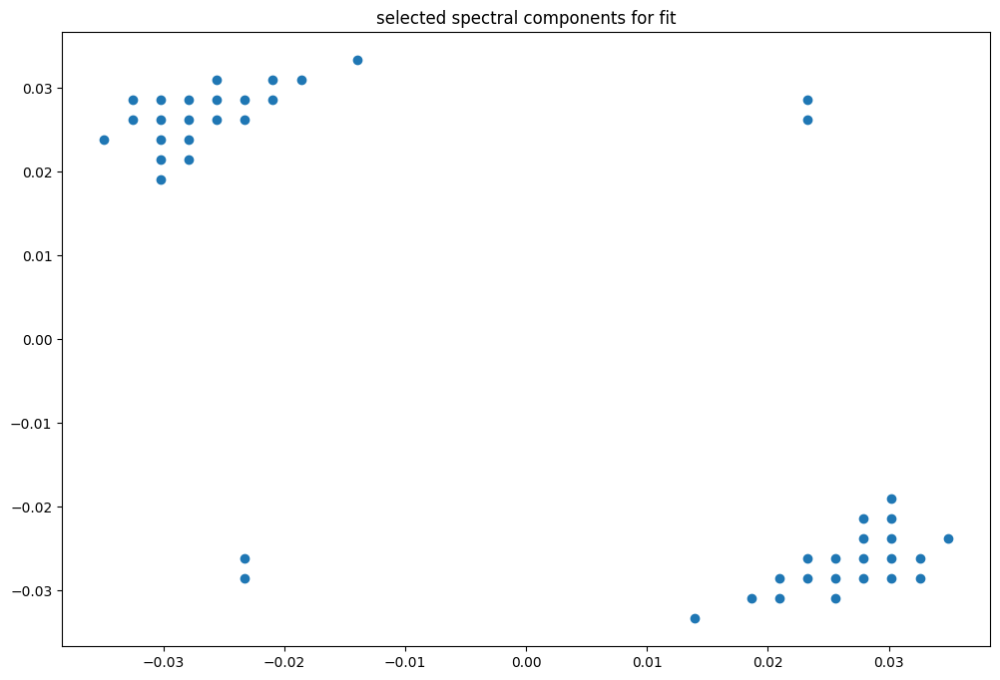

box [8500, 9200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

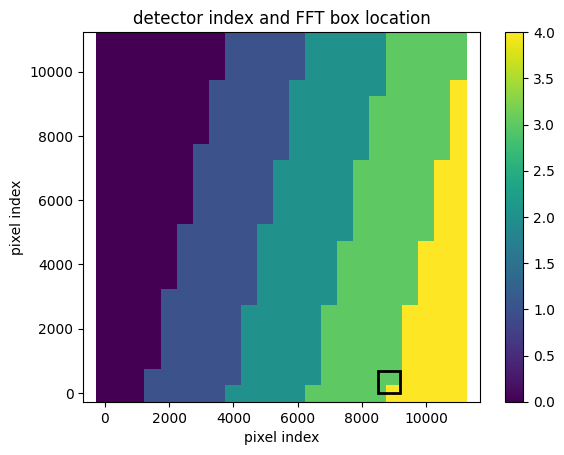

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.2600000000000002
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


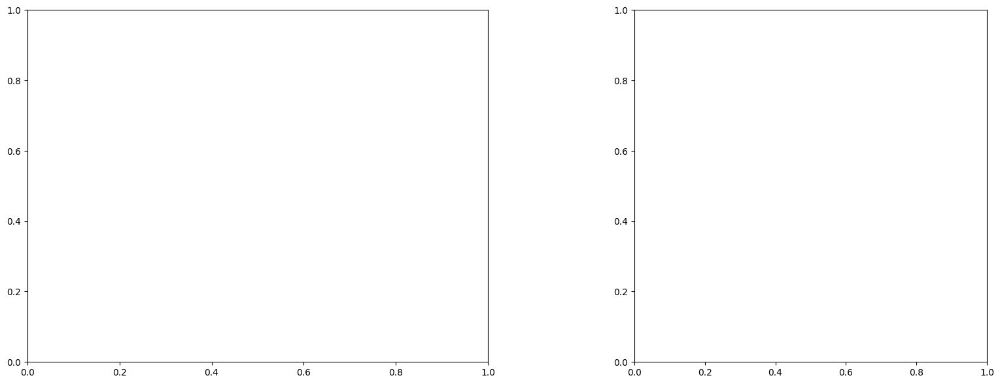

U and V components of current : [ 0.75201557 -0.54950511]
uncertainties for U and V: 0.08749812623329938 0.06551344939658901


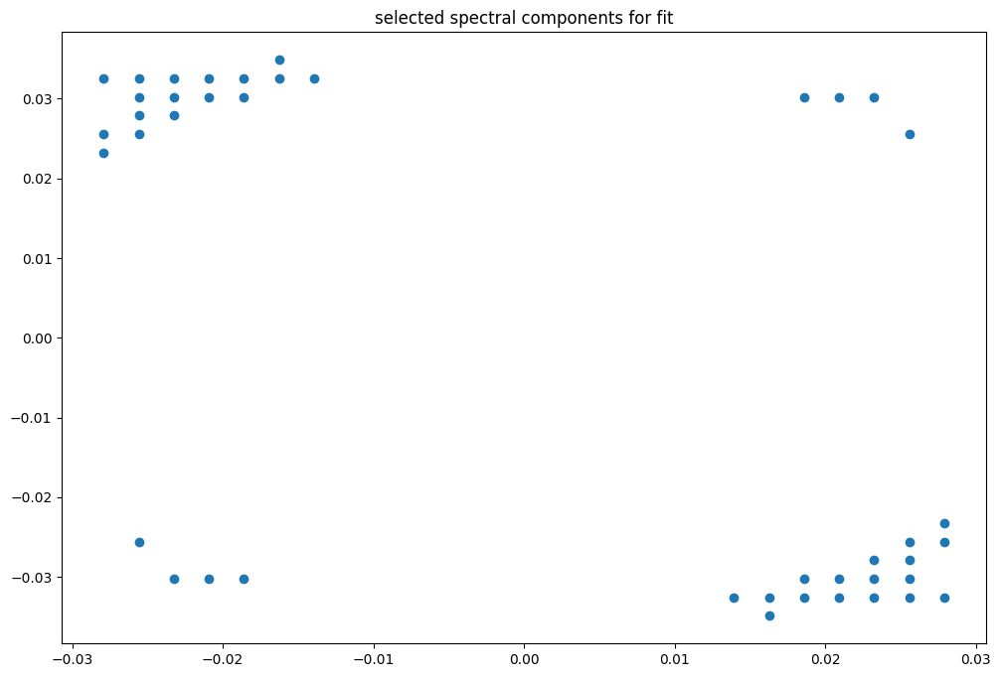

box [8500, 9200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

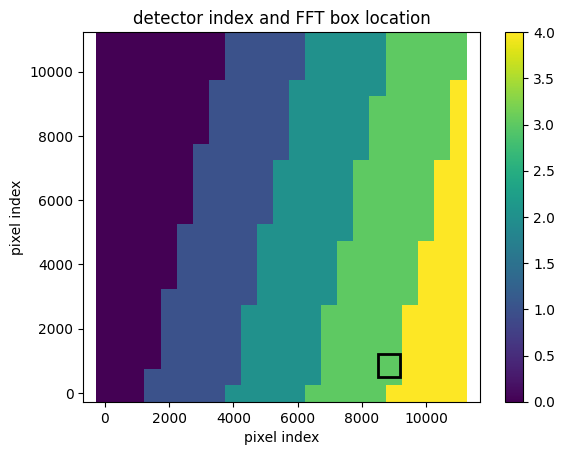

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947545347124663
(43, 43)
(43, 43)
(43, 43)


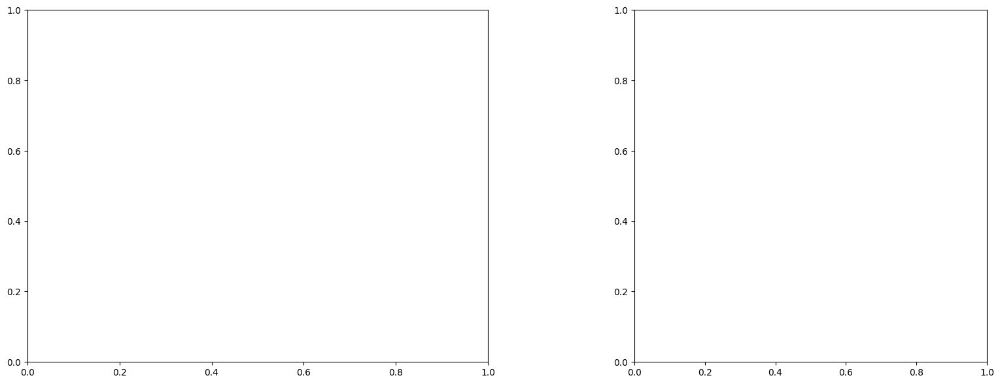

U and V components of current : [ 0.40878601 -1.42653863]
uncertainties for U and V: 0.07797950225499418 0.06068586621888284


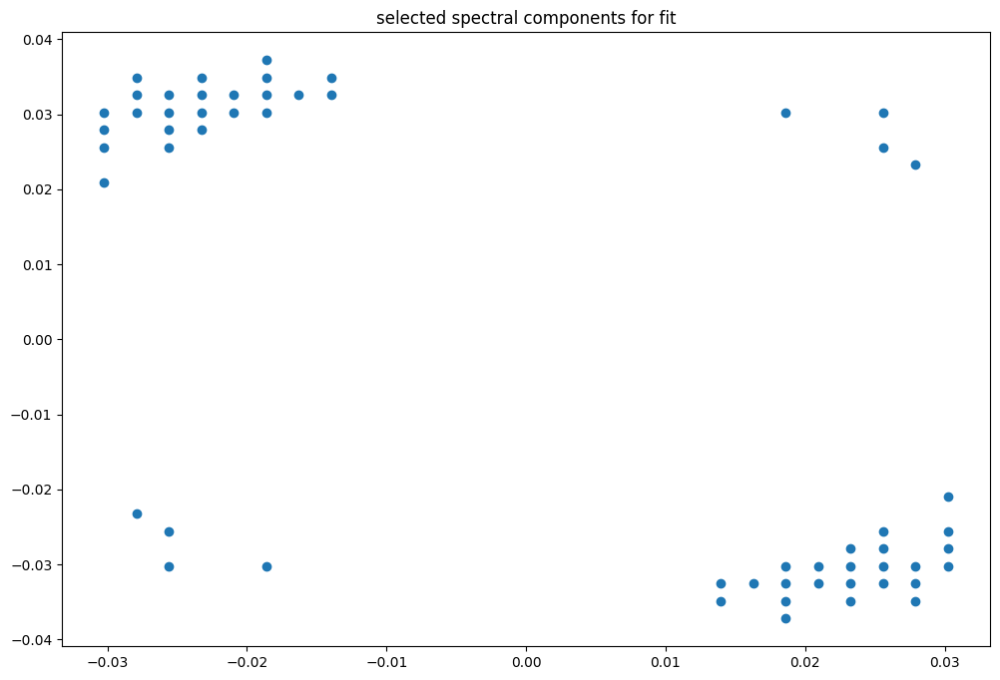

box [8500, 9200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

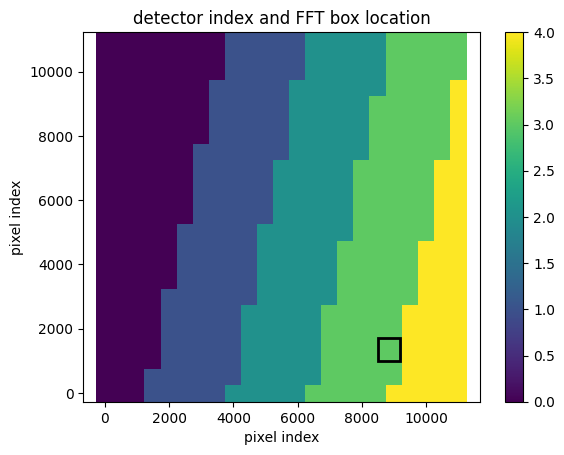

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947518055860926
(43, 43)
(43, 43)
(43, 43)


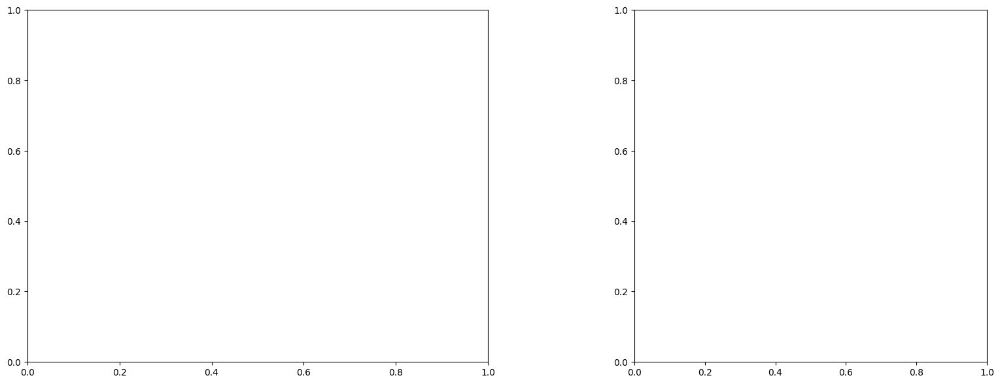

U and V components of current : [ 0.64561755 -0.95784374]
uncertainties for U and V: 0.06642120399749082 0.052986529326025336


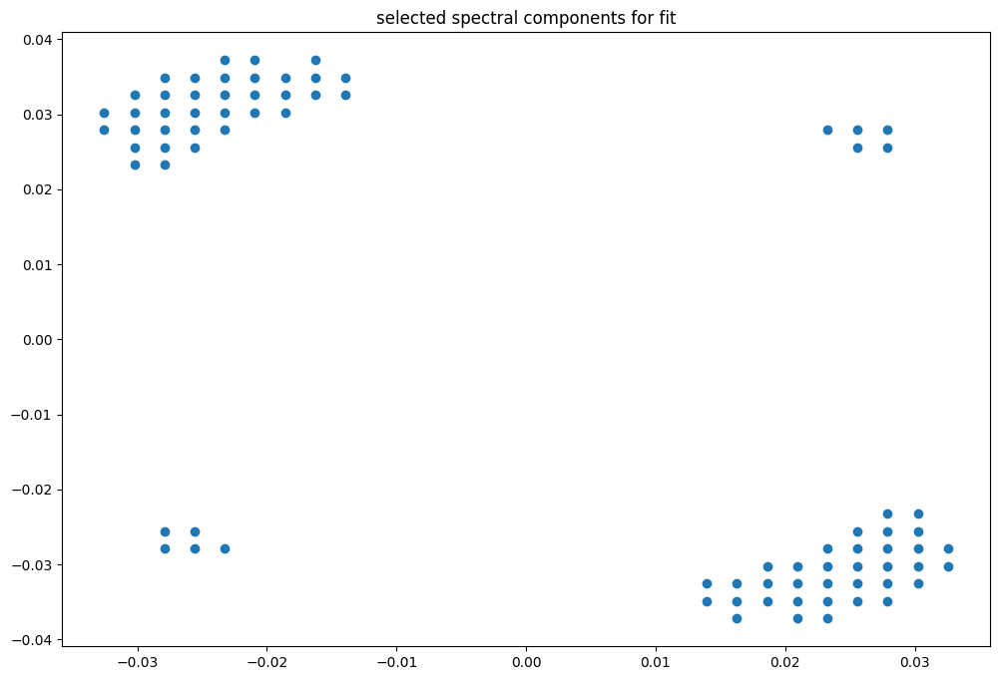

box [8500, 9200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

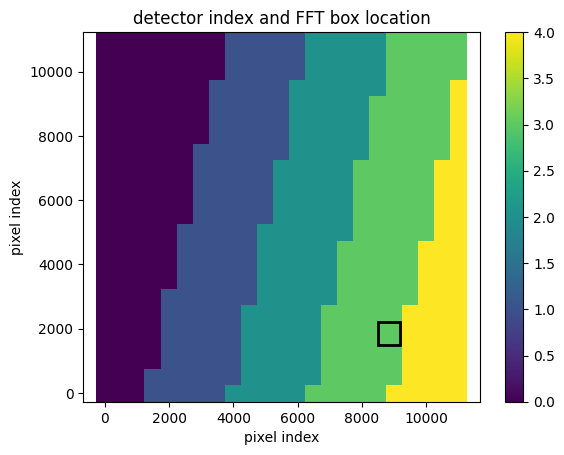

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


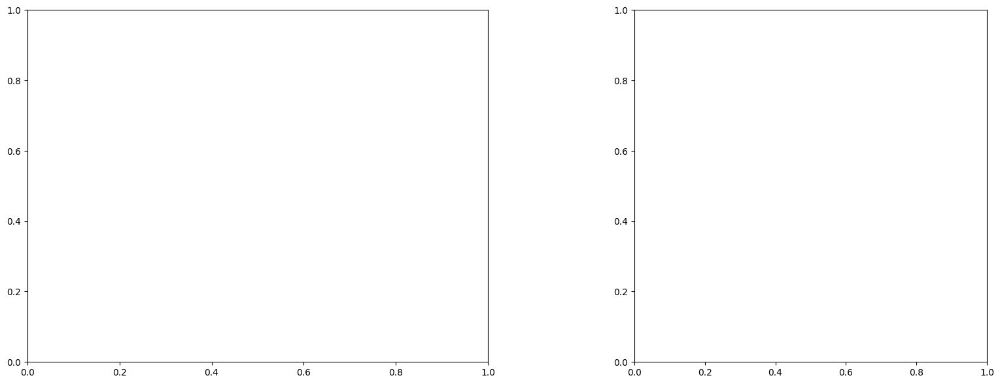

U and V components of current : [ 0.15560163 -1.15352266]
uncertainties for U and V: 0.1105903036556311 0.086210527996888


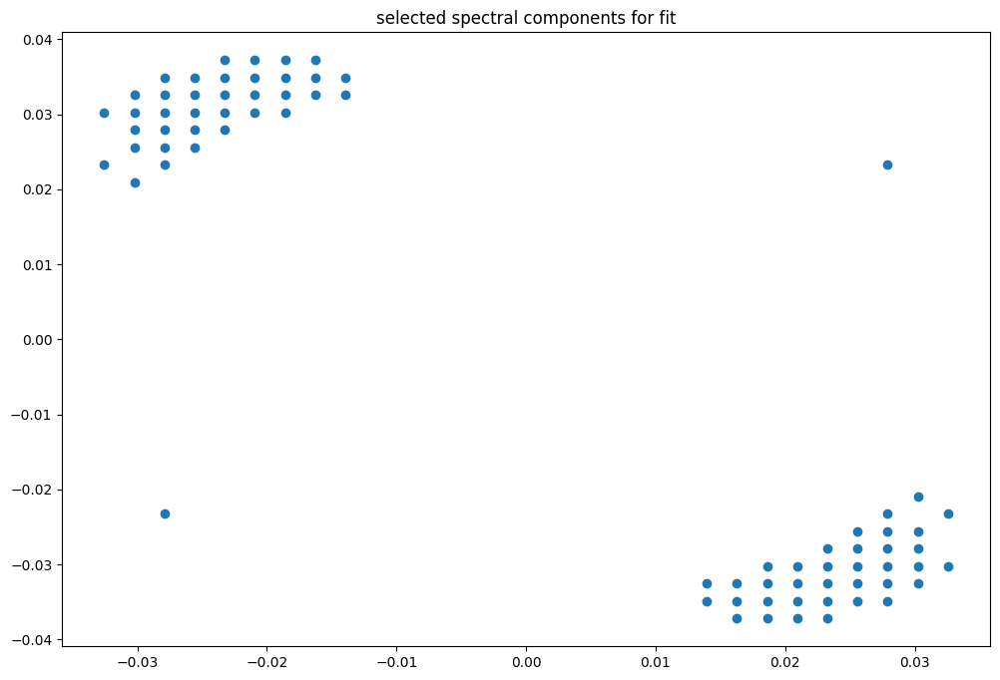

box [8500, 9200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

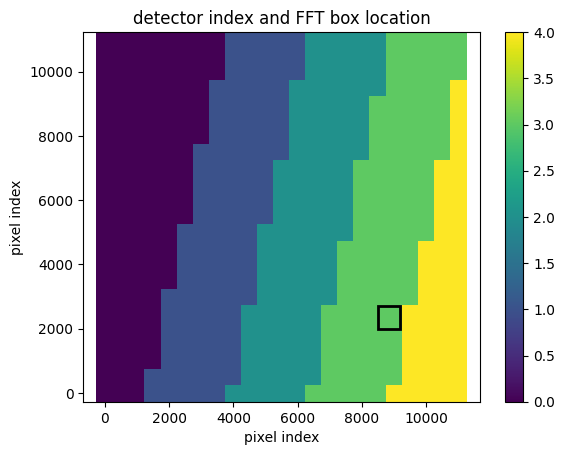

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947493002117194
(43, 43)
(43, 43)
(43, 43)


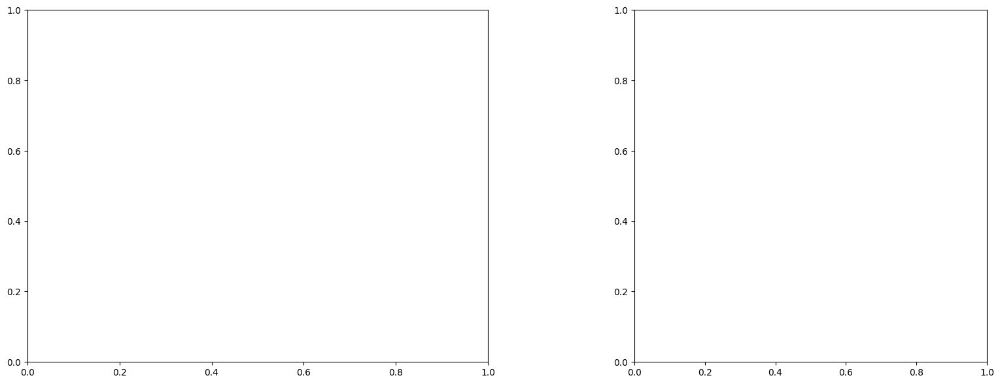

U and V components of current : [2.03882276 0.08572188]
uncertainties for U and V: 0.14787041469088877 0.11643849088726589


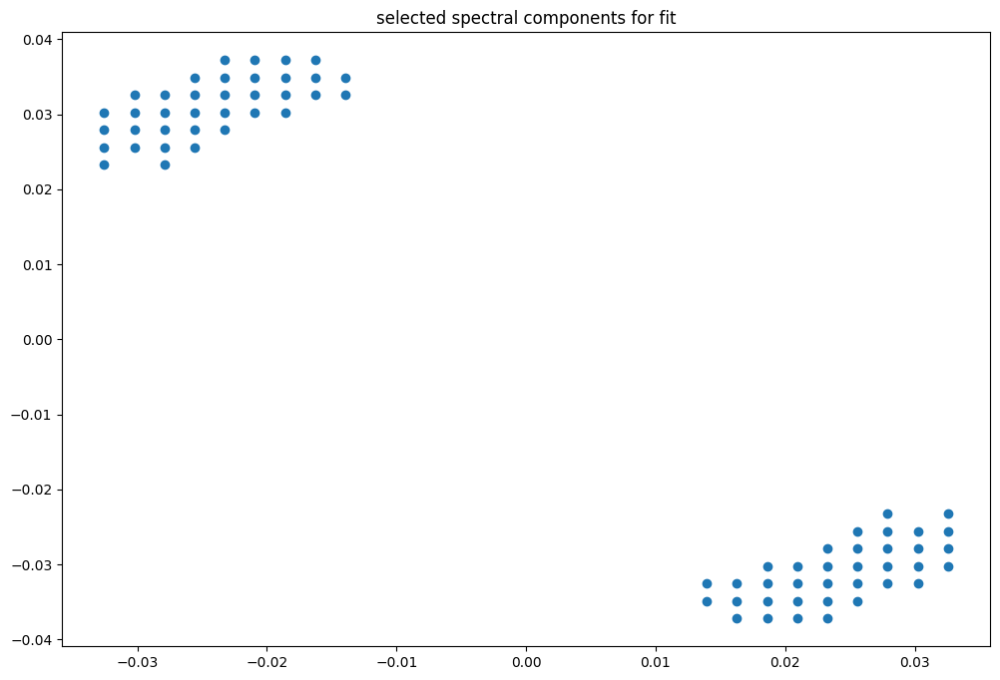

box [8500, 9200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

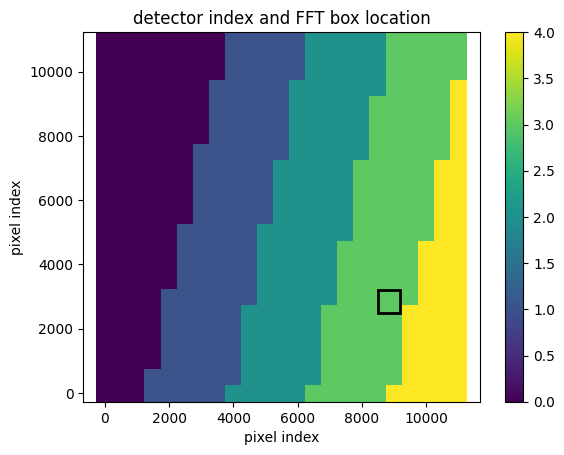

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


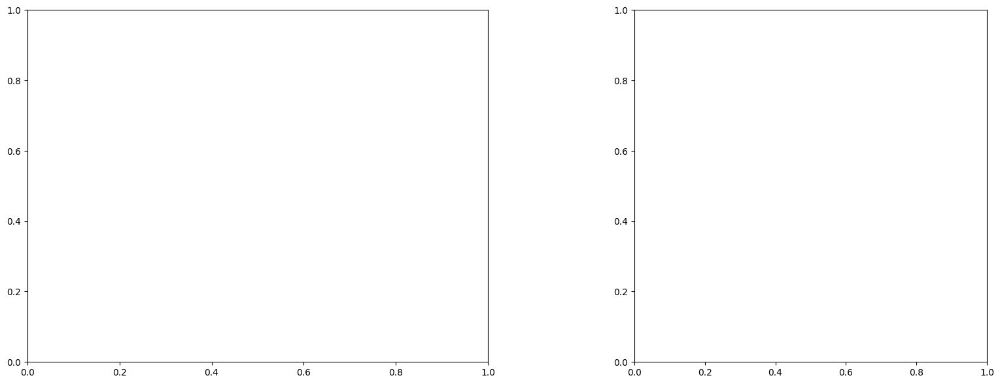

U and V components of current : [ 0.09545483 -1.26904747]
uncertainties for U and V: 0.07550101564705564 0.06276730796799107


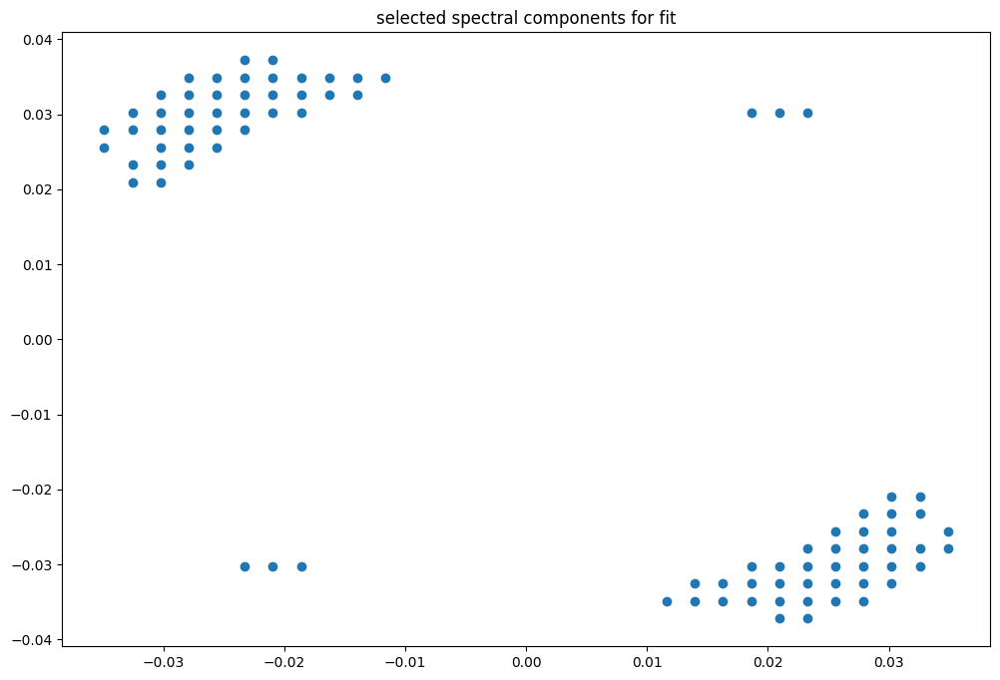

box [8500, 9200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

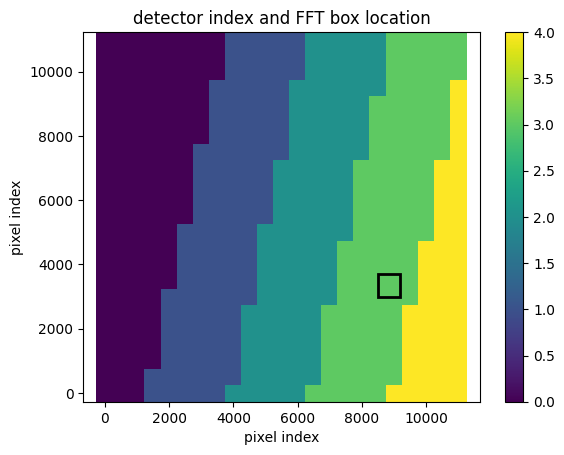

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


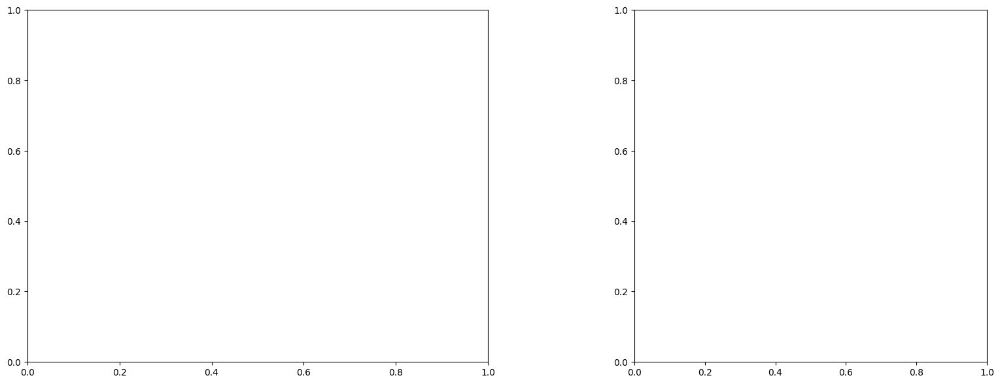

U and V components of current : [-0.27499971 -1.4439599 ]
uncertainties for U and V: 0.07334509286905702 0.061875177666237346


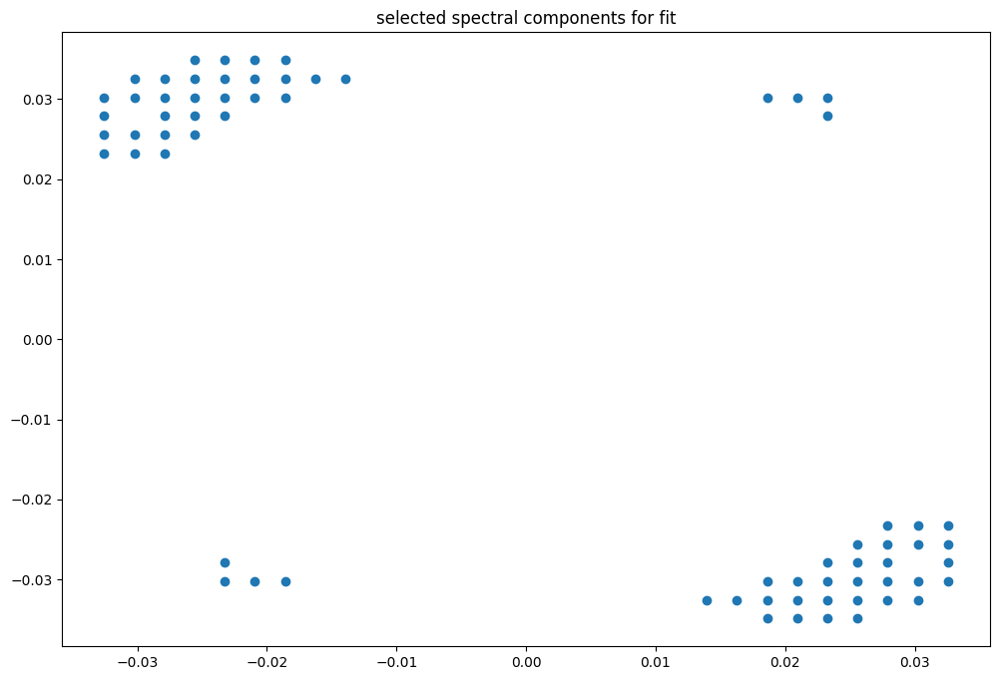

box [8500, 9200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

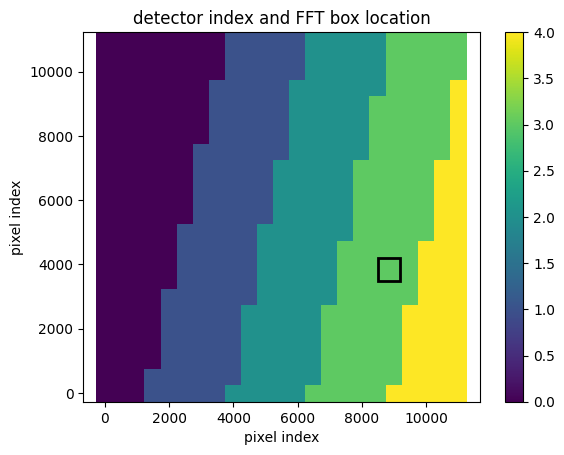

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


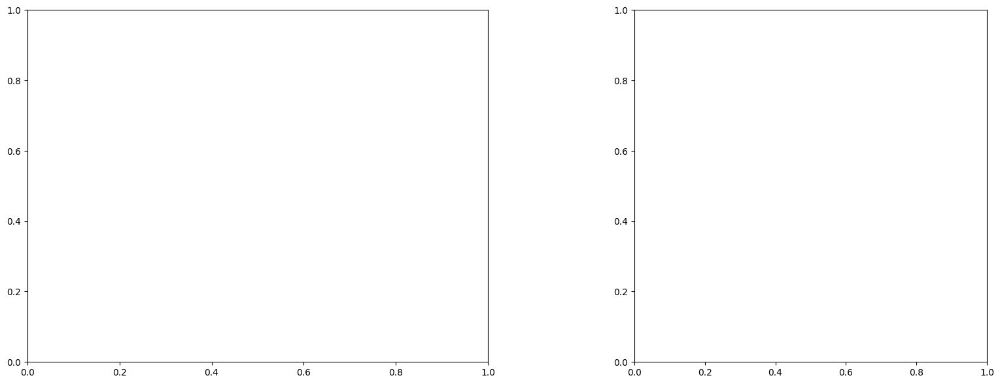

U and V components of current : [-0.40562925 -1.54556652]
uncertainties for U and V: 0.04933131883695804 0.04065567469702112


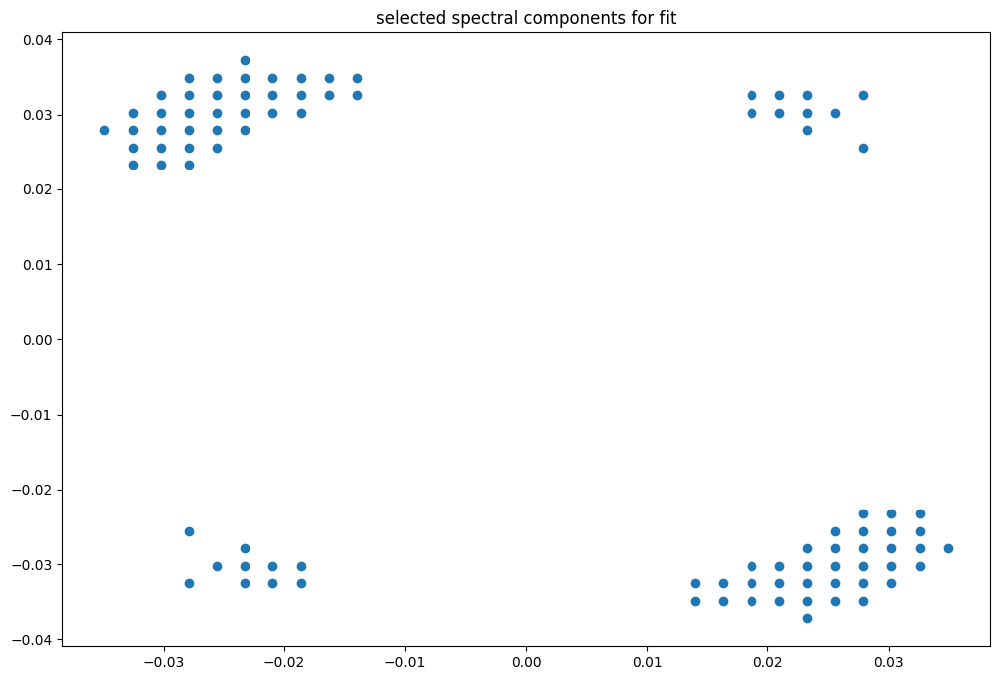

box [8500, 9200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

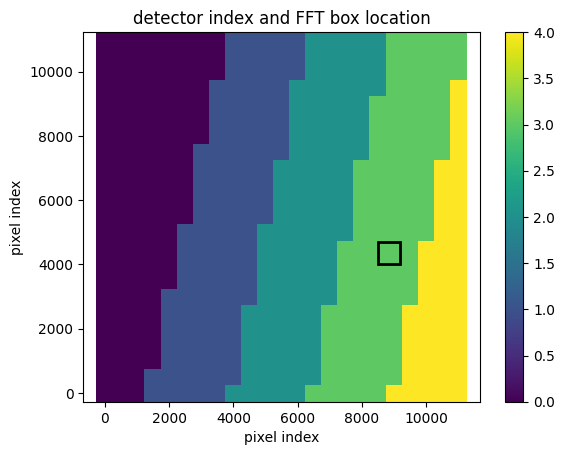

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


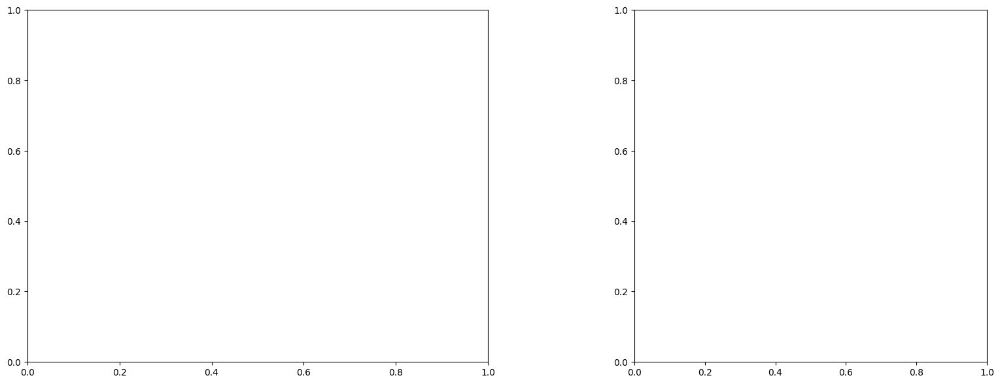

U and V components of current : [-0.2401013  -1.53887162]
uncertainties for U and V: 0.04107044761686198 0.03378125263430051


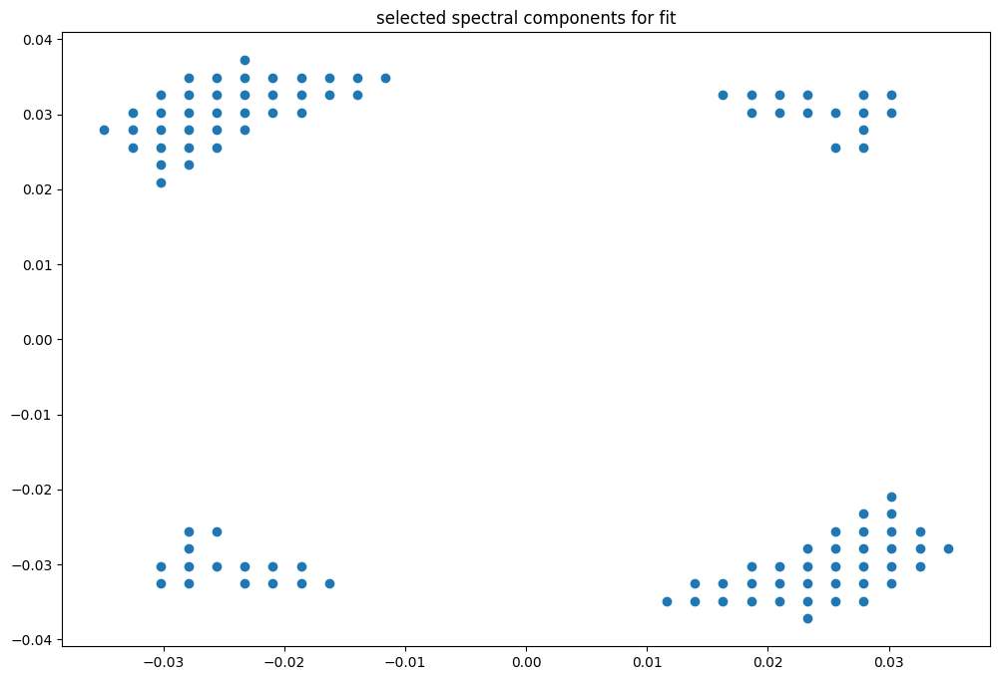

box [8500, 9200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

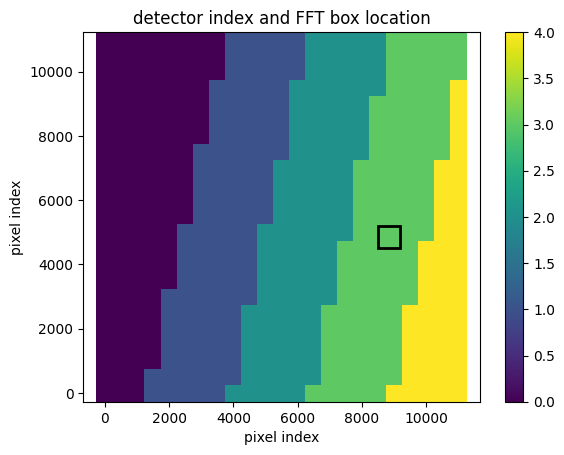

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


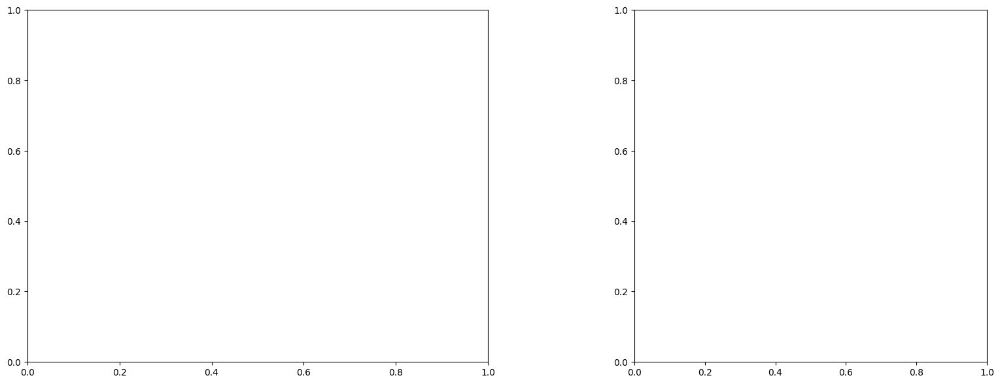

U and V components of current : [-0.57030503 -1.58379492]
uncertainties for U and V: 0.04405983244594045 0.03570000670138247


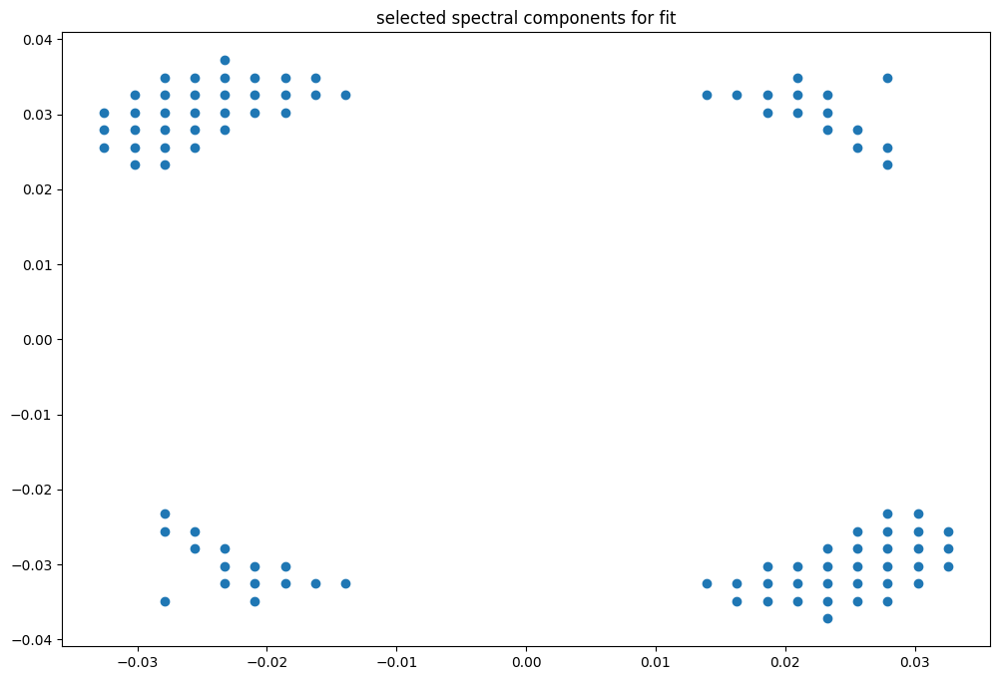

box [8500, 9200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

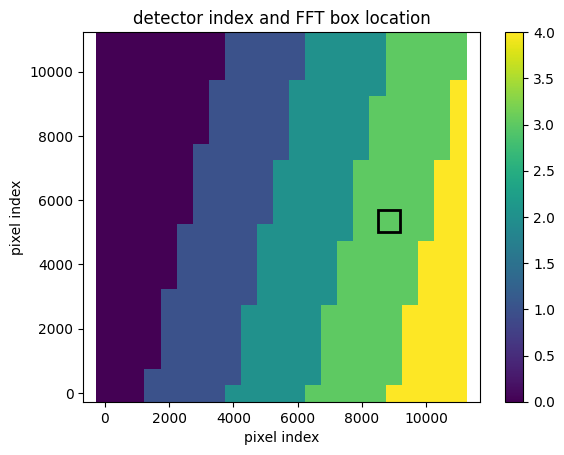

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


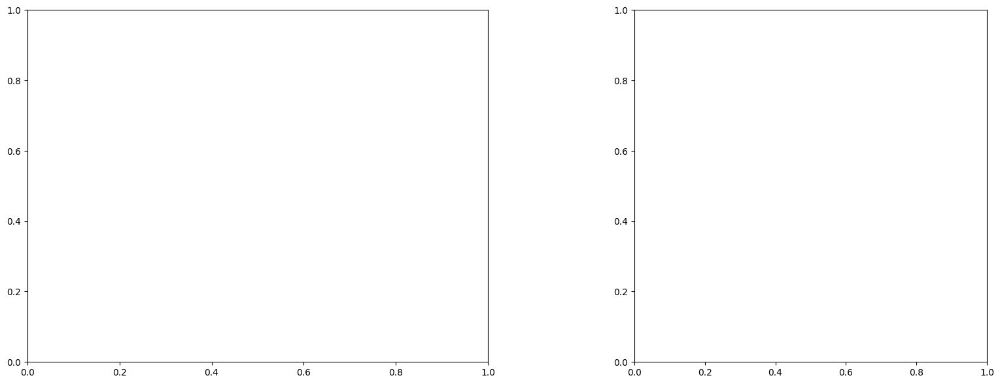

U and V components of current : [-0.09976334 -1.32694706]
uncertainties for U and V: 0.03980329936845948 0.033189584449705295


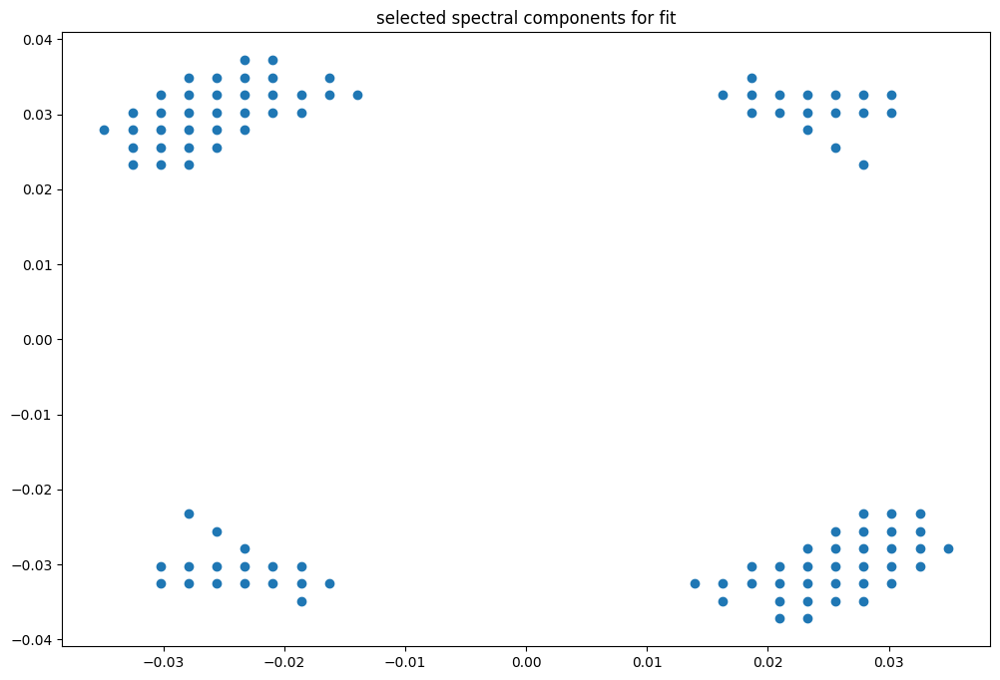

box [8500, 9200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

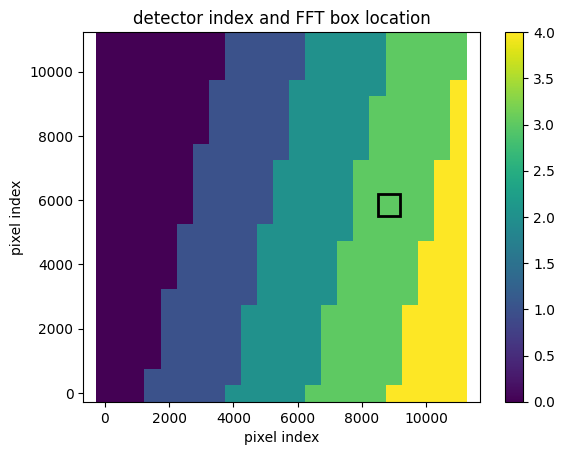

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


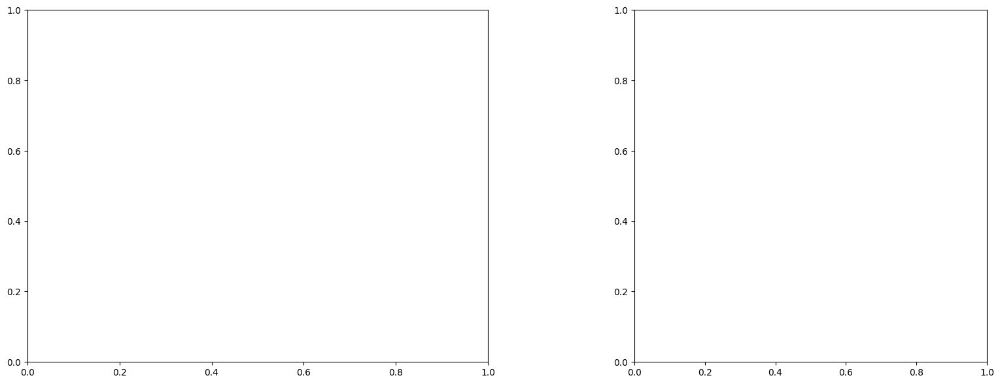

U and V components of current : [-0.14927778 -1.94637692]
uncertainties for U and V: 0.04090540217500422 0.03531515641942072


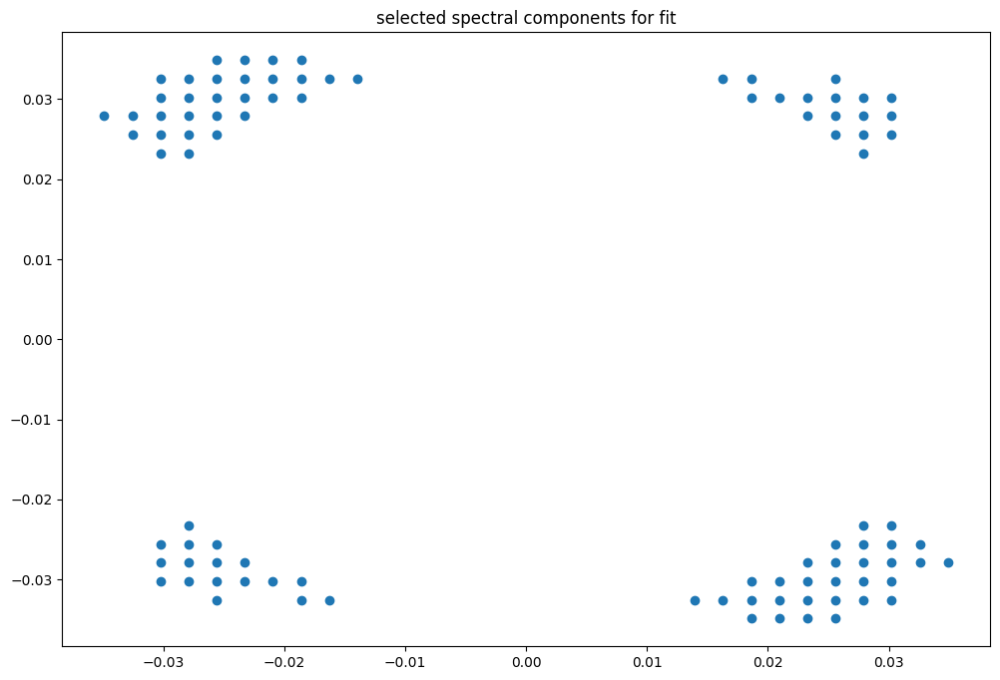

box [8500, 9200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

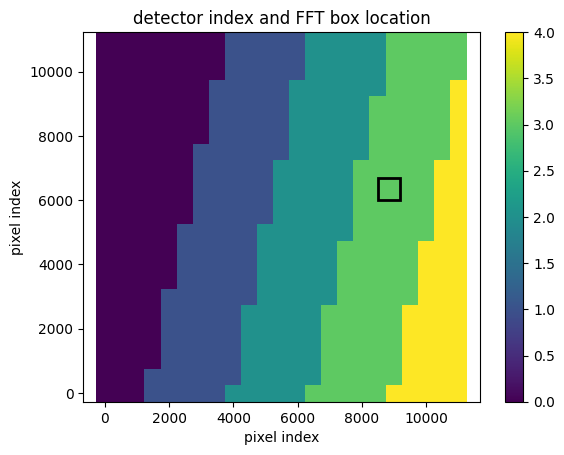

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


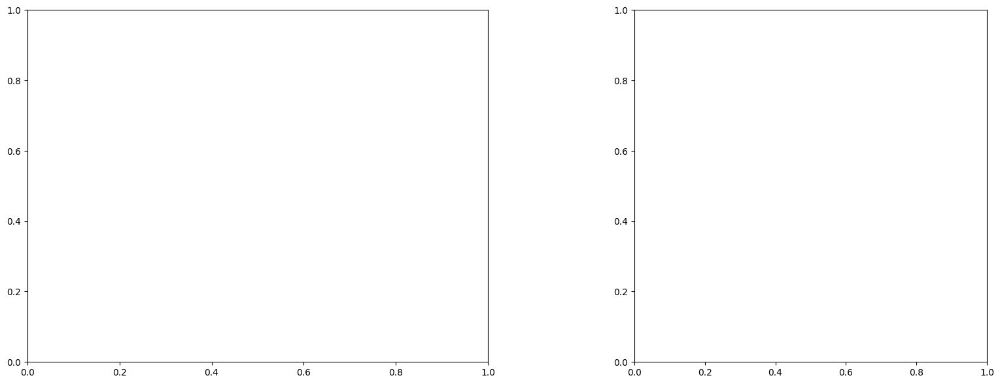

U and V components of current : [-0.14651116 -1.70907348]
uncertainties for U and V: 0.040348704624399954 0.033303720637849414


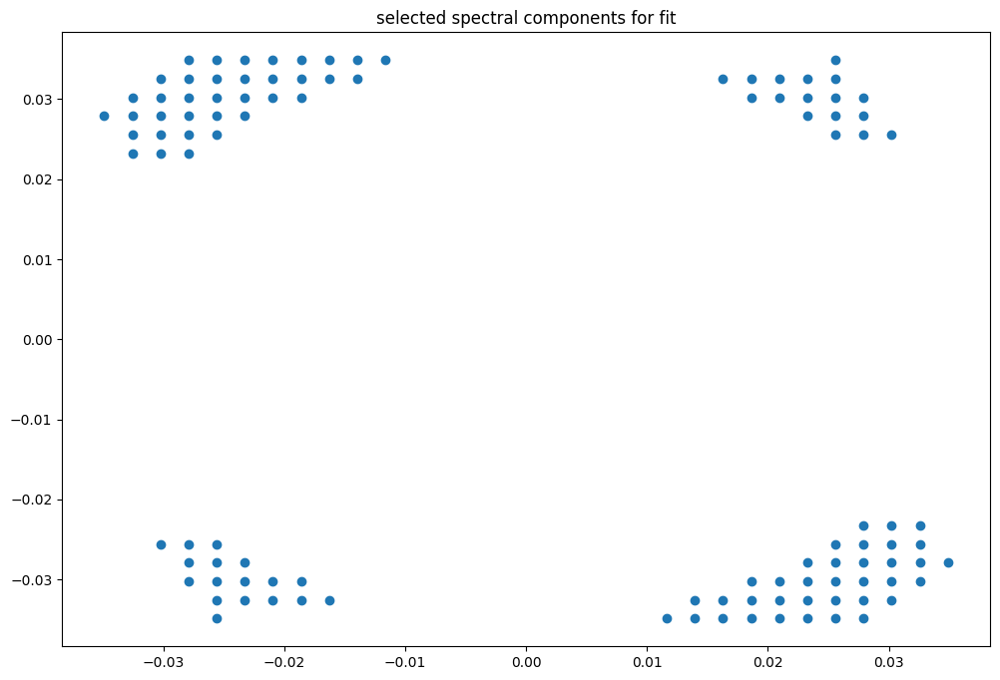

box [8500, 9200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

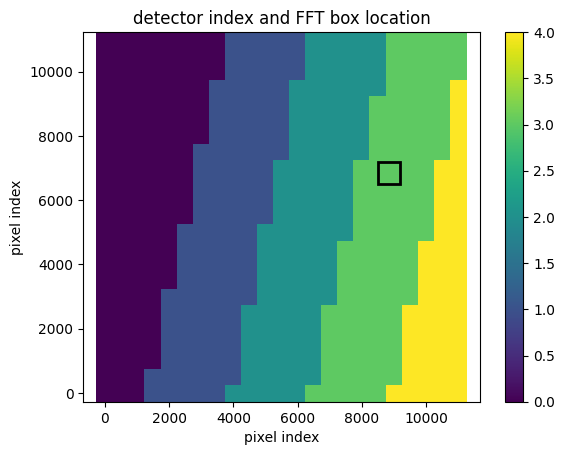

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


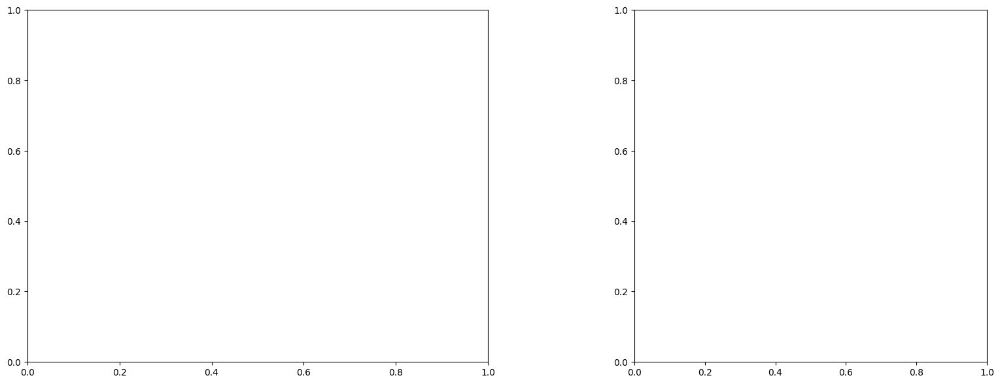

U and V components of current : [-0.08772659 -1.40535754]
uncertainties for U and V: 0.04058692533093996 0.03459847972476642


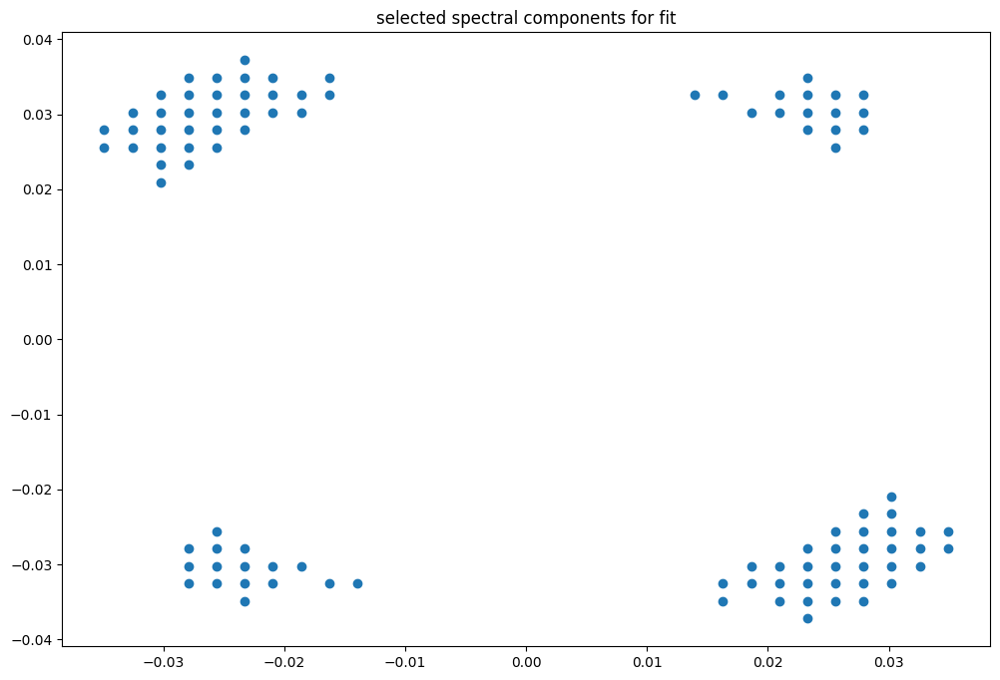

box [8500, 9200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

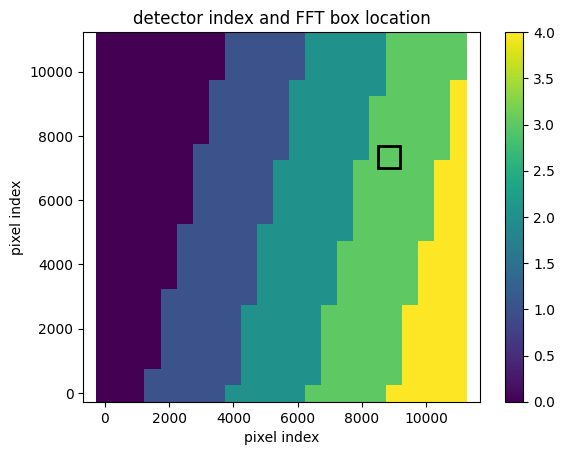

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


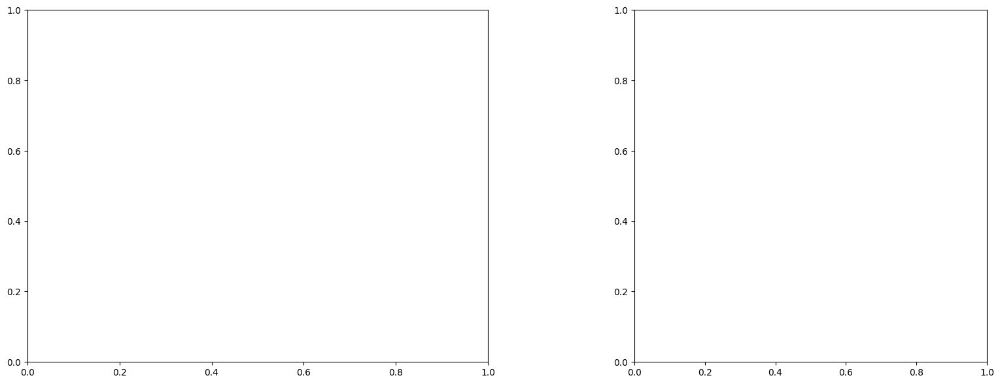

U and V components of current : [-0.2397865  -1.71306723]
uncertainties for U and V: 0.04464339368064321 0.039093105588557324


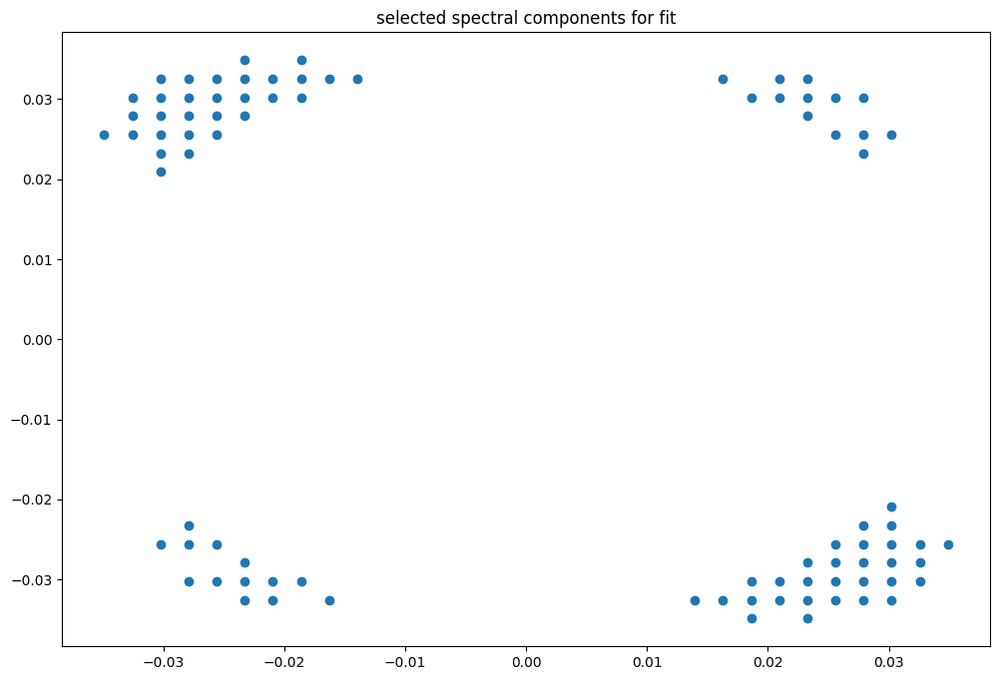

box [8500, 9200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

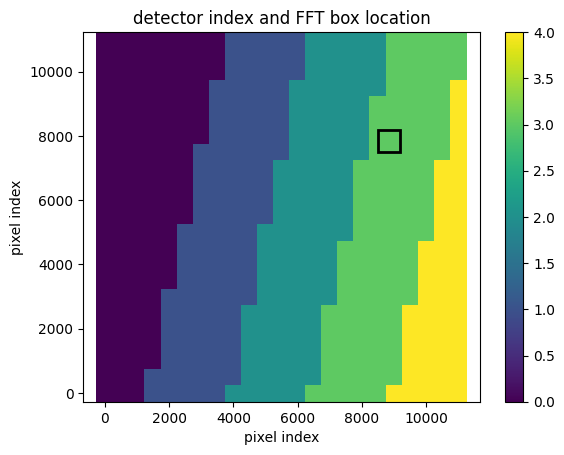

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


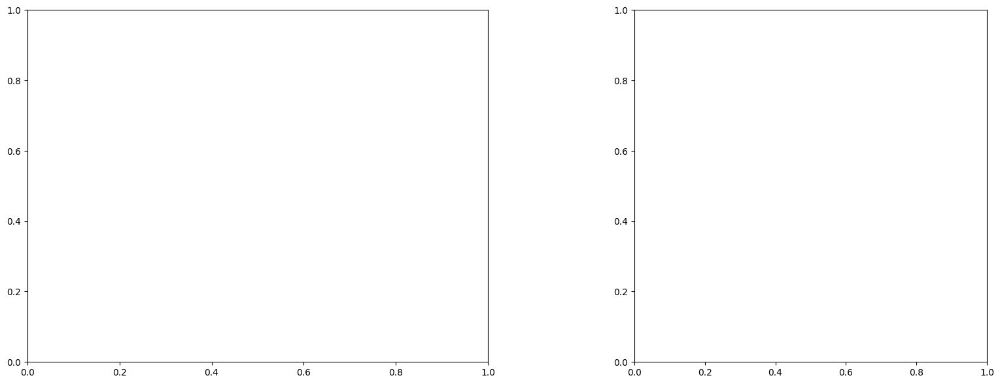

U and V components of current : [-0.39443662 -1.76805695]
uncertainties for U and V: 0.0593800116628019 0.05261537977935845


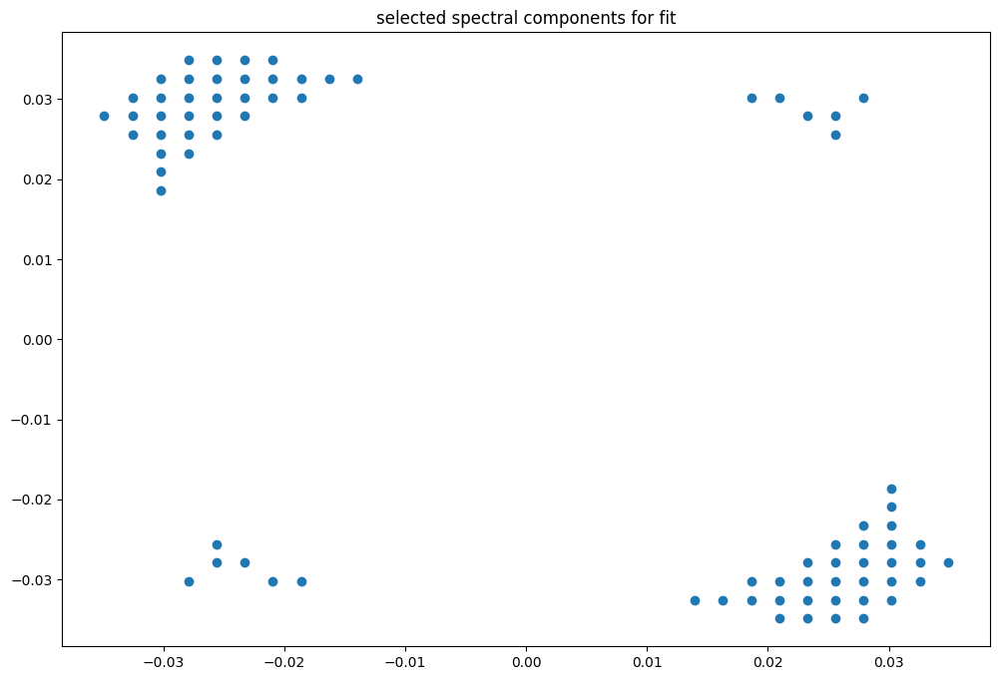

box [8500, 9200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

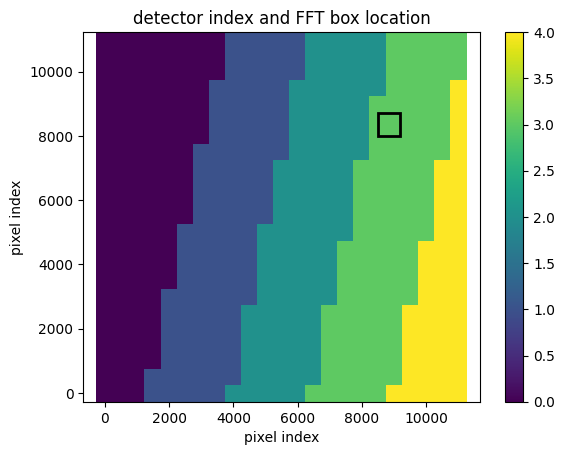

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


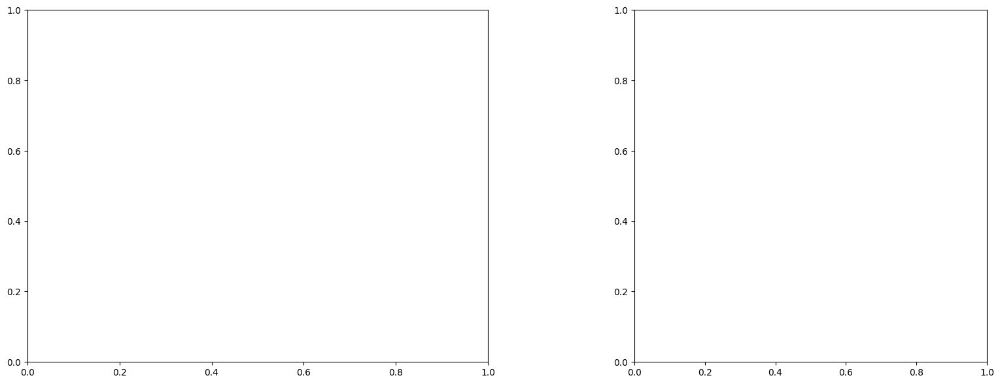

U and V components of current : [-0.39397696 -1.99123327]
uncertainties for U and V: 0.05611426021511857 0.048950254295190246


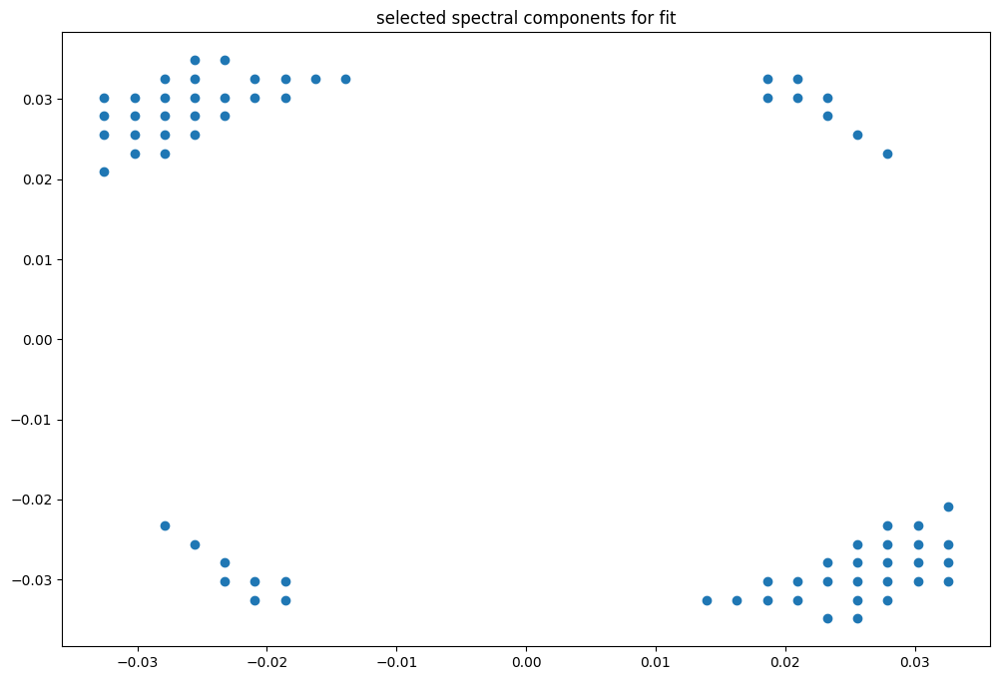

box [8500, 9200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

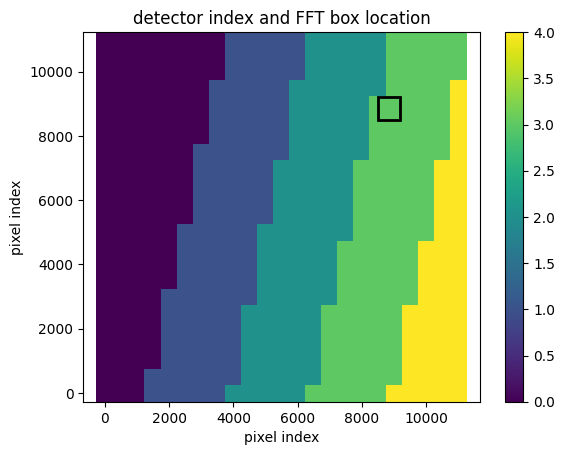

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


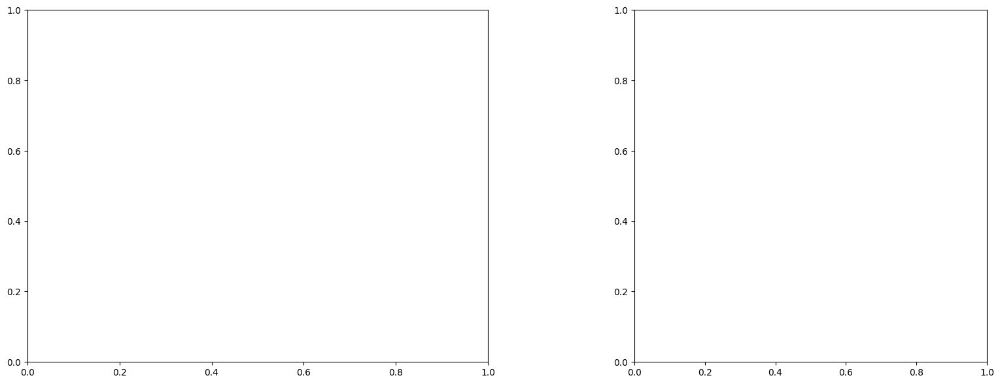

U and V components of current : [ 1.8401358  -0.37055101]
uncertainties for U and V: 0.28091584077408027 0.26117544070356274


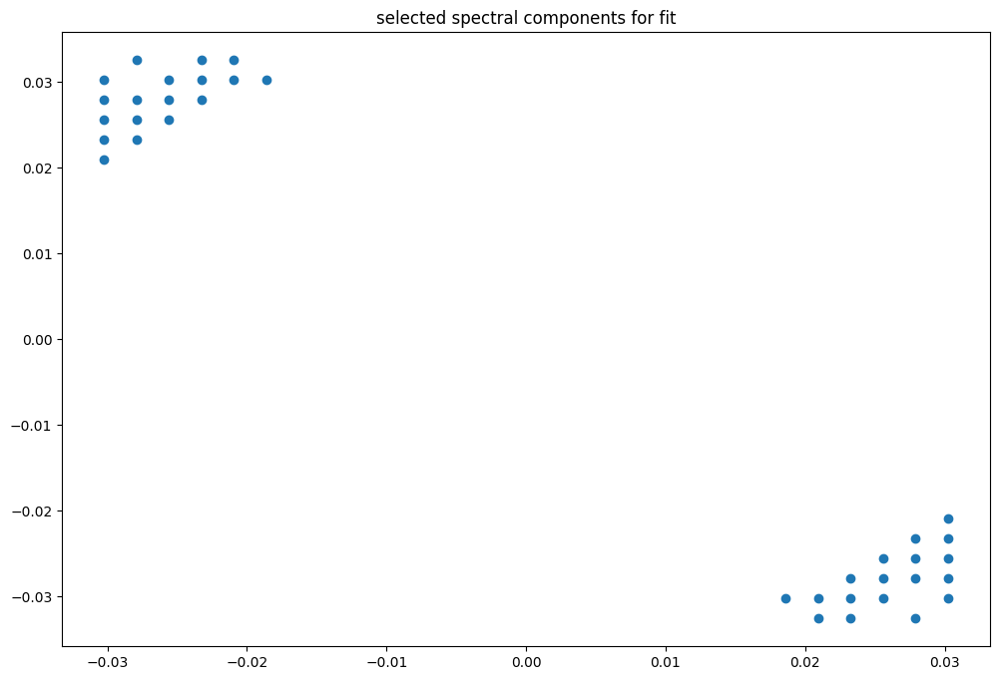

box [8500, 9200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

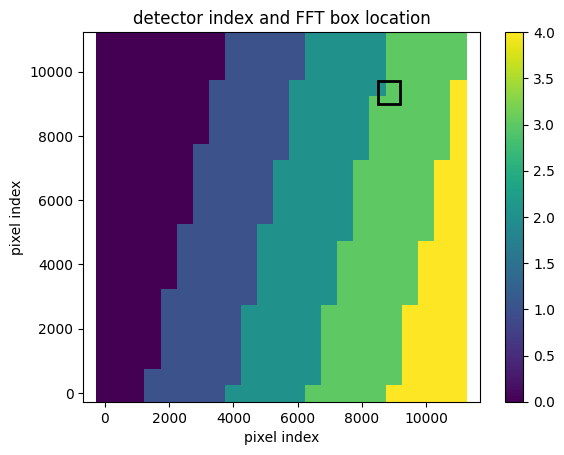

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.96
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(43, 43)
(43, 43)
(43, 43)


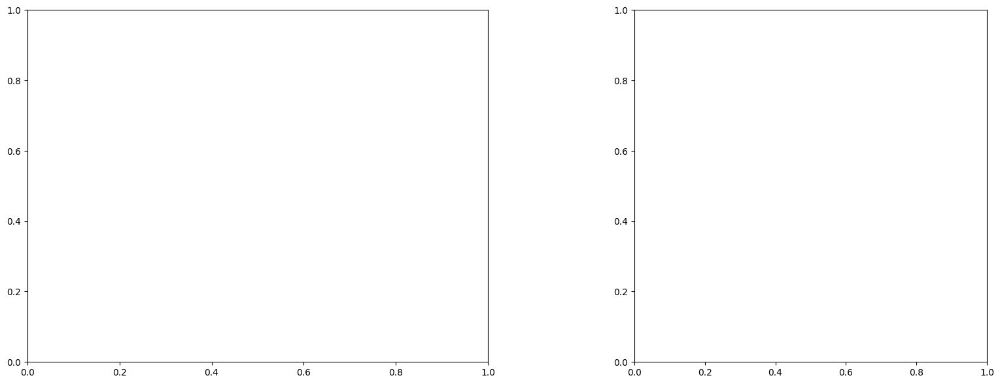

LinAlgError: Singular matrix

box [8500, 9200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

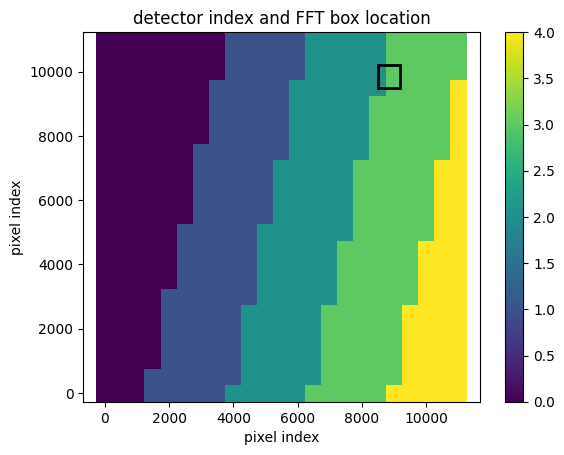

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(43, 43)
(43, 43)
(43, 43)


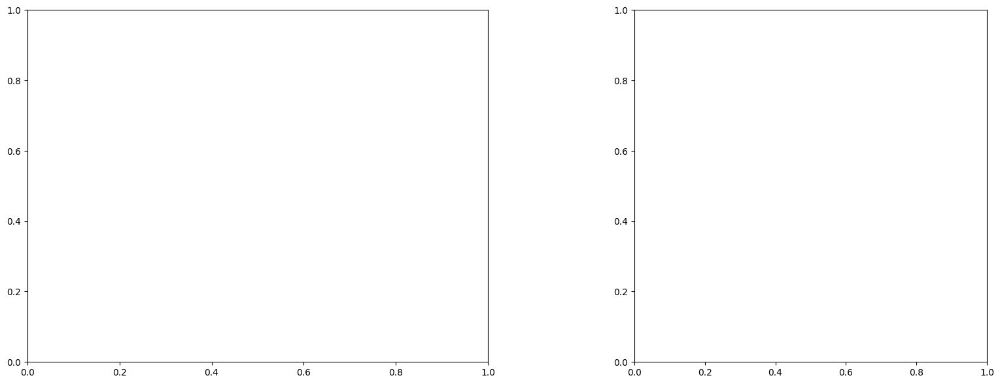

LinAlgError: Singular matrix

box [8500, 9200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

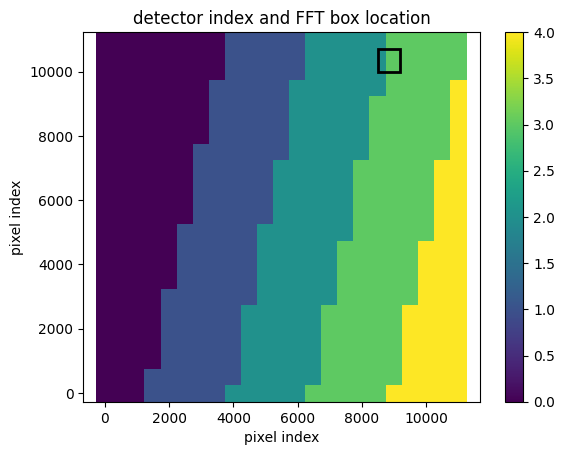

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


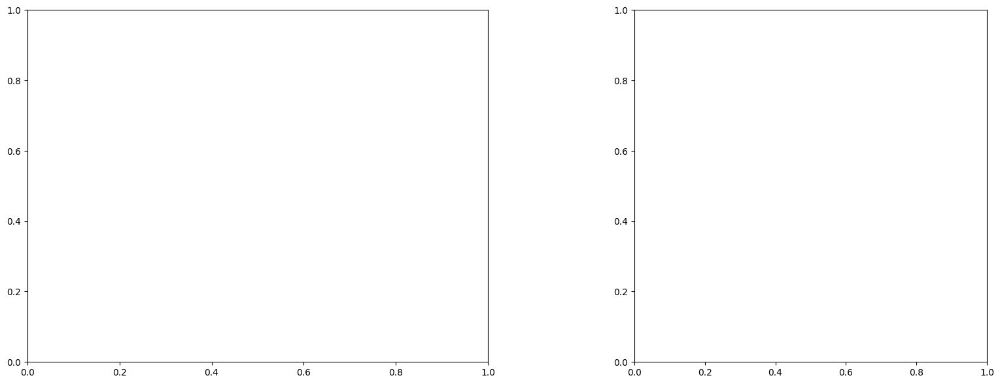

LinAlgError: Singular matrix

box [8500, 9200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

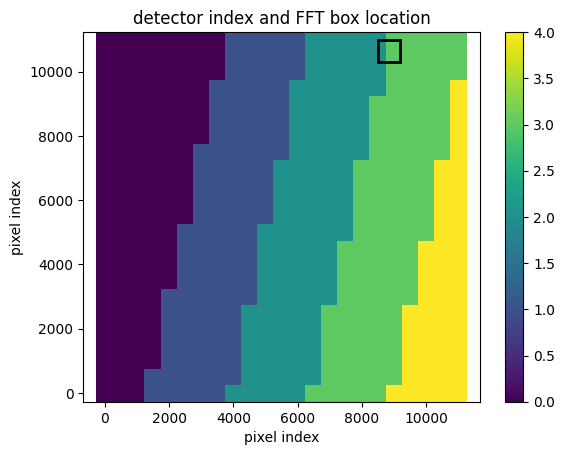

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.6999999999999997
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(43, 42)
(43, 42)
(43, 42)


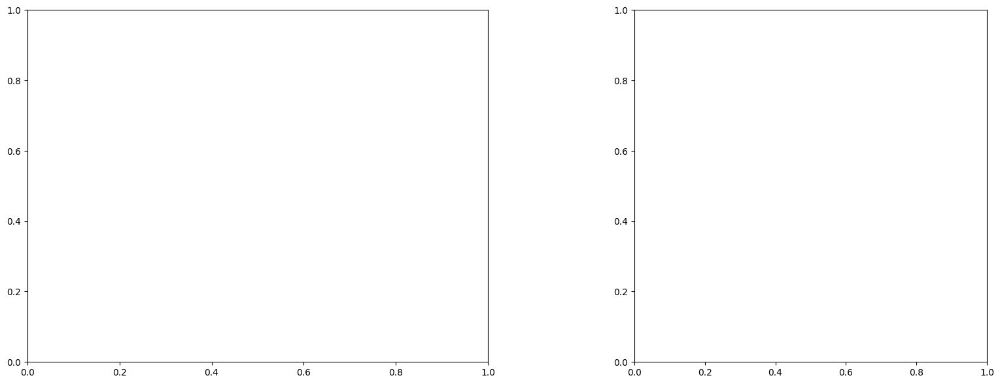

LinAlgError: Singular matrix

box [9000, 9700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fil

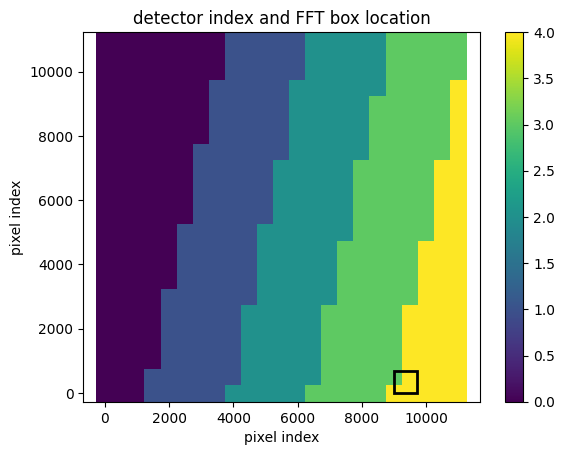

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.7
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(43, 43)
(43, 43)
(43, 43)


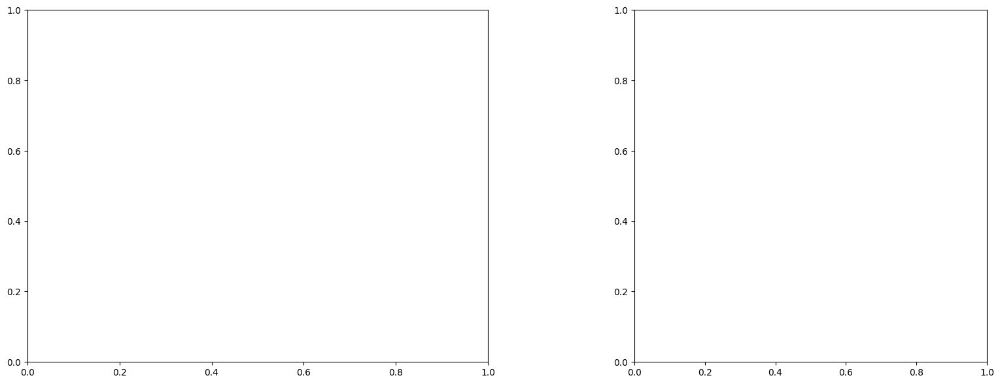

LinAlgError: Singular matrix

box [9000, 9700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading 

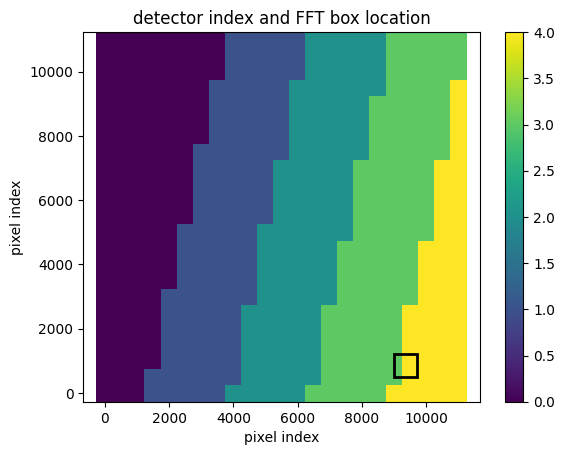

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(43, 43)
(43, 43)
(43, 43)


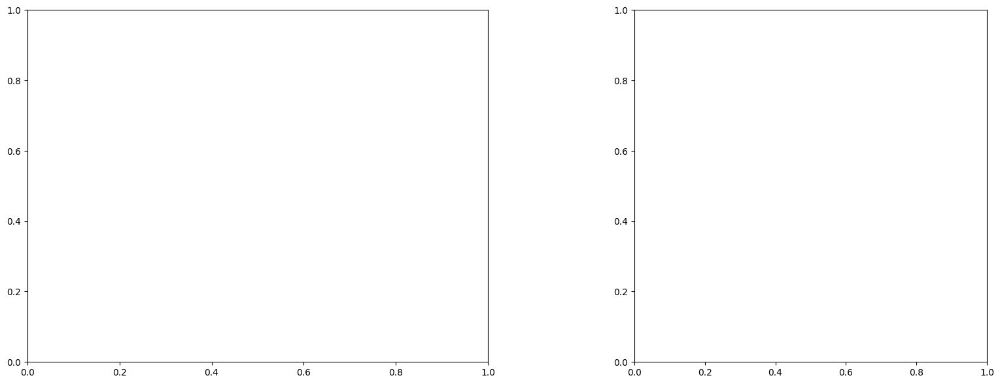

LinAlgError: Singular matrix

box [9000, 9700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

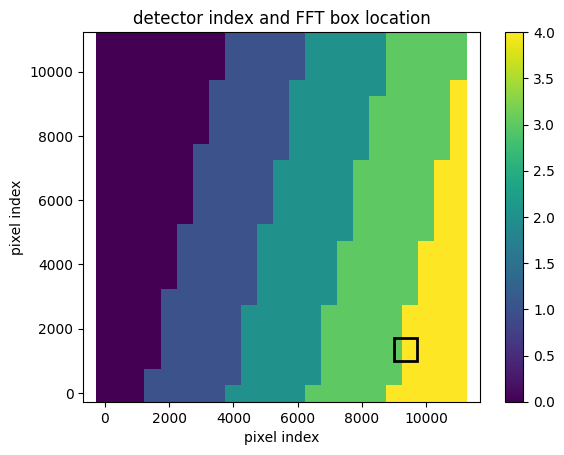

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(43, 43)
(43, 43)
(43, 43)


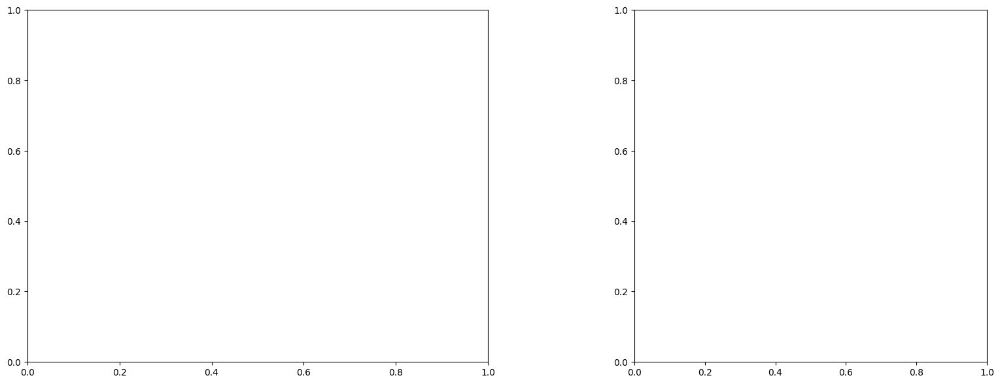

LinAlgError: Singular matrix

box [9000, 9700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

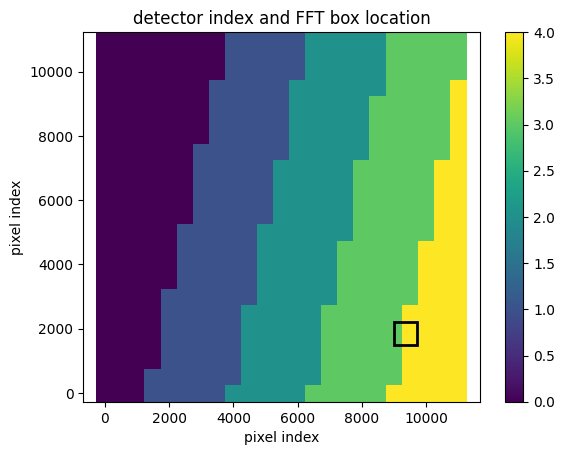

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.7
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(43, 43)
(43, 43)
(43, 43)


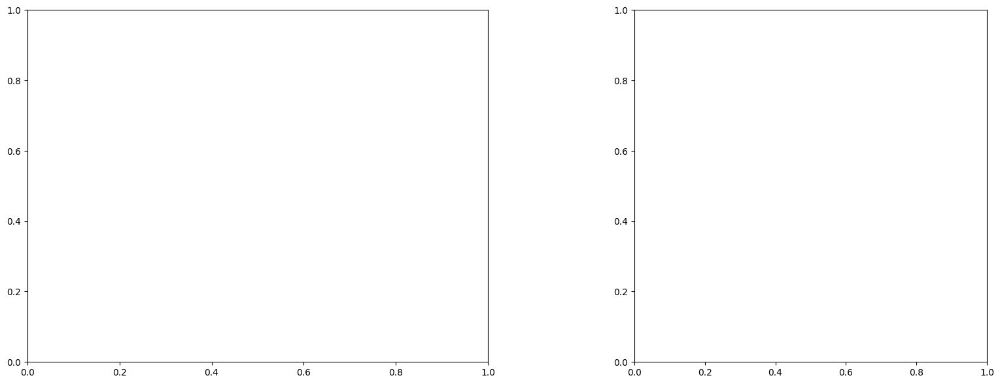

LinAlgError: Singular matrix

box [9000, 9700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

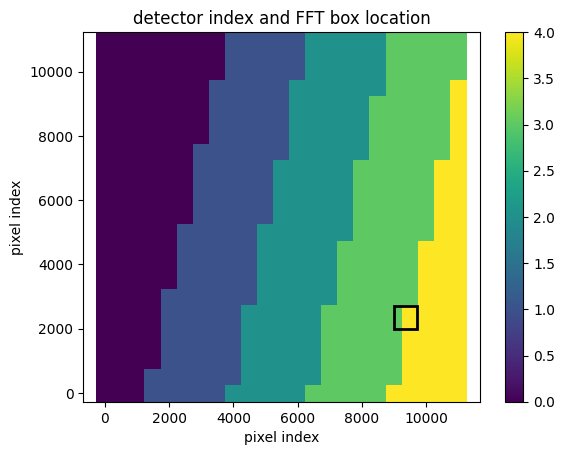

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986839558703013
(43, 43)
(43, 43)
(43, 43)


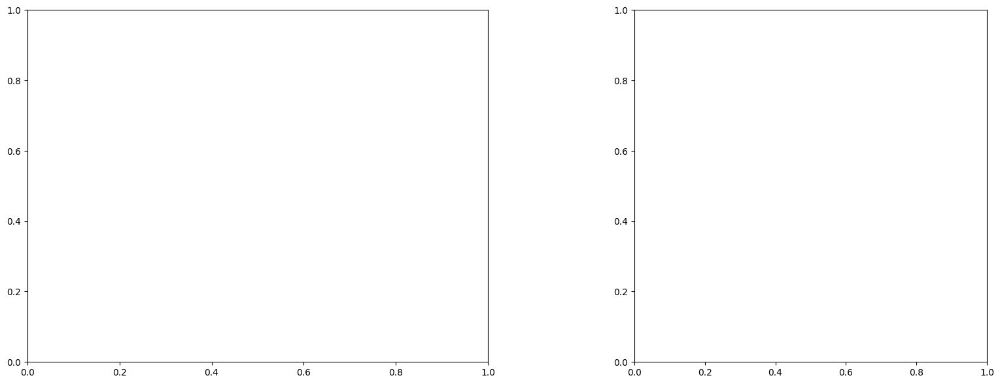

LinAlgError: Singular matrix

box [9000, 9700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

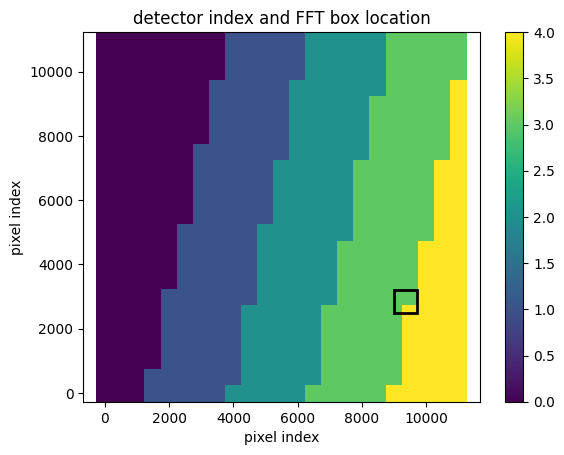

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947466130278743
(43, 43)
(43, 43)
(43, 43)


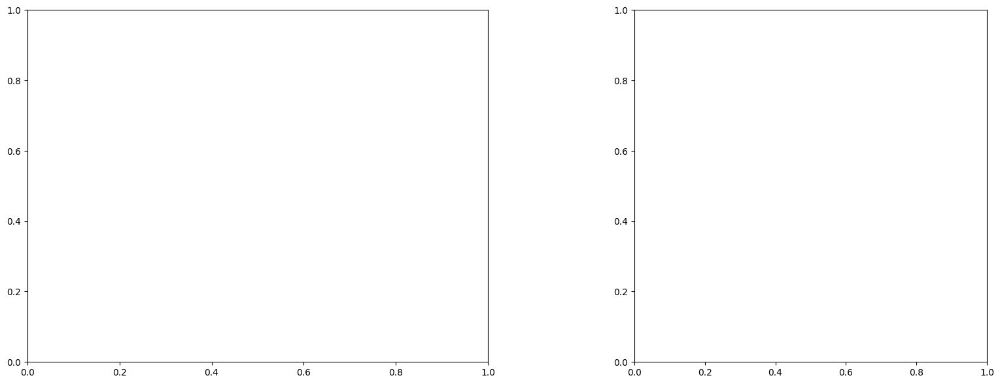

U and V components of current : [-0.34635669 -1.83258675]
uncertainties for U and V: 0.07328019733104185 0.058758991285965075


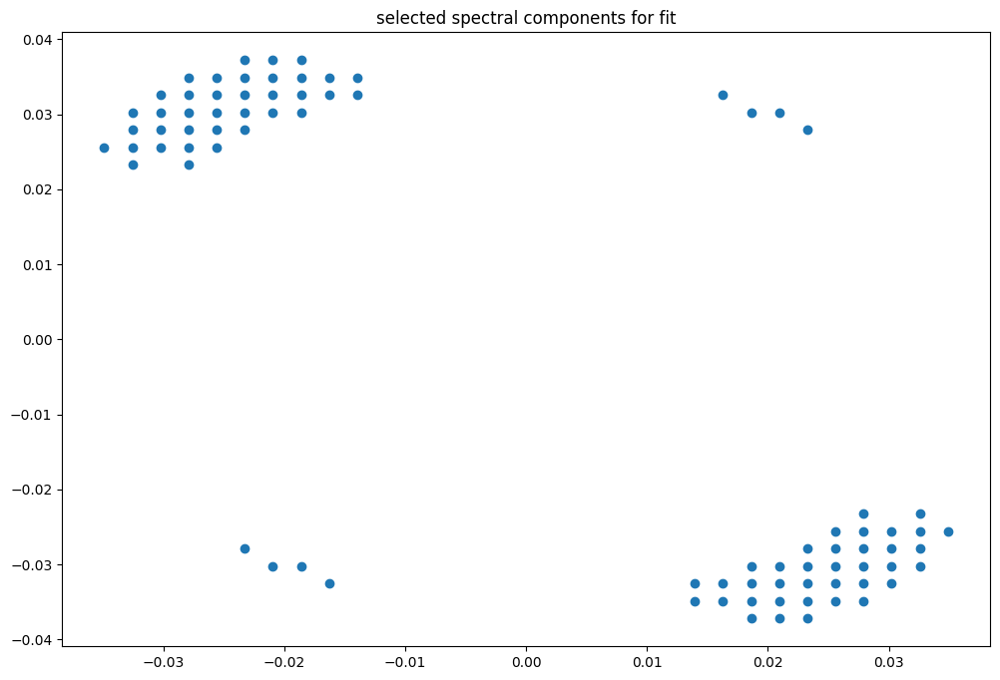

box [9000, 9700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

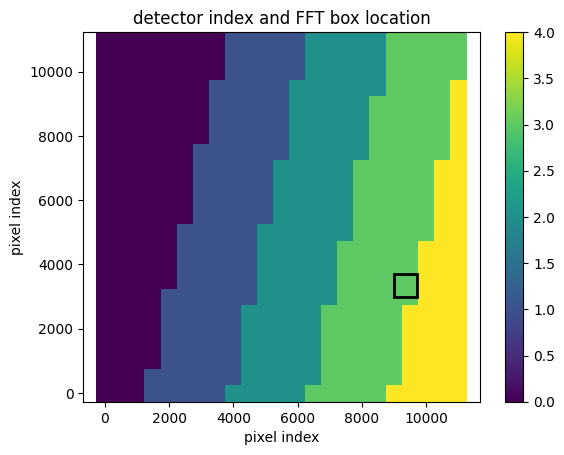

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947440269132112
(43, 43)
(43, 43)
(43, 43)


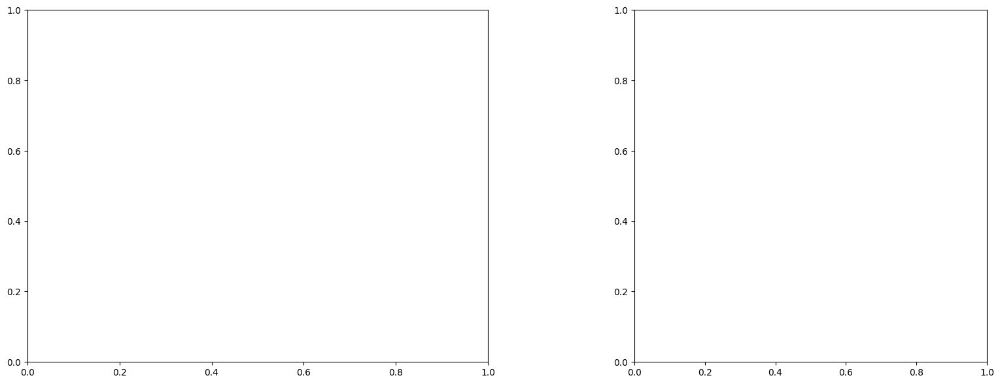

U and V components of current : [-0.22144078 -1.64447844]
uncertainties for U and V: 0.05293675945080031 0.04226464539905838


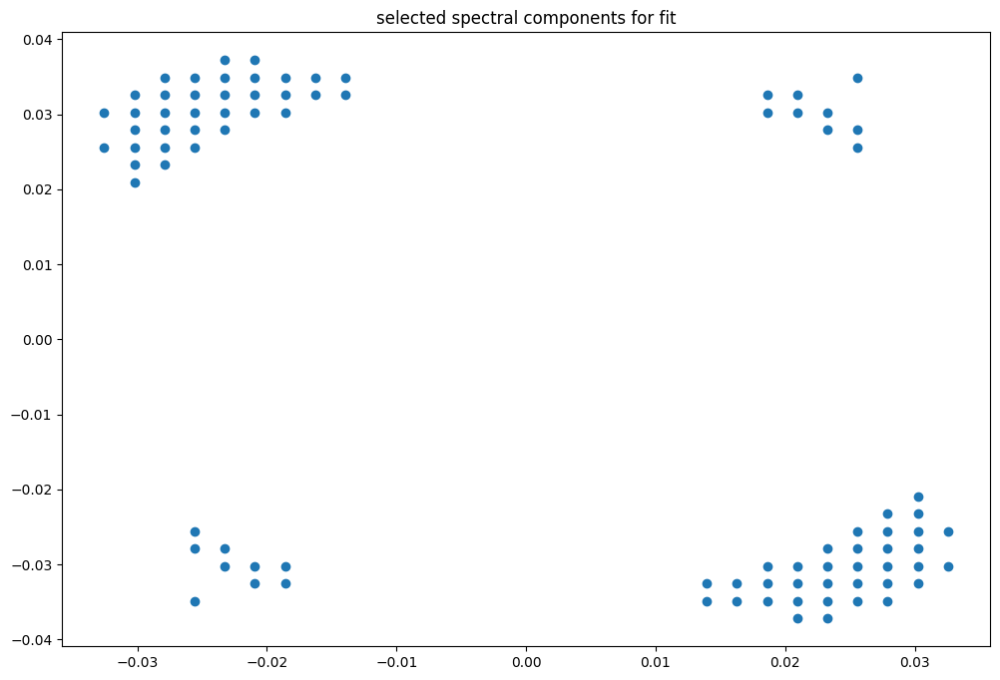

box [9000, 9700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

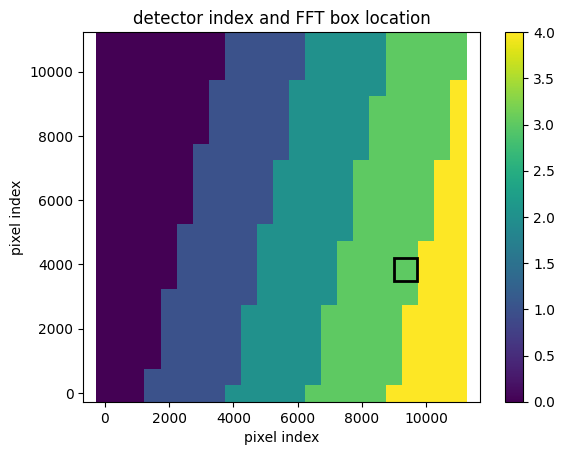

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947417569917094
(43, 43)
(43, 43)
(43, 43)


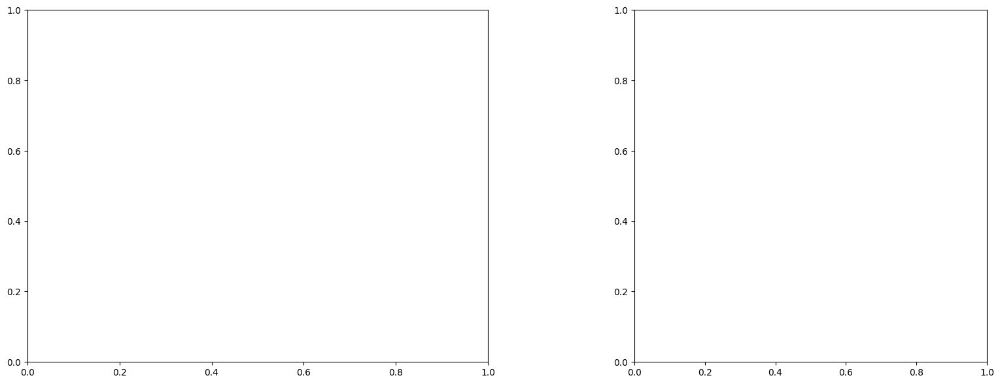

U and V components of current : [-0.08601308 -1.70293072]
uncertainties for U and V: 0.054046706286236576 0.046012374346502745


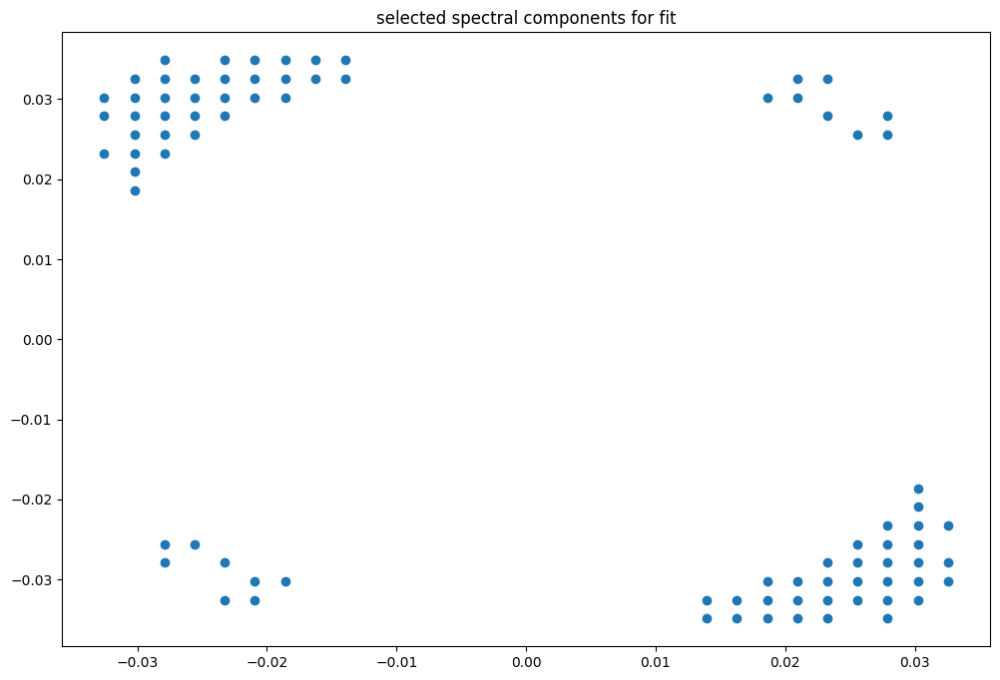

box [9000, 9700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

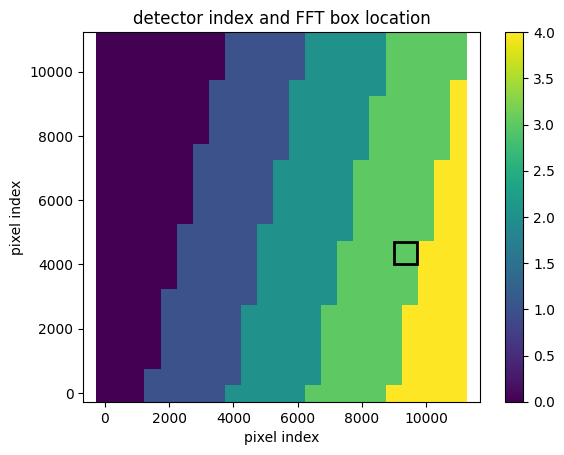

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


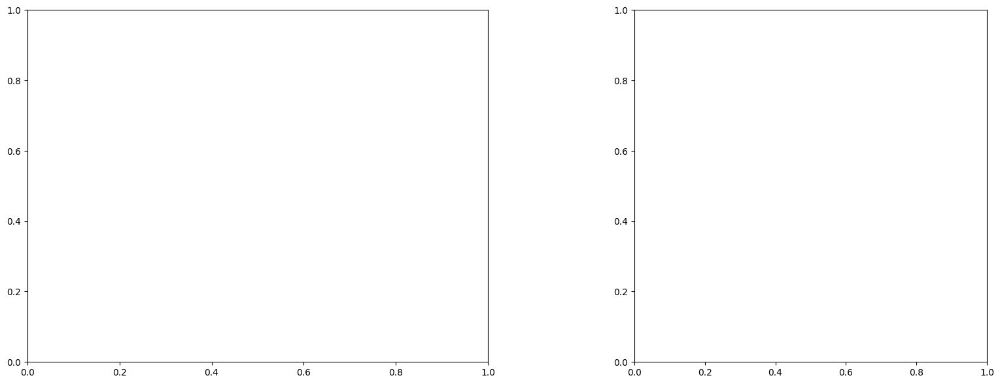

U and V components of current : [-0.18075316 -1.61431615]
uncertainties for U and V: 0.04931101087927602 0.03988010804837558


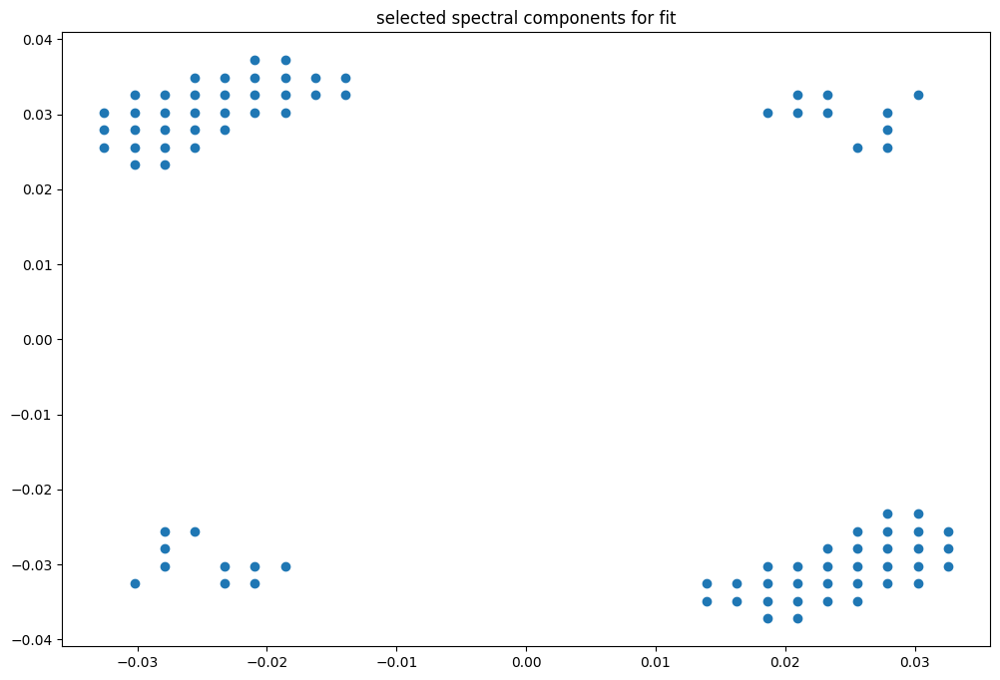

box [9000, 9700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

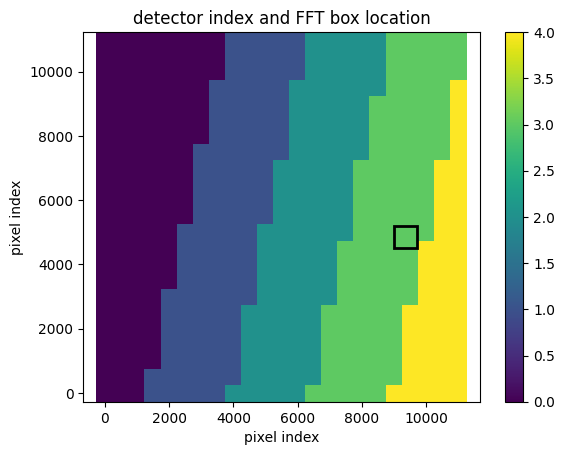

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


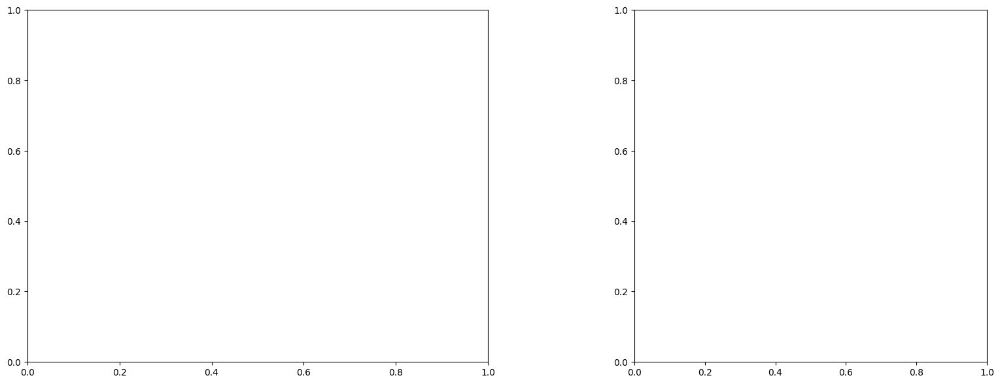

U and V components of current : [-0.26847509 -1.49835764]
uncertainties for U and V: 0.03726390056633159 0.03123805239266702


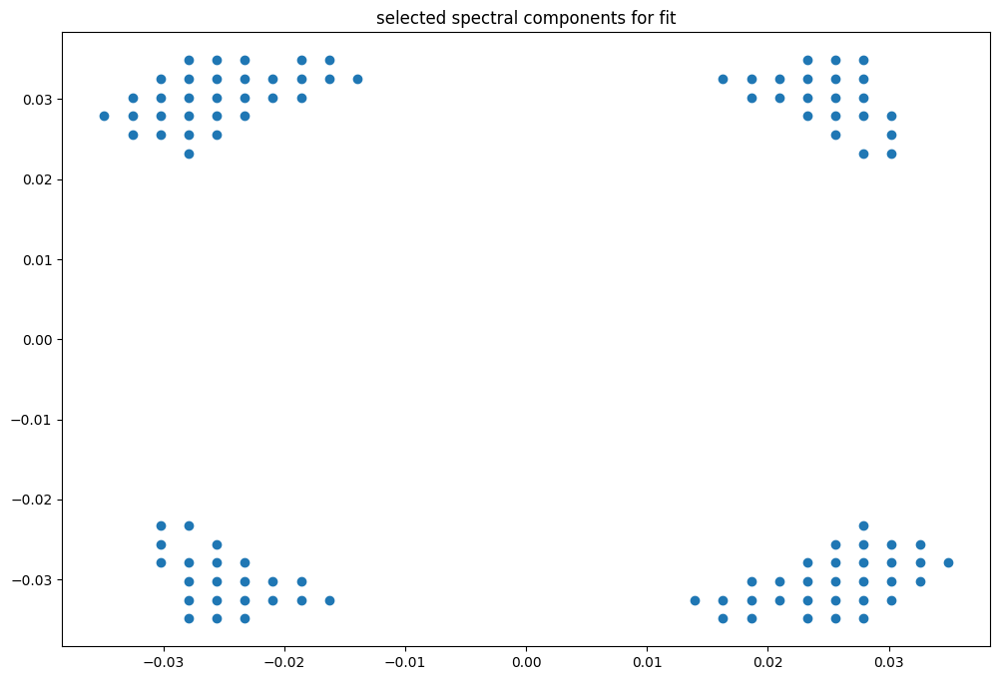

box [9000, 9700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

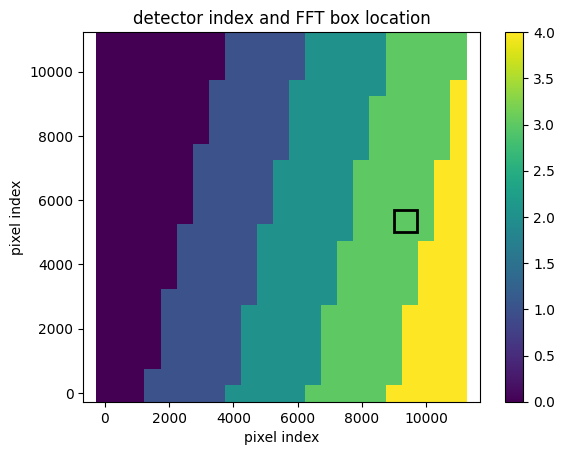

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


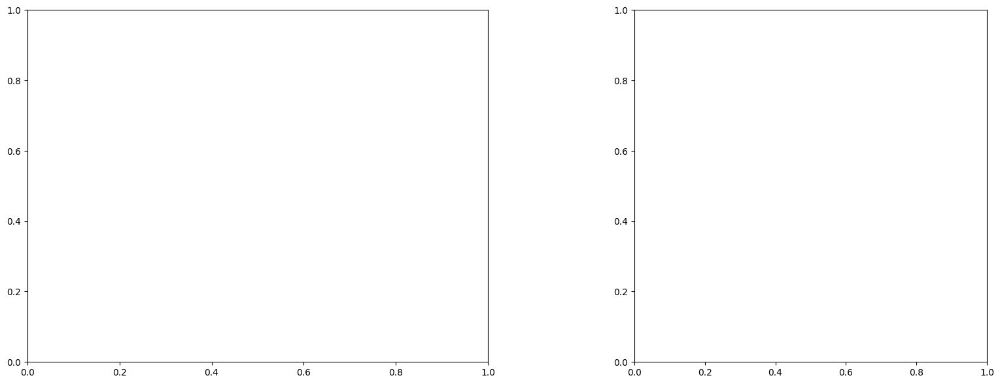

U and V components of current : [-0.15519124 -1.50437887]
uncertainties for U and V: 0.04767801788565885 0.0407809064522095


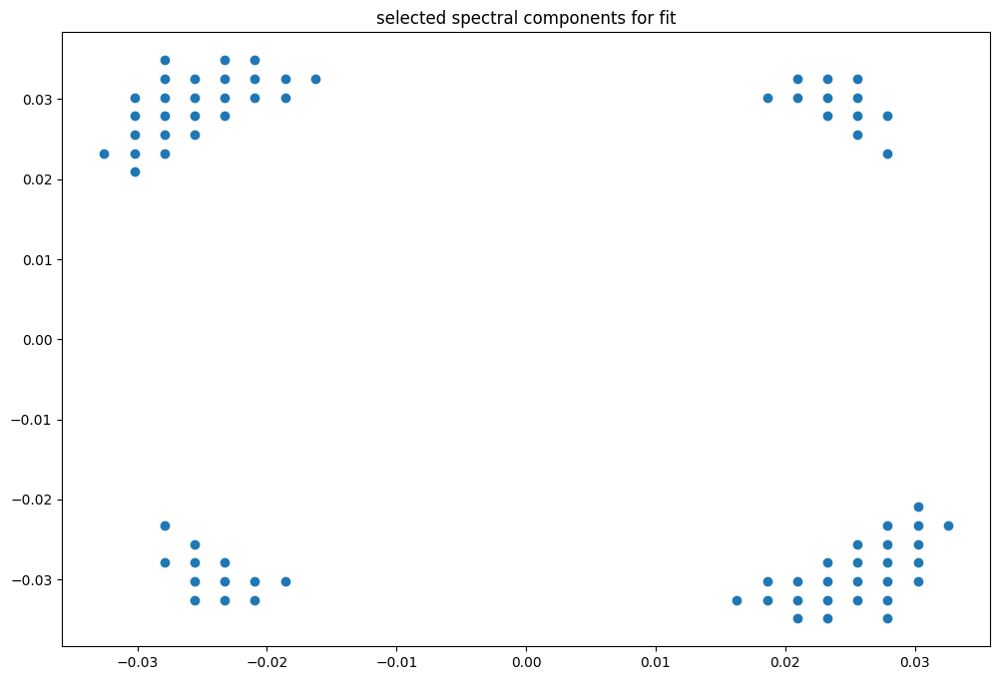

box [9000, 9700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

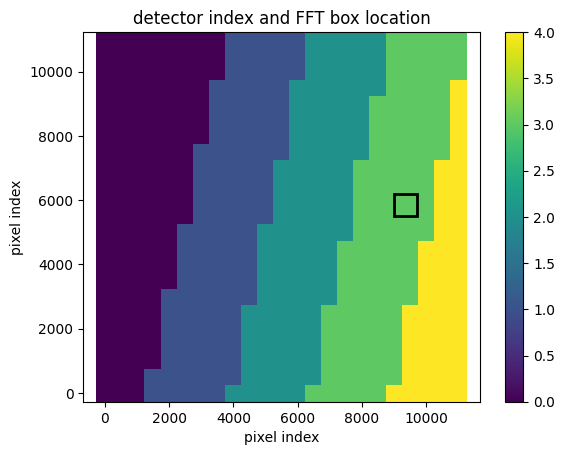

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


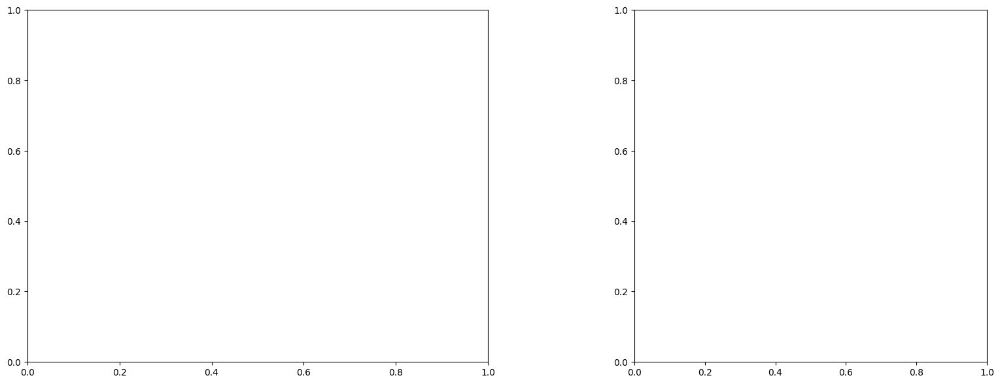

U and V components of current : [-0.35546498 -1.6090789 ]
uncertainties for U and V: 0.03855862389240598 0.03348120206499892


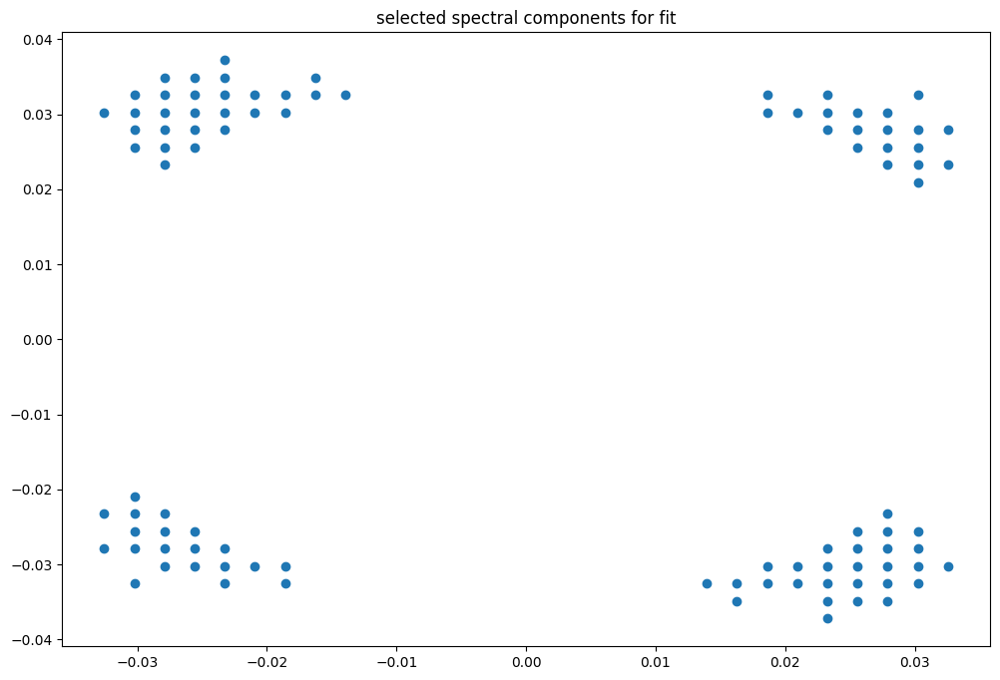

box [9000, 9700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

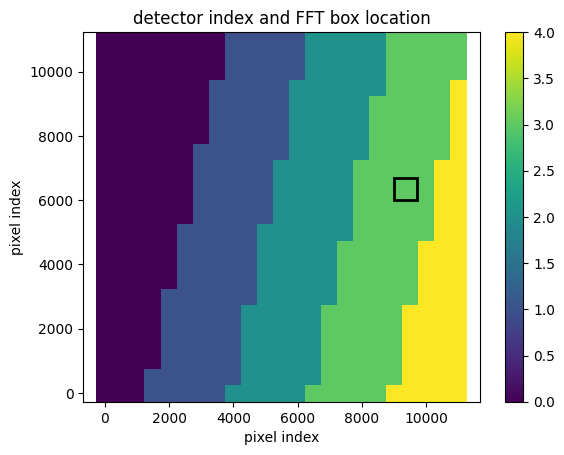

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


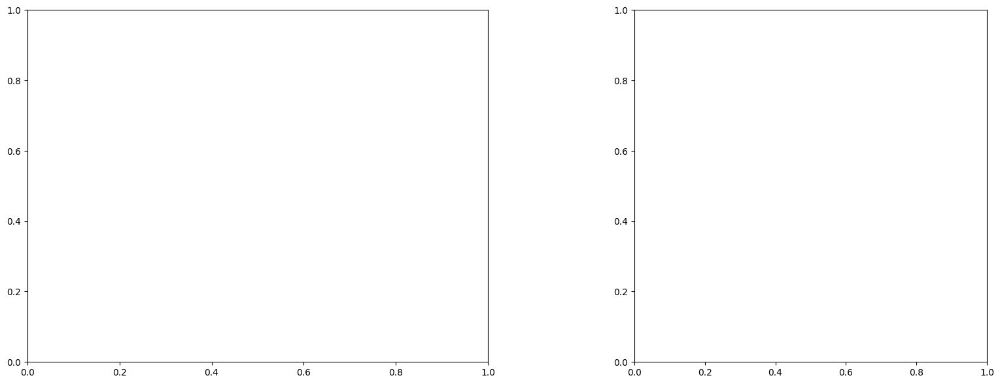

U and V components of current : [-0.16555604 -1.6892208 ]
uncertainties for U and V: 0.03586577528386452 0.03159190168598116


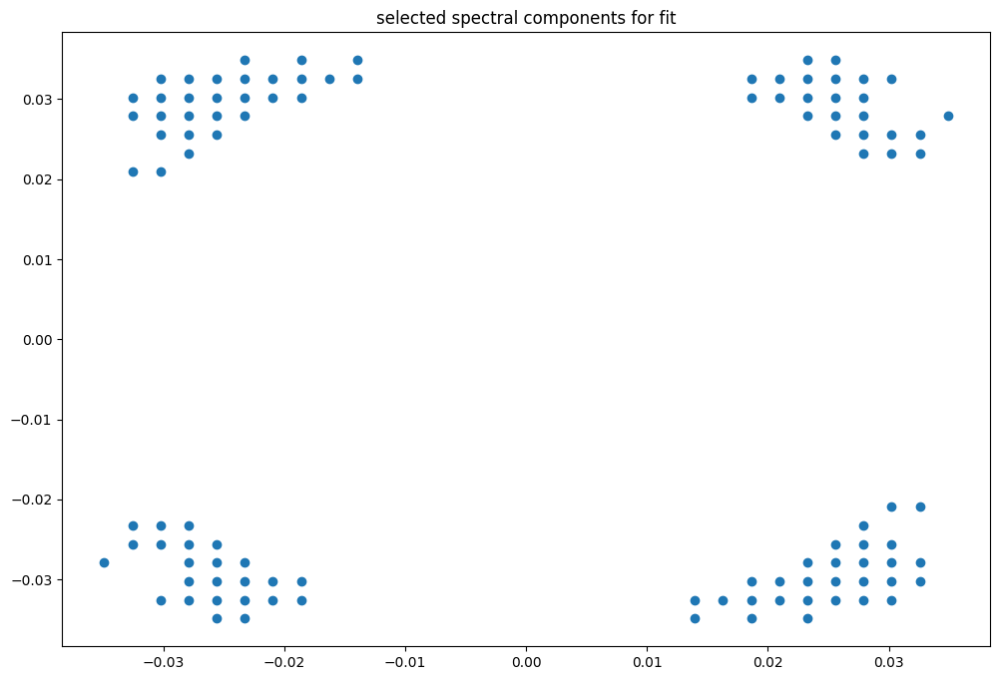

box [9000, 9700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

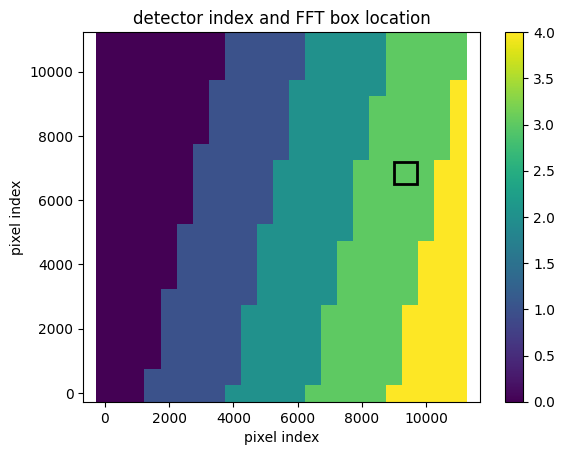

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


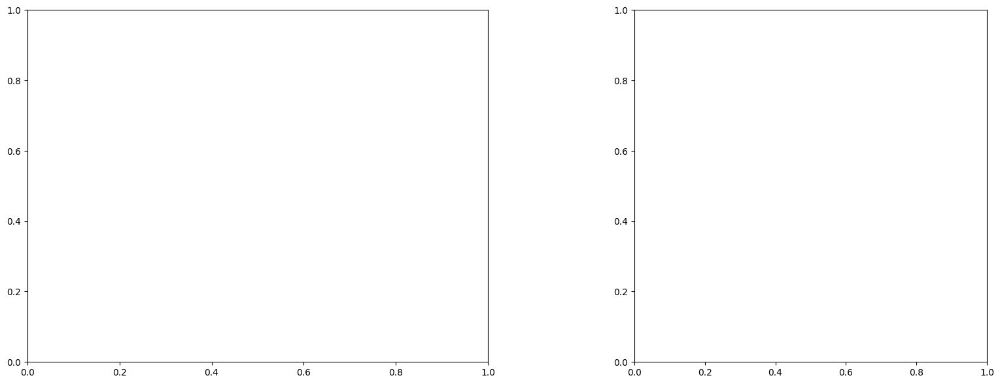

U and V components of current : [-0.16697762 -1.51428241]
uncertainties for U and V: 0.04223516261839759 0.037344695751803304


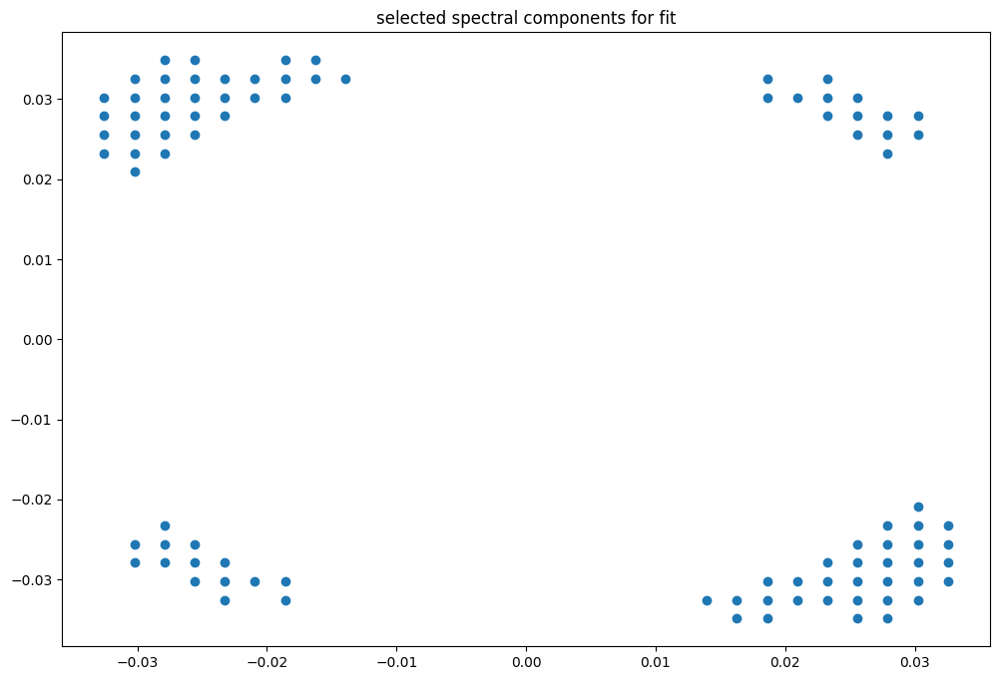

box [9000, 9700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

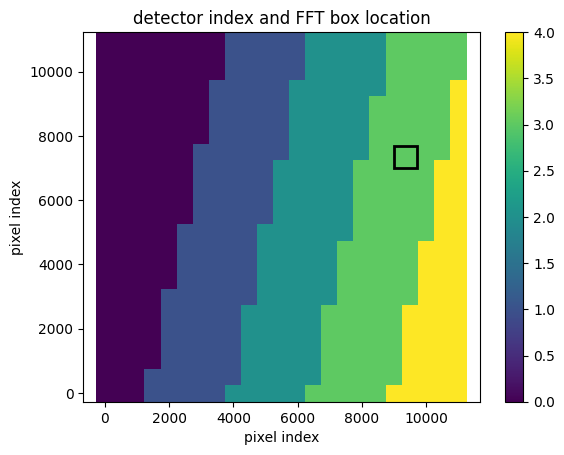

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


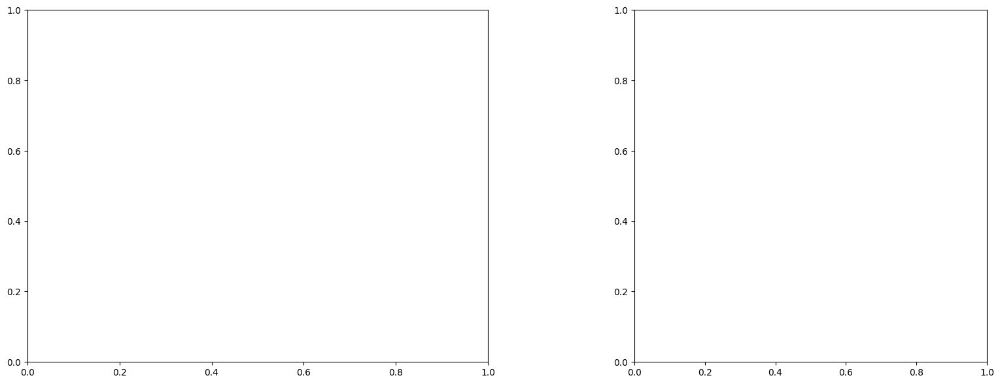

U and V components of current : [-0.21902714 -1.60650196]
uncertainties for U and V: 0.04211721494189902 0.03726933362332388


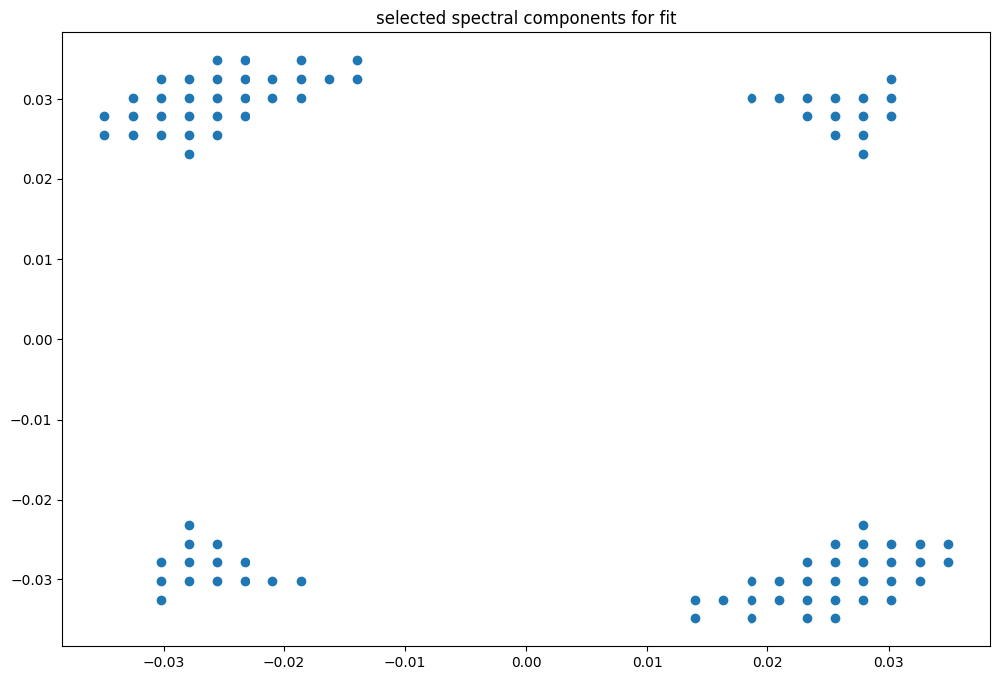

box [9000, 9700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

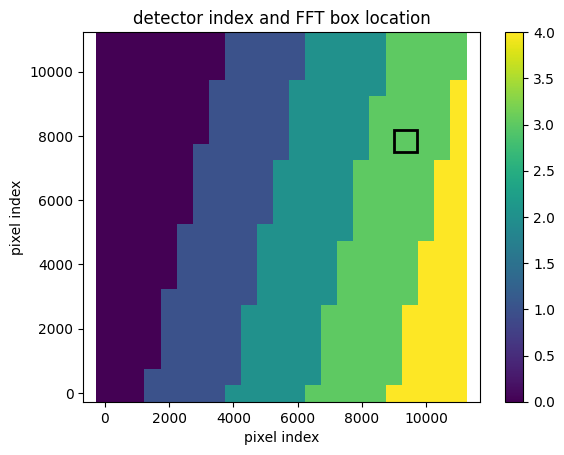

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


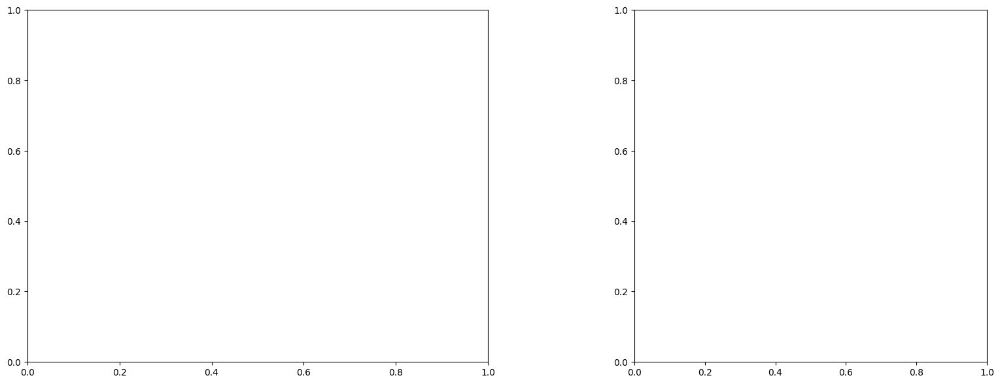

U and V components of current : [-0.22651821 -1.40306997]
uncertainties for U and V: 0.04466628814456154 0.039128940100524236


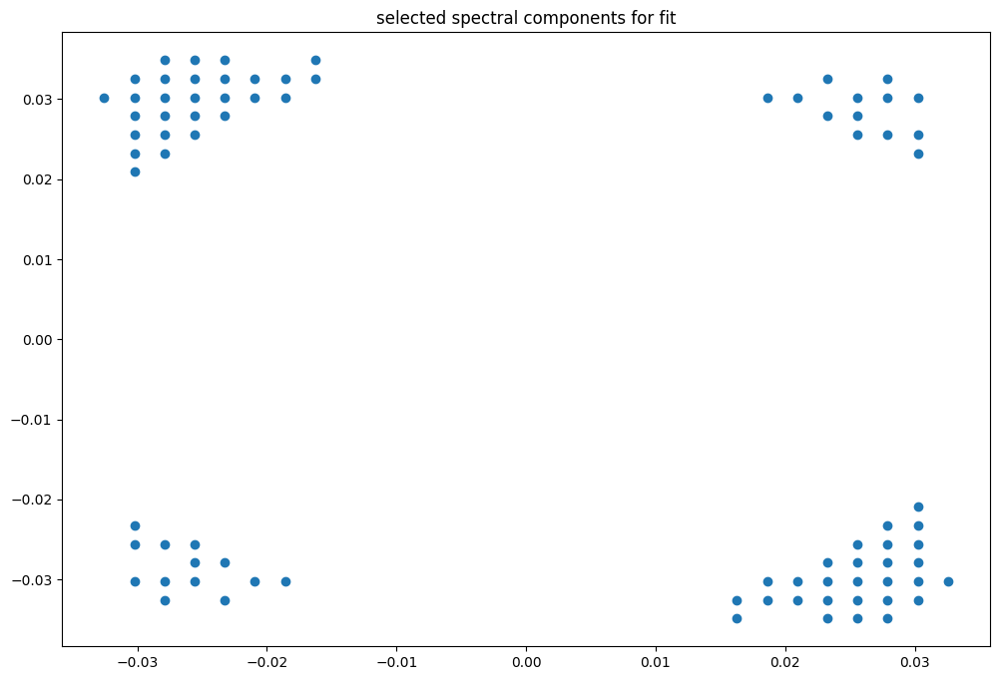

box [9000, 9700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

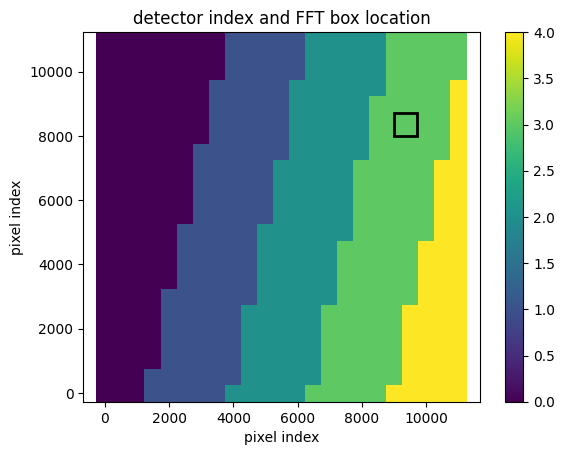

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


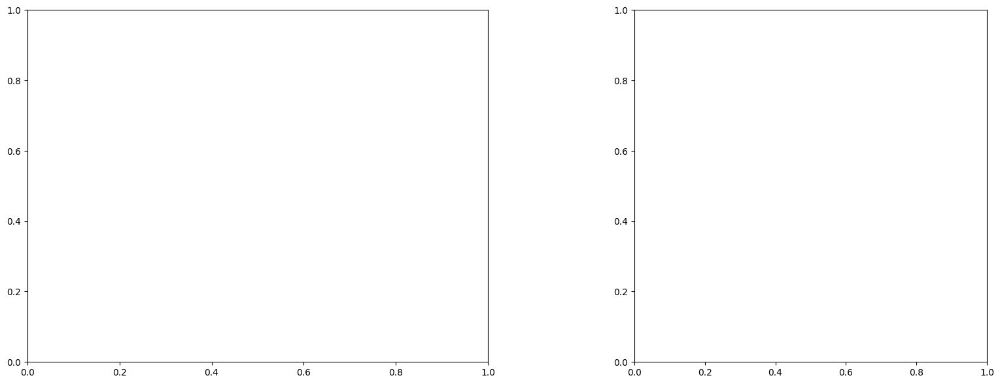

U and V components of current : [ 0.10875894 -1.35756912]
uncertainties for U and V: 0.043459290351095414 0.038476421118659655


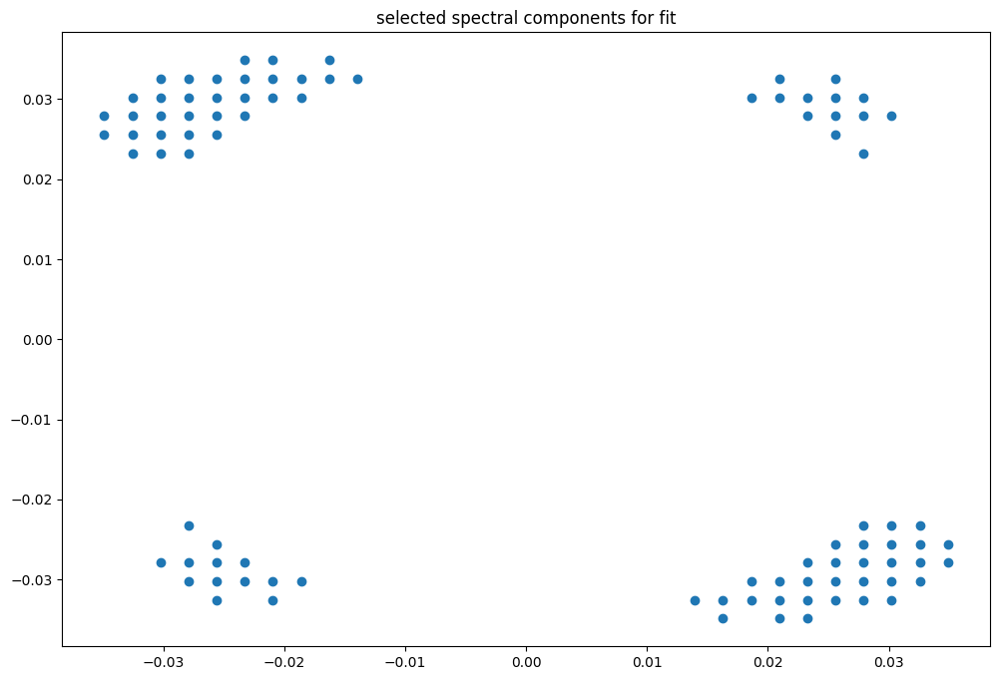

box [9000, 9700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

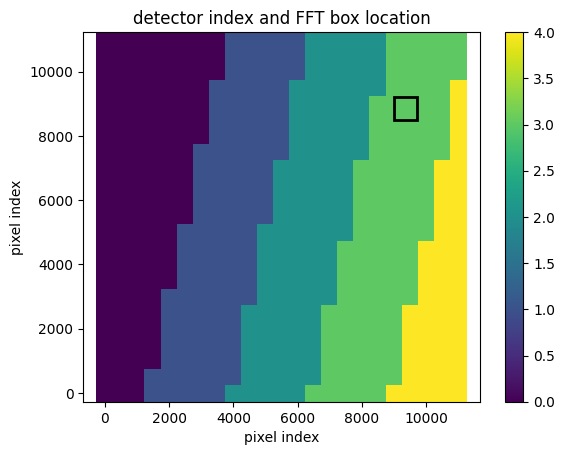

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


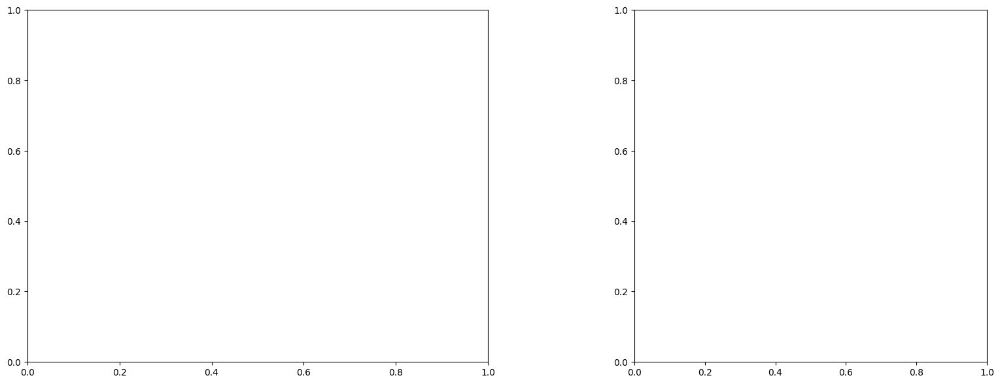

U and V components of current : [-0.33836942 -2.0714868 ]
uncertainties for U and V: 0.05417204140997969 0.049224382790165735


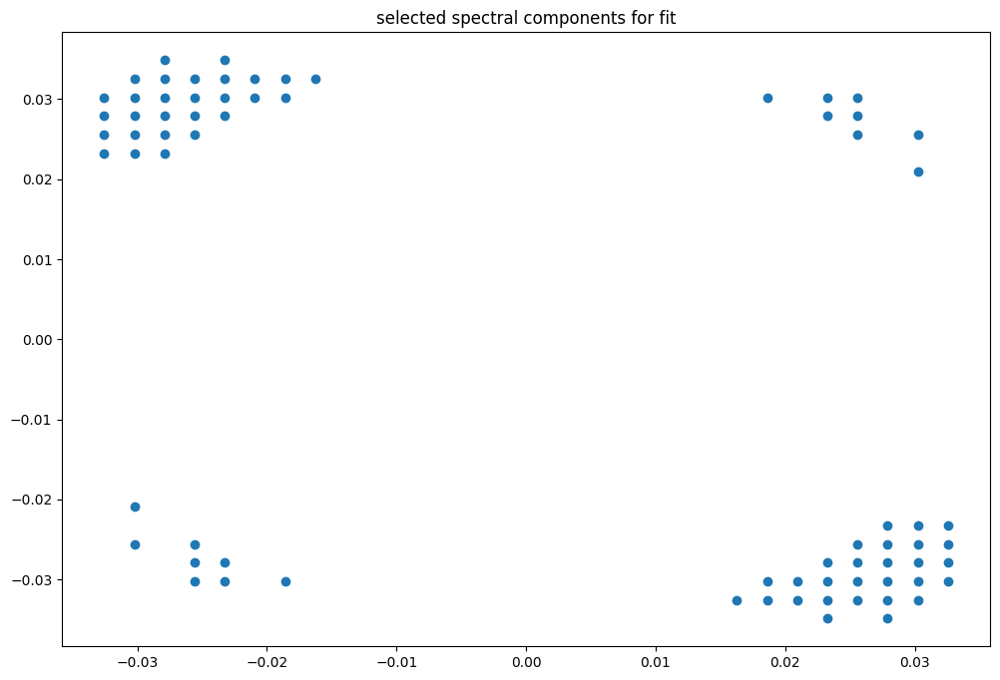

box [9000, 9700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

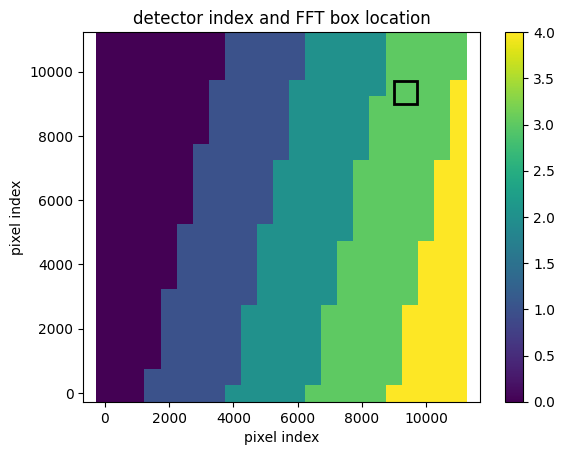

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(43, 43)
(43, 43)
(43, 43)


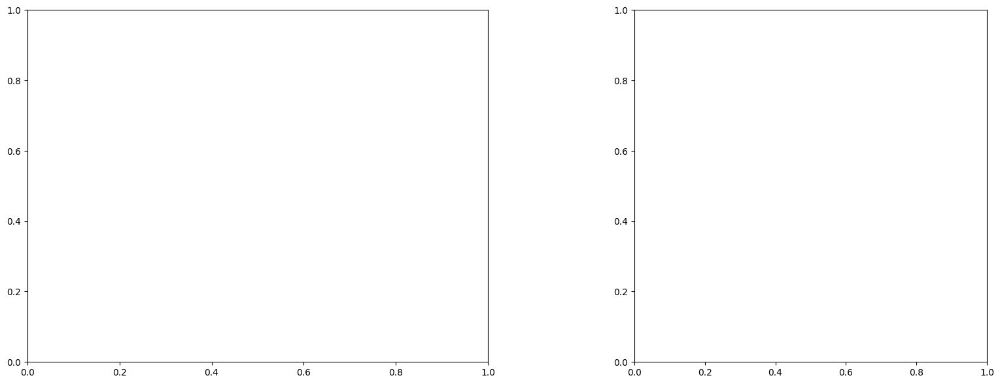

U and V components of current : [-0.40224723 -1.99716865]
uncertainties for U and V: 0.04575961087956633 0.04236989176802408


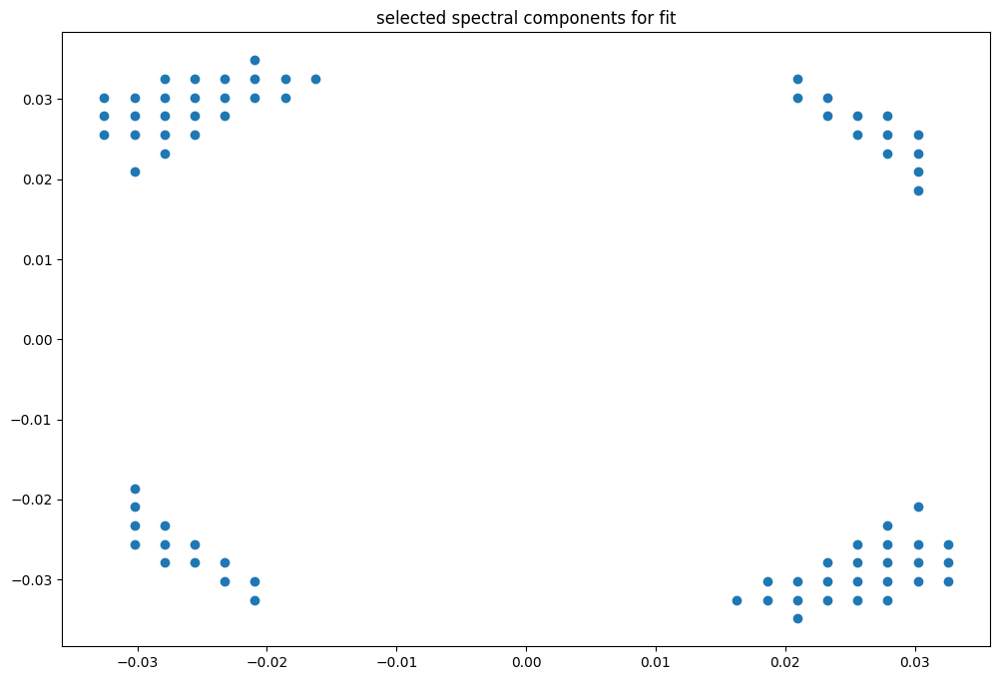

box [9000, 9700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

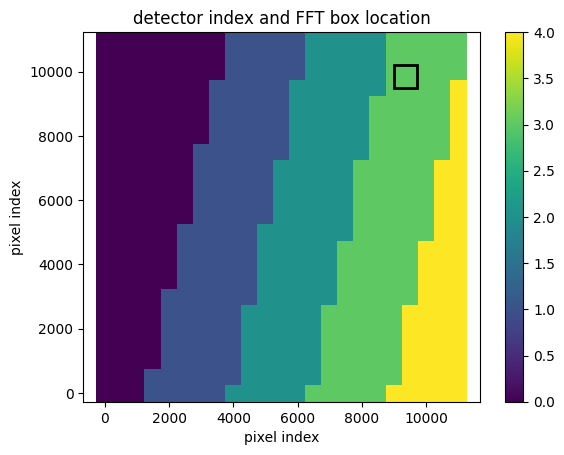

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


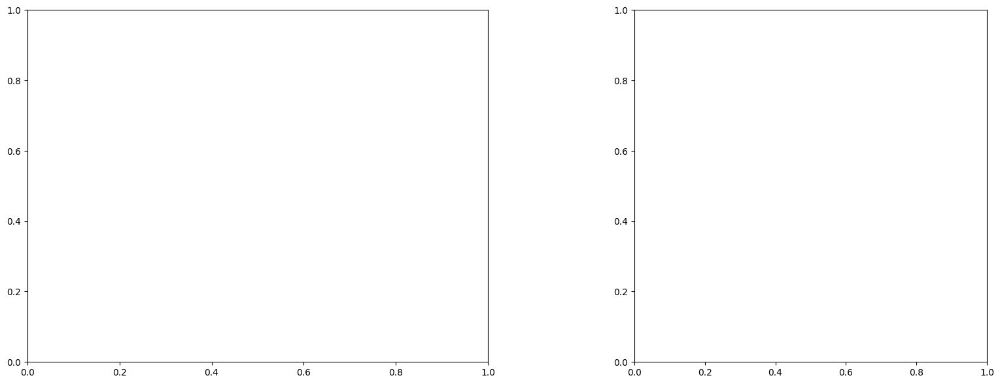

U and V components of current : [-0.33694805 -2.10480626]
uncertainties for U and V: 0.06602488855501802 0.059658569399878666


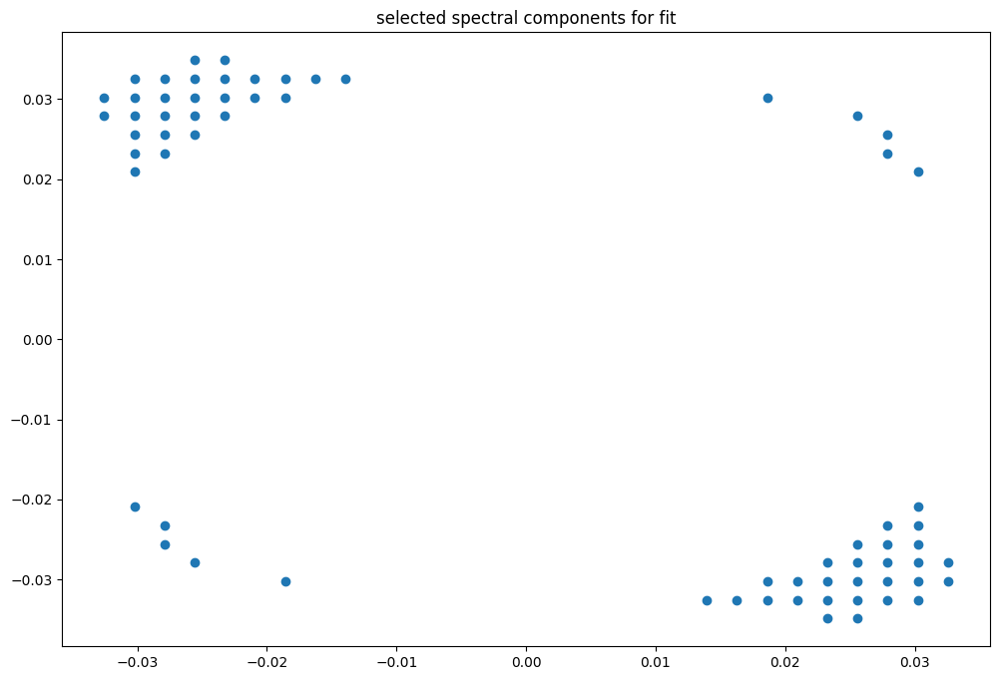

box [9000, 9700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

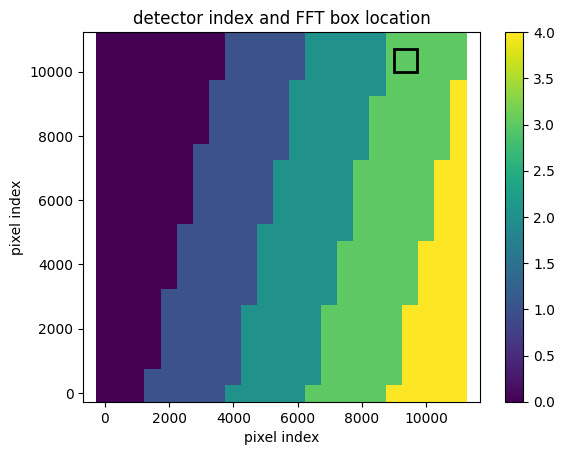

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


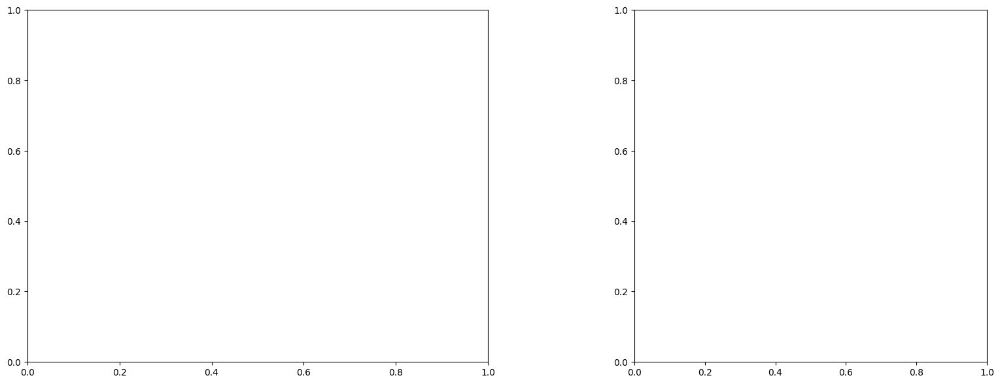

U and V components of current : [-0.09183652 -1.69306271]
uncertainties for U and V: 0.07814866517020817 0.07391295989724422


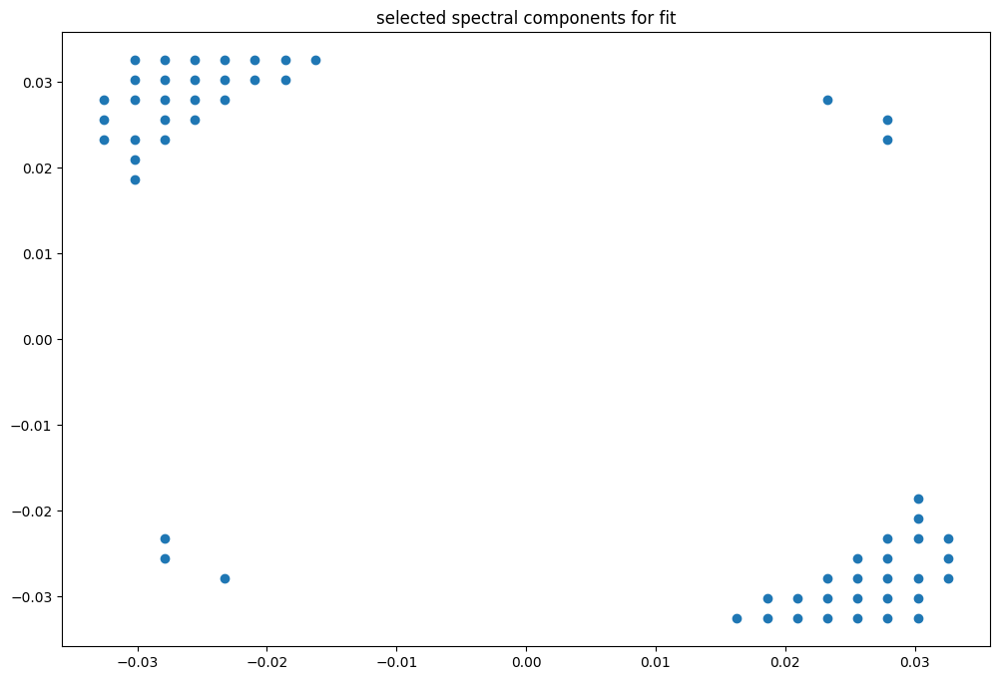

box [9000, 9700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

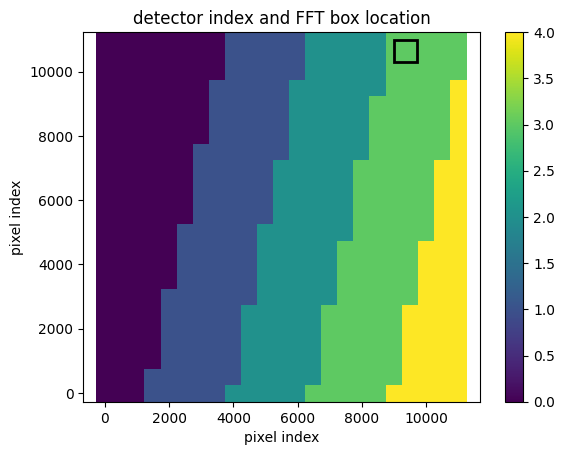

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(43, 42)
(43, 42)
(43, 42)


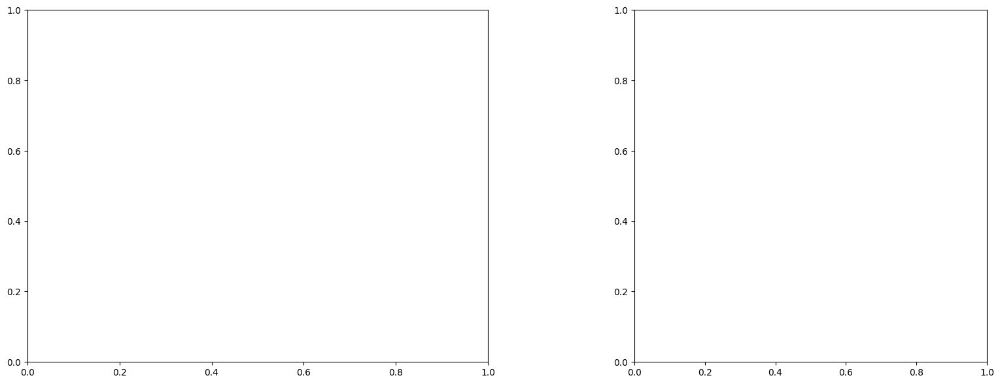

U and V components of current : [-0.31493071 -1.98036441]
uncertainties for U and V: 0.05138990359760392 0.048585099512770735


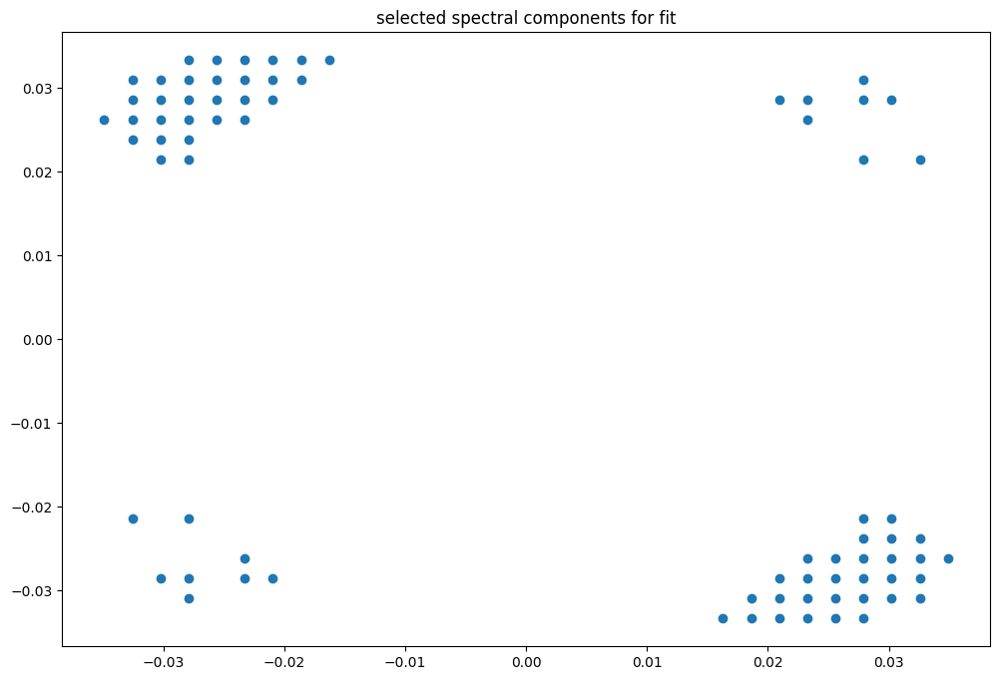

box [9500, 10200, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading fi

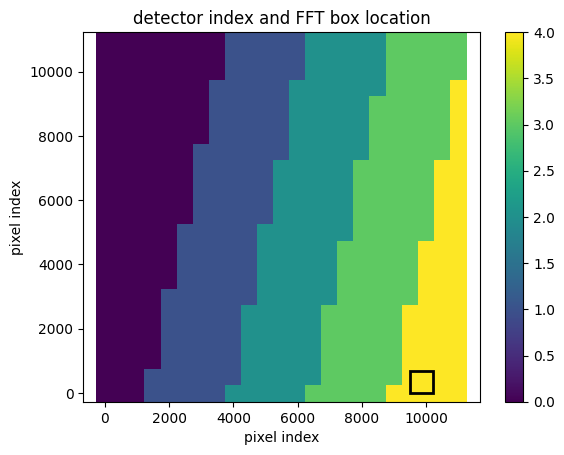

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(43, 43)
(43, 43)
(43, 43)


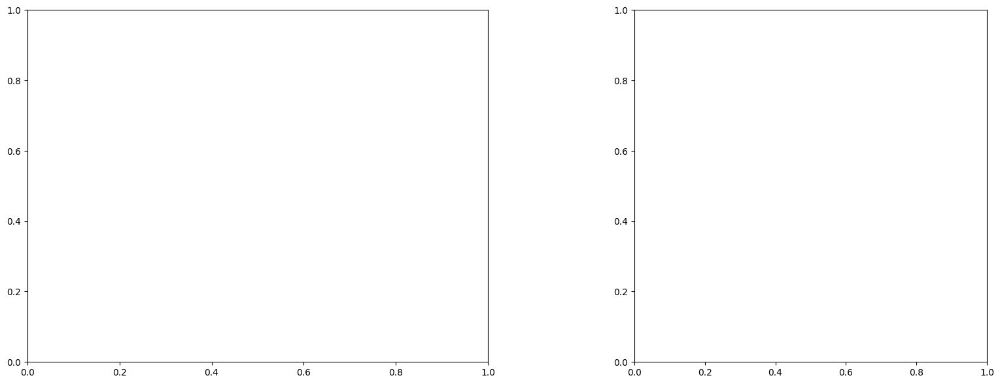

U and V components of current : [ 1.04485837 -0.13594065]
uncertainties for U and V: 0.04209630063142524 0.033366031069059415


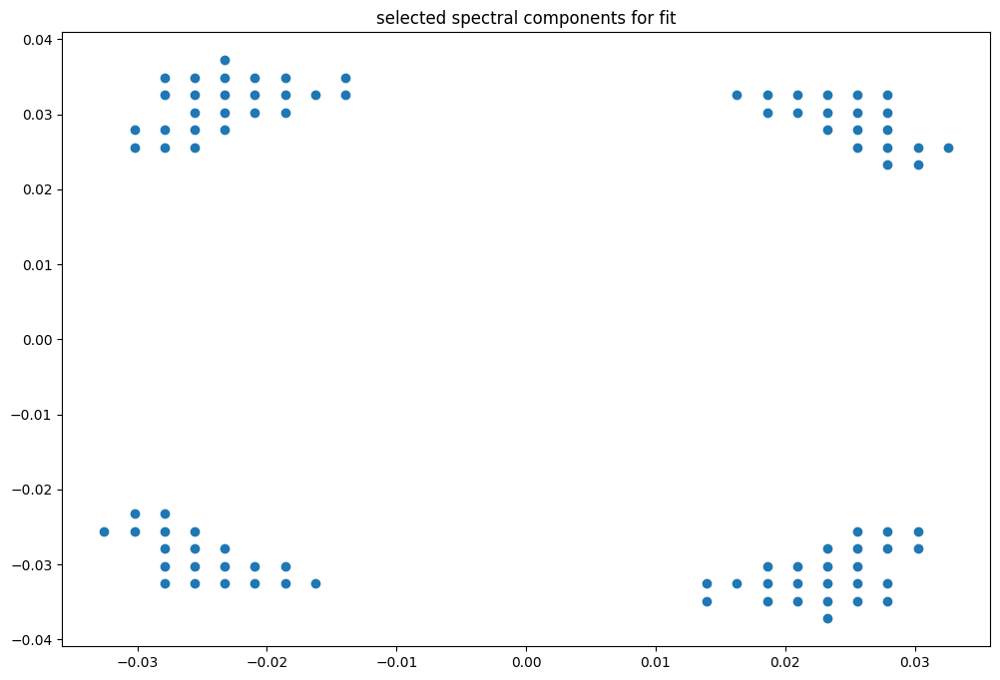

box [9500, 10200, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading

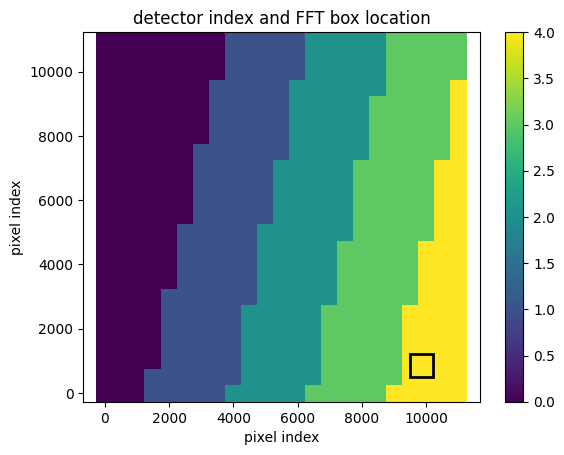

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(43, 43)
(43, 43)
(43, 43)


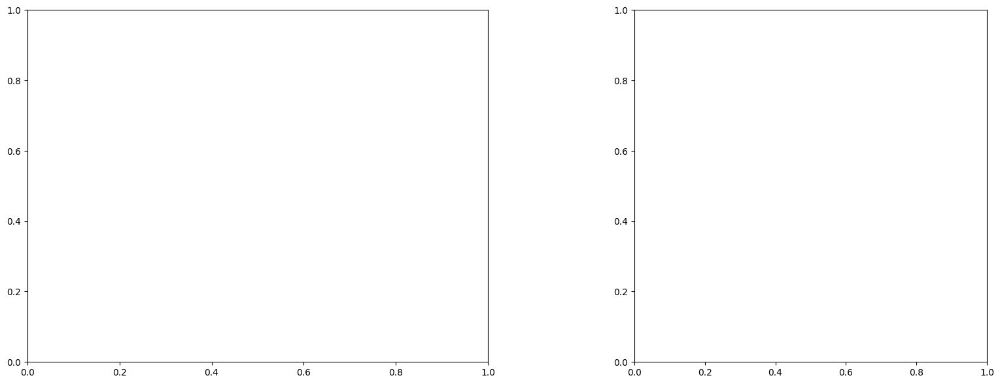

U and V components of current : [ 0.84339831 -0.21756732]
uncertainties for U and V: 0.04076891475511532 0.031042306739473127


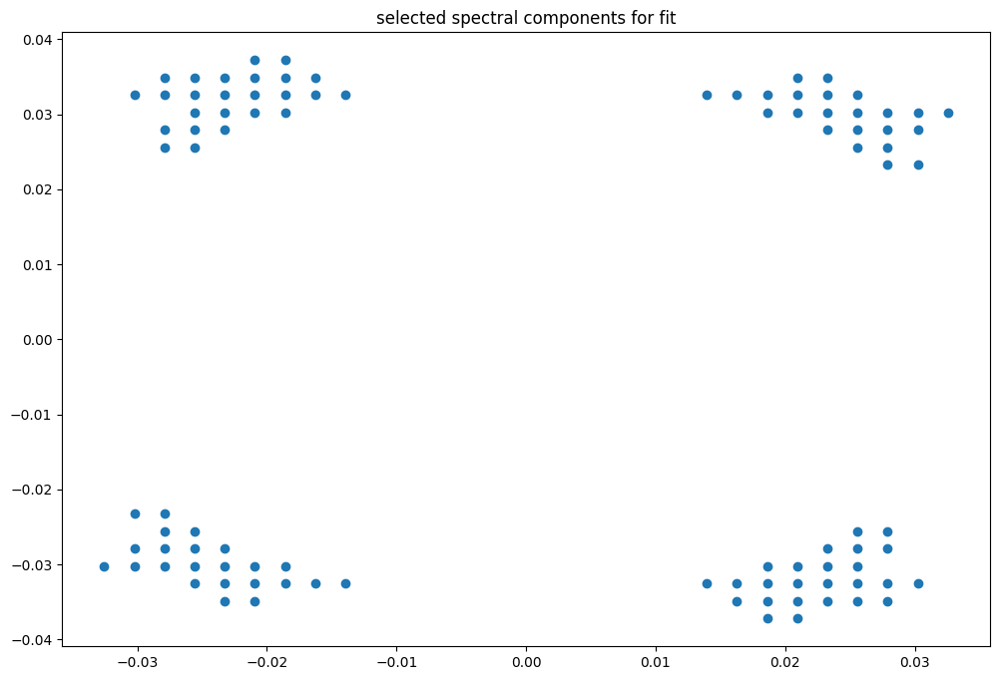

box [9500, 10200, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

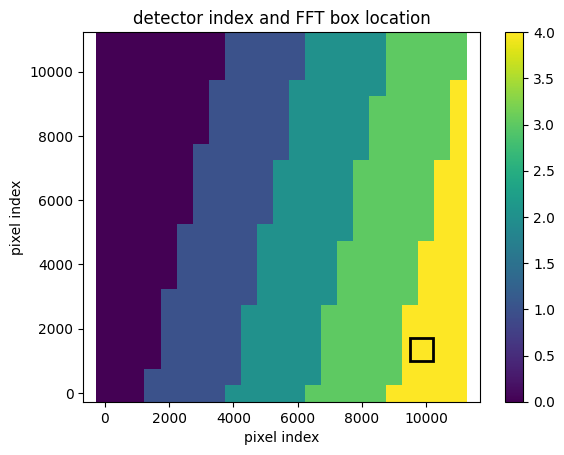

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(43, 43)
(43, 43)
(43, 43)


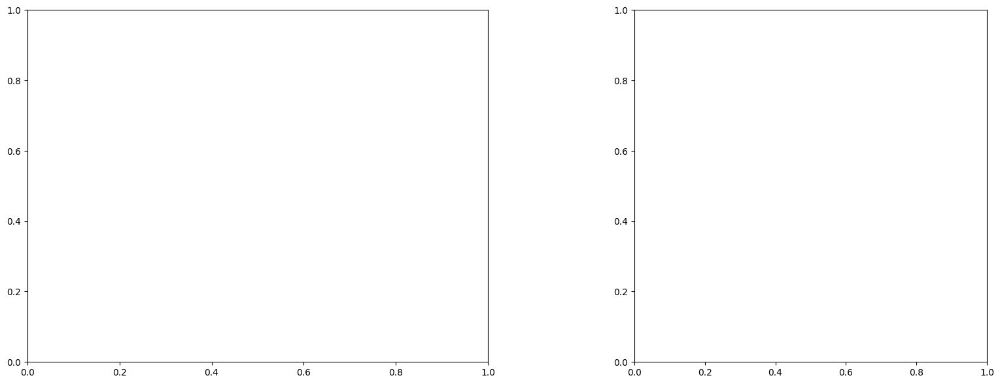

U and V components of current : [ 0.29271498 -0.37232949]
uncertainties for U and V: 0.05029731133586598 0.037064537360371685


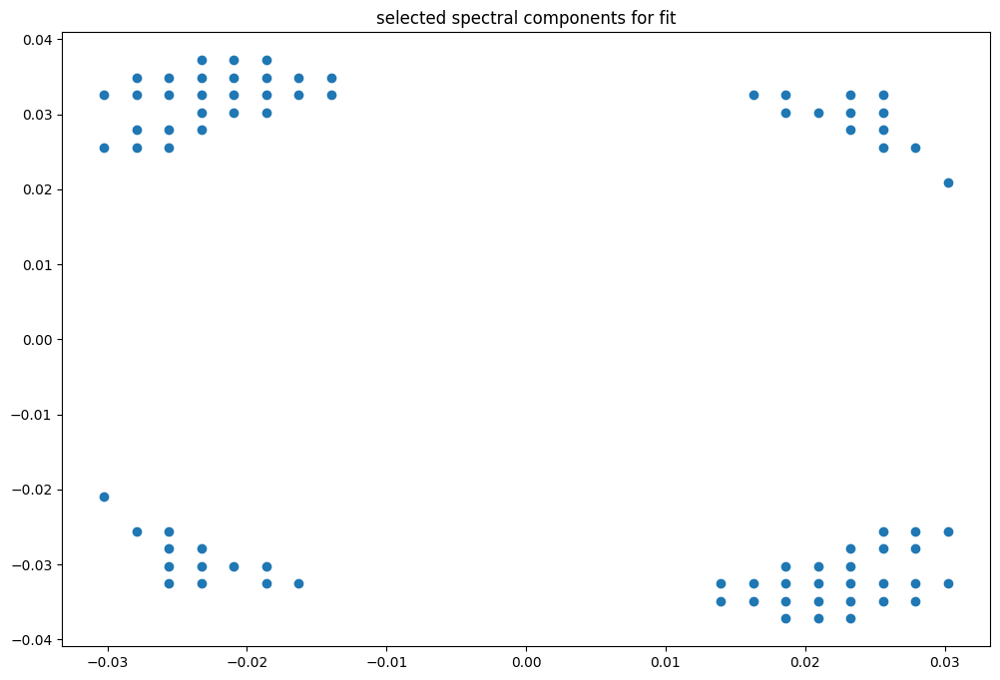

box [9500, 10200, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

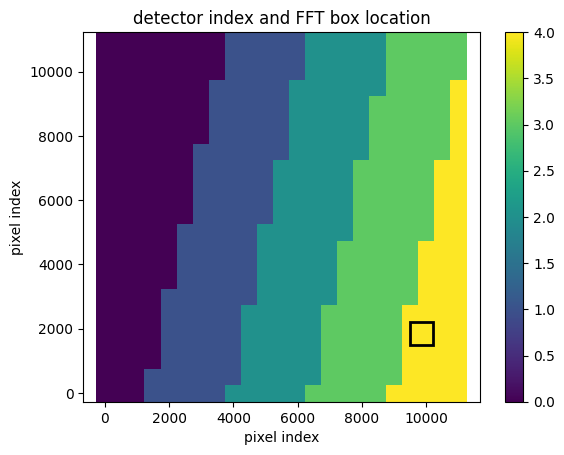

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(43, 43)
(43, 43)
(43, 43)


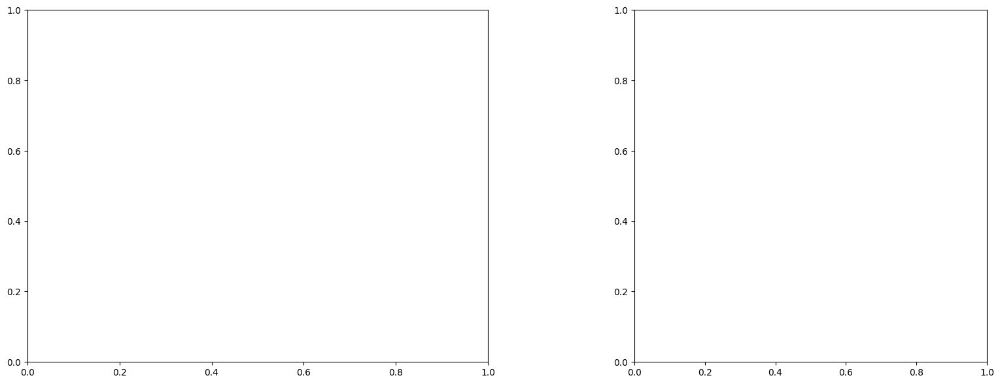

U and V components of current : [ 0.07230641 -1.55479199]
uncertainties for U and V: 0.0680275652876187 0.05662577596092121


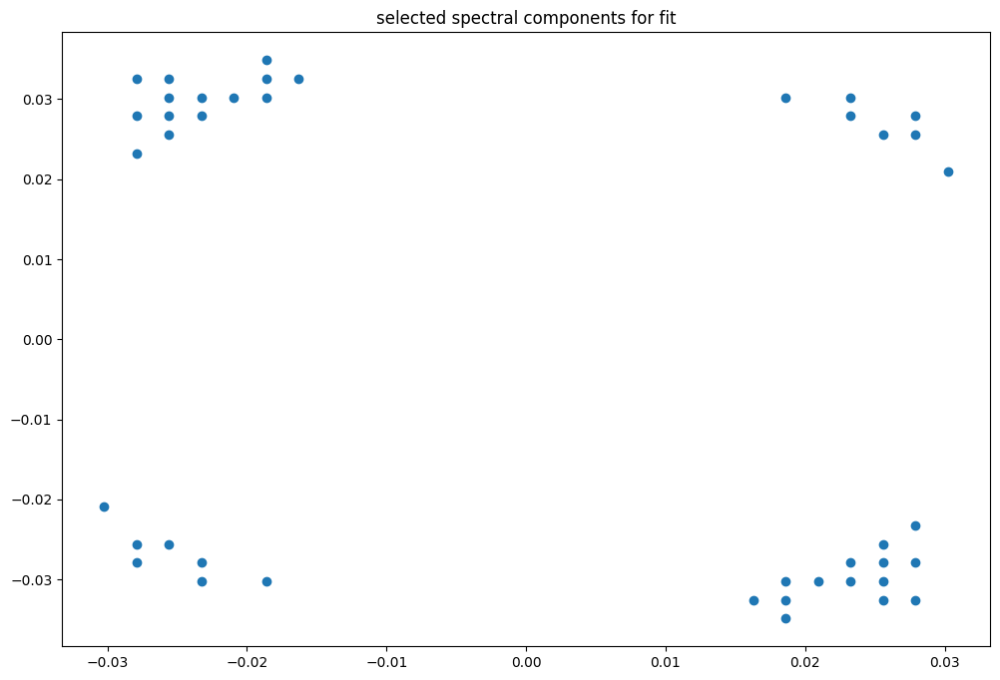

box [9500, 10200, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

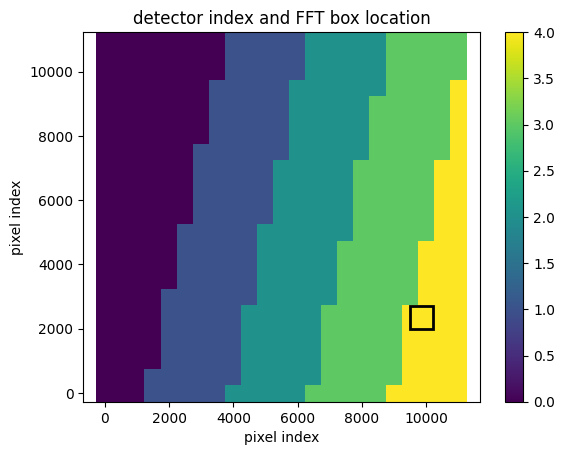

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986839558703013
(43, 43)
(43, 43)
(43, 43)


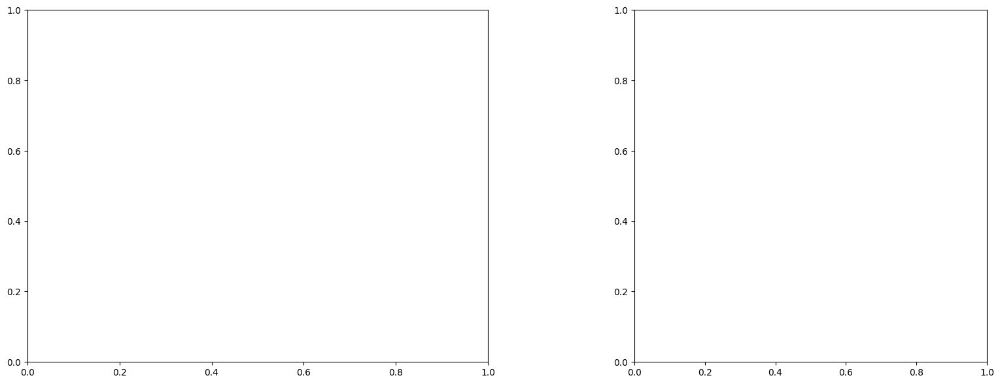

LinAlgError: Singular matrix

box [9500, 10200, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

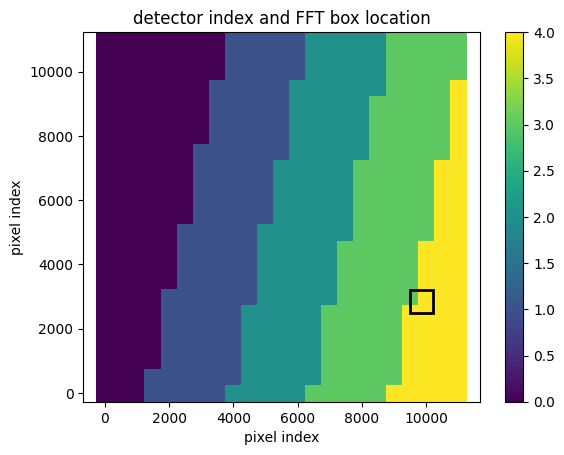

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.96
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986813595194435
(43, 43)
(43, 43)
(43, 43)


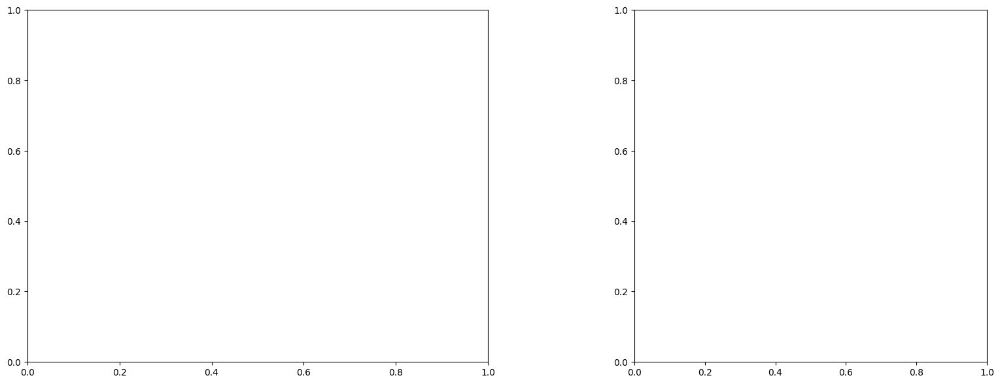

LinAlgError: Singular matrix

box [9500, 10200, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

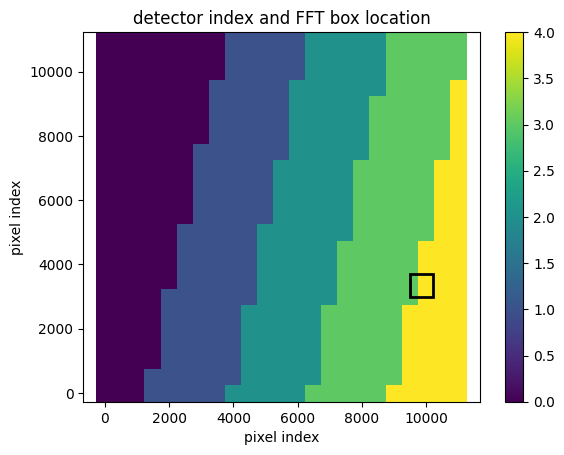

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986813595194435
(43, 43)
(43, 43)
(43, 43)


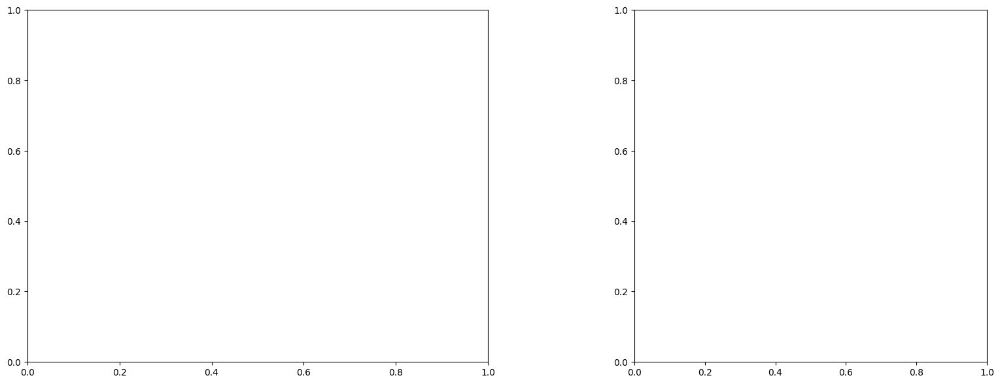

LinAlgError: Singular matrix

box [9500, 10200, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

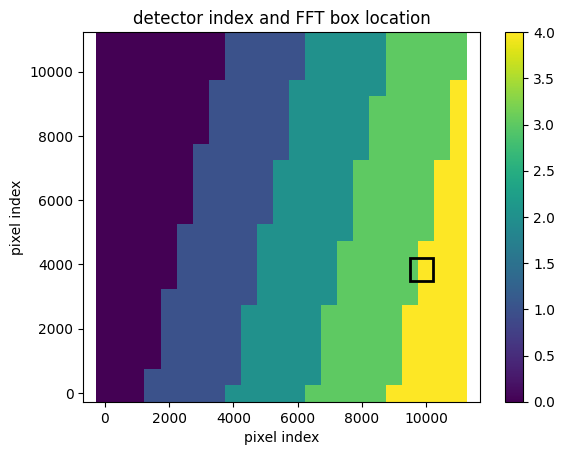

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986790806132827
(43, 43)
(43, 43)
(43, 43)


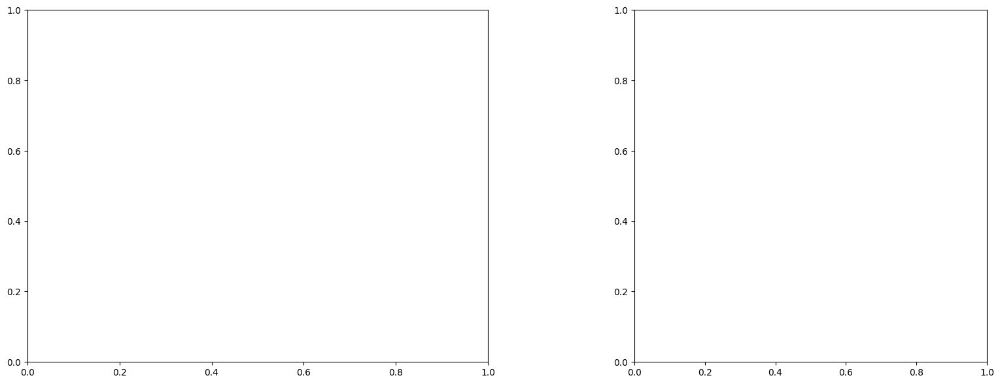

LinAlgError: Singular matrix

box [9500, 10200, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

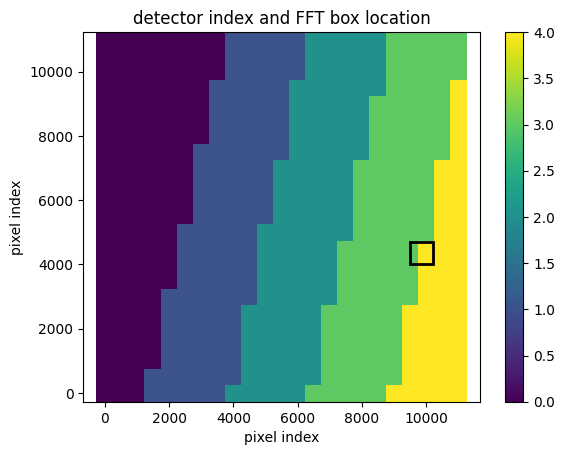

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.7
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986764529808695
(43, 43)
(43, 43)
(43, 43)


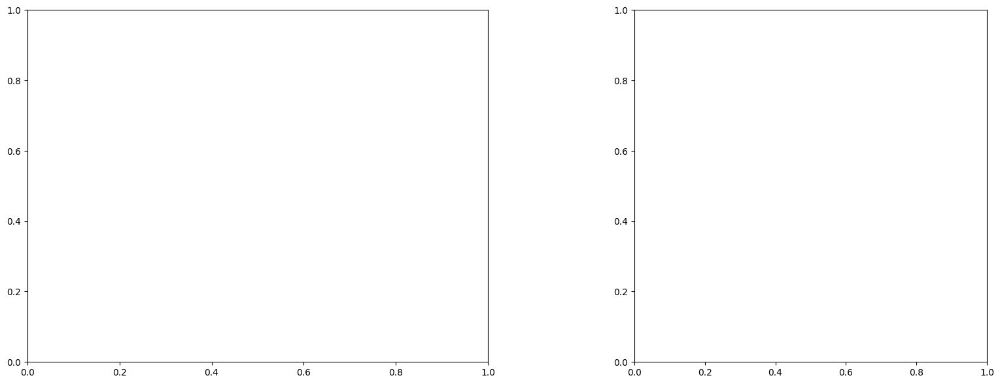

LinAlgError: Singular matrix

box [9500, 10200, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

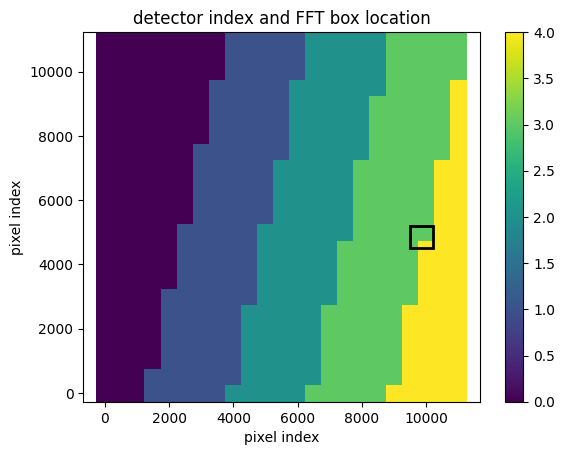

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.26
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947391397188193
(43, 43)
(43, 43)
(43, 43)


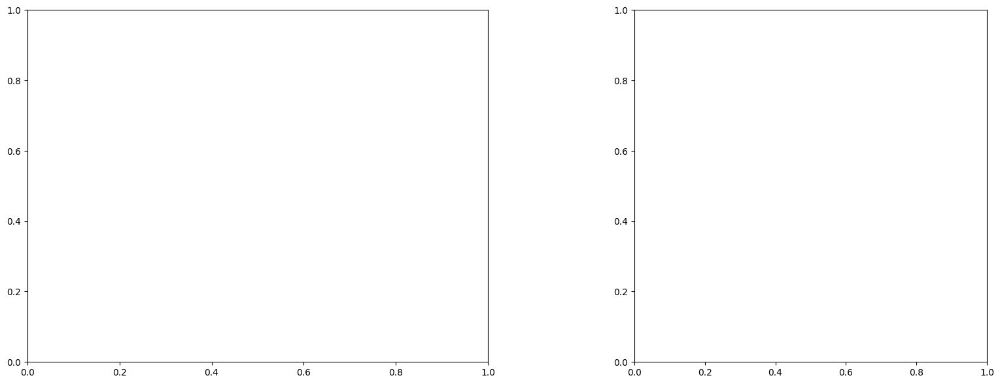

U and V components of current : [ 0.05346251 -1.84010941]
uncertainties for U and V: 0.16936520115449644 0.13344343745649426


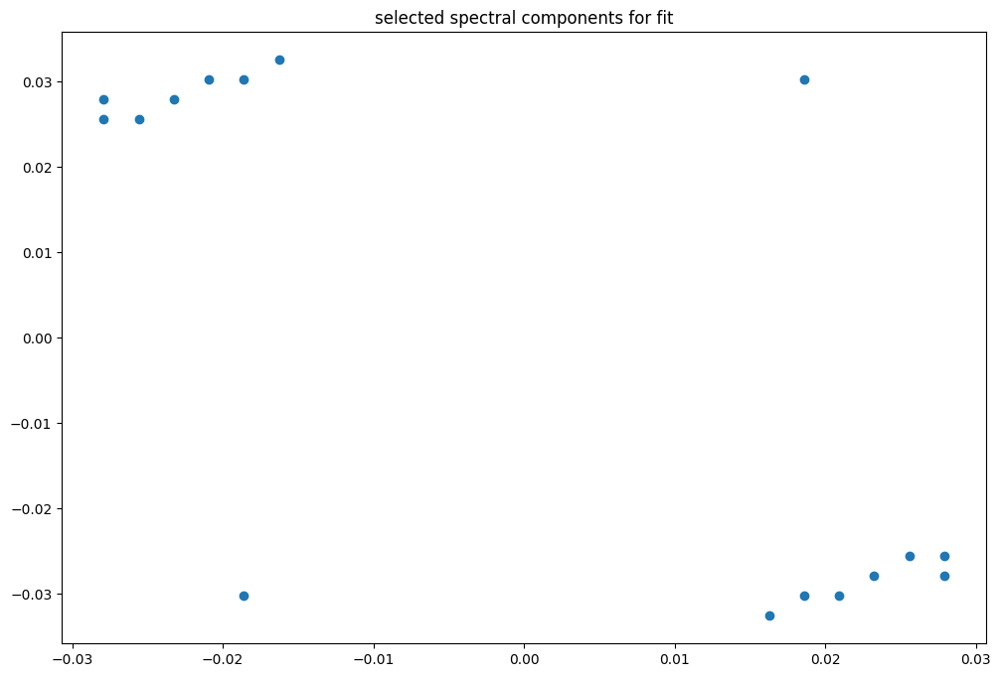

box [9500, 10200, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

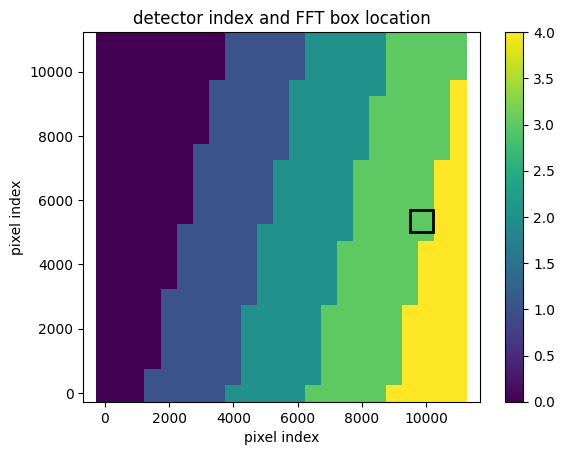

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947370383548849
(43, 43)
(43, 43)
(43, 43)


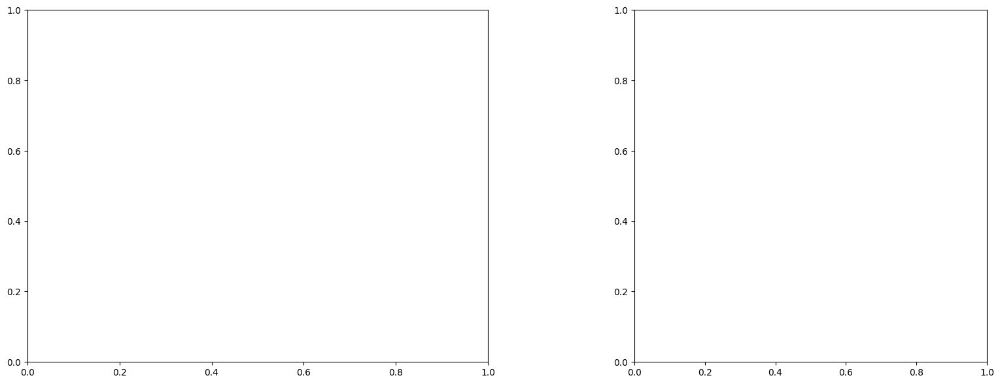

U and V components of current : [-0.52391394 -1.79342202]
uncertainties for U and V: 0.04508470811602242 0.035292774351577974


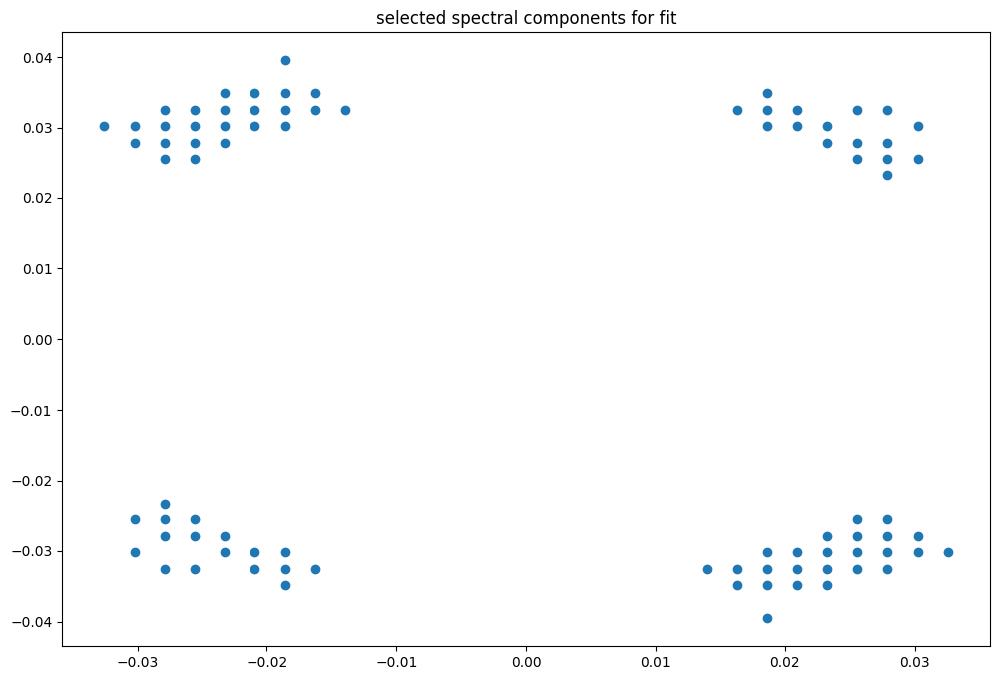

box [9500, 10200, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

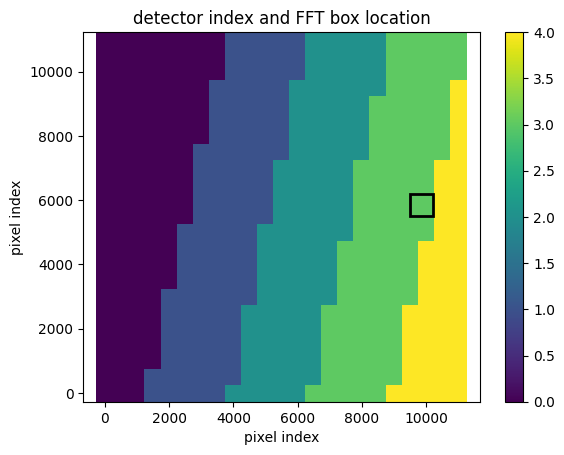

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947346257541402
(43, 43)
(43, 43)
(43, 43)


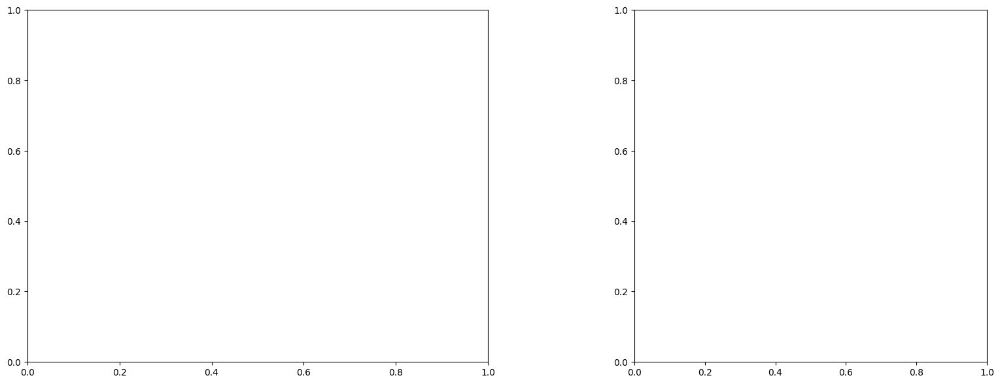

U and V components of current : [-0.23273947 -1.6529807 ]
uncertainties for U and V: 0.04257302352738628 0.03593843085905656


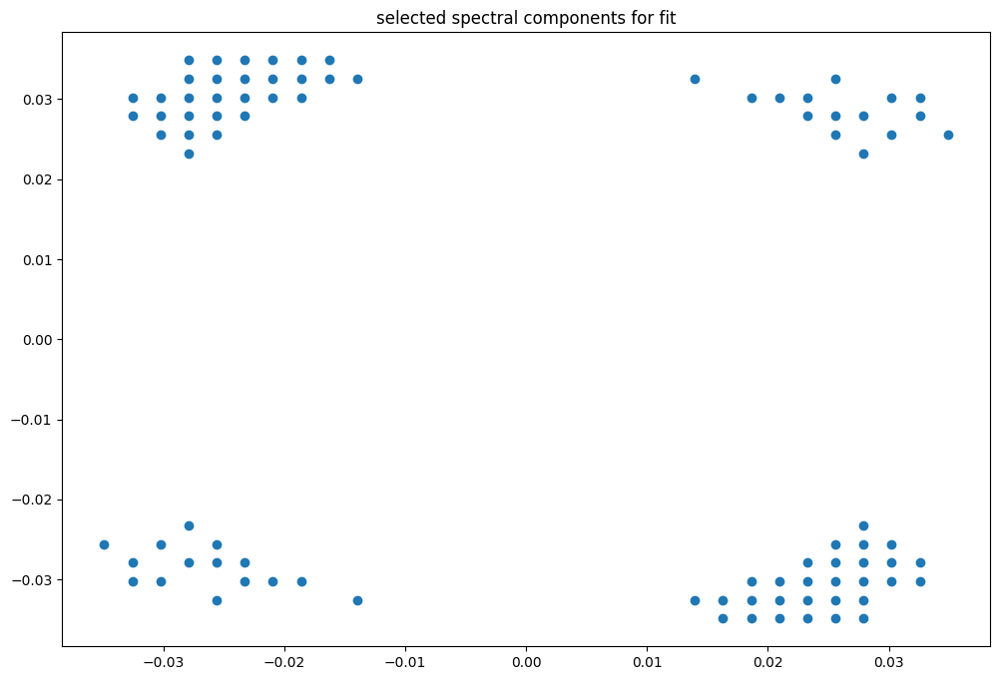

box [9500, 10200, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

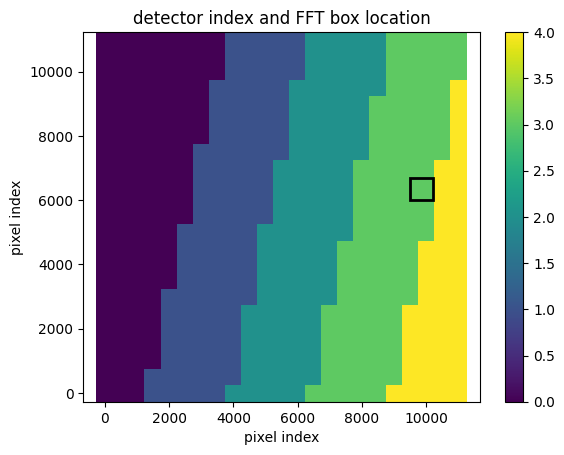

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


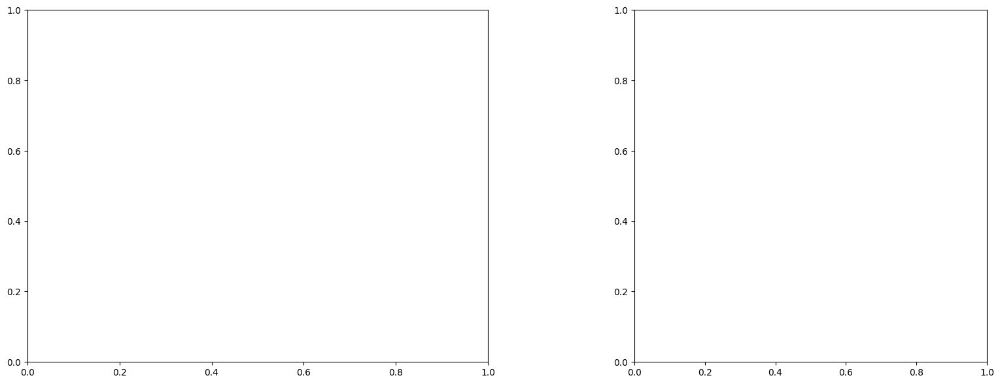

U and V components of current : [-0.26262878 -1.72948849]
uncertainties for U and V: 0.036249696371771015 0.031452214689870285


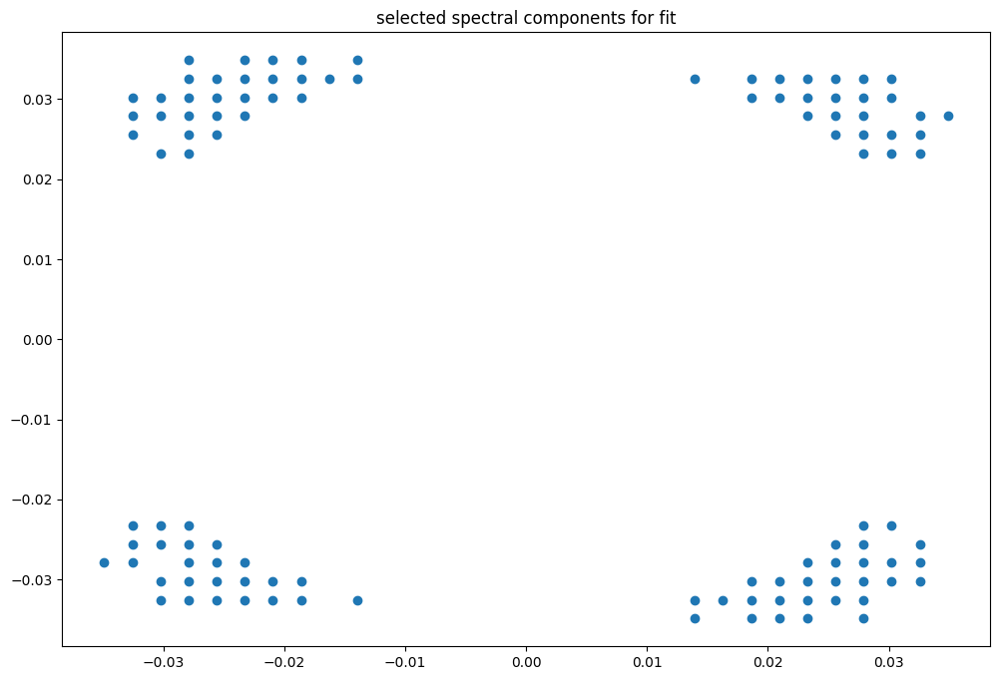

box [9500, 10200, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

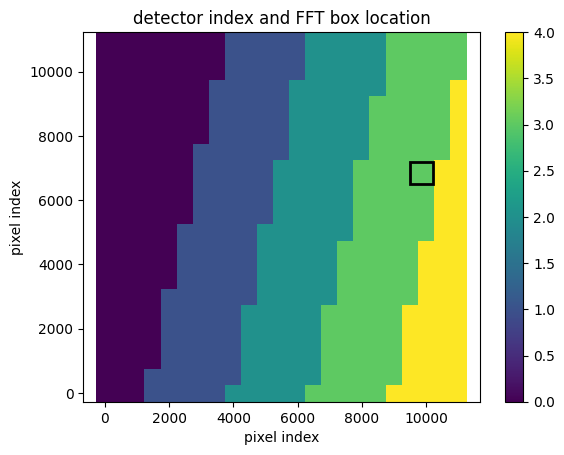

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.99473232921783
(43, 43)
(43, 43)
(43, 43)


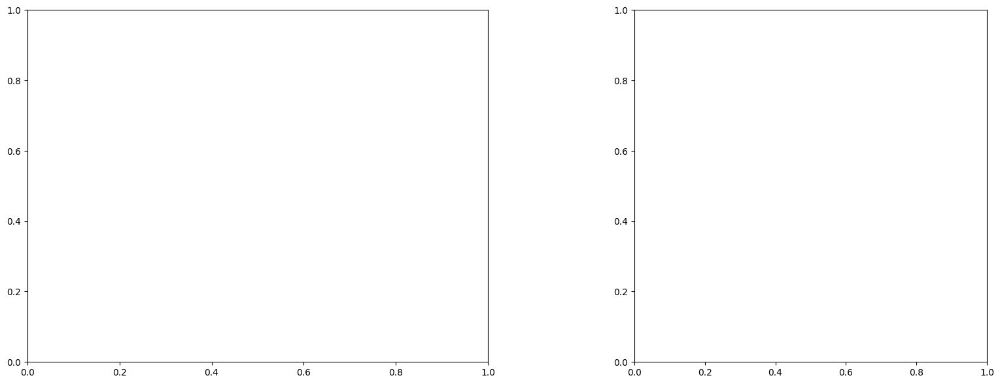

U and V components of current : [-0.18697218 -1.97542143]
uncertainties for U and V: 0.04072348403090377 0.03615470244140216


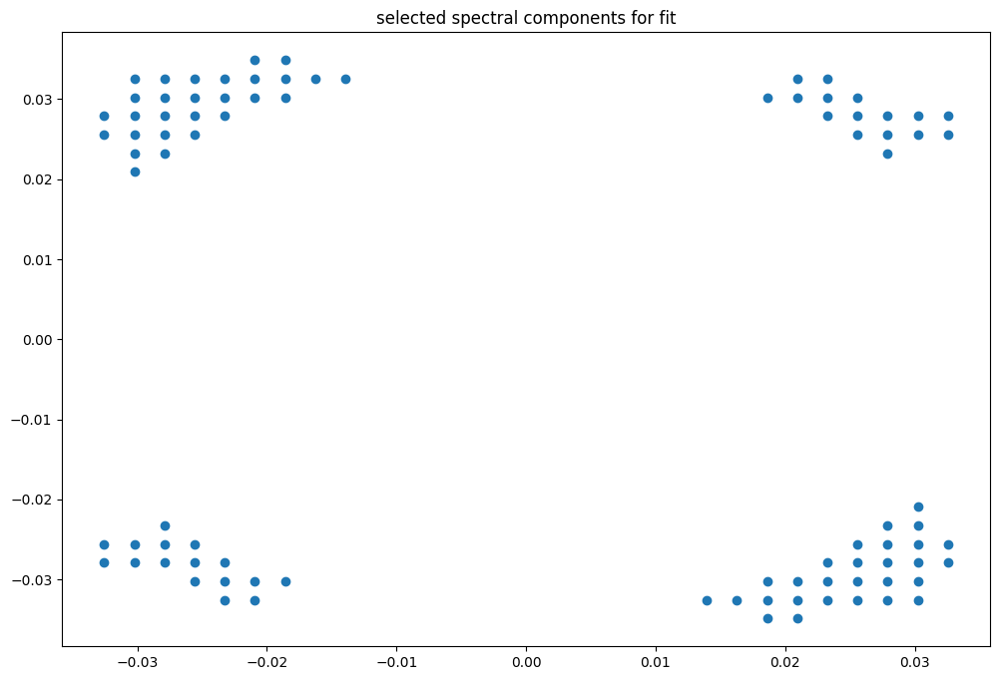

box [9500, 10200, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

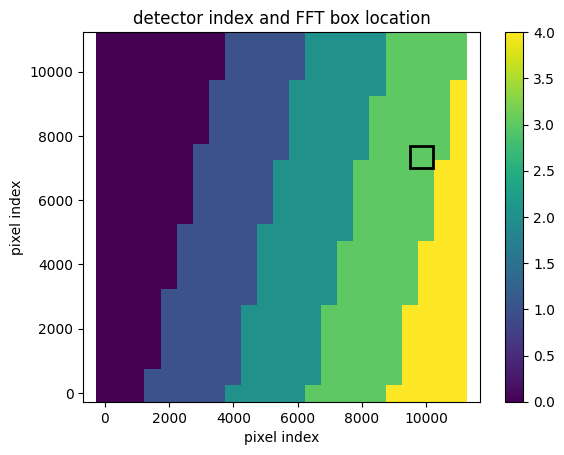

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


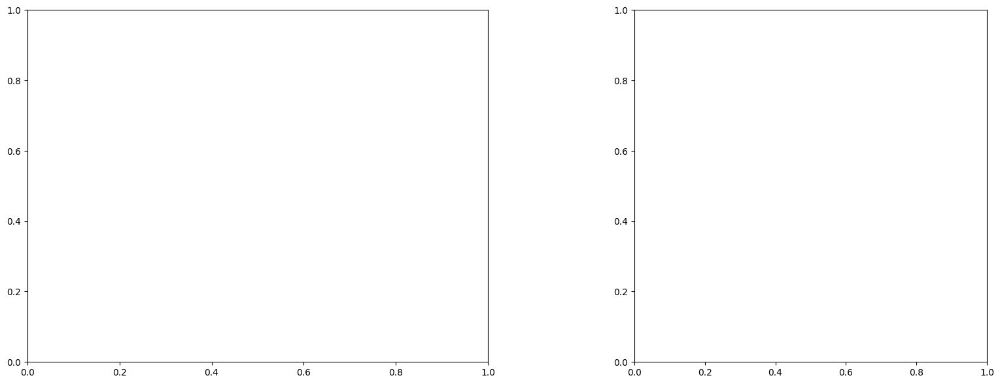

U and V components of current : [-0.27449195 -2.15066643]
uncertainties for U and V: 0.03527099175864322 0.03245007115969827


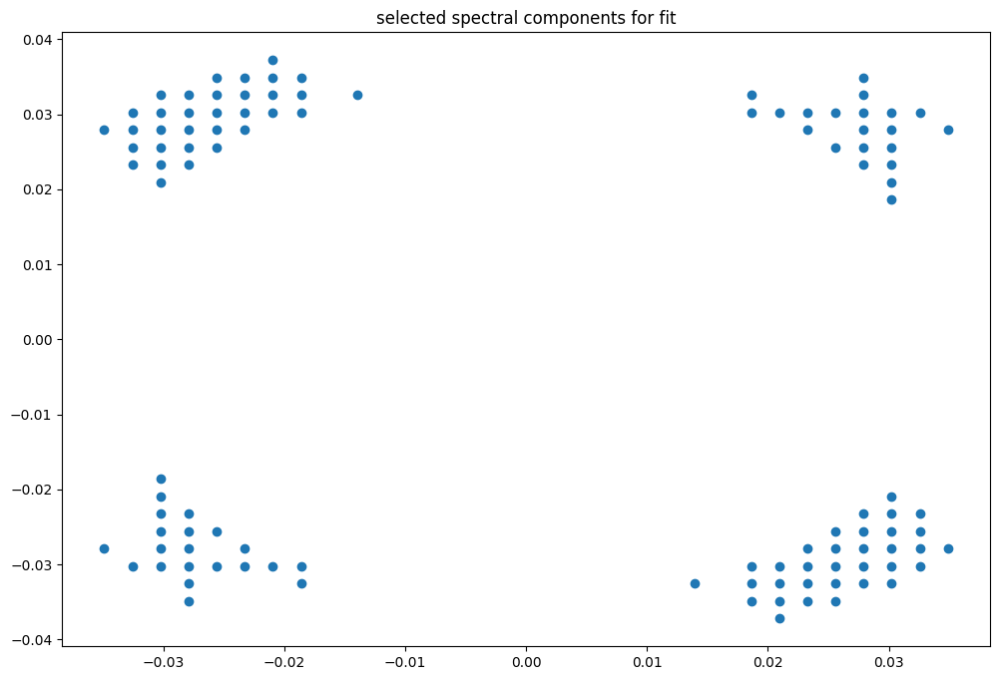

box [9500, 10200, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

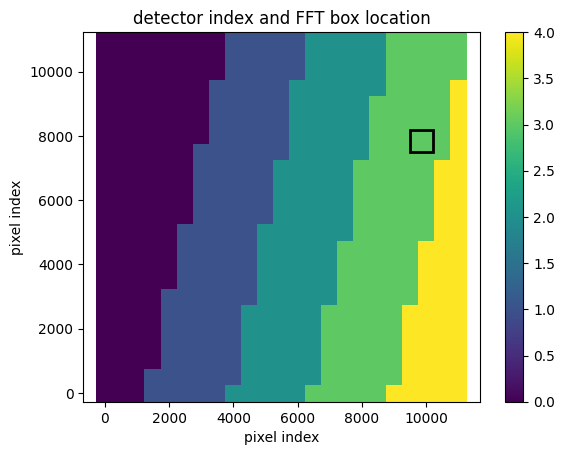

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


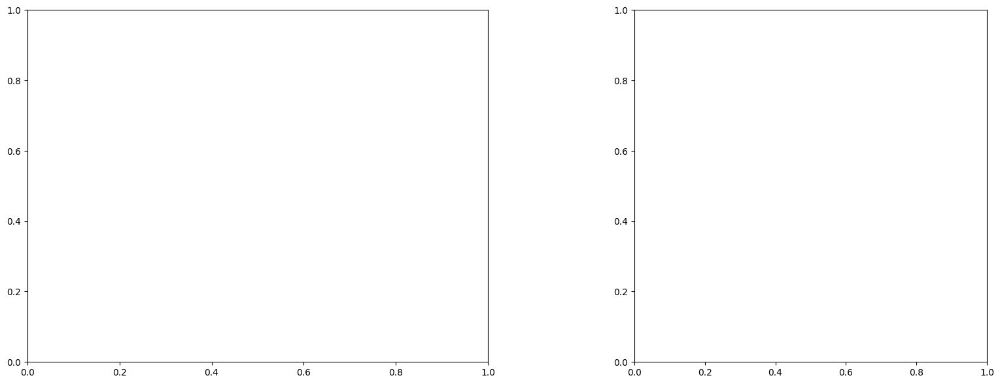

U and V components of current : [-0.13273993 -1.17381763]
uncertainties for U and V: 0.034385591009088175 0.031135747591871082


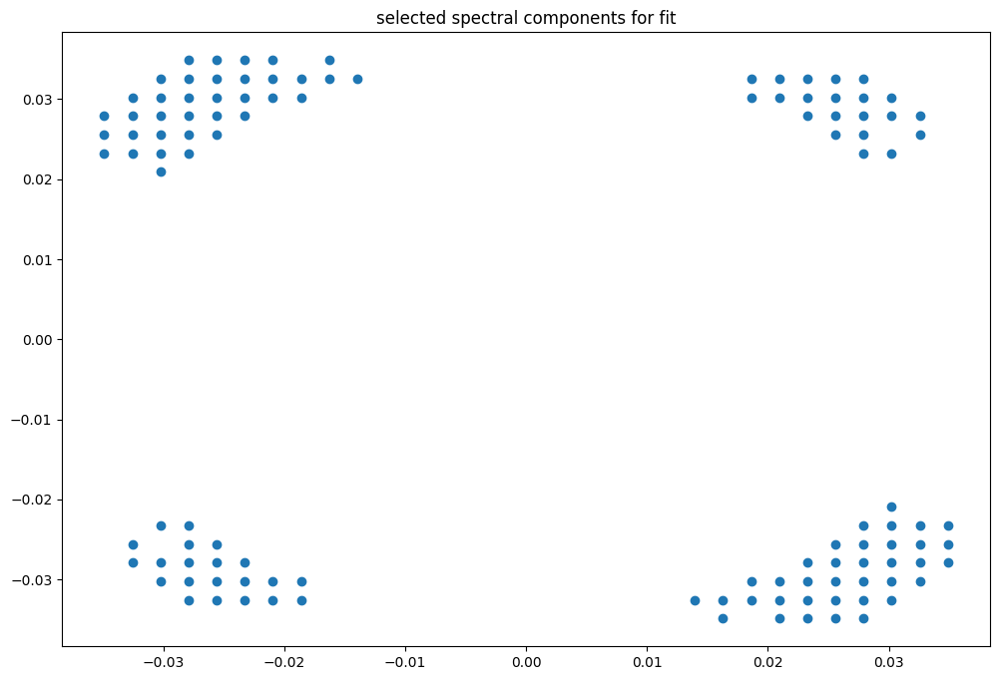

box [9500, 10200, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

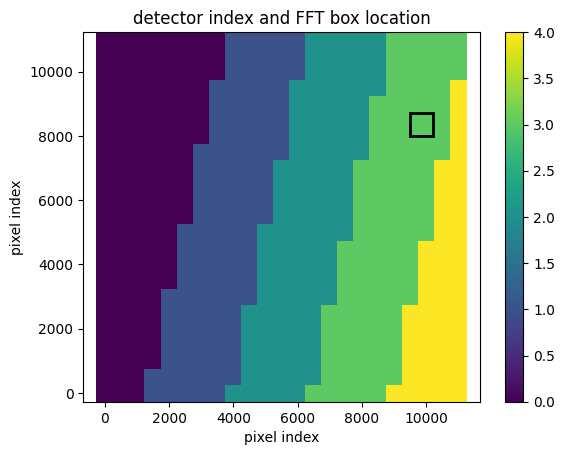

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


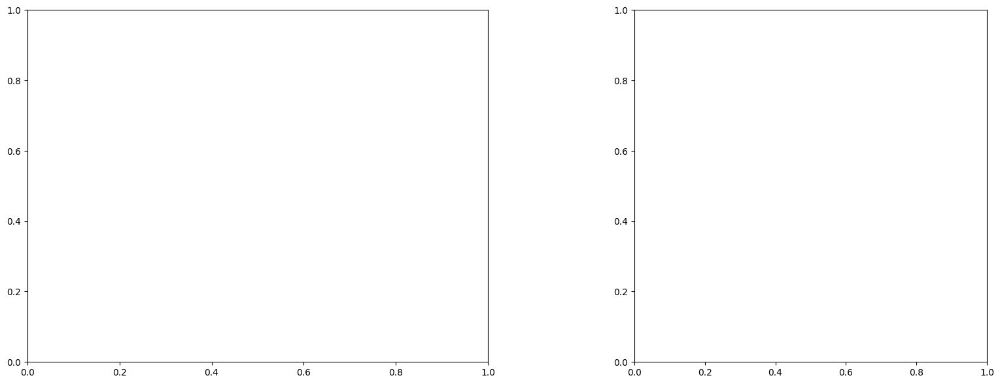

U and V components of current : [ 0.10783746 -1.23941993]
uncertainties for U and V: 0.04027165406905847 0.035638718783060526


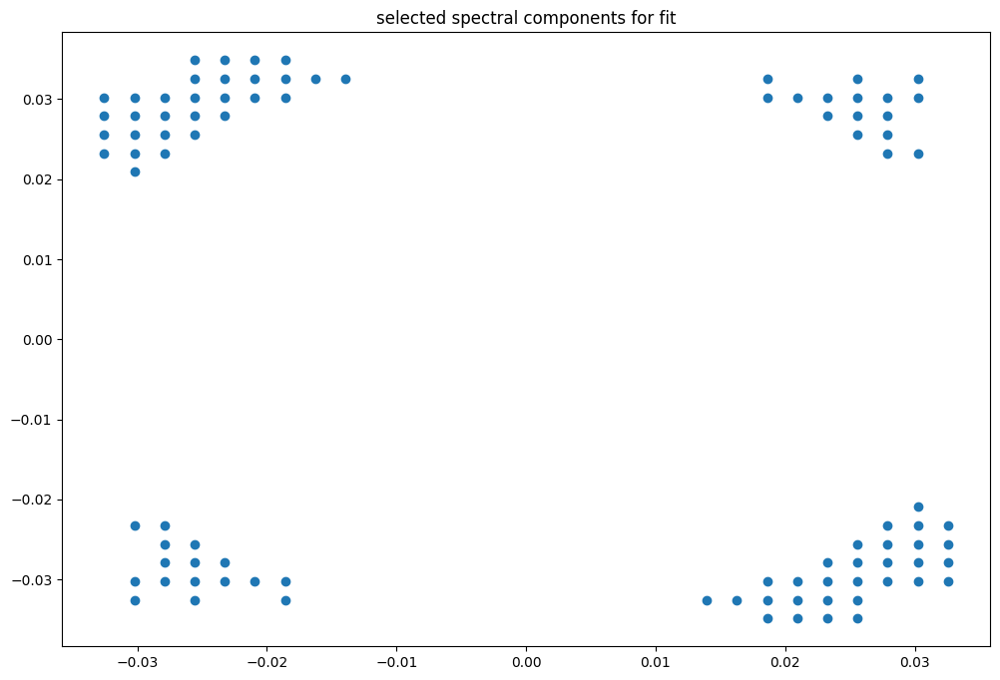

box [9500, 10200, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

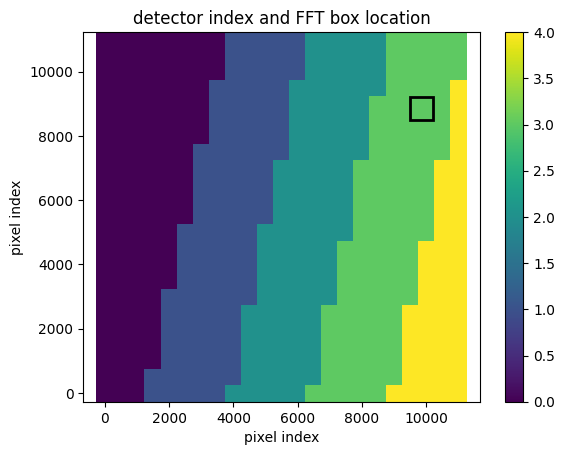

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


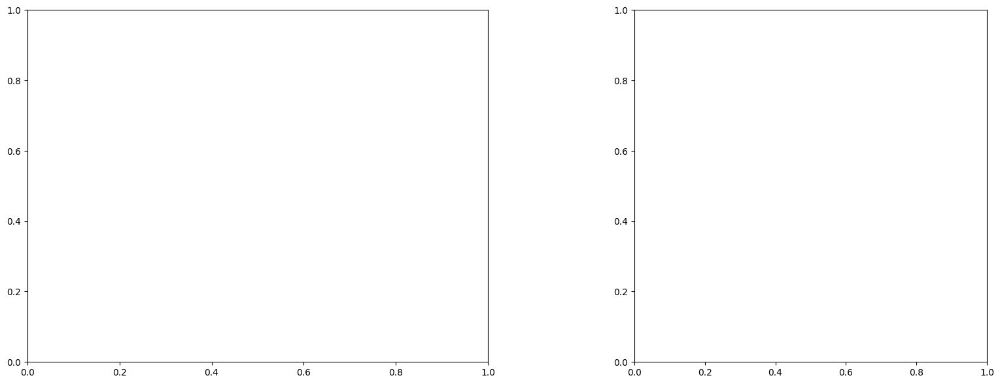

U and V components of current : [-0.10949428 -1.85145968]
uncertainties for U and V: 0.05014270985726222 0.04462044950146304


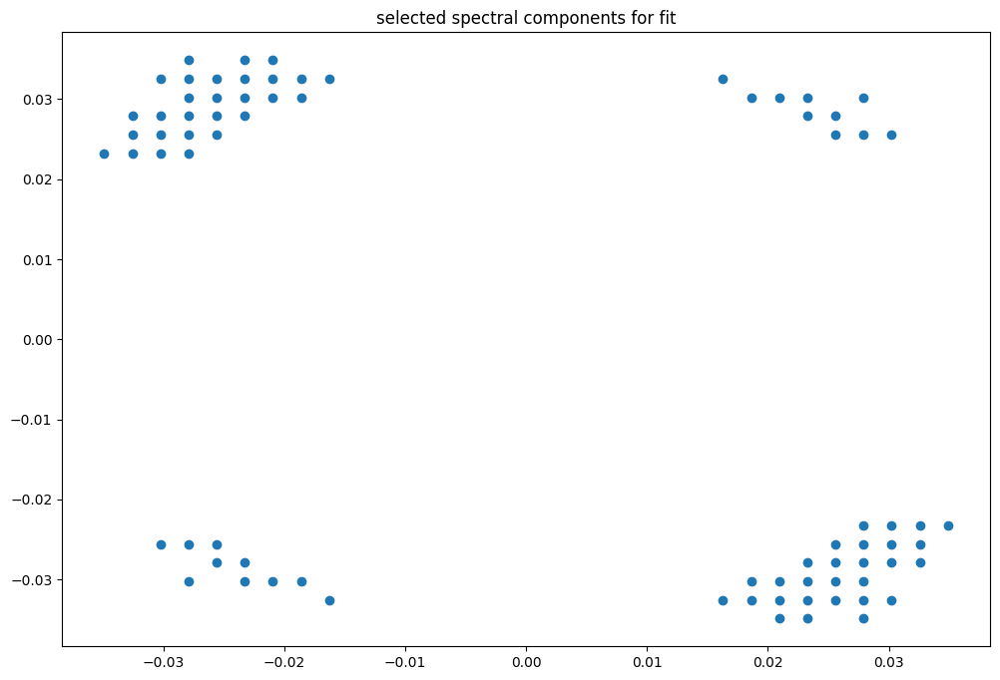

box [9500, 10200, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

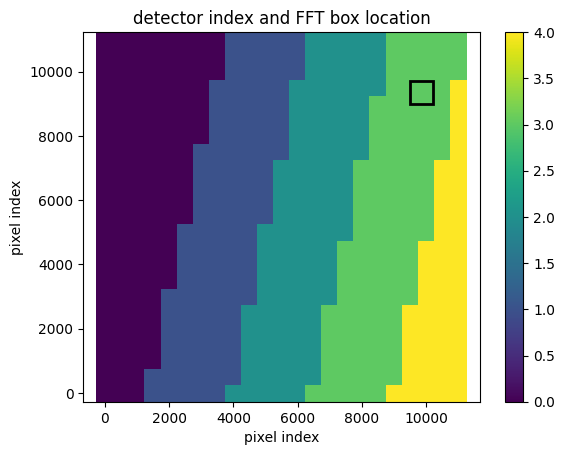

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(43, 43)
(43, 43)
(43, 43)


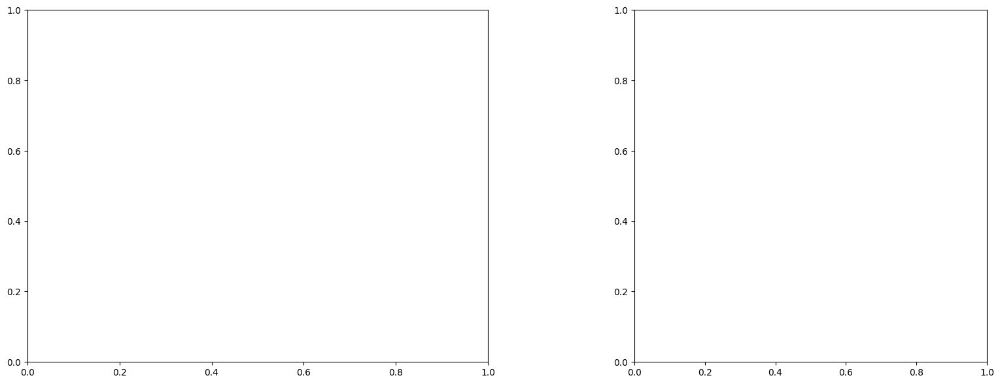

U and V components of current : [-0.21328022 -2.04419796]
uncertainties for U and V: 0.04942745952623226 0.04645721228502762


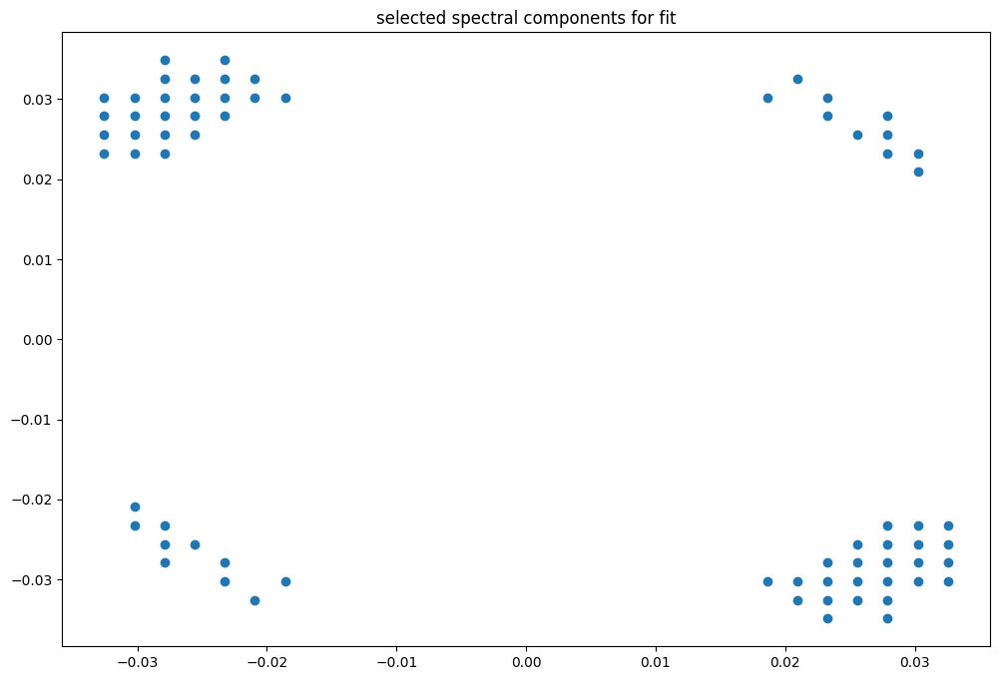

box [9500, 10200, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

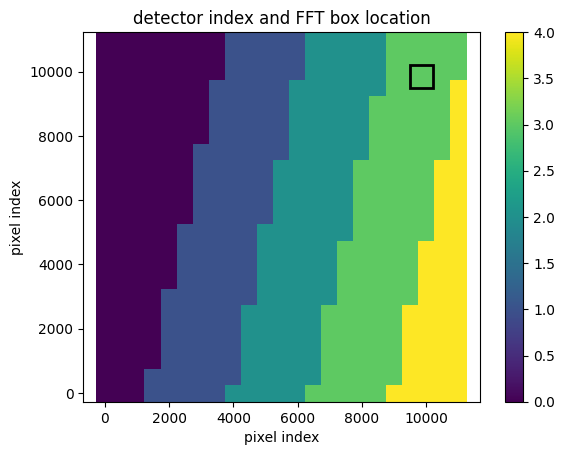

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


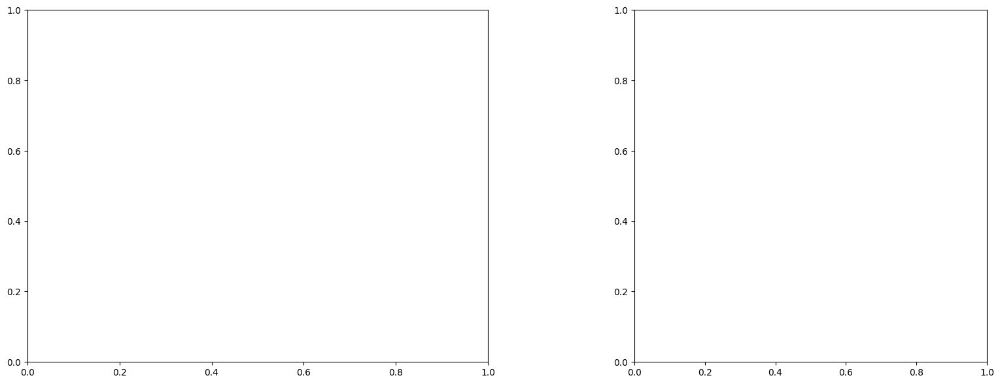

U and V components of current : [-0.28923719 -1.94583859]
uncertainties for U and V: 0.06387077241768348 0.05623369942470524


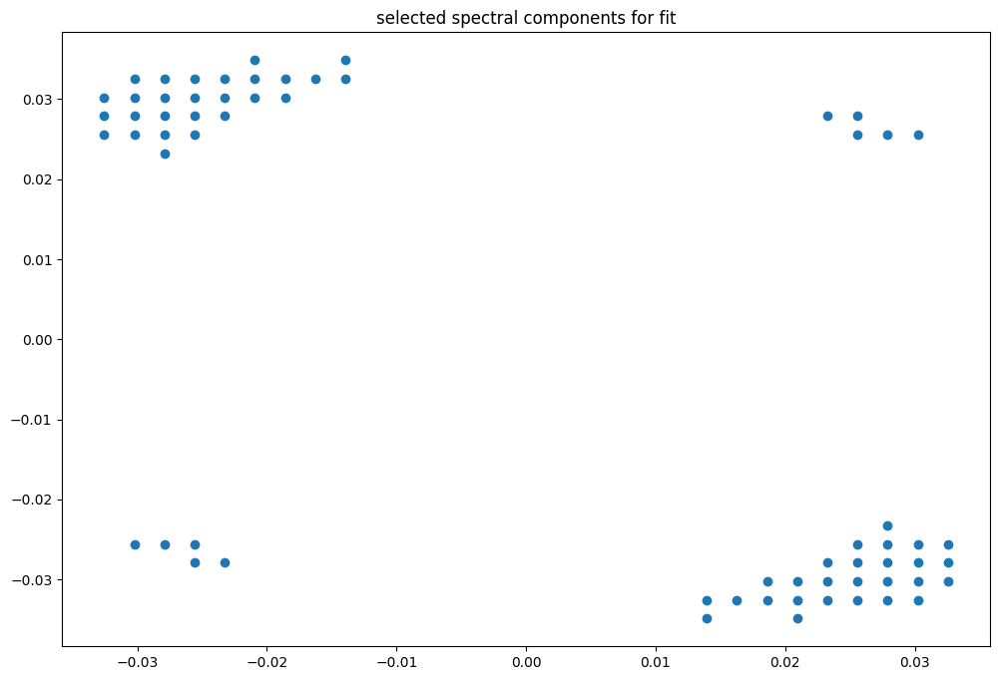

box [9500, 10200, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Read

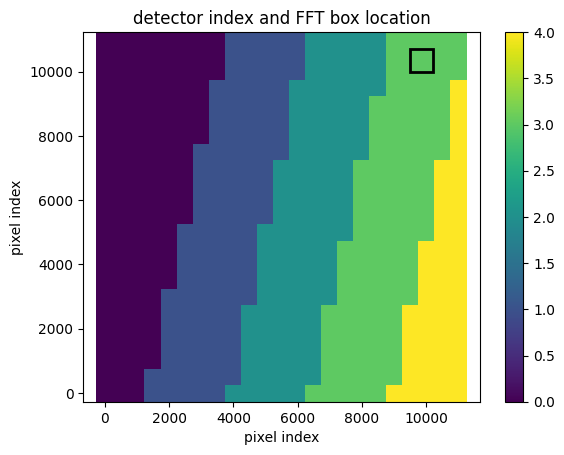

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


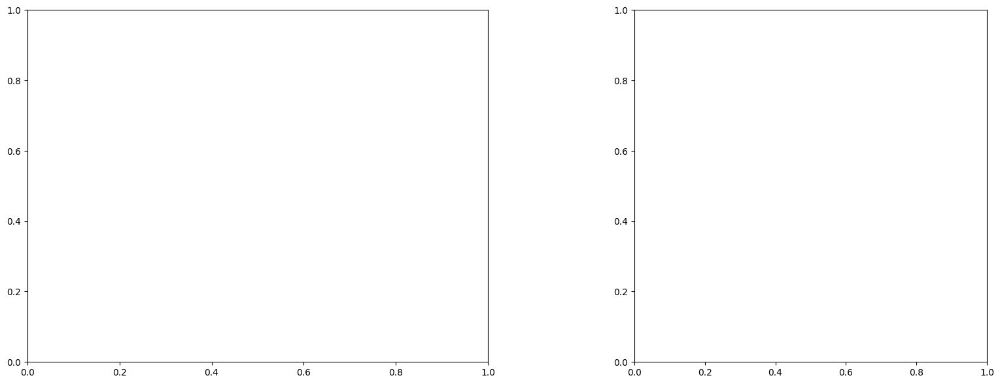

U and V components of current : [-0.15973458 -2.10874369]
uncertainties for U and V: 0.04907243305067164 0.04607426426808131


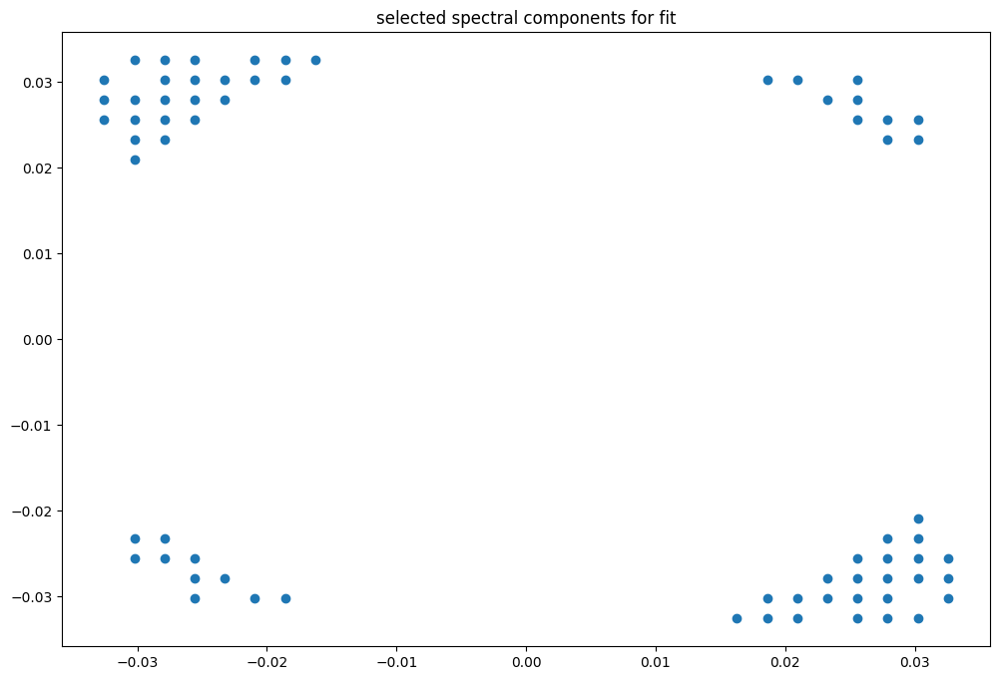

box [9500, 10200, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Read

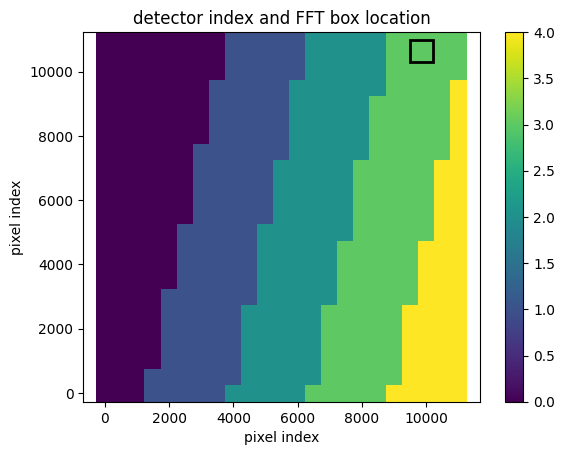

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(43, 42)
(43, 42)
(43, 42)


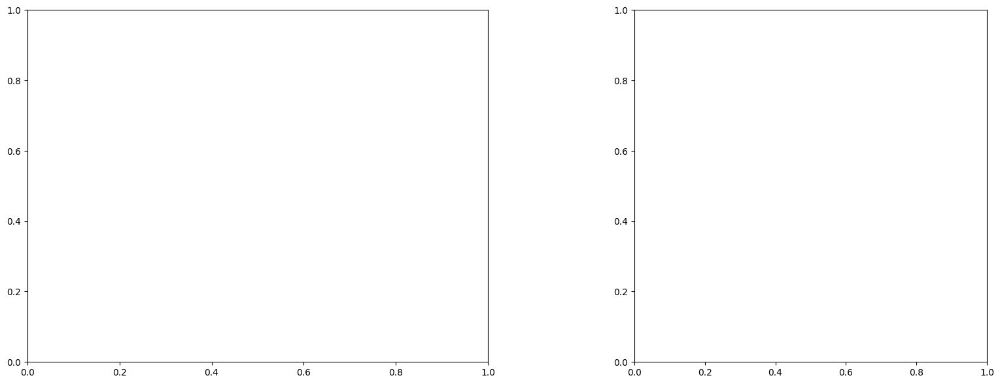

U and V components of current : [ 0.24665631 -1.69770621]
uncertainties for U and V: 0.04563307817628417 0.040488629231660384


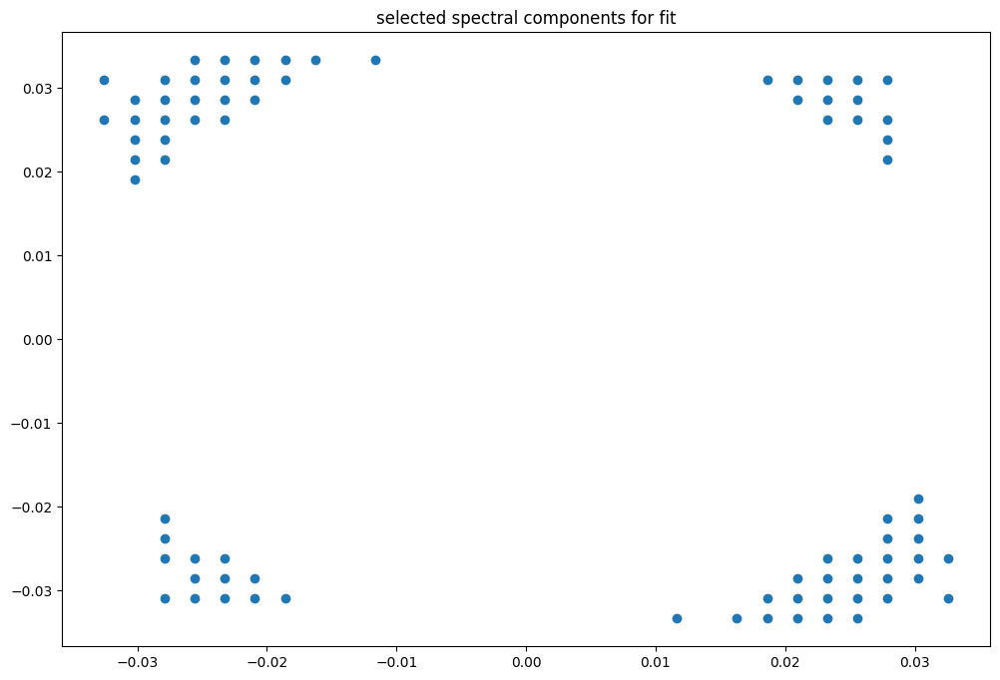

box [10000, 10700, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading f

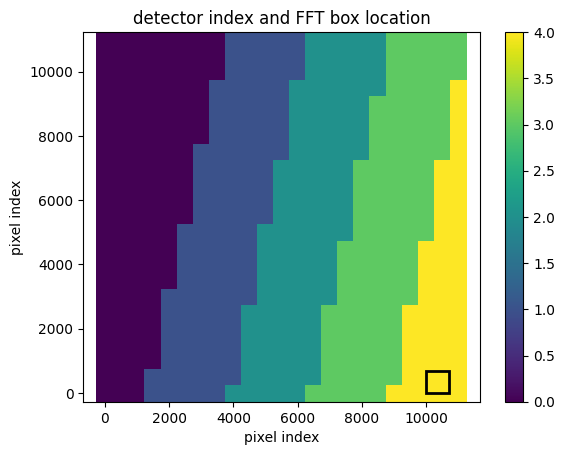

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(43, 43)
(43, 43)
(43, 43)


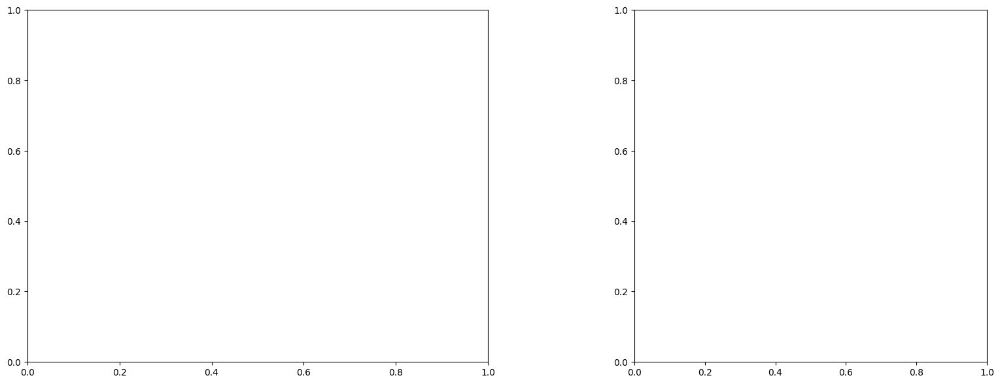

U and V components of current : [ 1.43013375 -0.09897949]
uncertainties for U and V: 0.03670621911560688 0.03256959983210901


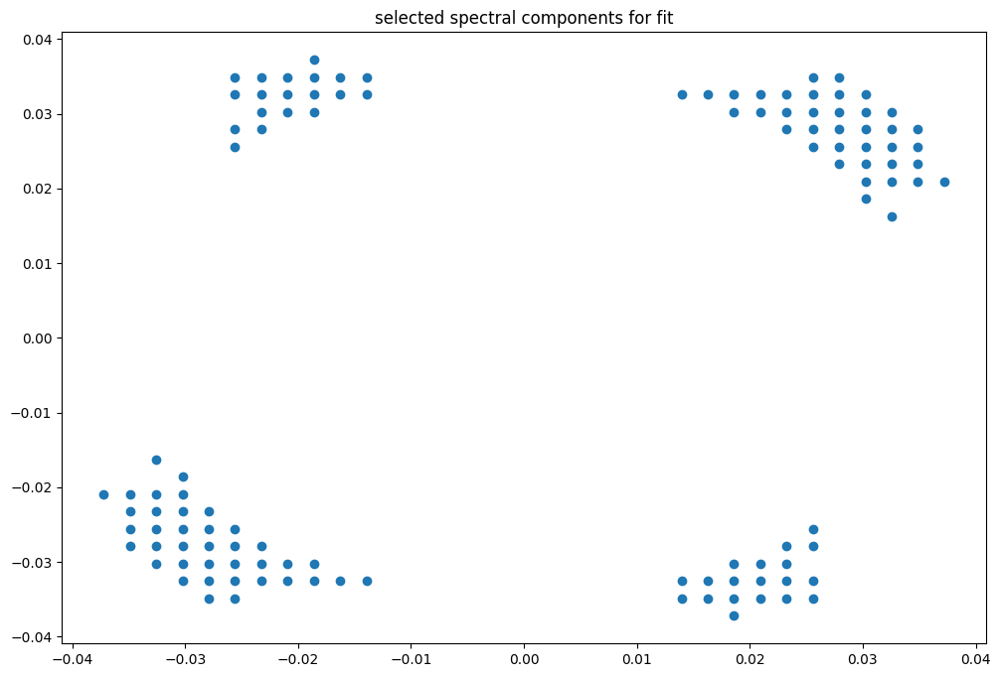

box [10000, 10700, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

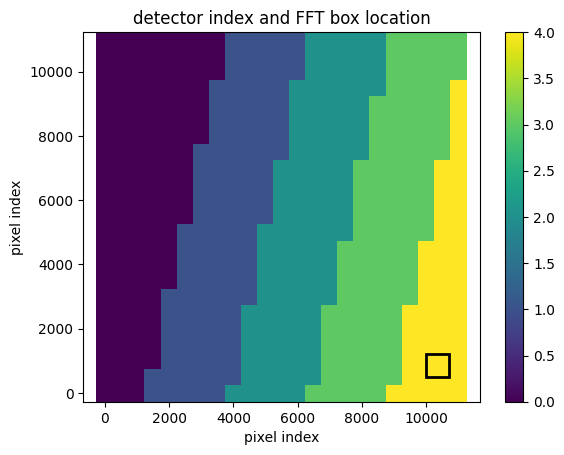

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(43, 43)
(43, 43)
(43, 43)


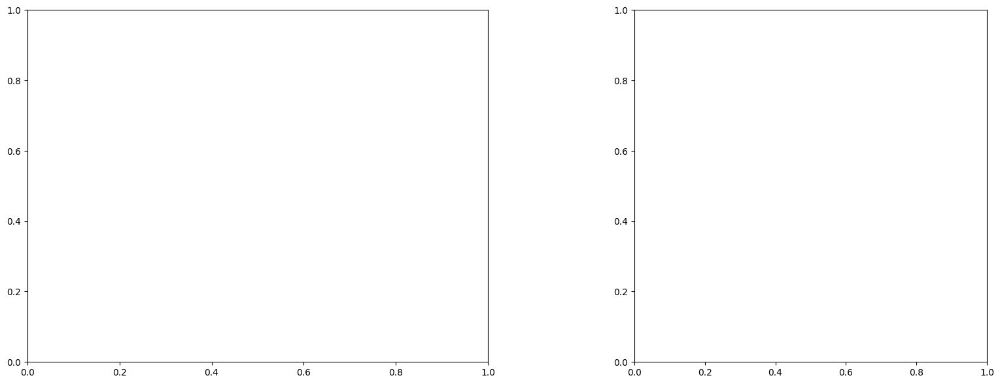

U and V components of current : [1.02018301 0.06871612]
uncertainties for U and V: 0.0399532469415021 0.03160734324747403


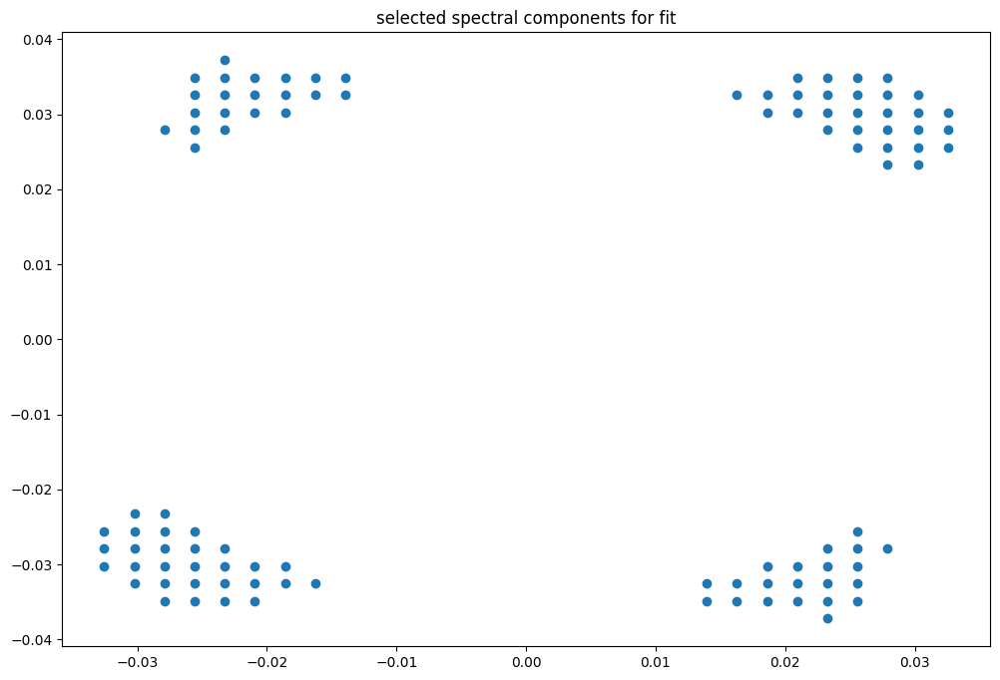

box [10000, 10700, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

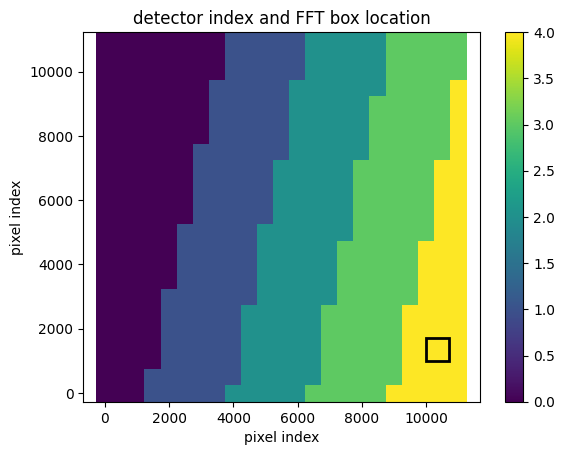

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(43, 43)
(43, 43)
(43, 43)


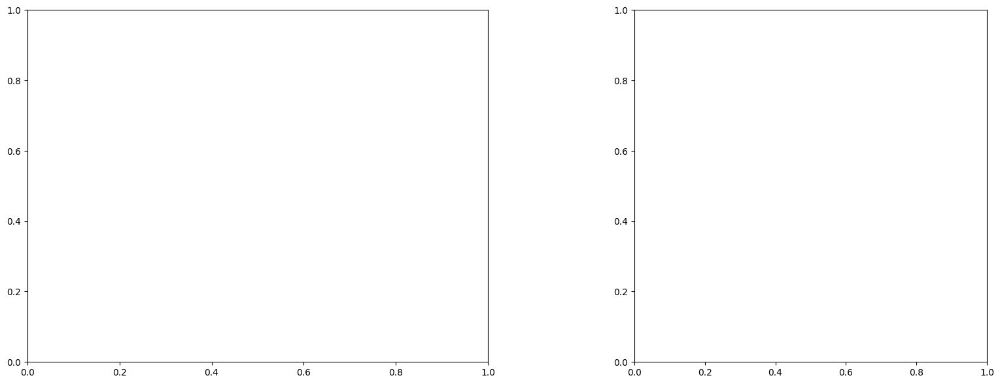

U and V components of current : [ 0.89258464 -0.394605  ]
uncertainties for U and V: 0.041093415096280526 0.03149064001355567


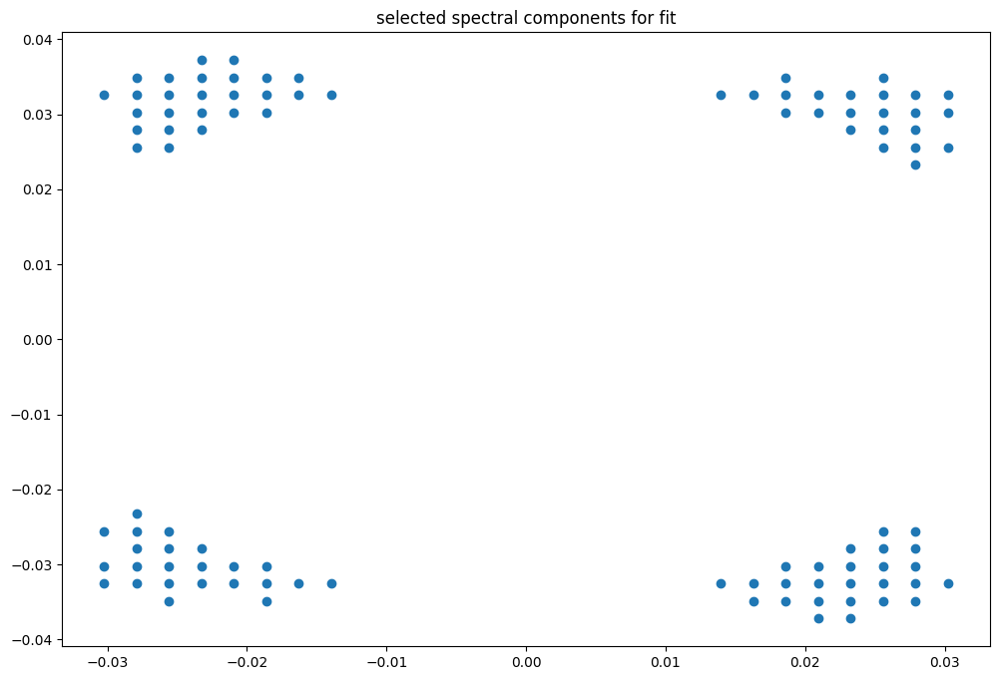

box [10000, 10700, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

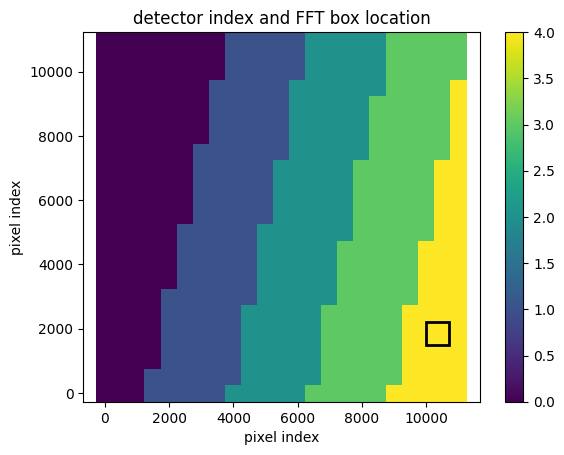

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(43, 43)
(43, 43)
(43, 43)


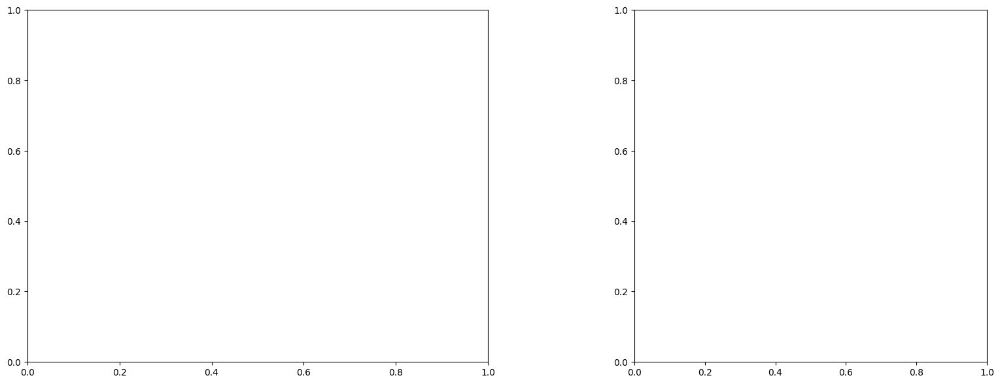

U and V components of current : [ 0.7075122  -0.63961834]
uncertainties for U and V: 0.0478923238145483 0.034933377153911774


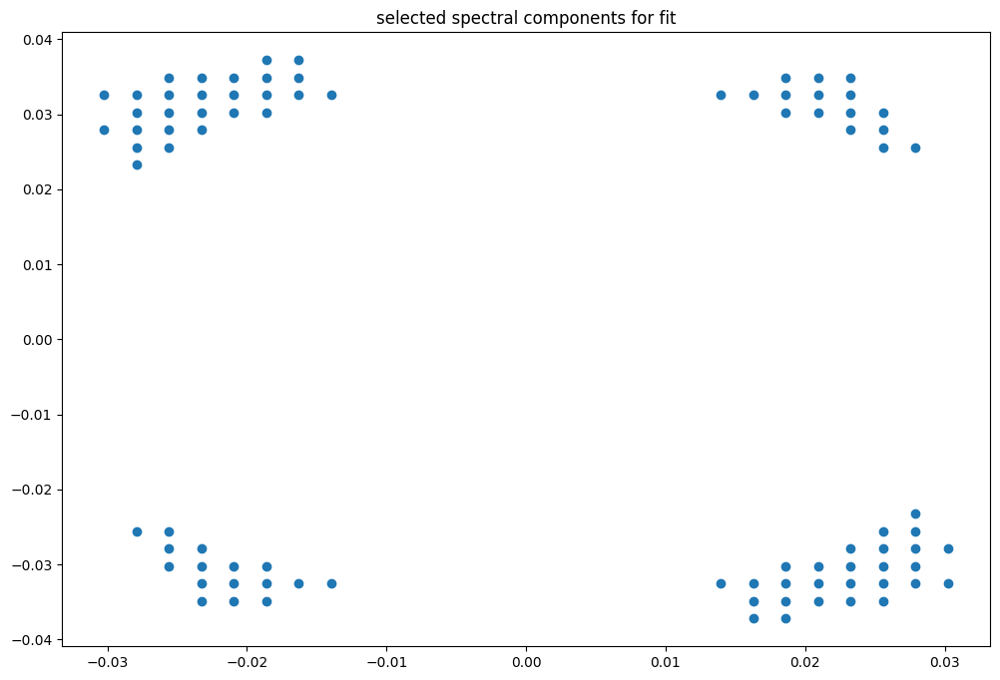

box [10000, 10700, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

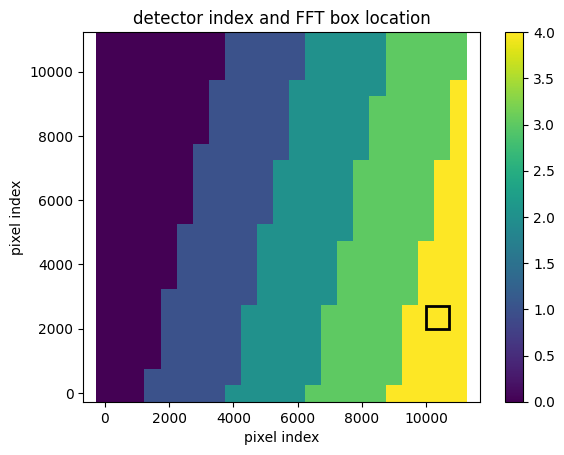

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986839558703013
(43, 43)
(43, 43)
(43, 43)


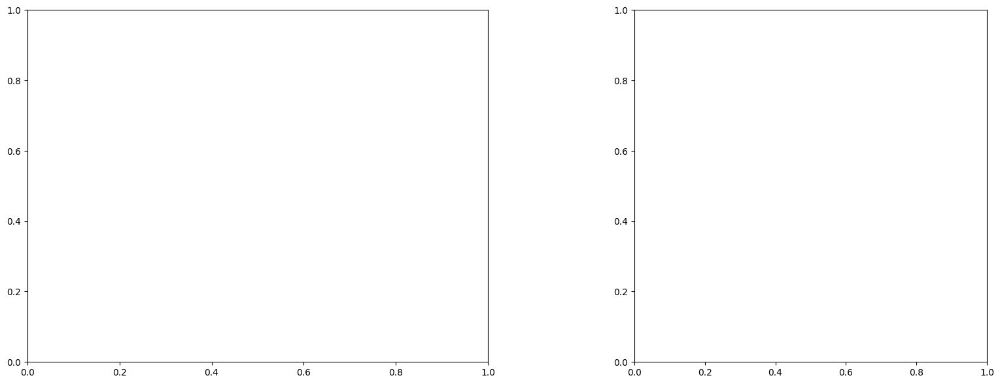

U and V components of current : [ 0.00399331 -1.61338817]
uncertainties for U and V: 0.05767289720869204 0.04095847998713071


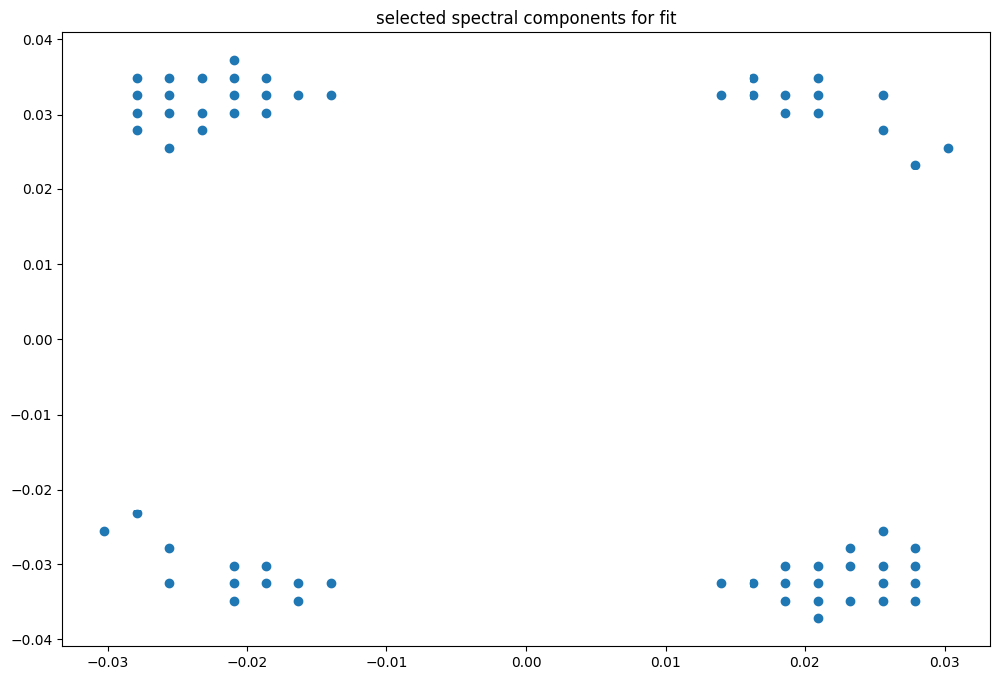

box [10000, 10700, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

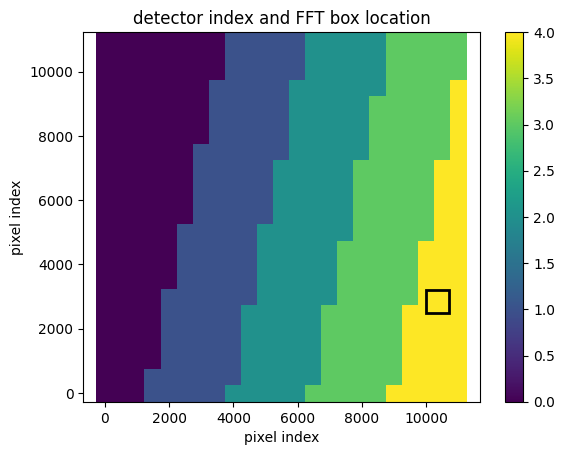

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986813595194435
(43, 43)
(43, 43)
(43, 43)


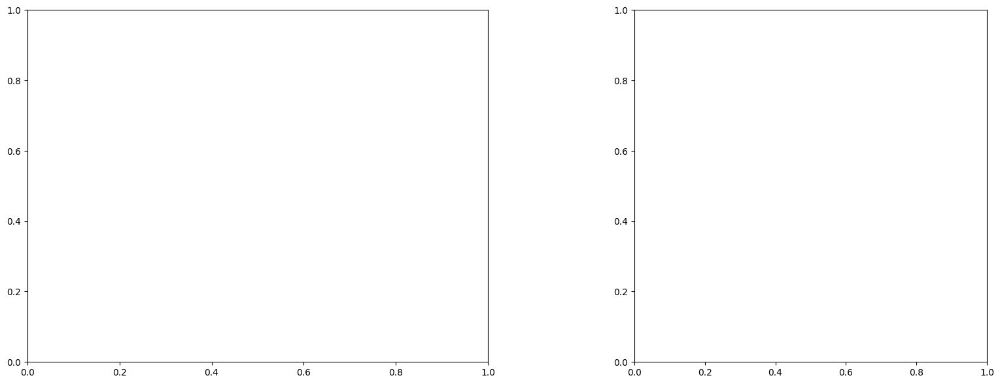

U and V components of current : [ 0.05391562 -1.47865598]
uncertainties for U and V: 0.05860688078513715 0.043425769486642424


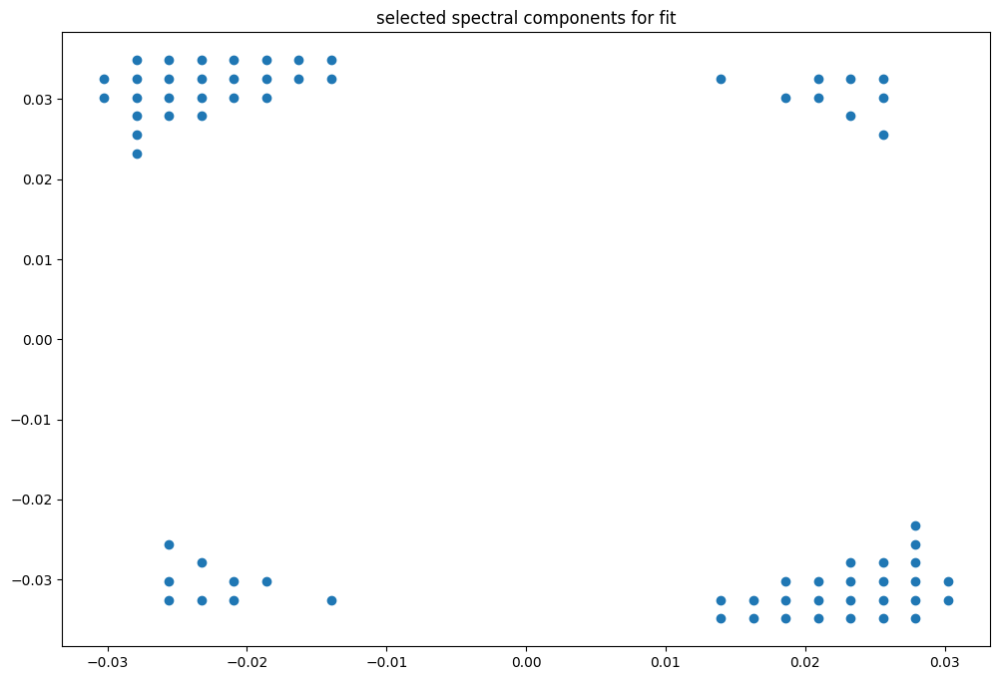

box [10000, 10700, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

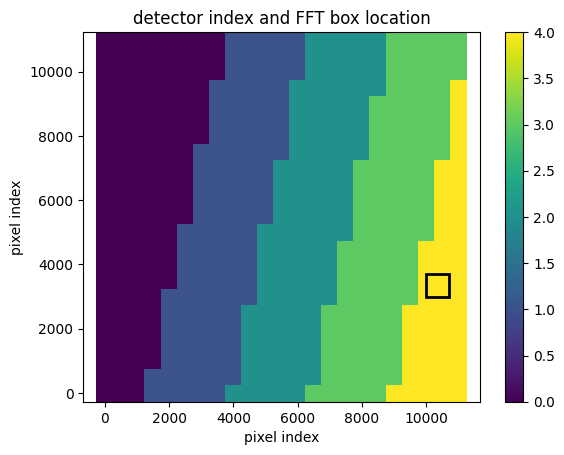

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986813595194435
(43, 43)
(43, 43)
(43, 43)


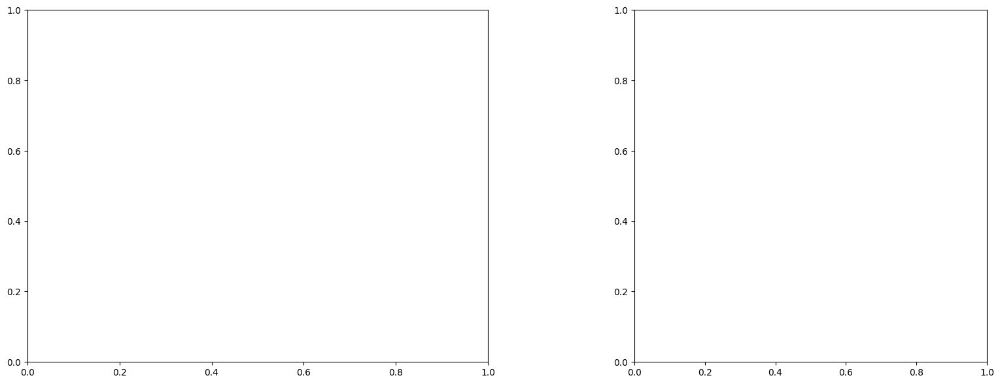

U and V components of current : [-0.10545436 -1.51168244]
uncertainties for U and V: 0.05471745957651456 0.040865282601245126


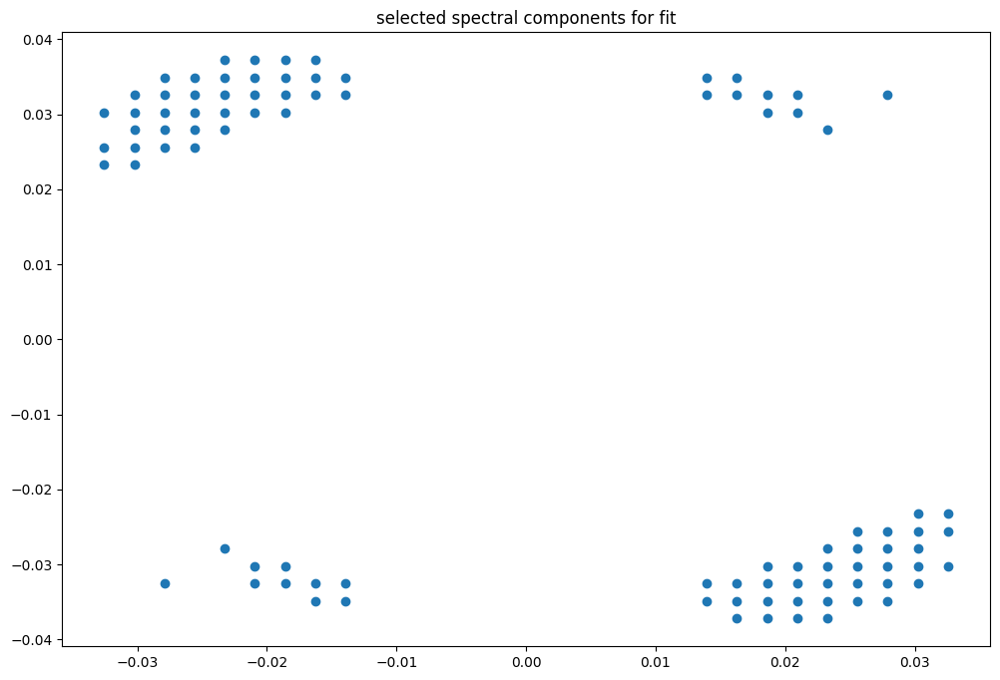

box [10000, 10700, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

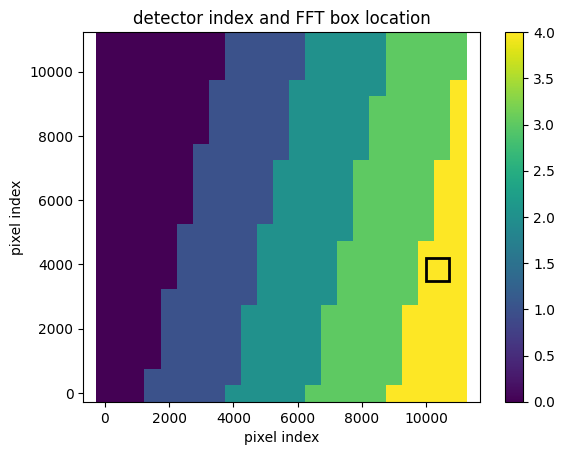

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986790806132827
(43, 43)
(43, 43)
(43, 43)


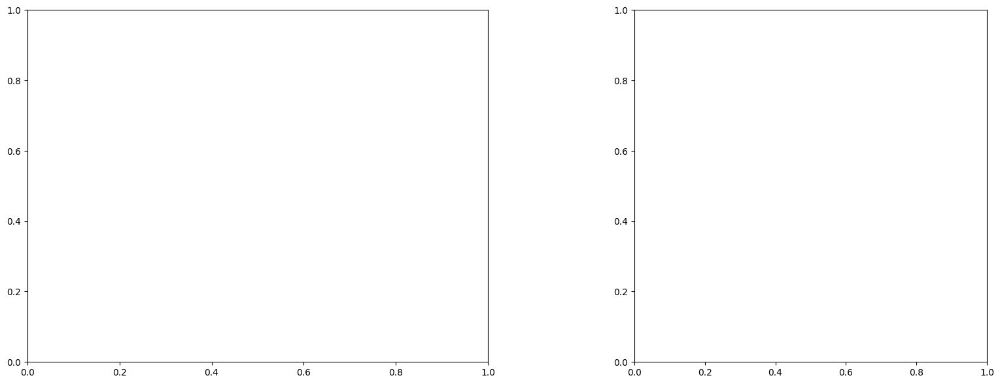

U and V components of current : [-0.18204277 -1.4034467 ]
uncertainties for U and V: 0.04841987886715031 0.03754440133821673


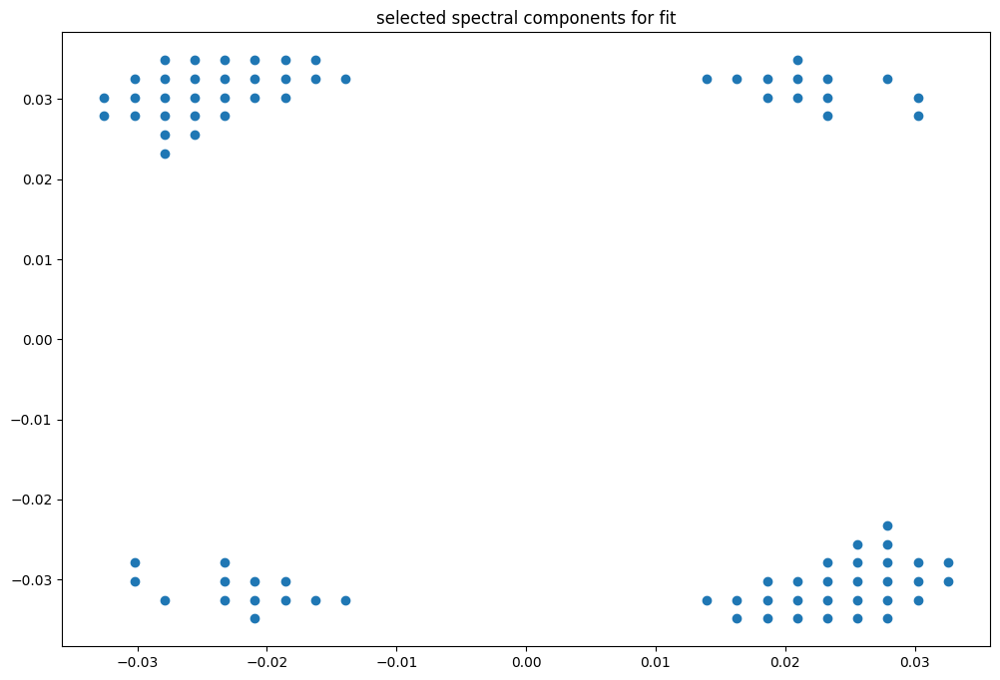

box [10000, 10700, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

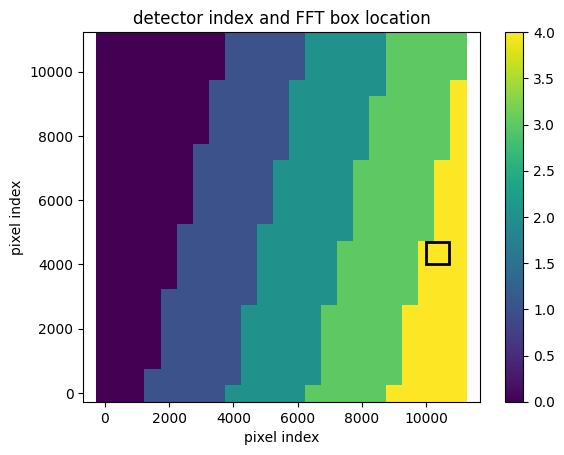

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986764529808695
(43, 43)
(43, 43)
(43, 43)


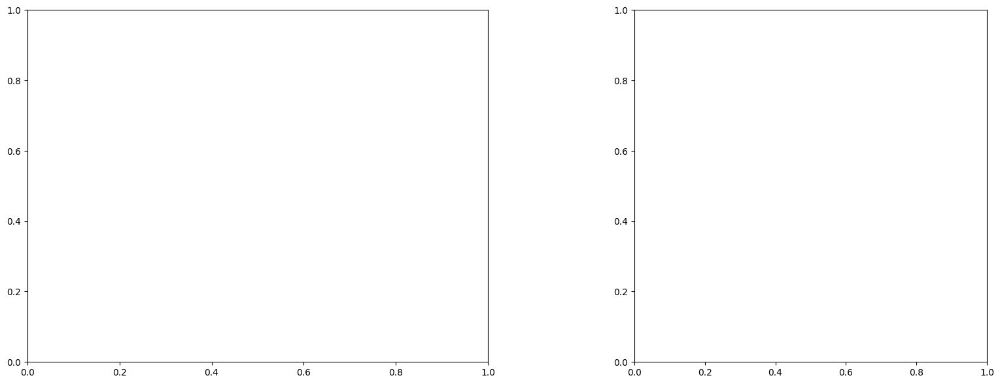

U and V components of current : [5.22247228 1.62266937]
uncertainties for U and V: 0.5815220258846148 0.48460480355752494


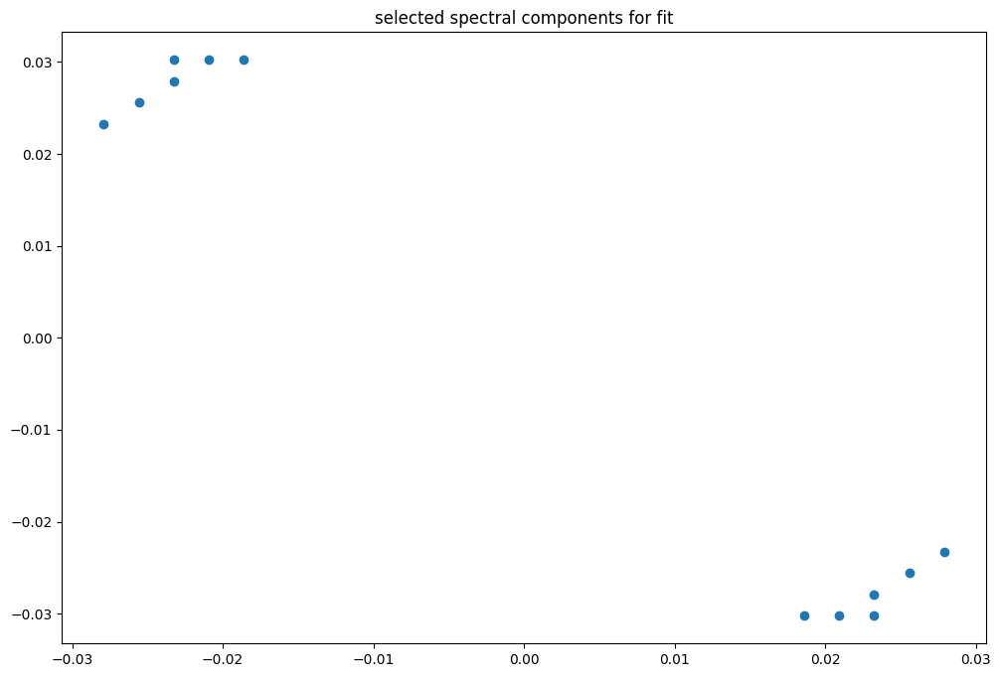

box [10000, 10700, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

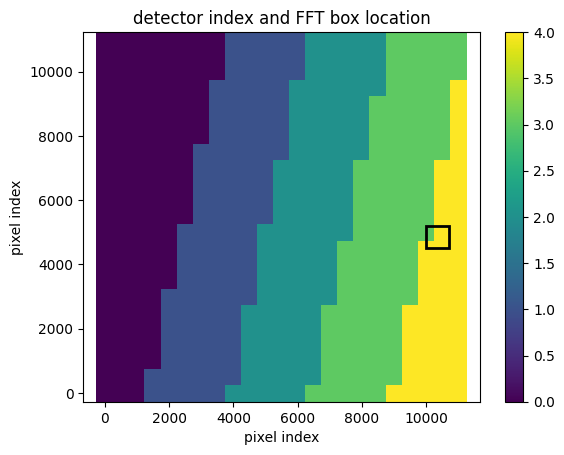

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.96
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986743432994498
(43, 43)
(43, 43)
(43, 43)


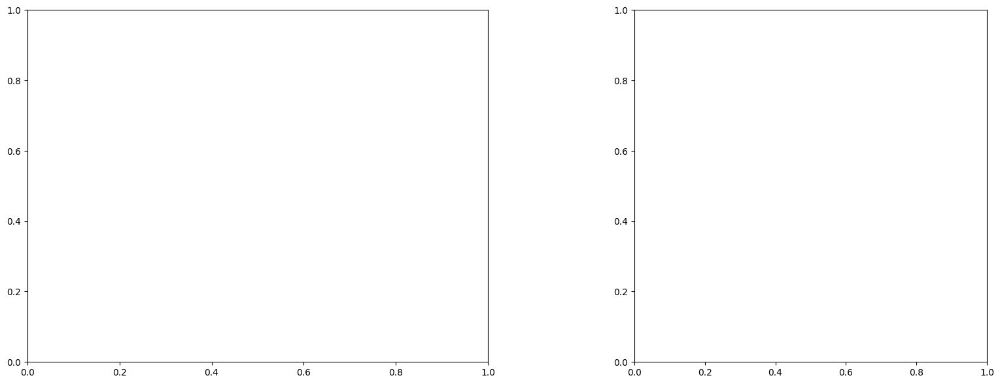

LinAlgError: Singular matrix

box [10000, 10700, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

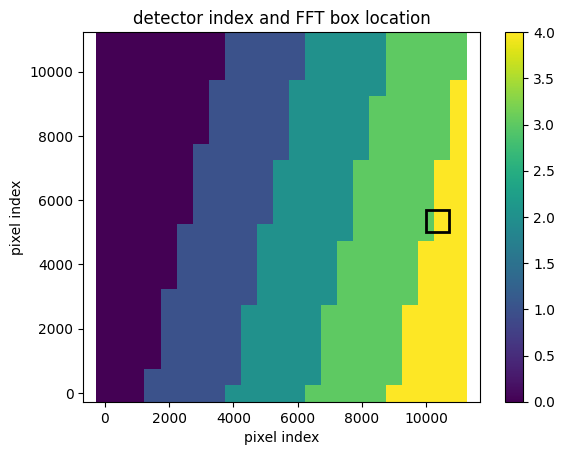

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.7
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986743432994498
(43, 43)
(43, 43)
(43, 43)


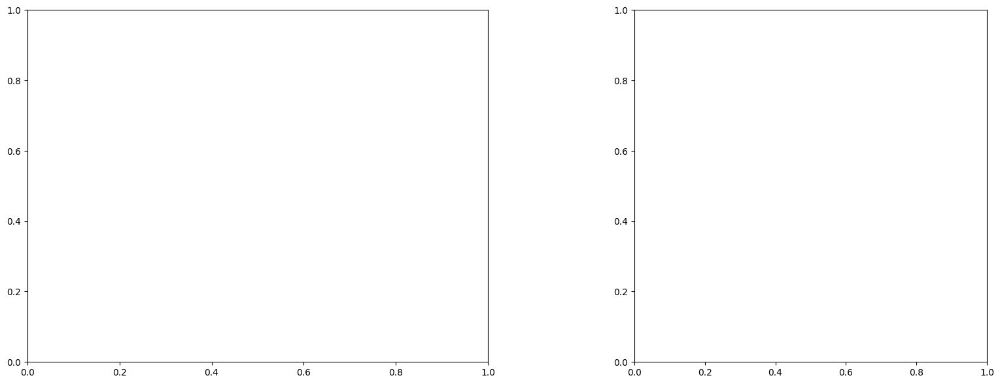

LinAlgError: Singular matrix

box [10000, 10700, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

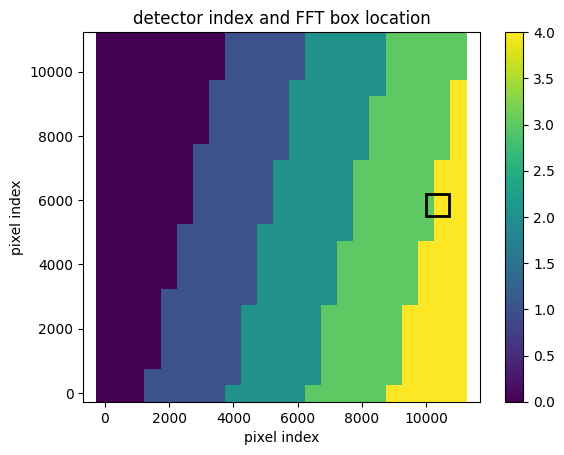

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998671921149302
(43, 43)
(43, 43)
(43, 43)


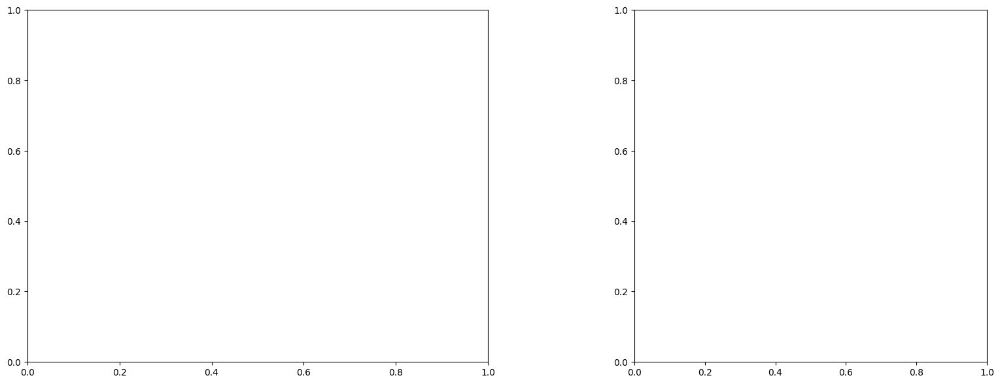

LinAlgError: Singular matrix

box [10000, 10700, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

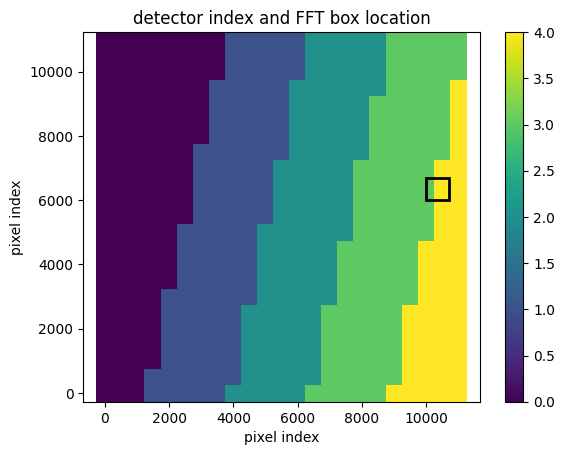

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.7
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986696155229878
(43, 43)
(43, 43)
(43, 43)


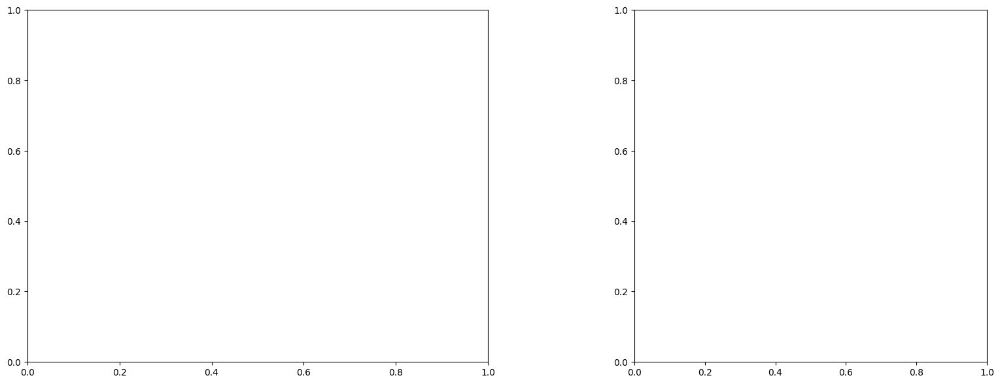

LinAlgError: Singular matrix

box [10000, 10700, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

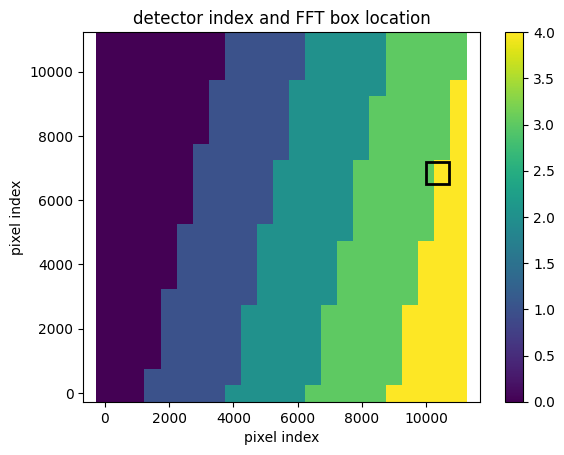

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.6999999999999997
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998667524706283
(43, 43)
(43, 43)
(43, 43)


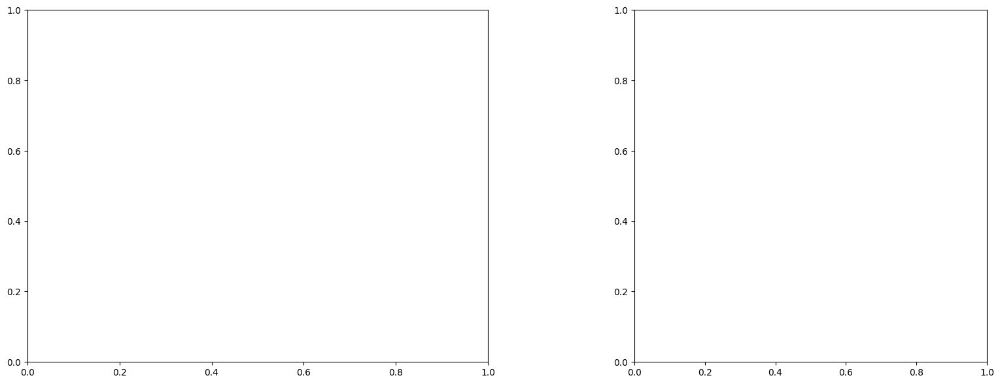

LinAlgError: Singular matrix

box [10000, 10700, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

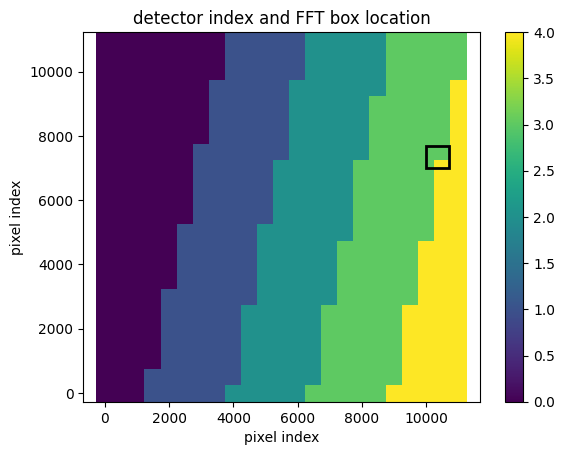

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947302466442359
(43, 43)
(43, 43)
(43, 43)


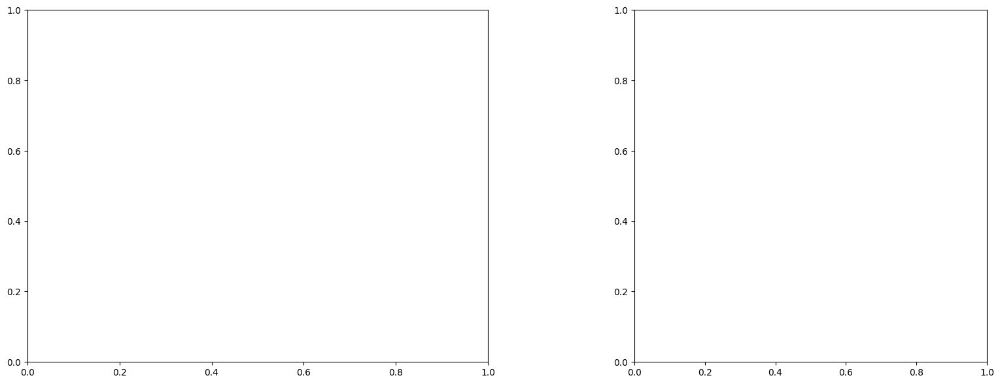

U and V components of current : [-0.13287977 -1.89345664]
uncertainties for U and V: 0.047353473591884764 0.0416764619808503


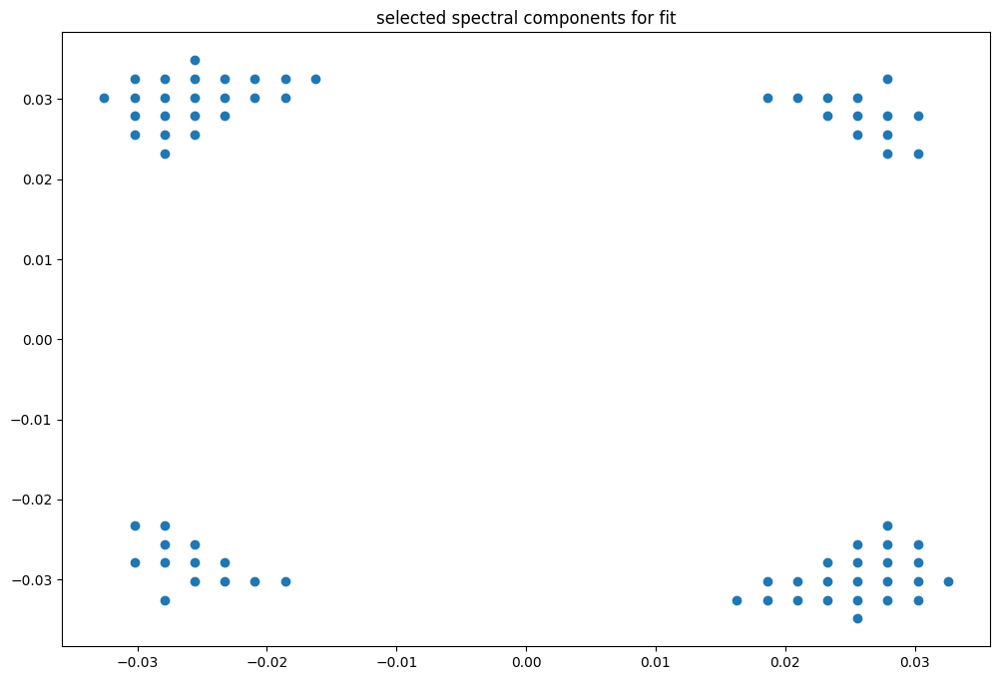

box [10000, 10700, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

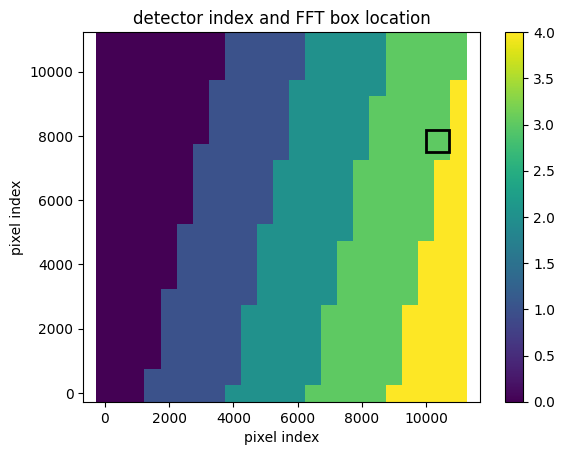

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(43, 43)
(43, 43)
(43, 43)


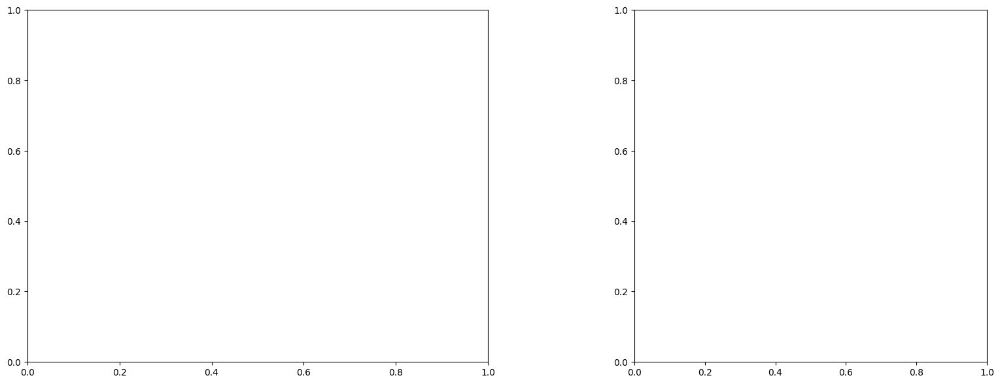

U and V components of current : [ 0.03846375 -1.41364156]
uncertainties for U and V: 0.03367503831414028 0.030345868193871556


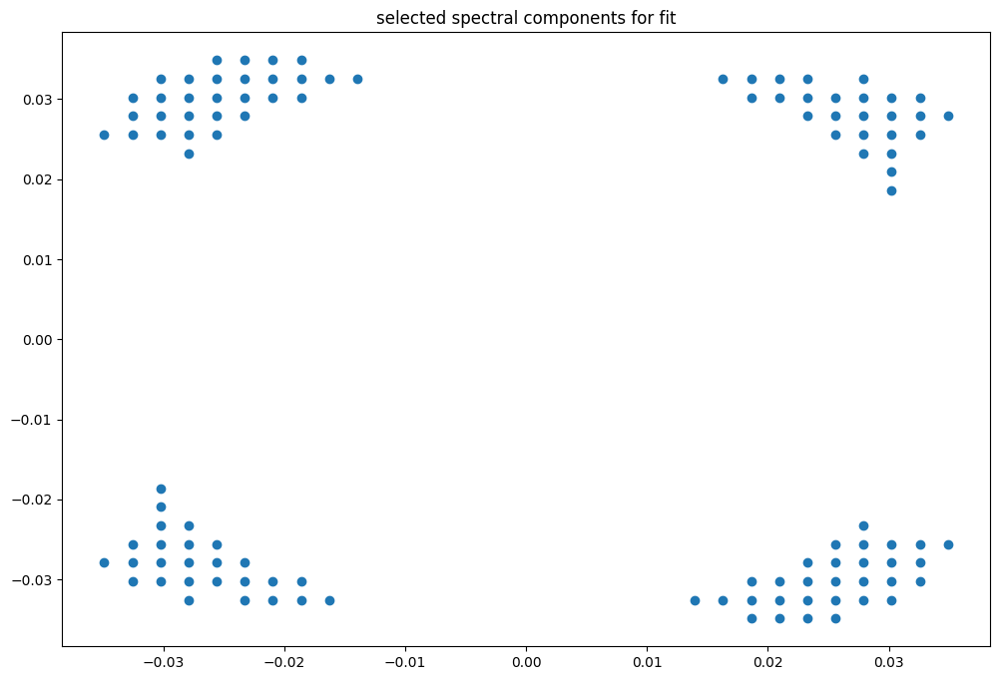

box [10000, 10700, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

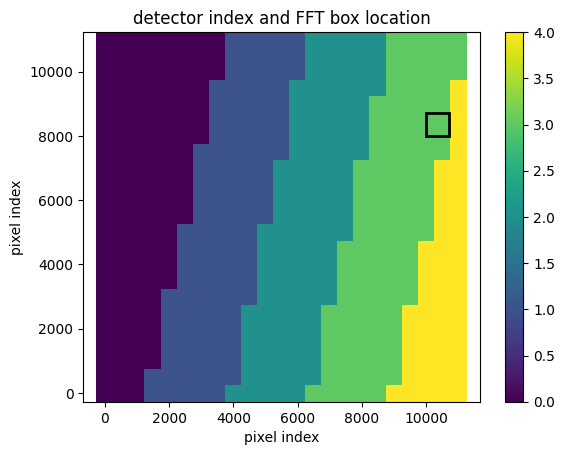

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


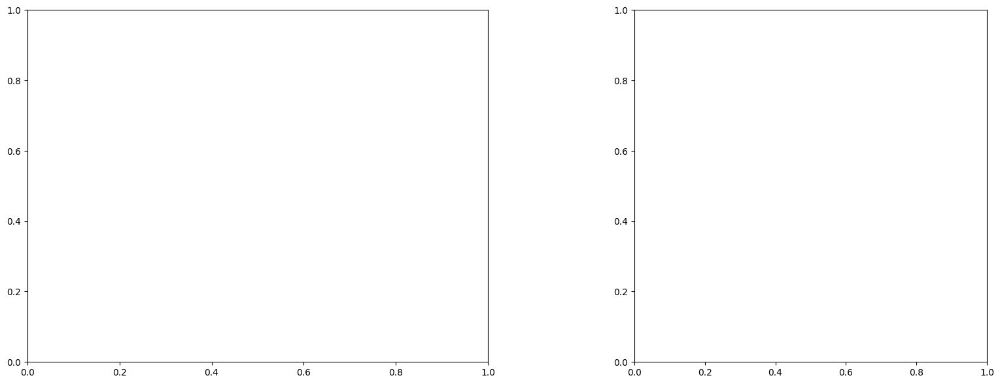

U and V components of current : [ 0.08737192 -1.40375115]
uncertainties for U and V: 0.03518170104446535 0.03129860112618266


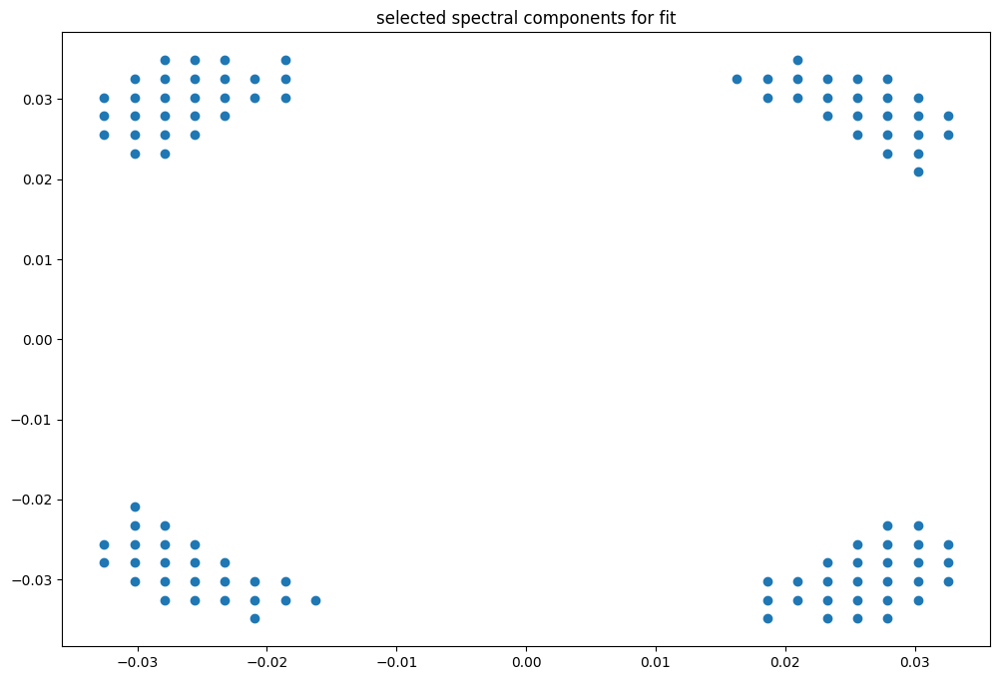

box [10000, 10700, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

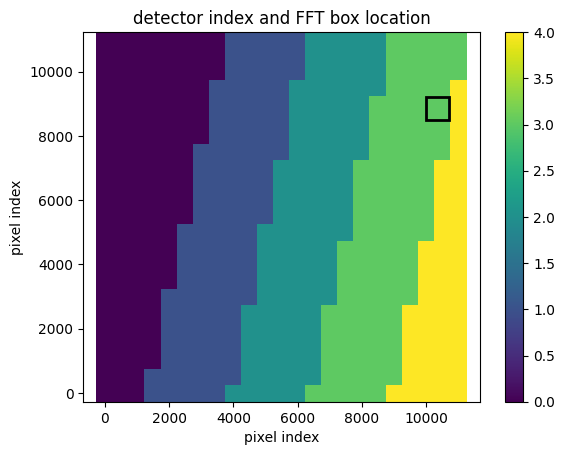

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(43, 43)
(43, 43)
(43, 43)


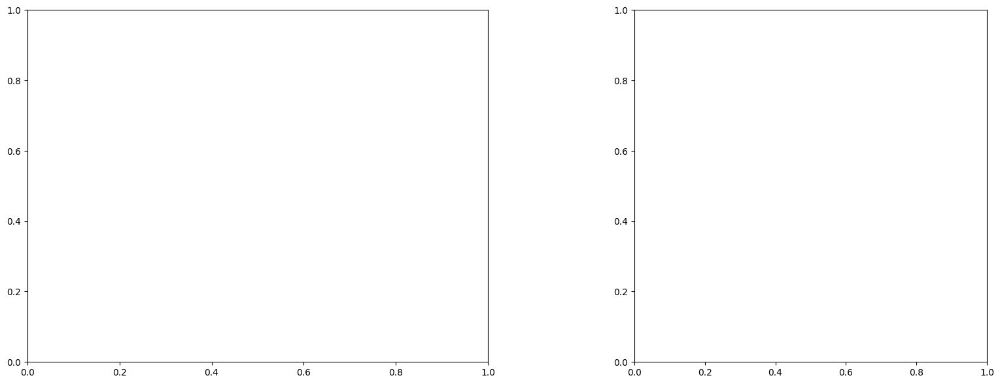

U and V components of current : [-0.10932004 -1.65303117]
uncertainties for U and V: 0.04466270875197803 0.04124103858058015


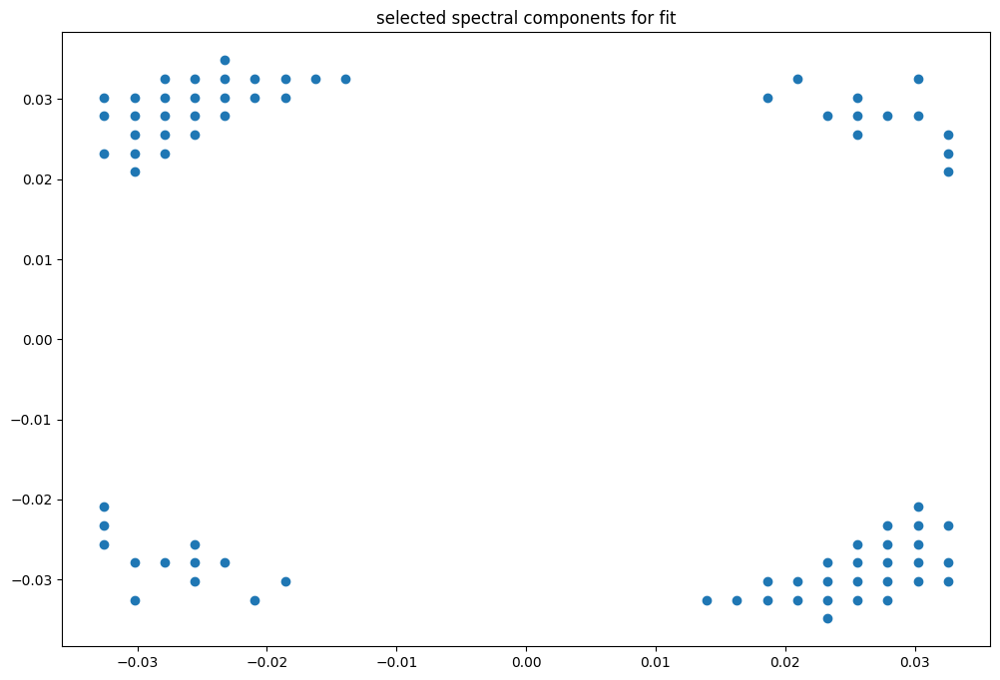

box [10000, 10700, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

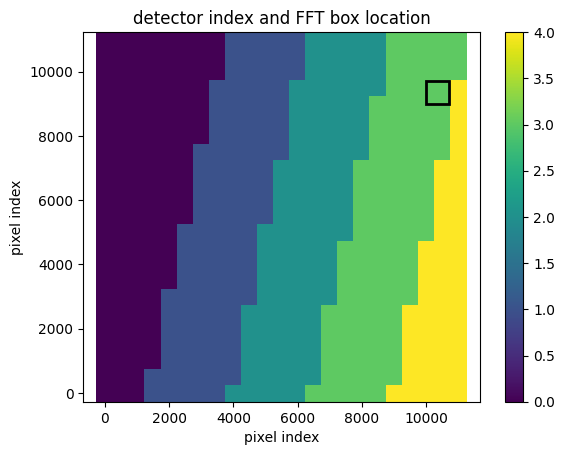

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(43, 43)
(43, 43)
(43, 43)


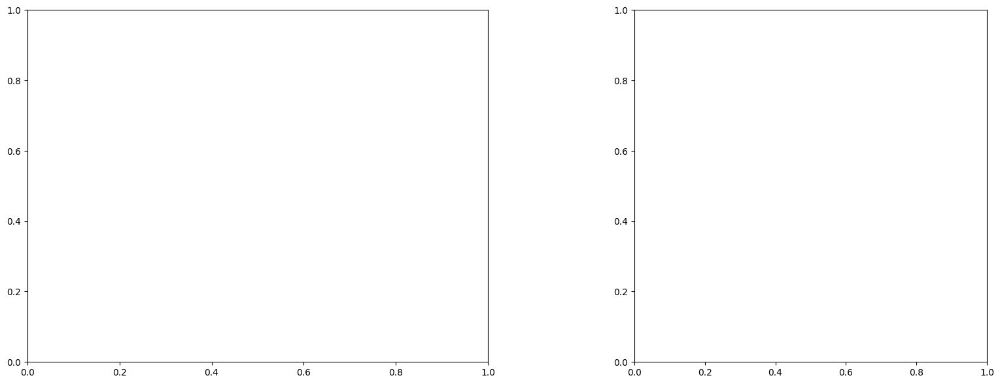

U and V components of current : [-0.21739107 -1.9262981 ]
uncertainties for U and V: 0.04748479238823361 0.04287933932440961


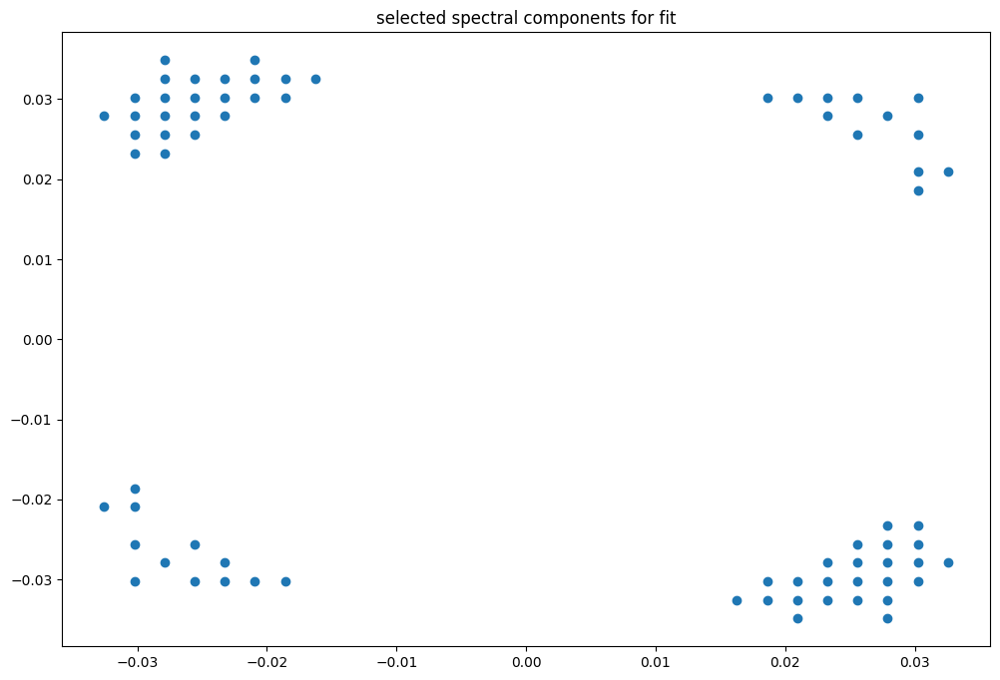

box [10000, 10700, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Read

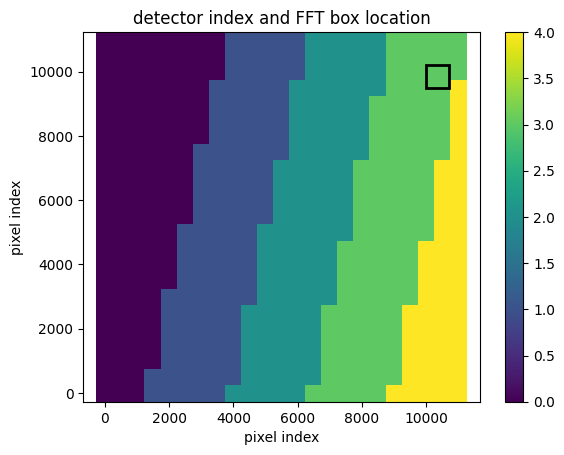

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(43, 43)
(43, 43)
(43, 43)


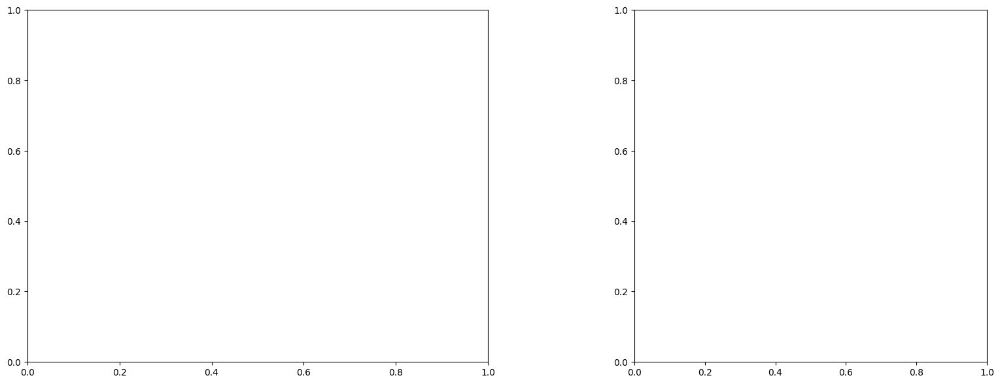

U and V components of current : [-0.12353752 -1.65731745]
uncertainties for U and V: 0.040187452673408494 0.036952873707475915


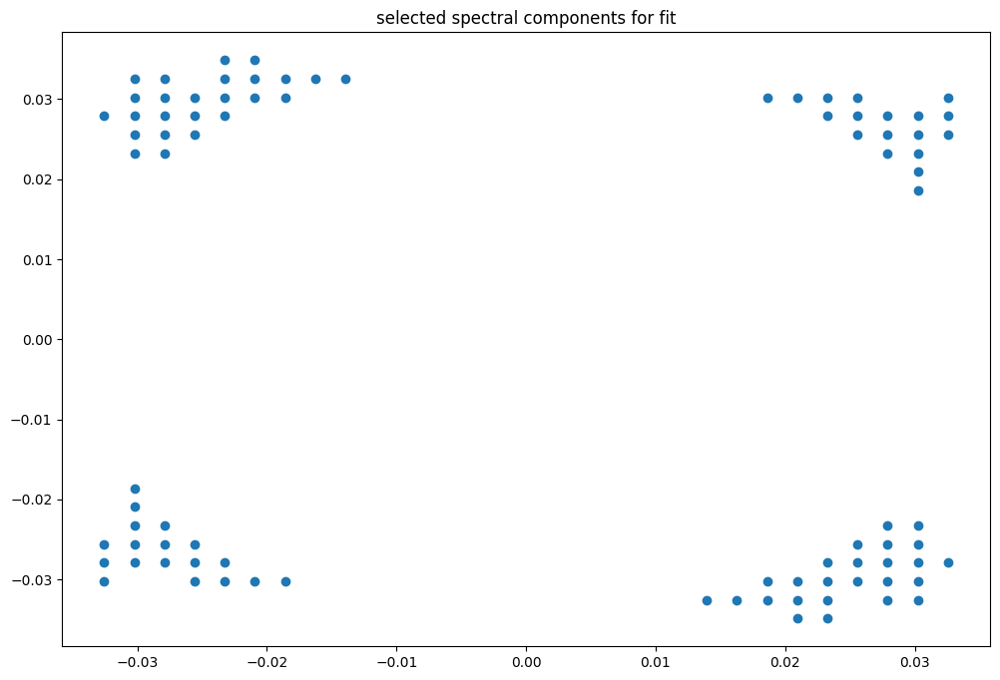

box [10000, 10700, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Rea

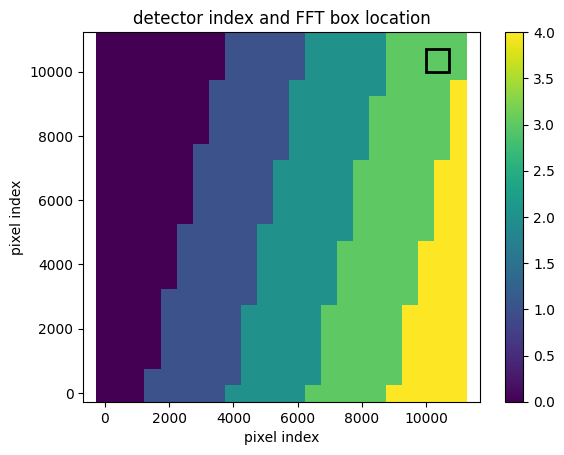

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(43, 43)
(43, 43)
(43, 43)


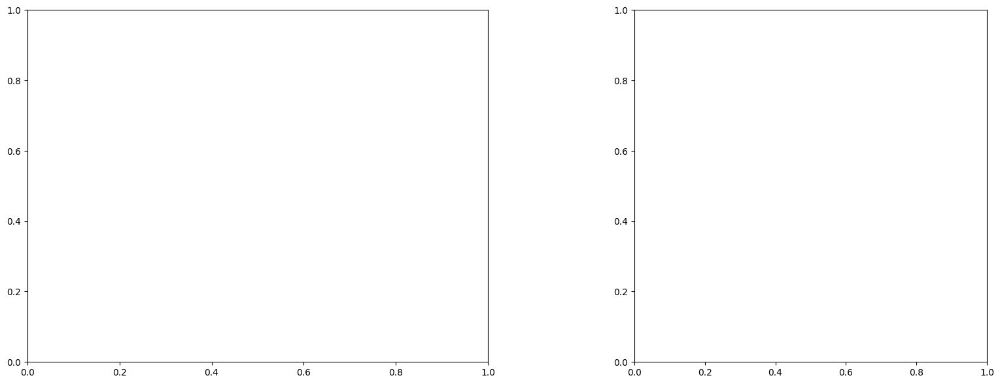

U and V components of current : [-0.15014345 -1.44768934]
uncertainties for U and V: 0.04303949401237259 0.04175997359384486


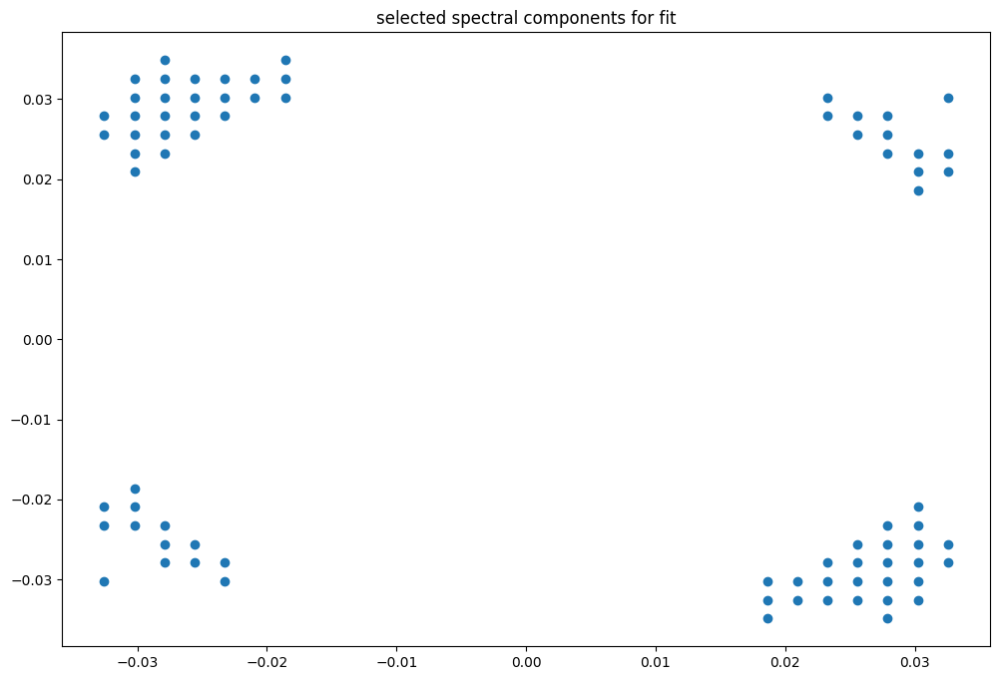

box [10000, 10700, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Rea

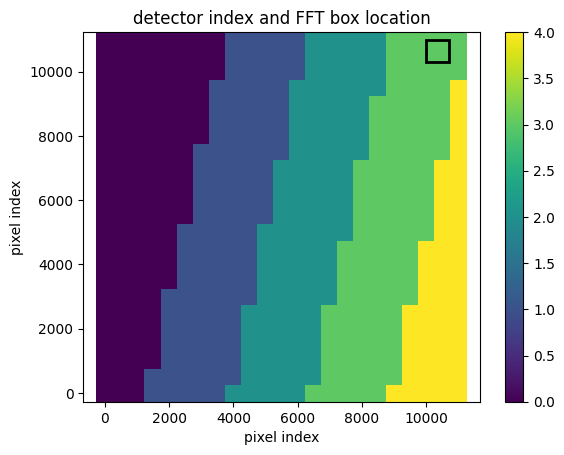

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
2.9999999999999996
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(43, 42)
(43, 42)
(43, 42)


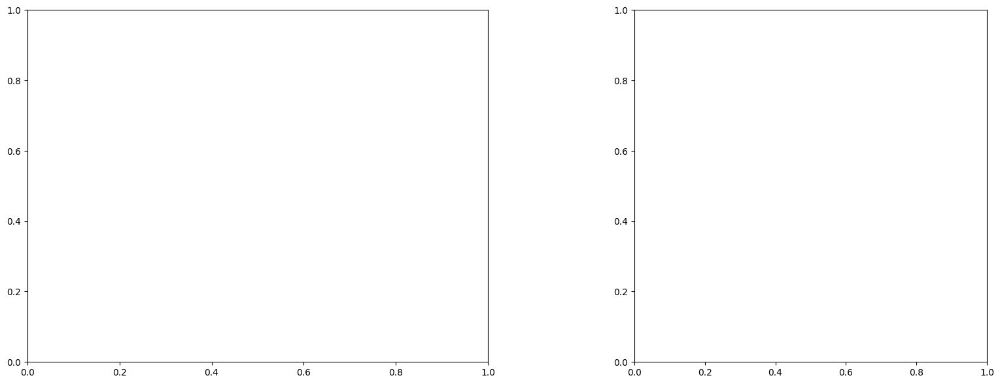

U and V components of current : [-0.19207834 -1.56515412]
uncertainties for U and V: 0.043625924347126054 0.04017531977064738


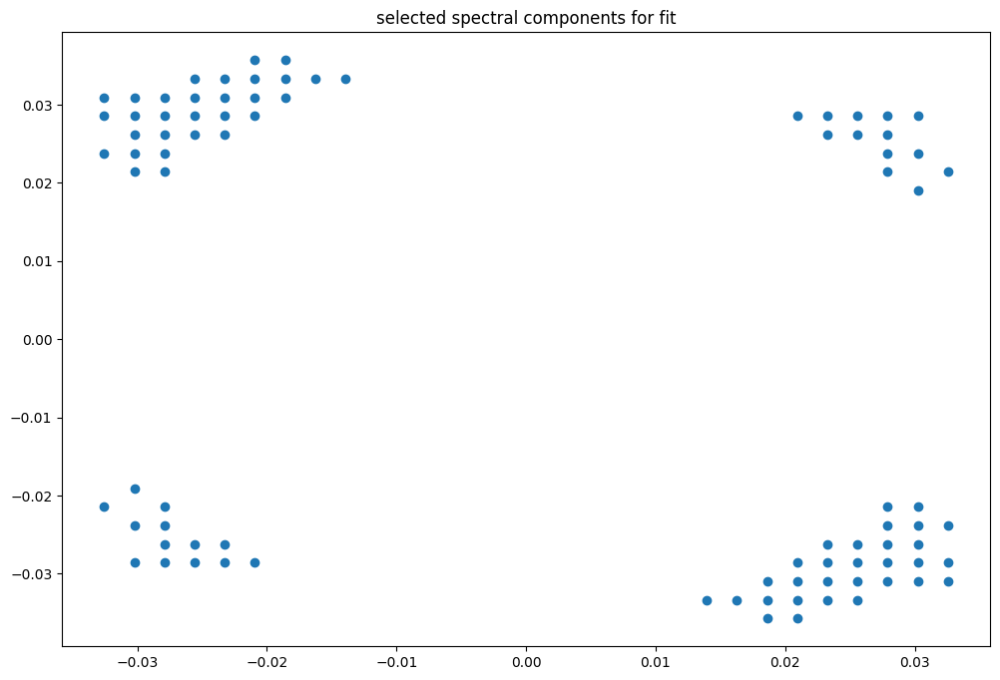

box [10300, 11000, 0, 700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Reading f

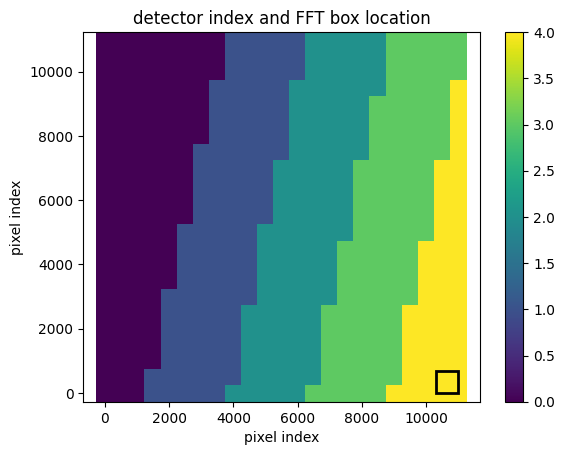

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986919089100021
(42, 43)
(42, 43)
(42, 43)


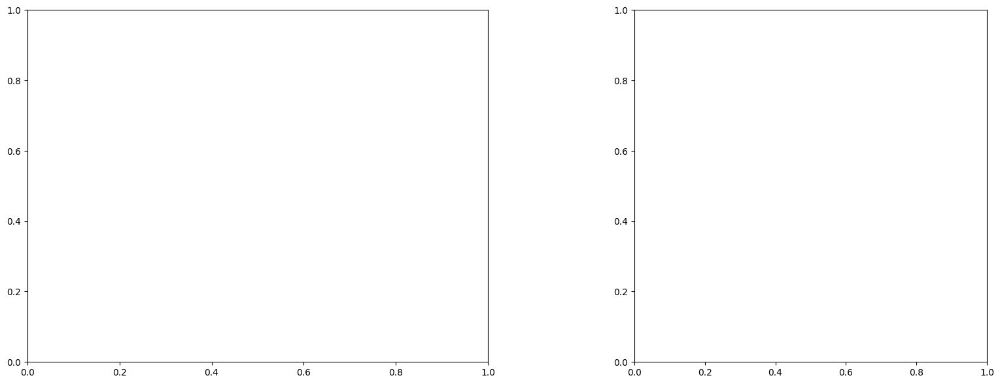

U and V components of current : [ 1.47419954 -0.2255988 ]
uncertainties for U and V: 0.04364643581176211 0.0439693447322369


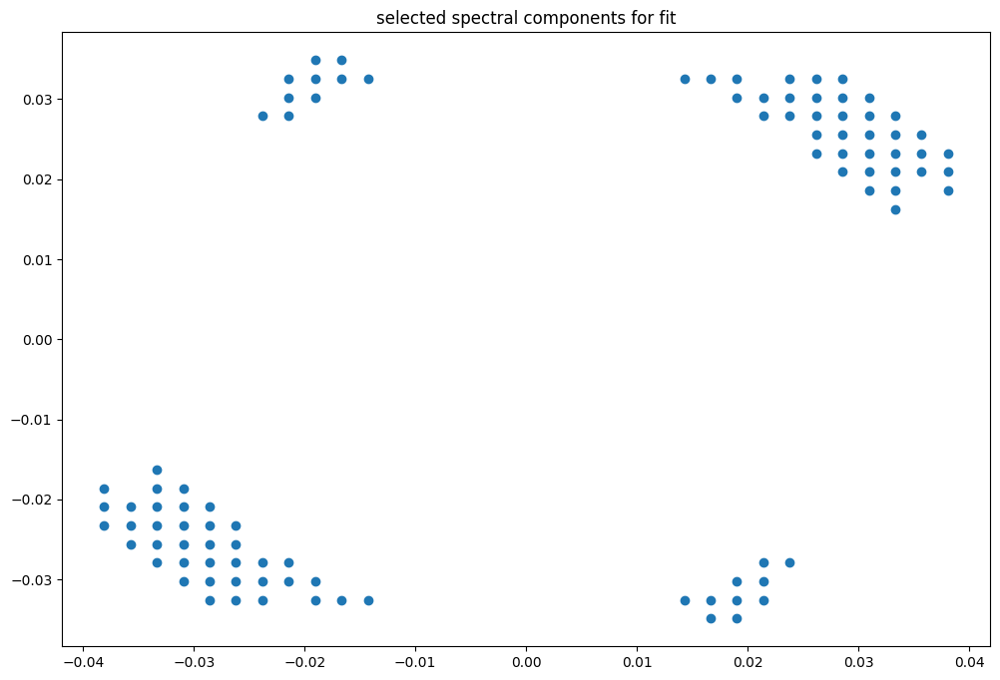

box [10300, 11000, 500, 1200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readin

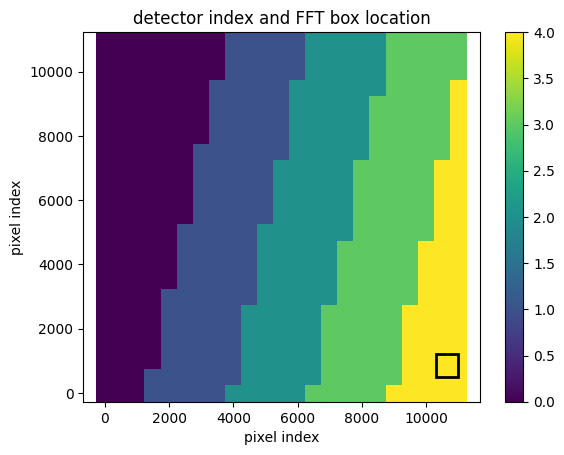

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986891689813736
(42, 43)
(42, 43)
(42, 43)


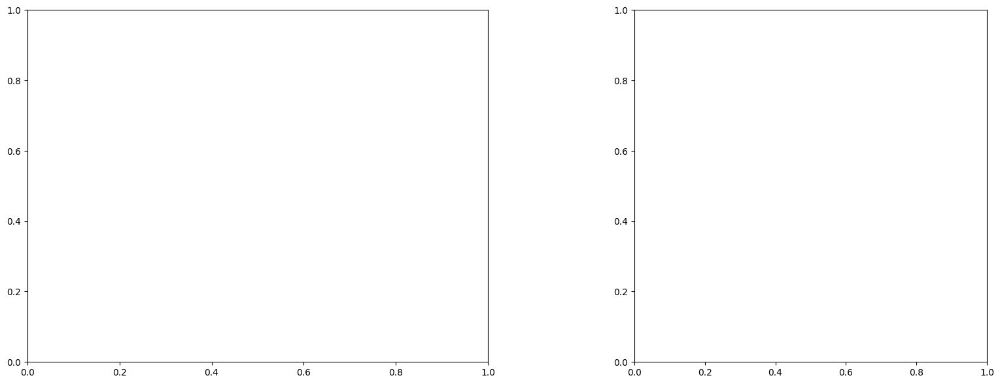

U and V components of current : [1.28686759 0.25691249]
uncertainties for U and V: 0.03758544249167805 0.030196310203739134


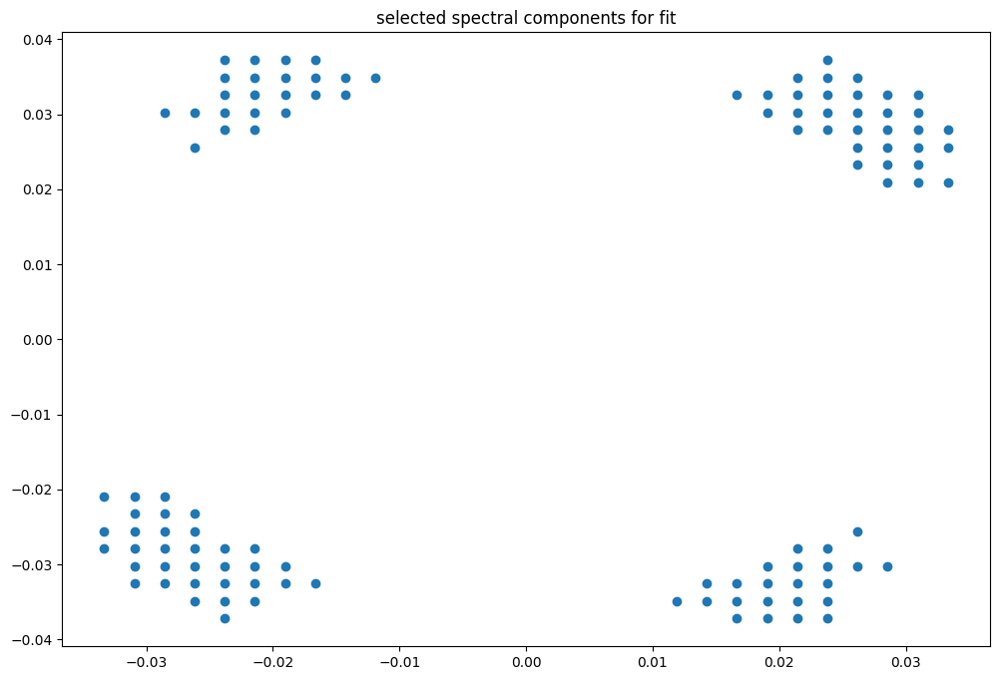

box [10300, 11000, 1000, 1700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

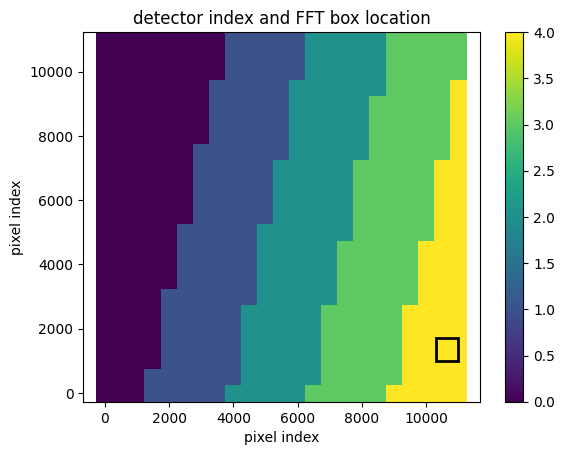

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(42, 43)
(42, 43)
(42, 43)


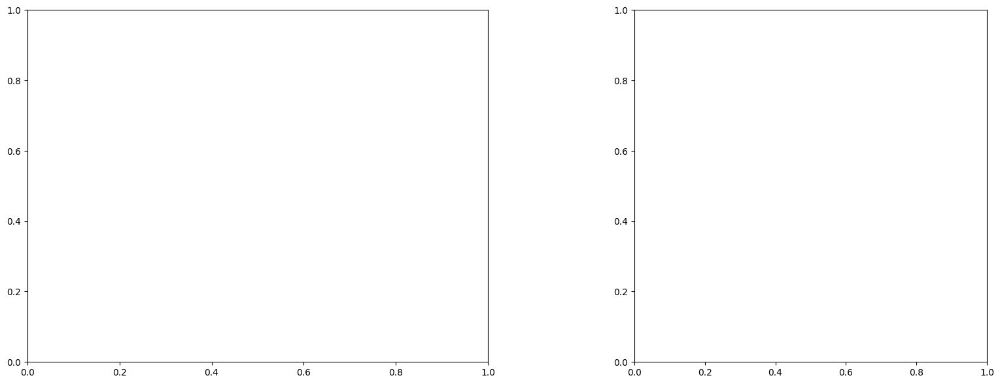

U and V components of current : [ 1.10646325 -0.45121092]
uncertainties for U and V: 0.04010994652677304 0.03169333318639537


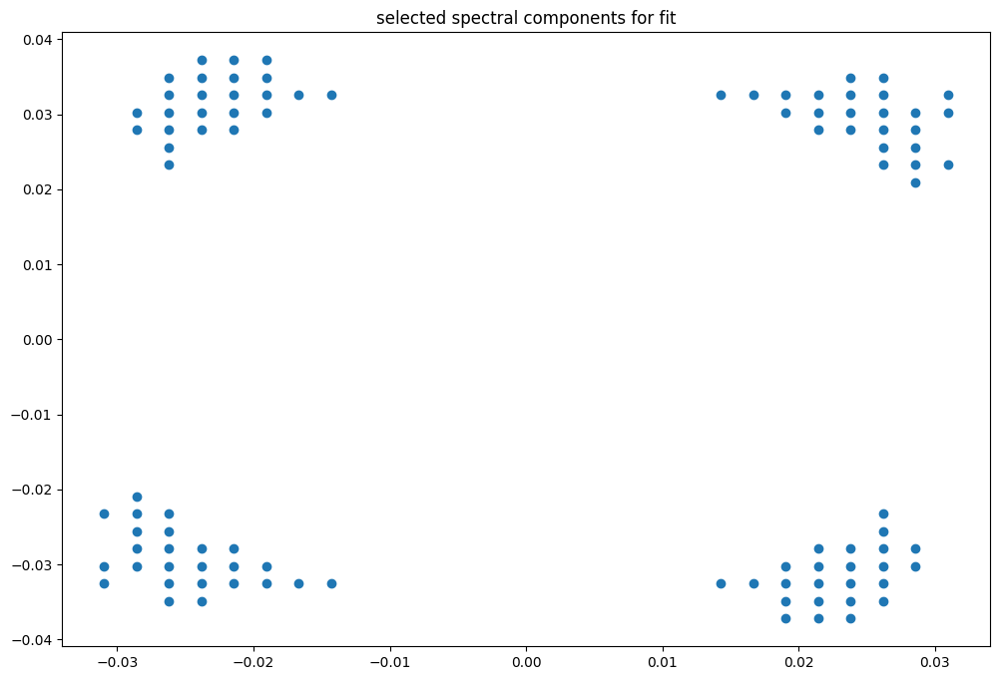

box [10300, 11000, 1500, 2200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

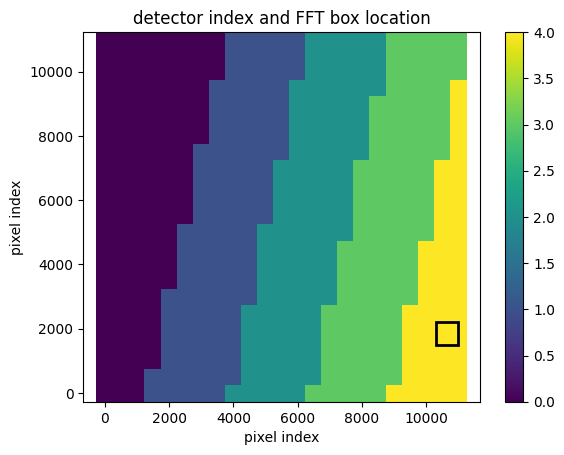

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998686653690387
(42, 43)
(42, 43)
(42, 43)


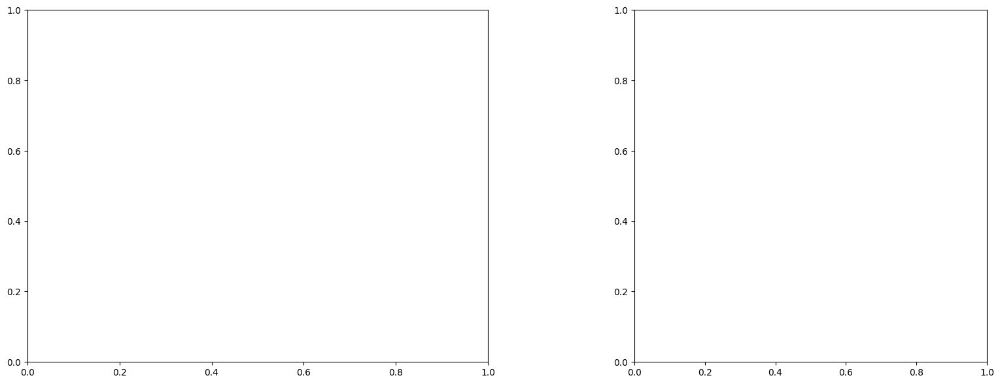

U and V components of current : [ 0.9852419 -0.3004463]
uncertainties for U and V: 0.04064456215691607 0.03208236054743284


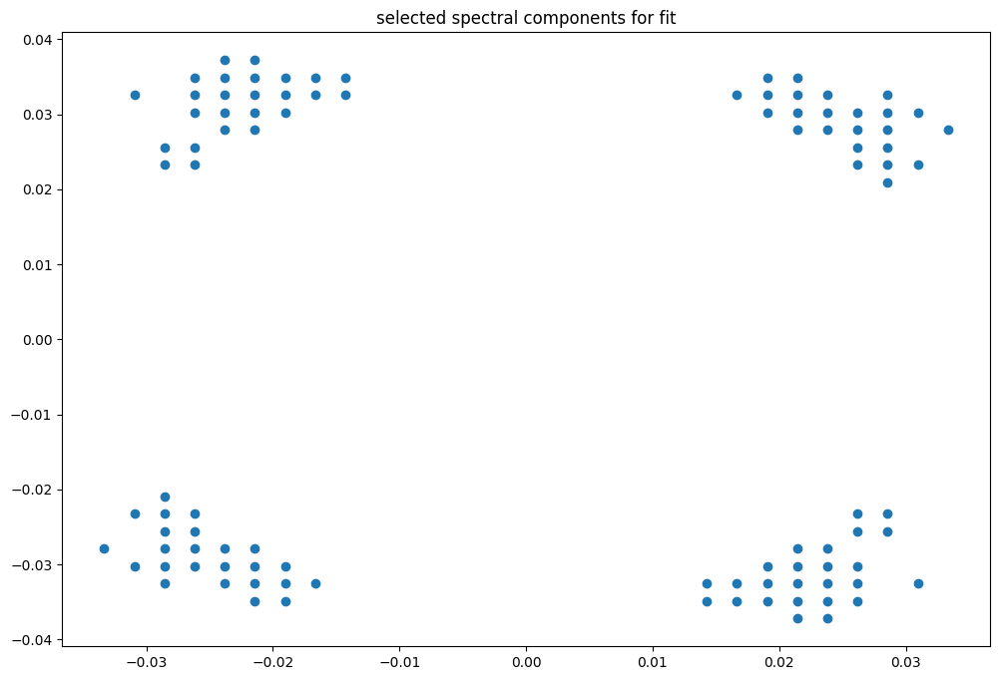

box [10300, 11000, 2000, 2700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

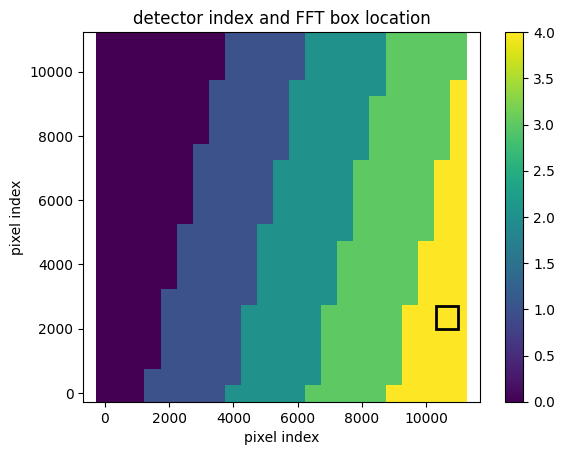

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986839558703013
(42, 43)
(42, 43)
(42, 43)


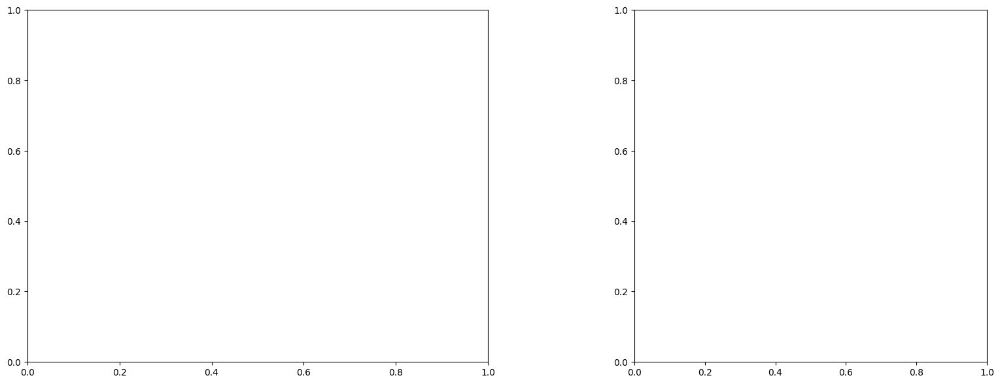

U and V components of current : [ 0.27819066 -1.16337014]
uncertainties for U and V: 0.04677810077006784 0.0340855926749307


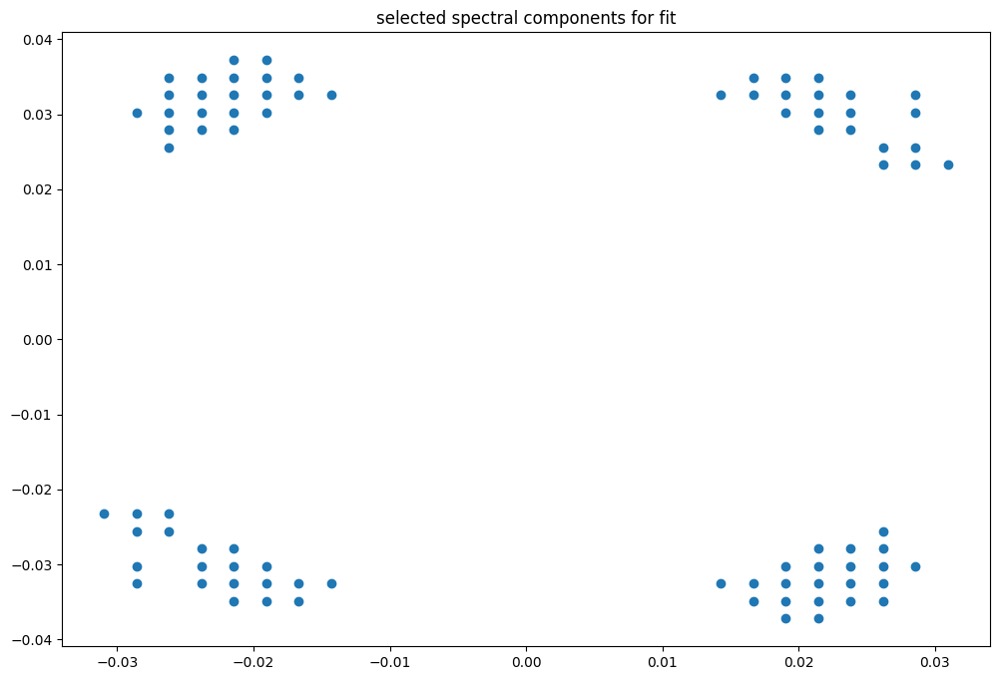

box [10300, 11000, 2500, 3200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

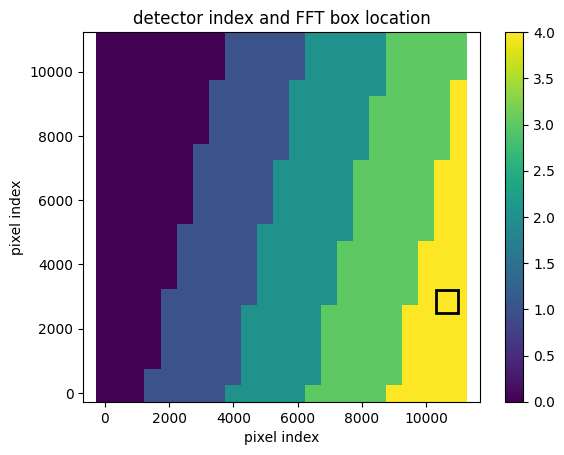

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986813595194435
(42, 43)
(42, 43)
(42, 43)


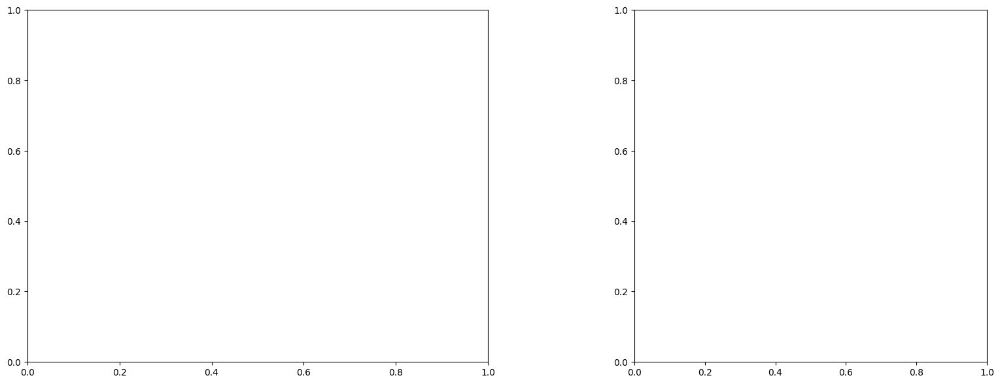

U and V components of current : [ 0.3223828  -1.05221251]
uncertainties for U and V: 0.04808078075669426 0.036016773490768136


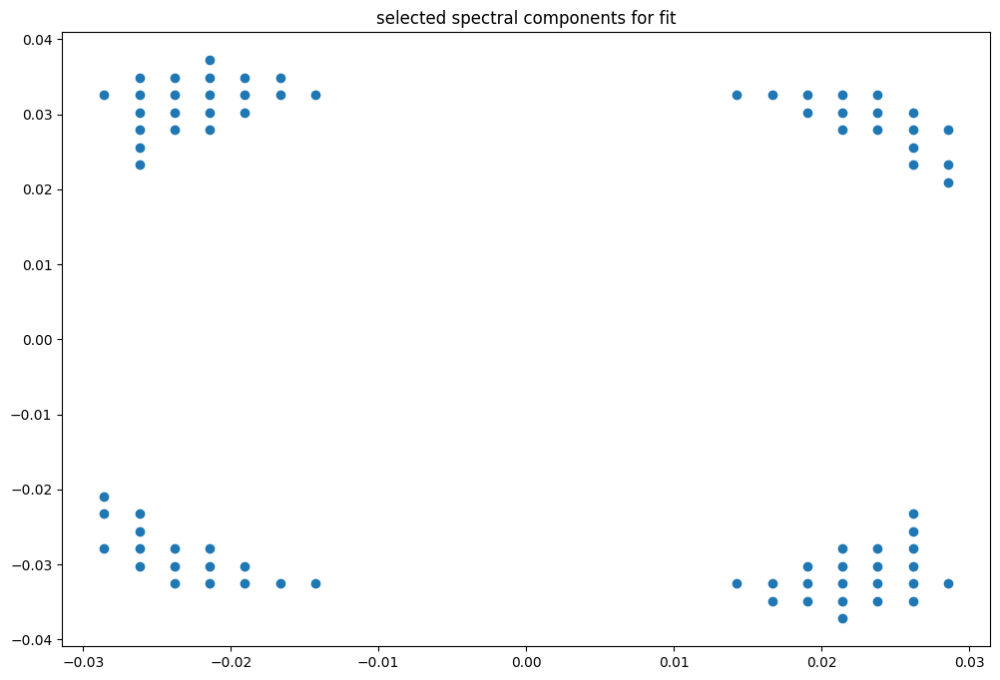

box [10300, 11000, 3000, 3700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

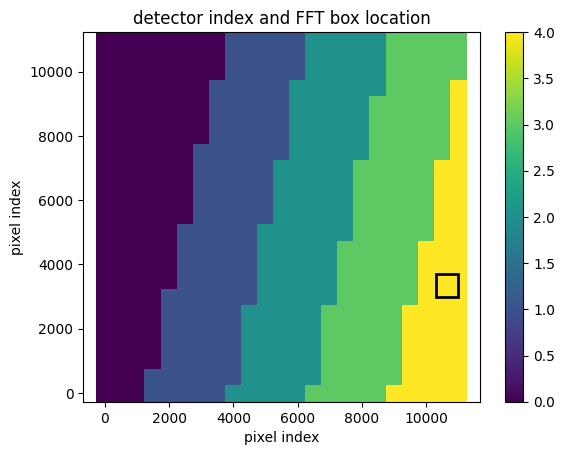

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986790806132827
(42, 43)
(42, 43)
(42, 43)


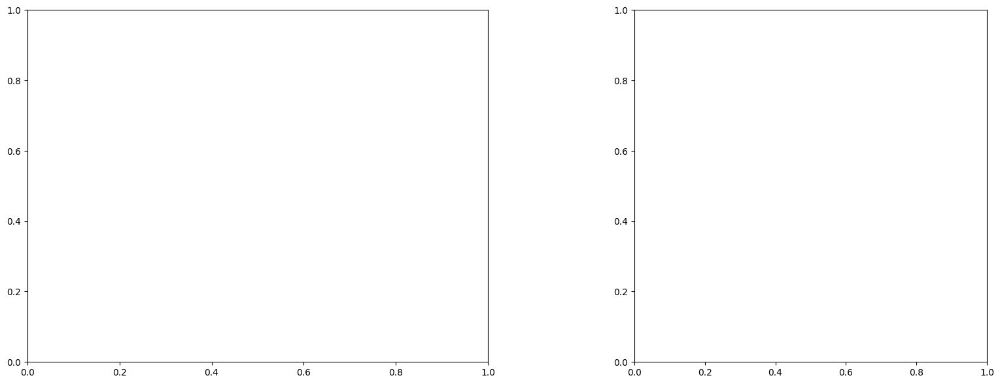

U and V components of current : [ 0.13050024 -1.12180953]
uncertainties for U and V: 0.05033220617141781 0.0381136929343107


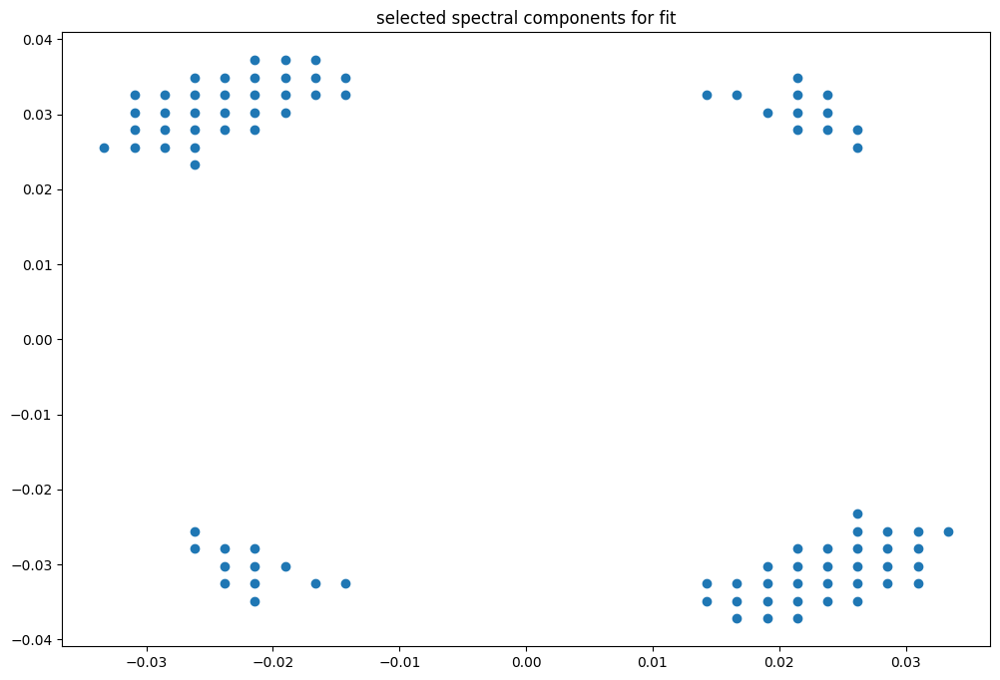

box [10300, 11000, 3500, 4200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

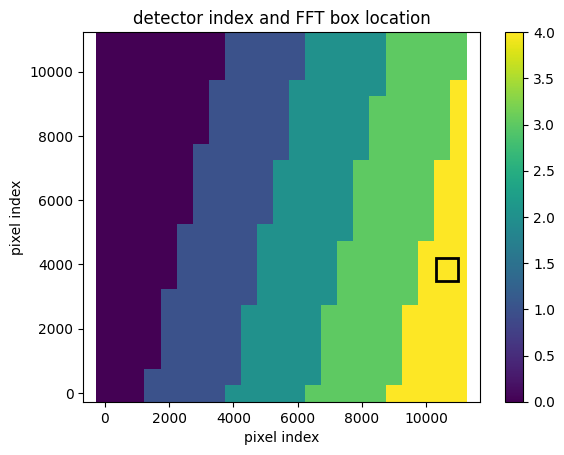

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986790806132827
(42, 43)
(42, 43)
(42, 43)


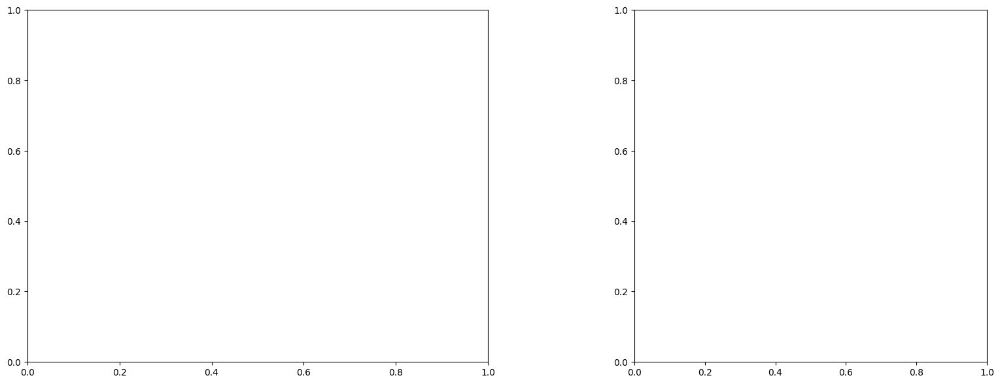

U and V components of current : [-0.15262339 -1.7577393 ]
uncertainties for U and V: 0.06278513082925793 0.04640173238426813


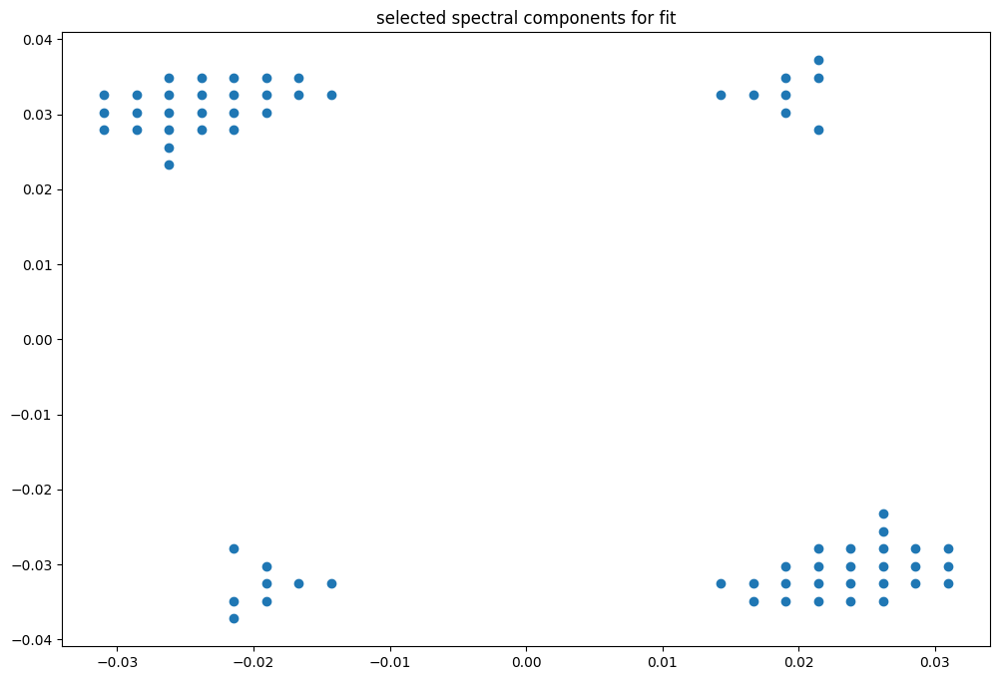

box [10300, 11000, 4000, 4700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

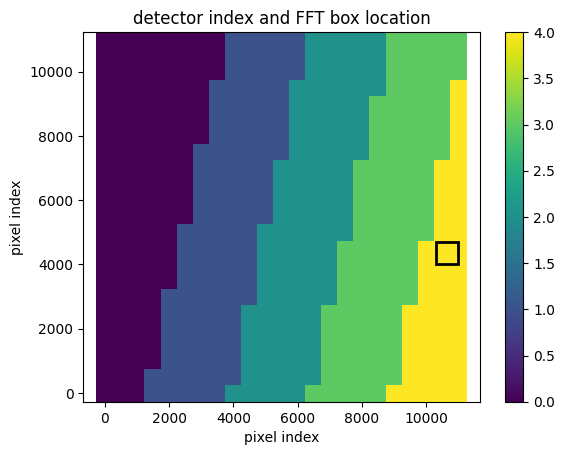

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986764529808695
(42, 43)
(42, 43)
(42, 43)


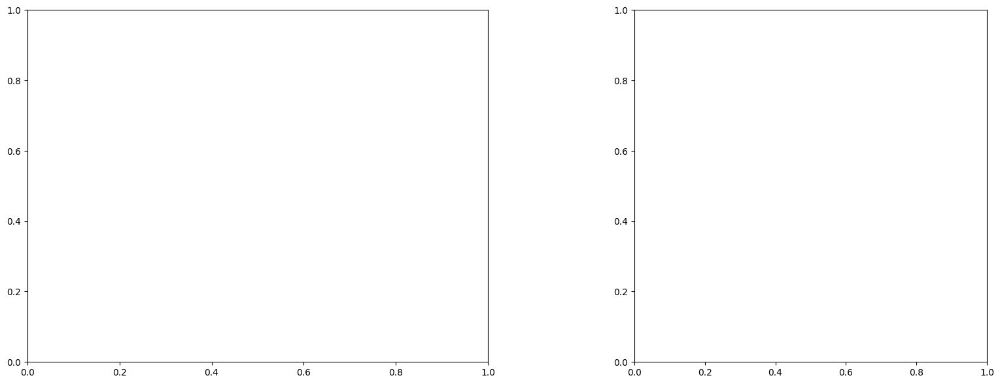

U and V components of current : [ 0.13332513 -1.85021782]
uncertainties for U and V: 0.05960356798849938 0.04565048610637375


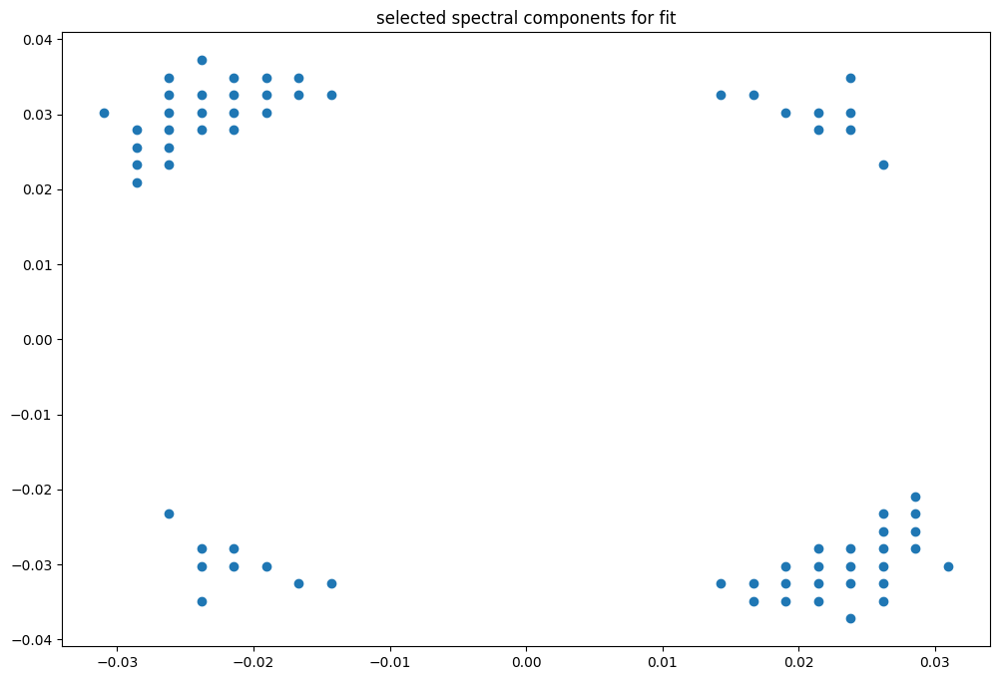

box [10300, 11000, 4500, 5200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

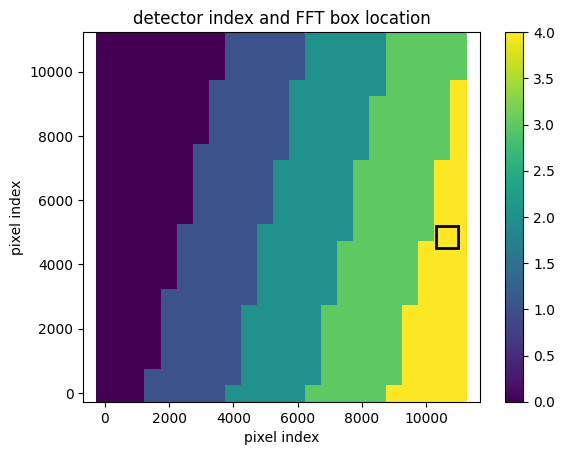

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986743432994498
(42, 43)
(42, 43)
(42, 43)


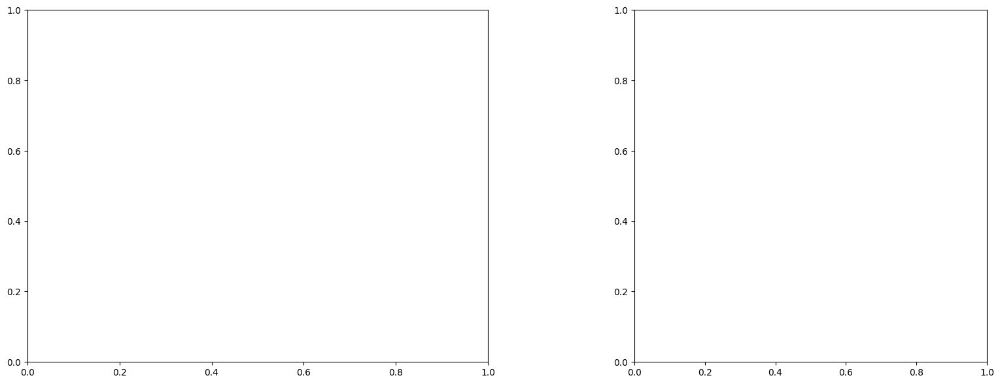

U and V components of current : [-0.22890512 -2.10735669]
uncertainties for U and V: 0.051918179979789335 0.039904623785273326


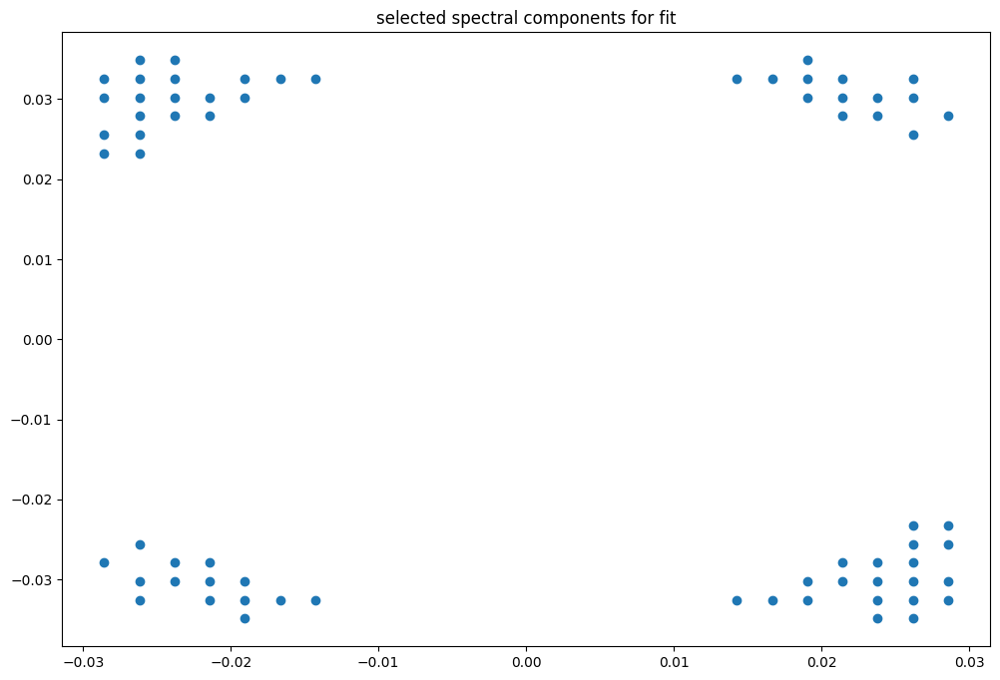

box [10300, 11000, 5000, 5700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

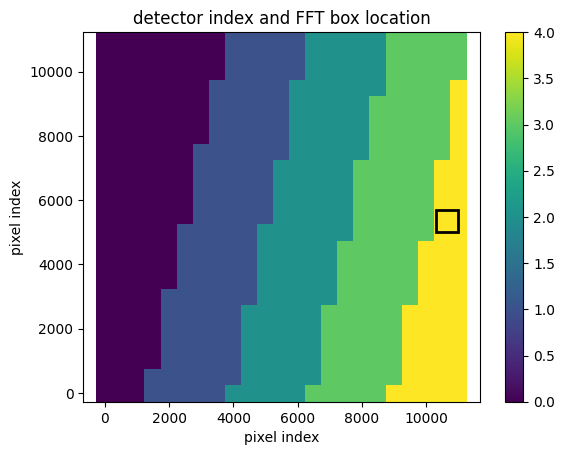

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986743432994498
(42, 43)
(42, 43)
(42, 43)


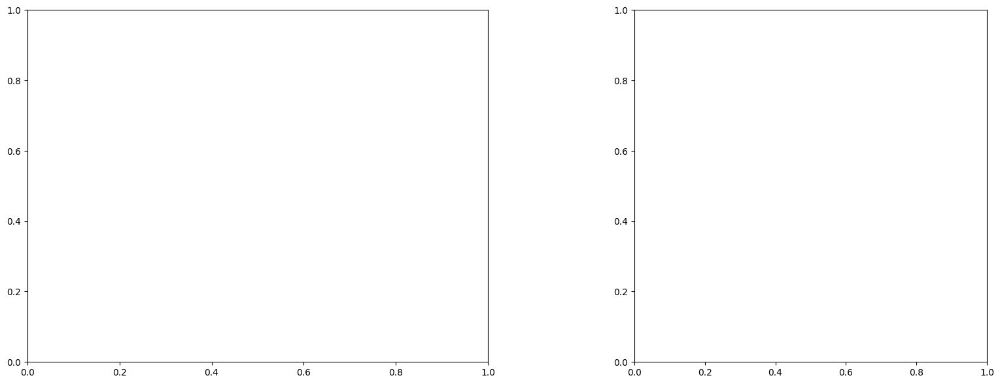

U and V components of current : [-0.66971842 -2.08745464]
uncertainties for U and V: 0.051710057567004815 0.041157558545494514


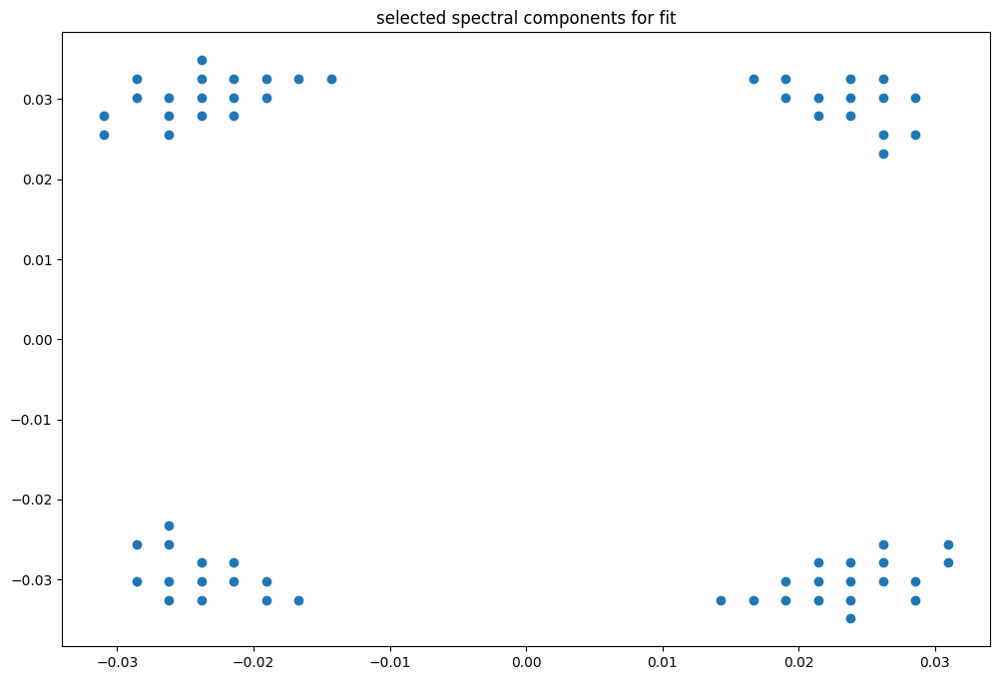

box [10300, 11000, 5500, 6200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

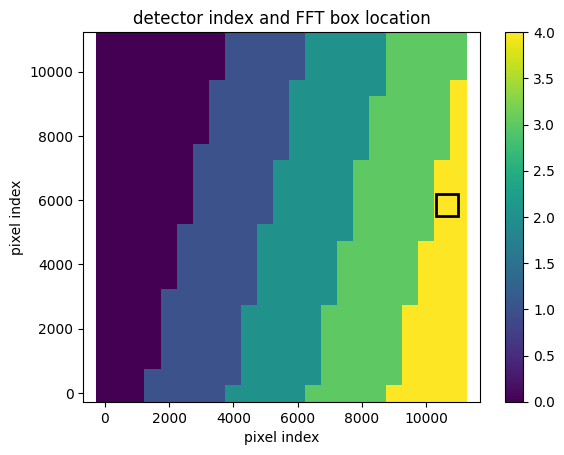

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998671921149302
(42, 43)
(42, 43)
(42, 43)


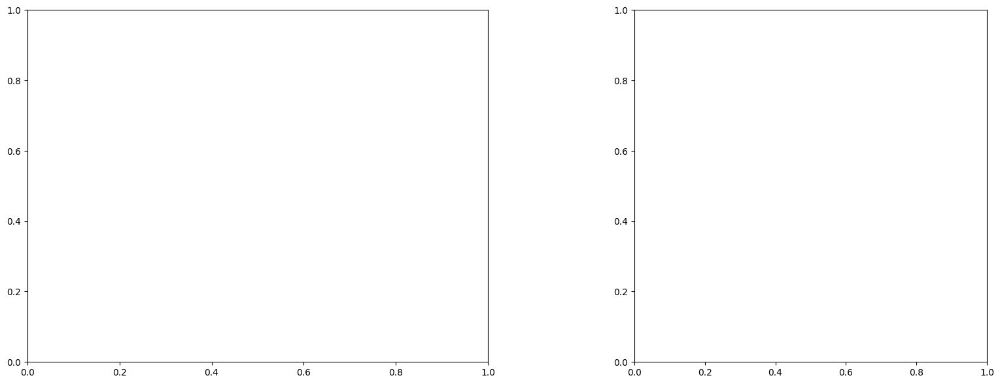

LinAlgError: Singular matrix

box [10300, 11000, 6000, 6700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

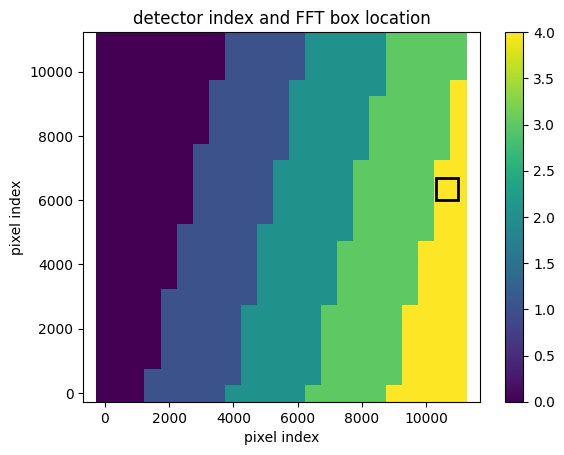

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.9986696155229878
(42, 43)
(42, 43)
(42, 43)


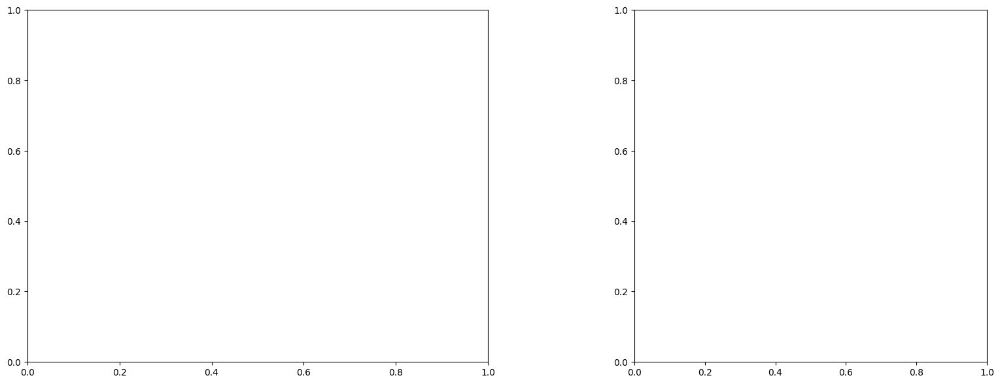

LinAlgError: Singular matrix

box [10300, 11000, 6500, 7200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

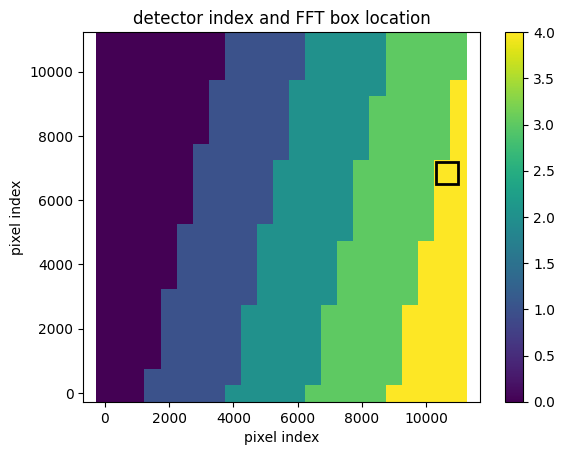

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
4.0
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998667524706283
(42, 43)
(42, 43)
(42, 43)


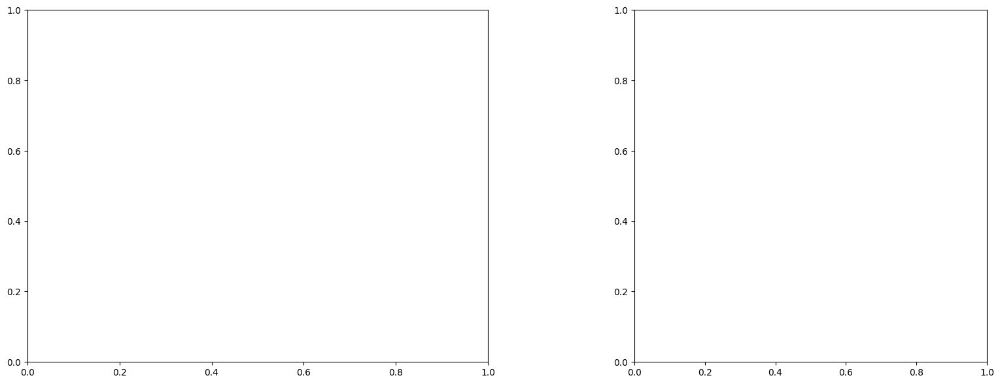

LinAlgError: Singular matrix

box [10300, 11000, 7000, 7700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

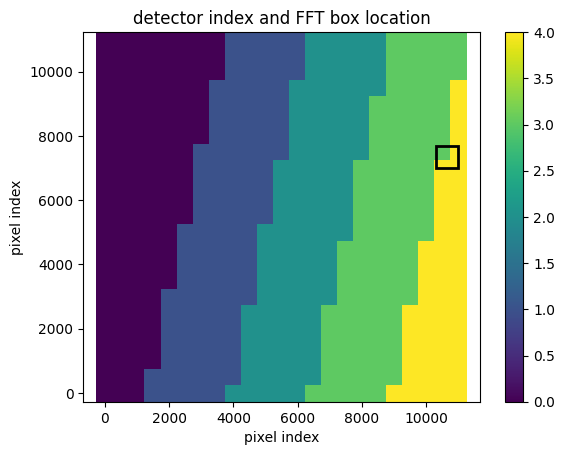

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.56
D04
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= -0.998667524706283
(42, 43)
(42, 43)
(42, 43)


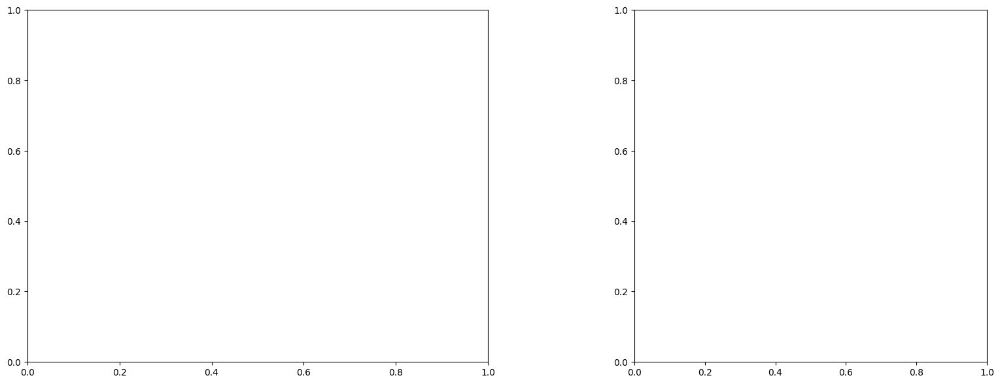

LinAlgError: Singular matrix

box [10300, 11000, 7500, 8200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

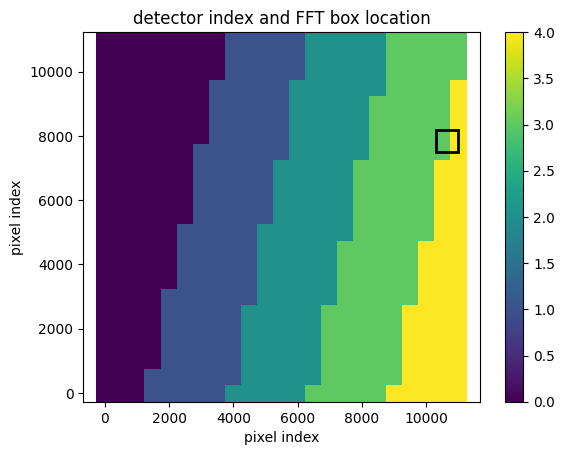

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.3000000000000003
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947282054065789
(42, 43)
(42, 43)
(42, 43)


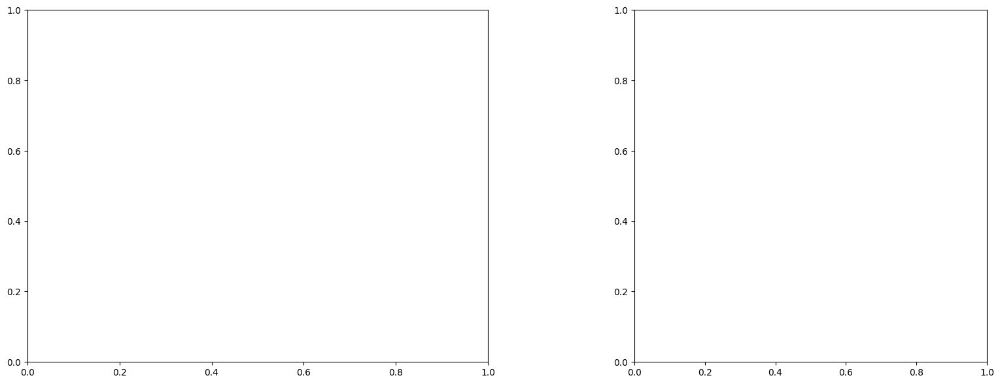

LinAlgError: Singular matrix

box [10300, 11000, 8000, 8700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

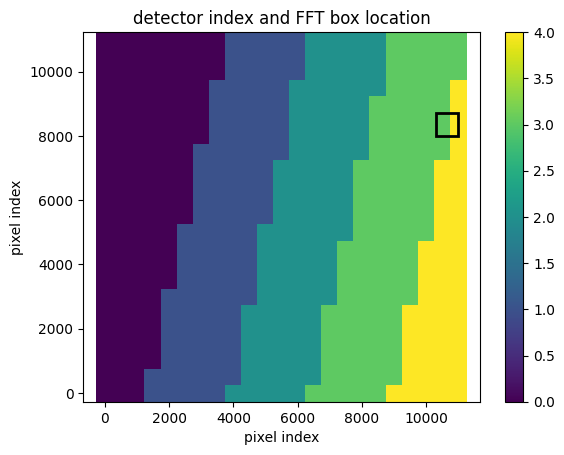

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.3
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947262516650168
(42, 43)
(42, 43)
(42, 43)


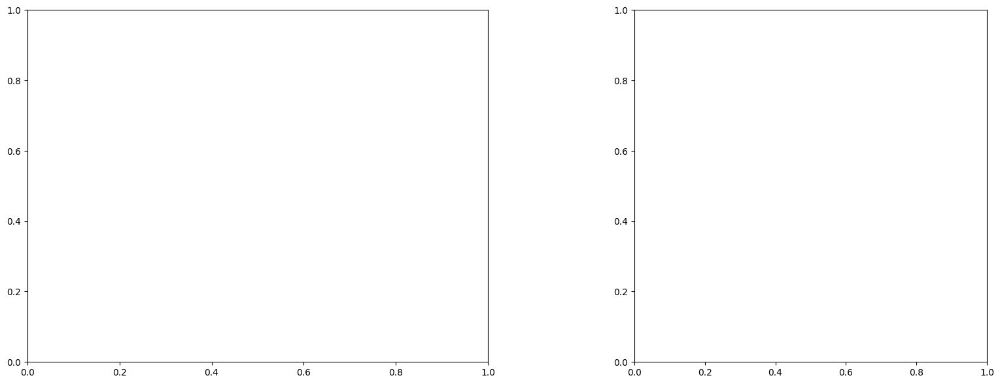

U and V components of current : [-0.83098551 -2.64170627]
uncertainties for U and V: 1.4737517066785975 1.292442767490171


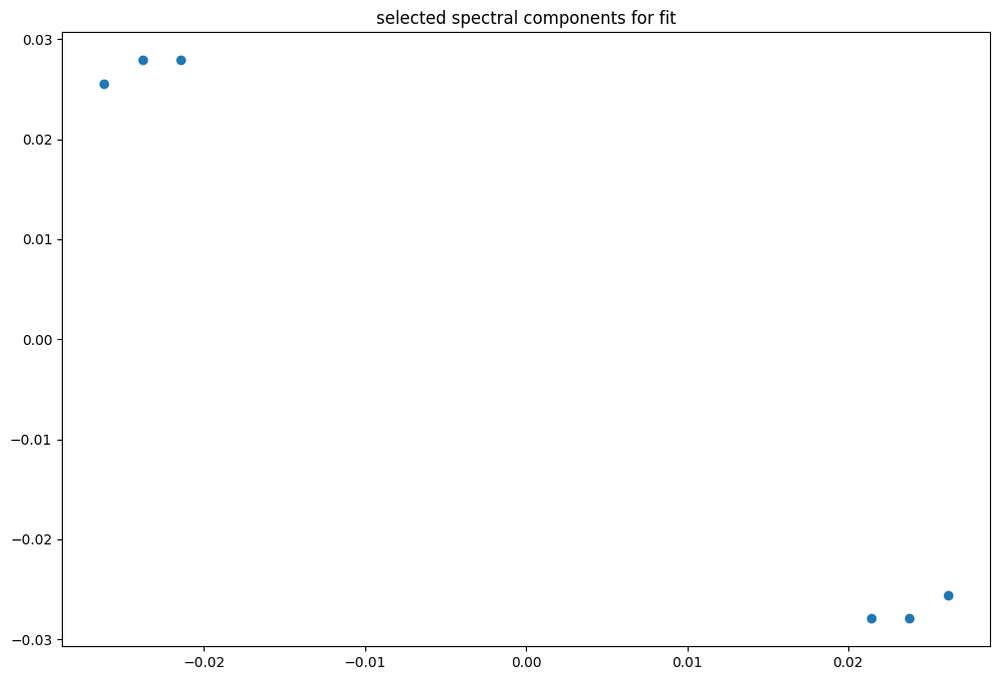

box [10300, 11000, 8500, 9200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

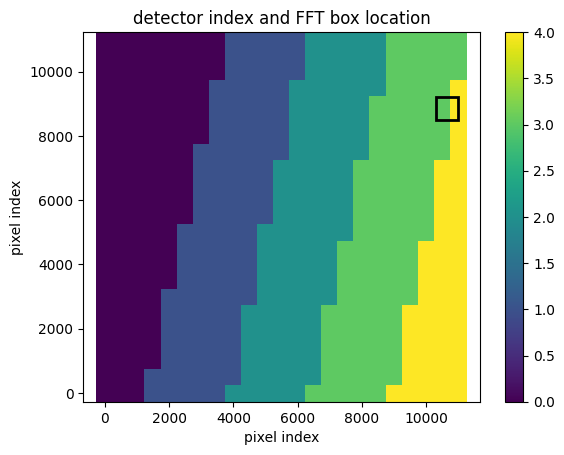

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.3
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(42, 43)
(42, 43)
(42, 43)


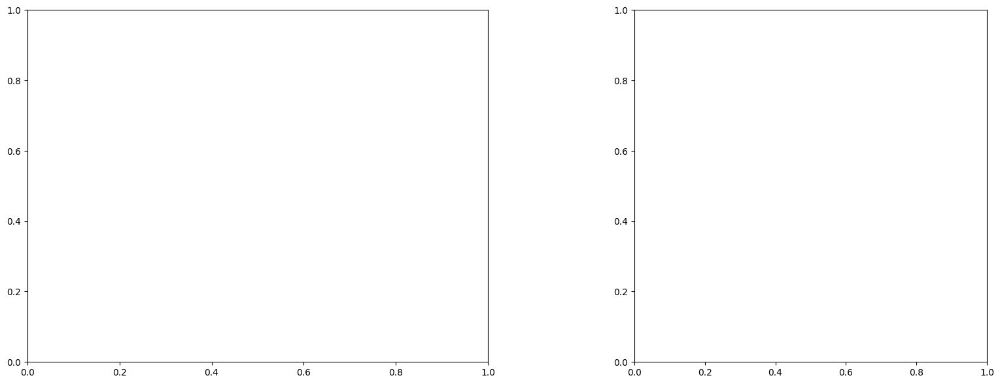

U and V components of current : [-0.23073161 -2.1450092 ]
uncertainties for U and V: 0.03740370230030929 0.03399862683010837


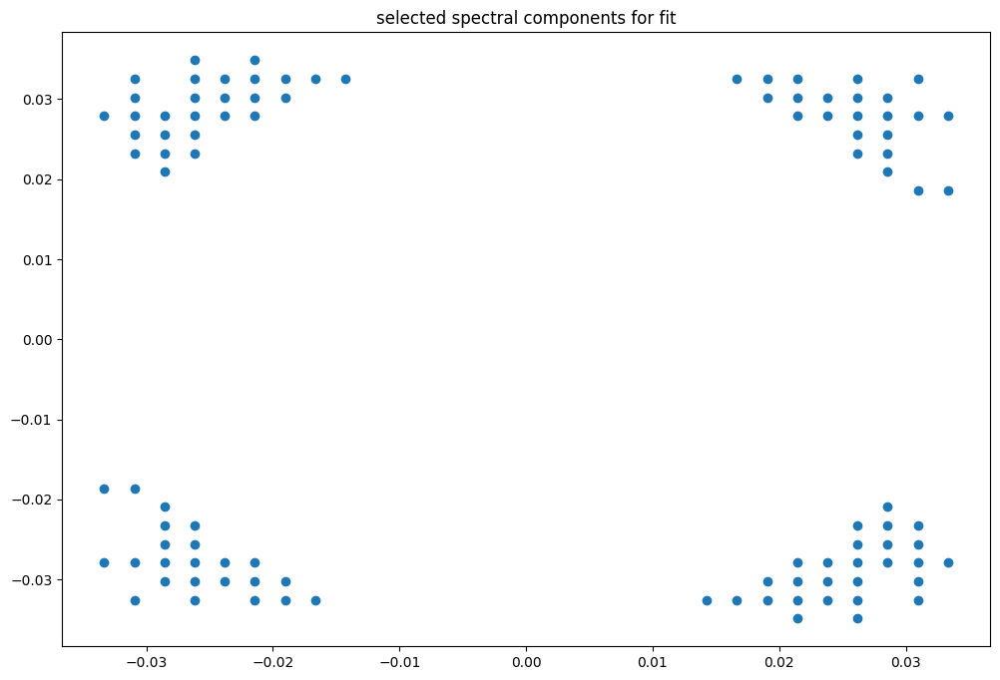

box [10300, 11000, 9000, 9700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Readi

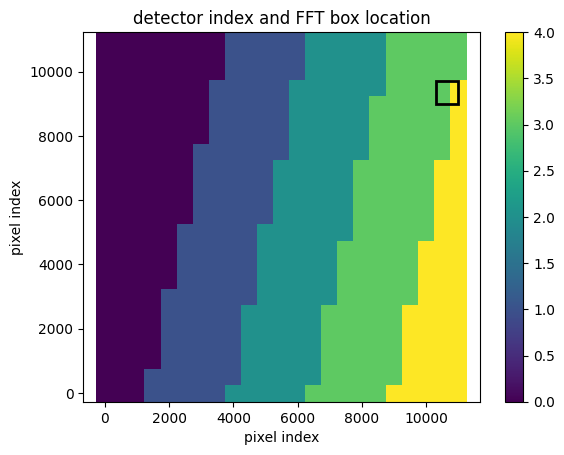

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.3
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947241648231266
(42, 43)
(42, 43)
(42, 43)


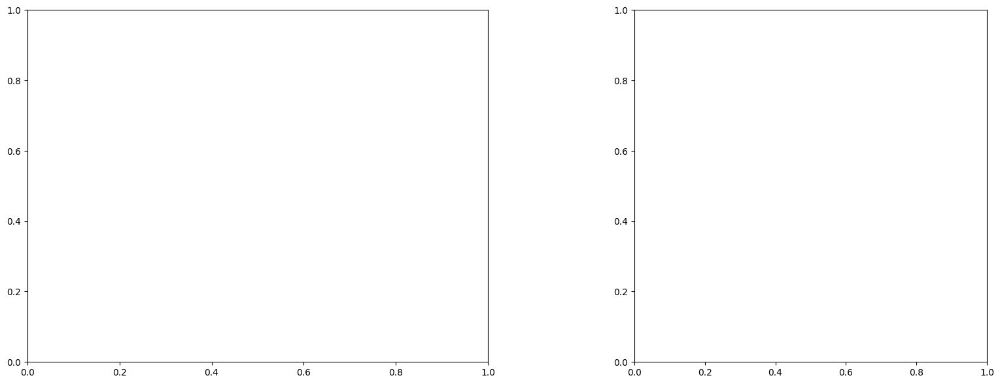

U and V components of current : [ 0.00558127 -1.89093601]
uncertainties for U and V: 0.04388070929528357 0.03979374629367556


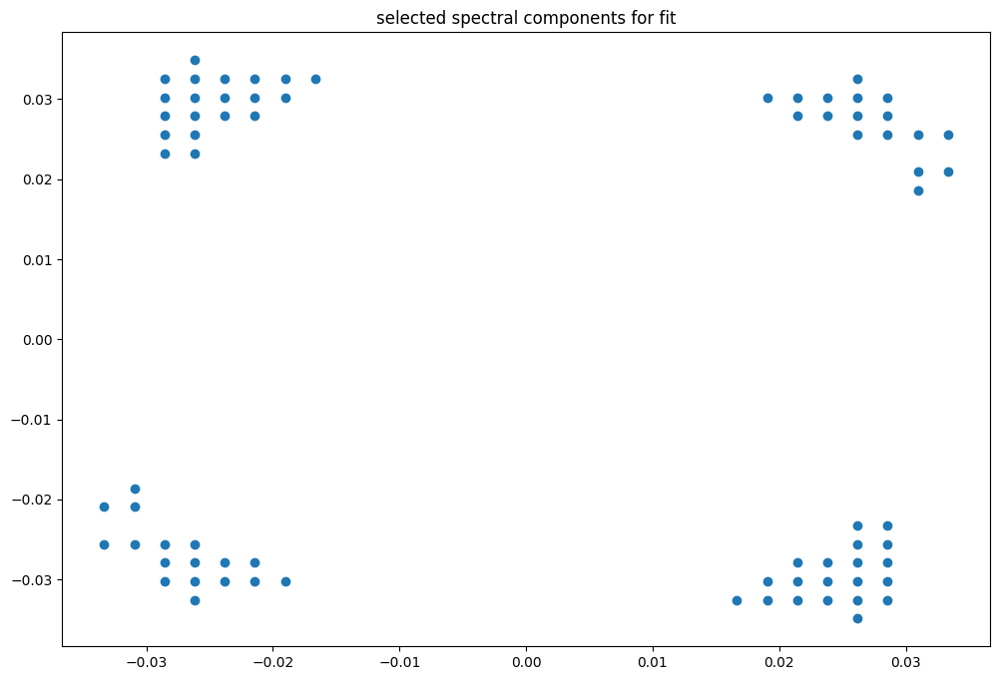

box [10300, 11000, 9500, 10200]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Read

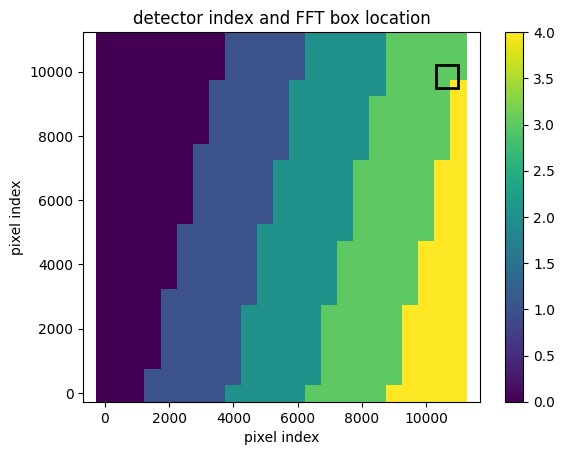

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.26
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947222191048747
(42, 43)
(42, 43)
(42, 43)


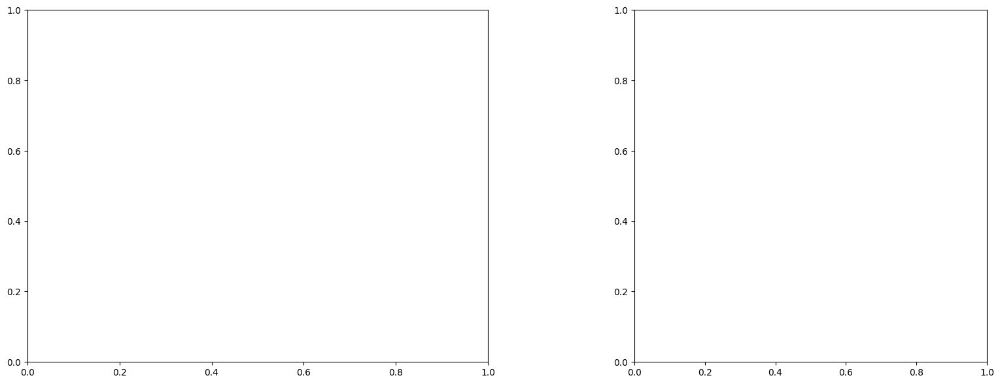

U and V components of current : [ 0.12705259 -1.44862328]
uncertainties for U and V: 0.03528766674592887 0.03195685192835431


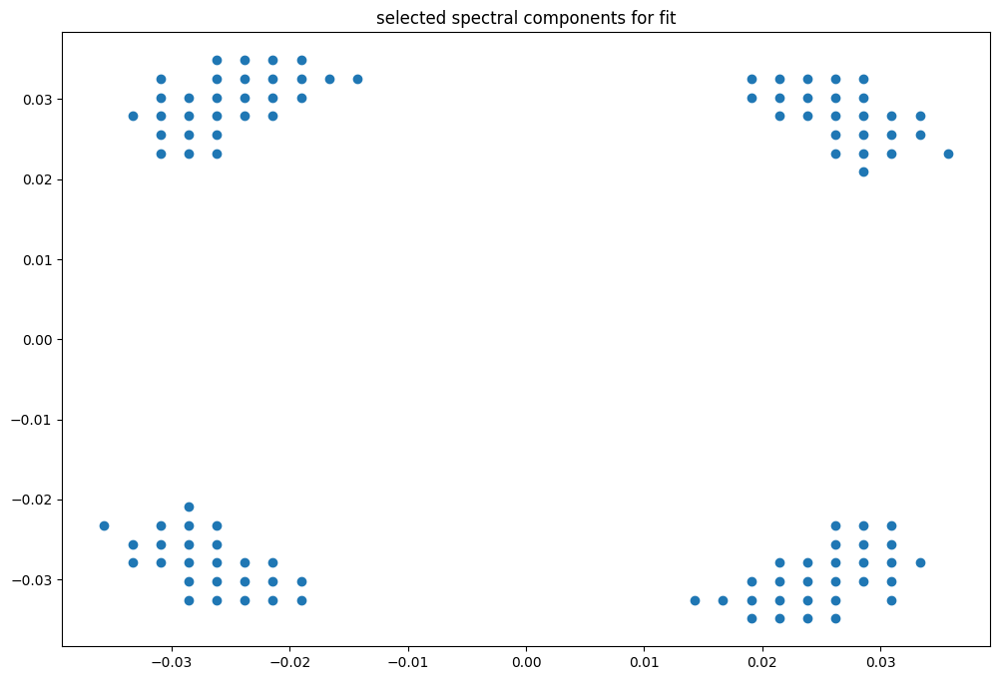

box [10300, 11000, 10000, 10700]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Rea

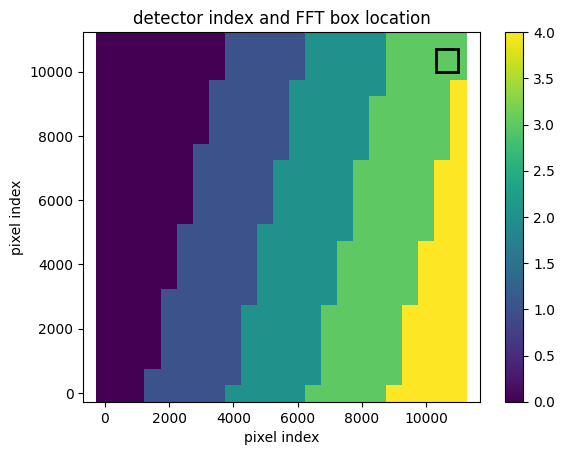

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0000000000000004
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(42, 43)
(42, 43)
(42, 43)


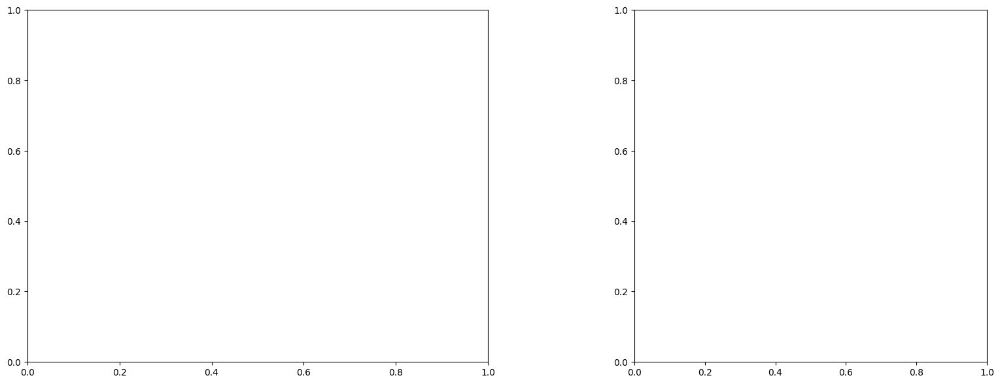

U and V components of current : [ 0.01583116 -1.52834583]
uncertainties for U and V: 0.039048793512449054 0.037254527774725085


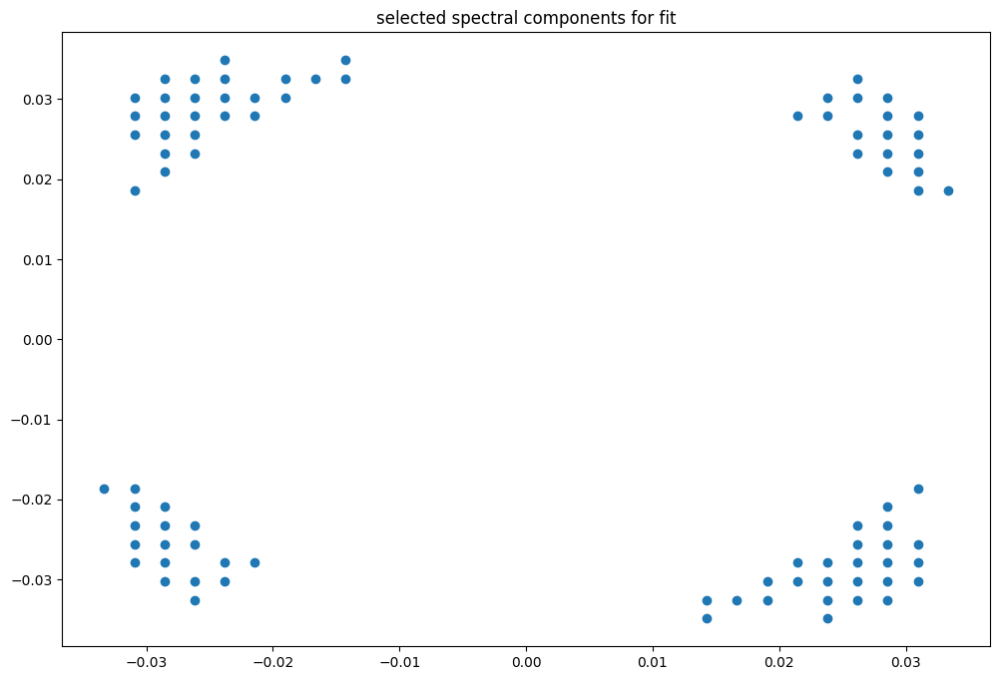

box [10300, 11000, 10300, 11000]
test: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/
Reading XML file for view and sun angles: /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/MTD_TL.xml
Reading file for band  B04 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B04.jp2
Reading file for band  B08 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B08.jp2
Reading file for band  B03 : /home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/GRANULE/L1C_T39PWN_A006166_20160827T065722/IMG_DATA/T39PWN_20160827T064622_B03.jp2
Rea

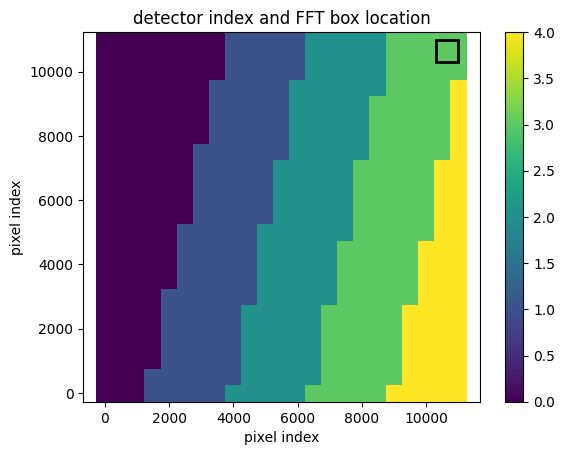

shape indexX (23, 23)
shape indexY (23, 23)
shape array1 (23, 23)
3.0
D03
/home/acuevas/Bureau/S2_ALEXANDRA/2016/S2A_MSIL1C_20160827T064622_N0500_R020_T39PWN_20231005T003302.SAFE/DATASTRIP/DS_S2RP_20231005T003302_S20160827T065722/MTD_DS.xml
dt= 0.9947203884397562
(42, 42)
(42, 42)
(42, 42)


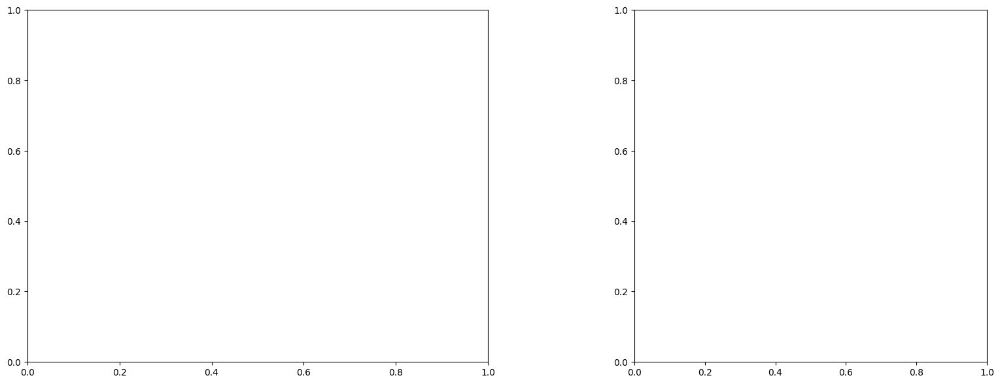

U and V components of current : [ 0.03156403 -1.53909813]
uncertainties for U and V: 0.03918426990192639 0.036411306035296895


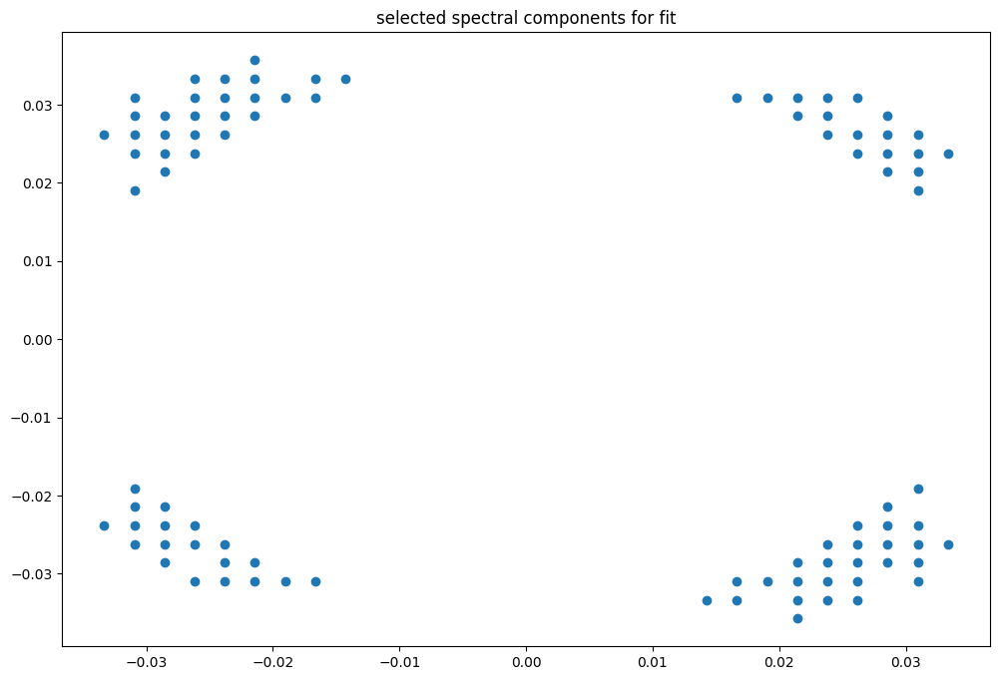

In [7]:
os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant')
# Modification pour que les boites se recouvrent
# Pas de 5km et taille de boite de 7km
# Définir les dimensions de la zone couverte
zone_min = 0
zone_max = 11000

# Taille des boîtes
taille_boite = 700

# Déplacement du centre
deplacement_centre = 500

# Calculer les nouvelles dimensions des boucles
width = (Mother_box[1] - Mother_box[0] - taille_boite) // deplacement_centre + 2
length = (Mother_box[1] - Mother_box[0] - taille_boite) // deplacement_centre + 2
# Initialisation de vos tableaux avec les dimensions calculées

U = np.zeros((width,length))
V = np.zeros((width, length))
coordlon = np.zeros((width, length))
coordlat = np.zeros((width, length))
Sat='A'

# Parcourir les boîtes de la grille

for ii in range(width):
    for jj in range(length):
        # Calculer les coordonnées de la boîte en cours
        index_ii = zone_min + ii * deplacement_centre
        index_jj = zone_min + jj * deplacement_centre
        
        # Limiter les coordonnées pour ne pas dépasser zone_max
        if index_ii + taille_boite > zone_max:
            index_ii = zone_max - taille_boite
        if index_jj + taille_boite > zone_max:
            index_jj = zone_max - taille_boite


        # Calculer les coins de la boîte
        boxi = [
            index_ii, 
            min(index_ii + taille_boite, zone_max), 
            index_jj, 
            min(index_jj + taille_boite, zone_max)
        ]
        
        print('box', boxi)
        # Traitement de la boîte en cours
        try:
            %run S2_get.ipynb

        except ValueError as ve:
            if str(ve) == "Interpolated value is NaN":
                print(f"Interpolated value is NaN at ii={ii}, jj={jj}, skipping to next iteration")
                U[ii, jj] = np.nan
                V[ii, jj] = np.nan
                coordlon[ii, jj] = loncenter
                coordlat[ii, jj] = latcenter
                continue
                
        except Exception as e:
            print("Une erreur s'est produite lors de l'exécution de 'run' :", e)     
            U[ii, jj] = np.nan
            V[ii, jj] = np.nan
            coordlon[ii, jj] = loncenter  # ii-1 et jj-1 pour compenser le décalage
            coordlat[ii, jj] = latcenter  # ii-1 et jj-1 pour compenser le décalage
            
            continue
        # Récupérer les données
        # Remplacer X[0] et X[1] par les valeurs que vous souhaitez affecter à U et V
        U[ii, jj] = X[0]  # ii-1 et jj-1 pour compenser le décalage
        V[ii, jj] = X[1]  # ii-1 et jj-1 pour compenser le décalage
        coordlon[ii, jj] = loncenter  # ii-1 et jj-1 pour compenser le décalage
        coordlat[ii, jj] = latcenter  # ii-1 et jj-1 pour compenser le décalage


In [8]:
# Si Erreurs 
print(boxi)

[10300, 11000, 10300, 11000]


In [9]:
#taille de tile
print(ntile)
print(k_min_fit)
print(k_max_fit)
print(dirC1)
print(dirC2)

16
35
45
-100
-90


In [10]:
print ('taille U',np.shape(U))
print('taille V',np.shape(V))

print ('type U',type(U))
print('type V',type(V))

# print('box',boxi)
# print('Nsx',ntile)

taille U (22, 22)
taille V (22, 22)
type U <class 'numpy.ndarray'>
type V <class 'numpy.ndarray'>


In [11]:
# print('V=',V)
# print('U=',U)


In [12]:
magnitude = np.sqrt(U**2 + V**2)
print('C=',magnitude)
print('taille C',np.shape(magnitude))

C= [[10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.        ]
 [10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.        ]
 [10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.        ]
 [ 1.01954921 10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.         10.         10.
  10.         10.         10.         10.        ]
 

In [16]:
os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/Results/2025/boxsize_500_test2/')
# U1 = U[magnitude <= 2.5]
# V1 = V[magnitude <= 2.5]
# lon1 = coordlon[magnitude <= 2.5]
# lat1 = coordlat[magnitude <= 2.5]
# C1=magnitude[magnitude<=2.5]

U1 = U[magnitude < 2]
V1 = V[magnitude < 2]
lon1 = coordlon[magnitude < 2]
lat1 = coordlat[magnitude < 2]
C1=magnitude[magnitude<2]

U_filtre=U1
V_filtre=V1
coordlon_filtre=lon1
coordlat_filtre=lat1






In [17]:
# Obtenir le répertoire de travail courant
repertoire_actuel = os.getcwd()

# Afficher le répertoire de travail courant
print(f"Répertoire de travail actuel : {repertoire_actuel}")

Répertoire de travail actuel : /home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/Results/2025/boxsize_500_test2


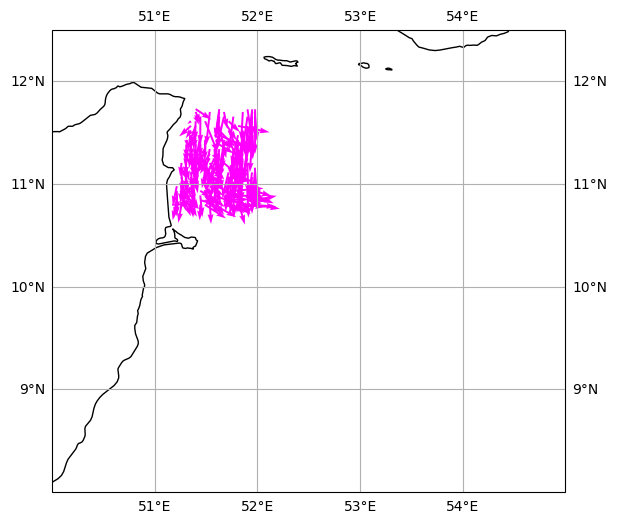

In [18]:
thick = 0.002
scale_quiver = 30
import cartopy.crs as ccrs
import cartopy.feature as cfeature
# Créer une figure avec une projection cartographique
fig, ax = plt.subplots(figsize=(8, 6), subplot_kw={'projection': ccrs.PlateCarree()})

# Tracé du quiver plot
# ax.quiver(coordlon_filtre, coordlat_filtre, U_filtre, V_filtre, scale=scale_quiver, color='magenta', transform=ccrs.PlateCarree()) 
ax.quiver(coordlon_filtre[::1], coordlat_filtre[::1], U_filtre[::1], V_filtre[::1], scale=scale_quiver, color='magenta',transform=ccrs.PlateCarree())

# Afficher la flèche horizontale
# ax.quiver(-9.5, 34, 1, 0, scale=scale_quiver, color='black', width=thick, transform=ccrs.PlateCarree(), label='Horizontal')

# # Afficher la flèche verticale
# ax.quiver(-9.5, 34, 0, 1, scale=scale_quiver, color='black', width=thick, transform=ccrs.PlateCarree(), label='Vertical')

# ax.text(-9.5, 33.9, '1 m/s', fontsize=12, color='black', transform=ccrs.PlateCarree())

# Ajouter les côtes
ax.add_feature(cfeature.COASTLINE)

# Configuration des axes
ax.set_xlabel('Longitude [°]')
ax.set_ylabel('Latitude [°]')

# ax.set_xlim(8, 11)
# ax.set_ylim(50, 52)


ax.set_xlim(50, 55)
ax.set_ylim(8, 12.5)

# Ajouter une grille
ax.gridlines(draw_labels=True)
# plt.savefig("sizebox100_ntile8_test2.png", dpi=300)
# Affichage de la carte
plt.show()

In [48]:
# os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/Results/2025/boxsize_700/')

# np.save('U_PYN',U1)
# np.save('V_PYN',V1)
# np.save('lon_PYN',lon1)
# np.save('lat_PYN',lat1)
# np.save('C_PYN',C1)

# # Obtenir le répertoire de travail courant
# repertoire_actuel = os.getcwd()

# # Afficher le répertoire de travail courant
# print(f"Répertoire de travail actuel : {repertoire_actuel}")

In [69]:
# # Charger les tableaux 
# os.chdir('/home/acuevas/Bureau/S2_ALEXANDRA/OPTOOLS/PYTHON/Carte_courant/2016/')


# # PMW
# U_PWM = np.load('U_PWM.npy')
# V_PWM = np.load('V_PWM.npy')

# lat_PWM=np.load('lat_PWM.npy')
# lon_PWM=np.load('lon_PWM.npy')

# C_PWM=np.load('C_PWM.npy')

# # PWN

# U_PWN = np.load('U_PWN.npy')
# V_PWN = np.load('V_PWN.npy')

# lat_PWN=np.load('lat_PWN.npy')
# lon_PWN=np.load('lon_PWN.npy')

# C_PWN=np.load('C_PWN.npy')


# # PXM

# U_PXM = np.load('U_PXM.npy')
# V_PXM = np.load('V_PXM.npy')

# lat_PXM=np.load('lat_PXM.npy')
# lon_PXM=np.load('lon_PXM.npy')

# C_PXM=np.load('C_PXM.npy')


# # PXN

# U_PXN = np.load('U_PXN.npy')
# V_PXN = np.load('V_PXN.npy')

# lat_PXN=np.load('lat_PXN.npy')
# lon_PXN=np.load('lon_PXN.npy')

# C_PXN=np.load('C_PXN.npy')

# # PXL

# U_PXL = np.load('U_PXL.npy')
# V_PXL = np.load('V_PXL.npy')

# lat_PXL=np.load('lat_PXL.npy')
# lon_PXL=np.load('lon_PXL.npy')

# C_PXL=np.load('C_PXL.npy')


# # PYM

# U_PYM = np.load('U_PYM.npy')
# V_PYM = np.load('V_PYM.npy')

# lat_PYM=np.load('lat_PYM.npy')
# lon_PYM=np.load('lon_PYM.npy')

# C_PYM=np.load('C_PYM.npy')


# # PYN

# U_PYN = np.load('U_PYN.npy')
# V_PYN = np.load('V_PYN.npy')

# lat_PYN=np.load('lat_PYN.npy')
# lon_PYN=np.load('lon_PYN.npy')

# C_PYN=np.load('C_PYN.npy')

# # PYL

# U_PYL = np.load('U_PYL.npy')
# V_PYL = np.load('V_PYL.npy')

# lat_PYL=np.load('lat_PYL.npy')
# lon_PYL=np.load('lon_PYL.npy')

# C_PYL=np.load('C_PYL.npy')


# UU=np.concatenate([U_PWM,U_PWN,U_PXL,U_PXM,U_PXN,U_PYL,U_PYM,U_PYN])
# UV=np.concatenate([V_PWM,V_PWN,V_PXL,V_PXM,V_PXN,V_PYL,V_PYM,V_PYN])
# lat_L1C=np.concatenate([lat_PWM,lat_PWN,lat_PXL,lat_PXM,lat_PXN,lat_PYL,lat_PYM,lat_PYN])
# lon_L1C=np.concatenate([lon_PWM,lon_PWN,lon_PXL,lon_PXM,lon_PXN,lon_PYL,lon_PYM,lon_PYN])



# print(np.shape(lon_PWM))
# print(np.shape(lat_PWM))
# print(np.shape(U_PWM))

# thick = 0.005
# scale_quiver = 25

# nb_pt=5
# import cartopy.crs as ccrs
# import cartopy.feature as cfeature
# # Créer une figure avec une projection cartographique
# # fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})
# fig = plt.figure(figsize=(20, 10))

# ax = plt.axes(projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE)
# # Tracé du quiver plot

# ax.quiver(lon_PWM[::nb_pt], lat_PWM[::nb_pt], U_PWM[::nb_pt], V_PWM[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PWN[::nb_pt], lat_PWN[::nb_pt], U_PWN[::nb_pt], V_PWN[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PXL[::nb_pt], lat_PXL[::nb_pt], U_PXL[::nb_pt], V_PXL[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PXM[::nb_pt], lat_PXM[::nb_pt], U_PXM[::nb_pt], V_PXM[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PXN[::nb_pt], lat_PXN[::nb_pt], U_PXN[::nb_pt], V_PXN[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PYL[::nb_pt], lat_PYL[::nb_pt], U_PYL[::nb_pt],V_PYL[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PYM[::nb_pt], lat_PYM[::nb_pt], U_PYM[::nb_pt], V_PYM[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')

# ax.quiver(lon_PYN[::nb_pt], lat_PYN[::nb_pt], U_PYN[::nb_pt], V_PYN[::nb_pt], scale=scale_quiver, width=thick, color='magenta',label='Courant L1C')


# # Ajouter les côtes
# ax.add_feature(cfeature.COASTLINE)
# # 
# # Configuration des axes
# ax.set_xlabel('Longitude [°]')
# ax.set_ylabel('Latitude [°]')

# ax.set_xlim(50, 55)
# ax.set_ylim(8, 13)

# # Ajouter une grille
# ax.gridlines(draw_labels=True)

# # Affichage de la carte
# plt.show()

In [44]:
# import numpy as np
# import matplotlib.pyplot as plt
# import cartopy.crs as ccrs
# import cartopy.feature as cfeature



# # Calculer les magnitudes des vecteurs de courant
# C_PWM = np.sqrt(U_PWM**2 + V_PWM**2)
# C_PWN = np.sqrt(U_PWN**2 + V_PWN**2)
# C_PXL = np.sqrt(U_PXL**2 + V_PXL**2)
# C_PXM = np.sqrt(U_PXM**2 + V_PXM**2)
# C_PXN = np.sqrt(U_PXN**2 + V_PXN**2)
# C_PYL = np.sqrt(U_PYL**2 + V_PYL**2)
# C_PYM = np.sqrt(U_PYM**2 + V_PYM**2)

# thick = 0.005
# scale_quiver = 25
# nb_pt =5

# # Créer une figure avec une projection cartographique
# fig = plt.figure(figsize=(18, 16))
# ax = plt.axes(projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE)

# # Tracé du quiver plot avec des flèches colorées par magnitude
# q1 = ax.quiver(lon_PWM[::nb_pt], lat_PWM[::nb_pt], U_PWM[::nb_pt], V_PWM[::nb_pt], C_PWM[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q2 = ax.quiver(lon_PWN[::nb_pt], lat_PWN[::nb_pt], U_PWN[::nb_pt], V_PWN[::nb_pt], C_PWN[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q3 = ax.quiver(lon_PXL[::nb_pt], lat_PXL[::nb_pt], U_PXL[::nb_pt], V_PXL[::nb_pt], C_PXL[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q4 = ax.quiver(lon_PXM[::nb_pt], lat_PXM[::nb_pt], U_PXM[::nb_pt], V_PXM[::nb_pt], C_PXM[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q5 = ax.quiver(lon_PXN[::nb_pt], lat_PXN[::nb_pt], U_PXN[::nb_pt], V_PXN[::nb_pt], C_PXN[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q6 = ax.quiver(lon_PYL[::nb_pt], lat_PYL[::nb_pt], U_PYL[::nb_pt], V_PYL[::nb_pt], C_PYL[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q7 = ax.quiver(lon_PYM[::nb_pt], lat_PYM[::nb_pt], U_PYM[::nb_pt], V_PYM[::nb_pt], C_PYM[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')

# q8 = ax.quiver(lon_PYN[::nb_pt], lat_PYN[::nb_pt], U_PYN[::nb_pt], V_PYN[::nb_pt], C_PYN[::nb_pt],
#                scale=scale_quiver, width=thick, cmap='jet', label='Courant L1C')


# # Ajouter une colorbar
# cbar = plt.colorbar(q7, orientation='vertical', pad=0.05, ax=ax)
# cbar.set_label('Magnitude du courant (m/s)')

# # Ajouter les côtes
# ax.add_feature(cfeature.COASTLINE)

# # Configuration des axes
# ax.set_xlabel('Longitude [°]')
# ax.set_ylabel('Latitude [°]')

# ax.set_xlim(50, 55)
# ax.set_ylim(8, 13)

# # Ajouter une grille
# ax.gridlines(draw_labels=True)

# # Affichage de la carte
# plt.show()


In [45]:
# # # Créer la figure et les sous-graphiques
# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))




# # Tracer U_PWM en fonction de lon_PWM et lat_PWM sur le premier subplot
# scatter1 = ax1.scatter(lon_PWM, lat_PWM, c=U_PWM, cmap='coolwarm', s=50)
# scatter12 = ax1.scatter(lon_PWN, lat_PWN, c=U_PWN, cmap='coolwarm', s=50)
# scatter13 = ax1.scatter(lon_PXL, lat_PXL, c=U_PXL, cmap='coolwarm', s=50)
# scatter14 = ax1.scatter(lon_PXM, lat_PXM, c=U_PXM, cmap='coolwarm', s=50)
# scatter15 = ax1.scatter(lon_PXN, lat_PXN, c=U_PXN, cmap='coolwarm', s=50)
# scatter16 = ax1.scatter(lon_PYL, lat_PYL, c=U_PYL, cmap='coolwarm', s=50)
# scatter17 = ax1.scatter(lon_PYM, lat_PYM, c=U_PYM, cmap='coolwarm', s=50)
# scatter18 = ax1.scatter(lon_PYN, lat_PYN, c=U_PYN, cmap='coolwarm', s=50)


# ax1.set_xlabel('Longitude')
# ax1.set_ylabel('Latitude')
# ax1.set_title('U_PWM en fonction de lon_PWM et lat_PWM')
# ax1.set_xlim(50, 55)
# ax1.set_ylim(8, 13)

# fig.colorbar(scatter1, ax=ax1, label='Valeur de U_PWM')
# ax1.grid(True)

# # Tracer V_PWM en fonction de lon_PWM et lat_PWM sur le deuxième subplot
# scatter2 = ax2.scatter(lon_PWM, lat_PWM, c=V_PWM, cmap='jet', s=50)
# ax2.set_xlabel('Longitude')
# ax2.set_ylabel('Latitude')
# ax2.set_xlim(50, 55)
# ax2.set_ylim(8, 13)

# ax2.set_title('V_PWM en fonction de lon_PWM et lat_PWM')
# fig.colorbar(scatter2, ax=ax2, label='Valeur de V_PWM')
# ax2.grid(True)

# # Ajuster l'espacement entre les sous-graphiques
# plt.tight_layout()

# # Afficher la figure
# plt.show()


In [46]:
# # Créer une figure avec une projection cartographique
# fig = plt.figure(figsize=(12, 10))
# ax = plt.axes(projection=ccrs.PlateCarree())

# # Ajouter les côtes et activer la grille
# ax.add_feature(cfeature.COASTLINE)
# ax.gridlines()

# # Tracer les scatter plots avec différentes couleurs
# sc1 = ax.scatter(lon_PWM, lat_PWM, c=C_PWM, cmap='jet', s=50)
# sc2 = ax.scatter(lon_PWN, lat_PWN, c=C_PWN, cmap='jet', s=50)
# sc3 = ax.scatter(lon_PXL, lat_PXL, c=C_PXL, cmap='jet', s=50)
# sc4 = ax.scatter(lon_PXM, lat_PXM, c=C_PXM, cmap='jet', s=50)
# sc5 = ax.scatter(lon_PXN, lat_PXN, c=C_PXN, cmap='jet', s=50)
# sc6 = ax.scatter(lon_PYL, lat_PYL, c=C_PYL, cmap='jet', s=50)
# sc3 = ax.scatter(lon_PYM, lat_PYM, c=C_PYM, cmap='jet', s=50)
# sc3 = ax.scatter(lon_PYN, lat_PYN, c=C_PYN, cmap='jet', s=50)


# # Ajouter une colorbar pour le scatter plot sc1
# cb = plt.colorbar(sc1, ax=ax, label='(m/s)')

# # Définir les limites de la carte et les étiquettes
# ax.set_xlim(50, 55)
# ax.set_ylim(8, 13)

# # Définir les étiquettes des axes et le titre
# ax.set_xlabel('Longitude')
# ax.set_ylabel('Latitude')
# ax.set_title('Superposition de Scatter Plots avec Projection Cartographique')

# plt.show()

